In [1]:
import pickle
import numpy as np
from scipy import sparse
import pandas as pd
import seaborn as sns
sns.set() ## set up style
import uuid
import time
import matplotlib.pyplot as plt
#solved chinese display in matplotlib
from matplotlib import rcParams
rcParams['font.family'] = 'sans-serif'
# rcParams["font.family"] = "DFKai-SB"
rcParams['axes.unicode_minus'] = False
from tqdm import tqdm_notebook,tnrange
# from tqdm.autonotebook import tqdm
# tqdm.pandas()

import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
import visdom
vis=visdom.Visdom()
from BuildDataset import Tripletdataset
from Model import Encoder,Decoder,EncoderOneLayer,DecoderOneLayer
industry=['金融業', 'IC製造', 'IC設計', '電子零件元件', '電腦系統業', '石油及天然氣', '手機', '面板業', '太陽能',
       '板鋼', '被動元件', '車輛整車', '非鐵金屬', '流通業', '地產', '通訊設備', '遊戲產業', '印刷電路板相關',
       '貴金屬', '機械', '運輸事業', '電子通路', 'IC封裝測試', 'LED', '通訊服務', '消費性電子產品', '化學工業',
       '醫藥產業', '軟體業', '週邊產品', '石化業', '旅館、餐飲', '汽機車零組件', '設備儀器廠商', '條鋼', '造紙業',
       '水泥', '橡膠工業', '傳產其他', '數位相機', '顯示器', '不鏽鋼', '農林漁牧', '服務業', 'Internet相關',
       '營造工程', '休閒娛樂', '紡織中游', '生物科技', '家電', '光碟片', '建材', '成衣', '電力', '運動產業',
       '線材、盤元', '化纖原料', '其他公用事業', '大宗物資', '家居用品', '手機零組件', '食品加工', '電力設備',
       '航天軍工', '分離式元件', '電子其他', '面板零組件', '飲料相關', '電線電纜', '封測服務與材料', '礦石開採',
       '光通訊', '傳播事業', '輔助與彌補用醫材', '時尚產業', '基礎建設營運', '電聲產品', '水資源', '醫療器材通路',
       '合金鋼', '文化創意產業', '車用金屬成型', '穿戴式裝置', '其他醫療器材', '汽車內裝', '車用電子',
       '診斷與監測用醫材', '傳輸介面', '電子化工材料', '電池材料相關', '資產股', '醫療管理服務', '體外診斷用醫材', '煤',
       '射頻前端晶片', '控股公司', '無店舖販售', '手術與治療用醫材', '金屬礦採選', '生物辨識相關']
def opts(**kwords):
    opts={"markers":False,"xlabel":"epochs","title":"Total Loss","width":1200,"heigh":300,"xtickmax":100}
    for k in kwords:
        opts[k]=kwords[k]
    return opts

In [2]:
## Load industry dictionary
with open("../dict_guid_sparsebow_20000_single.v05.p","rb") as f:
    dict_guid_sparsebow_single= pickle.load(f)
with open("../dict_singleindustry_guid.p","rb") as f:
    dict_singleindustry_guid= pickle.load(f)

In [3]:
## Industry with news more than 100 pics
industry_partial=industry[:80]

In [4]:
len(industry_partial)

80

#### Configuration for split dataset to triain and test

In [5]:
Split=8/18
Split_train_test=8/10

#### Sample part of Dataset

In [6]:
dict_split_industry_guid={ ind:np.random.choice(dict_singleindustry_guid[ind],
                                                     size=int(Split*len(dict_singleindustry_guid[ind])),
                                                     replace=False) for ind in industry_partial}

In [7]:
dict_train_industry_guid={ind:dict_split_industry_guid[ind][:int(Split_train_test*len(dict_split_industry_guid[ind]))]
                          for ind in dict_split_industry_guid}
dict_test_industry_guid={ind:dict_split_industry_guid[ind][int(Split_train_test*len(dict_split_industry_guid[ind])):]
                          for ind in dict_split_industry_guid}

In [8]:
dict_str_list=dict_split_industry_guid
analysis={i:len(dict_str_list[i]) for i in dict_str_list }
analysis=pd.Series(analysis)
analysis.sort_values(ascending=False)

金融業         7083
IC製造        3338
IC設計        3187
電子零件元件      2932
電腦系統業       2282
石油及天然氣      2160
手機          2139
面板業         1929
太陽能         1819
板鋼          1656
被動元件        1643
車輛整車        1631
非鐵金屬        1612
流通業         1540
地產          1392
通訊設備        1368
遊戲產業        1341
印刷電路板相關     1299
貴金屬         1174
機械          1078
運輸事業        1077
電子通路        1008
IC封裝測試       905
LED          798
通訊服務         797
消費性電子產品      707
化學工業         698
醫藥產業         671
軟體業          669
週邊產品         669
            ... 
光碟片          228
建材           197
成衣           195
電力           187
運動產業         182
線材、盤元        181
化纖原料         176
其他公用事業       168
大宗物資         165
家居用品         158
手機零組件        139
食品加工         129
電力設備         123
航天軍工         117
分離式元件        115
電子其他         108
面板零組件        102
飲料相關          93
電線電纜          91
封測服務與材料       90
礦石開採          78
光通訊           63
傳播事業          61
時尚產業          60
輔助與彌補用醫材      60
基礎建設營運        54
電聲產品          52
水資源           

In [9]:
dict_str_list=dict_train_industry_guid
analysis={i:len(dict_str_list[i]) for i in dict_str_list }
analysis=pd.Series(analysis)
analysis.sort_values(ascending=False)

金融業         4958
IC製造        2336
IC設計        2230
電子零件元件      2052
電腦系統業       1597
石油及天然氣      1512
手機          1497
面板業         1350
太陽能         1273
板鋼          1159
被動元件        1150
車輛整車        1141
非鐵金屬        1128
流通業         1078
地產           974
通訊設備         957
遊戲產業         938
印刷電路板相關      909
貴金屬          821
機械           754
運輸事業         753
電子通路         705
IC封裝測試       633
LED          558
通訊服務         557
消費性電子產品      494
化學工業         488
醫藥產業         469
軟體業          468
週邊產品         468
            ... 
光碟片          159
建材           137
成衣           136
電力           130
運動產業         127
線材、盤元        126
化纖原料         123
其他公用事業       117
大宗物資         115
家居用品         110
手機零組件         97
食品加工          90
電力設備          86
航天軍工          81
分離式元件         80
電子其他          75
面板零組件         71
飲料相關          65
電線電纜          63
封測服務與材料       62
礦石開採          54
光通訊           44
傳播事業          42
時尚產業          42
輔助與彌補用醫材      42
基礎建設營運        37
電聲產品          36
水資源           

In [10]:
dict_str_list=dict_test_industry_guid
analysis={i:len(dict_str_list[i]) for i in dict_str_list }
analysis=pd.Series(analysis)
analysis.sort_values(ascending=False)

金融業         2125
IC製造        1002
IC設計         957
電子零件元件       880
電腦系統業        685
石油及天然氣       648
手機           642
面板業          579
太陽能          546
板鋼           497
被動元件         493
車輛整車         490
非鐵金屬         484
流通業          462
地產           418
通訊設備         411
遊戲產業         403
印刷電路板相關      390
貴金屬          353
機械           324
運輸事業         324
電子通路         303
IC封裝測試       272
通訊服務         240
LED          240
消費性電子產品      213
化學工業         210
醫藥產業         202
軟體業          201
週邊產品         201
            ... 
光碟片           69
建材            60
成衣            59
電力            57
線材、盤元         55
運動產業          55
化纖原料          53
其他公用事業        51
大宗物資          50
家居用品          48
手機零組件         42
食品加工          39
電力設備          37
航天軍工          36
分離式元件         35
電子其他          33
面板零組件         31
封測服務與材料       28
電線電纜          28
飲料相關          28
礦石開採          24
光通訊           19
傳播事業          19
時尚產業          18
輔助與彌補用醫材      18
基礎建設營運        17
電聲產品          16
水資源           

#### Configure to train

In [8]:
Epochs=11500
P=3
K=6
PK=P*K
inputDim=20000
repzDim=500
alpha=2
PK*(K-1)*(PK-K)

1080

#### Model & Dataset Instantiation

In [10]:
dataset=Tripletdataset(industry_partial,
                       dict_train_industry_guid,
                       dict_guid_sparsebow_single,
                       P=P,K=K,
                      )
testset=Tripletdataset(industry_partial,
                       dict_test_industry_guid,
                       dict_guid_sparsebow_single,
                       P=P,K=K,
                      )
# device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
modelEncoder = EncoderOneLayer(inputDim,repzDim).to(device)
modelEncoder.eval()
modelDecoder = DecoderOneLayer(repzDim,inputDim).to(device)
modelEncoder.eval()
def criterionTri(h0,h1,h2,reduction="mean"):
    h01=(h0*h1).sum(dim=1)
    h02=(h0*h2).sum(dim=1)
    Lt=torch.log(1+torch.exp(h02-h01))
    if reduction=="mean":
        return Lt.mean()
    if reduction=="none": assert False,"this function not yet" 
        
criterionRC=torch.nn.BCELoss(reduction="mean") ## There is one called BCEWithLogitsLoss 
# optimizerSgd=torch.optim.SGD([{"params":modelEncoder.parameters()},
#                            {"params":modelDecoder.parameters()},
#                            ],
#                           lr=0.001,
#                             )
optimizer=torch.optim.Adam([{"params":modelEncoder.parameters()},
                           {"params":modelDecoder.parameters()},
                           ])

#### Train

In [11]:
trainingloss={"loss":[],"lossRA":[],"lossRP":[],"lossRN":[],"lossT":[]}
testloss={"loss":[],"lossRA":[],"lossRP":[],"lossRN":[],"lossT":[]}
s_total=time.time()
for ep in tnrange(Epochs):
    ep+=1
    dataset.shuffle()
    for i, (batchData,batchTest) in enumerate(zip(dataset,testset)):
        
        s=time.time()
        
        optimizer.zero_grad()
        
        s_prepare=time.time()
        ## Train 
        ## array int8 to float 32
        batchAnchor=batchData["batch_anchor"].astype(np.float32) 
        batchPositive=batchData["batch_positive"].astype(np.float32)
        batchNegative=batchData["batch_negative"].astype(np.float32)
        ## array  to tensor float 32
        batchAnchorTensor=torch.tensor(batchAnchor,dtype=torch.float32,device=device)
        batchPositiveTensor=torch.tensor(batchPositive,dtype=torch.float32,device=device)
        batchNegativeTensor=torch.tensor(batchNegative,dtype=torch.float32,device=device)
        
        e_prepare=time.time()
        
        s_inference=time.time()
        ## Inference
        #### encoding
        anchorRepz   = modelEncoder(batchAnchorTensor)
        positiceRepz = modelEncoder(batchPositiveTensor)
        negativeRepz = modelEncoder(batchNegativeTensor)
        #### decoding
        anchorRc   = modelDecoder(anchorRepz)
        positiveRc = modelDecoder(positiceRepz)
        negativeRc = modelDecoder(negativeRepz)
        
        lossRA = criterionRC(anchorRc,batchAnchorTensor)
        lossRP = criterionRC(positiveRc,batchPositiveTensor)
        lossRN = criterionRC(negativeRc,batchNegativeTensor)
        
        lossT = criterionTri(anchorRepz,positiceRepz,negativeRepz,reduction="mean")
        
        loss = lossRA + lossRP + lossRN + alpha*lossT
        
        e_inference = time.time()
        
        
        ## backward
        s_backward = time.time()
        loss.backward()
        e_backward = time.time()
        ## update
        optimizer.step()

        ## record
        with torch.no_grad():
            trainingloss["loss"].append(loss.item())
            trainingloss["lossRA"].append(lossRA.item())
            trainingloss["lossRP"].append(lossRP.item())
            trainingloss["lossRN"].append(lossRN.item())
            trainingloss["lossT"].append(lossT.item())
            print("-------------------------------")
            print("epoch :",ep,"/",Epochs,",","batch:",i,"/",len(dataset))
            print("loss  :",loss.item())
            print("lossRA:",lossRA.item(),",","lossRP:",lossRP.item(),",","lossRN:",lossRN.item())
            print("lossT :",lossT.item())
        e=time.time()
        print("Batch-Time:",np.round(e-s,2),"s")
        print("Batch-PreTime",np.round(e_prepare-s_prepare,2),"s")
        print("Batch-InfTime:",np.round(e_inference-s_inference,2),"s")
        print("Batch-BackTime:",np.round(e_backward-s_backward,2),"s")
        
#         break
    ## Test Inference every epoch
    with torch.no_grad():
        ## array int8 to float 32
        batchAnchor   = batchTest["batch_anchor"].astype(np.float32) 
        batchPositive = batchTest["batch_positive"].astype(np.float32)
        batchNegative = batchTest["batch_negative"].astype(np.float32)
        ## array  to tensor float 32
        batchAnchorTensor   = torch.tensor(batchAnchor,dtype=torch.float32,device=device)
        batchPositiveTensor = torch.tensor(batchPositive,dtype=torch.float32,device=device)
        batchNegativeTensor = torch.tensor(batchNegative,dtype=torch.float32,device=device)
        ## Inference
        #### encoding
        anchorRepz   = modelEncoder(batchAnchorTensor)
        positiceRepz = modelEncoder(batchPositiveTensor)
        negativeRepz = modelEncoder(batchNegativeTensor)
        #### decoding
        anchorRc   = modelDecoder(anchorRepz)
        positiveRc = modelDecoder(positiceRepz)
        negativeRc = modelDecoder(negativeRepz)
        #### loss
        lossRA_test = criterionRC(anchorRc,batchAnchorTensor)
        lossRP_test = criterionRC(positiveRc,batchPositiveTensor)
        lossRN_test = criterionRC(negativeRc,batchNegativeTensor)
        lossT_test  = criterionTri(anchorRepz,positiceRepz,negativeRepz,reduction="mean")
        loss_test   = lossRA_test+lossRP_test+lossRN_test+alpha*lossT_test
        
        ### Record
        testloss["loss"].append(loss_test.item())
        testloss["lossRA"].append(lossRA_test.item())
        testloss["lossRP"].append(lossRP_test.item())
        testloss["lossRN"].append(lossRN_test.item())
        testloss["lossT"].append(lossT_test.item())
    ##plot 
    win="train loss "
    vis.line(Y=[loss.item()]  ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossT"
    vis.line(Y=[lossT.item()] ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossRA"
    vis.line(Y=[lossRA.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossRP"
    vis.line(Y=[lossRP.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossRN"
    vis.line(Y=[lossRN.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="test loss "
    vis.line(Y=[loss_test.item()]  ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossT"
    vis.line(Y=[lossT_test.item()] ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossRA"
    vis.line(Y=[lossRA_test.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossRP"
    vis.line(Y=[lossRP_test.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossRN"
    vis.line(Y=[lossRN_test.item()],X=[ep],win=win,update="append",opts=opts(title=win))  
    
e_total=time.time()
print("Time:",np.round(e_total-s_total,2),"s")

-------------------------------
epoch : 1 / 11500 , batch: 0 / 26
loss  : 3.465421199798584
lossRA: 0.6932331919670105 , lossRP: 0.6932331323623657 , lossRN: 0.6932331323623657
lossT : 0.6928609013557434
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1 / 11500 , batch: 1 / 26
loss  : 3.463061809539795
lossRA: 0.6926502585411072 , lossRP: 0.6926502585411072 , lossRN: 0.6926502585411072
lossT : 0.6925554871559143
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1 / 11500 , batch: 2 / 26
loss  : 3.461289405822754
lossRA: 0.6918911933898926 , lossRP: 0.6918911933898926 , lossRN: 0.6918911933898926
lossT : 0.6928078532218933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1 / 11500 , batch: 3 / 26
loss  : 3.4578752517700195
lossRA: 0.6911072134971619 , lossRP: 0.6911

-------------------------------
epoch : 2 / 11500 , batch: 4 / 26
loss  : 2.9066200256347656
lossRA: 0.4255272150039673 , lossRP: 0.4255271852016449 , lossRN: 0.4255271852016449
lossT : 0.8150191903114319
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2 / 11500 , batch: 5 / 26
loss  : 2.744513511657715
lossRA: 0.4607422649860382 , lossRP: 0.4607422351837158 , lossRN: 0.4607422351837158
lossT : 0.6811434030532837
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2 / 11500 , batch: 6 / 26
loss  : 2.84709095954895
lossRA: 0.38673684000968933 , lossRP: 0.38673684000968933 , lossRN: 0.38673684000968933
lossT : 0.8434402346611023
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2 / 11500 , batch: 7 / 26
loss  : 2.668855667114258
lossRA: 0.40399619936943054 , lossRP: 0.4

loss  : 2.1374502182006836
lossRA: 0.20437414944171906 , lossRP: 0.20437414944171906 , lossRN: 0.20437414944171906
lossT : 0.7621638178825378
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3 / 11500 , batch: 8 / 26
loss  : 2.2182908058166504
lossRA: 0.1916622370481491 , lossRP: 0.1916622519493103 , lossRN: 0.1916622519493103
lossT : 0.8216519951820374
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3 / 11500 , batch: 9 / 26
loss  : 2.126035690307617
lossRA: 0.20096179842948914 , lossRP: 0.20096179842948914 , lossRN: 0.20096179842948914
lossT : 0.7615751028060913
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3 / 11500 , batch: 10 / 26
loss  : 1.8650840520858765
lossRA: 0.15586057305335999 , lossRP: 0.15586057305335999 , lossRN: 0.15586057305335999
lossT : 0.69

-------------------------------
epoch : 4 / 11500 , batch: 11 / 26
loss  : 1.9025758504867554
lossRA: 0.1367170661687851 , lossRP: 0.1367170661687851 , lossRN: 0.1367170810699463
lossT : 0.7462123036384583
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 4 / 11500 , batch: 12 / 26
loss  : 1.8037219047546387
lossRA: 0.14222665131092072 , lossRP: 0.14222665131092072 , lossRN: 0.14222665131092072
lossT : 0.6885209679603577
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 4 / 11500 , batch: 13 / 26
loss  : 1.7719248533248901
lossRA: 0.15654201805591583 , lossRP: 0.15654201805591583 , lossRN: 0.15654201805591583
lossT : 0.6511493921279907
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 4 / 11500 , batch: 14 / 26
loss  : 1.9009594917297363
lossRA: 0.15432582795619965 , 

-------------------------------
epoch : 5 / 11500 , batch: 14 / 26
loss  : 1.6651878356933594
lossRA: 0.09901507198810577 , lossRP: 0.09901505708694458 , lossRN: 0.09901507198810577
lossT : 0.6840713024139404
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 5 / 11500 , batch: 15 / 26
loss  : 1.3875184059143066
lossRA: 0.07291660457849503 , lossRP: 0.07291661202907562 , lossRN: 0.07291661202907562
lossT : 0.5843842625617981
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 5 / 11500 , batch: 16 / 26
loss  : 1.5873395204544067
lossRA: 0.08149174600839615 , lossRP: 0.08149174600839615 , lossRN: 0.08149174600839615
lossT : 0.6714321374893188
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 5 / 11500 , batch: 17 / 26
loss  : 1.4225490093231201
lossRA: 0.12398818135261536

-------------------------------
epoch : 6 / 11500 , batch: 17 / 26
loss  : 0.9785515069961548
lossRA: 0.089189812541008 , lossRP: 0.08918981999158859 , lossRN: 0.08918982744216919
lossT : 0.355491042137146
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 6 / 11500 , batch: 18 / 26
loss  : 1.3713138103485107
lossRA: 0.07876576483249664 , lossRP: 0.07876575738191605 , lossRN: 0.07876575738191605
lossT : 0.5675082802772522
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 6 / 11500 , batch: 19 / 26
loss  : 1.3933906555175781
lossRA: 0.05913853645324707 , lossRP: 0.05913853645324707 , lossRN: 0.05913853645324707
lossT : 0.6079875230789185
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 6 / 11500 , batch: 20 / 26
loss  : 1.4301143884658813
lossRA: 0.07908428460359573 , 

-------------------------------
epoch : 7 / 11500 , batch: 20 / 26
loss  : 1.6834838390350342
lossRA: 0.0698821097612381 , lossRP: 0.0698821097612381 , lossRN: 0.0698821097612381
lossT : 0.7369187474250793
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 7 / 11500 , batch: 21 / 26
loss  : 1.5221991539001465
lossRA: 0.07972834259271622 , lossRP: 0.07972834259271622 , lossRN: 0.07972834259271622
lossT : 0.641507089138031
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 7 / 11500 , batch: 22 / 26
loss  : 1.6571974754333496
lossRA: 0.06880280375480652 , lossRP: 0.06880280375480652 , lossRN: 0.06880281120538712
lossT : 0.7253945469856262
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 7 / 11500 , batch: 23 / 26
loss  : 1.726205825805664
lossRA: 0.09300774335861206 , lo

-------------------------------
epoch : 8 / 11500 , batch: 23 / 26
loss  : 1.3405632972717285
lossRA: 0.08610840141773224 , lossRP: 0.08610840141773224 , lossRN: 0.08610839396715164
lossT : 0.5411190390586853
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 8 / 11500 , batch: 24 / 26
loss  : 1.2064398527145386
lossRA: 0.07740318030118942 , lossRP: 0.07740318030118942 , lossRN: 0.07740318030118942
lossT : 0.48711514472961426
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 8 / 11500 , batch: 25 / 26
loss  : 1.3735265731811523
lossRA: 0.11282893270254135 , lossRP: 0.11282892525196075 , lossRN: 0.11282892525196075
lossT : 0.5175198912620544
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 9 / 11500 , batch: 0 / 26
loss  : 1.6216185092926025
lossRA: 0.06855954229831696

-------------------------------
epoch : 9 / 11500 , batch: 25 / 26
loss  : 0.9187291264533997
lossRA: 0.0819278433918953 , lossRP: 0.08192785084247589 , lossRN: 0.08192785084247589
lossT : 0.3364727795124054
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 10 / 11500 , batch: 0 / 26
loss  : 0.9907011389732361
lossRA: 0.08957415819168091 , lossRP: 0.0895741656422615 , lossRN: 0.08957415819168091
lossT : 0.3609893321990967
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 10 / 11500 , batch: 1 / 26
loss  : 1.3154207468032837
lossRA: 0.07314012944698334 , lossRP: 0.07314012944698334 , lossRN: 0.07314012944698334
lossT : 0.548000156879425
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 10 / 11500 , batch: 2 / 26
loss  : 1.571540355682373
lossRA: 0.04868660867214203 , l

-------------------------------
epoch : 11 / 11500 , batch: 1 / 26
loss  : 0.9176203012466431
lossRA: 0.07355897128582001 , lossRP: 0.07355897128582001 , lossRN: 0.0735589787364006
lossT : 0.34847167134284973
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 11 / 11500 , batch: 2 / 26
loss  : 1.4365078210830688
lossRA: 0.055759310722351074 , lossRP: 0.055759310722351074 , lossRN: 0.055759306997060776
lossT : 0.6346149444580078
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 11 / 11500 , batch: 3 / 26
loss  : 0.8945347666740417
lossRA: 0.07151681184768677 , lossRP: 0.07151681184768677 , lossRN: 0.07151681184768677
lossT : 0.3399921655654907
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 11 / 11500 , batch: 4 / 26
loss  : 1.6732618808746338
lossRA: 0.06790159642696

-------------------------------
epoch : 12 / 11500 , batch: 4 / 26
loss  : 1.419106364250183
lossRA: 0.0543929859995842 , lossRP: 0.0543929859995842 , lossRN: 0.0543929859995842
lossT : 0.6279637217521667
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 12 / 11500 , batch: 5 / 26
loss  : 1.2003599405288696
lossRA: 0.041967425495386124 , lossRP: 0.04196742922067642 , lossRN: 0.04196742922067642
lossT : 0.5372288227081299
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 12 / 11500 , batch: 6 / 26
loss  : 1.1252007484436035
lossRA: 0.04402416944503784 , lossRP: 0.04402416571974754 , lossRN: 0.04402416944503784
lossT : 0.496564120054245
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 12 / 11500 , batch: 7 / 26
loss  : 0.9970613718032837
lossRA: 0.04716827720403671 , l

-------------------------------
epoch : 13 / 11500 , batch: 6 / 26
loss  : 1.579746961593628
lossRA: 0.03503410145640373 , lossRP: 0.03503410145640373 , lossRN: 0.03503410145640373
lossT : 0.7373223304748535
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 13 / 11500 , batch: 7 / 26
loss  : 1.2145298719406128
lossRA: 0.08264141529798508 , lossRP: 0.08264140784740448 , lossRN: 0.08264141529798508
lossT : 0.4833028018474579
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 13 / 11500 , batch: 8 / 26
loss  : 0.9932239055633545
lossRA: 0.04085986688733101 , lossRP: 0.04085986688733101 , lossRN: 0.04085986688733101
lossT : 0.4353221654891968
Batch-Time: 0.11 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 13 / 11500 , batch: 9 / 26
loss  : 0.5083341002464294
lossRA: 0.04642261564731598 

-------------------------------
epoch : 14 / 11500 , batch: 8 / 26
loss  : 1.0339264869689941
lossRA: 0.03890839219093323 , lossRP: 0.03890839219093323 , lossRN: 0.03890839219093323
lossT : 0.4586006700992584
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 14 / 11500 , batch: 9 / 26
loss  : 0.9731255173683167
lossRA: 0.039600979536771774 , lossRP: 0.03960098326206207 , lossRN: 0.03960098326206207
lossT : 0.4271612763404846
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 14 / 11500 , batch: 10 / 26
loss  : 0.8368843197822571
lossRA: 0.03755948320031166 , lossRP: 0.03755948320031166 , lossRN: 0.03755947947502136
lossT : 0.3621029257774353
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 14 / 11500 , batch: 11 / 26
loss  : 2.178797721862793
lossRA: 0.259534388780593

-------------------------------
epoch : 15 / 11500 , batch: 11 / 26
loss  : 0.41062605381011963
lossRA: 0.042535923421382904 , lossRP: 0.042535919696092606 , lossRN: 0.0425359271466732
lossT : 0.14150913059711456
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 15 / 11500 , batch: 12 / 26
loss  : 1.8009300231933594
lossRA: 0.05925566703081131 , lossRP: 0.05925565958023071 , lossRN: 0.05925566703081131
lossT : 0.8115814924240112
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 15 / 11500 , batch: 13 / 26
loss  : 1.3429208993911743
lossRA: 0.04286005720496178 , lossRP: 0.04286005720496178 , lossRN: 0.042860060930252075
lossT : 0.6071703433990479
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 15 / 11500 , batch: 14 / 26
loss  : 0.6375558972358704
lossRA: 0.036296982

-------------------------------
epoch : 16 / 11500 , batch: 14 / 26
loss  : 0.8991472721099854
lossRA: 0.054862458258867264 , lossRP: 0.05486246570944786 , lossRN: 0.05486246570944786
lossT : 0.36727994680404663
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 16 / 11500 , batch: 15 / 26
loss  : 1.480437159538269
lossRA: 0.044090673327445984 , lossRP: 0.04409067705273628 , lossRN: 0.04409067705273628
lossT : 0.6740825772285461
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 16 / 11500 , batch: 16 / 26
loss  : 1.1837444305419922
lossRA: 0.07678696513175964 , lossRP: 0.07678696513175964 , lossRN: 0.07678696513175964
lossT : 0.4766917824745178
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 16 / 11500 , batch: 17 / 26
loss  : 1.419555902481079
lossRA: 0.061869472265

-------------------------------
epoch : 17 / 11500 , batch: 16 / 26
loss  : 0.9466038346290588
lossRA: 0.06291981786489487 , lossRP: 0.06291981786489487 , lossRN: 0.06291982531547546
lossT : 0.3789221942424774
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 17 / 11500 , batch: 17 / 26
loss  : 0.9142135381698608
lossRA: 0.033822402358055115 , lossRP: 0.03382239490747452 , lossRN: 0.033822398632764816
lossT : 0.40637317299842834
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 17 / 11500 , batch: 18 / 26
loss  : 0.8133944272994995
lossRA: 0.04153932258486748 , lossRP: 0.04153932258486748 , lossRN: 0.04153932258486748
lossT : 0.3443882167339325
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 17 / 11500 , batch: 19 / 26
loss  : 0.5594545602798462
lossRA: 0.0476341620

-------------------------------
epoch : 18 / 11500 , batch: 18 / 26
loss  : 1.442145824432373
lossRA: 0.0645521879196167 , lossRP: 0.0645521879196167 , lossRN: 0.0645521804690361
lossT : 0.6242446303367615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 18 / 11500 , batch: 19 / 26
loss  : 1.0965198278427124
lossRA: 0.048041172325611115 , lossRP: 0.048041168600320816 , lossRN: 0.048041168600320816
lossT : 0.47619813680648804
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 18 / 11500 , batch: 20 / 26
loss  : 0.7750019431114197
lossRA: 0.032810028642416 , lossRP: 0.032810028642416 , lossRN: 0.032810028642416
lossT : 0.3382859230041504
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 18 / 11500 , batch: 21 / 26
loss  : 0.7610823512077332
lossRA: 0.04071641340851784 ,

-------------------------------
epoch : 19 / 11500 , batch: 21 / 26
loss  : 1.0882127285003662
lossRA: 0.03424084931612015 , lossRP: 0.03424084559082985 , lossRN: 0.03424084931612015
lossT : 0.4927451014518738
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 19 / 11500 , batch: 22 / 26
loss  : 0.5565005540847778
lossRA: 0.05036408454179764 , lossRP: 0.05036408454179764 , lossRN: 0.05036408454179764
lossT : 0.20270416140556335
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 19 / 11500 , batch: 23 / 26
loss  : 1.688217043876648
lossRA: 0.028183547779917717 , lossRP: 0.02818354405462742 , lossRN: 0.028183547779917717
lossT : 0.8018332123756409
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 19 / 11500 , batch: 24 / 26
loss  : 0.805109441280365
lossRA: 0.030052950605

-------------------------------
epoch : 20 / 11500 , batch: 24 / 26
loss  : 0.7151484489440918
lossRA: 0.04525693133473396 , lossRP: 0.04525693506002426 , lossRN: 0.04525693506002426
lossT : 0.2896888256072998
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 20 / 11500 , batch: 25 / 26
loss  : 0.3666517734527588
lossRA: 0.04271348565816879 , lossRP: 0.042713481932878494 , lossRN: 0.04271348565816879
lossT : 0.11925565451383591
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 21 / 11500 , batch: 0 / 26
loss  : 1.4635378122329712
lossRA: 0.05180692672729492 , lossRP: 0.05180692672729492 , lossRN: 0.05180692672729492
lossT : 0.6540585160255432
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 21 / 11500 , batch: 1 / 26
loss  : 0.8165227174758911
lossRA: 0.0541583560407

-------------------------------
epoch : 22 / 11500 , batch: 0 / 26
loss  : 0.28784066438674927
lossRA: 0.03722864016890526 , lossRP: 0.03722863271832466 , lossRN: 0.03722863644361496
lossT : 0.0880773738026619
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 22 / 11500 , batch: 1 / 26
loss  : 0.6799793243408203
lossRA: 0.04078751057386398 , lossRP: 0.04078751057386398 , lossRN: 0.040787506848573685
lossT : 0.2788084149360657
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 22 / 11500 , batch: 2 / 26
loss  : 0.723457932472229
lossRA: 0.05497881770133972 , lossRP: 0.05497881770133972 , lossRN: 0.05497881770133972
lossT : 0.2792607545852661
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 22 / 11500 , batch: 3 / 26
loss  : 0.36641234159469604
lossRA: 0.039681527763605

-------------------------------
epoch : 23 / 11500 , batch: 2 / 26
loss  : 0.5530125498771667
lossRA: 0.03764968737959862 , lossRP: 0.03764968737959862 , lossRN: 0.03764968737959862
lossT : 0.22003173828125
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 23 / 11500 , batch: 3 / 26
loss  : 0.9645503163337708
lossRA: 0.05400700122117996 , lossRP: 0.05400700122117996 , lossRN: 0.054006997495889664
lossT : 0.40126466751098633
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 23 / 11500 , batch: 4 / 26
loss  : 0.6112783551216125
lossRA: 0.03720279783010483 , lossRP: 0.03720279783010483 , lossRN: 0.03720279783010483
lossT : 0.24983496963977814
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 23 / 11500 , batch: 5 / 26
loss  : 0.8211807608604431
lossRA: 0.0351091772317886

-------------------------------
epoch : 24 / 11500 , batch: 4 / 26
loss  : 1.0653479099273682
lossRA: 0.03619258850812912 , lossRP: 0.03619258850812912 , lossRN: 0.03619258850812912
lossT : 0.4783850610256195
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 24 / 11500 , batch: 5 / 26
loss  : 0.9312796592712402
lossRA: 0.07109097391366959 , lossRP: 0.07109097391366959 , lossRN: 0.07109096646308899
lossT : 0.35900336503982544
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 24 / 11500 , batch: 6 / 26
loss  : 0.5048461556434631
lossRA: 0.053788889199495316 , lossRP: 0.053788889199495316 , lossRN: 0.05378888174891472
lossT : 0.17173975706100464
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 24 / 11500 , batch: 7 / 26
loss  : 0.9085609912872314
lossRA: 0.0480546168982

-------------------------------
epoch : 25 / 11500 , batch: 6 / 26
loss  : 0.2530956268310547
lossRA: 0.04608854278922081 , lossRP: 0.04608854278922081 , lossRN: 0.04608854278922081
lossT : 0.05741500109434128
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 25 / 11500 , batch: 7 / 26
loss  : 0.992078423500061
lossRA: 0.037533052265644073 , lossRP: 0.037533052265644073 , lossRN: 0.03753305599093437
lossT : 0.4397396445274353
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 25 / 11500 , batch: 8 / 26
loss  : 1.1247175931930542
lossRA: 0.05608571693301201 , lossRP: 0.05608571693301201 , lossRN: 0.05608571693301201
lossT : 0.47823020815849304
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 25 / 11500 , batch: 9 / 26
loss  : 0.27856603264808655
lossRA: 0.0442407652735

-------------------------------
epoch : 26 / 11500 , batch: 8 / 26
loss  : 1.4238975048065186
lossRA: 0.028813393786549568 , lossRP: 0.02881339192390442 , lossRN: 0.02881339192390442
lossT : 0.6687286496162415
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 26 / 11500 , batch: 9 / 26
loss  : 1.013906717300415
lossRA: 0.05443679541349411 , lossRP: 0.05443679913878441 , lossRN: 0.05443679541349411
lossT : 0.42529815435409546
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 26 / 11500 , batch: 10 / 26
loss  : 0.45450064539909363
lossRA: 0.03260267525911331 , lossRP: 0.03260267525911331 , lossRN: 0.03260267525911331
lossT : 0.17834630608558655
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 26 / 11500 , batch: 11 / 26
loss  : 0.5176821351051331
lossRA: 0.029005980119

-------------------------------
epoch : 27 / 11500 , batch: 10 / 26
loss  : 0.9872741103172302
lossRA: 0.03624618798494339 , lossRP: 0.03624618053436279 , lossRN: 0.03624618053436279
lossT : 0.4392677843570709
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 27 / 11500 , batch: 11 / 26
loss  : 1.030099630355835
lossRA: 0.047993019223213196 , lossRP: 0.047993019223213196 , lossRN: 0.047993019223213196
lossT : 0.4430603086948395
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 27 / 11500 , batch: 12 / 26
loss  : 0.8620078563690186
lossRA: 0.04026655852794647 , lossRP: 0.04026655852794647 , lossRN: 0.04026655852794647
lossT : 0.37060409784317017
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 27 / 11500 , batch: 13 / 26
loss  : 0.7554391622543335
lossRA: 0.0418779179

-------------------------------
epoch : 28 / 11500 , batch: 12 / 26
loss  : 0.4537954330444336
lossRA: 0.03356114774942398 , lossRP: 0.03356114402413368 , lossRN: 0.03356114774942398
lossT : 0.17655599117279053
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 28 / 11500 , batch: 13 / 26
loss  : 0.6291261315345764
lossRA: 0.024956272915005684 , lossRP: 0.024956271052360535 , lossRN: 0.024956272915005684
lossT : 0.277128666639328
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 28 / 11500 , batch: 14 / 26
loss  : 0.6381657123565674
lossRA: 0.03700539469718933 , lossRP: 0.03700539469718933 , lossRN: 0.03700539469718933
lossT : 0.2635747492313385
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 28 / 11500 , batch: 15 / 26
loss  : 0.5498161911964417
lossRA: 0.0292488429

-------------------------------
epoch : 29 / 11500 , batch: 15 / 26
loss  : 1.0558966398239136
lossRA: 0.03675701469182968 , lossRP: 0.03675701096653938 , lossRN: 0.03675701469182968
lossT : 0.47281280159950256
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 29 / 11500 , batch: 16 / 26
loss  : 0.7856315970420837
lossRA: 0.034022752195596695 , lossRP: 0.034022752195596695 , lossRN: 0.034022748470306396
lossT : 0.3417816758155823
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 29 / 11500 , batch: 17 / 26
loss  : 0.7898910045623779
lossRA: 0.0679938942193985 , lossRP: 0.0679938867688179 , lossRN: 0.0679938867688179
lossT : 0.292954683303833
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 29 / 11500 , batch: 18 / 26
loss  : 0.8932195901870728
lossRA: 0.0514867603778

loss  : 1.3640691041946411
lossRA: 0.06558168679475784 , lossRP: 0.06558169424533844 , lossRN: 0.06558168679475784
lossT : 0.5836620330810547
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 30 / 11500 , batch: 18 / 26
loss  : 0.9697642922401428
lossRA: 0.048968661576509476 , lossRP: 0.04896865785121918 , lossRN: 0.04896865785121918
lossT : 0.41142916679382324
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 30 / 11500 , batch: 19 / 26
loss  : 0.5140857696533203
lossRA: 0.02506546676158905 , lossRP: 0.0250654686242342 , lossRN: 0.0250654686242342
lossT : 0.21944467723369598
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 30 / 11500 , batch: 20 / 26
loss  : 0.6306459903717041
lossRA: 0.036331452429294586 , lossRP: 0.036331452429294586 , lossRN: 0.03633144870400429


-------------------------------
epoch : 31 / 11500 , batch: 20 / 26
loss  : 0.8316242694854736
lossRA: 0.04032278433442116 , lossRP: 0.04032278433442116 , lossRN: 0.04032278433442116
lossT : 0.3553279638290405
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 31 / 11500 , batch: 21 / 26
loss  : 1.0583436489105225
lossRA: 0.025480790063738823 , lossRP: 0.025480790063738823 , lossRN: 0.025480791926383972
lossT : 0.4909506142139435
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 31 / 11500 , batch: 22 / 26
loss  : 0.32019147276878357
lossRA: 0.05731511488556862 , lossRP: 0.05731511488556862 , lossRN: 0.05731511488556862
lossT : 0.07412306219339371
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 31 / 11500 , batch: 23 / 26
loss  : 0.4627245366573334
lossRA: 0.02687185

-------------------------------
epoch : 32 / 11500 , batch: 22 / 26
loss  : 0.7683334946632385
lossRA: 0.027772318571805954 , lossRP: 0.027772320434451103 , lossRN: 0.027772320434451103
lossT : 0.3425082564353943
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 32 / 11500 , batch: 23 / 26
loss  : 1.162753939628601
lossRA: 0.050674084573984146 , lossRP: 0.050674084573984146 , lossRN: 0.050674084573984146
lossT : 0.5053658485412598
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 32 / 11500 , batch: 24 / 26
loss  : 1.8402409553527832
lossRA: 0.030583448708057404 , lossRP: 0.030583448708057404 , lossRN: 0.030583448708057404
lossT : 0.874245285987854
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 32 / 11500 , batch: 25 / 26
loss  : 0.743417501449585
lossRA: 0.0379439

-------------------------------
epoch : 33 / 11500 , batch: 24 / 26
loss  : 1.11305832862854
lossRA: 0.031467825174331665 , lossRP: 0.031467825174331665 , lossRN: 0.03146782144904137
lossT : 0.5093274116516113
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 33 / 11500 , batch: 25 / 26
loss  : 0.5406975150108337
lossRA: 0.03732015937566757 , lossRP: 0.03732015937566757 , lossRN: 0.03732015937566757
lossT : 0.2143685221672058
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 34 / 11500 , batch: 0 / 26
loss  : 0.49931830167770386
lossRA: 0.026691848412156105 , lossRP: 0.026691848412156105 , lossRN: 0.026691848412156105
lossT : 0.2096213698387146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 34 / 11500 , batch: 1 / 26
loss  : 0.4076046943664551
lossRA: 0.03462298959

-------------------------------
epoch : 35 / 11500 , batch: 0 / 26
loss  : 0.28740182518959045
lossRA: 0.04680807888507843 , lossRP: 0.04680808261036873 , lossRN: 0.04680807888507843
lossT : 0.07348879426717758
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 35 / 11500 , batch: 1 / 26
loss  : 0.9062943458557129
lossRA: 0.046390995383262634 , lossRP: 0.046390995383262634 , lossRN: 0.046390995383262634
lossT : 0.3835606873035431
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 35 / 11500 , batch: 2 / 26
loss  : 0.586690366268158
lossRA: 0.02301507629454136 , lossRP: 0.02301507443189621 , lossRN: 0.02301507443189621
lossT : 0.25882256031036377
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 35 / 11500 , batch: 3 / 26
loss  : 0.6794908046722412
lossRA: 0.036576677113

-------------------------------
epoch : 36 / 11500 , batch: 2 / 26
loss  : 0.4317411184310913
lossRA: 0.03069869801402092 , lossRP: 0.030698701739311218 , lossRN: 0.030698701739311218
lossT : 0.16982249915599823
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 36 / 11500 , batch: 3 / 26
loss  : 0.4009242653846741
lossRA: 0.05856184661388397 , lossRP: 0.05856184661388397 , lossRN: 0.05856185033917427
lossT : 0.11261937022209167
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 36 / 11500 , batch: 4 / 26
loss  : 1.5617464780807495
lossRA: 0.029460463672876358 , lossRP: 0.029460463672876358 , lossRN: 0.029460463672876358
lossT : 0.7366825342178345
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 36 / 11500 , batch: 5 / 26
loss  : 0.9588533639907837
lossRA: 0.0414140745

-------------------------------
epoch : 37 / 11500 , batch: 4 / 26
loss  : 0.48009544610977173
lossRA: 0.04203595966100693 , lossRP: 0.04203595966100693 , lossRN: 0.04203595966100693
lossT : 0.17699378728866577
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 37 / 11500 , batch: 5 / 26
loss  : 0.6221510767936707
lossRA: 0.033458419144153595 , lossRP: 0.03345842286944389 , lossRN: 0.033458419144153595
lossT : 0.26088792085647583
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 37 / 11500 , batch: 6 / 26
loss  : 0.6453037858009338
lossRA: 0.05564829707145691 , lossRP: 0.05564829707145691 , lossRN: 0.05564829707145691
lossT : 0.23917944729328156
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 37 / 11500 , batch: 7 / 26
loss  : 0.36319637298583984
lossRA: 0.0252974387

-------------------------------
epoch : 38 / 11500 , batch: 6 / 26
loss  : 0.47563350200653076
lossRA: 0.026353849098086357 , lossRP: 0.026353849098086357 , lossRN: 0.026353849098086357
lossT : 0.19828598201274872
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 38 / 11500 , batch: 7 / 26
loss  : 0.6885528564453125
lossRA: 0.029590271413326263 , lossRP: 0.029590271413326263 , lossRN: 0.029590271413326263
lossT : 0.29989102482795715
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 38 / 11500 , batch: 8 / 26
loss  : 0.5711853504180908
lossRA: 0.03351958841085434 , lossRP: 0.03351958841085434 , lossRN: 0.03351958841085434
lossT : 0.2353132963180542
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 38 / 11500 , batch: 9 / 26
loss  : 0.3764294981956482
lossRA: 0.04920844

-------------------------------
epoch : 39 / 11500 , batch: 8 / 26
loss  : 0.7943583726882935
lossRA: 0.034783706068992615 , lossRP: 0.034783706068992615 , lossRN: 0.034783706068992615
lossT : 0.3450036346912384
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 39 / 11500 , batch: 9 / 26
loss  : 0.7222678065299988
lossRA: 0.04057776555418968 , lossRP: 0.04057776555418968 , lossRN: 0.04057776927947998
lossT : 0.3002672493457794
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 39 / 11500 , batch: 10 / 26
loss  : 0.3005061149597168
lossRA: 0.03266988322138786 , lossRP: 0.03266988694667816 , lossRN: 0.03266988322138786
lossT : 0.10124822705984116
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 39 / 11500 , batch: 11 / 26
loss  : 0.5439493656158447
lossRA: 0.02642804756

-------------------------------
epoch : 40 / 11500 , batch: 10 / 26
loss  : 0.7701951265335083
lossRA: 0.03363611549139023 , lossRP: 0.03363611549139023 , lossRN: 0.03363611549139023
lossT : 0.3346433937549591
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 40 / 11500 , batch: 11 / 26
loss  : 0.9063101410865784
lossRA: 0.02556186355650425 , lossRP: 0.02556186355650425 , lossRN: 0.02556186355650425
lossT : 0.41481226682662964
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 40 / 11500 , batch: 12 / 26
loss  : 0.4928499460220337
lossRA: 0.038595050573349 , lossRP: 0.038595050573349 , lossRN: 0.038595050573349
lossT : 0.18853239715099335
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 40 / 11500 , batch: 13 / 26
loss  : 0.1633075475692749
lossRA: 0.02899734303355217

-------------------------------
epoch : 41 / 11500 , batch: 12 / 26
loss  : 0.6530917286872864
lossRA: 0.03647654503583908 , lossRP: 0.03647654131054878 , lossRN: 0.03647654503583908
lossT : 0.27183103561401367
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 41 / 11500 , batch: 13 / 26
loss  : 0.41286465525627136
lossRA: 0.04491863027215004 , lossRP: 0.04491862654685974 , lossRN: 0.04491863027215004
lossT : 0.13905438780784607
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 41 / 11500 , batch: 14 / 26
loss  : 0.8919308185577393
lossRA: 0.02587202750146389 , lossRP: 0.02587202750146389 , lossRN: 0.02587203122675419
lossT : 0.40715736150741577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 41 / 11500 , batch: 15 / 26
loss  : 0.6753427982330322
lossRA: 0.034124597

-------------------------------
epoch : 42 / 11500 , batch: 14 / 26
loss  : 0.5725335478782654
lossRA: 0.042117707431316376 , lossRP: 0.04211770370602608 , lossRN: 0.04211770370602608
lossT : 0.22309021651744843
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 42 / 11500 , batch: 15 / 26
loss  : 0.998346745967865
lossRA: 0.037794940173625946 , lossRP: 0.03779493644833565 , lossRN: 0.037794943898916245
lossT : 0.4424809515476227
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 42 / 11500 , batch: 16 / 26
loss  : 0.875171959400177
lossRA: 0.03765912353992462 , lossRP: 0.03765911981463432 , lossRN: 0.03765911981463432
lossT : 0.38109728693962097
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 42 / 11500 , batch: 17 / 26
loss  : 0.9066775441169739
lossRA: 0.0502194575

-------------------------------
epoch : 43 / 11500 , batch: 16 / 26
loss  : 0.5320096015930176
lossRA: 0.03460577130317688 , lossRP: 0.03460577502846718 , lossRN: 0.03460577502846718
lossT : 0.21409614384174347
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 43 / 11500 , batch: 17 / 26
loss  : 0.8810001611709595
lossRA: 0.024550078436732292 , lossRP: 0.024550078436732292 , lossRN: 0.024550078436732292
lossT : 0.4036749601364136
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 43 / 11500 , batch: 18 / 26
loss  : 0.35398223996162415
lossRA: 0.04437994211912155 , lossRP: 0.04437994211912155 , lossRN: 0.04437994211912155
lossT : 0.11042121052742004
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 43 / 11500 , batch: 19 / 26
loss  : 0.9468255639076233
lossRA: 0.0315789

-------------------------------
epoch : 44 / 11500 , batch: 19 / 26
loss  : 0.44892430305480957
lossRA: 0.03198946267366409 , lossRP: 0.03198946267366409 , lossRN: 0.03198946267366409
lossT : 0.17647795379161835
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 44 / 11500 , batch: 20 / 26
loss  : 0.4325699806213379
lossRA: 0.03554488718509674 , lossRP: 0.03554488718509674 , lossRN: 0.03554488345980644
lossT : 0.16296765208244324
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 44 / 11500 , batch: 21 / 26
loss  : 1.3922253847122192
lossRA: 0.02822587452828884 , lossRP: 0.028225870802998543 , lossRN: 0.02822587452828884
lossT : 0.6537739038467407
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 44 / 11500 , batch: 22 / 26
loss  : 0.23621855676174164
lossRA: 0.03818502

-------------------------------
epoch : 45 / 11500 , batch: 22 / 26
loss  : 0.824393630027771
lossRA: 0.03199812397360802 , lossRP: 0.03199812397360802 , lossRN: 0.03199812397360802
lossT : 0.3641996383666992
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 45 / 11500 , batch: 23 / 26
loss  : 0.41150230169296265
lossRA: 0.027905654162168503 , lossRP: 0.027905650436878204 , lossRN: 0.027905650436878204
lossT : 0.16389267146587372
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 45 / 11500 , batch: 24 / 26
loss  : 0.5514606833457947
lossRA: 0.03687259927392006 , lossRP: 0.03687259554862976 , lossRN: 0.03687259927392006
lossT : 0.2204214483499527
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 45 / 11500 , batch: 25 / 26
loss  : 0.4290345311164856
lossRA: 0.041752643

-------------------------------
epoch : 46 / 11500 , batch: 25 / 26
loss  : 0.6366718411445618
lossRA: 0.037030771374702454 , lossRP: 0.037030771374702454 , lossRN: 0.037030771374702454
lossT : 0.2627897560596466
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 47 / 11500 , batch: 0 / 26
loss  : 0.2787095606327057
lossRA: 0.03933150693774223 , lossRP: 0.039331503212451935 , lossRN: 0.039331503212451935
lossT : 0.08035752922296524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 47 / 11500 , batch: 1 / 26
loss  : 0.7414871454238892
lossRA: 0.02450820617377758 , lossRP: 0.02450820617377758 , lossRN: 0.02450820617377758
lossT : 0.3339812755584717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 47 / 11500 , batch: 2 / 26
loss  : 0.5920777916908264
lossRA: 0.0258340276

-------------------------------
epoch : 48 / 11500 , batch: 1 / 26
loss  : 0.8725853562355042
lossRA: 0.026424221694469452 , lossRP: 0.02642422541975975 , lossRN: 0.02642422541975975
lossT : 0.396656334400177
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 48 / 11500 , batch: 2 / 26
loss  : 0.4859403967857361
lossRA: 0.0377449207007885 , lossRP: 0.0377449169754982 , lossRN: 0.0377449169754982
lossT : 0.18635281920433044
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 48 / 11500 , batch: 3 / 26
loss  : 0.32318562269210815
lossRA: 0.025094348937273026 , lossRP: 0.025094348937273026 , lossRN: 0.025094348937273026
lossT : 0.12395129352807999
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 48 / 11500 , batch: 4 / 26
loss  : 0.315932035446167
lossRA: 0.025786107406020

-------------------------------
epoch : 49 / 11500 , batch: 4 / 26
loss  : 0.7491423487663269
lossRA: 0.02525635063648224 , lossRP: 0.025256354361772537 , lossRN: 0.02525635063648224
lossT : 0.3366866409778595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 49 / 11500 , batch: 5 / 26
loss  : 1.3788410425186157
lossRA: 0.024387596175074577 , lossRP: 0.02438759244978428 , lossRN: 0.02438759244978428
lossT : 0.6528391242027283
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 49 / 11500 , batch: 6 / 26
loss  : 0.3101181387901306
lossRA: 0.03775489702820778 , lossRP: 0.03775489702820778 , lossRN: 0.03775489702820778
lossT : 0.0984267145395279
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 49 / 11500 , batch: 7 / 26
loss  : 0.867723822593689
lossRA: 0.0698696970939636

-------------------------------
epoch : 50 / 11500 , batch: 6 / 26
loss  : 0.9987280368804932
lossRA: 0.031615763902664185 , lossRP: 0.031615763902664185 , lossRN: 0.031615763902664185
lossT : 0.4519403874874115
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 50 / 11500 , batch: 7 / 26
loss  : 1.3290153741836548
lossRA: 0.03814244642853737 , lossRP: 0.03814245015382767 , lossRN: 0.03814244642853737
lossT : 0.6072940230369568
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 50 / 11500 , batch: 8 / 26
loss  : 0.18199172616004944
lossRA: 0.02911221608519554 , lossRP: 0.02911221981048584 , lossRN: 0.02911221981048584
lossT : 0.04732752963900566
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 50 / 11500 , batch: 9 / 26
loss  : 0.38348254561424255
lossRA: 0.02469648979

-------------------------------
epoch : 51 / 11500 , batch: 9 / 26
loss  : 1.2642489671707153
lossRA: 0.03409476950764656 , lossRP: 0.034094762057065964 , lossRN: 0.034094762057065964
lossT : 0.5809823274612427
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 51 / 11500 , batch: 10 / 26
loss  : 1.0154592990875244
lossRA: 0.131173774600029 , lossRP: 0.1311737596988678 , lossRN: 0.131173774600029
lossT : 0.31096896529197693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 51 / 11500 , batch: 11 / 26
loss  : 0.6009657979011536
lossRA: 0.030268575996160507 , lossRP: 0.030268574133515358 , lossRN: 0.030268575996160507
lossT : 0.25508004426956177
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 51 / 11500 , batch: 12 / 26
loss  : 0.3667469918727875
lossRA: 0.029411047697

-------------------------------
epoch : 52 / 11500 , batch: 12 / 26
loss  : 0.7363691926002502
lossRA: 0.034524403512477875 , lossRP: 0.034524403512477875 , lossRN: 0.034524403512477875
lossT : 0.3163979947566986
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 52 / 11500 , batch: 13 / 26
loss  : 0.3317817449569702
lossRA: 0.02850332483649254 , lossRP: 0.02850332483649254 , lossRN: 0.02850332483649254
lossT : 0.12313587963581085
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 52 / 11500 , batch: 14 / 26
loss  : 0.7269077301025391
lossRA: 0.02688344568014145 , lossRP: 0.02688344568014145 , lossRN: 0.02688344568014145
lossT : 0.32312870025634766
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 52 / 11500 , batch: 15 / 26
loss  : 0.844343900680542
lossRA: 0.029823550

-------------------------------
epoch : 53 / 11500 , batch: 15 / 26
loss  : 0.7123583555221558
lossRA: 0.03429614007472992 , lossRP: 0.03429613634943962 , lossRN: 0.03429614007472992
lossT : 0.3047349750995636
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 53 / 11500 , batch: 16 / 26
loss  : 0.7807497382164001
lossRA: 0.029879573732614517 , lossRP: 0.029879573732614517 , lossRN: 0.029879573732614517
lossT : 0.34555551409721375
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 53 / 11500 , batch: 17 / 26
loss  : 0.7239583730697632
lossRA: 0.03213592246174812 , lossRP: 0.03213592618703842 , lossRN: 0.03213592246174812
lossT : 0.31377530097961426
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 53 / 11500 , batch: 18 / 26
loss  : 0.8162928819656372
lossRA: 0.03470080

-------------------------------
epoch : 54 / 11500 , batch: 18 / 26
loss  : 0.4030091464519501
lossRA: 0.041978564113378525 , lossRP: 0.04197856783866882 , lossRN: 0.04197856783866882
lossT : 0.1385367214679718
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 54 / 11500 , batch: 19 / 26
loss  : 0.43498605489730835
lossRA: 0.03304556757211685 , lossRP: 0.03304556757211685 , lossRN: 0.03304556757211685
lossT : 0.1679246723651886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 54 / 11500 , batch: 20 / 26
loss  : 0.9106436371803284
lossRA: 0.03286382928490639 , lossRP: 0.03286382928490639 , lossRN: 0.03286382928490639
lossT : 0.40602606534957886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 54 / 11500 , batch: 21 / 26
loss  : 0.30911684036254883
lossRA: 0.026410792

-------------------------------
epoch : 55 / 11500 , batch: 20 / 26
loss  : 0.9323071837425232
lossRA: 0.0471283420920372 , lossRP: 0.0471283420920372 , lossRN: 0.0471283383667469
lossT : 0.3954610824584961
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 55 / 11500 , batch: 21 / 26
loss  : 0.7853363156318665
lossRA: 0.032083384692668915 , lossRP: 0.032083380967378616 , lossRN: 0.032083384692668915
lossT : 0.34454306960105896
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 55 / 11500 , batch: 22 / 26
loss  : 0.48860687017440796
lossRA: 0.030402641743421555 , lossRP: 0.030402641743421555 , lossRN: 0.030402645468711853
lossT : 0.1986994743347168
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 55 / 11500 , batch: 23 / 26
loss  : 0.4804101586341858
lossRA: 0.03146319

-------------------------------
epoch : 56 / 11500 , batch: 22 / 26
loss  : 0.5732653141021729
lossRA: 0.03174211084842682 , lossRP: 0.03174211084842682 , lossRN: 0.03174211084842682
lossT : 0.2390194833278656
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 56 / 11500 , batch: 23 / 26
loss  : 0.9109057188034058
lossRA: 0.02484341710805893 , lossRP: 0.02484341710805893 , lossRN: 0.02484341524541378
lossT : 0.4181877374649048
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 56 / 11500 , batch: 24 / 26
loss  : 0.22743290662765503
lossRA: 0.03524839133024216 , lossRP: 0.03524839133024216 , lossRN: 0.03524839133024216
lossT : 0.06084386259317398
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 56 / 11500 , batch: 25 / 26
loss  : 0.3273382782936096
lossRA: 0.03306407853

-------------------------------
epoch : 57 / 11500 , batch: 24 / 26
loss  : 0.493223637342453
lossRA: 0.02609425038099289 , lossRP: 0.02609424851834774 , lossRN: 0.02609425038099289
lossT : 0.20747044682502747
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 57 / 11500 , batch: 25 / 26
loss  : 0.5308825969696045
lossRA: 0.024517763406038284 , lossRP: 0.024517763406038284 , lossRN: 0.024517763406038284
lossT : 0.22866465151309967
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 58 / 11500 , batch: 0 / 26
loss  : 0.6982482671737671
lossRA: 0.04188793525099754 , lossRP: 0.04188793525099754 , lossRN: 0.04188793525099754
lossT : 0.2862922251224518
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 58 / 11500 , batch: 1 / 26
loss  : 0.20364631712436676
lossRA: 0.0260454714

-------------------------------
epoch : 59 / 11500 , batch: 0 / 26
loss  : 0.3251575231552124
lossRA: 0.039000317454338074 , lossRP: 0.03900032117962837 , lossRN: 0.03900032117962837
lossT : 0.10407828539609909
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 59 / 11500 , batch: 1 / 26
loss  : 0.2929895520210266
lossRA: 0.02528201974928379 , lossRP: 0.02528201974928379 , lossRN: 0.02528202347457409
lossT : 0.10857173800468445
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 59 / 11500 , batch: 2 / 26
loss  : 0.49327361583709717
lossRA: 0.029451385140419006 , lossRP: 0.029451388865709305 , lossRN: 0.029451388865709305
lossT : 0.20245972275733948
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 59 / 11500 , batch: 3 / 26
loss  : 0.45978954434394836
lossRA: 0.02966639

-------------------------------
epoch : 60 / 11500 , batch: 3 / 26
loss  : 0.36839115619659424
lossRA: 0.02762843668460846 , lossRP: 0.02762843668460846 , lossRN: 0.02762843668460846
lossT : 0.14275291562080383
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 60 / 11500 , batch: 4 / 26
loss  : 0.750409722328186
lossRA: 0.03055519610643387 , lossRP: 0.03055519424378872 , lossRN: 0.03055519424378872
lossT : 0.3293720781803131
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 60 / 11500 , batch: 5 / 26
loss  : 0.6383910775184631
lossRA: 0.02249898947775364 , lossRP: 0.02249898947775364 , lossRN: 0.02249898947775364
lossT : 0.28544706106185913
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 60 / 11500 , batch: 6 / 26
loss  : 0.5801404118537903
lossRA: 0.027428932487964

-------------------------------
epoch : 61 / 11500 , batch: 5 / 26
loss  : 0.2713817358016968
lossRA: 0.03619886934757233 , lossRP: 0.03619886562228203 , lossRN: 0.03619886562228203
lossT : 0.0813925713300705
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 61 / 11500 , batch: 6 / 26
loss  : 0.8280560374259949
lossRA: 0.04927105829119682 , lossRP: 0.04927105829119682 , lossRN: 0.04927106574177742
lossT : 0.34012141823768616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 61 / 11500 , batch: 7 / 26
loss  : 0.5993907451629639
lossRA: 0.03017950803041458 , lossRP: 0.03017950803041458 , lossRN: 0.03017951175570488
lossT : 0.25442612171173096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 61 / 11500 , batch: 8 / 26
loss  : 0.5267888307571411
lossRA: 0.029993154108524

-------------------------------
epoch : 62 / 11500 , batch: 7 / 26
loss  : 0.583890974521637
lossRA: 0.049101781100034714 , lossRP: 0.049101781100034714 , lossRN: 0.049101781100034714
lossT : 0.21829281747341156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 62 / 11500 , batch: 8 / 26
loss  : 1.531543254852295
lossRA: 0.02295231632888317 , lossRP: 0.02295231819152832 , lossRN: 0.02295231819152832
lossT : 0.731343150138855
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 62 / 11500 , batch: 9 / 26
loss  : 1.0204861164093018
lossRA: 0.030424462631344795 , lossRP: 0.030424458906054497 , lossRN: 0.030424458906054497
lossT : 0.464606374502182
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 62 / 11500 , batch: 10 / 26
loss  : 0.4392129182815552
lossRA: 0.0623805150389

-------------------------------
epoch : 63 / 11500 , batch: 9 / 26
loss  : 0.206884503364563
lossRA: 0.02437826432287693 , lossRP: 0.02437826432287693 , lossRN: 0.024378260597586632
lossT : 0.06687486171722412
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 63 / 11500 , batch: 10 / 26
loss  : 0.3347368836402893
lossRA: 0.03596213459968567 , lossRP: 0.03596213459968567 , lossRN: 0.03596213087439537
lossT : 0.11342523247003555
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 63 / 11500 , batch: 11 / 26
loss  : 0.3534674644470215
lossRA: 0.02925213798880577 , lossRP: 0.02925213798880577 , lossRN: 0.02925213612616062
lossT : 0.13285551965236664
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 63 / 11500 , batch: 12 / 26
loss  : 0.5078450441360474
lossRA: 0.02776409685

-------------------------------
epoch : 64 / 11500 , batch: 12 / 26
loss  : 0.5491199493408203
lossRA: 0.03440088778734207 , lossRP: 0.03440088778734207 , lossRN: 0.03440089151263237
lossT : 0.22295862436294556
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 64 / 11500 , batch: 13 / 26
loss  : 0.20323485136032104
lossRA: 0.029310472309589386 , lossRP: 0.029310472309589386 , lossRN: 0.029310474172234535
lossT : 0.057651713490486145
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 64 / 11500 , batch: 14 / 26
loss  : 0.318366140127182
lossRA: 0.027616828680038452 , lossRP: 0.027616828680038452 , lossRN: 0.027616828680038452
lossT : 0.11775782704353333
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 64 / 11500 , batch: 15 / 26
loss  : 0.6950592398643494
lossRA: 0.029

-------------------------------
epoch : 65 / 11500 , batch: 14 / 26
loss  : 0.40889111161231995
lossRA: 0.022554010152816772 , lossRP: 0.022554008290171623 , lossRN: 0.022554010152816772
lossT : 0.17061454057693481
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 65 / 11500 , batch: 15 / 26
loss  : 1.163818359375
lossRA: 0.03934260830283165 , lossRP: 0.03934260830283165 , lossRN: 0.03934260457754135
lossT : 0.5228952765464783
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 65 / 11500 , batch: 16 / 26
loss  : 0.33136212825775146
lossRA: 0.028731288388371468 , lossRP: 0.028731288388371468 , lossRN: 0.02873128466308117
lossT : 0.12258413434028625
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 65 / 11500 , batch: 17 / 26
loss  : 0.42805421352386475
lossRA: 0.0346353

-------------------------------
epoch : 66 / 11500 , batch: 16 / 26
loss  : 0.1736057549715042
lossRA: 0.025459403172135353 , lossRP: 0.025459403172135353 , lossRN: 0.025459403172135353
lossT : 0.0486137717962265
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 66 / 11500 , batch: 17 / 26
loss  : 0.28379249572753906
lossRA: 0.0296800397336483 , lossRP: 0.0296800434589386 , lossRN: 0.0296800434589386
lossT : 0.09737617522478104
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 66 / 11500 , batch: 18 / 26
loss  : 0.405545711517334
lossRA: 0.028274597600102425 , lossRP: 0.028274601325392723 , lossRN: 0.02827460691332817
lossT : 0.16036094725131989
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 66 / 11500 , batch: 19 / 26
loss  : 0.3960767686367035
lossRA: 0.034314420

lossT : 0.5683420300483704
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 67 / 11500 , batch: 19 / 26
loss  : 0.4625754952430725
lossRA: 0.029027577489614487 , lossRP: 0.029027575626969337 , lossRN: 0.029027577489614487
lossT : 0.18774637579917908
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 67 / 11500 , batch: 20 / 26
loss  : 0.26876944303512573
lossRA: 0.0363699235022068 , lossRP: 0.0363699235022068 , lossRN: 0.0363699235022068
lossT : 0.07982982695102692
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 67 / 11500 , batch: 21 / 26
loss  : 1.1888915300369263
lossRA: 0.0227507296949625 , lossRP: 0.0227507296949625 , lossRN: 0.02275073155760765
lossT : 0.5603196620941162
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
------

-------------------------------
epoch : 68 / 11500 , batch: 22 / 26
loss  : 0.46722346544265747
lossRA: 0.03216780722141266 , lossRP: 0.03216780722141266 , lossRN: 0.03216780722141266
lossT : 0.18536001443862915
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 68 / 11500 , batch: 23 / 26
loss  : 0.5626566410064697
lossRA: 0.030252186581492424 , lossRP: 0.030252186581492424 , lossRN: 0.030252186581492424
lossT : 0.2359500378370285
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 68 / 11500 , batch: 24 / 26
loss  : 1.4326155185699463
lossRA: 0.03307756781578064 , lossRP: 0.03307756781578064 , lossRN: 0.03307756781578064
lossT : 0.6666914224624634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 68 / 11500 , batch: 25 / 26
loss  : 0.7789342403411865
lossRA: 0.03150123

-------------------------------
epoch : 69 / 11500 , batch: 24 / 26
loss  : 0.9332742691040039
lossRA: 0.02490546554327011 , lossRP: 0.02490546926856041 , lossRN: 0.02490546926856041
lossT : 0.4292789399623871
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 69 / 11500 , batch: 25 / 26
loss  : 0.5739746689796448
lossRA: 0.03033561259508133 , lossRP: 0.03033561259508133 , lossRN: 0.03033561259508133
lossT : 0.2414839267730713
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 70 / 11500 , batch: 0 / 26
loss  : 0.2353532612323761
lossRA: 0.0325031541287899 , lossRP: 0.0325031541287899 , lossRN: 0.0325031504034996
lossT : 0.06892190128564835
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 70 / 11500 , batch: 1 / 26
loss  : 1.102156162261963
lossRA: 0.030394935980439186

-------------------------------
epoch : 71 / 11500 , batch: 0 / 26
loss  : 0.9034389853477478
lossRA: 0.03015051782131195 , lossRP: 0.03015052154660225 , lossRN: 0.03015052154660225
lossT : 0.4064937233924866
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 71 / 11500 , batch: 1 / 26
loss  : 1.028150200843811
lossRA: 0.03296582028269768 , lossRP: 0.03296581655740738 , lossRN: 0.03296581655740738
lossT : 0.46462640166282654
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 71 / 11500 , batch: 2 / 26
loss  : 0.48266154527664185
lossRA: 0.021861327812075615 , lossRP: 0.021861329674720764 , lossRN: 0.021861331537365913
lossT : 0.20853878557682037
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 71 / 11500 , batch: 3 / 26
loss  : 0.4744287431240082
lossRA: 0.022034764289

-------------------------------
epoch : 72 / 11500 , batch: 3 / 26
loss  : 0.296307235956192
lossRA: 0.06542547792196274 , lossRP: 0.06542547792196274 , lossRN: 0.06542547792196274
lossT : 0.0500154085457325
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 72 / 11500 , batch: 4 / 26
loss  : 0.9000528454780579
lossRA: 0.03679261356592178 , lossRP: 0.036792609840631485 , lossRN: 0.036792609840631485
lossT : 0.39483749866485596
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 72 / 11500 , batch: 5 / 26
loss  : 0.18747496604919434
lossRA: 0.027989963069558144 , lossRP: 0.027989963069558144 , lossRN: 0.027989959344267845
lossT : 0.051752544939517975
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 72 / 11500 , batch: 6 / 26
loss  : 0.7366071343421936
lossRA: 0.027866516

-------------------------------
epoch : 73 / 11500 , batch: 6 / 26
loss  : 0.9391946196556091
lossRA: 0.028246408328413963 , lossRP: 0.028246408328413963 , lossRN: 0.028246406465768814
lossT : 0.4272277057170868
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 73 / 11500 , batch: 7 / 26
loss  : 0.12546904385089874
lossRA: 0.03405258059501648 , lossRP: 0.03405258432030678 , lossRN: 0.03405258432030678
lossT : 0.011655650101602077
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 73 / 11500 , batch: 8 / 26
loss  : 0.3362583816051483
lossRA: 0.02892397530376911 , lossRP: 0.02892397530376911 , lossRN: 0.02892397530376911
lossT : 0.12474322319030762
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 73 / 11500 , batch: 9 / 26
loss  : 0.31074756383895874
lossRA: 0.024342330

-------------------------------
epoch : 74 / 11500 , batch: 8 / 26
loss  : 1.1600685119628906
lossRA: 0.03147117793560028 , lossRP: 0.03147118166089058 , lossRN: 0.03147118166089058
lossT : 0.5328274965286255
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 74 / 11500 , batch: 9 / 26
loss  : 0.4597673714160919
lossRA: 0.026359623298048973 , lossRP: 0.02635962702333927 , lossRN: 0.026359623298048973
lossT : 0.19034424424171448
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 74 / 11500 , batch: 10 / 26
loss  : 0.27374035120010376
lossRA: 0.033401861786842346 , lossRP: 0.033401861786842346 , lossRN: 0.033401861786842346
lossT : 0.08676737546920776
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 74 / 11500 , batch: 11 / 26
loss  : 0.9381884336471558
lossRA: 0.0265036

-------------------------------
epoch : 75 / 11500 , batch: 11 / 26
loss  : 0.2687969207763672
lossRA: 0.026562266051769257 , lossRP: 0.026562266051769257 , lossRN: 0.026562266051769257
lossT : 0.09455505758523941
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 75 / 11500 , batch: 12 / 26
loss  : 0.27176475524902344
lossRA: 0.025009693577885628 , lossRP: 0.02500968985259533 , lossRN: 0.025009693577885628
lossT : 0.0983678475022316
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 75 / 11500 , batch: 13 / 26
loss  : 0.6730112433433533
lossRA: 0.07142727077007294 , lossRP: 0.07142727077007294 , lossRN: 0.07142725586891174
lossT : 0.22936472296714783
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 75 / 11500 , batch: 14 / 26
loss  : 0.3414652943611145
lossRA: 0.02549

-------------------------------
epoch : 76 / 11500 , batch: 13 / 26
loss  : 0.32764095067977905
lossRA: 0.025067225098609924 , lossRP: 0.025067225098609924 , lossRN: 0.025067225098609924
lossT : 0.12621964514255524
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 76 / 11500 , batch: 14 / 26
loss  : 0.1450335830450058
lossRA: 0.02500792033970356 , lossRP: 0.02500792033970356 , lossRN: 0.02500792220234871
lossT : 0.035004910081624985
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 76 / 11500 , batch: 15 / 26
loss  : 0.5931785702705383
lossRA: 0.030047591775655746 , lossRP: 0.030047595500946045 , lossRN: 0.030047591775655746
lossT : 0.2515178918838501
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 76 / 11500 , batch: 16 / 26
loss  : 0.31917840242385864
lossRA: 0.02

-------------------------------
epoch : 77 / 11500 , batch: 16 / 26
loss  : 0.23669809103012085
lossRA: 0.03043350763618946 , lossRP: 0.030433503910899162 , lossRN: 0.03043350763618946
lossT : 0.07269878685474396
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 77 / 11500 , batch: 17 / 26
loss  : 0.36216238141059875
lossRA: 0.032203882932662964 , lossRP: 0.03220388665795326 , lossRN: 0.03220388665795326
lossT : 0.13277536630630493
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 77 / 11500 , batch: 18 / 26
loss  : 0.7509808540344238
lossRA: 0.03038177639245987 , lossRP: 0.03038177080452442 , lossRN: 0.03038177452981472
lossT : 0.3299177587032318
Batch-Time: 0.11 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 77 / 11500 , batch: 19 / 26
loss  : 0.3555670976638794
lossRA: 0.0337674

-------------------------------
epoch : 78 / 11500 , batch: 18 / 26
loss  : 0.6727457046508789
lossRA: 0.13056698441505432 , lossRP: 0.13056698441505432 , lossRN: 0.13056698441505432
lossT : 0.14052239060401917
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 78 / 11500 , batch: 19 / 26
loss  : 0.4717799723148346
lossRA: 0.02589757740497589 , lossRP: 0.02589758113026619 , lossRN: 0.02589758113026619
lossT : 0.19704361259937286
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 78 / 11500 , batch: 20 / 26
loss  : 0.18980252742767334
lossRA: 0.04583324119448662 , lossRP: 0.04583324119448662 , lossRN: 0.045833244919776917
lossT : 0.026151401922106743
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 78 / 11500 , batch: 21 / 26
loss  : 0.10198651254177094
lossRA: 0.025624

-------------------------------
epoch : 79 / 11500 , batch: 20 / 26
loss  : 0.7724219560623169
lossRA: 0.035450395196676254 , lossRP: 0.035450391471385956 , lossRN: 0.035450391471385956
lossT : 0.3330353796482086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 79 / 11500 , batch: 21 / 26
loss  : 0.11286097764968872
lossRA: 0.026625579223036766 , lossRP: 0.026625579223036766 , lossRN: 0.026625579223036766
lossT : 0.016492122784256935
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 79 / 11500 , batch: 22 / 26
loss  : 0.10462068766355515
lossRA: 0.026045283302664757 , lossRP: 0.026045283302664757 , lossRN: 0.026045287027955055
lossT : 0.013242415152490139
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 79 / 11500 , batch: 23 / 26
loss  : 0.33215469121932983
lossRA:

-------------------------------
epoch : 80 / 11500 , batch: 23 / 26
loss  : 0.12914010882377625
lossRA: 0.02733195573091507 , lossRP: 0.02733195386826992 , lossRN: 0.027331950142979622
lossT : 0.023572122678160667
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 80 / 11500 , batch: 24 / 26
loss  : 0.46830877661705017
lossRA: 0.03968285769224167 , lossRP: 0.03968285769224167 , lossRN: 0.03968285396695137
lossT : 0.17463010549545288
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 80 / 11500 , batch: 25 / 26
loss  : 0.3478364944458008
lossRA: 0.02842741645872593 , lossRP: 0.02842741832137108 , lossRN: 0.02842741832137108
lossT : 0.13127712905406952
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 81 / 11500 , batch: 0 / 26
loss  : 0.4243546724319458
lossRA: 0.0371390

-------------------------------
epoch : 81 / 11500 , batch: 25 / 26
loss  : 0.2163838893175125
lossRA: 0.03212088719010353 , lossRP: 0.03212088719010353 , lossRN: 0.03212088719010353
lossT : 0.06001061201095581
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 82 / 11500 , batch: 0 / 26
loss  : 0.23356002569198608
lossRA: 0.03538873791694641 , lossRP: 0.03538873419165611 , lossRN: 0.03538873791694641
lossT : 0.06369690597057343
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 82 / 11500 , batch: 1 / 26
loss  : 0.4537515938282013
lossRA: 0.03798738867044449 , lossRP: 0.03798738867044449 , lossRN: 0.03798738867044449
lossT : 0.16989471018314362
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 82 / 11500 , batch: 2 / 26
loss  : 0.5444831848144531
lossRA: 0.047272123396

-------------------------------
epoch : 83 / 11500 , batch: 1 / 26
loss  : 0.26955562829971313
lossRA: 0.026769978925585747 , lossRP: 0.026769977062940598 , lossRN: 0.026769977062940598
lossT : 0.09462284296751022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 83 / 11500 , batch: 2 / 26
loss  : 0.37420400977134705
lossRA: 0.03465009108185768 , lossRP: 0.03465008735656738 , lossRN: 0.03465009108185768
lossT : 0.13512687385082245
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 83 / 11500 , batch: 3 / 26
loss  : 0.13418594002723694
lossRA: 0.027557354420423508 , lossRP: 0.027557354420423508 , lossRN: 0.027557354420423508
lossT : 0.025756938382983208
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 83 / 11500 , batch: 4 / 26
loss  : 0.38274452090263367
lossRA: 0.083

-------------------------------
epoch : 84 / 11500 , batch: 4 / 26
loss  : 0.5677294135093689
lossRA: 0.018794218078255653 , lossRP: 0.018794218078255653 , lossRN: 0.018794218078255653
lossT : 0.2556733787059784
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 84 / 11500 , batch: 5 / 26
loss  : 0.45549947023391724
lossRA: 0.02478984370827675 , lossRP: 0.02478984370827675 , lossRN: 0.024789847433567047
lossT : 0.19056496024131775
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 84 / 11500 , batch: 6 / 26
loss  : 0.5155797004699707
lossRA: 0.03249408304691315 , lossRP: 0.03249408304691315 , lossRN: 0.03249408304691315
lossT : 0.20904873311519623
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 84 / 11500 , batch: 7 / 26
loss  : 0.2411300241947174
lossRA: 0.0358550027

loss  : 0.32274311780929565
lossRA: 0.024712812155485153 , lossRP: 0.024712812155485153 , lossRN: 0.024712812155485153
lossT : 0.12430234253406525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 85 / 11500 , batch: 7 / 26
loss  : 0.1845637559890747
lossRA: 0.025903111323714256 , lossRP: 0.025903111323714256 , lossRN: 0.025903113186359406
lossT : 0.053427208214998245
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 85 / 11500 , batch: 8 / 26
loss  : 0.26413410902023315
lossRA: 0.029856348410248756 , lossRP: 0.029856348410248756 , lossRN: 0.029856348410248756
lossT : 0.08728253096342087
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 85 / 11500 , batch: 9 / 26
loss  : 0.2917051911354065
lossRA: 0.03244546800851822 , lossRP: 0.03244546800851822 , lossRN: 0.032445471

loss  : 0.23218557238578796
lossRA: 0.02284756861627102 , lossRP: 0.02284756861627102 , lossRN: 0.02284756861627102
lossT : 0.08182143419981003
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 86 / 11500 , batch: 9 / 26
loss  : 0.5435925722122192
lossRA: 0.02882193587720394 , lossRP: 0.02882193587720394 , lossRN: 0.028821932151913643
lossT : 0.22856339812278748
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 86 / 11500 , batch: 10 / 26
loss  : 0.2915150225162506
lossRA: 0.028408529236912727 , lossRP: 0.028408529236912727 , lossRN: 0.028408527374267578
lossT : 0.10314472019672394
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 86 / 11500 , batch: 11 / 26
loss  : 0.23026949167251587
lossRA: 0.0325356088578701 , lossRP: 0.0325356088578701 , lossRN: 0.032535612583160

-------------------------------
epoch : 87 / 11500 , batch: 11 / 26
loss  : 0.7579713463783264
lossRA: 0.02848651260137558 , lossRP: 0.02848651632666588 , lossRN: 0.02848651260137558
lossT : 0.33625590801239014
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 87 / 11500 , batch: 12 / 26
loss  : 0.558451235294342
lossRA: 0.028653504326939583 , lossRP: 0.028653504326939583 , lossRN: 0.028653504326939583
lossT : 0.23624534904956818
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 87 / 11500 , batch: 13 / 26
loss  : 0.4174267649650574
lossRA: 0.03405751287937164 , lossRP: 0.034057509154081345 , lossRN: 0.034057509154081345
lossT : 0.15762710571289062
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 87 / 11500 , batch: 14 / 26
loss  : 0.7935395240783691
lossRA: 0.025586

-------------------------------
epoch : 88 / 11500 , batch: 13 / 26
loss  : 0.23196867108345032
lossRA: 0.0346478633582592 , lossRP: 0.0346478633582592 , lossRN: 0.0346478633582592
lossT : 0.0640125423669815
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 88 / 11500 , batch: 14 / 26
loss  : 0.1400996297597885
lossRA: 0.034469347447156906 , lossRP: 0.03446934372186661 , lossRN: 0.034469347447156906
lossT : 0.018345795571804047
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 88 / 11500 , batch: 15 / 26
loss  : 0.08801800012588501
lossRA: 0.025155384093523026 , lossRP: 0.025155382230877876 , lossRN: 0.025155384093523026
lossT : 0.006275920197367668
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 88 / 11500 , batch: 16 / 26
loss  : 0.11979678273200989
lossRA: 0.0252

-------------------------------
epoch : 89 / 11500 , batch: 15 / 26
loss  : 0.46457573771476746
lossRA: 0.05095547437667847 , lossRP: 0.05095547437667847 , lossRN: 0.05095547437667847
lossT : 0.15585465729236603
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 89 / 11500 , batch: 16 / 26
loss  : 0.23711368441581726
lossRA: 0.02828430011868477 , lossRP: 0.02828430011868477 , lossRN: 0.02828429639339447
lossT : 0.07613039016723633
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 89 / 11500 , batch: 17 / 26
loss  : 0.4131389260292053
lossRA: 0.02704542502760887 , lossRP: 0.02704542502760887 , lossRN: 0.02704542502760887
lossT : 0.1660013347864151
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 89 / 11500 , batch: 18 / 26
loss  : 0.14895762503147125
lossRA: 0.02705575

-------------------------------
epoch : 90 / 11500 , batch: 18 / 26
loss  : 0.7221320271492004
lossRA: 0.029900019988417625 , lossRP: 0.029900019988417625 , lossRN: 0.029900019988417625
lossT : 0.31621599197387695
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 90 / 11500 , batch: 19 / 26
loss  : 1.2108666896820068
lossRA: 0.02379150688648224 , lossRP: 0.02379150688648224 , lossRN: 0.02379150688648224
lossT : 0.5697460770606995
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 90 / 11500 , batch: 20 / 26
loss  : 0.13211962580680847
lossRA: 0.02789856679737568 , lossRP: 0.02789856679737568 , lossRN: 0.02789856679737568
lossT : 0.024211959913372993
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 90 / 11500 , batch: 21 / 26
loss  : 0.39457714557647705
lossRA: 0.02736

-------------------------------
epoch : 91 / 11500 , batch: 21 / 26
loss  : 0.29650411009788513
lossRA: 0.02306343987584114 , lossRP: 0.02306344173848629 , lossRN: 0.02306344173848629
lossT : 0.1136568933725357
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 91 / 11500 , batch: 22 / 26
loss  : 0.32790088653564453
lossRA: 0.03318443149328232 , lossRP: 0.03318443149328232 , lossRN: 0.03318442776799202
lossT : 0.11417379975318909
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 91 / 11500 , batch: 23 / 26
loss  : 0.1426021009683609
lossRA: 0.02528764121234417 , lossRP: 0.025287644937634468 , lossRN: 0.025287644937634468
lossT : 0.03336958587169647
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 91 / 11500 , batch: 24 / 26
loss  : 0.1931159645318985
lossRA: 0.0283432

-------------------------------
epoch : 92 / 11500 , batch: 23 / 26
loss  : 0.11872841417789459
lossRA: 0.022136367857456207 , lossRP: 0.022136367857456207 , lossRN: 0.022136367857456207
lossT : 0.026159655302762985
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 92 / 11500 , batch: 24 / 26
loss  : 0.6989065408706665
lossRA: 0.027736570686101913 , lossRP: 0.027736568823456764 , lossRN: 0.027736568823456764
lossT : 0.30784842371940613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 92 / 11500 , batch: 25 / 26
loss  : 0.3051285445690155
lossRA: 0.036710649728775024 , lossRP: 0.036710649728775024 , lossRN: 0.036710649728775024
lossT : 0.09749829769134521
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 93 / 11500 , batch: 0 / 26
loss  : 0.1569221019744873
lossRA: 0.

-------------------------------
epoch : 93 / 11500 , batch: 25 / 26
loss  : 0.5441272258758545
lossRA: 0.02492201328277588 , lossRP: 0.02492201328277588 , lossRN: 0.024922017008066177
lossT : 0.23468057811260223
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 94 / 11500 , batch: 0 / 26
loss  : 0.5410155653953552
lossRA: 0.03386719897389412 , lossRP: 0.03386719897389412 , lossRN: 0.03386719897389412
lossT : 0.21970698237419128
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 94 / 11500 , batch: 1 / 26
loss  : 0.15504637360572815
lossRA: 0.026725616306066513 , lossRP: 0.026725612580776215 , lossRN: 0.02672562003135681
lossT : 0.037434760481119156
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 94 / 11500 , batch: 2 / 26
loss  : 0.7590870261192322
lossRA: 0.02393106

-------------------------------
epoch : 95 / 11500 , batch: 1 / 26
loss  : 0.20551714301109314
lossRA: 0.03914361819624901 , lossRP: 0.03914362192153931 , lossRN: 0.03914362192153931
lossT : 0.04404314234852791
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 95 / 11500 , batch: 2 / 26
loss  : 1.201798439025879
lossRA: 0.04077302664518356 , lossRP: 0.04077302664518356 , lossRN: 0.04077302664518356
lossT : 0.5397396683692932
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 95 / 11500 , batch: 3 / 26
loss  : 0.42281854152679443
lossRA: 0.02611643448472023 , lossRP: 0.02611643262207508 , lossRN: 0.02611643448472023
lossT : 0.17223462462425232
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 95 / 11500 , batch: 4 / 26
loss  : 0.35031604766845703
lossRA: 0.0304655041545

-------------------------------
epoch : 96 / 11500 , batch: 3 / 26
loss  : 0.5082144141197205
lossRA: 0.018699301406741142 , lossRP: 0.018699299544095993 , lossRN: 0.018699301406741142
lossT : 0.2260582596063614
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 96 / 11500 , batch: 4 / 26
loss  : 0.4542016386985779
lossRA: 0.027446243911981583 , lossRP: 0.027446242049336433 , lossRN: 0.027446242049336433
lossT : 0.18593145906925201
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 96 / 11500 , batch: 5 / 26
loss  : 0.18062074482440948
lossRA: 0.02371320314705372 , lossRP: 0.023713205009698868 , lossRN: 0.023713205009698868
lossT : 0.05474056303501129
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 96 / 11500 , batch: 6 / 26
loss  : 0.1848122477531433
lossRA: 0.027112

-------------------------------
epoch : 97 / 11500 , batch: 6 / 26
loss  : 0.20446047186851501
lossRA: 0.031229207292199135 , lossRP: 0.031229207292199135 , lossRN: 0.031229209154844284
lossT : 0.05538642406463623
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 97 / 11500 , batch: 7 / 26
loss  : 0.5777190923690796
lossRA: 0.020626258105039597 , lossRP: 0.020626258105039597 , lossRN: 0.020626259967684746
lossT : 0.25792014598846436
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 97 / 11500 , batch: 8 / 26
loss  : 0.3708342909812927
lossRA: 0.025617236271500587 , lossRP: 0.025617239996790886 , lossRN: 0.025617239996790886
lossT : 0.1469912827014923
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 97 / 11500 , batch: 9 / 26
loss  : 0.16805541515350342
lossRA: 0.0261

-------------------------------
epoch : 98 / 11500 , batch: 8 / 26
loss  : 0.18868540227413177
lossRA: 0.030974410474300385 , lossRP: 0.030974410474300385 , lossRN: 0.030974410474300385
lossT : 0.04788108542561531
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 98 / 11500 , batch: 9 / 26
loss  : 0.20969563722610474
lossRA: 0.024001391604542732 , lossRP: 0.024001391604542732 , lossRN: 0.02400139346718788
lossT : 0.0688457265496254
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 98 / 11500 , batch: 10 / 26
loss  : 0.24243593215942383
lossRA: 0.024307359009981155 , lossRP: 0.024307355284690857 , lossRN: 0.024307360872626305
lossT : 0.08475692570209503
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 98 / 11500 , batch: 11 / 26
loss  : 0.1499502807855606
lossRA: 0.02

-------------------------------
epoch : 99 / 11500 , batch: 10 / 26
loss  : 0.13346624374389648
lossRA: 0.02353752590715885 , lossRP: 0.02353752590715885 , lossRN: 0.02353752590715885
lossT : 0.03142683207988739
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 99 / 11500 , batch: 11 / 26
loss  : 0.26066046953201294
lossRA: 0.03566328063607216 , lossRP: 0.03566328063607216 , lossRN: 0.03566328063607216
lossT : 0.07683530449867249
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 99 / 11500 , batch: 12 / 26
loss  : 0.26045212149620056
lossRA: 0.036712247878313065 , lossRP: 0.036712247878313065 , lossRN: 0.036712244153022766
lossT : 0.07515768706798553
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 99 / 11500 , batch: 13 / 26
loss  : 0.8308069109916687
lossRA: 0.0347

-------------------------------
epoch : 100 / 11500 , batch: 12 / 26
loss  : 0.38254404067993164
lossRA: 0.03247183561325073 , lossRP: 0.03247183561325073 , lossRN: 0.03247183561325073
lossT : 0.14256426692008972
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 100 / 11500 , batch: 13 / 26
loss  : 0.46111956238746643
lossRA: 0.030644571408629417 , lossRP: 0.030644576996564865 , lossRN: 0.030644582584500313
lossT : 0.18459291756153107
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 100 / 11500 , batch: 14 / 26
loss  : 0.42631036043167114
lossRA: 0.02492028847336769 , lossRP: 0.02492028847336769 , lossRN: 0.02492028847336769
lossT : 0.17577475309371948
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 100 / 11500 , batch: 15 / 26
loss  : 0.2472519874572754
lossRA: 0.

-------------------------------
epoch : 101 / 11500 , batch: 14 / 26
loss  : 0.38593652844429016
lossRA: 0.027443625032901764 , lossRP: 0.027443625032901764 , lossRN: 0.027443628758192062
lossT : 0.15180282294750214
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 101 / 11500 , batch: 15 / 26
loss  : 0.37536463141441345
lossRA: 0.0295064989477396 , lossRP: 0.0295064989477396 , lossRN: 0.029506493359804153
lossT : 0.14342257380485535
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 101 / 11500 , batch: 16 / 26
loss  : 0.3977926969528198
lossRA: 0.028436901047825813 , lossRP: 0.028436901047825813 , lossRN: 0.028436897322535515
lossT : 0.15624099969863892
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 101 / 11500 , batch: 17 / 26
loss  : 0.41214919090270996
lossRA: 

-------------------------------
epoch : 102 / 11500 , batch: 16 / 26
loss  : 0.17176879942417145
lossRA: 0.025194469839334488 , lossRP: 0.025194473564624786 , lossRN: 0.025194475427269936
lossT : 0.048092689365148544
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 102 / 11500 , batch: 17 / 26
loss  : 0.39945167303085327
lossRA: 0.027982216328382492 , lossRP: 0.027982216328382492 , lossRN: 0.027982216328382492
lossT : 0.15775251388549805
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 102 / 11500 , batch: 18 / 26
loss  : 0.23556390404701233
lossRA: 0.03622227534651756 , lossRP: 0.03622227907180786 , lossRN: 0.03622227907180786
lossT : 0.06344853341579437
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 102 / 11500 , batch: 19 / 26
loss  : 0.13748222589492798
lossR

-------------------------------
epoch : 103 / 11500 , batch: 18 / 26
loss  : 0.11895591020584106
lossRA: 0.02385854162275791 , lossRP: 0.02385854534804821 , lossRN: 0.02385854348540306
lossT : 0.02369014173746109
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 103 / 11500 , batch: 19 / 26
loss  : 0.23808971047401428
lossRA: 0.03043403849005699 , lossRP: 0.03043403849005699 , lossRN: 0.03043404221534729
lossT : 0.0733937993645668
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 103 / 11500 , batch: 20 / 26
loss  : 0.12256372720003128
lossRA: 0.022835901007056236 , lossRP: 0.022835899144411087 , lossRN: 0.022835899144411087
lossT : 0.02702801302075386
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 103 / 11500 , batch: 21 / 26
loss  : 0.1441066712141037
lossRA: 0.0

-------------------------------
epoch : 104 / 11500 , batch: 21 / 26
loss  : 0.17820826172828674
lossRA: 0.037783440202474594 , lossRP: 0.037783440202474594 , lossRN: 0.037783440202474594
lossT : 0.03242896869778633
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 104 / 11500 , batch: 22 / 26
loss  : 0.5456526279449463
lossRA: 0.03155386820435524 , lossRP: 0.03155387192964554 , lossRN: 0.03155387565493584
lossT : 0.22549548745155334
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 104 / 11500 , batch: 23 / 26
loss  : 0.575820803642273
lossRA: 0.025080278515815735 , lossRP: 0.025080280378460884 , lossRN: 0.025080278515815735
lossT : 0.2502899765968323
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 104 / 11500 , batch: 24 / 26
loss  : 0.27492275834083557
lossRA: 0.

-------------------------------
epoch : 105 / 11500 , batch: 23 / 26
loss  : 0.9856945276260376
lossRA: 0.055592700839042664 , lossRP: 0.055592697113752365 , lossRN: 0.05559268593788147
lossT : 0.4094582200050354
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 105 / 11500 , batch: 24 / 26
loss  : 0.4834335744380951
lossRA: 0.020526308566331863 , lossRP: 0.020526310428977013 , lossRN: 0.020526310428977013
lossT : 0.2109273225069046
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 105 / 11500 , batch: 25 / 26
loss  : 0.43003255128860474
lossRA: 0.024908101186156273 , lossRP: 0.024908099323511124 , lossRN: 0.024908101186156273
lossT : 0.17765411734580994
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 106 / 11500 , batch: 0 / 26
loss  : 0.587003231048584
lossRA: 0.0

-------------------------------
epoch : 107 / 11500 , batch: 0 / 26
loss  : 0.3431914746761322
lossRA: 0.02895360253751278 , lossRP: 0.02895359881222248 , lossRN: 0.02895359881222248
lossT : 0.1281653344631195
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 107 / 11500 , batch: 1 / 26
loss  : 0.137979656457901
lossRA: 0.02668277733027935 , lossRP: 0.02668277733027935 , lossRN: 0.02668277733027935
lossT : 0.028965666890144348
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 107 / 11500 , batch: 2 / 26
loss  : 0.812109112739563
lossRA: 0.042500533163547516 , lossRP: 0.042500536888837814 , lossRN: 0.04250054061412811
lossT : 0.3423037528991699
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 107 / 11500 , batch: 3 / 26
loss  : 0.40665456652641296
lossRA: 0.0324299409

-------------------------------
epoch : 108 / 11500 , batch: 2 / 26
loss  : 1.085225224494934
lossRA: 0.03745168447494507 , lossRP: 0.03745168074965477 , lossRN: 0.03745168820023537
lossT : 0.48643508553504944
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 108 / 11500 , batch: 3 / 26
loss  : 0.25984635949134827
lossRA: 0.02006286010146141 , lossRP: 0.02006285823881626 , lossRN: 0.02006285823881626
lossT : 0.09982889145612717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 108 / 11500 , batch: 4 / 26
loss  : 0.1275368630886078
lossRA: 0.03138045221567154 , lossRP: 0.03138045221567154 , lossRN: 0.03138045594096184
lossT : 0.016697745770215988
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 108 / 11500 , batch: 5 / 26
loss  : 0.3236333429813385
lossRA: 0.044216211

loss  : 0.19808483123779297
lossRA: 0.024456650018692017 , lossRP: 0.024456650018692017 , lossRN: 0.024456651881337166
lossT : 0.06235744059085846
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 109 / 11500 , batch: 5 / 26
loss  : 0.439278781414032
lossRA: 0.02850908599793911 , lossRP: 0.02850908599793911 , lossRN: 0.02850908599793911
lossT : 0.1768757700920105
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 109 / 11500 , batch: 6 / 26
loss  : 0.6778947114944458
lossRA: 0.026501625776290894 , lossRP: 0.026501629501581192 , lossRN: 0.026501625776290894
lossT : 0.29919490218162537
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 109 / 11500 , batch: 7 / 26
loss  : 0.23079857230186462
lossRA: 0.026209797710180283 , lossRP: 0.026209793984889984 , lossRN: 0.0262097939

-------------------------------
epoch : 110 / 11500 , batch: 7 / 26
loss  : 0.73189777135849
lossRA: 0.024396145716309547 , lossRP: 0.024396149441599846 , lossRN: 0.024396149441599846
lossT : 0.3293546736240387
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 110 / 11500 , batch: 8 / 26
loss  : 0.7749338746070862
lossRA: 0.026223912835121155 , lossRP: 0.026223909109830856 , lossRN: 0.026223909109830856
lossT : 0.34813106060028076
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 110 / 11500 , batch: 9 / 26
loss  : 0.8418313264846802
lossRA: 0.030896255746483803 , lossRP: 0.030896255746483803 , lossRN: 0.030896255746483803
lossT : 0.3745712637901306
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 110 / 11500 , batch: 10 / 26
loss  : 0.12899203598499298
lossRA: 0.025

-------------------------------
epoch : 111 / 11500 , batch: 10 / 26
loss  : 0.10462246835231781
lossRA: 0.02595425583422184 , lossRP: 0.02595425583422184 , lossRN: 0.02595425583422184
lossT : 0.013379847630858421
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 111 / 11500 , batch: 11 / 26
loss  : 0.2806510925292969
lossRA: 0.035718612372875214 , lossRP: 0.035718612372875214 , lossRN: 0.03571862354874611
lossT : 0.08674762398004532
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 111 / 11500 , batch: 12 / 26
loss  : 0.11146465688943863
lossRA: 0.026669293642044067 , lossRP: 0.026669291779398918 , lossRN: 0.026669293642044067
lossT : 0.015728387981653214
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 111 / 11500 , batch: 13 / 26
loss  : 0.43376341462135315
lossRA

-------------------------------
epoch : 112 / 11500 , batch: 12 / 26
loss  : 0.19231966137886047
lossRA: 0.033904068171978 , lossRP: 0.033904068171978 , lossRN: 0.0339040607213974
lossT : 0.04530373588204384
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 112 / 11500 , batch: 13 / 26
loss  : 0.388796329498291
lossRA: 0.038181181997060776 , lossRP: 0.038181181997060776 , lossRN: 0.038181181997060776
lossT : 0.1371264010667801
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 112 / 11500 , batch: 14 / 26
loss  : 0.5144765377044678
lossRA: 0.027713634073734283 , lossRP: 0.027713634073734283 , lossRN: 0.027713632211089134
lossT : 0.21566782891750336
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 112 / 11500 , batch: 15 / 26
loss  : 0.11772389709949493
lossRA: 0.02250

-------------------------------
epoch : 113 / 11500 , batch: 14 / 26
loss  : 0.30077749490737915
lossRA: 0.02382585033774376 , lossRP: 0.02382584847509861 , lossRN: 0.02382585033774376
lossT : 0.11464998126029968
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 113 / 11500 , batch: 15 / 26
loss  : 0.09618506580591202
lossRA: 0.0283983014523983 , lossRP: 0.0283983014523983 , lossRN: 0.0283983014523983
lossT : 0.005495082121342421
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 113 / 11500 , batch: 16 / 26
loss  : 0.30931922793388367
lossRA: 0.027968399226665497 , lossRP: 0.027968399226665497 , lossRN: 0.027968397364020348
lossT : 0.11270701140165329
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 113 / 11500 , batch: 17 / 26
loss  : 0.11952825635671616
lossRA: 0.0

-------------------------------
epoch : 114 / 11500 , batch: 16 / 26
loss  : 0.13233599066734314
lossRA: 0.026772884652018547 , lossRP: 0.026772882789373398 , lossRN: 0.026772882789373398
lossT : 0.026008673012256622
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 114 / 11500 , batch: 17 / 26
loss  : 0.3301811218261719
lossRA: 0.02474779263138771 , lossRP: 0.024747788906097412 , lossRN: 0.02474779263138771
lossT : 0.12796887755393982
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 114 / 11500 , batch: 18 / 26
loss  : 0.4434046447277069
lossRA: 0.03280210494995117 , lossRP: 0.03280210494995117 , lossRN: 0.03280210494995117
lossT : 0.1724991649389267
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 114 / 11500 , batch: 19 / 26
loss  : 0.3918232321739197
lossRA: 0.0

-------------------------------
epoch : 115 / 11500 , batch: 18 / 26
loss  : 0.3460122048854828
lossRA: 0.040479715913534164 , lossRP: 0.040479715913534164 , lossRN: 0.040479712188243866
lossT : 0.1122865304350853
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 115 / 11500 , batch: 19 / 26
loss  : 0.16800427436828613
lossRA: 0.02969788759946823 , lossRP: 0.02969788759946823 , lossRN: 0.02969789132475853
lossT : 0.03945529833436012
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 115 / 11500 , batch: 20 / 26
loss  : 0.43195366859436035
lossRA: 0.028834892436861992 , lossRP: 0.028834892436861992 , lossRN: 0.028834892436861992
lossT : 0.17272450029850006
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 115 / 11500 , batch: 21 / 26
loss  : 0.23271864652633667
lossRA: 

-------------------------------
epoch : 116 / 11500 , batch: 20 / 26
loss  : 0.2653673589229584
lossRA: 0.032120250165462494 , lossRP: 0.032120250165462494 , lossRN: 0.032120250165462494
lossT : 0.08450330048799515
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 116 / 11500 , batch: 21 / 26
loss  : 0.24956488609313965
lossRA: 0.03047027252614498 , lossRP: 0.030470268800854683 , lossRN: 0.030470268800854683
lossT : 0.07907703518867493
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 116 / 11500 , batch: 22 / 26
loss  : 0.14968153834342957
lossRA: 0.027016784995794296 , lossRP: 0.027016784995794296 , lossRN: 0.027016784995794296
lossT : 0.034315597265958786
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 116 / 11500 , batch: 23 / 26
loss  : 0.2705063819885254
lossR

-------------------------------
epoch : 117 / 11500 , batch: 22 / 26
loss  : 0.10698287189006805
lossRA: 0.0221498254686594 , lossRP: 0.0221498254686594 , lossRN: 0.0221498254686594
lossT : 0.02026669681072235
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 117 / 11500 , batch: 23 / 26
loss  : 0.15871652960777283
lossRA: 0.02616613358259201 , lossRP: 0.02616613358259201 , lossRN: 0.02616613171994686
lossT : 0.040109068155288696
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 117 / 11500 , batch: 24 / 26
loss  : 0.29562151432037354
lossRA: 0.025534022599458694 , lossRP: 0.025534022599458694 , lossRN: 0.025534022599458694
lossT : 0.10950972884893417
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 117 / 11500 , batch: 25 / 26
loss  : 0.5291369557380676
lossRA: 0.04

-------------------------------
epoch : 118 / 11500 , batch: 24 / 26
loss  : 0.6162854433059692
lossRA: 0.02675291895866394 , lossRP: 0.02675291895866394 , lossRN: 0.02675291709601879
lossT : 0.2680133581161499
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 118 / 11500 , batch: 25 / 26
loss  : 0.30905044078826904
lossRA: 0.03222605586051941 , lossRP: 0.03222605958580971 , lossRN: 0.032226063311100006
lossT : 0.10618612915277481
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 119 / 11500 , batch: 0 / 26
loss  : 0.2514529824256897
lossRA: 0.02293911948800087 , lossRP: 0.02293911762535572 , lossRN: 0.02293911948800087
lossT : 0.09131781756877899
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 119 / 11500 , batch: 1 / 26
loss  : 0.14908313751220703
lossRA: 0.027295

-------------------------------
epoch : 120 / 11500 , batch: 0 / 26
loss  : 0.08875105530023575
lossRA: 0.024409303441643715 , lossRP: 0.024409303441643715 , lossRN: 0.024409303441643715
lossT : 0.007761572953313589
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 120 / 11500 , batch: 1 / 26
loss  : 0.22864574193954468
lossRA: 0.021679997444152832 , lossRP: 0.021679997444152832 , lossRN: 0.021679995581507683
lossT : 0.08180287480354309
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 120 / 11500 , batch: 2 / 26
loss  : 0.359395295381546
lossRA: 0.026332387700676918 , lossRP: 0.026332387700676918 , lossRN: 0.026332387700676918
lossT : 0.14019906520843506
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 120 / 11500 , batch: 3 / 26
loss  : 0.22988221049308777
lossRA: 

-------------------------------
epoch : 121 / 11500 , batch: 2 / 26
loss  : 0.09273137152194977
lossRA: 0.023111460730433464 , lossRP: 0.023111458867788315 , lossRN: 0.023111460730433464
lossT : 0.011698494665324688
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 121 / 11500 , batch: 3 / 26
loss  : 0.11992256343364716
lossRA: 0.026975370943546295 , lossRP: 0.026975370943546295 , lossRN: 0.026975370943546295
lossT : 0.019498223438858986
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 121 / 11500 , batch: 4 / 26
loss  : 0.21211722493171692
lossRA: 0.02428055927157402 , lossRP: 0.02428056113421917 , lossRN: 0.024280564859509468
lossT : 0.06963777542114258
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 121 / 11500 , batch: 5 / 26
loss  : 0.11899208277463913
lossRA:

-------------------------------
epoch : 122 / 11500 , batch: 4 / 26
loss  : 0.2395014762878418
lossRA: 0.02568773739039898 , lossRP: 0.02568773739039898 , lossRN: 0.02568773739039898
lossT : 0.0812191292643547
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 122 / 11500 , batch: 5 / 26
loss  : 0.1563120186328888
lossRA: 0.027488069608807564 , lossRP: 0.027488069608807564 , lossRN: 0.027488069608807564
lossT : 0.03692390397191048
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 122 / 11500 , batch: 6 / 26
loss  : 0.307592511177063
lossRA: 0.033141106367111206 , lossRP: 0.033141106367111206 , lossRN: 0.033141106367111206
lossT : 0.10408459603786469
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 122 / 11500 , batch: 7 / 26
loss  : 0.44997692108154297
lossRA: 0.02313

-------------------------------
epoch : 123 / 11500 , batch: 6 / 26
loss  : 0.23919308185577393
lossRA: 0.025429895147681236 , lossRP: 0.025429893285036087 , lossRN: 0.025429893285036087
lossT : 0.08145169913768768
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 123 / 11500 , batch: 7 / 26
loss  : 0.28916001319885254
lossRA: 0.033233240246772766 , lossRP: 0.033233240246772766 , lossRN: 0.03323323652148247
lossT : 0.09473013877868652
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 123 / 11500 , batch: 8 / 26
loss  : 0.09279657900333405
lossRA: 0.021626874804496765 , lossRP: 0.021626872941851616 , lossRN: 0.021626876667141914
lossT : 0.013957977294921875
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 123 / 11500 , batch: 9 / 26
loss  : 1.1907947063446045
lossRA: 

-------------------------------
epoch : 124 / 11500 , batch: 9 / 26
loss  : 0.7787818312644958
lossRA: 0.03061678260564804 , lossRP: 0.03061678446829319 , lossRN: 0.03061678260564804
lossT : 0.34346574544906616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 124 / 11500 , batch: 10 / 26
loss  : 0.23089098930358887
lossRA: 0.021337393671274185 , lossRP: 0.021337391808629036 , lossRN: 0.021337388083338737
lossT : 0.083439402282238
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 124 / 11500 , batch: 11 / 26
loss  : 0.18491733074188232
lossRA: 0.02492460422217846 , lossRP: 0.02492460422217846 , lossRN: 0.02492460049688816
lossT : 0.055071763694286346
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 124 / 11500 , batch: 12 / 26
loss  : 0.13600954413414001
lossRA: 0.02

-------------------------------
epoch : 125 / 11500 , batch: 12 / 26
loss  : 0.2841060757637024
lossRA: 0.029944850131869316 , lossRP: 0.029944850131869316 , lossRN: 0.029944846406579018
lossT : 0.0971357673406601
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 125 / 11500 , batch: 13 / 26
loss  : 0.154510498046875
lossRA: 0.02171136438846588 , lossRP: 0.02171136438846588 , lossRN: 0.02171136438846588
lossT : 0.04468820244073868
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 125 / 11500 , batch: 14 / 26
loss  : 0.13562622666358948
lossRA: 0.02287573181092739 , lossRP: 0.022875729948282242 , lossRN: 0.022875729948282242
lossT : 0.03349951654672623
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 125 / 11500 , batch: 15 / 26
loss  : 0.14431197941303253
lossRA: 0.0

-------------------------------
epoch : 126 / 11500 , batch: 15 / 26
loss  : 0.44210284948349
lossRA: 0.02821497619152069 , lossRP: 0.02821497432887554 , lossRN: 0.02821497432887554
lossT : 0.17872896790504456
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 126 / 11500 , batch: 16 / 26
loss  : 0.9128710627555847
lossRA: 0.020522991195321083 , lossRP: 0.020522993057966232 , lossRN: 0.020522993057966232
lossT : 0.42565104365348816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 126 / 11500 , batch: 17 / 26
loss  : 0.12665288150310516
lossRA: 0.021565789356827736 , lossRP: 0.021565789356827736 , lossRN: 0.021565789356827736
lossT : 0.030977757647633553
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 126 / 11500 , batch: 18 / 26
loss  : 0.20769265294075012
lossRA: 0

-------------------------------
epoch : 127 / 11500 , batch: 18 / 26
loss  : 0.17142149806022644
lossRA: 0.02398710325360298 , lossRP: 0.023987101390957832 , lossRN: 0.023987101390957832
lossT : 0.0497300922870636
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 127 / 11500 , batch: 19 / 26
loss  : 0.43094944953918457
lossRA: 0.02282250113785267 , lossRP: 0.02282249927520752 , lossRN: 0.02282250113785267
lossT : 0.181240975856781
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 127 / 11500 , batch: 20 / 26
loss  : 0.4401838481426239
lossRA: 0.034516118466854095 , lossRP: 0.034516118466854095 , lossRN: 0.034516118466854095
lossT : 0.1683177500963211
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 127 / 11500 , batch: 21 / 26
loss  : 0.12334340065717697
lossRA: 0.03

-------------------------------
epoch : 128 / 11500 , batch: 20 / 26
loss  : 0.11298094689846039
lossRA: 0.019286245107650757 , lossRP: 0.019286245107650757 , lossRN: 0.019286245107650757
lossT : 0.02756110578775406
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 128 / 11500 , batch: 21 / 26
loss  : 0.10339362919330597
lossRA: 0.026491539552807808 , lossRP: 0.026491539552807808 , lossRN: 0.026491539552807808
lossT : 0.011959506198763847
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 128 / 11500 , batch: 22 / 26
loss  : 0.5460412502288818
lossRA: 0.027142725884914398 , lossRP: 0.0271427221596241 , lossRN: 0.0271427221596241
lossT : 0.23230652511119843
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 128 / 11500 , batch: 23 / 26
loss  : 0.07799816876649857
lossRA:

-------------------------------
epoch : 129 / 11500 , batch: 22 / 26
loss  : 0.6163902282714844
lossRA: 0.03172775357961655 , lossRP: 0.03172775357961655 , lossRN: 0.031727757304906845
lossT : 0.26060348749160767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 129 / 11500 , batch: 23 / 26
loss  : 0.08325447142124176
lossRA: 0.025866201147437096 , lossRP: 0.025866201147437096 , lossRN: 0.025866203010082245
lossT : 0.0028279335238039494
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 129 / 11500 , batch: 24 / 26
loss  : 0.24565716087818146
lossRA: 0.02406148426234722 , lossRP: 0.02406148426234722 , lossRN: 0.02406148798763752
lossT : 0.08673635125160217
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 129 / 11500 , batch: 25 / 26
loss  : 0.12452318519353867
lossRA:

-------------------------------
epoch : 130 / 11500 , batch: 24 / 26
loss  : 0.26579564809799194
lossRA: 0.031799767166376114 , lossRP: 0.031799767166376114 , lossRN: 0.031799763441085815
lossT : 0.08519817888736725
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 130 / 11500 , batch: 25 / 26
loss  : 0.37910354137420654
lossRA: 0.023327268660068512 , lossRP: 0.023327268660068512 , lossRN: 0.023327268660068512
lossT : 0.1545608639717102
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 131 / 11500 , batch: 0 / 26
loss  : 0.22816604375839233
lossRA: 0.02812361717224121 , lossRP: 0.028123613446950912 , lossRN: 0.028123613446950912
lossT : 0.07189760357141495
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 131 / 11500 , batch: 1 / 26
loss  : 0.1673118621110916
lossRA: 

-------------------------------
epoch : 132 / 11500 , batch: 0 / 26
loss  : 0.3654693365097046
lossRA: 0.024288157001137733 , lossRP: 0.024288153275847435 , lossRN: 0.024288151413202286
lossT : 0.14630244672298431
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 132 / 11500 , batch: 1 / 26
loss  : 0.10658664256334305
lossRA: 0.024528924375772476 , lossRP: 0.024528926238417625 , lossRN: 0.024528924375772476
lossT : 0.01649993285536766
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 132 / 11500 , batch: 2 / 26
loss  : 0.12936854362487793
lossRA: 0.02064174972474575 , lossRP: 0.02064175345003605 , lossRN: 0.02064174972474575
lossT : 0.033721648156642914
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 132 / 11500 , batch: 3 / 26
loss  : 0.20524701476097107
lossRA: 0.

-------------------------------
epoch : 133 / 11500 , batch: 2 / 26
loss  : 0.25584134459495544
lossRA: 0.028419259935617447 , lossRP: 0.028419259935617447 , lossRN: 0.028419259935617447
lossT : 0.0852917805314064
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 133 / 11500 , batch: 3 / 26
loss  : 0.21643830835819244
lossRA: 0.02443229965865612 , lossRP: 0.02443229779601097 , lossRN: 0.02443229779601097
lossT : 0.07157070934772491
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 133 / 11500 , batch: 4 / 26
loss  : 0.2832397222518921
lossRA: 0.02243032306432724 , lossRP: 0.02243032120168209 , lossRN: 0.02243032306432724
lossT : 0.10797438025474548
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 133 / 11500 , batch: 5 / 26
loss  : 0.18263790011405945
lossRA: 0.03173

-------------------------------
epoch : 134 / 11500 , batch: 4 / 26
loss  : 0.23410232365131378
lossRA: 0.01748960092663765 , lossRP: 0.01748960092663765 , lossRN: 0.0174896027892828
lossT : 0.09081675857305527
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 134 / 11500 , batch: 5 / 26
loss  : 0.2653816044330597
lossRA: 0.02255561575293541 , lossRP: 0.02255561575293541 , lossRN: 0.02255561389029026
lossT : 0.09885738044977188
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 134 / 11500 , batch: 6 / 26
loss  : 0.2311335653066635
lossRA: 0.031822849065065384 , lossRP: 0.031822849065065384 , lossRN: 0.03182285279035568
lossT : 0.06783250719308853
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 134 / 11500 , batch: 7 / 26
loss  : 0.15201064944267273
lossRA: 0.0220192

-------------------------------
epoch : 135 / 11500 , batch: 6 / 26
loss  : 0.24057582020759583
lossRA: 0.024721220135688782 , lossRP: 0.024721220135688782 , lossRN: 0.024721220135688782
lossT : 0.08320607990026474
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 135 / 11500 , batch: 7 / 26
loss  : 0.25661277770996094
lossRA: 0.02057153359055519 , lossRP: 0.020571531727910042 , lossRN: 0.020571531727910042
lossT : 0.09744909405708313
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 135 / 11500 , batch: 8 / 26
loss  : 0.45367252826690674
lossRA: 0.031880706548690796 , lossRP: 0.0318807028234005 , lossRN: 0.031880706548690796
lossT : 0.17901520431041718
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 135 / 11500 , batch: 9 / 26
loss  : 0.9909602999687195
lossRA: 0.0

-------------------------------
epoch : 136 / 11500 , batch: 9 / 26
loss  : 0.2540690004825592
lossRA: 0.023323144763708115 , lossRP: 0.023323144763708115 , lossRN: 0.023323142901062965
lossT : 0.09204978495836258
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 136 / 11500 , batch: 10 / 26
loss  : 0.29487887024879456
lossRA: 0.02577935717999935 , lossRP: 0.02577935717999935 , lossRN: 0.02577936090528965
lossT : 0.10877040028572083
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 136 / 11500 , batch: 11 / 26
loss  : 0.5024685859680176
lossRA: 0.03064921498298645 , lossRP: 0.03064921498298645 , lossRN: 0.03064921870827675
lossT : 0.2052604705095291
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 136 / 11500 , batch: 12 / 26
loss  : 0.20188698172569275
lossRA: 0.031

-------------------------------
epoch : 137 / 11500 , batch: 11 / 26
loss  : 0.09953075647354126
lossRA: 0.02801589109003544 , lossRP: 0.02801589109003544 , lossRN: 0.02801588922739029
lossT : 0.0077415392734110355
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 137 / 11500 , batch: 12 / 26
loss  : 0.09762265533208847
lossRA: 0.02995123900473118 , lossRP: 0.02995123900473118 , lossRN: 0.029951240867376328
lossT : 0.0038844672963023186
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 137 / 11500 , batch: 13 / 26
loss  : 0.5005344152450562
lossRA: 0.024469124153256416 , lossRP: 0.024469124153256416 , lossRN: 0.02446911670267582
lossT : 0.21356353163719177
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 137 / 11500 , batch: 14 / 26
loss  : 0.19019556045532227
lossRA

-------------------------------
epoch : 138 / 11500 , batch: 14 / 26
loss  : 0.1686343252658844
lossRA: 0.023445727303624153 , lossRP: 0.023445729166269302 , lossRN: 0.023445729166269302
lossT : 0.0491485670208931
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 138 / 11500 , batch: 15 / 26
loss  : 0.1424349546432495
lossRA: 0.025255413725972176 , lossRP: 0.025255410000681877 , lossRN: 0.025255413725972176
lossT : 0.033334363251924515
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 138 / 11500 , batch: 16 / 26
loss  : 0.11954504251480103
lossRA: 0.030789727345108986 , lossRP: 0.030789727345108986 , lossRN: 0.030789731070399284
lossT : 0.013587928377091885
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 138 / 11500 , batch: 17 / 26
loss  : 0.3183125853538513
lossR

-------------------------------
epoch : 139 / 11500 , batch: 16 / 26
loss  : 0.30274081230163574
lossRA: 0.02306043915450573 , lossRP: 0.02306043915450573 , lossRN: 0.02306044101715088
lossT : 0.11677973717451096
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 139 / 11500 , batch: 17 / 26
loss  : 0.25361090898513794
lossRA: 0.02711385488510132 , lossRP: 0.027113856747746468 , lossRN: 0.027113856747746468
lossT : 0.08613467961549759
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 139 / 11500 , batch: 18 / 26
loss  : 0.11810005456209183
lossRA: 0.023483864963054657 , lossRP: 0.023483864963054657 , lossRN: 0.023483866825699806
lossT : 0.023824229836463928
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 139 / 11500 , batch: 19 / 26
loss  : 0.09045916795730591
lossRA

lossT : 0.0034425626508891582
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 140 / 11500 , batch: 18 / 26
loss  : 0.5563562512397766
lossRA: 0.0227525494992733 , lossRP: 0.02275255136191845 , lossRN: 0.02275255136191845
lossT : 0.2440492957830429
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 140 / 11500 , batch: 19 / 26
loss  : 0.12276902794837952
lossRA: 0.020227504894137383 , lossRP: 0.020227504894137383 , lossRN: 0.020227503031492233
lossT : 0.03104325756430626
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 140 / 11500 , batch: 20 / 26
loss  : 0.13777293264865875
lossRA: 0.026253044605255127 , lossRP: 0.026253046467900276 , lossRN: 0.026253044605255127
lossT : 0.029506901279091835
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTim

-------------------------------
epoch : 141 / 11500 , batch: 20 / 26
loss  : 0.15772205591201782
lossRA: 0.026747459545731544 , lossRP: 0.026747463271021843 , lossRN: 0.026747463271021843
lossT : 0.03873983025550842
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 141 / 11500 , batch: 21 / 26
loss  : 0.10672467947006226
lossRA: 0.02451901324093342 , lossRP: 0.02451901324093342 , lossRN: 0.02451900951564312
lossT : 0.016583820804953575
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 141 / 11500 , batch: 22 / 26
loss  : 0.22530719637870789
lossRA: 0.027920804917812347 , lossRP: 0.027920804917812347 , lossRN: 0.027920806780457497
lossT : 0.07077238708734512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 141 / 11500 , batch: 23 / 26
loss  : 0.6443576216697693
lossRA

-------------------------------
epoch : 142 / 11500 , batch: 22 / 26
loss  : 0.19019466638565063
lossRA: 0.024535611271858215 , lossRP: 0.024535607546567917 , lossRN: 0.024535607546567917
lossT : 0.05829392373561859
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 142 / 11500 , batch: 23 / 26
loss  : 0.28067782521247864
lossRA: 0.02191370166838169 , lossRP: 0.021913699805736542 , lossRN: 0.02191370166838169
lossT : 0.1074683666229248
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 142 / 11500 , batch: 24 / 26
loss  : 0.2111036479473114
lossRA: 0.027842257171869278 , lossRP: 0.027842257171869278 , lossRN: 0.027842257171869278
lossT : 0.06378843635320663
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 142 / 11500 , batch: 25 / 26
loss  : 0.20494666695594788
lossRA:

-------------------------------
epoch : 143 / 11500 , batch: 24 / 26
loss  : 0.186759352684021
lossRA: 0.02890695072710514 , lossRP: 0.02890695072710514 , lossRN: 0.028906941413879395
lossT : 0.05001925677061081
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 143 / 11500 , batch: 25 / 26
loss  : 0.5232133865356445
lossRA: 0.023058554157614708 , lossRP: 0.023058554157614708 , lossRN: 0.023058554157614708
lossT : 0.22701886296272278
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 144 / 11500 , batch: 0 / 26
loss  : 0.1407785266637802
lossRA: 0.026699816808104515 , lossRP: 0.026699816808104515 , lossRN: 0.026699816808104515
lossT : 0.03033953718841076
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 144 / 11500 , batch: 1 / 26
loss  : 0.18373598158359528
lossRA: 0.0

-------------------------------
epoch : 145 / 11500 , batch: 0 / 26
loss  : 0.4830821454524994
lossRA: 0.029834331944584846 , lossRP: 0.029834328219294548 , lossRN: 0.029834333807229996
lossT : 0.19678957760334015
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 145 / 11500 , batch: 1 / 26
loss  : 0.2997305393218994
lossRA: 0.019030220806598663 , lossRP: 0.019030222669243813 , lossRN: 0.019030220806598663
lossT : 0.12131993472576141
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 145 / 11500 , batch: 2 / 26
loss  : 0.23175036907196045
lossRA: 0.025771481916308403 , lossRP: 0.025771481916308403 , lossRN: 0.02577148750424385
lossT : 0.0772179588675499
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 145 / 11500 , batch: 3 / 26
loss  : 1.105243444442749
lossRA: 0.036

-------------------------------
epoch : 146 / 11500 , batch: 2 / 26
loss  : 0.09912234544754028
lossRA: 0.021076224744319916 , lossRP: 0.021076226606965065 , lossRN: 0.021076226606965065
lossT : 0.01794683374464512
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 146 / 11500 , batch: 3 / 26
loss  : 0.25326526165008545
lossRA: 0.0255489032715559 , lossRP: 0.0255489032715559 , lossRN: 0.0255489069968462
lossT : 0.08830926567316055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 146 / 11500 , batch: 4 / 26
loss  : 0.2819841504096985
lossRA: 0.034065619111061096 , lossRP: 0.034065622836351395 , lossRN: 0.0340656153857708
lossT : 0.0898936539888382
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 146 / 11500 , batch: 5 / 26
loss  : 0.1285492181777954
lossRA: 0.02725413

-------------------------------
epoch : 147 / 11500 , batch: 5 / 26
loss  : 0.15362712740898132
lossRA: 0.025287466123700142 , lossRP: 0.025287466123700142 , lossRN: 0.025287462398409843
lossT : 0.038882363587617874
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 147 / 11500 , batch: 6 / 26
loss  : 0.21724474430084229
lossRA: 0.02803649939596653 , lossRP: 0.02803649939596653 , lossRN: 0.02803650125861168
lossT : 0.06656762212514877
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 147 / 11500 , batch: 7 / 26
loss  : 0.1721174716949463
lossRA: 0.03004515916109085 , lossRP: 0.03004515916109085 , lossRN: 0.03004515916109085
lossT : 0.04099099710583687
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 147 / 11500 , batch: 8 / 26
loss  : 0.2233593761920929
lossRA: 0.0296

-------------------------------
epoch : 148 / 11500 , batch: 8 / 26
loss  : 0.12705206871032715
lossRA: 0.029111921787261963 , lossRP: 0.029111921787261963 , lossRN: 0.029111918061971664
lossT : 0.01985815353691578
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 148 / 11500 , batch: 9 / 26
loss  : 0.38163307309150696
lossRA: 0.022221950814127922 , lossRP: 0.02222195267677307 , lossRN: 0.02222195267677307
lossT : 0.15748360753059387
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 148 / 11500 , batch: 10 / 26
loss  : 0.14836661517620087
lossRA: 0.029926776885986328 , lossRP: 0.02992677316069603 , lossRN: 0.029926776885986328
lossT : 0.02929314412176609
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 148 / 11500 , batch: 11 / 26
loss  : 0.2312270551919937
lossRA: 0.

-------------------------------
epoch : 149 / 11500 , batch: 10 / 26
loss  : 0.4523940980434418
lossRA: 0.025882164016366005 , lossRP: 0.025882162153720856 , lossRN: 0.025882164016366005
lossT : 0.1873738020658493
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 149 / 11500 , batch: 11 / 26
loss  : 0.15880383551120758
lossRA: 0.020093204453587532 , lossRP: 0.020093204453587532 , lossRN: 0.020093202590942383
lossT : 0.04926211014389992
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 149 / 11500 , batch: 12 / 26
loss  : 0.2881510555744171
lossRA: 0.024972135201096535 , lossRP: 0.024972135201096535 , lossRN: 0.024972138926386833
lossT : 0.10661732405424118
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 149 / 11500 , batch: 13 / 26
loss  : 0.4019162058830261
lossRA:

-------------------------------
epoch : 150 / 11500 , batch: 13 / 26
loss  : 0.6649624705314636
lossRA: 0.02530994825065136 , lossRP: 0.02530994452536106 , lossRN: 0.025309942662715912
lossT : 0.29451632499694824
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 150 / 11500 , batch: 14 / 26
loss  : 0.18300114572048187
lossRA: 0.019690867513418198 , lossRP: 0.019690867513418198 , lossRN: 0.019690867513418198
lossT : 0.06196427345275879
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 150 / 11500 , batch: 15 / 26
loss  : 0.16084201633930206
lossRA: 0.0424172468483448 , lossRP: 0.0424172468483448 , lossRN: 0.042417243123054504
lossT : 0.016795136034488678
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 150 / 11500 , batch: 16 / 26
loss  : 0.18759886920452118
lossRA: 0

-------------------------------
epoch : 151 / 11500 , batch: 15 / 26
loss  : 0.3921554386615753
lossRA: 0.02294524386525154 , lossRP: 0.02294524386525154 , lossRN: 0.02294524386525154
lossT : 0.1616598516702652
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 151 / 11500 , batch: 16 / 26
loss  : 0.27868252992630005
lossRA: 0.028028925880789757 , lossRP: 0.028028925880789757 , lossRN: 0.028028925880789757
lossT : 0.09729787707328796
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 151 / 11500 , batch: 17 / 26
loss  : 0.1895778775215149
lossRA: 0.023377686738967896 , lossRP: 0.023377684876322746 , lossRN: 0.023377686738967896
lossT : 0.0597224123775959
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 151 / 11500 , batch: 18 / 26
loss  : 0.771643877029419
lossRA: 0.02

-------------------------------
epoch : 152 / 11500 , batch: 17 / 26
loss  : 0.110702745616436
lossRA: 0.02614370360970497 , lossRP: 0.026143699884414673 , lossRN: 0.02614370360970497
lossT : 0.016135819256305695
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 152 / 11500 , batch: 18 / 26
loss  : 0.0960288718342781
lossRA: 0.023270661011338234 , lossRP: 0.023270661011338234 , lossRN: 0.023270662873983383
lossT : 0.013108442537486553
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 152 / 11500 , batch: 19 / 26
loss  : 0.13109809160232544
lossRA: 0.027994336560368538 , lossRP: 0.02799433469772339 , lossRN: 0.02799433469772339
lossT : 0.023557545617222786
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 152 / 11500 , batch: 20 / 26
loss  : 0.2453865110874176
lossRA: 

-------------------------------
epoch : 153 / 11500 , batch: 19 / 26
loss  : 0.09934848546981812
lossRA: 0.030816175043582916 , lossRP: 0.030816176906228065 , lossRN: 0.030816175043582916
lossT : 0.0034499785397201777
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 153 / 11500 , batch: 20 / 26
loss  : 0.18066760897636414
lossRA: 0.02334664575755596 , lossRP: 0.02334664575755596 , lossRN: 0.02334664575755596
lossT : 0.055313840508461
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 153 / 11500 , batch: 21 / 26
loss  : 0.5383788347244263
lossRA: 0.09914187341928482 , lossRP: 0.09914186596870422 , lossRN: 0.09914188832044601
lossT : 0.1204766035079956
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 153 / 11500 , batch: 22 / 26
loss  : 0.1573062390089035
lossRA: 0.02

-------------------------------
epoch : 154 / 11500 , batch: 22 / 26
loss  : 0.1856122463941574
lossRA: 0.023897061124444008 , lossRP: 0.02389705926179886 , lossRN: 0.02389705739915371
lossT : 0.05696053430438042
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 154 / 11500 , batch: 23 / 26
loss  : 0.101029172539711
lossRA: 0.027179306373000145 , lossRP: 0.027179306373000145 , lossRN: 0.027179306373000145
lossT : 0.009745629504323006
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 154 / 11500 , batch: 24 / 26
loss  : 0.23589438199996948
lossRA: 0.023910989984869957 , lossRP: 0.023910991847515106 , lossRN: 0.023910989984869957
lossT : 0.08208069950342178
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 154 / 11500 , batch: 25 / 26
loss  : 0.250933974981308
lossRA: 0

-------------------------------
epoch : 155 / 11500 , batch: 24 / 26
loss  : 0.1832025647163391
lossRA: 0.03561580553650856 , lossRP: 0.03561580553650856 , lossRN: 0.03561580553650856
lossT : 0.038177572190761566
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 155 / 11500 , batch: 25 / 26
loss  : 0.34997087717056274
lossRA: 0.024020349606871605 , lossRP: 0.024020349606871605 , lossRN: 0.024020347744226456
lossT : 0.13895492255687714
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 156 / 11500 , batch: 0 / 26
loss  : 0.49889037013053894
lossRA: 0.022751513868570328 , lossRP: 0.02275151014328003 , lossRN: 0.02275151014328003
lossT : 0.21531791985034943
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 156 / 11500 , batch: 1 / 26
loss  : 0.15979896485805511
lossRA: 0.

-------------------------------
epoch : 157 / 11500 , batch: 0 / 26
loss  : 0.2577070891857147
lossRA: 0.024595271795988083 , lossRP: 0.024595271795988083 , lossRN: 0.024595271795988083
lossT : 0.09196063876152039
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 157 / 11500 , batch: 1 / 26
loss  : 0.14161917567253113
lossRA: 0.03844204917550087 , lossRP: 0.03844204545021057 , lossRN: 0.03844204172492027
lossT : 0.013146515935659409
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 157 / 11500 , batch: 2 / 26
loss  : 0.18927842378616333
lossRA: 0.016798527911305428 , lossRP: 0.016798527911305428 , lossRN: 0.016798527911305428
lossT : 0.06944142282009125
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 157 / 11500 , batch: 3 / 26
loss  : 0.9408581852912903
lossRA: 0.0

-------------------------------
epoch : 158 / 11500 , batch: 3 / 26
loss  : 0.2232295274734497
lossRA: 0.03627413138747215 , lossRP: 0.03627413511276245 , lossRN: 0.03627413883805275
lossT : 0.05720355734229088
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 158 / 11500 , batch: 4 / 26
loss  : 0.1486421823501587
lossRA: 0.024109626188874245 , lossRP: 0.024109628051519394 , lossRN: 0.024109626188874245
lossT : 0.038156650960445404
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 158 / 11500 , batch: 5 / 26
loss  : 0.10916687548160553
lossRA: 0.023408280685544014 , lossRP: 0.023408280685544014 , lossRN: 0.023408282548189163
lossT : 0.01947101578116417
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 158 / 11500 , batch: 6 / 26
loss  : 0.3802150785923004
lossRA: 0.02

-------------------------------
epoch : 159 / 11500 , batch: 6 / 26
loss  : 0.18524262309074402
lossRA: 0.02405230514705181 , lossRP: 0.02405230700969696 , lossRN: 0.02405230887234211
lossT : 0.05654284730553627
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 159 / 11500 , batch: 7 / 26
loss  : 0.2521510124206543
lossRA: 0.02663002349436283 , lossRP: 0.02663002349436283 , lossRN: 0.02663002349436283
lossT : 0.08613047748804092
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 159 / 11500 , batch: 8 / 26
loss  : 0.2905084192752838
lossRA: 0.026364600285887718 , lossRP: 0.026364604011178017 , lossRN: 0.026364600285887718
lossT : 0.1057073101401329
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 159 / 11500 , batch: 9 / 26
loss  : 0.3568350672721863
lossRA: 0.0269340

-------------------------------
epoch : 160 / 11500 , batch: 8 / 26
loss  : 0.06549128144979477
lossRA: 0.019104575738310814 , lossRP: 0.019104575738310814 , lossRN: 0.019104573875665665
lossT : 0.004088778048753738
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 160 / 11500 , batch: 9 / 26
loss  : 0.2895543575286865
lossRA: 0.021733630448579788 , lossRP: 0.021733632311224937 , lossRN: 0.021733630448579788
lossT : 0.11217673867940903
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 160 / 11500 , batch: 10 / 26
loss  : 0.2832721769809723
lossRA: 0.026032933965325356 , lossRP: 0.026032933965325356 , lossRN: 0.026032933965325356
lossT : 0.10258668661117554
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 160 / 11500 , batch: 11 / 26
loss  : 0.5666651129722595
lossRA:

-------------------------------
epoch : 161 / 11500 , batch: 11 / 26
loss  : 0.5355937480926514
lossRA: 0.021872503682971 , lossRP: 0.021872499957680702 , lossRN: 0.02187250182032585
lossT : 0.23498813807964325
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 161 / 11500 , batch: 12 / 26
loss  : 0.3033734858036041
lossRA: 0.028316162526607513 , lossRP: 0.028316162526607513 , lossRN: 0.028316162526607513
lossT : 0.1092124953866005
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 161 / 11500 , batch: 13 / 26
loss  : 0.23164062201976776
lossRA: 0.029785659164190292 , lossRP: 0.029785659164190292 , lossRN: 0.029785657301545143
lossT : 0.07114182412624359
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 161 / 11500 , batch: 14 / 26
loss  : 1.057502269744873
lossRA: 0.02

-------------------------------
epoch : 162 / 11500 , batch: 13 / 26
loss  : 0.10505431890487671
lossRA: 0.024402674287557602 , lossRP: 0.024402674287557602 , lossRN: 0.024402674287557602
lossT : 0.01592315174639225
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 162 / 11500 , batch: 14 / 26
loss  : 0.3125752806663513
lossRA: 0.026590978726744652 , lossRP: 0.026590978726744652 , lossRN: 0.026590978726744652
lossT : 0.11640117317438126
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 162 / 11500 , batch: 15 / 26
loss  : 0.6979225873947144
lossRA: 0.029790518805384636 , lossRP: 0.029790518805384636 , lossRN: 0.029790515080094337
lossT : 0.3042755126953125
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 162 / 11500 , batch: 16 / 26
loss  : 0.2655377686023712
lossRA:

-------------------------------
epoch : 163 / 11500 , batch: 16 / 26
loss  : 0.44831520318984985
lossRA: 0.035042330622673035 , lossRP: 0.035042330622673035 , lossRN: 0.035042326897382736
lossT : 0.17159409821033478
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 163 / 11500 , batch: 17 / 26
loss  : 0.17591123282909393
lossRA: 0.024870075285434723 , lossRP: 0.024870075285434723 , lossRN: 0.024870075285434723
lossT : 0.05065050348639488
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 163 / 11500 , batch: 18 / 26
loss  : 0.3333173394203186
lossRA: 0.03311927616596222 , lossRP: 0.033119283616542816 , lossRN: 0.033119283616542816
lossT : 0.11697974056005478
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 163 / 11500 , batch: 19 / 26
loss  : 0.11729907244443893
lossR

-------------------------------
epoch : 164 / 11500 , batch: 19 / 26
loss  : 0.13152609765529633
lossRA: 0.02258547581732273 , lossRP: 0.022585473954677582 , lossRN: 0.022585473954677582
lossT : 0.03188483789563179
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 164 / 11500 , batch: 20 / 26
loss  : 0.23755700886249542
lossRA: 0.023105524480342865 , lossRP: 0.023105524480342865 , lossRN: 0.023105520755052567
lossT : 0.08412022143602371
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 164 / 11500 , batch: 21 / 26
loss  : 0.16544103622436523
lossRA: 0.025366438552737236 , lossRP: 0.025366440415382385 , lossRN: 0.025366440415382385
lossT : 0.04467085748910904
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 164 / 11500 , batch: 22 / 26
loss  : 0.19140997529029846
loss

-------------------------------
epoch : 165 / 11500 , batch: 22 / 26
loss  : 0.1335185021162033
lossRA: 0.027637463063001633 , lossRP: 0.027637463063001633 , lossRN: 0.027637463063001633
lossT : 0.025303060188889503
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 165 / 11500 , batch: 23 / 26
loss  : 0.1525774598121643
lossRA: 0.02468351274728775 , lossRP: 0.02468351274728775 , lossRN: 0.02468351274728775
lossT : 0.03926345705986023
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 165 / 11500 , batch: 24 / 26
loss  : 0.0859711617231369
lossRA: 0.0209132619202137 , lossRP: 0.02091326378285885 , lossRN: 0.0209132619202137
lossT : 0.011615686118602753
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 165 / 11500 , batch: 25 / 26
loss  : 0.10815393924713135
lossRA: 0.02

-------------------------------
epoch : 166 / 11500 , batch: 24 / 26
loss  : 0.4199272096157074
lossRA: 0.02007443644106388 , lossRP: 0.02007443644106388 , lossRN: 0.02007443830370903
lossT : 0.1798519492149353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 166 / 11500 , batch: 25 / 26
loss  : 0.1906905323266983
lossRA: 0.025373250246047974 , lossRP: 0.025373246520757675 , lossRN: 0.025373250246047974
lossT : 0.05728539079427719
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 167 / 11500 , batch: 0 / 26
loss  : 0.14092977344989777
lossRA: 0.020396750420331955 , lossRP: 0.020396750420331955 , lossRN: 0.020396750420331955
lossT : 0.0398697629570961
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 167 / 11500 , batch: 1 / 26
loss  : 0.19259324669837952
lossRA: 0.03

-------------------------------
epoch : 168 / 11500 , batch: 0 / 26
loss  : 0.4023914933204651
lossRA: 0.07313601672649384 , lossRP: 0.07313602417707443 , lossRN: 0.07313602417707443
lossT : 0.0914917066693306
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 168 / 11500 , batch: 1 / 26
loss  : 0.1160539835691452
lossRA: 0.024990057572722435 , lossRP: 0.024990057572722435 , lossRN: 0.024990055710077286
lossT : 0.020541904494166374
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 168 / 11500 , batch: 2 / 26
loss  : 0.12000250816345215
lossRA: 0.02385660819709301 , lossRP: 0.02385660819709301 , lossRN: 0.02385660819709301
lossT : 0.024216340854763985
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 168 / 11500 , batch: 3 / 26
loss  : 0.7442187070846558
lossRA: 0.02271

-------------------------------
epoch : 169 / 11500 , batch: 3 / 26
loss  : 0.06777511537075043
lossRA: 0.020373281091451645 , lossRP: 0.020373279228806496 , lossRN: 0.020373282954096794
lossT : 0.0033276332542300224
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 169 / 11500 , batch: 4 / 26
loss  : 0.5882263779640198
lossRA: 0.02537004090845585 , lossRP: 0.02537004090845585 , lossRN: 0.025370042771100998
lossT : 0.25605812668800354
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 169 / 11500 , batch: 5 / 26
loss  : 0.22269444167613983
lossRA: 0.03256050869822502 , lossRP: 0.03256051242351532 , lossRN: 0.03256050869822502
lossT : 0.06250645220279694
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 169 / 11500 , batch: 6 / 26
loss  : 0.11155764013528824
lossRA: 0.0

-------------------------------
epoch : 170 / 11500 , batch: 5 / 26
loss  : 0.12393501400947571
lossRA: 0.023644354194402695 , lossRP: 0.023644354194402695 , lossRN: 0.023644352331757545
lossT : 0.02650097757577896
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 170 / 11500 , batch: 6 / 26
loss  : 0.15282529592514038
lossRA: 0.02441508136689663 , lossRP: 0.02441508136689663 , lossRN: 0.02441508136689663
lossT : 0.03979002684354782
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 170 / 11500 , batch: 7 / 26
loss  : 0.3725224733352661
lossRA: 0.024651888757944107 , lossRP: 0.024651892483234406 , lossRN: 0.024651892483234406
lossT : 0.14928340911865234
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 170 / 11500 , batch: 8 / 26
loss  : 0.2199784815311432
lossRA: 0.02

-------------------------------
epoch : 171 / 11500 , batch: 8 / 26
loss  : 0.08277738094329834
lossRA: 0.01885407418012619 , lossRP: 0.01885407418012619 , lossRN: 0.01885407418012619
lossT : 0.01310758013278246
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 171 / 11500 , batch: 9 / 26
loss  : 0.2587624490261078
lossRA: 0.03051942214369774 , lossRP: 0.03051942214369774 , lossRN: 0.03051942214369774
lossT : 0.08360209316015244
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 171 / 11500 , batch: 10 / 26
loss  : 0.5027358531951904
lossRA: 0.02941679023206234 , lossRP: 0.02941678836941719 , lossRN: 0.02941679023206234
lossT : 0.20724275708198547
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 171 / 11500 , batch: 11 / 26
loss  : 0.11783739924430847
lossRA: 0.022473

-------------------------------
epoch : 172 / 11500 , batch: 10 / 26
loss  : 0.1760084331035614
lossRA: 0.023959394544363022 , lossRP: 0.023959394544363022 , lossRN: 0.023959394544363022
lossT : 0.05206512659788132
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 172 / 11500 , batch: 11 / 26
loss  : 0.14011546969413757
lossRA: 0.02545231394469738 , lossRP: 0.02545231394469738 , lossRN: 0.02545231208205223
lossT : 0.03187926113605499
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 172 / 11500 , batch: 12 / 26
loss  : 0.09993471205234528
lossRA: 0.020955665037035942 , lossRP: 0.020955665037035942 , lossRN: 0.020955665037035942
lossT : 0.01853385753929615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 172 / 11500 , batch: 13 / 26
loss  : 0.10932151228189468
lossRA:

-------------------------------
epoch : 173 / 11500 , batch: 12 / 26
loss  : 0.3432227075099945
lossRA: 0.023812124505639076 , lossRP: 0.023812124505639076 , lossRN: 0.023812124505639076
lossT : 0.13589316606521606
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 173 / 11500 , batch: 13 / 26
loss  : 0.11832773685455322
lossRA: 0.022096356377005577 , lossRP: 0.022096356377005577 , lossRN: 0.022096356377005577
lossT : 0.02601933665573597
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 173 / 11500 , batch: 14 / 26
loss  : 0.14349809288978577
lossRA: 0.022850574925541878 , lossRP: 0.022850574925541878 , lossRN: 0.02285057306289673
lossT : 0.03747318685054779
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 173 / 11500 , batch: 15 / 26
loss  : 0.07403799146413803
lossR

-------------------------------
epoch : 174 / 11500 , batch: 14 / 26
loss  : 0.9878639578819275
lossRA: 0.022648727521300316 , lossRP: 0.022648727521300316 , lossRN: 0.022648729383945465
lossT : 0.45995888113975525
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 174 / 11500 , batch: 15 / 26
loss  : 0.07639656960964203
lossRA: 0.02262655273079872 , lossRP: 0.02262655459344387 , lossRN: 0.02262655273079872
lossT : 0.004258451983332634
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 174 / 11500 , batch: 16 / 26
loss  : 0.3022310435771942
lossRA: 0.02769794501364231 , lossRP: 0.02769794873893261 , lossRN: 0.02769795060157776
lossT : 0.10956860333681107
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 174 / 11500 , batch: 17 / 26
loss  : 0.14850091934204102
lossRA: 0.

-------------------------------
epoch : 175 / 11500 , batch: 16 / 26
loss  : 0.2640582323074341
lossRA: 0.027154365554451942 , lossRP: 0.027154365554451942 , lossRN: 0.02715436927974224
lossT : 0.09129755944013596
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 175 / 11500 , batch: 17 / 26
loss  : 0.17787784337997437
lossRA: 0.027463223785161972 , lossRP: 0.027463220059871674 , lossRN: 0.027463220059871674
lossT : 0.047744087874889374
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 175 / 11500 , batch: 18 / 26
loss  : 0.2512602210044861
lossRA: 0.024150121957063675 , lossRP: 0.024150123819708824 , lossRN: 0.024150120094418526
lossT : 0.08940493315458298
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 175 / 11500 , batch: 19 / 26
loss  : 0.08120182156562805
lossR

-------------------------------
epoch : 176 / 11500 , batch: 18 / 26
loss  : 0.17586681246757507
lossRA: 0.029079388827085495 , lossRP: 0.029079388827085495 , lossRN: 0.029079388827085495
lossT : 0.04431432858109474
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 176 / 11500 , batch: 19 / 26
loss  : 0.10510174185037613
lossRA: 0.02219817042350769 , lossRP: 0.02219817042350769 , lossRN: 0.02219817414879799
lossT : 0.01925361528992653
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 176 / 11500 , batch: 20 / 26
loss  : 0.2983887195587158
lossRA: 0.02563195861876011 , lossRP: 0.02563195861876011 , lossRN: 0.02563195861876011
lossT : 0.11074641346931458
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 176 / 11500 , batch: 21 / 26
loss  : 0.49472522735595703
lossRA: 0.

-------------------------------
epoch : 177 / 11500 , batch: 20 / 26
loss  : 0.23570512235164642
lossRA: 0.022714756429195404 , lossRP: 0.022714760154485703 , lossRN: 0.022714760154485703
lossT : 0.08378042280673981
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 177 / 11500 , batch: 21 / 26
loss  : 0.20415011048316956
lossRA: 0.024620497599244118 , lossRP: 0.024620497599244118 , lossRN: 0.024620497599244118
lossT : 0.06514430791139603
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 177 / 11500 , batch: 22 / 26
loss  : 0.3883002996444702
lossRA: 0.029630489647388458 , lossRP: 0.02963048592209816 , lossRN: 0.029630489647388458
lossT : 0.14970442652702332
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 177 / 11500 , batch: 23 / 26
loss  : 0.15631961822509766
lossR

-------------------------------
epoch : 178 / 11500 , batch: 23 / 26
loss  : 0.11913754791021347
lossRA: 0.03630022332072258 , lossRP: 0.03630022332072258 , lossRN: 0.03630022332072258
lossT : 0.0051184408366680145
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 178 / 11500 , batch: 24 / 26
loss  : 0.2081242799758911
lossRA: 0.027285074815154076 , lossRP: 0.027285074815154076 , lossRN: 0.027285074815154076
lossT : 0.06313452869653702
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 178 / 11500 , batch: 25 / 26
loss  : 0.43652668595314026
lossRA: 0.021008767187595367 , lossRP: 0.021008765324950218 , lossRN: 0.021008767187595367
lossT : 0.18675018846988678
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 179 / 11500 , batch: 0 / 26
loss  : 0.2295106053352356
lossRA:

-------------------------------
epoch : 180 / 11500 , batch: 0 / 26
loss  : 0.09222850948572159
lossRA: 0.02596726268529892 , lossRP: 0.02596725896000862 , lossRN: 0.02596726268529892
lossT : 0.007163364905864
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 180 / 11500 , batch: 1 / 26
loss  : 0.14732864499092102
lossRA: 0.025507165119051933 , lossRP: 0.025507165119051933 , lossRN: 0.025507165119051933
lossT : 0.035403575748205185
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 180 / 11500 , batch: 2 / 26
loss  : 0.2259557545185089
lossRA: 0.04914509877562523 , lossRP: 0.04914509877562523 , lossRN: 0.04914509132504463
lossT : 0.03926022723317146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 180 / 11500 , batch: 3 / 26
loss  : 0.0864972323179245
lossRA: 0.020963

-------------------------------
epoch : 181 / 11500 , batch: 2 / 26
loss  : 0.2876698076725006
lossRA: 0.021889343857765198 , lossRP: 0.021889345720410347 , lossRN: 0.021889345720410347
lossT : 0.11100088804960251
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 181 / 11500 , batch: 3 / 26
loss  : 0.27438676357269287
lossRA: 0.024640614166855812 , lossRP: 0.02464061602950096 , lossRN: 0.024640614166855812
lossT : 0.10023246705532074
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 181 / 11500 , batch: 4 / 26
loss  : 0.22177135944366455
lossRA: 0.02496345527470112 , lossRP: 0.02496345527470112 , lossRN: 0.02496345527470112
lossT : 0.07344049215316772
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 181 / 11500 , batch: 5 / 26
loss  : 0.31350475549697876
lossRA: 0.01

-------------------------------
epoch : 182 / 11500 , batch: 4 / 26
loss  : 0.08778025209903717
lossRA: 0.02474198490381241 , lossRP: 0.02474198490381241 , lossRN: 0.024741988629102707
lossT : 0.0067771440371870995
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 182 / 11500 , batch: 5 / 26
loss  : 0.07957923412322998
lossRA: 0.024318234995007515 , lossRP: 0.024318234995007515 , lossRN: 0.024318234995007515
lossT : 0.0033122641034424305
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 182 / 11500 , batch: 6 / 26
loss  : 0.09574317932128906
lossRA: 0.02507694438099861 , lossRP: 0.02507694438099861 , lossRN: 0.02507694438099861
lossT : 0.01025617029517889
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 182 / 11500 , batch: 7 / 26
loss  : 0.084430992603302
lossRA: 0.

-------------------------------
epoch : 183 / 11500 , batch: 6 / 26
loss  : 0.08137653768062592
lossRA: 0.0251199621707201 , lossRP: 0.0251199621707201 , lossRN: 0.0251199658960104
lossT : 0.003008323721587658
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 183 / 11500 , batch: 7 / 26
loss  : 0.7962195873260498
lossRA: 0.023526132106781006 , lossRP: 0.023526132106781006 , lossRN: 0.023526130244135857
lossT : 0.3628205955028534
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 183 / 11500 , batch: 8 / 26
loss  : 0.14294400811195374
lossRA: 0.030308915302157402 , lossRP: 0.030308915302157402 , lossRN: 0.030308915302157402
lossT : 0.026008635759353638
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 183 / 11500 , batch: 9 / 26
loss  : 0.453351229429245
lossRA: 0.02756

-------------------------------
epoch : 184 / 11500 , batch: 9 / 26
loss  : 0.221097931265831
lossRA: 0.027897384017705917 , lossRP: 0.027897384017705917 , lossRN: 0.027897384017705917
lossT : 0.06870289146900177
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 184 / 11500 , batch: 10 / 26
loss  : 0.24888071417808533
lossRA: 0.019195862114429474 , lossRP: 0.019195862114429474 , lossRN: 0.019195863977074623
lossT : 0.09564656764268875
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 184 / 11500 , batch: 11 / 26
loss  : 0.09541325271129608
lossRA: 0.023410528898239136 , lossRP: 0.023410528898239136 , lossRN: 0.023410527035593987
lossT : 0.012590833939611912
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 184 / 11500 , batch: 12 / 26
loss  : 0.0963737964630127
lossRA

-------------------------------
epoch : 185 / 11500 , batch: 11 / 26
loss  : 0.36277660727500916
lossRA: 0.03408129885792732 , lossRP: 0.03408129885792732 , lossRN: 0.03408130258321762
lossT : 0.13026635348796844
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 185 / 11500 , batch: 12 / 26
loss  : 0.07435564696788788
lossRA: 0.017444491386413574 , lossRP: 0.017444491386413574 , lossRN: 0.017444491386413574
lossT : 0.011011084541678429
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 185 / 11500 , batch: 13 / 26
loss  : 0.12242740392684937
lossRA: 0.0235541183501482 , lossRP: 0.0235541183501482 , lossRN: 0.023554114624857903
lossT : 0.025882525369524956
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 185 / 11500 , batch: 14 / 26
loss  : 0.3048867881298065
lossRA: 0

-------------------------------
epoch : 186 / 11500 , batch: 13 / 26
loss  : 0.15760836005210876
lossRA: 0.027301045134663582 , lossRP: 0.027301045134663582 , lossRN: 0.02730105072259903
lossT : 0.03785260394215584
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 186 / 11500 , batch: 14 / 26
loss  : 0.2382386177778244
lossRA: 0.0441226102411747 , lossRP: 0.044122613966464996 , lossRN: 0.0441226027905941
lossT : 0.052935391664505005
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 186 / 11500 , batch: 15 / 26
loss  : 0.16036635637283325
lossRA: 0.02241673693060875 , lossRP: 0.0224167387932539 , lossRN: 0.0224167387932539
lossT : 0.046558067202568054
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 186 / 11500 , batch: 16 / 26
loss  : 0.10965558886528015
lossRA: 0.02

-------------------------------
epoch : 187 / 11500 , batch: 16 / 26
loss  : 0.19351497292518616
lossRA: 0.029662199318408966 , lossRP: 0.029662199318408966 , lossRN: 0.029662199318408966
lossT : 0.05226418748497963
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 187 / 11500 , batch: 17 / 26
loss  : 1.2622681856155396
lossRA: 0.02292918600142002 , lossRP: 0.022929184138774872 , lossRN: 0.022929184138774872
lossT : 0.5967403054237366
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 187 / 11500 , batch: 18 / 26
loss  : 0.12790799140930176
lossRA: 0.030772633850574493 , lossRP: 0.030772633850574493 , lossRN: 0.030772635713219643
lossT : 0.017795046791434288
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 187 / 11500 , batch: 19 / 26
loss  : 0.1920728236436844
lossRA

-------------------------------
epoch : 188 / 11500 , batch: 18 / 26
loss  : 0.08110816776752472
lossRA: 0.021677933633327484 , lossRP: 0.021677933633327484 , lossRN: 0.021677931770682335
lossT : 0.008037181571125984
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 188 / 11500 , batch: 19 / 26
loss  : 0.08173882961273193
lossRA: 0.02246922254562378 , lossRP: 0.02246922254562378 , lossRN: 0.02246922254562378
lossT : 0.0071655819192528725
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 188 / 11500 , batch: 20 / 26
loss  : 0.3505629897117615
lossRA: 0.020735856145620346 , lossRP: 0.020735854282975197 , lossRN: 0.020735854282975197
lossT : 0.14417770504951477
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 188 / 11500 , batch: 21 / 26
loss  : 0.3131933808326721
lossR

loss  : 0.1655271351337433
lossRA: 0.024602921679615974 , lossRP: 0.024602921679615974 , lossRN: 0.024602921679615974
lossT : 0.045859187841415405
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 189 / 11500 , batch: 21 / 26
loss  : 0.1004340648651123
lossRA: 0.020545916631817818 , lossRP: 0.020545916631817818 , lossRN: 0.020545916631817818
lossT : 0.019398158416152
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 189 / 11500 , batch: 22 / 26
loss  : 0.14922425150871277
lossRA: 0.02293395809829235 , lossRP: 0.02293395809829235 , lossRN: 0.02293395809829235
lossT : 0.040211185812950134
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 189 / 11500 , batch: 23 / 26
loss  : 0.2032666802406311
lossRA: 0.023306552320718765 , lossRP: 0.023306548595428467 , lossRN: 0.023306

-------------------------------
epoch : 190 / 11500 , batch: 22 / 26
loss  : 0.4256468117237091
lossRA: 0.03875616192817688 , lossRP: 0.03875615820288658 , lossRN: 0.03875615447759628
lossT : 0.15468916296958923
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 190 / 11500 , batch: 23 / 26
loss  : 0.35405415296554565
lossRA: 0.029189756140112877 , lossRP: 0.029189756140112877 , lossRN: 0.029189756140112877
lossT : 0.1332424432039261
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 190 / 11500 , batch: 24 / 26
loss  : 0.17915979027748108
lossRA: 0.03118821233510971 , lossRP: 0.03118821233510971 , lossRN: 0.03118821792304516
lossT : 0.04279756918549538
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 190 / 11500 , batch: 25 / 26
loss  : 0.06955412030220032
lossRA: 0.0

-------------------------------
epoch : 191 / 11500 , batch: 25 / 26
loss  : 0.21019968390464783
lossRA: 0.0252974946051836 , lossRP: 0.0252974946051836 , lossRN: 0.025297490879893303
lossT : 0.06715360283851624
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 192 / 11500 , batch: 0 / 26
loss  : 0.43304407596588135
lossRA: 0.02287306636571884 , lossRP: 0.02287306636571884 , lossRN: 0.02287307009100914
lossT : 0.1822124421596527
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 192 / 11500 , batch: 1 / 26
loss  : 0.13055866956710815
lossRA: 0.0275570135563612 , lossRP: 0.027557017281651497 , lossRN: 0.0275570135563612
lossT : 0.023943807929754257
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 192 / 11500 , batch: 2 / 26
loss  : 0.18615272641181946
lossRA: 0.0243327

-------------------------------
epoch : 193 / 11500 , batch: 2 / 26
loss  : 0.2678915858268738
lossRA: 0.02961057797074318 , lossRP: 0.02961057797074318 , lossRN: 0.02961057797074318
lossT : 0.08952992409467697
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 193 / 11500 , batch: 3 / 26
loss  : 0.22279128432273865
lossRA: 0.025783950462937355 , lossRP: 0.025783950462937355 , lossRN: 0.025783946737647057
lossT : 0.07271971553564072
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 193 / 11500 , batch: 4 / 26
loss  : 0.11465349793434143
lossRA: 0.023574449121952057 , lossRP: 0.023574447259306908 , lossRN: 0.023574450984597206
lossT : 0.02196507342159748
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 193 / 11500 , batch: 5 / 26
loss  : 0.22478708624839783
lossRA: 0.0

-------------------------------
epoch : 194 / 11500 , batch: 4 / 26
loss  : 0.1385004073381424
lossRA: 0.029866114258766174 , lossRP: 0.029866110533475876 , lossRN: 0.029866108670830727
lossT : 0.024451036006212234
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 194 / 11500 , batch: 5 / 26
loss  : 0.25649493932724
lossRA: 0.025122303515672684 , lossRP: 0.025122299790382385 , lossRN: 0.025122299790382385
lossT : 0.09056402742862701
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 194 / 11500 , batch: 6 / 26
loss  : 0.2711431384086609
lossRA: 0.01984631083905697 , lossRP: 0.01984631083905697 , lossRN: 0.01984630897641182
lossT : 0.10580211132764816
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 194 / 11500 , batch: 7 / 26
loss  : 0.1060989499092102
lossRA: 0.02105

epoch : 195 / 11500 , batch: 6 / 26
loss  : 0.11355328559875488
lossRA: 0.022491252049803734 , lossRP: 0.022491252049803734 , lossRN: 0.022491252049803734
lossT : 0.023039765655994415
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 195 / 11500 , batch: 7 / 26
loss  : 0.08534704148769379
lossRA: 0.024376900866627693 , lossRP: 0.024376900866627693 , lossRN: 0.02437690459191799
lossT : 0.006108167115598917
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 195 / 11500 , batch: 8 / 26
loss  : 0.4755173325538635
lossRA: 0.021694643422961235 , lossRP: 0.021694643422961235 , lossRN: 0.021694641560316086
lossT : 0.20521670579910278
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 195 / 11500 , batch: 9 / 26
loss  : 0.14649860560894012
lossRA: 0.0235670804977417 , lossRP: 0.

-------------------------------
epoch : 196 / 11500 , batch: 8 / 26
loss  : 0.09362340718507767
lossRA: 0.021544113755226135 , lossRP: 0.021544113755226135 , lossRN: 0.021544113755226135
lossT : 0.014495532028377056
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 196 / 11500 , batch: 9 / 26
loss  : 0.09248647093772888
lossRA: 0.027453258633613586 , lossRP: 0.027453254908323288 , lossRN: 0.02745325304567814
lossT : 0.0050633493810892105
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 196 / 11500 , batch: 10 / 26
loss  : 0.1634211540222168
lossRA: 0.03674095869064331 , lossRP: 0.03674096241593361 , lossRN: 0.03674095869064331
lossT : 0.026599138975143433
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 196 / 11500 , batch: 11 / 26
loss  : 0.11608222872018814
lossRA

-------------------------------
epoch : 197 / 11500 , batch: 10 / 26
loss  : 0.344448059797287
lossRA: 0.030547531321644783 , lossRP: 0.030547529458999634 , lossRN: 0.030547529458999634
lossT : 0.12640273571014404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 197 / 11500 , batch: 11 / 26
loss  : 0.09715425968170166
lossRA: 0.02564147301018238 , lossRP: 0.02564147301018238 , lossRN: 0.02564147301018238
lossT : 0.01011491846293211
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 197 / 11500 , batch: 12 / 26
loss  : 0.2517445683479309
lossRA: 0.026774808764457703 , lossRP: 0.026774808764457703 , lossRN: 0.026774808764457703
lossT : 0.0857100635766983
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 197 / 11500 , batch: 13 / 26
loss  : 0.2321518063545227
lossRA: 0.0

-------------------------------
epoch : 198 / 11500 , batch: 12 / 26
loss  : 0.12433983385562897
lossRA: 0.02280343696475029 , lossRP: 0.02280343882739544 , lossRN: 0.02280343696475029
lossT : 0.02796476148068905
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 198 / 11500 , batch: 13 / 26
loss  : 0.2738693654537201
lossRA: 0.026756973937153816 , lossRP: 0.026756973937153816 , lossRN: 0.026756970211863518
lossT : 0.09679922461509705
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 198 / 11500 , batch: 14 / 26
loss  : 0.11710093915462494
lossRA: 0.01778268627822399 , lossRP: 0.01778268627822399 , lossRN: 0.01778268814086914
lossT : 0.03187644109129906
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 198 / 11500 , batch: 15 / 26
loss  : 0.2125532478094101
lossRA: 0.0

-------------------------------
epoch : 199 / 11500 , batch: 14 / 26
loss  : 0.10524085909128189
lossRA: 0.025675535202026367 , lossRP: 0.02567553147673607 , lossRN: 0.02567553147673607
lossT : 0.014107129536569118
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 199 / 11500 , batch: 15 / 26
loss  : 0.19120919704437256
lossRA: 0.01970118284225464 , lossRP: 0.01970118284225464 , lossRN: 0.01970118284225464
lossT : 0.06605282425880432
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 199 / 11500 , batch: 16 / 26
loss  : 0.09508992731571198
lossRA: 0.027542736381292343 , lossRP: 0.02754274010658264 , lossRN: 0.02754274010658264
lossT : 0.006230853032320738
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 199 / 11500 , batch: 17 / 26
loss  : 0.12835201621055603
lossRA: 

-------------------------------
epoch : 200 / 11500 , batch: 16 / 26
loss  : 0.1486356258392334
lossRA: 0.02327968366444111 , lossRP: 0.02327968180179596 , lossRN: 0.02327968180179596
lossT : 0.03939829021692276
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 200 / 11500 , batch: 17 / 26
loss  : 0.10748912394046783
lossRA: 0.024294456467032433 , lossRP: 0.024294456467032433 , lossRN: 0.024294458329677582
lossT : 0.017302880063652992
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 200 / 11500 , batch: 18 / 26
loss  : 0.20801016688346863
lossRA: 0.050991494208574295 , lossRP: 0.050991497933864594 , lossRN: 0.050991494208574295
lossT : 0.027517836540937424
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 200 / 11500 , batch: 19 / 26
loss  : 0.3373810648918152
lossRA

-------------------------------
epoch : 201 / 11500 , batch: 18 / 26
loss  : 0.07352232933044434
lossRA: 0.023760611191391945 , lossRP: 0.023760611191391945 , lossRN: 0.023760611191391945
lossT : 0.001120246248319745
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 201 / 11500 , batch: 19 / 26
loss  : 0.14437732100486755
lossRA: 0.02383536472916603 , lossRP: 0.02383536472916603 , lossRN: 0.02383536845445633
lossT : 0.03643560782074928
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 201 / 11500 , batch: 20 / 26
loss  : 0.08868790417909622
lossRA: 0.025546107441186905 , lossRP: 0.025546107441186905 , lossRN: 0.025546111166477203
lossT : 0.00602478813380003
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 201 / 11500 , batch: 21 / 26
loss  : 0.14568498730659485
lossR

-------------------------------
epoch : 202 / 11500 , batch: 20 / 26
loss  : 0.13730135560035706
lossRA: 0.022350206971168518 , lossRP: 0.022350208833813667 , lossRN: 0.022350208833813667
lossT : 0.03512537106871605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 202 / 11500 , batch: 21 / 26
loss  : 0.09020816534757614
lossRA: 0.020530933514237404 , lossRP: 0.020530935376882553 , lossRN: 0.020530935376882553
lossT : 0.014307678677141666
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 202 / 11500 , batch: 22 / 26
loss  : 0.15465733408927917
lossRA: 0.02828514203429222 , lossRP: 0.02828514203429222 , lossRN: 0.02828514203429222
lossT : 0.03490095213055611
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 202 / 11500 , batch: 23 / 26
loss  : 0.335191935300827
lossRA:

-------------------------------
epoch : 203 / 11500 , batch: 22 / 26
loss  : 0.39569324254989624
lossRA: 0.034408364444971085 , lossRP: 0.034408364444971085 , lossRN: 0.03440837189555168
lossT : 0.14623408019542694
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 203 / 11500 , batch: 23 / 26
loss  : 0.14565825462341309
lossRA: 0.02553233504295349 , lossRP: 0.025532331317663193 , lossRN: 0.02553233504295349
lossT : 0.034530628472566605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 203 / 11500 , batch: 24 / 26
loss  : 0.22090387344360352
lossRA: 0.025427091866731644 , lossRP: 0.025427091866731644 , lossRN: 0.025427090004086494
lossT : 0.07231130450963974
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 203 / 11500 , batch: 25 / 26
loss  : 0.5828708410263062
lossRA

-------------------------------
epoch : 204 / 11500 , batch: 24 / 26
loss  : 0.22131451964378357
lossRA: 0.03405230864882469 , lossRP: 0.03405230864882469 , lossRN: 0.03405230864882469
lossT : 0.0595787949860096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 204 / 11500 , batch: 25 / 26
loss  : 0.12105283886194229
lossRA: 0.024655964225530624 , lossRP: 0.024655966088175774 , lossRN: 0.024655966088175774
lossT : 0.02354247123003006
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 205 / 11500 , batch: 0 / 26
loss  : 0.06410463154315948
lossRA: 0.018139056861400604 , lossRP: 0.018139056861400604 , lossRN: 0.018139056861400604
lossT : 0.004843732342123985
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 205 / 11500 , batch: 1 / 26
loss  : 0.45433807373046875
lossRA: 

-------------------------------
epoch : 206 / 11500 , batch: 0 / 26
loss  : 0.2370396852493286
lossRA: 0.017351442947983742 , lossRP: 0.017351442947983742 , lossRN: 0.017351441085338593
lossT : 0.09249267727136612
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 206 / 11500 , batch: 1 / 26
loss  : 0.14190956950187683
lossRA: 0.025878222659230232 , lossRP: 0.025878222659230232 , lossRN: 0.025878222659230232
lossT : 0.032137446105480194
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 206 / 11500 , batch: 2 / 26
loss  : 0.09418704360723495
lossRA: 0.024824487045407295 , lossRP: 0.024824490770697594 , lossRN: 0.024824494495987892
lossT : 0.009856787510216236
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 206 / 11500 , batch: 3 / 26
loss  : 0.07591613382101059
lossRA

-------------------------------
epoch : 207 / 11500 , batch: 2 / 26
loss  : 0.19934767484664917
lossRA: 0.023386042565107346 , lossRP: 0.023386044427752495 , lossRN: 0.023386040702462196
lossT : 0.06459477543830872
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 207 / 11500 , batch: 3 / 26
loss  : 0.17395997047424316
lossRA: 0.026435934007167816 , lossRP: 0.026435937732458115 , lossRN: 0.026435934007167816
lossT : 0.04732607677578926
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 207 / 11500 , batch: 4 / 26
loss  : 0.15435540676116943
lossRA: 0.02676481567323208 , lossRP: 0.02676481567323208 , lossRN: 0.02676481567323208
lossT : 0.03703048452734947
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 207 / 11500 , batch: 5 / 26
loss  : 0.11192162334918976
lossRA: 0.

-------------------------------
epoch : 208 / 11500 , batch: 4 / 26
loss  : 0.15038616955280304
lossRA: 0.025743355974555016 , lossRP: 0.025743355974555016 , lossRN: 0.025743355974555016
lossT : 0.03657805174589157
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 208 / 11500 , batch: 5 / 26
loss  : 0.15347301959991455
lossRA: 0.027916597202420235 , lossRP: 0.027916597202420235 , lossRN: 0.027916600927710533
lossT : 0.03486160933971405
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 208 / 11500 , batch: 6 / 26
loss  : 0.16528180241584778
lossRA: 0.02245432324707508 , lossRP: 0.022454319521784782 , lossRN: 0.022454319521784782
lossT : 0.04895941913127899
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 208 / 11500 , batch: 7 / 26
loss  : 0.20415529608726501
lossRA: 

-------------------------------
epoch : 209 / 11500 , batch: 6 / 26
loss  : 0.23959867656230927
lossRA: 0.02321215346455574 , lossRP: 0.02321215346455574 , lossRN: 0.02321215346455574
lossT : 0.08498110622167587
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 209 / 11500 , batch: 7 / 26
loss  : 0.08445198088884354
lossRA: 0.02697903849184513 , lossRP: 0.02697903849184513 , lossRN: 0.02697903849184513
lossT : 0.0017574331723153591
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 209 / 11500 , batch: 8 / 26
loss  : 0.20687951147556305
lossRA: 0.02306700125336647 , lossRP: 0.02306700311601162 , lossRN: 0.02306700311601162
lossT : 0.06883925199508667
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 209 / 11500 , batch: 9 / 26
loss  : 0.08737059682607651
lossRA: 0.0254

-------------------------------
epoch : 210 / 11500 , batch: 8 / 26
loss  : 0.09356090426445007
lossRA: 0.02154049463570118 , lossRP: 0.02154049649834633 , lossRN: 0.02154049649834633
lossT : 0.014469707384705544
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 210 / 11500 , batch: 9 / 26
loss  : 0.2653304934501648
lossRA: 0.022791974246501923 , lossRP: 0.022791974246501923 , lossRN: 0.022791974246501923
lossT : 0.09847728908061981
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 210 / 11500 , batch: 10 / 26
loss  : 0.29941022396087646
lossRA: 0.02091035805642605 , lossRP: 0.02091035805642605 , lossRN: 0.02091035805642605
lossT : 0.11833958327770233
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 210 / 11500 , batch: 11 / 26
loss  : 0.8609486818313599
lossRA: 0.02

-------------------------------
epoch : 211 / 11500 , batch: 10 / 26
loss  : 0.09466984868049622
lossRA: 0.024544883519411087 , lossRP: 0.024544883519411087 , lossRN: 0.024544883519411087
lossT : 0.010517599061131477
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 211 / 11500 , batch: 11 / 26
loss  : 0.32669559121131897
lossRA: 0.01800255849957466 , lossRP: 0.01800255849957466 , lossRN: 0.01800256036221981
lossT : 0.13634395599365234
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 211 / 11500 , batch: 12 / 26
loss  : 0.20253068208694458
lossRA: 0.020907016471028328 , lossRP: 0.020907016471028328 , lossRN: 0.020907018333673477
lossT : 0.06990481913089752
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 211 / 11500 , batch: 13 / 26
loss  : 0.14519646763801575
lossR

-------------------------------
epoch : 212 / 11500 , batch: 12 / 26
loss  : 0.21019652485847473
lossRA: 0.02512238919734955 , lossRP: 0.025122392922639847 , lossRN: 0.025122392922639847
lossT : 0.06741467863321304
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 212 / 11500 , batch: 13 / 26
loss  : 0.4364776015281677
lossRA: 0.027329789474606514 , lossRP: 0.027329785749316216 , lossRN: 0.027329785749316216
lossT : 0.17724411189556122
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 212 / 11500 , batch: 14 / 26
loss  : 0.1033802479505539
lossRA: 0.027451807633042336 , lossRP: 0.027451811358332634 , lossRN: 0.027451807633042336
lossT : 0.01051240973174572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 212 / 11500 , batch: 15 / 26
loss  : 0.1464821696281433
lossRA:

-------------------------------
epoch : 213 / 11500 , batch: 14 / 26
loss  : 0.08585259318351746
lossRA: 0.021797508001327515 , lossRP: 0.021797508001327515 , lossRN: 0.021797506138682365
lossT : 0.010230032727122307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 213 / 11500 , batch: 15 / 26
loss  : 0.21996179223060608
lossRA: 0.019867507740855217 , lossRP: 0.019867509603500366 , lossRN: 0.019867509603500366
lossT : 0.08017963171005249
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 213 / 11500 , batch: 16 / 26
loss  : 0.10485999286174774
lossRA: 0.024366261437535286 , lossRP: 0.024366261437535286 , lossRN: 0.024366261437535286
lossT : 0.015880605205893517
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 213 / 11500 , batch: 17 / 26
loss  : 0.15542331337928772
l

-------------------------------
epoch : 214 / 11500 , batch: 16 / 26
loss  : 0.1729615032672882
lossRA: 0.03135798126459122 , lossRP: 0.03135798126459122 , lossRN: 0.031357984989881516
lossT : 0.03944377973675728
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 214 / 11500 , batch: 17 / 26
loss  : 0.3390515148639679
lossRA: 0.01827848143875599 , lossRP: 0.01827848143875599 , lossRN: 0.01827848143875599
lossT : 0.1421080380678177
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 214 / 11500 , batch: 18 / 26
loss  : 0.1526491940021515
lossRA: 0.01971425674855709 , lossRP: 0.01971425861120224 , lossRN: 0.01971425674855709
lossT : 0.04675321280956268
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 214 / 11500 , batch: 19 / 26
loss  : 0.09888914972543716
lossRA: 0.02643

-------------------------------
epoch : 215 / 11500 , batch: 18 / 26
loss  : 0.22192883491516113
lossRA: 0.0652320459485054 , lossRP: 0.0652320459485054 , lossRN: 0.0652320384979248
lossT : 0.013116355054080486
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 215 / 11500 , batch: 19 / 26
loss  : 0.13692650198936462
lossRA: 0.022340944036841393 , lossRP: 0.022340940311551094 , lossRN: 0.022340940311551094
lossT : 0.034951839596033096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 215 / 11500 , batch: 20 / 26
loss  : 0.1067303717136383
lossRA: 0.028598211705684662 , lossRP: 0.028598211705684662 , lossRN: 0.028598211705684662
lossT : 0.01046786643564701
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 215 / 11500 , batch: 21 / 26
loss  : 0.08408420532941818
lossRA: 

-------------------------------
epoch : 216 / 11500 , batch: 20 / 26
loss  : 0.10993055254220963
lossRA: 0.029080664739012718 , lossRP: 0.029080664739012718 , lossRN: 0.02908066287636757
lossT : 0.011344281025230885
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 216 / 11500 , batch: 21 / 26
loss  : 0.1887856423854828
lossRA: 0.03452450409531593 , lossRP: 0.03452450409531593 , lossRN: 0.03452450409531593
lossT : 0.042606059461832047
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 216 / 11500 , batch: 22 / 26
loss  : 0.23516830801963806
lossRA: 0.02179700881242752 , lossRP: 0.02179700881242752 , lossRN: 0.02179700881242752
lossT : 0.08488863706588745
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 216 / 11500 , batch: 23 / 26
loss  : 0.07688969373703003
lossRA: 0

-------------------------------
epoch : 217 / 11500 , batch: 22 / 26
loss  : 0.0921512097120285
lossRA: 0.024085519835352898 , lossRP: 0.02408551797270775 , lossRN: 0.02408551797270775
lossT : 0.009947327896952629
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 217 / 11500 , batch: 23 / 26
loss  : 0.13124239444732666
lossRA: 0.020361093804240227 , lossRP: 0.020361093804240227 , lossRN: 0.020361093804240227
lossT : 0.035079553723335266
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 217 / 11500 , batch: 24 / 26
loss  : 0.08696689456701279
lossRA: 0.023256301879882812 , lossRP: 0.02325630374252796 , lossRN: 0.02325630560517311
lossT : 0.00859899539500475
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 217 / 11500 , batch: 25 / 26
loss  : 0.08191584795713425
lossRA

-------------------------------
epoch : 218 / 11500 , batch: 24 / 26
loss  : 0.11292953789234161
lossRA: 0.02322239801287651 , lossRP: 0.02322239801287651 , lossRN: 0.02322239615023136
lossT : 0.02163117565214634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 218 / 11500 , batch: 25 / 26
loss  : 0.2493516504764557
lossRA: 0.025531314313411713 , lossRP: 0.025531314313411713 , lossRN: 0.025531314313411713
lossT : 0.08637885749340057
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 219 / 11500 , batch: 0 / 26
loss  : 0.12322119623422623
lossRA: 0.01770353503525257 , lossRP: 0.01770353689789772 , lossRN: 0.01770353503525257
lossT : 0.03505529463291168
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 219 / 11500 , batch: 1 / 26
loss  : 0.12592606246471405
lossRA: 0.02

-------------------------------
epoch : 220 / 11500 , batch: 0 / 26
loss  : 0.3051419258117676
lossRA: 0.02381565049290657 , lossRP: 0.02381565049290657 , lossRN: 0.02381564863026142
lossT : 0.11684749275445938
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 220 / 11500 , batch: 1 / 26
loss  : 0.09683404862880707
lossRA: 0.021236145868897438 , lossRP: 0.02123614400625229 , lossRN: 0.02123614214360714
lossT : 0.0165628083050251
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 220 / 11500 , batch: 2 / 26
loss  : 0.18609611690044403
lossRA: 0.026277674362063408 , lossRP: 0.026277674362063408 , lossRN: 0.026277674362063408
lossT : 0.05363154783844948
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 220 / 11500 , batch: 3 / 26
loss  : 0.13420212268829346
lossRA: 0.0215

-------------------------------
epoch : 221 / 11500 , batch: 2 / 26
loss  : 0.09315863251686096
lossRA: 0.022865092381834984 , lossRP: 0.022865092381834984 , lossRN: 0.022865090519189835
lossT : 0.012281680479645729
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 221 / 11500 , batch: 3 / 26
loss  : 0.17226526141166687
lossRA: 0.029883258044719696 , lossRP: 0.029883254319429398 , lossRN: 0.029883254319429398
lossT : 0.04130774736404419
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 221 / 11500 , batch: 4 / 26
loss  : 0.22540399432182312
lossRA: 0.022875767201185226 , lossRP: 0.022875767201185226 , lossRN: 0.022875767201185226
lossT : 0.07838834822177887
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 221 / 11500 , batch: 5 / 26
loss  : 0.13626965880393982
lossRA

-------------------------------
epoch : 222 / 11500 , batch: 4 / 26
loss  : 0.09023218601942062
lossRA: 0.029062794521450996 , lossRP: 0.029062792658805847 , lossRN: 0.029062794521450996
lossT : 0.0015219028573483229
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 222 / 11500 , batch: 5 / 26
loss  : 0.5616093873977661
lossRA: 0.02907201461493969 , lossRP: 0.02907201461493969 , lossRN: 0.029072025790810585
lossT : 0.2371966540813446
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 222 / 11500 , batch: 6 / 26
loss  : 0.10306119918823242
lossRA: 0.022360000759363174 , lossRP: 0.022360002622008324 , lossRN: 0.022360000759363174
lossT : 0.0179905965924263
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 222 / 11500 , batch: 7 / 26
loss  : 0.08968260139226913
lossRA: 0.

-------------------------------
epoch : 223 / 11500 , batch: 6 / 26
loss  : 0.21084308624267578
lossRA: 0.023796578869223595 , lossRP: 0.023796578869223595 , lossRN: 0.023796575143933296
lossT : 0.06972667574882507
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 223 / 11500 , batch: 7 / 26
loss  : 0.18970441818237305
lossRA: 0.028099877759814262 , lossRP: 0.028099877759814262 , lossRN: 0.028099875897169113
lossT : 0.052702389657497406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 223 / 11500 , batch: 8 / 26
loss  : 0.650434672832489
lossRA: 0.023095132783055305 , lossRP: 0.023095132783055305 , lossRN: 0.023095132783055305
lossT : 0.2905746400356293
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 223 / 11500 , batch: 9 / 26
loss  : 0.10504123568534851
lossRA: 0

-------------------------------
epoch : 224 / 11500 , batch: 8 / 26
loss  : 0.3998422920703888
lossRA: 0.028279965743422508 , lossRP: 0.028279967606067657 , lossRN: 0.028279965743422508
lossT : 0.1575011909008026
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 224 / 11500 , batch: 9 / 26
loss  : 0.5960712432861328
lossRA: 0.03494720533490181 , lossRP: 0.03494720533490181 , lossRN: 0.03494720533490181
lossT : 0.24561481177806854
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 224 / 11500 , batch: 10 / 26
loss  : 0.06405233591794968
lossRA: 0.02047634869813919 , lossRP: 0.02047634869813919 , lossRN: 0.02047634869813919
lossT : 0.0013116440968587995
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 224 / 11500 , batch: 11 / 26
loss  : 0.6655629873275757
lossRA: 0.024

-------------------------------
epoch : 225 / 11500 , batch: 10 / 26
loss  : 0.18388327956199646
lossRA: 0.017196064814925194 , lossRP: 0.017196064814925194 , lossRN: 0.017196066677570343
lossT : 0.06614754348993301
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 225 / 11500 , batch: 11 / 26
loss  : 0.8933613300323486
lossRA: 0.016266781836748123 , lossRP: 0.016266781836748123 , lossRN: 0.016266781836748123
lossT : 0.422280490398407
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 225 / 11500 , batch: 12 / 26
loss  : 0.30367815494537354
lossRA: 0.024843789637088776 , lossRP: 0.024843789637088776 , lossRN: 0.024843789637088776
lossT : 0.1145733967423439
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 225 / 11500 , batch: 13 / 26
loss  : 0.30560100078582764
lossRA:

loss  : 0.20625054836273193
lossRA: 0.03325969725847244 , lossRP: 0.03325969725847244 , lossRN: 0.03325969725847244
lossT : 0.053235724568367004
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 226 / 11500 , batch: 13 / 26
loss  : 0.16795188188552856
lossRA: 0.020157497376203537 , lossRP: 0.020157497376203537 , lossRN: 0.020157499238848686
lossT : 0.05373968929052353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 226 / 11500 , batch: 14 / 26
loss  : 0.11074574291706085
lossRA: 0.02375568263232708 , lossRP: 0.02375568263232708 , lossRN: 0.023755688220262527
lossT : 0.019739344716072083
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 226 / 11500 , batch: 15 / 26
loss  : 0.14015322923660278
lossRA: 0.02729187160730362 , lossRP: 0.02729187160730362 , lossRN: 0.02729

-------------------------------
epoch : 227 / 11500 , batch: 14 / 26
loss  : 0.08281590789556503
lossRA: 0.022776085883378983 , lossRP: 0.022776085883378983 , lossRN: 0.022776085883378983
lossT : 0.007243823725730181
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 227 / 11500 , batch: 15 / 26
loss  : 0.07229488343000412
lossRA: 0.023232270032167435 , lossRP: 0.023232271894812584 , lossRN: 0.023232268169522285
lossT : 0.001299037947319448
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 227 / 11500 , batch: 16 / 26
loss  : 0.12399375438690186
lossRA: 0.02788202464580536 , lossRP: 0.02788202464580536 , lossRN: 0.027882028371095657
lossT : 0.02017384208738804
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 227 / 11500 , batch: 17 / 26
loss  : 0.15501104295253754
los

-------------------------------
epoch : 228 / 11500 , batch: 16 / 26
loss  : 0.5230039358139038
lossRA: 0.024970833212137222 , lossRP: 0.024970831349492073 , lossRN: 0.024970833212137222
lossT : 0.22404570877552032
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 228 / 11500 , batch: 17 / 26
loss  : 0.2295500636100769
lossRA: 0.02791241928935051 , lossRP: 0.02791241928935051 , lossRN: 0.02791241928935051
lossT : 0.07290640473365784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 228 / 11500 , batch: 18 / 26
loss  : 0.11168095469474792
lossRA: 0.018646372482180595 , lossRP: 0.018646372482180595 , lossRN: 0.018646370619535446
lossT : 0.027870919555425644
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 228 / 11500 , batch: 19 / 26
loss  : 0.0906645879149437
lossRA: 

-------------------------------
epoch : 229 / 11500 , batch: 18 / 26
loss  : 0.11756820976734161
lossRA: 0.02344038337469101 , lossRP: 0.02344038337469101 , lossRN: 0.02344038151204586
lossT : 0.023623527958989143
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 229 / 11500 , batch: 19 / 26
loss  : 0.12138703465461731
lossRA: 0.026823215186595917 , lossRP: 0.026823215186595917 , lossRN: 0.026823215186595917
lossT : 0.02045869641005993
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 229 / 11500 , batch: 20 / 26
loss  : 0.6865131855010986
lossRA: 0.024550527334213257 , lossRP: 0.024550527334213257 , lossRN: 0.024550527334213257
lossT : 0.30643078684806824
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 229 / 11500 , batch: 21 / 26
loss  : 0.10282742977142334
lossRA

-------------------------------
epoch : 230 / 11500 , batch: 20 / 26
loss  : 0.06272467970848083
lossRA: 0.020168747752904892 , lossRP: 0.020168747752904892 , lossRN: 0.020168745890259743
lossT : 0.0011092197382822633
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 230 / 11500 , batch: 21 / 26
loss  : 0.14094635844230652
lossRA: 0.026016145944595337 , lossRP: 0.026016145944595337 , lossRN: 0.02601614221930504
lossT : 0.03144896402955055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 230 / 11500 , batch: 22 / 26
loss  : 0.06730064004659653
lossRA: 0.01826046220958233 , lossRP: 0.01826046220958233 , lossRN: 0.01826046220958233
lossT : 0.006259627640247345
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 230 / 11500 , batch: 23 / 26
loss  : 0.10121308267116547
loss

-------------------------------
epoch : 231 / 11500 , batch: 22 / 26
loss  : 0.1404593288898468
lossRA: 0.03272037208080292 , lossRP: 0.03272037208080292 , lossRN: 0.03272037208080292
lossT : 0.021149104461073875
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 231 / 11500 , batch: 23 / 26
loss  : 0.5076029300689697
lossRA: 0.020264076068997383 , lossRP: 0.020264076068997383 , lossRN: 0.020264074206352234
lossT : 0.2234053611755371
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 231 / 11500 , batch: 24 / 26
loss  : 0.09946886450052261
lossRA: 0.028054146096110344 , lossRP: 0.028054146096110344 , lossRN: 0.028054144233465195
lossT : 0.00765321496874094
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 231 / 11500 , batch: 25 / 26
loss  : 0.11295375227928162
lossRA: 

lossT : 0.00019509391859173775
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 232 / 11500 , batch: 24 / 26
loss  : 0.09463226795196533
lossRA: 0.027317557483911514 , lossRP: 0.027317557483911514 , lossRN: 0.027317561209201813
lossT : 0.006339795421808958
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 232 / 11500 , batch: 25 / 26
loss  : 0.08004377782344818
lossRA: 0.024847088381648064 , lossRP: 0.024847088381648064 , lossRN: 0.024847088381648064
lossT : 0.0027512561064213514
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 233 / 11500 , batch: 0 / 26
loss  : 0.26660633087158203
lossRA: 0.024905914440751076 , lossRP: 0.024905914440751076 , lossRN: 0.024905914440751076
lossT : 0.09594428539276123
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch

-------------------------------
epoch : 234 / 11500 , batch: 0 / 26
loss  : 0.1708860844373703
lossRA: 0.030504809692502022 , lossRP: 0.030504809692502022 , lossRN: 0.030504809692502022
lossT : 0.03968582674860954
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 234 / 11500 , batch: 1 / 26
loss  : 0.13197091221809387
lossRA: 0.024753790348768234 , lossRP: 0.024753794074058533 , lossRN: 0.024753795936703682
lossT : 0.02885476127266884
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 234 / 11500 , batch: 2 / 26
loss  : 0.18906599283218384
lossRA: 0.021400054916739464 , lossRP: 0.021400054916739464 , lossRN: 0.021400053054094315
lossT : 0.062432911247015
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 234 / 11500 , batch: 3 / 26
loss  : 0.10875937342643738
lossRA: 0.

-------------------------------
epoch : 235 / 11500 , batch: 2 / 26
loss  : 0.11123644560575485
lossRA: 0.02568250522017479 , lossRP: 0.025682508945465088 , lossRN: 0.02568250522017479
lossT : 0.017094463109970093
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 235 / 11500 , batch: 3 / 26
loss  : 0.2550327181816101
lossRA: 0.0214898232370615 , lossRP: 0.02148982509970665 , lossRN: 0.0214898232370615
lossT : 0.09528163075447083
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 235 / 11500 , batch: 4 / 26
loss  : 0.12814627587795258
lossRA: 0.02320672944188118 , lossRP: 0.02320672944188118 , lossRN: 0.02320673130452633
lossT : 0.02926304005086422
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 235 / 11500 , batch: 5 / 26
loss  : 0.12066394090652466
lossRA: 0.0277680

-------------------------------
epoch : 236 / 11500 , batch: 4 / 26
loss  : 0.2903760075569153
lossRA: 0.030110502615571022 , lossRP: 0.030110497027635574 , lossRN: 0.030110495164990425
lossT : 0.10002224892377853
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 236 / 11500 , batch: 5 / 26
loss  : 0.09449616819620132
lossRA: 0.019248588010668755 , lossRP: 0.019248588010668755 , lossRN: 0.019248591735959053
lossT : 0.018375199288129807
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 236 / 11500 , batch: 6 / 26
loss  : 0.06512794643640518
lossRA: 0.020158641040325165 , lossRP: 0.020158639177680016 , lossRN: 0.020158641040325165
lossT : 0.0023260125890374184
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 236 / 11500 , batch: 7 / 26
loss  : 0.164955735206604
lossRA:

-------------------------------
epoch : 237 / 11500 , batch: 6 / 26
loss  : 0.07656266540288925
lossRA: 0.022570757195353508 , lossRP: 0.022570757195353508 , lossRN: 0.022570757195353508
lossT : 0.0044251992367208
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 237 / 11500 , batch: 7 / 26
loss  : 0.3205105662345886
lossRA: 0.024076031520962715 , lossRP: 0.024076031520962715 , lossRN: 0.024076029658317566
lossT : 0.12414123862981796
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 237 / 11500 , batch: 8 / 26
loss  : 0.313583105802536
lossRA: 0.020361144095659256 , lossRP: 0.020361145958304405 , lossRN: 0.020361142233014107
lossT : 0.12624983489513397
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 237 / 11500 , batch: 9 / 26
loss  : 0.09545895457267761
lossRA: 0.0

-------------------------------
epoch : 238 / 11500 , batch: 8 / 26
loss  : 0.07267402857542038
lossRA: 0.02099084109067917 , lossRP: 0.02099084109067917 , lossRN: 0.02099084109067917
lossT : 0.004850751254707575
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 238 / 11500 , batch: 9 / 26
loss  : 0.2018200308084488
lossRA: 0.0244409441947937 , lossRP: 0.0244409441947937 , lossRN: 0.0244409441947937
lossT : 0.06424859911203384
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 238 / 11500 , batch: 10 / 26
loss  : 0.7538996934890747
lossRA: 0.018972497433423996 , lossRP: 0.018972497433423996 , lossRN: 0.018972495570778847
lossT : 0.3484911024570465
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 238 / 11500 , batch: 11 / 26
loss  : 0.09084483236074448
lossRA: 0.024575

-------------------------------
epoch : 239 / 11500 , batch: 10 / 26
loss  : 0.1038661003112793
lossRA: 0.023516327142715454 , lossRP: 0.023516325280070305 , lossRN: 0.023516327142715454
lossT : 0.016658561304211617
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 239 / 11500 , batch: 11 / 26
loss  : 0.4610515832901001
lossRA: 0.020959164947271347 , lossRP: 0.020959163084626198 , lossRN: 0.020959163084626198
lossT : 0.19908705353736877
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 239 / 11500 , batch: 12 / 26
loss  : 0.07941204309463501
lossRA: 0.02115875855088234 , lossRP: 0.02115875855088234 , lossRN: 0.02115875855088234
lossT : 0.007967880927026272
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 239 / 11500 , batch: 13 / 26
loss  : 0.09561102092266083
lossRA

-------------------------------
epoch : 240 / 11500 , batch: 12 / 26
loss  : 0.1697489470243454
lossRA: 0.022676954045891762 , lossRP: 0.022676954045891762 , lossRN: 0.022676954045891762
lossT : 0.05085904151201248
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 240 / 11500 , batch: 13 / 26
loss  : 0.272797167301178
lossRA: 0.029818324372172356 , lossRP: 0.029818322509527206 , lossRN: 0.029818324372172356
lossT : 0.09167109429836273
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 240 / 11500 , batch: 14 / 26
loss  : 0.23194579780101776
lossRA: 0.02550719864666462 , lossRP: 0.02550719864666462 , lossRN: 0.02550719678401947
lossT : 0.07771210372447968
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 240 / 11500 , batch: 15 / 26
loss  : 0.2714769244194031
lossRA: 0.

-------------------------------
epoch : 241 / 11500 , batch: 14 / 26
loss  : 0.14761382341384888
lossRA: 0.03922370821237564 , lossRP: 0.03922370821237564 , lossRN: 0.03922370821237564
lossT : 0.014971351251006126
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 241 / 11500 , batch: 15 / 26
loss  : 0.1680246889591217
lossRA: 0.02349717915058136 , lossRP: 0.02349718101322651 , lossRN: 0.02349718101322651
lossT : 0.04876657947897911
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 241 / 11500 , batch: 16 / 26
loss  : 0.14430344104766846
lossRA: 0.02390229143202305 , lossRP: 0.02390229143202305 , lossRN: 0.0239022895693779
lossT : 0.03629828244447708
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 241 / 11500 , batch: 17 / 26
loss  : 0.1489540934562683
lossRA: 0.0261

-------------------------------
epoch : 242 / 11500 , batch: 16 / 26
loss  : 0.15058642625808716
lossRA: 0.01726723462343216 , lossRP: 0.01726723462343216 , lossRN: 0.01726723276078701
lossT : 0.04939235746860504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 242 / 11500 , batch: 17 / 26
loss  : 0.13474668562412262
lossRA: 0.02045106329023838 , lossRP: 0.02045106142759323 , lossRN: 0.02045106142759323
lossT : 0.03669675067067146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 242 / 11500 , batch: 18 / 26
loss  : 0.07785168290138245
lossRA: 0.023354031145572662 , lossRP: 0.023354031145572662 , lossRN: 0.02335403300821781
lossT : 0.0038947961293160915
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 242 / 11500 , batch: 19 / 26
loss  : 0.24863912165164948
lossRA: 

-------------------------------
epoch : 243 / 11500 , batch: 18 / 26
loss  : 0.13817216455936432
lossRA: 0.02237262949347496 , lossRP: 0.02237262949347496 , lossRN: 0.02237262949347496
lossT : 0.03552713990211487
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 243 / 11500 , batch: 19 / 26
loss  : 0.32477784156799316
lossRA: 0.02569890394806862 , lossRP: 0.02569890022277832 , lossRN: 0.02569890022277832
lossT : 0.1238405704498291
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 243 / 11500 , batch: 20 / 26
loss  : 0.09112109988927841
lossRA: 0.025307167321443558 , lossRP: 0.025307167321443558 , lossRN: 0.02530716359615326
lossT : 0.0075998022221028805
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 243 / 11500 , batch: 21 / 26
loss  : 0.7963035702705383
lossRA: 0.

-------------------------------
epoch : 244 / 11500 , batch: 20 / 26
loss  : 0.15362656116485596
lossRA: 0.024545295163989067 , lossRP: 0.024545295163989067 , lossRN: 0.02454529143869877
lossT : 0.039995335042476654
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 244 / 11500 , batch: 21 / 26
loss  : 0.11031223833560944
lossRA: 0.019233563914895058 , lossRP: 0.019233563914895058 , lossRN: 0.019233563914895058
lossT : 0.026305770501494408
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 244 / 11500 , batch: 22 / 26
loss  : 0.2528313994407654
lossRA: 0.029187167063355446 , lossRP: 0.029187167063355446 , lossRN: 0.029187167063355446
lossT : 0.08263494819402695
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 244 / 11500 , batch: 23 / 26
loss  : 0.14751270413398743
los

-------------------------------
epoch : 245 / 11500 , batch: 22 / 26
loss  : 0.1112300306558609
lossRA: 0.019934436306357384 , lossRP: 0.019934436306357384 , lossRN: 0.019934436306357384
lossT : 0.0257133636623621
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 245 / 11500 , batch: 23 / 26
loss  : 0.10590650886297226
lossRA: 0.031932082027196884 , lossRP: 0.031932082027196884 , lossRN: 0.031932078301906586
lossT : 0.005055132322013378
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 245 / 11500 , batch: 24 / 26
loss  : 0.10846170783042908
lossRA: 0.020118484273552895 , lossRP: 0.020118486136198044 , lossRN: 0.020118484273552895
lossT : 0.024053126573562622
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 245 / 11500 , batch: 25 / 26
loss  : 0.12996110320091248
los

-------------------------------
epoch : 246 / 11500 , batch: 24 / 26
loss  : 0.2752313017845154
lossRA: 0.023093488067388535 , lossRP: 0.023093486204743385 , lossRN: 0.023093488067388535
lossT : 0.10297542810440063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 246 / 11500 , batch: 25 / 26
loss  : 0.1680009365081787
lossRA: 0.02016482688486576 , lossRP: 0.02016482688486576 , lossRN: 0.020164823159575462
lossT : 0.05375322699546814
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 247 / 11500 , batch: 0 / 26
loss  : 0.0892145186662674
lossRA: 0.02649550884962082 , lossRP: 0.02649550884962082 , lossRN: 0.02649550698697567
lossT : 0.004863995127379894
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 247 / 11500 , batch: 1 / 26
loss  : 0.28998127579689026
lossRA: 0.02

-------------------------------
epoch : 248 / 11500 , batch: 0 / 26
loss  : 0.13589739799499512
lossRA: 0.022900577634572983 , lossRP: 0.022900577634572983 , lossRN: 0.022900579497218132
lossT : 0.033597830682992935
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 248 / 11500 , batch: 1 / 26
loss  : 0.14479440450668335
lossRA: 0.027561279013752937 , lossRP: 0.027561279013752937 , lossRN: 0.027561282739043236
lossT : 0.031055284664034843
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 248 / 11500 , batch: 2 / 26
loss  : 0.11198700964450836
lossRA: 0.01706833951175213 , lossRP: 0.01706833951175213 , lossRN: 0.01706833951175213
lossT : 0.030390996485948563
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 248 / 11500 , batch: 3 / 26
loss  : 0.5499625205993652
lossRA: 

-------------------------------
epoch : 249 / 11500 , batch: 2 / 26
loss  : 0.12313736230134964
lossRA: 0.023275695741176605 , lossRP: 0.023275697603821754 , lossRN: 0.023275693878531456
lossT : 0.026655137538909912
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 249 / 11500 , batch: 3 / 26
loss  : 0.17446401715278625
lossRA: 0.022023804485797882 , lossRP: 0.022023804485797882 , lossRN: 0.022023802623152733
lossT : 0.054196301847696304
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 249 / 11500 , batch: 4 / 26
loss  : 0.3635854721069336
lossRA: 0.027215203270316124 , lossRP: 0.027215203270316124 , lossRN: 0.027215199545025826
lossT : 0.14096993207931519
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 249 / 11500 , batch: 5 / 26
loss  : 0.29513174295425415
lossRA

-------------------------------
epoch : 250 / 11500 , batch: 4 / 26
loss  : 0.16539451479911804
lossRA: 0.022868255153298378 , lossRP: 0.022868255153298378 , lossRN: 0.02286825142800808
lossT : 0.04839487373828888
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 250 / 11500 , batch: 5 / 26
loss  : 0.2210288941860199
lossRA: 0.0245645921677351 , lossRP: 0.0245645921677351 , lossRN: 0.0245645921677351
lossT : 0.07366756349802017
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 250 / 11500 , batch: 6 / 26
loss  : 0.08599881827831268
lossRA: 0.02134164609014988 , lossRP: 0.021341649815440178 , lossRN: 0.02134164422750473
lossT : 0.010986940935254097
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 250 / 11500 , batch: 7 / 26
loss  : 0.20591150224208832
lossRA: 0.028436

-------------------------------
epoch : 251 / 11500 , batch: 6 / 26
loss  : 0.0641336664557457
lossRA: 0.019039826467633247 , lossRP: 0.019039824604988098 , lossRN: 0.019039824604988098
lossT : 0.003507097251713276
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 251 / 11500 , batch: 7 / 26
loss  : 0.13008777797222137
lossRA: 0.022855987772345543 , lossRP: 0.022855985909700394 , lossRN: 0.022855989634990692
lossT : 0.0307599063962698
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 251 / 11500 , batch: 8 / 26
loss  : 0.10654282569885254
lossRA: 0.01853792369365692 , lossRP: 0.01853792369365692 , lossRN: 0.018537921831011772
lossT : 0.025464527308940887
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 251 / 11500 , batch: 9 / 26
loss  : 0.10154092311859131
lossRA: 0

-------------------------------
epoch : 252 / 11500 , batch: 8 / 26
loss  : 0.3225248456001282
lossRA: 0.02382645197212696 , lossRP: 0.02382645383477211 , lossRN: 0.02382645197212696
lossT : 0.12552274763584137
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 252 / 11500 , batch: 9 / 26
loss  : 0.3163531720638275
lossRA: 0.029423218220472336 , lossRP: 0.029423218220472336 , lossRN: 0.029423218220472336
lossT : 0.1140417605638504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 252 / 11500 , batch: 10 / 26
loss  : 0.07302513718605042
lossRA: 0.020661938935518265 , lossRP: 0.020661940798163414 , lossRN: 0.020661938935518265
lossT : 0.005519661121070385
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 252 / 11500 , batch: 11 / 26
loss  : 0.09083370119333267
lossRA: 0.

-------------------------------
epoch : 253 / 11500 , batch: 10 / 26
loss  : 0.1452358067035675
lossRA: 0.023490142077207565 , lossRP: 0.023490142077207565 , lossRN: 0.023490138351917267
lossT : 0.037382692098617554
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 253 / 11500 , batch: 11 / 26
loss  : 0.0888989195227623
lossRA: 0.024311505258083344 , lossRP: 0.024311505258083344 , lossRN: 0.024311505258083344
lossT : 0.00798220094293356
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 253 / 11500 , batch: 12 / 26
loss  : 0.10927818715572357
lossRA: 0.022791240364313126 , lossRP: 0.022791238501667976 , lossRN: 0.022791238501667976
lossT : 0.020452234894037247
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 253 / 11500 , batch: 13 / 26
loss  : 0.09318257868289948
los

-------------------------------
epoch : 254 / 11500 , batch: 12 / 26
loss  : 0.12387776374816895
lossRA: 0.03821598365902901 , lossRP: 0.03821598365902901 , lossRN: 0.03821597993373871
lossT : 0.0046149082481861115
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 254 / 11500 , batch: 13 / 26
loss  : 0.10832992196083069
lossRA: 0.025457633659243584 , lossRP: 0.025457633659243584 , lossRN: 0.025457635521888733
lossT : 0.015978505834937096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 254 / 11500 , batch: 14 / 26
loss  : 0.3007485270500183
lossRA: 0.027806032449007034 , lossRP: 0.027806032449007034 , lossRN: 0.027806032449007034
lossT : 0.10866520553827286
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 254 / 11500 , batch: 15 / 26
loss  : 0.13694539666175842
loss

-------------------------------
epoch : 255 / 11500 , batch: 14 / 26
loss  : 0.32004114985466003
lossRA: 0.019963083788752556 , lossRP: 0.019963083788752556 , lossRN: 0.019963083788752556
lossT : 0.13007594645023346
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 255 / 11500 , batch: 15 / 26
loss  : 0.21181051433086395
lossRA: 0.022834474220871925 , lossRP: 0.022834474220871925 , lossRN: 0.022834474220871925
lossT : 0.07165354490280151
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 255 / 11500 , batch: 16 / 26
loss  : 0.07335242629051208
lossRA: 0.02348611131310463 , lossRP: 0.02348611317574978 , lossRN: 0.02348611317574978
lossT : 0.0014470431488007307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 255 / 11500 , batch: 17 / 26
loss  : 0.08111630380153656
loss

-------------------------------
epoch : 256 / 11500 , batch: 16 / 26
loss  : 0.5012387633323669
lossRA: 0.033963803201913834 , lossRP: 0.033963803201913834 , lossRN: 0.03396381065249443
lossT : 0.19967368245124817
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 256 / 11500 , batch: 17 / 26
loss  : 0.10291597247123718
lossRA: 0.02530006878077984 , lossRP: 0.025300072506070137 , lossRN: 0.025300074368715286
lossT : 0.013507882133126259
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 256 / 11500 , batch: 18 / 26
loss  : 0.16149212419986725
lossRA: 0.01990608312189579 , lossRP: 0.01990608312189579 , lossRN: 0.01990608312189579
lossT : 0.050886936485767365
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 256 / 11500 , batch: 19 / 26
loss  : 0.737972617149353
lossRA: 0.0

-------------------------------
epoch : 257 / 11500 , batch: 18 / 26
loss  : 0.06503324955701828
lossRA: 0.019803661853075027 , lossRP: 0.019803659990429878 , lossRN: 0.01980365812778473
lossT : 0.0028111347928643227
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 257 / 11500 , batch: 19 / 26
loss  : 0.09948374330997467
lossRA: 0.024197041988372803 , lossRP: 0.024197041988372803 , lossRN: 0.024197041988372803
lossT : 0.013446307741105556
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 257 / 11500 , batch: 20 / 26
loss  : 0.0998266339302063
lossRA: 0.0198880173265934 , lossRP: 0.0198880173265934 , lossRN: 0.0198880173265934
lossT : 0.02008129097521305
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 257 / 11500 , batch: 21 / 26
loss  : 0.15091684460639954
lossRA: 

-------------------------------
epoch : 258 / 11500 , batch: 20 / 26
loss  : 0.09973641484975815
lossRA: 0.01563851907849312 , lossRP: 0.01563851907849312 , lossRN: 0.01563851907849312
lossT : 0.026410428807139397
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 258 / 11500 , batch: 21 / 26
loss  : 0.07518279552459717
lossRA: 0.020057879388332367 , lossRP: 0.020057879388332367 , lossRN: 0.020057879388332367
lossT : 0.007504579611122608
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 258 / 11500 , batch: 22 / 26
loss  : 0.1205693706870079
lossRA: 0.021392185240983963 , lossRP: 0.021392185240983963 , lossRN: 0.021392185240983963
lossT : 0.02819640561938286
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 258 / 11500 , batch: 23 / 26
loss  : 0.12010826915502548
lossR

-------------------------------
epoch : 259 / 11500 , batch: 22 / 26
loss  : 0.2833041846752167
lossRA: 0.02303343266248703 , lossRP: 0.02303343079984188 , lossRN: 0.02303343452513218
lossT : 0.1071019396185875
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 259 / 11500 , batch: 23 / 26
loss  : 0.11285369098186493
lossRA: 0.023385051637887955 , lossRP: 0.023385051637887955 , lossRN: 0.023385055363178253
lossT : 0.021349264308810234
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 259 / 11500 , batch: 24 / 26
loss  : 0.1341714859008789
lossRA: 0.02442772313952446 , lossRP: 0.02442772313952446 , lossRN: 0.02442772500216961
lossT : 0.030444152653217316
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 259 / 11500 , batch: 25 / 26
loss  : 0.0637955293059349
lossRA: 0.0

-------------------------------
epoch : 260 / 11500 , batch: 24 / 26
loss  : 0.995975136756897
lossRA: 0.025261644273996353 , lossRP: 0.025261644273996353 , lossRN: 0.025261644273996353
lossT : 0.4600951075553894
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 260 / 11500 , batch: 25 / 26
loss  : 0.192580908536911
lossRA: 0.022536175325512886 , lossRP: 0.022536175325512886 , lossRN: 0.022536173462867737
lossT : 0.0624861940741539
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 261 / 11500 , batch: 0 / 26
loss  : 0.0632934495806694
lossRA: 0.019702525809407234 , lossRP: 0.019702523946762085 , lossRN: 0.019702525809407234
lossT : 0.002092937706038356
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 261 / 11500 , batch: 1 / 26
loss  : 0.05965980514883995
lossRA: 0.0

-------------------------------
epoch : 262 / 11500 , batch: 0 / 26
loss  : 0.18819007277488708
lossRA: 0.018201135098934174 , lossRP: 0.018201136961579323 , lossRN: 0.018201138824224472
lossT : 0.06679333001375198
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 262 / 11500 , batch: 1 / 26
loss  : 0.1264994740486145
lossRA: 0.024382635951042175 , lossRP: 0.024382632225751877 , lossRN: 0.024382632225751877
lossT : 0.026675783097743988
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 262 / 11500 , batch: 2 / 26
loss  : 0.06746990978717804
lossRA: 0.018680883571505547 , lossRP: 0.018680883571505547 , lossRN: 0.018680885434150696
lossT : 0.005713627673685551
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 262 / 11500 , batch: 3 / 26
loss  : 0.1309707760810852
lossRA:

-------------------------------
epoch : 263 / 11500 , batch: 2 / 26
loss  : 0.16561663150787354
lossRA: 0.022910958155989647 , lossRP: 0.022910958155989647 , lossRN: 0.022910960018634796
lossT : 0.04844188317656517
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 263 / 11500 , batch: 3 / 26
loss  : 0.23863807320594788
lossRA: 0.01813400909304619 , lossRP: 0.01813400909304619 , lossRN: 0.01813400909304619
lossT : 0.0921180248260498
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 263 / 11500 , batch: 4 / 26
loss  : 0.08178166300058365
lossRA: 0.02465232089161873 , lossRP: 0.02465232089161873 , lossRN: 0.02465231716632843
lossT : 0.0039123534224927425
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 263 / 11500 , batch: 5 / 26
loss  : 0.08417578786611557
lossRA: 0.02

-------------------------------
epoch : 264 / 11500 , batch: 4 / 26
loss  : 0.0853172168135643
lossRA: 0.026195071637630463 , lossRP: 0.02619507536292076 , lossRN: 0.026195071637630463
lossT : 0.003365998389199376
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 264 / 11500 , batch: 5 / 26
loss  : 0.2276635617017746
lossRA: 0.020039021968841553 , lossRP: 0.020039020106196404 , lossRN: 0.020039021968841553
lossT : 0.08377324789762497
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 264 / 11500 , batch: 6 / 26
loss  : 0.2270977646112442
lossRA: 0.019454410299658775 , lossRP: 0.019454408437013626 , lossRN: 0.019454408437013626
lossT : 0.08436726778745651
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 264 / 11500 , batch: 7 / 26
loss  : 0.12872347235679626
lossRA: 0.0

-------------------------------
epoch : 265 / 11500 , batch: 6 / 26
loss  : 0.1109880656003952
lossRA: 0.02625204809010029 , lossRP: 0.02625204809010029 , lossRN: 0.02625204809010029
lossT : 0.016115957871079445
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 265 / 11500 , batch: 7 / 26
loss  : 0.3956910967826843
lossRA: 0.02483719028532505 , lossRP: 0.0248371884226799 , lossRN: 0.0248371884226799
lossT : 0.1605897694826126
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 265 / 11500 , batch: 8 / 26
loss  : 0.6008669137954712
lossRA: 0.031620871275663376 , lossRP: 0.03162086755037308 , lossRN: 0.03162087872624397
lossT : 0.2530021667480469
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 265 / 11500 , batch: 9 / 26
loss  : 0.43972378969192505
lossRA: 0.01885676197

-------------------------------
epoch : 266 / 11500 , batch: 8 / 26
loss  : 0.07954718917608261
lossRA: 0.0237375907599926 , lossRP: 0.0237375907599926 , lossRN: 0.02373759262263775
lossT : 0.004167207051068544
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 266 / 11500 , batch: 9 / 26
loss  : 0.07413189858198166
lossRA: 0.021132731810212135 , lossRP: 0.021132733672857285 , lossRN: 0.021132729947566986
lossT : 0.0053668515756726265
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 266 / 11500 , batch: 10 / 26
loss  : 0.10647903382778168
lossRA: 0.023334801197052002 , lossRP: 0.023334801197052002 , lossRN: 0.023334801197052002
lossT : 0.018237315118312836
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 266 / 11500 , batch: 11 / 26
loss  : 0.37835800647735596
lossRA

-------------------------------
epoch : 267 / 11500 , batch: 10 / 26
loss  : 0.2890505790710449
lossRA: 0.025016389787197113 , lossRP: 0.025016391649842262 , lossRN: 0.02501639537513256
lossT : 0.10700070112943649
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 267 / 11500 , batch: 11 / 26
loss  : 0.111106276512146
lossRA: 0.020141616463661194 , lossRP: 0.020141616463661194 , lossRN: 0.020141616463661194
lossT : 0.025340711697936058
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 267 / 11500 , batch: 12 / 26
loss  : 0.1883762925863266
lossRA: 0.018158268183469772 , lossRP: 0.018158266320824623 , lossRN: 0.018158268183469772
lossT : 0.06695074588060379
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 267 / 11500 , batch: 13 / 26
loss  : 0.13390637934207916
lossRA:

lossT : 0.017818093299865723
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 268 / 11500 , batch: 12 / 26
loss  : 0.08709606528282166
lossRA: 0.018122615292668343 , lossRP: 0.018122615292668343 , lossRN: 0.018122615292668343
lossT : 0.01636410877108574
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 268 / 11500 , batch: 13 / 26
loss  : 0.07012595981359482
lossRA: 0.020555274561047554 , lossRP: 0.020555276423692703 , lossRN: 0.020555274561047554
lossT : 0.004230066668242216
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 268 / 11500 , batch: 14 / 26
loss  : 0.22623968124389648
lossRA: 0.021883299574255943 , lossRP: 0.021883301436901093 , lossRN: 0.021883303299546242
lossT : 0.0802948847413063
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-Bac

-------------------------------
epoch : 269 / 11500 , batch: 14 / 26
loss  : 0.5715184211730957
lossRA: 0.02282692678272724 , lossRP: 0.022826924920082092 , lossRN: 0.022826924920082092
lossT : 0.2515188157558441
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 269 / 11500 , batch: 15 / 26
loss  : 0.22978174686431885
lossRA: 0.027131186798214912 , lossRP: 0.027131183072924614 , lossRN: 0.027131183072924614
lossT : 0.07419409602880478
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 269 / 11500 , batch: 16 / 26
loss  : 0.09017616510391235
lossRA: 0.01869910955429077 , lossRP: 0.01869910955429077 , lossRN: 0.01869910955429077
lossT : 0.01703941822052002
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 269 / 11500 , batch: 17 / 26
loss  : 0.27910077571868896
lossRA: 0

-------------------------------
epoch : 270 / 11500 , batch: 16 / 26
loss  : 0.11258506774902344
lossRA: 0.021686356514692307 , lossRP: 0.021686356514692307 , lossRN: 0.021686356514692307
lossT : 0.023763000965118408
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 270 / 11500 , batch: 17 / 26
loss  : 0.060580864548683167
lossRA: 0.01922464743256569 , lossRP: 0.01922464929521084 , lossRN: 0.01922464743256569
lossT : 0.0014534618239849806
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 270 / 11500 , batch: 18 / 26
loss  : 0.08318682760000229
lossRA: 0.021317802369594574 , lossRP: 0.021317804232239723 , lossRN: 0.021317806094884872
lossT : 0.009616706520318985
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 270 / 11500 , batch: 19 / 26
loss  : 0.048062555491924286


lossT : 0.04213966801762581
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 271 / 11500 , batch: 19 / 26
loss  : 0.06428350508213043
lossRA: 0.02060544304549694 , lossRP: 0.02060544490814209 , lossRN: 0.02060544490814209
lossT : 0.0012335836654528975
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 271 / 11500 , batch: 20 / 26
loss  : 0.26194730401039124
lossRA: 0.019271478056907654 , lossRP: 0.019271478056907654 , lossRN: 0.019271481782197952
lossT : 0.10206643491983414
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 271 / 11500 , batch: 21 / 26
loss  : 0.17576870322227478
lossRA: 0.020451728254556656 , lossRP: 0.020451728254556656 , lossRN: 0.020451730117201805
lossT : 0.057206761091947556
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-Back

-------------------------------
epoch : 272 / 11500 , batch: 20 / 26
loss  : 0.06811179220676422
lossRA: 0.021830448880791664 , lossRP: 0.021830448880791664 , lossRN: 0.021830448880791664
lossT : 0.001310222316533327
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 272 / 11500 , batch: 21 / 26
loss  : 0.18782395124435425
lossRA: 0.02326147072017193 , lossRP: 0.02326147072017193 , lossRN: 0.02326147072017193
lossT : 0.05901976674795151
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 272 / 11500 , batch: 22 / 26
loss  : 0.4123275876045227
lossRA: 0.021797649562358856 , lossRP: 0.021797647699713707 , lossRN: 0.021797647699713707
lossT : 0.17346732318401337
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 272 / 11500 , batch: 23 / 26
loss  : 0.08587394654750824
lossRA

-------------------------------
epoch : 273 / 11500 , batch: 22 / 26
loss  : 0.07138898968696594
lossRA: 0.020696276798844337 , lossRP: 0.020696276798844337 , lossRN: 0.020696276798844337
lossT : 0.004650077782571316
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 273 / 11500 , batch: 23 / 26
loss  : 0.1233145147562027
lossRA: 0.027008334174752235 , lossRP: 0.027008334174752235 , lossRN: 0.027008334174752235
lossT : 0.021144753322005272
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 273 / 11500 , batch: 24 / 26
loss  : 0.13246756792068481
lossRA: 0.02039121463894844 , lossRP: 0.02039121277630329 , lossRN: 0.02039121463894844
lossT : 0.0356469601392746
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 273 / 11500 , batch: 25 / 26
loss  : 0.11339075863361359
lossRA

-------------------------------
epoch : 274 / 11500 , batch: 24 / 26
loss  : 0.260239839553833
lossRA: 0.027483640238642693 , lossRP: 0.027483642101287842 , lossRN: 0.027483640238642693
lossT : 0.08889445662498474
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 274 / 11500 , batch: 25 / 26
loss  : 0.07036028057336807
lossRA: 0.019929485395550728 , lossRP: 0.019929485395550728 , lossRN: 0.019929487258195877
lossT : 0.005285912659019232
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 275 / 11500 , batch: 0 / 26
loss  : 0.07216187566518784
lossRA: 0.023834463208913803 , lossRP: 0.023834463208913803 , lossRN: 0.0238344669342041
lossT : 0.00032924170955084264
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 275 / 11500 , batch: 1 / 26
loss  : 0.10420657694339752
lossR

-------------------------------
epoch : 276 / 11500 , batch: 0 / 26
loss  : 0.0761767327785492
lossRA: 0.024603700265288353 , lossRP: 0.02460370399057865 , lossRN: 0.02460370399057865
lossT : 0.0011828147107735276
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 276 / 11500 , batch: 1 / 26
loss  : 0.1293986439704895
lossRA: 0.0188132356852293 , lossRP: 0.01881323754787445 , lossRN: 0.0188132356852293
lossT : 0.036479461938142776
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 276 / 11500 , batch: 2 / 26
loss  : 0.068901427090168
lossRA: 0.0167729202657938 , lossRP: 0.01677292212843895 , lossRN: 0.01677292212843895
lossT : 0.009291330352425575
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 276 / 11500 , batch: 3 / 26
loss  : 0.07828129827976227
lossRA: 0.02268489

-------------------------------
epoch : 277 / 11500 , batch: 2 / 26
loss  : 0.051080863922834396
lossRA: 0.016166744753718376 , lossRP: 0.016166744753718376 , lossRN: 0.016166744753718376
lossT : 0.0012903156457468867
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 277 / 11500 , batch: 3 / 26
loss  : 0.3000243902206421
lossRA: 0.02502414956688881 , lossRP: 0.02502414956688881 , lossRN: 0.02502414956688881
lossT : 0.11247596144676208
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 277 / 11500 , batch: 4 / 26
loss  : 0.21938791871070862
lossRA: 0.025487199425697327 , lossRP: 0.025487195700407028 , lossRN: 0.025487201288342476
lossT : 0.07146316021680832
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 277 / 11500 , batch: 5 / 26
loss  : 0.2040681093931198
lossRA: 0

-------------------------------
epoch : 278 / 11500 , batch: 4 / 26
loss  : 0.16658338904380798
lossRA: 0.02146283909678459 , lossRP: 0.02146284095942974 , lossRN: 0.02146283909678459
lossT : 0.05109743773937225
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 278 / 11500 , batch: 5 / 26
loss  : 0.33830535411834717
lossRA: 0.02224198542535305 , lossRP: 0.02224198542535305 , lossRN: 0.02224198542535305
lossT : 0.135789692401886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 278 / 11500 , batch: 6 / 26
loss  : 0.07029256224632263
lossRA: 0.01834331825375557 , lossRP: 0.01834331825375557 , lossRN: 0.01834331825375557
lossT : 0.0076313018798828125
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 278 / 11500 , batch: 7 / 26
loss  : 0.06496768444776535
lossRA: 0.018701

-------------------------------
epoch : 279 / 11500 , batch: 6 / 26
loss  : 0.13074029982089996
lossRA: 0.02657657116651535 , lossRP: 0.02657657116651535 , lossRN: 0.026576567441225052
lossT : 0.025505295023322105
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 279 / 11500 , batch: 7 / 26
loss  : 0.15476733446121216
lossRA: 0.02454303205013275 , lossRP: 0.02454303205013275 , lossRN: 0.02454303205013275
lossT : 0.04056912288069725
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 279 / 11500 , batch: 8 / 26
loss  : 0.11304426938295364
lossRA: 0.016763605177402496 , lossRP: 0.016763607040047646 , lossRN: 0.016763605177402496
lossT : 0.03137672692537308
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 279 / 11500 , batch: 9 / 26
loss  : 0.08283840864896774
lossRA: 0.0

-------------------------------
epoch : 280 / 11500 , batch: 8 / 26
loss  : 0.1037299707531929
lossRA: 0.021087074652314186 , lossRP: 0.021087074652314186 , lossRN: 0.021087072789669037
lossT : 0.020234372466802597
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 280 / 11500 , batch: 9 / 26
loss  : 0.3867001533508301
lossRA: 0.024263089522719383 , lossRP: 0.024263091385364532 , lossRN: 0.024263089522719383
lossT : 0.15695543587207794
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 280 / 11500 , batch: 10 / 26
loss  : 0.07533726096153259
lossRA: 0.01882561296224594 , lossRP: 0.01882561296224594 , lossRN: 0.01882561296224594
lossT : 0.00943021010607481
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 280 / 11500 , batch: 11 / 26
loss  : 0.17038580775260925
lossRA: 0

-------------------------------
epoch : 281 / 11500 , batch: 10 / 26
loss  : 0.11005333065986633
lossRA: 0.02189771644771099 , lossRP: 0.02189771644771099 , lossRN: 0.02189771644771099
lossT : 0.022180089727044106
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 281 / 11500 , batch: 11 / 26
loss  : 0.1531292349100113
lossRA: 0.021126801148056984 , lossRP: 0.021126799285411835 , lossRN: 0.021126803010702133
lossT : 0.044874414801597595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 281 / 11500 , batch: 12 / 26
loss  : 0.0717318058013916
lossRA: 0.021369732916355133 , lossRP: 0.021369731053709984 , lossRN: 0.021369729191064835
lossT : 0.0038113072514533997
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 281 / 11500 , batch: 13 / 26
loss  : 0.10557151585817337
loss

-------------------------------
epoch : 282 / 11500 , batch: 13 / 26
loss  : 0.12190131843090057
lossRA: 0.02500760927796364 , lossRP: 0.025007613003253937 , lossRN: 0.02500760927796364
lossT : 0.02343924157321453
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 282 / 11500 , batch: 14 / 26
loss  : 0.07243829220533371
lossRA: 0.019696414470672607 , lossRP: 0.019696412608027458 , lossRN: 0.019696412608027458
lossT : 0.006674525327980518
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 282 / 11500 , batch: 15 / 26
loss  : 0.2410413920879364
lossRA: 0.02102733589708805 , lossRP: 0.02102733589708805 , lossRN: 0.0210273340344429
lossT : 0.08897969126701355
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 282 / 11500 , batch: 16 / 26
loss  : 0.09307040274143219
lossRA: 0

-------------------------------
epoch : 283 / 11500 , batch: 16 / 26
loss  : 0.06678184121847153
lossRA: 0.021470317617058754 , lossRP: 0.021470319479703903 , lossRN: 0.021470317617058754
lossT : 0.0011854427866637707
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 283 / 11500 , batch: 17 / 26
loss  : 0.08225084841251373
lossRA: 0.02225433476269245 , lossRP: 0.022254332900047302 , lossRN: 0.02225433476269245
lossT : 0.007743923459202051
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 283 / 11500 , batch: 18 / 26
loss  : 0.08768987655639648
lossRA: 0.021439842879772186 , lossRP: 0.021439846605062485 , lossRN: 0.021439846605062485
lossT : 0.011685171164572239
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 283 / 11500 , batch: 19 / 26
loss  : 0.11110571026802063
l

loss  : 0.2992846369743347
lossRA: 0.028264343738555908 , lossRP: 0.028264343738555908 , lossRN: 0.02826434001326561
lossT : 0.1072458028793335
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 284 / 11500 , batch: 19 / 26
loss  : 0.3739232122898102
lossRA: 0.020463844761252403 , lossRP: 0.020463842898607254 , lossRN: 0.020463844761252403
lossT : 0.15626583993434906
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 284 / 11500 , batch: 20 / 26
loss  : 0.06314153224229813
lossRA: 0.020151516422629356 , lossRP: 0.020151516422629356 , lossRN: 0.020151514559984207
lossT : 0.0013434935826808214
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 284 / 11500 , batch: 21 / 26
loss  : 0.07513222098350525
lossRA: 0.021479293704032898 , lossRP: 0.02147929184138775 , lossRN: 0.021

-------------------------------
epoch : 285 / 11500 , batch: 20 / 26
loss  : 0.08709738403558731
lossRA: 0.02668910287320614 , lossRP: 0.02668910287320614 , lossRN: 0.02668910287320614
lossT : 0.003515039337798953
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 285 / 11500 , batch: 21 / 26
loss  : 0.07266941666603088
lossRA: 0.02337331511080265 , lossRP: 0.02337331511080265 , lossRN: 0.02337331511080265
lossT : 0.0012747346190735698
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 285 / 11500 , batch: 22 / 26
loss  : 0.10355046391487122
lossRA: 0.022633550688624382 , lossRP: 0.02263355255126953 , lossRN: 0.02263355255126953
lossT : 0.01782490313053131
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 285 / 11500 , batch: 23 / 26
loss  : 0.18811973929405212
lossRA: 

-------------------------------
epoch : 286 / 11500 , batch: 22 / 26
loss  : 0.9247007966041565
lossRA: 0.02074655145406723 , lossRP: 0.02074655145406723 , lossRN: 0.02074655145406723
lossT : 0.4312305748462677
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 286 / 11500 , batch: 23 / 26
loss  : 0.06589562445878983
lossRA: 0.021318310871720314 , lossRP: 0.021318310871720314 , lossRN: 0.021318309009075165
lossT : 0.0009703439427539706
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 286 / 11500 , batch: 24 / 26
loss  : 0.09653441607952118
lossRA: 0.021287791430950165 , lossRP: 0.021287789568305016 , lossRN: 0.021287789568305016
lossT : 0.01633552275598049
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 286 / 11500 , batch: 25 / 26
loss  : 0.11458127200603485
lossRA

-------------------------------
epoch : 287 / 11500 , batch: 24 / 26
loss  : 0.06865230202674866
lossRA: 0.020014837384223938 , lossRP: 0.020014839246869087 , lossRN: 0.020014839246869087
lossT : 0.004303896799683571
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 287 / 11500 , batch: 25 / 26
loss  : 0.1660863757133484
lossRA: 0.022969089448451996 , lossRP: 0.022969089448451996 , lossRN: 0.022969089448451996
lossT : 0.0485895574092865
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 288 / 11500 , batch: 0 / 26
loss  : 0.06889447569847107
lossRA: 0.022351611405611038 , lossRP: 0.022351611405611038 , lossRN: 0.022351613268256187
lossT : 0.000919820333365351
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 288 / 11500 , batch: 1 / 26
loss  : 0.13858625292778015
lossRA

-------------------------------
epoch : 289 / 11500 , batch: 0 / 26
loss  : 0.4354333281517029
lossRA: 0.021615561097860336 , lossRP: 0.021615561097860336 , lossRN: 0.021615562960505486
lossT : 0.1852933168411255
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 289 / 11500 , batch: 1 / 26
loss  : 0.2646962106227875
lossRA: 0.02545067109167576 , lossRP: 0.02545066922903061 , lossRN: 0.02545067109167576
lossT : 0.09417210519313812
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 289 / 11500 , batch: 2 / 26
loss  : 0.09862932562828064
lossRA: 0.022942593321204185 , lossRP: 0.022942593321204185 , lossRN: 0.022942593321204185
lossT : 0.014900772832334042
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 289 / 11500 , batch: 3 / 26
loss  : 0.6722196340560913
lossRA: 0.020

-------------------------------
epoch : 290 / 11500 , batch: 2 / 26
loss  : 0.28298720717430115
lossRA: 0.018812129274010658 , lossRP: 0.018812129274010658 , lossRN: 0.018812131136655807
lossT : 0.11327540874481201
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 290 / 11500 , batch: 3 / 26
loss  : 0.0998525470495224
lossRA: 0.016480281949043274 , lossRP: 0.016480280086398125 , lossRN: 0.016480281949043274
lossT : 0.02520585246384144
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 290 / 11500 , batch: 4 / 26
loss  : 0.4915352165699005
lossRA: 0.019797921180725098 , lossRP: 0.019797921180725098 , lossRN: 0.01979791931807995
lossT : 0.2160707265138626
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 290 / 11500 , batch: 5 / 26
loss  : 0.09396851807832718
lossRA: 0.0

-------------------------------
epoch : 291 / 11500 , batch: 4 / 26
loss  : 0.06718150526285172
lossRA: 0.019733088091015816 , lossRP: 0.019733088091015816 , lossRN: 0.019733086228370667
lossT : 0.003991122357547283
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 291 / 11500 , batch: 5 / 26
loss  : 0.11715613305568695
lossRA: 0.02157098613679409 , lossRP: 0.02157098613679409 , lossRN: 0.02157098613679409
lossT : 0.026221586391329765
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 291 / 11500 , batch: 6 / 26
loss  : 0.09143689274787903
lossRA: 0.023243824020028114 , lossRP: 0.023243822157382965 , lossRN: 0.023243822157382965
lossT : 0.010852714069187641
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 291 / 11500 , batch: 7 / 26
loss  : 0.1855076253414154
lossRA: 

-------------------------------
epoch : 292 / 11500 , batch: 6 / 26
loss  : 0.09753112494945526
lossRA: 0.01862148381769657 , lossRP: 0.01862148381769657 , lossRN: 0.01862148381769657
lossT : 0.0208333358168602
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 292 / 11500 , batch: 7 / 26
loss  : 0.10243455320596695
lossRA: 0.023937175050377846 , lossRP: 0.023937175050377846 , lossRN: 0.023937178775668144
lossT : 0.015311513096094131
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 292 / 11500 , batch: 8 / 26
loss  : 0.0812704935669899
lossRA: 0.01693292148411274 , lossRP: 0.01693292148411274 , lossRN: 0.01693291962146759
lossT : 0.015235865488648415
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 292 / 11500 , batch: 9 / 26
loss  : 0.1956406533718109
lossRA: 0.0224

-------------------------------
epoch : 293 / 11500 , batch: 8 / 26
loss  : 0.13529673218727112
lossRA: 0.017870018258690834 , lossRP: 0.017870020121335983 , lossRN: 0.017870018258690834
lossT : 0.04084334149956703
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 293 / 11500 , batch: 9 / 26
loss  : 0.07929886877536774
lossRA: 0.022439075633883476 , lossRP: 0.022439077496528625 , lossRN: 0.022439075633883476
lossT : 0.005990817677229643
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 293 / 11500 , batch: 10 / 26
loss  : 0.0845319926738739
lossRA: 0.020753562450408936 , lossRP: 0.020753562450408936 , lossRN: 0.020753560587763786
lossT : 0.011135650798678398
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 293 / 11500 , batch: 11 / 26
loss  : 0.08754205703735352
loss

-------------------------------
epoch : 294 / 11500 , batch: 10 / 26
loss  : 0.07983716577291489
lossRA: 0.021785086020827293 , lossRP: 0.021785086020827293 , lossRN: 0.021785084158182144
lossT : 0.007240954786539078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 294 / 11500 , batch: 11 / 26
loss  : 0.10797297954559326
lossRA: 0.02815798670053482 , lossRP: 0.028157982975244522 , lossRN: 0.028157982975244522
lossT : 0.011749513447284698
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 294 / 11500 , batch: 12 / 26
loss  : 0.10791130363941193
lossRA: 0.022277547046542168 , lossRP: 0.02227754332125187 , lossRN: 0.02227754518389702
lossT : 0.020539334043860435
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 294 / 11500 , batch: 13 / 26
loss  : 0.0994051992893219
loss

-------------------------------
epoch : 295 / 11500 , batch: 13 / 26
loss  : 0.07140463590621948
lossRA: 0.023326436057686806 , lossRP: 0.023326436057686806 , lossRN: 0.023326436057686806
lossT : 0.0007126621785573661
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 295 / 11500 , batch: 14 / 26
loss  : 0.07303359359502792
lossRA: 0.02174662984907627 , lossRP: 0.02174662984907627 , lossRN: 0.021746626123785973
lossT : 0.003896856214851141
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 295 / 11500 , batch: 15 / 26
loss  : 0.06479256600141525
lossRA: 0.02111300267279148 , lossRP: 0.02111300267279148 , lossRN: 0.02111300453543663
lossT : 0.000726777536328882
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 295 / 11500 , batch: 16 / 26
loss  : 0.08364435285329819
loss

-------------------------------
epoch : 296 / 11500 , batch: 16 / 26
loss  : 0.09026722609996796
lossRA: 0.024812966585159302 , lossRP: 0.02481296844780445 , lossRN: 0.02481296844780445
lossT : 0.007914163172245026
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 296 / 11500 , batch: 17 / 26
loss  : 0.09090559929609299
lossRA: 0.023708604276180267 , lossRP: 0.023708602413535118 , lossRN: 0.023708604276180267
lossT : 0.009889892302453518
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 296 / 11500 , batch: 18 / 26
loss  : 0.1290750950574875
lossRA: 0.020290376618504524 , lossRP: 0.020290378481149673 , lossRN: 0.020290378481149673
lossT : 0.03410198166966438
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 296 / 11500 , batch: 19 / 26
loss  : 0.08861126750707626
loss

-------------------------------
epoch : 297 / 11500 , batch: 18 / 26
loss  : 0.08419940620660782
lossRA: 0.022736825048923492 , lossRP: 0.022736825048923492 , lossRN: 0.022736825048923492
lossT : 0.007994464598596096
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 297 / 11500 , batch: 19 / 26
loss  : 0.09712982177734375
lossRA: 0.01720157451927662 , lossRP: 0.017201576381921768 , lossRN: 0.017201576381921768
lossT : 0.022762544453144073
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 297 / 11500 , batch: 20 / 26
loss  : 0.10063805431127548
lossRA: 0.02072867564857006 , lossRP: 0.02072867564857006 , lossRN: 0.02072867564857006
lossT : 0.019226014614105225
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 297 / 11500 , batch: 21 / 26
loss  : 0.4357885718345642
lossR

-------------------------------
epoch : 298 / 11500 , batch: 21 / 26
loss  : 0.12018387764692307
lossRA: 0.021410075947642326 , lossRP: 0.021410075947642326 , lossRN: 0.021410072222352028
lossT : 0.027976825833320618
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 298 / 11500 , batch: 22 / 26
loss  : 0.06039828062057495
lossRA: 0.016097143292427063 , lossRP: 0.016097143292427063 , lossRN: 0.016097143292427063
lossT : 0.006053426302969456
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 298 / 11500 , batch: 23 / 26
loss  : 0.25302714109420776
lossRA: 0.01993526518344879 , lossRP: 0.01993526518344879 , lossRN: 0.019935263320803642
lossT : 0.0966106727719307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 298 / 11500 , batch: 24 / 26
loss  : 0.17213638126850128
loss

-------------------------------
epoch : 299 / 11500 , batch: 24 / 26
loss  : 0.5781283974647522
lossRA: 0.019495289772748947 , lossRP: 0.019495289772748947 , lossRN: 0.019495289772748947
lossT : 0.2598212659358978
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 299 / 11500 , batch: 25 / 26
loss  : 0.4276930093765259
lossRA: 0.015738854184746742 , lossRP: 0.015738852322101593 , lossRN: 0.015738854184746742
lossT : 0.19023822247982025
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 300 / 11500 , batch: 0 / 26
loss  : 0.07605021446943283
lossRA: 0.021323787048459053 , lossRP: 0.021323788911104202 , lossRN: 0.021323787048459053
lossT : 0.006039426662027836
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 300 / 11500 , batch: 1 / 26
loss  : 0.1572333574295044
lossRA: 

-------------------------------
epoch : 301 / 11500 , batch: 0 / 26
loss  : 0.06062529236078262
lossRA: 0.018248099833726883 , lossRP: 0.018248101696372032 , lossRN: 0.01824810355901718
lossT : 0.002940495265647769
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 301 / 11500 , batch: 1 / 26
loss  : 0.12159337103366852
lossRA: 0.01861812360584736 , lossRP: 0.01861812360584736 , lossRN: 0.018618125468492508
lossT : 0.032869499176740646
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 301 / 11500 , batch: 2 / 26
loss  : 0.12912330031394958
lossRA: 0.02119814231991768 , lossRP: 0.02119814231991768 , lossRN: 0.02119814045727253
lossT : 0.03276444226503372
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 301 / 11500 , batch: 3 / 26
loss  : 0.0801011174917221
lossRA: 0.02

-------------------------------
epoch : 302 / 11500 , batch: 2 / 26
loss  : 0.1134926974773407
lossRA: 0.027960781008005142 , lossRP: 0.027960781008005142 , lossRN: 0.027960781008005142
lossT : 0.014805175364017487
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 302 / 11500 , batch: 3 / 26
loss  : 0.11858020722866058
lossRA: 0.030013397336006165 , lossRP: 0.030013399198651314 , lossRN: 0.030013399198651314
lossT : 0.014270007610321045
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 302 / 11500 , batch: 4 / 26
loss  : 0.0753062516450882
lossRA: 0.021718529984354973 , lossRP: 0.021718528121709824 , lossRN: 0.021718529984354973
lossT : 0.005075329914689064
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 302 / 11500 , batch: 5 / 26
loss  : 0.07434258610010147
lossRA

-------------------------------
epoch : 303 / 11500 , batch: 4 / 26
loss  : 0.0937962681055069
lossRA: 0.020614126697182655 , lossRP: 0.020614130422472954 , lossRN: 0.020614126697182655
lossT : 0.01597694307565689
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 303 / 11500 , batch: 5 / 26
loss  : 0.11097873002290726
lossRA: 0.024131616577506065 , lossRP: 0.024131616577506065 , lossRN: 0.024131620302796364
lossT : 0.019291937351226807
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 303 / 11500 , batch: 6 / 26
loss  : 0.0764637216925621
lossRA: 0.022987455129623413 , lossRP: 0.022987456992268562 , lossRN: 0.022987456992268562
lossT : 0.003750677453354001
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 303 / 11500 , batch: 7 / 26
loss  : 0.0863843485713005
lossRA: 

-------------------------------
epoch : 304 / 11500 , batch: 6 / 26
loss  : 0.089399553835392
lossRA: 0.022389044985175133 , lossRP: 0.022389044985175133 , lossRN: 0.02238904871046543
lossT : 0.01111620757728815
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 304 / 11500 , batch: 7 / 26
loss  : 0.06889563053846359
lossRA: 0.017765311524271965 , lossRP: 0.017765311524271965 , lossRN: 0.017765311524271965
lossT : 0.007799849379807711
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 304 / 11500 , batch: 8 / 26
loss  : 0.0721190869808197
lossRA: 0.01984524354338646 , lossRP: 0.01984524168074131 , lossRN: 0.01984524168074131
lossT : 0.006291680969297886
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 304 / 11500 , batch: 9 / 26
loss  : 0.07122737914323807
lossRA: 0.02

-------------------------------
epoch : 305 / 11500 , batch: 8 / 26
loss  : 0.14005795121192932
lossRA: 0.024318978190422058 , lossRP: 0.024318981915712357 , lossRN: 0.02431897632777691
lossT : 0.033550508320331573
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 305 / 11500 , batch: 9 / 26
loss  : 0.09163697063922882
lossRA: 0.022686082869768143 , lossRP: 0.022686082869768143 , lossRN: 0.022686082869768143
lossT : 0.011789360083639622
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 305 / 11500 , batch: 10 / 26
loss  : 0.122978575527668
lossRA: 0.02003411389887333 , lossRP: 0.02003411203622818 , lossRN: 0.02003411389887333
lossT : 0.03143811970949173
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 305 / 11500 , batch: 11 / 26
loss  : 0.10349196940660477
lossRA: 0

-------------------------------
epoch : 306 / 11500 , batch: 10 / 26
loss  : 0.29534196853637695
lossRA: 0.02301955223083496 , lossRP: 0.02301955223083496 , lossRN: 0.02301955036818981
lossT : 0.11314165592193604
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 306 / 11500 , batch: 11 / 26
loss  : 0.31082192063331604
lossRA: 0.020193172618746758 , lossRP: 0.020193172618746758 , lossRN: 0.02019317075610161
lossT : 0.12512120604515076
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 306 / 11500 , batch: 12 / 26
loss  : 0.13094568252563477
lossRA: 0.027368472889065742 , lossRP: 0.027368472889065742 , lossRN: 0.027368469163775444
lossT : 0.024420134723186493
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 306 / 11500 , batch: 13 / 26
loss  : 0.4100204110145569
lossRA:

-------------------------------
epoch : 307 / 11500 , batch: 12 / 26
loss  : 0.13431520760059357
lossRA: 0.022655602544546127 , lossRP: 0.022655602544546127 , lossRN: 0.022655602544546127
lossT : 0.03317420184612274
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 307 / 11500 , batch: 13 / 26
loss  : 0.3923429846763611
lossRA: 0.018421286717057228 , lossRP: 0.018421286717057228 , lossRN: 0.018421286717057228
lossT : 0.16853956878185272
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 307 / 11500 , batch: 14 / 26
loss  : 0.05760940909385681
lossRA: 0.018707934767007828 , lossRP: 0.018707934767007828 , lossRN: 0.018707934767007828
lossT : 0.0007428014650940895
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 307 / 11500 , batch: 15 / 26
loss  : 0.12367662787437439
lo

-------------------------------
epoch : 308 / 11500 , batch: 14 / 26
loss  : 0.560461163520813
lossRA: 0.01820487529039383 , lossRP: 0.01820487529039383 , lossRN: 0.01820487529039383
lossT : 0.25292328000068665
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 308 / 11500 , batch: 15 / 26
loss  : 0.13013844192028046
lossRA: 0.023678557947278023 , lossRP: 0.023678559809923172 , lossRN: 0.023678557947278023
lossT : 0.02955138497054577
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 308 / 11500 , batch: 16 / 26
loss  : 0.10945607721805573
lossRA: 0.02319735288619995 , lossRP: 0.02319735288619995 , lossRN: 0.02319735288619995
lossT : 0.019932007417082787
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 308 / 11500 , batch: 17 / 26
loss  : 0.14265957474708557
lossRA: 0.

-------------------------------
epoch : 309 / 11500 , batch: 16 / 26
loss  : 0.06644600629806519
lossRA: 0.02075866237282753 , lossRP: 0.02075866237282753 , lossRN: 0.02075866237282753
lossT : 0.0020850100554525852
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 309 / 11500 , batch: 17 / 26
loss  : 0.07944248616695404
lossRA: 0.022757258266210556 , lossRP: 0.022757258266210556 , lossRN: 0.022757260128855705
lossT : 0.005585355218499899
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 309 / 11500 , batch: 18 / 26
loss  : 0.10049518942832947
lossRA: 0.01705286279320717 , lossRP: 0.01705286093056202 , lossRN: 0.01705286093056202
lossT : 0.02466830052435398
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 309 / 11500 , batch: 19 / 26
loss  : 0.23775328695774078
lossRA

-------------------------------
epoch : 310 / 11500 , batch: 18 / 26
loss  : 0.39909347891807556
lossRA: 0.018785476684570312 , lossRP: 0.01878547854721546 , lossRN: 0.018785476684570312
lossT : 0.1713685244321823
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 310 / 11500 , batch: 19 / 26
loss  : 0.13259688019752502
lossRA: 0.02063477225601673 , lossRP: 0.02063477225601673 , lossRN: 0.02063477225601673
lossT : 0.03534628078341484
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 310 / 11500 , batch: 20 / 26
loss  : 0.17857521772384644
lossRA: 0.020675446838140488 , lossRP: 0.020675446838140488 , lossRN: 0.020675450563430786
lossT : 0.05827443674206734
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 310 / 11500 , batch: 21 / 26
loss  : 0.36496996879577637
lossRA: 

-------------------------------
epoch : 311 / 11500 , batch: 20 / 26
loss  : 0.07140619307756424
lossRA: 0.021056830883026123 , lossRP: 0.021056830883026123 , lossRN: 0.021056830883026123
lossT : 0.0041178492829203606
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 311 / 11500 , batch: 21 / 26
loss  : 0.26620179414749146
lossRA: 0.017572563141584396 , lossRP: 0.017572563141584396 , lossRN: 0.017572563141584396
lossT : 0.10674205422401428
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 311 / 11500 , batch: 22 / 26
loss  : 0.08812516927719116
lossRA: 0.02494187466800213 , lossRP: 0.024941878393292427 , lossRN: 0.02494187466800213
lossT : 0.006649770308285952
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 311 / 11500 , batch: 23 / 26
loss  : 0.09418893605470657
lo

-------------------------------
epoch : 312 / 11500 , batch: 22 / 26
loss  : 0.7877441644668579
lossRA: 0.024151062592864037 , lossRP: 0.024151062592864037 , lossRN: 0.024151062592864037
lossT : 0.3576454818248749
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 312 / 11500 , batch: 23 / 26
loss  : 0.13834074139595032
lossRA: 0.016588501632213593 , lossRP: 0.016588503494858742 , lossRN: 0.016588503494858742
lossT : 0.04428762197494507
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 312 / 11500 , batch: 24 / 26
loss  : 0.1056516095995903
lossRA: 0.030858105048537254 , lossRP: 0.030858106911182404 , lossRN: 0.030858105048537254
lossT : 0.006538644433021545
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 312 / 11500 , batch: 25 / 26
loss  : 0.12980608642101288
lossR

-------------------------------
epoch : 313 / 11500 , batch: 24 / 26
loss  : 0.600951611995697
lossRA: 0.017754433676600456 , lossRP: 0.017754433676600456 , lossRN: 0.017754433676600456
lossT : 0.2738441526889801
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 313 / 11500 , batch: 25 / 26
loss  : 0.09279907494783401
lossRA: 0.024817872792482376 , lossRP: 0.024817872792482376 , lossRN: 0.024817870929837227
lossT : 0.009172729216516018
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 314 / 11500 , batch: 0 / 26
loss  : 0.0630127340555191
lossRA: 0.01985277608036995 , lossRP: 0.01985277608036995 , lossRN: 0.0198527779430151
lossT : 0.0017271998804062605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 314 / 11500 , batch: 1 / 26
loss  : 0.1387958824634552
lossRA: 0.0

-------------------------------
epoch : 315 / 11500 , batch: 0 / 26
loss  : 0.08237065374851227
lossRA: 0.024871788918972015 , lossRP: 0.024871788918972015 , lossRN: 0.024871785193681717
lossT : 0.00387764535844326
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 315 / 11500 , batch: 1 / 26
loss  : 0.1048511415719986
lossRA: 0.023734664544463158 , lossRP: 0.023734666407108307 , lossRN: 0.023734666407108307
lossT : 0.016823571175336838
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 315 / 11500 , batch: 2 / 26
loss  : 0.09624595940113068
lossRA: 0.019916241988539696 , lossRP: 0.019916241988539696 , lossRN: 0.019916241988539696
lossT : 0.01824861951172352
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 315 / 11500 , batch: 3 / 26
loss  : 0.17582200467586517
lossRA:

-------------------------------
epoch : 316 / 11500 , batch: 2 / 26
loss  : 0.15961137413978577
lossRA: 0.02140786126255989 , lossRP: 0.02140785939991474 , lossRN: 0.02140785939991474
lossT : 0.0476938933134079
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 316 / 11500 , batch: 3 / 26
loss  : 0.09073218703269958
lossRA: 0.01886557787656784 , lossRP: 0.01886557787656784 , lossRN: 0.01886557787656784
lossT : 0.017067724838852882
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 316 / 11500 , batch: 4 / 26
loss  : 0.07280820608139038
lossRA: 0.023213690146803856 , lossRP: 0.023213690146803856 , lossRN: 0.023213690146803856
lossT : 0.0015835677040740848
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 316 / 11500 , batch: 5 / 26
loss  : 0.10019968450069427
lossRA: 0.0

-------------------------------
epoch : 317 / 11500 , batch: 4 / 26
loss  : 0.06665748357772827
lossRA: 0.020263707265257835 , lossRP: 0.020263707265257835 , lossRN: 0.020263707265257835
lossT : 0.002933180658146739
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 317 / 11500 , batch: 5 / 26
loss  : 0.11217503994703293
lossRA: 0.026002833619713783 , lossRP: 0.026002829894423485 , lossRN: 0.026002833619713783
lossT : 0.017083272337913513
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 317 / 11500 , batch: 6 / 26
loss  : 0.10547126829624176
lossRA: 0.02569657936692238 , lossRP: 0.02569657936692238 , lossRN: 0.025696583092212677
lossT : 0.014190763235092163
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 317 / 11500 , batch: 7 / 26
loss  : 0.45022934675216675
lossRA

-------------------------------
epoch : 318 / 11500 , batch: 6 / 26
loss  : 0.10149484872817993
lossRA: 0.023242101073265076 , lossRP: 0.023242102935910225 , lossRN: 0.023242101073265076
lossT : 0.015884272754192352
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 318 / 11500 , batch: 7 / 26
loss  : 0.10664704442024231
lossRA: 0.022425414994359016 , lossRP: 0.022425414994359016 , lossRN: 0.022425413131713867
lossT : 0.019685402512550354
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 318 / 11500 , batch: 8 / 26
loss  : 0.11850804090499878
lossRA: 0.02249593660235405 , lossRP: 0.02249593660235405 , lossRN: 0.02249593660235405
lossT : 0.025510115548968315
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 318 / 11500 , batch: 9 / 26
loss  : 0.1845313310623169
lossRA: 

-------------------------------
epoch : 319 / 11500 , batch: 8 / 26
loss  : 0.0758066177368164
lossRA: 0.017127493396401405 , lossRP: 0.017127493396401405 , lossRN: 0.017127493396401405
lossT : 0.012212065979838371
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 319 / 11500 , batch: 9 / 26
loss  : 0.12917864322662354
lossRA: 0.021911950781941414 , lossRP: 0.021911950781941414 , lossRN: 0.021911948919296265
lossT : 0.03172139823436737
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 319 / 11500 , batch: 10 / 26
loss  : 0.12147338688373566
lossRA: 0.024369265884160995 , lossRP: 0.024369265884160995 , lossRN: 0.024369262158870697
lossT : 0.024182798340916634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 319 / 11500 , batch: 11 / 26
loss  : 0.19025900959968567
loss

-------------------------------
epoch : 320 / 11500 , batch: 10 / 26
loss  : 0.09433028101921082
lossRA: 0.0238711629062891 , lossRP: 0.0238711629062891 , lossRN: 0.02387116104364395
lossT : 0.011358394287526608
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 320 / 11500 , batch: 11 / 26
loss  : 0.0897713378071785
lossRA: 0.01977047510445118 , lossRP: 0.01977047510445118 , lossRN: 0.01977047510445118
lossT : 0.01522995624691248
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 320 / 11500 , batch: 12 / 26
loss  : 0.07900865375995636
lossRA: 0.020815517753362656 , lossRP: 0.020815517753362656 , lossRN: 0.020815515890717506
lossT : 0.008281053975224495
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 320 / 11500 , batch: 13 / 26
loss  : 0.2064710557460785
lossRA: 0.0

-------------------------------
epoch : 321 / 11500 , batch: 12 / 26
loss  : 0.1500961184501648
lossRA: 0.028638506308197975 , lossRP: 0.028638506308197975 , lossRN: 0.028638504445552826
lossT : 0.03209029510617256
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 321 / 11500 , batch: 13 / 26
loss  : 0.0850042924284935
lossRA: 0.01933865062892437 , lossRP: 0.01933864876627922 , lossRN: 0.01933865062892437
lossT : 0.01349417120218277
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 321 / 11500 , batch: 14 / 26
loss  : 0.4509017765522003
lossRA: 0.03378474712371826 , lossRP: 0.03378474339842796 , lossRN: 0.03378474712371826
lossT : 0.17477376759052277
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 321 / 11500 , batch: 15 / 26
loss  : 0.1037847176194191
lossRA: 0.021

-------------------------------
epoch : 322 / 11500 , batch: 14 / 26
loss  : 0.3028537631034851
lossRA: 0.020230330526828766 , lossRP: 0.020230330526828766 , lossRN: 0.020230330526828766
lossT : 0.1210813820362091
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 322 / 11500 , batch: 15 / 26
loss  : 0.07512533664703369
lossRA: 0.02086944505572319 , lossRP: 0.02086944505572319 , lossRN: 0.02086944505572319
lossT : 0.006258501671254635
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 322 / 11500 , batch: 16 / 26
loss  : 0.20932689309120178
lossRA: 0.020354727283120155 , lossRP: 0.020354727283120155 , lossRN: 0.020354727283120155
lossT : 0.07413135468959808
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 322 / 11500 , batch: 17 / 26
loss  : 0.0628519058227539
lossRA: 

-------------------------------
epoch : 323 / 11500 , batch: 16 / 26
loss  : 0.08463381230831146
lossRA: 0.02023645117878914 , lossRP: 0.02023644931614399 , lossRN: 0.020236453041434288
lossT : 0.011962225660681725
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 323 / 11500 , batch: 17 / 26
loss  : 0.14677639305591583
lossRA: 0.023178057745099068 , lossRP: 0.023178057745099068 , lossRN: 0.023178057745099068
lossT : 0.03862110897898674
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 323 / 11500 , batch: 18 / 26
loss  : 0.10509012639522552
lossRA: 0.02130255475640297 , lossRP: 0.02130255661904812 , lossRN: 0.02130255475640297
lossT : 0.02059123106300831
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 323 / 11500 , batch: 19 / 26
loss  : 0.12864553928375244
lossRA:

-------------------------------
epoch : 324 / 11500 , batch: 19 / 26
loss  : 0.06787888705730438
lossRA: 0.02051677741110325 , lossRP: 0.02051677741110325 , lossRN: 0.02051677741110325
lossT : 0.003164275549352169
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 324 / 11500 , batch: 20 / 26
loss  : 0.05556653439998627
lossRA: 0.016021888703107834 , lossRP: 0.016021890565752983 , lossRN: 0.016021888703107834
lossT : 0.0037504341453313828
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 324 / 11500 , batch: 21 / 26
loss  : 0.17157992720603943
lossRA: 0.018996985629200935 , lossRP: 0.018996987491846085 , lossRN: 0.018996987491846085
lossT : 0.05729448422789574
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 324 / 11500 , batch: 22 / 26
loss  : 0.05769100785255432
los

-------------------------------
epoch : 325 / 11500 , batch: 21 / 26
loss  : 0.07858103513717651
lossRA: 0.023902203887701035 , lossRP: 0.023902200162410736 , lossRN: 0.023902202025055885
lossT : 0.003437214298173785
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 325 / 11500 , batch: 22 / 26
loss  : 0.07409463077783585
lossRA: 0.017811784520745277 , lossRP: 0.017811784520745277 , lossRN: 0.017811782658100128
lossT : 0.010329640470445156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 325 / 11500 , batch: 23 / 26
loss  : 0.11173702776432037
lossRA: 0.018762169405817986 , lossRP: 0.018762171268463135 , lossRN: 0.018762173131108284
lossT : 0.027725256979465485
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 325 / 11500 , batch: 24 / 26
loss  : 0.40485578775405884


lossRA: 0.02199096791446209 , lossRP: 0.02199096605181694 , lossRN: 0.02199096418917179
lossT : 0.016659962013363838
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 326 / 11500 , batch: 24 / 26
loss  : 0.06254635006189346
lossRA: 0.01800883375108242 , lossRP: 0.01800883561372757 , lossRN: 0.01800883375108242
lossT : 0.004259922541677952
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 326 / 11500 , batch: 25 / 26
loss  : 0.06507910043001175
lossRA: 0.01812686212360859 , lossRP: 0.01812686212360859 , lossRN: 0.01812686398625374
lossT : 0.005349255166947842
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 327 / 11500 , batch: 0 / 26
loss  : 0.13319537043571472
lossRA: 0.022245492786169052 , lossRP: 0.022245492786169052 , lossRN: 0.022245492786169052
lossT : 0.033229

-------------------------------
epoch : 328 / 11500 , batch: 0 / 26
loss  : 0.25002598762512207
lossRA: 0.02260562591254711 , lossRP: 0.022605624049901962 , lossRN: 0.022605624049901962
lossT : 0.09110456705093384
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 328 / 11500 , batch: 1 / 26
loss  : 0.12988117337226868
lossRA: 0.02827957458794117 , lossRP: 0.02827957086265087 , lossRN: 0.02827957086265087
lossT : 0.022521231323480606
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 328 / 11500 , batch: 2 / 26
loss  : 0.09017804265022278
lossRA: 0.021118363365530968 , lossRP: 0.021118365228176117 , lossRN: 0.021118365228176117
lossT : 0.013411472551524639
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 328 / 11500 , batch: 3 / 26
loss  : 0.12713640928268433
lossRA: 0.

-------------------------------
epoch : 329 / 11500 , batch: 2 / 26
loss  : 0.685579776763916
lossRA: 0.025251241400837898 , lossRP: 0.025251241400837898 , lossRN: 0.0252512376755476
lossT : 0.3049130141735077
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 329 / 11500 , batch: 3 / 26
loss  : 0.07476300746202469
lossRA: 0.02295299991965294 , lossRP: 0.02295299805700779 , lossRN: 0.022953001782298088
lossT : 0.002952001988887787
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 329 / 11500 , batch: 4 / 26
loss  : 0.1994916796684265
lossRA: 0.020020153373479843 , lossRP: 0.020020153373479843 , lossRN: 0.020020155236124992
lossT : 0.06971561163663864
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 329 / 11500 , batch: 5 / 26
loss  : 0.13445553183555603
lossRA: 0.0228

-------------------------------
epoch : 330 / 11500 , batch: 4 / 26
loss  : 0.18154500424861908
lossRA: 0.01988029293715954 , lossRP: 0.01988029293715954 , lossRN: 0.01988029293715954
lossT : 0.06095206364989281
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 330 / 11500 , batch: 5 / 26
loss  : 0.17434829473495483
lossRA: 0.021289166063070297 , lossRP: 0.021289166063070297 , lossRN: 0.021289167925715446
lossT : 0.05524040013551712
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 330 / 11500 , batch: 6 / 26
loss  : 0.07644683122634888
lossRA: 0.024021267890930176 , lossRP: 0.024021267890930176 , lossRN: 0.024021267890930176
lossT : 0.0021915151737630367
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 330 / 11500 , batch: 7 / 26
loss  : 0.06507880985736847
lossRA: 

-------------------------------
epoch : 331 / 11500 , batch: 7 / 26
loss  : 0.08286044746637344
lossRA: 0.02027001790702343 , lossRP: 0.02027001790702343 , lossRN: 0.02027001790702343
lossT : 0.011025196872651577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 331 / 11500 , batch: 8 / 26
loss  : 0.09162816405296326
lossRA: 0.021588390693068504 , lossRP: 0.021588388830423355 , lossRN: 0.021588386967778206
lossT : 0.013431502506136894
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 331 / 11500 , batch: 9 / 26
loss  : 0.15248394012451172
lossRA: 0.019776184111833572 , lossRP: 0.019776184111833572 , lossRN: 0.01977618597447872
lossT : 0.04657769203186035
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 331 / 11500 , batch: 10 / 26
loss  : 0.062406204640865326
lossRA:

-------------------------------
epoch : 332 / 11500 , batch: 10 / 26
loss  : 0.097882479429245
lossRA: 0.014120508916676044 , lossRP: 0.01412050798535347 , lossRN: 0.01412050798535347
lossT : 0.027760477736592293
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 332 / 11500 , batch: 11 / 26
loss  : 0.30296364426612854
lossRA: 0.019309261813759804 , lossRP: 0.019309261813759804 , lossRN: 0.019309261813759804
lossT : 0.12251792848110199
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 332 / 11500 , batch: 12 / 26
loss  : 0.0996035784482956
lossRA: 0.024935709312558174 , lossRP: 0.024935709312558174 , lossRN: 0.024935709312558174
lossT : 0.01239822618663311
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 332 / 11500 , batch: 13 / 26
loss  : 0.1482258141040802
lossRA: 

-------------------------------
epoch : 333 / 11500 , batch: 12 / 26
loss  : 0.08363775163888931
lossRA: 0.025872889906167984 , lossRP: 0.025872889906167984 , lossRN: 0.025872893631458282
lossT : 0.0030095374677330256
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 333 / 11500 , batch: 13 / 26
loss  : 0.05515322461724281
lossRA: 0.015246887691318989 , lossRP: 0.015246887691318989 , lossRN: 0.015246886759996414
lossT : 0.004706280771642923
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 333 / 11500 , batch: 14 / 26
loss  : 0.0657958909869194
lossRA: 0.015693461522459984 , lossRP: 0.015693461522459984 , lossRN: 0.015693461522459984
lossT : 0.0093577541410923
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 333 / 11500 , batch: 15 / 26
loss  : 0.18543311953544617
lo

-------------------------------
epoch : 334 / 11500 , batch: 14 / 26
loss  : 0.06784673035144806
lossRA: 0.02027386799454689 , lossRP: 0.02027386799454689 , lossRN: 0.02027386799454689
lossT : 0.003512562019750476
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 334 / 11500 , batch: 15 / 26
loss  : 0.09529812633991241
lossRA: 0.02020120434463024 , lossRP: 0.020201202481985092 , lossRN: 0.02020120434463024
lossT : 0.01734725572168827
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 334 / 11500 , batch: 16 / 26
loss  : 0.0986679270863533
lossRA: 0.019171467050909996 , lossRP: 0.019171468913555145 , lossRN: 0.019171467050909996
lossT : 0.020576760172843933
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 334 / 11500 , batch: 17 / 26
loss  : 0.0691116601228714
lossRA: 

-------------------------------
epoch : 335 / 11500 , batch: 16 / 26
loss  : 0.19618874788284302
lossRA: 0.029159704223275185 , lossRP: 0.029159704223275185 , lossRN: 0.029159709811210632
lossT : 0.05435481294989586
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 335 / 11500 , batch: 17 / 26
loss  : 0.11380387842655182
lossRA: 0.021547460928559303 , lossRP: 0.021547460928559303 , lossRN: 0.021547460928559303
lossT : 0.02458074502646923
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 335 / 11500 , batch: 18 / 26
loss  : 0.05978483334183693
lossRA: 0.0187425147742033 , lossRP: 0.0187425147742033 , lossRN: 0.0187425147742033
lossT : 0.0017786461394280195
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 335 / 11500 , batch: 19 / 26
loss  : 0.08103709667921066
lossRA:

-------------------------------
epoch : 336 / 11500 , batch: 19 / 26
loss  : 0.07815375179052353
lossRA: 0.021204007789492607 , lossRP: 0.021204009652137756 , lossRN: 0.021204005926847458
lossT : 0.007270860020071268
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 336 / 11500 , batch: 20 / 26
loss  : 0.10012619197368622
lossRA: 0.02159697748720646 , lossRP: 0.02159697934985161 , lossRN: 0.02159697748720646
lossT : 0.017667630687355995
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 336 / 11500 , batch: 21 / 26
loss  : 0.18164822459220886
lossRA: 0.021151158958673477 , lossRP: 0.021151158958673477 , lossRN: 0.021151157096028328
lossT : 0.059097371995449066
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 336 / 11500 , batch: 22 / 26
loss  : 0.2247546762228012
loss

-------------------------------
epoch : 337 / 11500 , batch: 22 / 26
loss  : 0.11593329906463623
lossRA: 0.01796785369515419 , lossRP: 0.01796785555779934 , lossRN: 0.01796785555779934
lossT : 0.03101486898958683
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 337 / 11500 , batch: 23 / 26
loss  : 0.21671289205551147
lossRA: 0.020452380180358887 , lossRP: 0.020452382043004036 , lossRN: 0.020452380180358887
lossT : 0.07767787575721741
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 337 / 11500 , batch: 24 / 26
loss  : 0.10473717749118805
lossRA: 0.018047256395220757 , lossRP: 0.018047256395220757 , lossRN: 0.018047256395220757
lossT : 0.025297705084085464
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 337 / 11500 , batch: 25 / 26
loss  : 0.48415499925613403
lossR

-------------------------------
epoch : 338 / 11500 , batch: 24 / 26
loss  : 0.060554102063179016
lossRA: 0.01865583099424839 , lossRP: 0.01865583099424839 , lossRN: 0.01865583285689354
lossT : 0.0022933040745556355
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 338 / 11500 , batch: 25 / 26
loss  : 0.05880512669682503
lossRA: 0.015315031632781029 , lossRP: 0.015315031632781029 , lossRN: 0.015315031632781029
lossT : 0.006430016830563545
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 339 / 11500 , batch: 0 / 26
loss  : 0.11612097918987274
lossRA: 0.022185690701007843 , lossRP: 0.022185688838362694 , lossRN: 0.022185690701007843
lossT : 0.024781951680779457
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 339 / 11500 , batch: 1 / 26
loss  : 0.14523756504058838
los

-------------------------------
epoch : 340 / 11500 , batch: 0 / 26
loss  : 0.09429442882537842
lossRA: 0.018361864611506462 , lossRP: 0.018361864611506462 , lossRN: 0.018361862748861313
lossT : 0.01960442028939724
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 340 / 11500 , batch: 1 / 26
loss  : 0.11976392567157745
lossRA: 0.02368962951004505 , lossRP: 0.0236896313726902 , lossRN: 0.02368963323533535
lossT : 0.024347513914108276
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 340 / 11500 , batch: 2 / 26
loss  : 0.07773996144533157
lossRA: 0.0183856301009655 , lossRP: 0.0183856301009655 , lossRN: 0.01838562823832035
lossT : 0.011291537433862686
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 340 / 11500 , batch: 3 / 26
loss  : 0.09939983487129211
lossRA: 0.0233

-------------------------------
epoch : 341 / 11500 , batch: 2 / 26
loss  : 0.20121042430400848
lossRA: 0.03148600086569786 , lossRP: 0.03148600086569786 , lossRN: 0.03148600459098816
lossT : 0.0533762089908123
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 341 / 11500 , batch: 3 / 26
loss  : 0.2727740406990051
lossRA: 0.022488148882985115 , lossRP: 0.022488147020339966 , lossRN: 0.022488148882985115
lossT : 0.10265479981899261
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 341 / 11500 , batch: 4 / 26
loss  : 0.06410688161849976
lossRA: 0.019772030413150787 , lossRP: 0.019772030413150787 , lossRN: 0.019772030413150787
lossT : 0.0023953954223543406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 341 / 11500 , batch: 5 / 26
loss  : 0.06919703632593155
lossRA: 0.

epoch : 342 / 11500 , batch: 4 / 26
loss  : 0.09740938991308212
lossRA: 0.02102069742977619 , lossRP: 0.02102069929242134 , lossRN: 0.02102070115506649
lossT : 0.0171736441552639
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 342 / 11500 , batch: 5 / 26
loss  : 0.0765770748257637
lossRA: 0.02037498727440834 , lossRP: 0.02037498727440834 , lossRN: 0.02037498727440834
lossT : 0.0077260578982532024
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 342 / 11500 , batch: 6 / 26
loss  : 0.11640696227550507
lossRA: 0.025914903730154037 , lossRP: 0.025914901867508888 , lossRN: 0.025914901867508888
lossT : 0.019331127405166626
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 342 / 11500 , batch: 7 / 26
loss  : 0.08723846077919006
lossRA: 0.023585835471749306 , lossRP: 0.023

-------------------------------
epoch : 343 / 11500 , batch: 6 / 26
loss  : 0.06955672800540924
lossRA: 0.02144867554306984 , lossRP: 0.02144867740571499 , lossRN: 0.02144867554306984
lossT : 0.002605348825454712
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 343 / 11500 , batch: 7 / 26
loss  : 0.39800506830215454
lossRA: 0.018582023680210114 , lossRP: 0.018582021817564964 , lossRN: 0.018582021817564964
lossT : 0.1711294949054718
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 343 / 11500 , batch: 8 / 26
loss  : 0.11877810955047607
lossRA: 0.018421711400151253 , lossRP: 0.018421713262796402 , lossRN: 0.018421713262796402
lossT : 0.03175648674368858
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 343 / 11500 , batch: 9 / 26
loss  : 0.24073924124240875
lossRA: 0.

-------------------------------
epoch : 344 / 11500 , batch: 8 / 26
loss  : 0.06685616821050644
lossRA: 0.01938002184033394 , lossRP: 0.01938002184033394 , lossRN: 0.01938001997768879
lossT : 0.004358052276074886
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 344 / 11500 , batch: 9 / 26
loss  : 0.06182870641350746
lossRA: 0.019595155492424965 , lossRP: 0.019595155492424965 , lossRN: 0.019595155492424965
lossT : 0.0015216188039630651
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 344 / 11500 , batch: 10 / 26
loss  : 0.15738332271575928
lossRA: 0.02412390150129795 , lossRP: 0.0241238996386528 , lossRN: 0.0241239033639431
lossT : 0.042505811899900436
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 344 / 11500 , batch: 11 / 26
loss  : 0.08426918089389801
lossRA: 0

-------------------------------
epoch : 345 / 11500 , batch: 10 / 26
loss  : 0.06148523837327957
lossRA: 0.018886173143982887 , lossRP: 0.018886173143982887 , lossRN: 0.018886175006628036
lossT : 0.0024133590050041676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 345 / 11500 , batch: 11 / 26
loss  : 0.07719824463129044
lossRA: 0.024470238015055656 , lossRP: 0.024470234289765358 , lossRN: 0.024470238015055656
lossT : 0.0018937647109851241
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 345 / 11500 , batch: 12 / 26
loss  : 0.10630430281162262
lossRA: 0.024412354454398155 , lossRP: 0.024412354454398155 , lossRN: 0.024412354454398155
lossT : 0.0165336225181818
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 345 / 11500 , batch: 13 / 26
loss  : 0.1672414094209671
l

-------------------------------
epoch : 346 / 11500 , batch: 12 / 26
loss  : 0.4556363523006439
lossRA: 0.01987638510763645 , lossRP: 0.019876383244991302 , lossRN: 0.01987638510763645
lossT : 0.1980036050081253
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 346 / 11500 , batch: 13 / 26
loss  : 0.43892574310302734
lossRA: 0.0224100761115551 , lossRP: 0.0224100761115551 , lossRN: 0.0224100723862648
lossT : 0.18584775924682617
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 346 / 11500 , batch: 14 / 26
loss  : 0.057932157069444656
lossRA: 0.017771795392036438 , lossRP: 0.017771797254681587 , lossRN: 0.01777179352939129
lossT : 0.002308385446667671
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 346 / 11500 , batch: 15 / 26
loss  : 0.15982669591903687
lossRA: 0.02

-------------------------------
epoch : 347 / 11500 , batch: 14 / 26
loss  : 0.2666272819042206
lossRA: 0.025998778641223907 , lossRP: 0.025998776778578758 , lossRN: 0.02599877305328846
lossT : 0.09431547671556473
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 347 / 11500 , batch: 15 / 26
loss  : 0.2262912094593048
lossRA: 0.017694994807243347 , lossRP: 0.01769499108195305 , lossRN: 0.0176949892193079
lossT : 0.08660311996936798
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 347 / 11500 , batch: 16 / 26
loss  : 0.1659361720085144
lossRA: 0.01820487529039383 , lossRP: 0.01820487342774868 , lossRN: 0.01820487529039383
lossT : 0.05566076934337616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 347 / 11500 , batch: 17 / 26
loss  : 0.05712836608290672
lossRA: 0.018

-------------------------------
epoch : 348 / 11500 , batch: 16 / 26
loss  : 0.15625989437103271
lossRA: 0.026709116995334625 , lossRP: 0.026709116995334625 , lossRN: 0.026709116995334625
lossT : 0.03806627541780472
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 348 / 11500 , batch: 17 / 26
loss  : 0.22650375962257385
lossRA: 0.02283015102148056 , lossRP: 0.02283015102148056 , lossRN: 0.02283015288412571
lossT : 0.07900665700435638
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 348 / 11500 , batch: 18 / 26
loss  : 0.09832131117582321
lossRA: 0.017804158851504326 , lossRP: 0.017804158851504326 , lossRN: 0.017804158851504326
lossT : 0.02245441824197769
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 348 / 11500 , batch: 19 / 26
loss  : 0.08557793498039246
lossRA

-------------------------------
epoch : 349 / 11500 , batch: 18 / 26
loss  : 0.07701227068901062
lossRA: 0.017556188628077507 , lossRP: 0.017556188628077507 , lossRN: 0.017556190490722656
lossT : 0.012171853333711624
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 349 / 11500 , batch: 19 / 26
loss  : 0.06140327826142311
lossRA: 0.01961882971227169 , lossRP: 0.01961882784962654 , lossRN: 0.01961882784962654
lossT : 0.0012733981711789966
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 349 / 11500 , batch: 20 / 26
loss  : 0.26215383410453796
lossRA: 0.022390730679035187 , lossRP: 0.022390732541680336 , lossRN: 0.022390732541680336
lossT : 0.0974908173084259
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 349 / 11500 , batch: 21 / 26
loss  : 0.2777644097805023
lossR

-------------------------------
epoch : 350 / 11500 , batch: 20 / 26
loss  : 0.09348693490028381
lossRA: 0.020868247374892235 , lossRP: 0.020868245512247086 , lossRN: 0.020868247374892235
lossT : 0.015441096387803555
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 350 / 11500 , batch: 21 / 26
loss  : 0.06846785545349121
lossRA: 0.020184868946671486 , lossRP: 0.020184868946671486 , lossRN: 0.020184870809316635
lossT : 0.003956622909754515
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 350 / 11500 , batch: 22 / 26
loss  : 0.06819330900907516
lossRA: 0.020814288407564163 , lossRP: 0.020814286544919014 , lossRN: 0.020814286544919014
lossT : 0.0028752221260219812
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 350 / 11500 , batch: 23 / 26
loss  : 0.06489842385053635

-------------------------------
epoch : 351 / 11500 , batch: 22 / 26
loss  : 0.059138841927051544
lossRA: 0.018001221120357513 , lossRP: 0.018001219257712364 , lossRN: 0.018001219257712364
lossT : 0.002567589282989502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 351 / 11500 , batch: 23 / 26
loss  : 0.16226860880851746
lossRA: 0.018968576565384865 , lossRP: 0.018968576565384865 , lossRN: 0.018968576565384865
lossT : 0.052681442350149155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 351 / 11500 , batch: 24 / 26
loss  : 0.115895576775074
lossRA: 0.022942256182432175 , lossRP: 0.022942258045077324 , lossRN: 0.022942256182432175
lossT : 0.02353440597653389
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 351 / 11500 , batch: 25 / 26
loss  : 0.0855950340628624
los

-------------------------------
epoch : 352 / 11500 , batch: 25 / 26
loss  : 0.0926315039396286
lossRA: 0.025945791974663734 , lossRP: 0.025945791974663734 , lossRN: 0.025945791974663734
lossT : 0.007397064007818699
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 353 / 11500 , batch: 0 / 26
loss  : 0.07928374409675598
lossRA: 0.02166689746081829 , lossRP: 0.02166689746081829 , lossRN: 0.02166689746081829
lossT : 0.007141526788473129
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 353 / 11500 , batch: 1 / 26
loss  : 0.34983402490615845
lossRA: 0.020016862079501152 , lossRP: 0.020016860216856003 , lossRN: 0.020016860216856003
lossT : 0.14489172399044037
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 353 / 11500 , batch: 2 / 26
loss  : 0.2714870274066925
lossRA: 0

-------------------------------
epoch : 354 / 11500 , batch: 1 / 26
loss  : 0.12981469929218292
lossRA: 0.02082502469420433 , lossRP: 0.02082502655684948 , lossRN: 0.02082502469420433
lossT : 0.033669814467430115
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 354 / 11500 , batch: 2 / 26
loss  : 0.07928923517465591
lossRA: 0.021566014736890793 , lossRP: 0.021566014736890793 , lossRN: 0.021566014736890793
lossT : 0.00729559687897563
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 354 / 11500 , batch: 3 / 26
loss  : 0.06834714114665985
lossRA: 0.02087026834487915 , lossRP: 0.02087026834487915 , lossRN: 0.02087026834487915
lossT : 0.0028681661933660507
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 354 / 11500 , batch: 4 / 26
loss  : 0.4576539993286133
lossRA: 0.0

-------------------------------
epoch : 355 / 11500 , batch: 4 / 26
loss  : 0.0660751610994339
lossRA: 0.02156216651201248 , lossRP: 0.02156216651201248 , lossRN: 0.021562164649367332
lossT : 0.000694331421982497
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 355 / 11500 , batch: 5 / 26
loss  : 0.047522030770778656
lossRA: 0.015600105747580528 , lossRP: 0.015600105747580528 , lossRN: 0.015600105747580528
lossT : 0.00036085682222619653
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 355 / 11500 , batch: 6 / 26
loss  : 0.352861225605011
lossRA: 0.017002267763018608 , lossRP: 0.017002267763018608 , lossRN: 0.01700226590037346
lossT : 0.15092721581459045
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 355 / 11500 , batch: 7 / 26
loss  : 0.08774477243423462
lossRA: 

-------------------------------
epoch : 356 / 11500 , batch: 7 / 26
loss  : 0.0808158740401268
lossRA: 0.020845839753746986 , lossRP: 0.020845839753746986 , lossRN: 0.020845839753746986
lossT : 0.009139176458120346
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 356 / 11500 , batch: 8 / 26
loss  : 0.2692529857158661
lossRA: 0.0177406407892704 , lossRP: 0.017740638926625252 , lossRN: 0.017740638926625252
lossT : 0.10801553726196289
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 356 / 11500 , batch: 9 / 26
loss  : 0.07538843899965286
lossRA: 0.017252853140234947 , lossRP: 0.017252853140234947 , lossRN: 0.017252855002880096
lossT : 0.011814938858151436
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 356 / 11500 , batch: 10 / 26
loss  : 0.11256508529186249
lossRA: 

-------------------------------
epoch : 357 / 11500 , batch: 10 / 26
loss  : 0.11334958672523499
lossRA: 0.019061792641878128 , lossRP: 0.01906179077923298 , lossRN: 0.01906179077923298
lossT : 0.02808210626244545
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 357 / 11500 , batch: 11 / 26
loss  : 0.17378811538219452
lossRA: 0.02066340483725071 , lossRP: 0.02066340483725071 , lossRN: 0.02066340669989586
lossT : 0.05589894950389862
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 357 / 11500 , batch: 12 / 26
loss  : 0.22549381852149963
lossRA: 0.022290900349617004 , lossRP: 0.022290900349617004 , lossRN: 0.022290894761681557
lossT : 0.07931055873632431
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 357 / 11500 , batch: 13 / 26
loss  : 0.160390704870224
lossRA: 0.

-------------------------------
epoch : 358 / 11500 , batch: 13 / 26
loss  : 0.4355517029762268
lossRA: 0.022205274552106857 , lossRP: 0.022205272689461708 , lossRN: 0.022205272689461708
lossT : 0.18446794152259827
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 358 / 11500 , batch: 14 / 26
loss  : 0.18167981505393982
lossRA: 0.018482830375432968 , lossRP: 0.01848282851278782 , lossRN: 0.018482830375432968
lossT : 0.0631156638264656
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 358 / 11500 , batch: 15 / 26
loss  : 0.06329762190580368
lossRA: 0.019480258226394653 , lossRP: 0.019480258226394653 , lossRN: 0.019480258226394653
lossT : 0.0024284222163259983
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 358 / 11500 , batch: 16 / 26
loss  : 0.07849548012018204
loss

-------------------------------
epoch : 359 / 11500 , batch: 16 / 26
loss  : 0.12034514546394348
lossRA: 0.02337033860385418 , lossRP: 0.02337033860385418 , lossRN: 0.02337033860385418
lossT : 0.025117065757513046
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 359 / 11500 , batch: 17 / 26
loss  : 0.07259811460971832
lossRA: 0.018580202013254166 , lossRP: 0.018580202013254166 , lossRN: 0.018580202013254166
lossT : 0.008428754284977913
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 359 / 11500 , batch: 18 / 26
loss  : 0.14973744750022888
lossRA: 0.021422160789370537 , lossRP: 0.021422160789370537 , lossRN: 0.021422160789370537
lossT : 0.04273548722267151
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 359 / 11500 , batch: 19 / 26
loss  : 0.07808991521596909
loss

-------------------------------
epoch : 360 / 11500 , batch: 18 / 26
loss  : 0.08069510757923126
lossRA: 0.02448280341923237 , lossRP: 0.024482807144522667 , lossRN: 0.02448280341923237
lossT : 0.0036233465652912855
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 360 / 11500 , batch: 19 / 26
loss  : 0.16745860874652863
lossRA: 0.015666058287024498 , lossRP: 0.015666058287024498 , lossRN: 0.015666058287024498
lossT : 0.06023021787405014
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 360 / 11500 , batch: 20 / 26
loss  : 0.07478295266628265
lossRA: 0.021913154050707817 , lossRP: 0.021913155913352966 , lossRN: 0.021913155913352966
lossT : 0.004521743860095739
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 360 / 11500 , batch: 21 / 26
loss  : 0.08087791502475739
lo

-------------------------------
epoch : 361 / 11500 , batch: 20 / 26
loss  : 0.18985721468925476
lossRA: 0.022451777011156082 , lossRP: 0.022451775148510933 , lossRN: 0.02245177887380123
lossT : 0.06125093996524811
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 361 / 11500 , batch: 21 / 26
loss  : 0.17741934955120087
lossRA: 0.023855213075876236 , lossRP: 0.023855214938521385 , lossRN: 0.023855211213231087
lossT : 0.05292685702443123
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 361 / 11500 , batch: 22 / 26
loss  : 0.11583010852336884
lossRA: 0.022655760869383812 , lossRP: 0.022655759006738663 , lossRN: 0.022655755281448364
lossT : 0.023931417614221573
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 361 / 11500 , batch: 23 / 26
loss  : 0.066866435110569
lossR

-------------------------------
epoch : 362 / 11500 , batch: 22 / 26
loss  : 0.0782763808965683
lossRA: 0.021741166710853577 , lossRP: 0.021741166710853577 , lossRN: 0.021741166710853577
lossT : 0.006526439916342497
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 362 / 11500 , batch: 23 / 26
loss  : 0.33293774724006653
lossRA: 0.027743590995669365 , lossRP: 0.027743590995669365 , lossRN: 0.027743590995669365
lossT : 0.12485348433256149
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 362 / 11500 , batch: 24 / 26
loss  : 0.050179511308670044
lossRA: 0.016153790056705475 , lossRP: 0.016153788194060326 , lossRN: 0.016153788194060326
lossT : 0.0008590698125772178
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 362 / 11500 , batch: 25 / 26
loss  : 0.06075422093272209


-------------------------------
epoch : 363 / 11500 , batch: 24 / 26
loss  : 0.275419682264328
lossRA: 0.01792263798415661 , lossRP: 0.01792263798415661 , lossRN: 0.01792263798415661
lossT : 0.11082588136196136
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 363 / 11500 , batch: 25 / 26
loss  : 0.7648768424987793
lossRA: 0.018415875732898712 , lossRP: 0.01841587759554386 , lossRN: 0.01841587759554386
lossT : 0.3548146188259125
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 364 / 11500 , batch: 0 / 26
loss  : 0.24694833159446716
lossRA: 0.02248980849981308 , lossRP: 0.02248980849981308 , lossRN: 0.02248980849981308
lossT : 0.08973944932222366
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 364 / 11500 , batch: 1 / 26
loss  : 0.10661402344703674
lossRA: 0.0324175

-------------------------------
epoch : 365 / 11500 , batch: 0 / 26
loss  : 0.3468186855316162
lossRA: 0.02065185271203518 , lossRP: 0.02065185271203518 , lossRN: 0.02065185084939003
lossT : 0.14243155717849731
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 365 / 11500 , batch: 1 / 26
loss  : 0.11410774290561676
lossRA: 0.016701219603419304 , lossRP: 0.016701219603419304 , lossRN: 0.016701221466064453
lossT : 0.0320020392537117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 365 / 11500 , batch: 2 / 26
loss  : 0.19299039244651794
lossRA: 0.028517331928014755 , lossRP: 0.028517330065369606 , lossRN: 0.028517331928014755
lossT : 0.05371920019388199
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 365 / 11500 , batch: 3 / 26
loss  : 0.3585750460624695
lossRA: 0.021

-------------------------------
epoch : 366 / 11500 , batch: 2 / 26
loss  : 0.06099402904510498
lossRA: 0.01696804165840149 , lossRP: 0.01696804165840149 , lossRN: 0.01696804352104664
lossT : 0.005044951103627682
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 366 / 11500 , batch: 3 / 26
loss  : 0.17574355006217957
lossRA: 0.020320385694503784 , lossRP: 0.020320385694503784 , lossRN: 0.020320385694503784
lossT : 0.05739119276404381
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 366 / 11500 , batch: 4 / 26
loss  : 0.09816081821918488
lossRA: 0.022718656808137894 , lossRP: 0.022718656808137894 , lossRN: 0.022718656808137894
lossT : 0.015002422034740448
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 366 / 11500 , batch: 5 / 26
loss  : 0.240860253572464
lossRA: 0.

-------------------------------
epoch : 367 / 11500 , batch: 4 / 26
loss  : 0.20932696759700775
lossRA: 0.024457566440105438 , lossRP: 0.024457570165395737 , lossRN: 0.024457566440105438
lossT : 0.06797713041305542
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 367 / 11500 , batch: 5 / 26
loss  : 0.1570904701948166
lossRA: 0.018676793202757835 , lossRP: 0.018676793202757835 , lossRN: 0.018676795065402985
lossT : 0.050530046224594116
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 367 / 11500 , batch: 6 / 26
loss  : 0.06244167312979698
lossRA: 0.017841527238488197 , lossRP: 0.017841527238488197 , lossRN: 0.017841527238488197
lossT : 0.004458545241504908
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 367 / 11500 , batch: 7 / 26
loss  : 0.0853007361292839
lossRA:

-------------------------------
epoch : 368 / 11500 , batch: 6 / 26
loss  : 0.09024134278297424
lossRA: 0.02201974019408226 , lossRP: 0.02201974019408226 , lossRN: 0.02201973646879196
lossT : 0.012091061100363731
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 368 / 11500 , batch: 7 / 26
loss  : 0.06914214044809341
lossRA: 0.021801259368658066 , lossRP: 0.021801259368658066 , lossRN: 0.021801259368658066
lossT : 0.0018691839650273323
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 368 / 11500 , batch: 8 / 26
loss  : 0.11208420246839523
lossRA: 0.022149542346596718 , lossRP: 0.022149542346596718 , lossRN: 0.022149546071887016
lossT : 0.022817786782979965
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 368 / 11500 , batch: 9 / 26
loss  : 0.1238379254937172
lossRA:

-------------------------------
epoch : 369 / 11500 , batch: 8 / 26
loss  : 0.08578328788280487
lossRA: 0.021904923021793365 , lossRP: 0.021904923021793365 , lossRN: 0.021904924884438515
lossT : 0.010034258477389812
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 369 / 11500 , batch: 9 / 26
loss  : 0.07378627359867096
lossRA: 0.023005694150924683 , lossRP: 0.023005692288279533 , lossRN: 0.023005692288279533
lossT : 0.002384596737101674
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 369 / 11500 , batch: 10 / 26
loss  : 0.1337469220161438
lossRA: 0.026497583836317062 , lossRP: 0.02649758756160736 , lossRN: 0.026497583836317062
lossT : 0.027127079665660858
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 369 / 11500 , batch: 11 / 26
loss  : 0.15337423980236053
loss

-------------------------------
epoch : 370 / 11500 , batch: 10 / 26
loss  : 0.05118237063288689
lossRA: 0.014685691334307194 , lossRP: 0.014685691334307194 , lossRN: 0.014685693196952343
lossT : 0.003562647383660078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 370 / 11500 , batch: 11 / 26
loss  : 0.09457224607467651
lossRA: 0.022497622296214104 , lossRP: 0.022497624158859253 , lossRN: 0.022497620433568954
lossT : 0.013539685867726803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 370 / 11500 , batch: 12 / 26
loss  : 0.11191528290510178
lossRA: 0.019721541553735733 , lossRP: 0.019721541553735733 , lossRN: 0.019721541553735733
lossT : 0.02637532912194729
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 370 / 11500 , batch: 13 / 26
loss  : 0.08017298579216003
l

-------------------------------
epoch : 371 / 11500 , batch: 12 / 26
loss  : 0.24448621273040771
lossRA: 0.02280760183930397 , lossRP: 0.02280760183930397 , lossRN: 0.02280760183930397
lossT : 0.08803170174360275
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 371 / 11500 , batch: 13 / 26
loss  : 0.08907635509967804
lossRA: 0.022196365520358086 , lossRP: 0.022196369245648384 , lossRN: 0.022196369245648384
lossT : 0.011243625544011593
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 371 / 11500 , batch: 14 / 26
loss  : 0.3439141809940338
lossRA: 0.02058383636176586 , lossRP: 0.02058384008705616 , lossRN: 0.02058383822441101
lossT : 0.1410813331604004
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 371 / 11500 , batch: 15 / 26
loss  : 0.6714850068092346
lossRA: 0.0

-------------------------------
epoch : 372 / 11500 , batch: 14 / 26
loss  : 0.14873403310775757
lossRA: 0.021974748000502586 , lossRP: 0.021974748000502586 , lossRN: 0.021974749863147736
lossT : 0.04140489175915718
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 372 / 11500 , batch: 15 / 26
loss  : 0.07378217577934265
lossRA: 0.020697899162769318 , lossRP: 0.020697899162769318 , lossRN: 0.020697899162769318
lossT : 0.005844239145517349
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 372 / 11500 , batch: 16 / 26
loss  : 0.4002416133880615
lossRA: 0.02203460969030857 , lossRP: 0.02203460969030857 , lossRN: 0.02203461155295372
lossT : 0.16706889867782593
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 372 / 11500 , batch: 17 / 26
loss  : 0.1675320416688919
lossRA:

-------------------------------
epoch : 373 / 11500 , batch: 16 / 26
loss  : 0.06858162581920624
lossRA: 0.022775035351514816 , lossRP: 0.022775035351514816 , lossRN: 0.022775037214159966
lossT : 0.00012825685553252697
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 373 / 11500 , batch: 17 / 26
loss  : 0.2464599609375
lossRA: 0.021022839471697807 , lossRP: 0.021022839471697807 , lossRN: 0.021022839471697807
lossT : 0.09169572591781616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 373 / 11500 , batch: 18 / 26
loss  : 0.15265005826950073
lossRA: 0.01915385201573372 , lossRP: 0.019153853878378868 , lossRN: 0.01915385201573372
lossT : 0.04759425297379494
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 373 / 11500 , batch: 19 / 26
loss  : 0.07621420174837112
lossRA

-------------------------------
epoch : 374 / 11500 , batch: 18 / 26
loss  : 0.27803340554237366
lossRA: 0.018565181642770767 , lossRP: 0.018565183505415916 , lossRN: 0.018565179780125618
lossT : 0.11116892844438553
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 374 / 11500 , batch: 19 / 26
loss  : 0.10980191826820374
lossRA: 0.02401338331401348 , lossRP: 0.02401338331401348 , lossRN: 0.02401338331401348
lossT : 0.01888088509440422
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 374 / 11500 , batch: 20 / 26
loss  : 0.05963129550218582
lossRA: 0.017748575657606125 , lossRP: 0.017748575657606125 , lossRN: 0.017748579382896423
lossT : 0.0031927824020385742
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 374 / 11500 , batch: 21 / 26
loss  : 0.07986713945865631
loss

-------------------------------
epoch : 375 / 11500 , batch: 21 / 26
loss  : 0.19492842257022858
lossRA: 0.024068683385849 , lossRP: 0.024068683385849 , lossRN: 0.024068685248494148
lossT : 0.06136118620634079
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 375 / 11500 , batch: 22 / 26
loss  : 0.07736974209547043
lossRA: 0.023785773664712906 , lossRP: 0.023785771802067757 , lossRN: 0.023785777390003204
lossT : 0.003006209619343281
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 375 / 11500 , batch: 23 / 26
loss  : 0.08331659436225891
lossRA: 0.026292629539966583 , lossRP: 0.026292629539966583 , lossRN: 0.026292627677321434
lossT : 0.002219351939857006
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 375 / 11500 , batch: 24 / 26
loss  : 0.08799333870410919
lossRA:

-------------------------------
epoch : 376 / 11500 , batch: 24 / 26
loss  : 0.20676082372665405
lossRA: 0.01976008154451847 , lossRP: 0.01976008154451847 , lossRN: 0.01976008154451847
lossT : 0.07374028861522675
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 376 / 11500 , batch: 25 / 26
loss  : 0.106179378926754
lossRA: 0.01982983760535717 , lossRP: 0.01982983760535717 , lossRN: 0.01982983760535717
lossT : 0.02334493398666382
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 377 / 11500 , batch: 0 / 26
loss  : 0.12222743034362793
lossRA: 0.018960028886795044 , lossRP: 0.018960028886795044 , lossRN: 0.018960030749440193
lossT : 0.0326736718416214
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 377 / 11500 , batch: 1 / 26
loss  : 0.09405317157506943
lossRA: 0.0231

-------------------------------
epoch : 378 / 11500 , batch: 0 / 26
loss  : 0.07359965145587921
lossRA: 0.016793357208371162 , lossRP: 0.016793357208371162 , lossRN: 0.016793357208371162
lossT : 0.011609787121415138
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 378 / 11500 , batch: 1 / 26
loss  : 0.07351669669151306
lossRA: 0.01781376823782921 , lossRP: 0.01781376823782921 , lossRN: 0.01781376823782921
lossT : 0.010037697851657867
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 378 / 11500 , batch: 2 / 26
loss  : 0.07148490101099014
lossRA: 0.018572352826595306 , lossRP: 0.018572352826595306 , lossRN: 0.018572349101305008
lossT : 0.007883922196924686
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 378 / 11500 , batch: 3 / 26
loss  : 0.08429434150457382
lossRA:

-------------------------------
epoch : 379 / 11500 , batch: 2 / 26
loss  : 0.06616019457578659
lossRA: 0.020411280915141106 , lossRP: 0.020411280915141106 , lossRN: 0.020411280915141106
lossT : 0.002463178476318717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 379 / 11500 , batch: 3 / 26
loss  : 0.06061708927154541
lossRA: 0.018534816801548004 , lossRP: 0.018534816801548004 , lossRN: 0.018534814938902855
lossT : 0.002506318734958768
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 379 / 11500 , batch: 4 / 26
loss  : 0.0928969755768776
lossRA: 0.022720877081155777 , lossRP: 0.022720877081155777 , lossRN: 0.022720878943800926
lossT : 0.012367170304059982
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 379 / 11500 , batch: 5 / 26
loss  : 0.13527700304985046
lossR

-------------------------------
epoch : 380 / 11500 , batch: 4 / 26
loss  : 0.07842212170362473
lossRA: 0.02125873602926731 , lossRP: 0.02125873602926731 , lossRN: 0.02125873602926731
lossT : 0.007322956342250109
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 380 / 11500 , batch: 5 / 26
loss  : 0.054781701415777206
lossRA: 0.01742551289498806 , lossRP: 0.01742551103234291 , lossRN: 0.01742551103234291
lossT : 0.0012525840429589152
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 380 / 11500 , batch: 6 / 26
loss  : 0.32135066390037537
lossRA: 0.021520376205444336 , lossRP: 0.021520378068089485 , lossRN: 0.021520379930734634
lossT : 0.12839476764202118
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 380 / 11500 , batch: 7 / 26
loss  : 0.12730468809604645
lossRA: 0

-------------------------------
epoch : 381 / 11500 , batch: 6 / 26
loss  : 1.2294154167175293
lossRA: 0.02498137764632702 , lossRP: 0.02498137764632702 , lossRN: 0.02498137392103672
lossT : 0.5772356390953064
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 381 / 11500 , batch: 7 / 26
loss  : 0.06706250458955765
lossRA: 0.020193981006741524 , lossRP: 0.020193979144096375 , lossRN: 0.020193979144096375
lossT : 0.0032402840442955494
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 381 / 11500 , batch: 8 / 26
loss  : 0.08506990969181061
lossRA: 0.024557311087846756 , lossRP: 0.024557309225201607 , lossRN: 0.024557311087846756
lossT : 0.005698984954506159
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 381 / 11500 , batch: 9 / 26
loss  : 0.07461367547512054
lossRA: 0

-------------------------------
epoch : 382 / 11500 , batch: 8 / 26
loss  : 0.49958664178848267
lossRA: 0.02442885935306549 , lossRP: 0.02442885935306549 , lossRN: 0.02442885935306549
lossT : 0.2131500244140625
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 382 / 11500 , batch: 9 / 26
loss  : 0.2865965664386749
lossRA: 0.01852511055767536 , lossRP: 0.01852511055767536 , lossRN: 0.01852511242032051
lossT : 0.11551062017679214
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 382 / 11500 , batch: 10 / 26
loss  : 0.08209671825170517
lossRA: 0.02537807635962963 , lossRP: 0.02537807635962963 , lossRN: 0.02537807635962963
lossT : 0.0029812464490532875
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 382 / 11500 , batch: 11 / 26
loss  : 0.06531891971826553
lossRA: 0.0203

-------------------------------
epoch : 383 / 11500 , batch: 10 / 26
loss  : 0.1587584763765335
lossRA: 0.020345337688922882 , lossRP: 0.020345337688922882 , lossRN: 0.02034533955156803
lossT : 0.04886123165488243
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 383 / 11500 , batch: 11 / 26
loss  : 0.16125404834747314
lossRA: 0.02477029524743557 , lossRP: 0.02477029524743557 , lossRN: 0.02477029711008072
lossT : 0.04347158595919609
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 383 / 11500 , batch: 12 / 26
loss  : 0.20468729734420776
lossRA: 0.021516816690564156 , lossRP: 0.021516816690564156 , lossRN: 0.021516816690564156
lossT : 0.07006841897964478
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 383 / 11500 , batch: 13 / 26
loss  : 0.12377922236919403
lossRA: 

-------------------------------
epoch : 384 / 11500 , batch: 12 / 26
loss  : 0.06947486102581024
lossRA: 0.021914444863796234 , lossRP: 0.021914443001151085 , lossRN: 0.021914446726441383
lossT : 0.0018657624023035169
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 384 / 11500 , batch: 13 / 26
loss  : 0.07712357491254807
lossRA: 0.01987873576581478 , lossRP: 0.01987873576581478 , lossRN: 0.01987873762845993
lossT : 0.008743681944906712
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 384 / 11500 , batch: 14 / 26
loss  : 0.16442397236824036
lossRA: 0.02074318937957287 , lossRP: 0.020743193104863167 , lossRN: 0.020743193104863167
lossT : 0.05109719559550285
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 384 / 11500 , batch: 15 / 26
loss  : 0.09808441996574402
loss

-------------------------------
epoch : 385 / 11500 , batch: 14 / 26
loss  : 0.09815158694982529
lossRA: 0.023276429623365402 , lossRP: 0.02327643148601055 , lossRN: 0.02327643148601055
lossT : 0.014161146245896816
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 385 / 11500 , batch: 15 / 26
loss  : 0.18244677782058716
lossRA: 0.020153474062681198 , lossRP: 0.02015347220003605 , lossRN: 0.020153474062681198
lossT : 0.06099317967891693
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 385 / 11500 , batch: 16 / 26
loss  : 0.06769205629825592
lossRA: 0.019021110609173775 , lossRP: 0.019021112471818924 , lossRN: 0.019021110609173775
lossT : 0.005314359441399574
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 385 / 11500 , batch: 17 / 26
loss  : 0.07090308517217636
loss

-------------------------------
epoch : 386 / 11500 , batch: 16 / 26
loss  : 0.07356272637844086
lossRA: 0.02335401438176632 , lossRP: 0.02335401624441147 , lossRN: 0.02335401624441147
lossT : 0.001750340685248375
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 386 / 11500 , batch: 17 / 26
loss  : 0.08343513309955597
lossRA: 0.0216258242726326 , lossRP: 0.02162582240998745 , lossRN: 0.0216258205473423
lossT : 0.009278832003474236
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 386 / 11500 , batch: 18 / 26
loss  : 0.22739771008491516
lossRA: 0.01769881695508957 , lossRP: 0.01769881881773472 , lossRN: 0.01769881695508957
lossT : 0.08715062588453293
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 386 / 11500 , batch: 19 / 26
loss  : 0.05826982483267784
lossRA: 0.01

-------------------------------
epoch : 387 / 11500 , batch: 19 / 26
loss  : 0.6485405564308167
lossRA: 0.029529225081205368 , lossRP: 0.02952922135591507 , lossRN: 0.02952921949326992
lossT : 0.2799764573574066
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 387 / 11500 , batch: 20 / 26
loss  : 0.07192740589380264
lossRA: 0.018070854246616364 , lossRP: 0.018070852383971214 , lossRN: 0.018070852383971214
lossT : 0.008857421576976776
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 387 / 11500 , batch: 21 / 26
loss  : 0.4387454092502594
lossRA: 0.023719264194369316 , lossRP: 0.023719264194369316 , lossRN: 0.023719264194369316
lossT : 0.1837938129901886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 387 / 11500 , batch: 22 / 26
loss  : 0.056879132986068726
lossRA:

-------------------------------
epoch : 388 / 11500 , batch: 22 / 26
loss  : 0.09151338785886765
lossRA: 0.02046675980091095 , lossRP: 0.0204667579382658 , lossRN: 0.02046675980091095
lossT : 0.015056553296744823
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 388 / 11500 , batch: 23 / 26
loss  : 0.08300323784351349
lossRA: 0.018642950803041458 , lossRP: 0.018642950803041458 , lossRN: 0.018642950803041458
lossT : 0.013537192717194557
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 388 / 11500 , batch: 24 / 26
loss  : 0.11955730617046356
lossRA: 0.02110416442155838 , lossRP: 0.02110416442155838 , lossRN: 0.02110416442155838
lossT : 0.02812240459024906
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 388 / 11500 , batch: 25 / 26
loss  : 0.20153005421161652
lossRA: 

-------------------------------
epoch : 389 / 11500 , batch: 24 / 26
loss  : 0.06815765053033829
lossRA: 0.0197224672883749 , lossRP: 0.01972246542572975 , lossRN: 0.0197224672883749
lossT : 0.004495123866945505
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 389 / 11500 , batch: 25 / 26
loss  : 0.24804772436618805
lossRA: 0.022680167108774185 , lossRP: 0.022680167108774185 , lossRN: 0.022680167108774185
lossT : 0.0900036096572876
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 390 / 11500 , batch: 0 / 26
loss  : 0.23589114844799042
lossRA: 0.029021527618169785 , lossRP: 0.029021527618169785 , lossRN: 0.029021522030234337
lossT : 0.07441328465938568
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 390 / 11500 , batch: 1 / 26
loss  : 0.2837291359901428
lossRA: 0.0

-------------------------------
epoch : 391 / 11500 , batch: 0 / 26
loss  : 0.0980934426188469
lossRA: 0.018863540142774582 , lossRP: 0.018863538280129433 , lossRN: 0.018863538280129433
lossT : 0.020751412957906723
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 391 / 11500 , batch: 1 / 26
loss  : 0.20259083807468414
lossRA: 0.01886015199124813 , lossRP: 0.018860148265957832 , lossRN: 0.01886015199124813
lossT : 0.07300519198179245
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 391 / 11500 , batch: 2 / 26
loss  : 0.11490388214588165
lossRA: 0.023817483335733414 , lossRP: 0.023817483335733414 , lossRN: 0.023817485198378563
lossT : 0.021725716069340706
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 391 / 11500 , batch: 3 / 26
loss  : 0.060489095747470856
lossRA:

-------------------------------
epoch : 392 / 11500 , batch: 2 / 26
loss  : 0.14137780666351318
lossRA: 0.019697139039635658 , lossRP: 0.019697139039635658 , lossRN: 0.019697139039635658
lossT : 0.04114319011569023
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 392 / 11500 , batch: 3 / 26
loss  : 0.08432086557149887
lossRA: 0.024557732045650482 , lossRP: 0.024557732045650482 , lossRN: 0.024557732045650482
lossT : 0.005323835648596287
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 392 / 11500 , batch: 4 / 26
loss  : 0.10461241751909256
lossRA: 0.02234211005270481 , lossRP: 0.02234211005270481 , lossRN: 0.02234211005270481
lossT : 0.01879304274916649
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 392 / 11500 , batch: 5 / 26
loss  : 0.05430598556995392
lossRA: 0

-------------------------------
epoch : 393 / 11500 , batch: 4 / 26
loss  : 0.1951836347579956
lossRA: 0.02058565802872181 , lossRP: 0.02058565802872181 , lossRN: 0.02058565802872181
lossT : 0.06671333312988281
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 393 / 11500 , batch: 5 / 26
loss  : 0.06611056625843048
lossRA: 0.021775858476758003 , lossRP: 0.021775860339403152 , lossRN: 0.021775858476758003
lossT : 0.0003914947446901351
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 393 / 11500 , batch: 6 / 26
loss  : 0.16731396317481995
lossRA: 0.02141764387488365 , lossRP: 0.0214176457375288 , lossRN: 0.02141764387488365
lossT : 0.051530513912439346
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 393 / 11500 , batch: 7 / 26
loss  : 0.08956802636384964
lossRA: 0.02

-------------------------------
epoch : 394 / 11500 , batch: 7 / 26
loss  : 0.07161098718643188
lossRA: 0.01608205959200859 , lossRP: 0.01608205959200859 , lossRN: 0.01608205959200859
lossT : 0.011682402342557907
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 394 / 11500 , batch: 8 / 26
loss  : 0.12708143889904022
lossRA: 0.023378169164061546 , lossRP: 0.023378169164061546 , lossRN: 0.023378169164061546
lossT : 0.028473468497395515
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 394 / 11500 , batch: 9 / 26
loss  : 0.14448228478431702
lossRA: 0.01994304172694683 , lossRP: 0.01994304172694683 , lossRN: 0.01994303986430168
lossT : 0.04232657700777054
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 394 / 11500 , batch: 10 / 26
loss  : 0.056110844016075134
lossRA: 0

epoch : 395 / 11500 , batch: 9 / 26
loss  : 0.10570722818374634
lossRA: 0.020400196313858032 , lossRP: 0.020400196313858032 , lossRN: 0.020400196313858032
lossT : 0.02225331775844097
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 395 / 11500 , batch: 10 / 26
loss  : 0.3460378050804138
lossRA: 0.026326056569814682 , lossRP: 0.026326052844524384 , lossRN: 0.026326050981879234
lossT : 0.13352982699871063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 395 / 11500 , batch: 11 / 26
loss  : 0.057442616671323776
lossRA: 0.018895044922828674 , lossRP: 0.018895044922828674 , lossRN: 0.018895043060183525
lossT : 0.0003787407767958939
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 395 / 11500 , batch: 12 / 26
loss  : 0.4610331654548645
lossRA: 0.017018761485815048 , loss

-------------------------------
epoch : 396 / 11500 , batch: 11 / 26
loss  : 0.08022241294384003
lossRA: 0.01862046681344509 , lossRP: 0.01862046867609024 , lossRN: 0.018620464950799942
lossT : 0.012180507183074951
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 396 / 11500 , batch: 12 / 26
loss  : 0.09811332821846008
lossRA: 0.016660479828715324 , lossRP: 0.016660477966070175 , lossRN: 0.016660477966070175
lossT : 0.02406594529747963
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 396 / 11500 , batch: 13 / 26
loss  : 0.13396485149860382
lossRA: 0.022366415709257126 , lossRP: 0.022366411983966827 , lossRN: 0.022366415709257126
lossT : 0.03343280404806137
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 396 / 11500 , batch: 14 / 26
loss  : 0.28541868925094604
loss

-------------------------------
epoch : 397 / 11500 , batch: 13 / 26
loss  : 0.09540333598852158
lossRA: 0.030120903626084328 , lossRP: 0.030120903626084328 , lossRN: 0.030120903626084328
lossT : 0.0025203111581504345
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 397 / 11500 , batch: 14 / 26
loss  : 0.23712840676307678
lossRA: 0.015257196500897408 , lossRP: 0.015257194638252258 , lossRN: 0.015257193706929684
lossT : 0.09567841142416
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 397 / 11500 , batch: 15 / 26
loss  : 0.07687274366617203
lossRA: 0.02142702043056488 , lossRP: 0.02142702043056488 , lossRN: 0.02142701856791973
lossT : 0.006295839790254831
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 397 / 11500 , batch: 16 / 26
loss  : 0.04968778043985367
lossRA

-------------------------------
epoch : 398 / 11500 , batch: 16 / 26
loss  : 0.10835684090852737
lossRA: 0.020679645240306854 , lossRP: 0.020679645240306854 , lossRN: 0.020679643377661705
lossT : 0.023158952593803406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 398 / 11500 , batch: 17 / 26
loss  : 0.06307906657457352
lossRA: 0.02062985673546791 , lossRP: 0.02062985487282276 , lossRN: 0.02062985673546791
lossT : 0.0005947467871010303
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 398 / 11500 , batch: 18 / 26
loss  : 0.06301888823509216
lossRA: 0.019440986216068268 , lossRP: 0.01944098435342312 , lossRN: 0.019440986216068268
lossT : 0.002347963862121105
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 398 / 11500 , batch: 19 / 26
loss  : 0.2259862720966339
loss

-------------------------------
epoch : 399 / 11500 , batch: 18 / 26
loss  : 0.0937664657831192
lossRA: 0.02331877313554287 , lossRP: 0.02331877313554287 , lossRN: 0.02331877499818802
lossT : 0.011905072256922722
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 399 / 11500 , batch: 19 / 26
loss  : 0.1878964900970459
lossRA: 0.02279500477015972 , lossRP: 0.02279500477015972 , lossRN: 0.02279500663280487
lossT : 0.05975573509931564
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 399 / 11500 , batch: 20 / 26
loss  : 0.12500186264514923
lossRA: 0.02250383049249649 , lossRP: 0.02250383049249649 , lossRN: 0.02250383049249649
lossT : 0.02874518372118473
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 399 / 11500 , batch: 21 / 26
loss  : 0.06432408839464188
lossRA: 0.020

-------------------------------
epoch : 400 / 11500 , batch: 20 / 26
loss  : 0.11010600626468658
lossRA: 0.019994286820292473 , lossRP: 0.019994286820292473 , lossRN: 0.019994288682937622
lossT : 0.025061573833227158
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 400 / 11500 , batch: 21 / 26
loss  : 0.06241475045681
lossRA: 0.01814117096364498 , lossRP: 0.01814117096364498 , lossRN: 0.01814117096364498
lossT : 0.003995618782937527
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 400 / 11500 , batch: 22 / 26
loss  : 0.1553002893924713
lossRA: 0.02017102763056755 , lossRP: 0.02017102763056755 , lossRN: 0.020171023905277252
lossT : 0.04739360883831978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 400 / 11500 , batch: 23 / 26
loss  : 0.07744728028774261
lossRA: 0.

-------------------------------
epoch : 401 / 11500 , batch: 22 / 26
loss  : 0.059590600430965424
lossRA: 0.01913103275001049 , lossRP: 0.01913103275001049 , lossRN: 0.01913103275001049
lossT : 0.0010987528366968036
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 401 / 11500 , batch: 23 / 26
loss  : 0.1604815125465393
lossRA: 0.0282585471868515 , lossRP: 0.0282585471868515 , lossRN: 0.028258545324206352
lossT : 0.0378529354929924
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 401 / 11500 , batch: 24 / 26
loss  : 0.07019571959972382
lossRA: 0.022985590621829033 , lossRP: 0.022985588759183884 , lossRN: 0.022985590621829033
lossT : 0.0006194734014570713
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 401 / 11500 , batch: 25 / 26
loss  : 0.049608610570430756
lossRA

-------------------------------
epoch : 402 / 11500 , batch: 24 / 26
loss  : 0.3339619040489197
lossRA: 0.017680520191788673 , lossRP: 0.017680520191788673 , lossRN: 0.017680520191788673
lossT : 0.14046016335487366
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 402 / 11500 , batch: 25 / 26
loss  : 0.07628173381090164
lossRA: 0.024385694414377213 , lossRP: 0.02438569813966751 , lossRN: 0.02438569813966751
lossT : 0.0015623249346390367
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 403 / 11500 , batch: 0 / 26
loss  : 0.07808442413806915
lossRA: 0.017812363803386688 , lossRP: 0.01781236194074154 , lossRN: 0.01781236194074154
lossT : 0.01232366543263197
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 403 / 11500 , batch: 1 / 26
loss  : 0.11254513263702393
lossRA: 0

-------------------------------
epoch : 404 / 11500 , batch: 0 / 26
loss  : 0.11505084484815598
lossRA: 0.02833278849720955 , lossRP: 0.02833278849720955 , lossRN: 0.02833278849720955
lossT : 0.01502623688429594
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 404 / 11500 , batch: 1 / 26
loss  : 0.06944073736667633
lossRA: 0.017196975648403168 , lossRP: 0.017196975648403168 , lossRN: 0.017196977511048317
lossT : 0.008924906142055988
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 404 / 11500 , batch: 2 / 26
loss  : 0.07536138594150543
lossRA: 0.016812892630696297 , lossRP: 0.016812892630696297 , lossRN: 0.016812892630696297
lossT : 0.012461353093385696
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 404 / 11500 , batch: 3 / 26
loss  : 0.14714303612709045
lossRA: 0

-------------------------------
epoch : 405 / 11500 , batch: 2 / 26
loss  : 0.04931351915001869
lossRA: 0.015807336196303368 , lossRP: 0.015807336196303368 , lossRN: 0.015807338058948517
lossT : 0.0009457534761168063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 405 / 11500 , batch: 3 / 26
loss  : 0.07101184129714966
lossRA: 0.01764306239783764 , lossRP: 0.01764306239783764 , lossRN: 0.017643064260482788
lossT : 0.009041325189173222
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 405 / 11500 , batch: 4 / 26
loss  : 0.09385966509580612
lossRA: 0.017843851819634438 , lossRP: 0.017843851819634438 , lossRN: 0.017843851819634438
lossT : 0.02016405388712883
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 405 / 11500 , batch: 5 / 26
loss  : 0.0535924956202507
lossRA:

lossT : 0.0008444281993433833
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 406 / 11500 , batch: 5 / 26
loss  : 0.06899657845497131
lossRA: 0.019406598061323166 , lossRP: 0.019406598061323166 , lossRN: 0.019406599923968315
lossT : 0.005388389807194471
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 406 / 11500 , batch: 6 / 26
loss  : 0.0546247735619545
lossRA: 0.015959367156028748 , lossRP: 0.015959367156028748 , lossRN: 0.015959369018673897
lossT : 0.0033733367454260588
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 406 / 11500 , batch: 7 / 26
loss  : 0.07094895094633102
lossRA: 0.019125936552882195 , lossRP: 0.019125938415527344 , lossRN: 0.019125940278172493
lossT : 0.006785568315535784
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-Ba

-------------------------------
epoch : 407 / 11500 , batch: 6 / 26
loss  : 0.0701255276799202
lossRA: 0.017968060448765755 , lossRP: 0.017968060448765755 , lossRN: 0.017968060448765755
lossT : 0.008110671304166317
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 407 / 11500 , batch: 7 / 26
loss  : 0.42505112290382385
lossRA: 0.022656869143247604 , lossRP: 0.022656872868537903 , lossRN: 0.022656871005892754
lossT : 0.17854025959968567
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 407 / 11500 , batch: 8 / 26
loss  : 0.0788743793964386
lossRA: 0.016928445547819138 , lossRP: 0.016928445547819138 , lossRN: 0.016928445547819138
lossT : 0.014044519513845444
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 407 / 11500 , batch: 9 / 26
loss  : 0.06578569114208221
lossRA:

-------------------------------
epoch : 408 / 11500 , batch: 8 / 26
loss  : 0.16689111292362213
lossRA: 0.0210734810680151 , lossRP: 0.02107347920536995 , lossRN: 0.021073482930660248
lossT : 0.05183533579111099
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 408 / 11500 , batch: 9 / 26
loss  : 0.06259612739086151
lossRA: 0.01842329278588295 , lossRP: 0.01842329278588295 , lossRN: 0.0184232909232378
lossT : 0.003663125215098262
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 408 / 11500 , batch: 10 / 26
loss  : 0.0626172125339508
lossRA: 0.017883099615573883 , lossRP: 0.017883099615573883 , lossRN: 0.017883099615573883
lossT : 0.004483957774937153
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 408 / 11500 , batch: 11 / 26
loss  : 0.13056014478206635
lossRA: 0.0

-------------------------------
epoch : 409 / 11500 , batch: 10 / 26
loss  : 0.23053789138793945
lossRA: 0.020637061446905136 , lossRP: 0.020637061446905136 , lossRN: 0.020637065172195435
lossT : 0.08431334793567657
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 409 / 11500 , batch: 11 / 26
loss  : 0.06246108189225197
lossRA: 0.01845094934105873 , lossRP: 0.01845094934105873 , lossRN: 0.018450947478413582
lossT : 0.0035541194956749678
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 409 / 11500 , batch: 12 / 26
loss  : 0.09782017022371292
lossRA: 0.025318289175629616 , lossRP: 0.025318289175629616 , lossRN: 0.025318289175629616
lossT : 0.010932650417089462
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 409 / 11500 , batch: 13 / 26
loss  : 0.06986887007951736
lo

-------------------------------
epoch : 410 / 11500 , batch: 12 / 26
loss  : 0.09586848318576813
lossRA: 0.01668819598853588 , lossRP: 0.016688194125890732 , lossRN: 0.016688192263245583
lossT : 0.022901950404047966
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 410 / 11500 , batch: 13 / 26
loss  : 0.06093836575746536
lossRA: 0.019595922902226448 , lossRP: 0.0195959210395813 , lossRN: 0.019595922902226448
lossT : 0.0010753010865300894
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 410 / 11500 , batch: 14 / 26
loss  : 0.14725500345230103
lossRA: 0.02150127664208412 , lossRP: 0.02150127664208412 , lossRN: 0.02150127664208412
lossT : 0.04137558862566948
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 410 / 11500 , batch: 15 / 26
loss  : 0.0628347396850586
lossRA:

-------------------------------
epoch : 411 / 11500 , batch: 15 / 26
loss  : 0.11889171600341797
lossRA: 0.020613355562090874 , lossRP: 0.020613355562090874 , lossRN: 0.020613355562090874
lossT : 0.02852582558989525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 411 / 11500 , batch: 16 / 26
loss  : 0.06786996871232986
lossRA: 0.019875269383192062 , lossRP: 0.019875269383192062 , lossRN: 0.01987527124583721
lossT : 0.0041220784187316895
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 411 / 11500 , batch: 17 / 26
loss  : 0.06187797337770462
lossRA: 0.017399244010448456 , lossRP: 0.017399244010448456 , lossRN: 0.017399245873093605
lossT : 0.004840121138840914
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 411 / 11500 , batch: 18 / 26
loss  : 0.4744848608970642
lo

-------------------------------
epoch : 412 / 11500 , batch: 17 / 26
loss  : 0.0739155113697052
lossRA: 0.020301368087530136 , lossRP: 0.020301368087530136 , lossRN: 0.020301369950175285
lossT : 0.006505702156573534
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 412 / 11500 , batch: 18 / 26
loss  : 0.0938054621219635
lossRA: 0.01687454804778099 , lossRP: 0.01687454804778099 , lossRN: 0.01687454804778099
lossT : 0.021590908989310265
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 412 / 11500 , batch: 19 / 26
loss  : 0.07368756085634232
lossRA: 0.022663332521915436 , lossRP: 0.022663332521915436 , lossRN: 0.022663332521915436
lossT : 0.002848781179636717
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 412 / 11500 , batch: 20 / 26
loss  : 0.07757441699504852
lossR

-------------------------------
epoch : 413 / 11500 , batch: 20 / 26
loss  : 0.0976727083325386
lossRA: 0.02111707255244255 , lossRP: 0.02111707255244255 , lossRN: 0.02111707255244255
lossT : 0.017160747200250626
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 413 / 11500 , batch: 21 / 26
loss  : 0.06276208162307739
lossRA: 0.020660631358623505 , lossRP: 0.020660631358623505 , lossRN: 0.020660633221268654
lossT : 0.0003900935989804566
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 413 / 11500 , batch: 22 / 26
loss  : 0.06591255962848663
lossRA: 0.021362323313951492 , lossRP: 0.02136232517659664 , lossRN: 0.02136232703924179
lossT : 0.0009127921657636762
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 413 / 11500 , batch: 23 / 26
loss  : 0.1256830394268036
lossR

-------------------------------
epoch : 414 / 11500 , batch: 22 / 26
loss  : 0.10167691856622696
lossRA: 0.018224721774458885 , lossRP: 0.018224721774458885 , lossRN: 0.018224719911813736
lossT : 0.023501377552747726
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 414 / 11500 , batch: 23 / 26
loss  : 0.08215929567813873
lossRA: 0.017076915130019188 , lossRP: 0.017076915130019188 , lossRN: 0.017076915130019188
lossT : 0.01546427421271801
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 414 / 11500 , batch: 24 / 26
loss  : 0.4743630290031433
lossRA: 0.023790324106812477 , lossRP: 0.023790327832102776 , lossRN: 0.023790327832102776
lossT : 0.20149601995944977
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 414 / 11500 , batch: 25 / 26
loss  : 0.07680217921733856
los

-------------------------------
epoch : 415 / 11500 , batch: 24 / 26
loss  : 0.04971418157219887
lossRA: 0.015616306103765965 , lossRP: 0.015616307966411114 , lossRN: 0.01561630517244339
lossT : 0.0014326305827125907
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 415 / 11500 , batch: 25 / 26
loss  : 0.060473859310150146
lossRA: 0.01970984973013401 , lossRP: 0.01970984973013401 , lossRN: 0.01970984973013401
lossT : 0.0006721538957208395
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 416 / 11500 , batch: 0 / 26
loss  : 0.09882581233978271
lossRA: 0.017418058589100838 , lossRP: 0.01741805672645569 , lossRN: 0.01741805486381054
lossT : 0.023285822942852974
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 416 / 11500 , batch: 1 / 26
loss  : 0.171894371509552
lossRA:

-------------------------------
epoch : 417 / 11500 , batch: 0 / 26
loss  : 0.06634046137332916
lossRA: 0.021548565477132797 , lossRP: 0.021548567339777946 , lossRN: 0.021548565477132797
lossT : 0.0008473828784190118
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 417 / 11500 , batch: 1 / 26
loss  : 0.06732921302318573
lossRA: 0.017493674531579018 , lossRP: 0.017493674531579018 , lossRN: 0.01749367266893387
lossT : 0.007424097508192062
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 417 / 11500 , batch: 2 / 26
loss  : 0.24471214413642883
lossRA: 0.02195468172430992 , lossRP: 0.021954679861664772 , lossRN: 0.021954677999019623
lossT : 0.08942405134439468
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 417 / 11500 , batch: 3 / 26
loss  : 0.20700141787528992
lossRA

-------------------------------
epoch : 418 / 11500 , batch: 2 / 26
loss  : 0.04414074122905731
lossRA: 0.014070072211325169 , lossRP: 0.014070072211325169 , lossRN: 0.014070071280002594
lossT : 0.0009652635199017823
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 418 / 11500 , batch: 3 / 26
loss  : 0.07339648902416229
lossRA: 0.022303003817796707 , lossRP: 0.022303003817796707 , lossRN: 0.022303003817796707
lossT : 0.00324373715557158
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 418 / 11500 , batch: 4 / 26
loss  : 0.11767834424972534
lossRA: 0.023067248985171318 , lossRP: 0.023067248985171318 , lossRN: 0.023067248985171318
lossT : 0.02423829957842827
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 418 / 11500 , batch: 5 / 26
loss  : 0.3528054654598236
lossRA

-------------------------------
epoch : 419 / 11500 , batch: 4 / 26
loss  : 0.09479217231273651
lossRA: 0.019816532731056213 , lossRP: 0.019816532731056213 , lossRN: 0.019816530868411064
lossT : 0.017671285197138786
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 419 / 11500 , batch: 5 / 26
loss  : 0.2368398755788803
lossRA: 0.02338315173983574 , lossRP: 0.02338315173983574 , lossRN: 0.02338314987719059
lossT : 0.0833452120423317
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 419 / 11500 , batch: 6 / 26
loss  : 0.06189103052020073
lossRA: 0.020369278267025948 , lossRP: 0.0203692764043808 , lossRN: 0.0203692764043808
lossT : 0.00039159986772574484
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 419 / 11500 , batch: 7 / 26
loss  : 0.06495260447263718
lossRA: 0.01

-------------------------------
epoch : 420 / 11500 , batch: 6 / 26
loss  : 0.12445877492427826
lossRA: 0.021981297060847282 , lossRP: 0.02198129892349243 , lossRN: 0.021981297060847282
lossT : 0.029257439076900482
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 420 / 11500 , batch: 7 / 26
loss  : 0.29938316345214844
lossRA: 0.01609569601714611 , lossRP: 0.01609569415450096 , lossRN: 0.016095692291855812
lossT : 0.12554804980754852
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 420 / 11500 , batch: 8 / 26
loss  : 0.15494808554649353
lossRA: 0.021831681951880455 , lossRP: 0.021831681951880455 , lossRN: 0.021831683814525604
lossT : 0.04472652077674866
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 420 / 11500 , batch: 9 / 26
loss  : 0.19020262360572815
lossRA: 0

-------------------------------
epoch : 421 / 11500 , batch: 9 / 26
loss  : 0.07120820134878159
lossRA: 0.018921149894595146 , lossRP: 0.018921151757240295 , lossRN: 0.018921148031949997
lossT : 0.007222373969852924
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 421 / 11500 , batch: 10 / 26
loss  : 0.17029120028018951
lossRA: 0.017077846452593803 , lossRP: 0.017077846452593803 , lossRN: 0.017077846452593803
lossT : 0.05952883139252663
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 421 / 11500 , batch: 11 / 26
loss  : 0.19508026540279388
lossRA: 0.02094564586877823 , lossRP: 0.02094564214348793 , lossRN: 0.02094564214348793
lossT : 0.0661216676235199
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 421 / 11500 , batch: 12 / 26
loss  : 0.3054724931716919
lossRA: 

-------------------------------
epoch : 422 / 11500 , batch: 11 / 26
loss  : 0.09769612550735474
lossRA: 0.024105971679091454 , lossRP: 0.024105971679091454 , lossRN: 0.024105967953801155
lossT : 0.012689108029007912
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 422 / 11500 , batch: 12 / 26
loss  : 0.07611030340194702
lossRA: 0.021077856421470642 , lossRP: 0.021077856421470642 , lossRN: 0.021077856421470642
lossT : 0.006438367534428835
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 422 / 11500 , batch: 13 / 26
loss  : 0.2507466971874237
lossRA: 0.022403230890631676 , lossRP: 0.022403232753276825 , lossRN: 0.022403232753276825
lossT : 0.09176850318908691
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 422 / 11500 , batch: 14 / 26
loss  : 0.1339908242225647
los

-------------------------------
epoch : 423 / 11500 , batch: 13 / 26
loss  : 0.06379859894514084
lossRA: 0.020557774230837822 , lossRP: 0.020557774230837822 , lossRN: 0.020557774230837822
lossT : 0.0010626375442370772
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 423 / 11500 , batch: 14 / 26
loss  : 0.0710008293390274
lossRA: 0.0225856713950634 , lossRP: 0.0225856713950634 , lossRN: 0.022585667669773102
lossT : 0.001621908973902464
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 423 / 11500 , batch: 15 / 26
loss  : 0.05708121135830879
lossRA: 0.016937164589762688 , lossRP: 0.016937164589762688 , lossRN: 0.016937164589762688
lossT : 0.003134859027341008
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 423 / 11500 , batch: 16 / 26
loss  : 0.05438248813152313
loss

-------------------------------
epoch : 424 / 11500 , batch: 16 / 26
loss  : 0.05369158834218979
lossRA: 0.01751001924276352 , lossRP: 0.01751001924276352 , lossRN: 0.01751001924276352
lossT : 0.0005807662382721901
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 424 / 11500 , batch: 17 / 26
loss  : 0.07514870166778564
lossRA: 0.017829714342951775 , lossRP: 0.017829714342951775 , lossRN: 0.017829714342951775
lossT : 0.010829780250787735
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 424 / 11500 , batch: 18 / 26
loss  : 0.07485643774271011
lossRA: 0.019434524700045586 , lossRP: 0.019434524700045586 , lossRN: 0.019434522837400436
lossT : 0.008276432752609253
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 424 / 11500 , batch: 19 / 26
loss  : 0.15197128057479858
lo

-------------------------------
epoch : 425 / 11500 , batch: 18 / 26
loss  : 0.045995280146598816
lossRA: 0.014409062452614307 , lossRP: 0.014409060589969158 , lossRN: 0.014409060589969158
lossT : 0.0013840481406077743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 425 / 11500 , batch: 19 / 26
loss  : 0.10449349880218506
lossRA: 0.019296234473586082 , lossRP: 0.01929623633623123 , lossRN: 0.01929623633623123
lossT : 0.023302393034100533
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 425 / 11500 , batch: 20 / 26
loss  : 0.10113175213336945
lossRA: 0.020808145403862 , lossRP: 0.02080814726650715 , lossRN: 0.02080814354121685
lossT : 0.019353657960891724
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 425 / 11500 , batch: 21 / 26
loss  : 0.06026225537061691
lossR

-------------------------------
epoch : 426 / 11500 , batch: 21 / 26
loss  : 0.08534727245569229
lossRA: 0.019598985090851784 , lossRP: 0.019598985090851784 , lossRN: 0.019598985090851784
lossT : 0.01327515672892332
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 426 / 11500 , batch: 22 / 26
loss  : 0.07437162101268768
lossRA: 0.018289895728230476 , lossRP: 0.018289895728230476 , lossRN: 0.018289895728230476
lossT : 0.009750966913998127
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 426 / 11500 , batch: 23 / 26
loss  : 0.3207037150859833
lossRA: 0.01869308203458786 , lossRP: 0.01869308203458786 , lossRN: 0.01869308389723301
lossT : 0.13231223821640015
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 426 / 11500 , batch: 24 / 26
loss  : 0.06853538006544113
lossRA

-------------------------------
epoch : 427 / 11500 , batch: 23 / 26
loss  : 0.05896447226405144
lossRA: 0.018438510596752167 , lossRP: 0.018438510596752167 , lossRN: 0.018438508734107018
lossT : 0.001824470586143434
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 427 / 11500 , batch: 24 / 26
loss  : 0.05775832012295723
lossRA: 0.01739927940070629 , lossRP: 0.01739927940070629 , lossRN: 0.01739927940070629
lossT : 0.002780241658911109
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 427 / 11500 , batch: 25 / 26
loss  : 0.7063971757888794
lossRA: 0.018345624208450317 , lossRP: 0.018345624208450317 , lossRN: 0.018345624208450317
lossT : 0.3256801664829254
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 428 / 11500 , batch: 0 / 26
loss  : 0.12254902720451355
lossRA:

-------------------------------
epoch : 429 / 11500 , batch: 0 / 26
loss  : 0.10878297686576843
lossRA: 0.0196396391838789 , lossRP: 0.0196396391838789 , lossRN: 0.0196396391838789
lossT : 0.024932030588388443
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 429 / 11500 , batch: 1 / 26
loss  : 0.17771229147911072
lossRA: 0.021711042150855064 , lossRP: 0.021711042150855064 , lossRN: 0.021711042150855064
lossT : 0.056289587169885635
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 429 / 11500 , batch: 2 / 26
loss  : 0.16194598376750946
lossRA: 0.018512753769755363 , lossRP: 0.018512753769755363 , lossRN: 0.018512753769755363
lossT : 0.05320386216044426
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 429 / 11500 , batch: 3 / 26
loss  : 0.0759744867682457
lossRA: 0.01

-------------------------------
epoch : 430 / 11500 , batch: 3 / 26
loss  : 0.1182408332824707
lossRA: 0.02349001355469227 , lossRP: 0.02349001169204712 , lossRN: 0.02349001355469227
lossT : 0.023885400965809822
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 430 / 11500 , batch: 4 / 26
loss  : 0.07535543292760849
lossRA: 0.02240305207669735 , lossRP: 0.02240305207669735 , lossRN: 0.02240305207669735
lossT : 0.004073137883096933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 430 / 11500 , batch: 5 / 26
loss  : 0.09484648704528809
lossRA: 0.01922028698027134 , lossRP: 0.01922028698027134 , lossRN: 0.01922028698027134
lossT : 0.01859281025826931
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 430 / 11500 , batch: 6 / 26
loss  : 0.4218143820762634
lossRA: 0.018051

-------------------------------
epoch : 431 / 11500 , batch: 6 / 26
loss  : 0.06724672019481659
lossRA: 0.019974520429968834 , lossRP: 0.019974516704678535 , lossRN: 0.019974514842033386
lossT : 0.0036615822464227676
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 431 / 11500 , batch: 7 / 26
loss  : 0.07762673497200012
lossRA: 0.019588422030210495 , lossRP: 0.019588422030210495 , lossRN: 0.019588422030210495
lossT : 0.009430735372006893
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 431 / 11500 , batch: 8 / 26
loss  : 0.0974782183766365
lossRA: 0.01670026406645775 , lossRP: 0.01670026034116745 , lossRN: 0.01670026034116745
lossT : 0.02368871681392193
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 431 / 11500 , batch: 9 / 26
loss  : 0.07863852381706238
lossRA: 

-------------------------------
epoch : 432 / 11500 , batch: 8 / 26
loss  : 0.10657265037298203
lossRA: 0.021617159247398376 , lossRP: 0.021617159247398376 , lossRN: 0.021617159247398376
lossT : 0.020860586315393448
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 432 / 11500 , batch: 9 / 26
loss  : 0.5656433701515198
lossRA: 0.018705613911151886 , lossRP: 0.018705613911151886 , lossRN: 0.018705613911151886
lossT : 0.25476327538490295
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 432 / 11500 , batch: 10 / 26
loss  : 0.0693189725279808
lossRA: 0.02147671766579151 , lossRP: 0.02147671766579151 , lossRN: 0.02147671766579151
lossT : 0.0024444102309644222
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 432 / 11500 , batch: 11 / 26
loss  : 0.09981457889080048
lossRA:

-------------------------------
epoch : 433 / 11500 , batch: 10 / 26
loss  : 0.08273052424192429
lossRA: 0.019720952957868576 , lossRP: 0.019720954820513725 , lossRN: 0.019720956683158875
lossT : 0.011783831752836704
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 433 / 11500 , batch: 11 / 26
loss  : 0.6412888169288635
lossRA: 0.023182395845651627 , lossRP: 0.023182395845651627 , lossRN: 0.023182392120361328
lossT : 0.28587082028388977
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 433 / 11500 , batch: 12 / 26
loss  : 0.2526048421859741
lossRA: 0.016564486548304558 , lossRP: 0.01656448468565941 , lossRN: 0.01656448282301426
lossT : 0.1014557033777237
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 433 / 11500 , batch: 13 / 26
loss  : 0.05333663150668144
lossRA:

-------------------------------
epoch : 434 / 11500 , batch: 12 / 26
loss  : 0.055994488298892975
lossRA: 0.0184247475117445 , lossRP: 0.0184247475117445 , lossRN: 0.0184247475117445
lossT : 0.0003601245116442442
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 434 / 11500 , batch: 13 / 26
loss  : 0.09624120593070984
lossRA: 0.019135188311338425 , lossRP: 0.019135188311338425 , lossRN: 0.019135190173983574
lossT : 0.019417818635702133
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 434 / 11500 , batch: 14 / 26
loss  : 0.051188599318265915
lossRA: 0.014356148429214954 , lossRP: 0.01435614749789238 , lossRN: 0.014356150291860104
lossT : 0.004060077015310526
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 434 / 11500 , batch: 15 / 26
loss  : 0.4269746243953705
lossR

lossRA: 0.01823451742529869 , lossRP: 0.01823451742529869 , lossRN: 0.01823451742529869
lossT : 0.018160801380872726
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 435 / 11500 , batch: 15 / 26
loss  : 0.0642029419541359
lossRA: 0.017023833468556404 , lossRP: 0.017023833468556404 , lossRN: 0.017023833468556404
lossT : 0.006565718445926905
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 435 / 11500 , batch: 16 / 26
loss  : 0.0851578488945961
lossRA: 0.02434472180902958 , lossRP: 0.02434471994638443 , lossRN: 0.02434472180902958
lossT : 0.006061845924705267
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 435 / 11500 , batch: 17 / 26
loss  : 0.14136923849582672
lossRA: 0.017631057649850845 , lossRP: 0.017631057649850845 , lossRN: 0.017631057649850845
lossT : 0.0442

-------------------------------
epoch : 436 / 11500 , batch: 16 / 26
loss  : 0.10277153551578522
lossRA: 0.01733420602977276 , lossRP: 0.01733420416712761 , lossRN: 0.01733420602977276
lossT : 0.025384461507201195
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 436 / 11500 , batch: 17 / 26
loss  : 0.09841866791248322
lossRA: 0.02058457024395466 , lossRP: 0.02058456838130951 , lossRN: 0.02058456838130951
lossT : 0.018332479521632195
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 436 / 11500 , batch: 18 / 26
loss  : 0.09062895178794861
lossRA: 0.02166113629937172 , lossRP: 0.02166113629937172 , lossRN: 0.02166113629937172
lossT : 0.01282277051359415
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 436 / 11500 , batch: 19 / 26
loss  : 0.06428945064544678
lossRA: 0.0

-------------------------------
epoch : 437 / 11500 , batch: 18 / 26
loss  : 0.38696688413619995
lossRA: 0.02316259779036045 , lossRP: 0.02316259779036045 , lossRN: 0.0231625959277153
lossT : 0.15873955190181732
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 437 / 11500 , batch: 19 / 26
loss  : 0.08021511882543564
lossRA: 0.020773611962795258 , lossRP: 0.020773611962795258 , lossRN: 0.020773611962795258
lossT : 0.008947142399847507
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 437 / 11500 , batch: 20 / 26
loss  : 0.06497687101364136
lossRA: 0.01539815217256546 , lossRP: 0.01539815217256546 , lossRN: 0.01539815403521061
lossT : 0.009391206316649914
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 437 / 11500 , batch: 21 / 26
loss  : 0.05552869290113449
lossRA: 

-------------------------------
epoch : 438 / 11500 , batch: 20 / 26
loss  : 0.7660556435585022
lossRA: 0.017540501430630684 , lossRP: 0.017540503293275833 , lossRN: 0.017540501430630684
lossT : 0.3567170798778534
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 438 / 11500 , batch: 21 / 26
loss  : 0.1350039541721344
lossRA: 0.017348185181617737 , lossRP: 0.017348183318972588 , lossRN: 0.017348185181617737
lossT : 0.041479695588350296
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 438 / 11500 , batch: 22 / 26
loss  : 0.11642639338970184
lossRA: 0.02028319239616394 , lossRP: 0.02028319239616394 , lossRN: 0.02028319239616394
lossT : 0.02778840810060501
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 438 / 11500 , batch: 23 / 26
loss  : 0.10710589587688446
lossRA: 0

-------------------------------
epoch : 439 / 11500 , batch: 22 / 26
loss  : 0.06101643294095993
lossRA: 0.018113117665052414 , lossRP: 0.018113119527697563 , lossRN: 0.018113119527697563
lossT : 0.0033385385759174824
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 439 / 11500 , batch: 23 / 26
loss  : 0.06587854027748108
lossRA: 0.02136274054646492 , lossRP: 0.02136274054646492 , lossRN: 0.02136273682117462
lossT : 0.0008951593190431595
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 439 / 11500 , batch: 24 / 26
loss  : 0.4529593586921692
lossRA: 0.023056412115693092 , lossRP: 0.023056412115693092 , lossRN: 0.02305641584098339
lossT : 0.19189506769180298
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 439 / 11500 , batch: 25 / 26
loss  : 0.1164368987083435
lossR

-------------------------------
epoch : 440 / 11500 , batch: 24 / 26
loss  : 0.08766257762908936
lossRA: 0.019213348627090454 , lossRP: 0.019213346764445305 , lossRN: 0.019213344901800156
lossT : 0.015011267736554146
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 440 / 11500 , batch: 25 / 26
loss  : 0.14753183722496033
lossRA: 0.01816314272582531 , lossRP: 0.01816314272582531 , lossRN: 0.01816314458847046
lossT : 0.046521205455064774
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 441 / 11500 , batch: 0 / 26
loss  : 0.08117524534463882
lossRA: 0.01952815055847168 , lossRP: 0.01952815055847168 , lossRN: 0.01952815055847168
lossT : 0.011295397765934467
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 441 / 11500 , batch: 1 / 26
loss  : 0.05855030193924904
lossRA: 

-------------------------------
epoch : 442 / 11500 , batch: 0 / 26
loss  : 0.10723696649074554
lossRA: 0.01840289868414402 , lossRP: 0.01840289868414402 , lossRN: 0.01840289868414402
lossT : 0.026014136150479317
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 442 / 11500 , batch: 1 / 26
loss  : 0.07499490678310394
lossRA: 0.017772940918803215 , lossRP: 0.017772939056158066 , lossRN: 0.017772939056158066
lossT : 0.010838042944669724
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 442 / 11500 , batch: 2 / 26
loss  : 0.17325830459594727
lossRA: 0.02620299533009529 , lossRP: 0.026202991604804993 , lossRN: 0.026202991604804993
lossT : 0.04732466861605644
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 442 / 11500 , batch: 3 / 26
loss  : 0.11665508896112442
lossRA: 0

-------------------------------
epoch : 443 / 11500 , batch: 2 / 26
loss  : 0.05666491016745567
lossRA: 0.01851765811443329 , lossRP: 0.018517659977078438 , lossRN: 0.01851765625178814
lossT : 0.0005559672717936337
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 443 / 11500 , batch: 3 / 26
loss  : 0.0625557079911232
lossRA: 0.01820865087211132 , lossRP: 0.01820865087211132 , lossRN: 0.01820864900946617
lossT : 0.003964878153055906
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 443 / 11500 , batch: 4 / 26
loss  : 0.10008792579174042
lossRA: 0.014937124215066433 , lossRP: 0.014937122352421284 , lossRN: 0.014937124215066433
lossT : 0.027638277038931847
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 443 / 11500 , batch: 5 / 26
loss  : 0.11039617657661438
lossRA: 0

-------------------------------
epoch : 444 / 11500 , batch: 4 / 26
loss  : 0.04914652928709984
lossRA: 0.01597793772816658 , lossRP: 0.01597793772816658 , lossRN: 0.015977934002876282
lossT : 0.0006063601467758417
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 444 / 11500 , batch: 5 / 26
loss  : 0.07359273731708527
lossRA: 0.01920423097908497 , lossRP: 0.01920423097908497 , lossRN: 0.01920423097908497
lossT : 0.007990023121237755
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 444 / 11500 , batch: 6 / 26
loss  : 0.15843424201011658
lossRA: 0.022669145837426186 , lossRP: 0.022669147700071335 , lossRN: 0.022669147700071335
lossT : 0.045213405042886734
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 444 / 11500 , batch: 7 / 26
loss  : 0.12353526800870895
lossRA: 

-------------------------------
epoch : 445 / 11500 , batch: 6 / 26
loss  : 0.27964523434638977
lossRA: 0.017305366694927216 , lossRP: 0.017305366694927216 , lossRN: 0.017305368557572365
lossT : 0.11386457085609436
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 445 / 11500 , batch: 7 / 26
loss  : 0.139674574136734
lossRA: 0.023491809144616127 , lossRP: 0.023491809144616127 , lossRN: 0.023491809144616127
lossT : 0.03459957242012024
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 445 / 11500 , batch: 8 / 26
loss  : 0.09386727213859558
lossRA: 0.01750895380973816 , lossRP: 0.01750895380973816 , lossRN: 0.01750895194709301
lossT : 0.0206702072173357
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 445 / 11500 , batch: 9 / 26
loss  : 0.054302386939525604
lossRA: 0.01

-------------------------------
epoch : 446 / 11500 , batch: 8 / 26
loss  : 0.07148018479347229
lossRA: 0.023132910951972008 , lossRP: 0.023132910951972008 , lossRN: 0.023132910951972008
lossT : 0.0010407251538708806
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 446 / 11500 , batch: 9 / 26
loss  : 0.06269433349370956
lossRA: 0.018858596682548523 , lossRP: 0.018858596682548523 , lossRN: 0.018858598545193672
lossT : 0.003059270791709423
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 446 / 11500 , batch: 10 / 26
loss  : 0.15074555575847626
lossRA: 0.01760963909327984 , lossRP: 0.01760963909327984 , lossRN: 0.01760963909327984
lossT : 0.048958320170640945
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 446 / 11500 , batch: 11 / 26
loss  : 0.13156425952911377
loss

-------------------------------
epoch : 447 / 11500 , batch: 10 / 26
loss  : 0.21343326568603516
lossRA: 0.021437672898173332 , lossRP: 0.021437672898173332 , lossRN: 0.02143767662346363
lossT : 0.07456012070178986
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 447 / 11500 , batch: 11 / 26
loss  : 0.116407610476017
lossRA: 0.016787806525826454 , lossRP: 0.016787806525826454 , lossRN: 0.016787808388471603
lossT : 0.03302209451794624
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 447 / 11500 , batch: 12 / 26
loss  : 0.06222723424434662
lossRA: 0.018284255638718605 , lossRP: 0.018284257501363754 , lossRN: 0.018284257501363754
lossT : 0.003687230171635747
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 447 / 11500 , batch: 13 / 26
loss  : 0.0648413598537445
lossRA

-------------------------------
epoch : 448 / 11500 , batch: 13 / 26
loss  : 0.08094285428524017
lossRA: 0.016888512298464775 , lossRP: 0.016888512298464775 , lossRN: 0.016888512298464775
lossT : 0.015138659626245499
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 448 / 11500 , batch: 14 / 26
loss  : 0.08824671804904938
lossRA: 0.021802913397550583 , lossRP: 0.021802915260195732 , lossRN: 0.021802913397550583
lossT : 0.011418989859521389
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 448 / 11500 , batch: 15 / 26
loss  : 0.3580513596534729
lossRA: 0.021784232929348946 , lossRP: 0.021784236654639244 , lossRN: 0.021784236654639244
lossT : 0.14634932577610016
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 448 / 11500 , batch: 16 / 26
loss  : 0.074131540954113
loss

-------------------------------
epoch : 449 / 11500 , batch: 16 / 26
loss  : 0.06769952923059464
lossRA: 0.02040192298591137 , lossRP: 0.02040192112326622 , lossRN: 0.02040192112326622
lossT : 0.0032468843273818493
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 449 / 11500 , batch: 17 / 26
loss  : 0.05572548508644104
lossRA: 0.017880823463201523 , lossRP: 0.017880823463201523 , lossRN: 0.017880821600556374
lossT : 0.0010415086289867759
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 449 / 11500 , batch: 18 / 26
loss  : 0.10559991002082825
lossRA: 0.022480929270386696 , lossRP: 0.022480929270386696 , lossRN: 0.022480929270386696
lossT : 0.019078562036156654
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 449 / 11500 , batch: 19 / 26
loss  : 0.1591395139694214
lo

-------------------------------
epoch : 450 / 11500 , batch: 18 / 26
loss  : 0.06929602473974228
lossRA: 0.02294272370636463 , lossRP: 0.02294272370636463 , lossRN: 0.02294272370636463
lossT : 0.00023392692673951387
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 450 / 11500 , batch: 19 / 26
loss  : 0.07281777262687683
lossRA: 0.018637532368302345 , lossRP: 0.018637532368302345 , lossRN: 0.018637532368302345
lossT : 0.008452587760984898
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 450 / 11500 , batch: 20 / 26
loss  : 0.08011875301599503
lossRA: 0.01730135641992092 , lossRP: 0.01730135641992092 , lossRN: 0.01730135828256607
lossT : 0.014107340015470982
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 450 / 11500 , batch: 21 / 26
loss  : 0.12706506252288818
loss

-------------------------------
epoch : 451 / 11500 , batch: 20 / 26
loss  : 0.06162780523300171
lossRA: 0.019966736435890198 , lossRP: 0.019966738298535347 , lossRN: 0.019966738298535347
lossT : 0.0008637971477583051
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 451 / 11500 , batch: 21 / 26
loss  : 0.07179988920688629
lossRA: 0.018455827608704567 , lossRP: 0.018455829471349716 , lossRN: 0.018455827608704567
lossT : 0.008216200396418571
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 451 / 11500 , batch: 22 / 26
loss  : 0.07515037059783936
lossRA: 0.018538497388362885 , lossRP: 0.018538497388362885 , lossRN: 0.018538499251008034
lossT : 0.009767440147697926
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 451 / 11500 , batch: 23 / 26
loss  : 0.7521215081214905


-------------------------------
epoch : 452 / 11500 , batch: 22 / 26
loss  : 0.2100779265165329
lossRA: 0.022871363908052444 , lossRP: 0.022871362045407295 , lossRN: 0.022871363908052444
lossT : 0.07073191553354263
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 452 / 11500 , batch: 23 / 26
loss  : 0.060219280421733856
lossRA: 0.01895127259194851 , lossRP: 0.01895127259194851 , lossRN: 0.01895127445459366
lossT : 0.0016827303916215897
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 452 / 11500 , batch: 24 / 26
loss  : 0.09980268776416779
lossRA: 0.015458074398338795 , lossRP: 0.015458074398338795 , lossRN: 0.015458074398338795
lossT : 0.026714231818914413
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 452 / 11500 , batch: 25 / 26
loss  : 0.10658596456050873
los

-------------------------------
epoch : 453 / 11500 , batch: 24 / 26
loss  : 0.06870594620704651
lossRA: 0.0173631738871336 , lossRP: 0.017363175749778748 , lossRN: 0.01736317202448845
lossT : 0.008308213204145432
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 453 / 11500 , batch: 25 / 26
loss  : 0.07589217275381088
lossRA: 0.017727218568325043 , lossRP: 0.017727216705679893 , lossRN: 0.017727218568325043
lossT : 0.011355258524417877
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 454 / 11500 , batch: 0 / 26
loss  : 0.06364164501428604
lossRA: 0.02110258676111698 , lossRP: 0.02110258676111698 , lossRN: 0.02110258862376213
lossT : 0.00016694051737431437
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 454 / 11500 , batch: 1 / 26
loss  : 0.10072283446788788
lossRA

-------------------------------
epoch : 455 / 11500 , batch: 0 / 26
loss  : 0.07187360525131226
lossRA: 0.0219586081802845 , lossRP: 0.0219586044549942 , lossRN: 0.0219586044549942
lossT : 0.0029988952446728945
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 455 / 11500 , batch: 1 / 26
loss  : 0.060133930295705795
lossRA: 0.017081812024116516 , lossRP: 0.017081812024116516 , lossRN: 0.017081812024116516
lossT : 0.004444247577339411
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 455 / 11500 , batch: 2 / 26
loss  : 0.09831801056861877
lossRA: 0.021624870598316193 , lossRP: 0.021624870598316193 , lossRN: 0.021624870598316193
lossT : 0.01672169752418995
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 455 / 11500 , batch: 3 / 26
loss  : 0.09506064653396606
lossRA: 0

-------------------------------
epoch : 456 / 11500 , batch: 2 / 26
loss  : 0.12945634126663208
lossRA: 0.01671692542731762 , lossRP: 0.01671692542731762 , lossRN: 0.01671692542731762
lossT : 0.039652787148952484
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 456 / 11500 , batch: 3 / 26
loss  : 0.7979212403297424
lossRA: 0.0174105204641819 , lossRP: 0.0174105204641819 , lossRN: 0.0174105204641819
lossT : 0.3728448450565338
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 456 / 11500 , batch: 4 / 26
loss  : 0.16652370989322662
lossRA: 0.02687324956059456 , lossRP: 0.02687324583530426 , lossRN: 0.02687324583530426
lossT : 0.04295198619365692
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 456 / 11500 , batch: 5 / 26
loss  : 0.056928448379039764
lossRA: 0.017808763

-------------------------------
epoch : 457 / 11500 , batch: 4 / 26
loss  : 0.22759747505187988
lossRA: 0.02084539271891117 , lossRP: 0.02084539271891117 , lossRN: 0.02084539271891117
lossT : 0.08253064751625061
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 457 / 11500 , batch: 5 / 26
loss  : 0.0844917744398117
lossRA: 0.02504785917699337 , lossRP: 0.02504785917699337 , lossRN: 0.02504785917699337
lossT : 0.00467409985139966
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 457 / 11500 , batch: 6 / 26
loss  : 0.06270711869001389
lossRA: 0.01626669615507126 , lossRP: 0.01626669615507126 , lossRN: 0.01626669615507126
lossT : 0.0069535160437226295
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 457 / 11500 , batch: 7 / 26
loss  : 0.43869125843048096
lossRA: 0.02171

-------------------------------
epoch : 458 / 11500 , batch: 7 / 26
loss  : 0.05959107354283333
lossRA: 0.01973080262541771 , lossRP: 0.01973080076277256 , lossRN: 0.01973080262541771
lossT : 0.00019933219300583005
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 458 / 11500 , batch: 8 / 26
loss  : 0.06092265993356705
lossRA: 0.01995861530303955 , lossRP: 0.0199586171656847 , lossRN: 0.0199586134403944
lossT : 0.0005234067793935537
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 458 / 11500 , batch: 9 / 26
loss  : 0.05651111155748367
lossRA: 0.01710551045835018 , lossRP: 0.01710551045835018 , lossRN: 0.017105508595705032
lossT : 0.002597290324047208
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 458 / 11500 , batch: 10 / 26
loss  : 0.13529054820537567
lossRA: 0.

-------------------------------
epoch : 459 / 11500 , batch: 10 / 26
loss  : 0.1324779987335205
lossRA: 0.018650276586413383 , lossRP: 0.018650276586413383 , lossRN: 0.018650274723768234
lossT : 0.03826358914375305
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 459 / 11500 , batch: 11 / 26
loss  : 0.0563286691904068
lossRA: 0.017538931220769882 , lossRP: 0.01753893308341503 , lossRN: 0.01753893308341503
lossT : 0.0018559352029114962
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 459 / 11500 , batch: 12 / 26
loss  : 0.07676171511411667
lossRA: 0.021488923579454422 , lossRP: 0.02148892544209957 , lossRN: 0.02148892544209957
lossT : 0.006147470325231552
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 459 / 11500 , batch: 13 / 26
loss  : 0.0718311071395874
lossRA:

-------------------------------
epoch : 460 / 11500 , batch: 12 / 26
loss  : 0.05234012007713318
lossRA: 0.015996409580111504 , lossRP: 0.015996405854821205 , lossRN: 0.015996405854821205
lossT : 0.0021754512563347816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 460 / 11500 , batch: 13 / 26
loss  : 0.5521303415298462
lossRA: 0.022251788526773453 , lossRP: 0.022251788526773453 , lossRN: 0.022251788526773453
lossT : 0.24268747866153717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 460 / 11500 , batch: 14 / 26
loss  : 0.05046974495053291
lossRA: 0.016433218494057655 , lossRP: 0.016433220356702805 , lossRN: 0.016433218494057655
lossT : 0.0005850442103110254
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 460 / 11500 , batch: 15 / 26
loss  : 0.05590839311480522


epoch : 461 / 11500 , batch: 14 / 26
loss  : 0.061748798936605453
lossRA: 0.01794164627790451 , lossRP: 0.01794164627790451 , lossRN: 0.01794164627790451
lossT : 0.003961930517107248
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 461 / 11500 , batch: 15 / 26
loss  : 0.20736098289489746
lossRA: 0.01864982210099697 , lossRP: 0.018649820238351822 , lossRN: 0.01864982210099697
lossT : 0.07570575922727585
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 461 / 11500 , batch: 16 / 26
loss  : 0.04895692318677902
lossRA: 0.014141794294118881 , lossRP: 0.014141794294118881 , lossRN: 0.014141795225441456
lossT : 0.0032657699193805456
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 461 / 11500 , batch: 17 / 26
loss  : 0.06358442455530167
lossRA: 0.014580575749278069 , lossR

-------------------------------
epoch : 462 / 11500 , batch: 16 / 26
loss  : 0.11126235127449036
lossRA: 0.01468680426478386 , lossRP: 0.014686805196106434 , lossRN: 0.014686805196106434
lossT : 0.03360096737742424
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 462 / 11500 , batch: 17 / 26
loss  : 0.0990351215004921
lossRA: 0.021864593029022217 , lossRP: 0.021864593029022217 , lossRN: 0.021864591166377068
lossT : 0.016720671206712723
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 462 / 11500 , batch: 18 / 26
loss  : 0.0622640922665596
lossRA: 0.015376870520412922 , lossRP: 0.015376869589090347 , lossRN: 0.015376869589090347
lossT : 0.008066742680966854
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 462 / 11500 , batch: 19 / 26
loss  : 0.06350596994161606
loss

-------------------------------
epoch : 463 / 11500 , batch: 18 / 26
loss  : 0.059578221291303635
lossRA: 0.019155792891979218 , lossRP: 0.019155792891979218 , lossRN: 0.01915578916668892
lossT : 0.001055423985235393
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 463 / 11500 , batch: 19 / 26
loss  : 0.05989135801792145
lossRA: 0.019408412277698517 , lossRP: 0.019408412277698517 , lossRN: 0.019408412277698517
lossT : 0.0008330601849593222
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 463 / 11500 , batch: 20 / 26
loss  : 0.10159324109554291
lossRA: 0.01623874343931675 , lossRP: 0.01623874343931675 , lossRN: 0.01623874343931675
lossT : 0.026438506320118904
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 463 / 11500 , batch: 21 / 26
loss  : 0.06715890765190125
lo

-------------------------------
epoch : 464 / 11500 , batch: 21 / 26
loss  : 0.12033778429031372
lossRA: 0.023705538362264633 , lossRP: 0.023705540224909782 , lossRN: 0.023705540224909782
lossT : 0.02461058273911476
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 464 / 11500 , batch: 22 / 26
loss  : 0.08273369818925858
lossRA: 0.021132903173565865 , lossRP: 0.021132905036211014 , lossRN: 0.021132901310920715
lossT : 0.009667493402957916
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 464 / 11500 , batch: 23 / 26
loss  : 0.09107054769992828
lossRA: 0.022333692759275436 , lossRP: 0.022333692759275436 , lossRN: 0.022333694621920586
lossT : 0.012034730985760689
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 464 / 11500 , batch: 24 / 26
loss  : 0.06699065119028091
l

-------------------------------
epoch : 465 / 11500 , batch: 24 / 26
loss  : 0.05313295125961304
lossRA: 0.016243260353803635 , lossRP: 0.016243260353803635 , lossRN: 0.016243260353803635
lossT : 0.0022015850991010666
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 465 / 11500 , batch: 25 / 26
loss  : 0.08077826350927353
lossRA: 0.023624250665307045 , lossRP: 0.023624248802661896 , lossRN: 0.023624250665307045
lossT : 0.004952757153660059
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 466 / 11500 , batch: 0 / 26
loss  : 0.07430585473775864
lossRA: 0.021740807220339775 , lossRP: 0.021740805357694626 , lossRN: 0.021740805357694626
lossT : 0.004541721660643816
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 466 / 11500 , batch: 1 / 26
loss  : 0.19709265232086182
lo

-------------------------------
epoch : 467 / 11500 , batch: 0 / 26
loss  : 0.0883469432592392
lossRA: 0.018446307629346848 , lossRP: 0.0184463057667017 , lossRN: 0.018446311354637146
lossT : 0.016504010185599327
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 467 / 11500 , batch: 1 / 26
loss  : 0.07065657526254654
lossRA: 0.023020097985863686 , lossRP: 0.023020096123218536 , lossRN: 0.023020096123218536
lossT : 0.0007981436792761087
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 467 / 11500 , batch: 2 / 26
loss  : 0.26613903045654297
lossRA: 0.019612349569797516 , lossRP: 0.019612349569797516 , lossRN: 0.019612347707152367
lossT : 0.10365099459886551
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 467 / 11500 , batch: 3 / 26
loss  : 0.06674093008041382
lossRA:

-------------------------------
epoch : 468 / 11500 , batch: 3 / 26
loss  : 0.12532304227352142
lossRA: 0.02336694486439228 , lossRP: 0.02336694486439228 , lossRN: 0.02336694486439228
lossT : 0.027611102908849716
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 468 / 11500 , batch: 4 / 26
loss  : 0.07097991555929184
lossRA: 0.015156752429902554 , lossRP: 0.015156753361225128 , lossRN: 0.015156750567257404
lossT : 0.012754830531775951
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 468 / 11500 , batch: 5 / 26
loss  : 0.2001267969608307
lossRA: 0.014209144748747349 , lossRP: 0.014209144748747349 , lossRN: 0.014209146611392498
lossT : 0.07874967902898788
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 468 / 11500 , batch: 6 / 26
loss  : 0.067422054708004
lossRA: 0.0

-------------------------------
epoch : 469 / 11500 , batch: 5 / 26
loss  : 0.14282025396823883
lossRA: 0.019409412518143654 , lossRP: 0.019409412518143654 , lossRN: 0.019409412518143654
lossT : 0.04229600727558136
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 469 / 11500 , batch: 6 / 26
loss  : 0.052613187581300735
lossRA: 0.01672755368053913 , lossRP: 0.01672755554318428 , lossRN: 0.01672755368053913
lossT : 0.0012152626877650619
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 469 / 11500 , batch: 7 / 26
loss  : 0.09637647122144699
lossRA: 0.024480460211634636 , lossRP: 0.024480460211634636 , lossRN: 0.024480460211634636
lossT : 0.011467545293271542
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 469 / 11500 , batch: 8 / 26
loss  : 0.0745839923620224
lossRA:

-------------------------------
epoch : 470 / 11500 , batch: 8 / 26
loss  : 0.07006089389324188
lossRA: 0.02233351394534111 , lossRP: 0.02233351208269596 , lossRN: 0.02233351208269596
lossT : 0.0015301795210689306
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 470 / 11500 , batch: 9 / 26
loss  : 0.08188755810260773
lossRA: 0.01927736960351467 , lossRP: 0.01927736960351467 , lossRN: 0.01927737146615982
lossT : 0.012027724646031857
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 470 / 11500 , batch: 10 / 26
loss  : 0.08732680231332779
lossRA: 0.02089630998671055 , lossRP: 0.0208963081240654 , lossRN: 0.02089630998671055
lossT : 0.012318938970565796
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 470 / 11500 , batch: 11 / 26
loss  : 0.0699400007724762
lossRA: 0.01

-------------------------------
epoch : 471 / 11500 , batch: 10 / 26
loss  : 0.13826444745063782
lossRA: 0.02018766850233078 , lossRP: 0.02018766850233078 , lossRN: 0.02018766850233078
lossT : 0.03885072097182274
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 471 / 11500 , batch: 11 / 26
loss  : 0.058708686381578445
lossRA: 0.016778986901044846 , lossRP: 0.016778986901044846 , lossRN: 0.016778985038399696
lossT : 0.004185864701867104
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 471 / 11500 , batch: 12 / 26
loss  : 0.1281554400920868
lossRA: 0.019332434982061386 , lossRP: 0.019332434982061386 , lossRN: 0.019332438707351685
lossT : 0.03507906571030617
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 471 / 11500 , batch: 13 / 26
loss  : 0.07600364089012146
lossR

-------------------------------
epoch : 472 / 11500 , batch: 12 / 26
loss  : 0.0733012929558754
lossRA: 0.019390292465686798 , lossRP: 0.01939029060304165 , lossRN: 0.0193902887403965
lossT : 0.007565211039036512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 472 / 11500 , batch: 13 / 26
loss  : 0.3438519835472107
lossRA: 0.01946900598704815 , lossRP: 0.0194690078496933 , lossRN: 0.01946900598704815
lossT : 0.142722487449646
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 472 / 11500 , batch: 14 / 26
loss  : 0.5579187870025635
lossRA: 0.021136445924639702 , lossRP: 0.021136444061994553 , lossRN: 0.021136442199349403
lossT : 0.24725474417209625
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 472 / 11500 , batch: 15 / 26
loss  : 0.13903841376304626
lossRA: 0.0220

-------------------------------
epoch : 473 / 11500 , batch: 14 / 26
loss  : 0.1340465396642685
lossRA: 0.018793966621160507 , lossRP: 0.018793964758515358 , lossRN: 0.018793966621160507
lossT : 0.03883231803774834
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 473 / 11500 , batch: 15 / 26
loss  : 0.07369637489318848
lossRA: 0.017572710290551186 , lossRP: 0.017572708427906036 , lossRN: 0.017572710290551186
lossT : 0.010489122942090034
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 473 / 11500 , batch: 16 / 26
loss  : 0.15340295433998108
lossRA: 0.021520627662539482 , lossRP: 0.02152062952518463 , lossRN: 0.021520625799894333
lossT : 0.04442053660750389
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 473 / 11500 , batch: 17 / 26
loss  : 0.37301933765411377
loss

-------------------------------
epoch : 474 / 11500 , batch: 16 / 26
loss  : 0.06448912620544434
lossRA: 0.020348520949482918 , lossRP: 0.02034851908683777 , lossRN: 0.02034851908683777
lossT : 0.0017217857530340552
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 474 / 11500 , batch: 17 / 26
loss  : 0.08315859735012054
lossRA: 0.016275698319077492 , lossRP: 0.01627570018172264 , lossRN: 0.01627570018172264
lossT : 0.01716574840247631
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 474 / 11500 , batch: 18 / 26
loss  : 0.06427932530641556
lossRA: 0.01824898086488247 , lossRP: 0.01824898086488247 , lossRN: 0.01824897900223732
lossT : 0.004766193684190512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 474 / 11500 , batch: 19 / 26
loss  : 0.07620686292648315
lossRA:

-------------------------------
epoch : 475 / 11500 , batch: 18 / 26
loss  : 0.06080678477883339
lossRA: 0.018992431461811066 , lossRP: 0.018992433324456215 , lossRN: 0.018992431461811066
lossT : 0.001914746011607349
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 475 / 11500 , batch: 19 / 26
loss  : 0.05848752334713936
lossRA: 0.016911383718252182 , lossRP: 0.016911383718252182 , lossRN: 0.016911383718252182
lossT : 0.003876686794683337
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 475 / 11500 , batch: 20 / 26
loss  : 0.091939777135849
lossRA: 0.02344418689608574 , lossRP: 0.02344418689608574 , lossRN: 0.02344418503344059
lossT : 0.01080361194908619
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 475 / 11500 , batch: 21 / 26
loss  : 0.13051433861255646
lossRA

-------------------------------
epoch : 476 / 11500 , batch: 20 / 26
loss  : 0.2230054885149002
lossRA: 0.014200457371771336 , lossRP: 0.014200457371771336 , lossRN: 0.014200457371771336
lossT : 0.09020205587148666
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 476 / 11500 , batch: 21 / 26
loss  : 0.04556925222277641
lossRA: 0.014766853302717209 , lossRP: 0.014766853302717209 , lossRN: 0.014766853302717209
lossT : 0.0006343452841974795
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 476 / 11500 , batch: 22 / 26
loss  : 0.09065195918083191
lossRA: 0.017764586955308914 , lossRP: 0.017764586955308914 , lossRN: 0.017764586955308914
lossT : 0.018679097294807434
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 476 / 11500 , batch: 23 / 26
loss  : 0.07163966447114944
l

-------------------------------
epoch : 477 / 11500 , batch: 22 / 26
loss  : 0.06810808926820755
lossRA: 0.01851767674088478 , lossRP: 0.01851767674088478 , lossRN: 0.01851767487823963
lossT : 0.0062775323167443275
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 477 / 11500 , batch: 23 / 26
loss  : 0.05043558403849602
lossRA: 0.016634797677397728 , lossRP: 0.01663479581475258 , lossRN: 0.016634797677397728
lossT : 0.00026559687103144825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 477 / 11500 , batch: 24 / 26
loss  : 0.24757777154445648
lossRA: 0.01816278137266636 , lossRP: 0.01816278137266636 , lossRN: 0.01816277951002121
lossT : 0.09654471278190613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 477 / 11500 , batch: 25 / 26
loss  : 0.10504603385925293
lossR

-------------------------------
epoch : 478 / 11500 , batch: 24 / 26
loss  : 0.08153834193944931
lossRA: 0.017500121146440506 , lossRP: 0.017500121146440506 , lossRN: 0.017500121146440506
lossT : 0.014518989250063896
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 478 / 11500 , batch: 25 / 26
loss  : 0.09463447332382202
lossRA: 0.020389975979924202 , lossRP: 0.020389975979924202 , lossRN: 0.020389975979924202
lossT : 0.016732271760702133
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 479 / 11500 , batch: 0 / 26
loss  : 0.04374466836452484
lossRA: 0.013118848204612732 , lossRP: 0.013118848204612732 , lossRN: 0.013118847273290157
lossT : 0.00219406234100461
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 479 / 11500 , batch: 1 / 26
loss  : 0.06656315177679062
los

-------------------------------
epoch : 480 / 11500 , batch: 0 / 26
loss  : 0.06130797788500786
lossRA: 0.018641004338860512 , lossRP: 0.018641004338860512 , lossRN: 0.018641004338860512
lossT : 0.002692481270059943
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 480 / 11500 , batch: 1 / 26
loss  : 0.10613563656806946
lossRA: 0.019631600007414818 , lossRP: 0.019631600007414818 , lossRN: 0.019631600007414818
lossT : 0.023620421066880226
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 480 / 11500 , batch: 2 / 26
loss  : 0.15116631984710693
lossRA: 0.01760266162455082 , lossRP: 0.01760266162455082 , lossRN: 0.01760266348719597
lossT : 0.049179162830114365
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 480 / 11500 , batch: 3 / 26
loss  : 0.06040744483470917
lossRA:

-------------------------------
epoch : 481 / 11500 , batch: 2 / 26
loss  : 0.1582985520362854
lossRA: 0.023566558957099915 , lossRP: 0.023566558957099915 , lossRN: 0.023566558957099915
lossT : 0.04379943758249283
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 481 / 11500 , batch: 3 / 26
loss  : 0.20548555254936218
lossRA: 0.015844451263546944 , lossRP: 0.015844451263546944 , lossRN: 0.015844451263546944
lossT : 0.0789761021733284
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 481 / 11500 , batch: 4 / 26
loss  : 0.0655190497636795
lossRA: 0.017264239490032196 , lossRP: 0.017264239490032196 , lossRN: 0.017264239490032196
lossT : 0.0068631647154688835
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 481 / 11500 , batch: 5 / 26
loss  : 0.07703699171543121
lossRA: 0

-------------------------------
epoch : 482 / 11500 , batch: 4 / 26
loss  : 0.06961914896965027
lossRA: 0.022418515756726265 , lossRP: 0.022418515756726265 , lossRN: 0.022418517619371414
lossT : 0.0011818013153970242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 482 / 11500 , batch: 5 / 26
loss  : 0.13431599736213684
lossRA: 0.01812330074608326 , lossRP: 0.01812330074608326 , lossRN: 0.01812330074608326
lossT : 0.039973046630620956
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 482 / 11500 , batch: 6 / 26
loss  : 0.06891533732414246
lossRA: 0.022665521129965782 , lossRP: 0.02266552299261093 , lossRN: 0.022665521129965782
lossT : 0.0004593849298544228
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 482 / 11500 , batch: 7 / 26
loss  : 0.1795220971107483
lossRA:

-------------------------------
epoch : 483 / 11500 , batch: 6 / 26
loss  : 0.04661114513874054
lossRA: 0.01546010747551918 , lossRP: 0.01546010747551918 , lossRN: 0.015460108406841755
lossT : 0.00011541075218701735
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 483 / 11500 , batch: 7 / 26
loss  : 0.05820813402533531
lossRA: 0.018770085647702217 , lossRP: 0.018770083785057068 , lossRN: 0.018770083785057068
lossT : 0.000948941451497376
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 483 / 11500 , batch: 8 / 26
loss  : 0.054544199258089066
lossRA: 0.016374677419662476 , lossRP: 0.016374677419662476 , lossRN: 0.016374681144952774
lossT : 0.0027100821025669575
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 483 / 11500 , batch: 9 / 26
loss  : 0.15968351066112518
lo

lossRA: 0.02091924659907818 , lossRP: 0.02091924659907818 , lossRN: 0.02091924659907818
lossT : 0.055509909987449646
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 484 / 11500 , batch: 9 / 26
loss  : 0.06837992370128632
lossRA: 0.020287085324525833 , lossRP: 0.02028708904981613 , lossRN: 0.020287085324525833
lossT : 0.0037593338638544083
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 484 / 11500 , batch: 10 / 26
loss  : 0.35564547777175903
lossRA: 0.018418902531266212 , lossRP: 0.018418902531266212 , lossRN: 0.018418902531266212
lossT : 0.15019437670707703
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 484 / 11500 , batch: 11 / 26
loss  : 0.4648882746696472
lossRA: 0.024600472301244736 , lossRP: 0.024600468575954437 , lossRN: 0.024600472301244736
lossT : 0.19

-------------------------------
epoch : 485 / 11500 , batch: 10 / 26
loss  : 0.12236668914556503
lossRA: 0.0184911098331213 , lossRP: 0.0184911098331213 , lossRN: 0.01849110797047615
lossT : 0.03344668075442314
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 485 / 11500 , batch: 11 / 26
loss  : 0.1160370409488678
lossRA: 0.016406511887907982 , lossRP: 0.01640651375055313 , lossRN: 0.01640651375055313
lossT : 0.0334087498486042
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 485 / 11500 , batch: 12 / 26
loss  : 0.08036044239997864
lossRA: 0.016253340989351273 , lossRP: 0.016253340989351273 , lossRN: 0.016253340989351273
lossT : 0.01580021157860756
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 485 / 11500 , batch: 13 / 26
loss  : 0.07033205032348633
lossRA: 0.01

-------------------------------
epoch : 486 / 11500 , batch: 13 / 26
loss  : 0.08006304502487183
lossRA: 0.023028196766972542 , lossRP: 0.023028196766972542 , lossRN: 0.023028196766972542
lossT : 0.0054892245680093765
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 486 / 11500 , batch: 14 / 26
loss  : 0.05223138630390167
lossRA: 0.01607554405927658 , lossRP: 0.01607554405927658 , lossRN: 0.01607554219663143
lossT : 0.0020023765973746777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 486 / 11500 , batch: 15 / 26
loss  : 0.06887707114219666
lossRA: 0.01880163699388504 , lossRP: 0.01880163699388504 , lossRN: 0.01880163699388504
lossT : 0.006236078683286905
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 486 / 11500 , batch: 16 / 26
loss  : 0.07635663449764252
loss

-------------------------------
epoch : 487 / 11500 , batch: 16 / 26
loss  : 0.04425501450896263
lossRA: 0.014462871477007866 , lossRP: 0.014462870545685291 , lossRN: 0.014462870545685291
lossT : 0.00043320030090399086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 487 / 11500 , batch: 17 / 26
loss  : 0.11639370024204254
lossRA: 0.021753055974841118 , lossRP: 0.021753055974841118 , lossRN: 0.021753055974841118
lossT : 0.025567268952727318
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 487 / 11500 , batch: 18 / 26
loss  : 0.05927031487226486
lossRA: 0.0184776708483696 , lossRP: 0.01847766898572445 , lossRN: 0.01847766898572445
lossT : 0.0019186504650861025
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 487 / 11500 , batch: 19 / 26
loss  : 0.14007678627967834
l

epoch : 488 / 11500 , batch: 18 / 26
loss  : 0.1331825852394104
lossRA: 0.017546089366078377 , lossRP: 0.017546089366078377 , lossRN: 0.017546089366078377
lossT : 0.04027216136455536
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 488 / 11500 , batch: 19 / 26
loss  : 0.056287504732608795
lossRA: 0.016893181949853897 , lossRP: 0.016893183812499046 , lossRN: 0.016893183812499046
lossT : 0.0028039778117090464
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 488 / 11500 , batch: 20 / 26
loss  : 0.13883399963378906
lossRA: 0.02457621321082115 , lossRP: 0.0245762150734663 , lossRN: 0.0245762150734663
lossT : 0.03255268186330795
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 488 / 11500 , batch: 21 / 26
loss  : 0.06036001816391945
lossRA: 0.017768215388059616 , lossRP:

-------------------------------
epoch : 489 / 11500 , batch: 20 / 26
loss  : 0.05320913717150688
lossRA: 0.01741630584001541 , lossRP: 0.01741630584001541 , lossRN: 0.01741630584001541
lossT : 0.0004801089526154101
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 489 / 11500 , batch: 21 / 26
loss  : 0.07208777219057083
lossRA: 0.02290630154311657 , lossRP: 0.02290630340576172 , lossRN: 0.02290630154311657
lossT : 0.0016844297060742974
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 489 / 11500 , batch: 22 / 26
loss  : 0.05369400233030319
lossRA: 0.01768854819238186 , lossRP: 0.01768854819238186 , lossRN: 0.01768854819238186
lossT : 0.0003141792258247733
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 489 / 11500 , batch: 23 / 26
loss  : 0.06480370461940765
lossRA

-------------------------------
epoch : 490 / 11500 , batch: 22 / 26
loss  : 0.04998217523097992
lossRA: 0.014062616974115372 , lossRP: 0.014062616974115372 , lossRN: 0.014062614180147648
lossT : 0.0038971644826233387
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 490 / 11500 , batch: 23 / 26
loss  : 0.0719590112566948
lossRA: 0.023912187665700912 , lossRP: 0.023912187665700912 , lossRN: 0.02391218952834606
lossT : 0.00011122236173832789
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 490 / 11500 , batch: 24 / 26
loss  : 0.07530021667480469
lossRA: 0.019170252606272697 , lossRP: 0.019170252606272697 , lossRN: 0.019170252606272697
lossT : 0.008894731290638447
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 490 / 11500 , batch: 25 / 26
loss  : 0.05488602072000503

-------------------------------
epoch : 491 / 11500 , batch: 24 / 26
loss  : 0.053877390921115875
lossRA: 0.01745826192200184 , lossRP: 0.01745826192200184 , lossRN: 0.01745826192200184
lossT : 0.0007513008313253522
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 491 / 11500 , batch: 25 / 26
loss  : 0.07063033431768417
lossRA: 0.018575429916381836 , lossRP: 0.018575429916381836 , lossRN: 0.018575429916381836
lossT : 0.007452022284269333
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 492 / 11500 , batch: 0 / 26
loss  : 0.07066839188337326
lossRA: 0.02057519741356373 , lossRP: 0.02057519555091858 , lossRN: 0.02057519741356373
lossT : 0.0044714040122926235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 492 / 11500 , batch: 1 / 26
loss  : 0.07807549834251404
lossR

-------------------------------
epoch : 493 / 11500 , batch: 0 / 26
loss  : 0.08070525527000427
lossRA: 0.02576465904712677 , lossRP: 0.02576465904712677 , lossRN: 0.02576465904712677
lossT : 0.0017056388314813375
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 493 / 11500 , batch: 1 / 26
loss  : 0.09292064607143402
lossRA: 0.01709534041583538 , lossRP: 0.01709534227848053 , lossRN: 0.01709534227848053
lossT : 0.020817307755351067
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 493 / 11500 , batch: 2 / 26
loss  : 0.3018631935119629
lossRA: 0.01838115230202675 , lossRP: 0.01838114857673645 , lossRN: 0.0183811504393816
lossT : 0.12335987389087677
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 493 / 11500 , batch: 3 / 26
loss  : 0.25047996640205383
lossRA: 0.01628

-------------------------------
epoch : 494 / 11500 , batch: 2 / 26
loss  : 0.0660330206155777
lossRA: 0.021868178620934486 , lossRP: 0.021868180483579636 , lossRN: 0.021868182346224785
lossT : 0.00021423625003080815
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 494 / 11500 , batch: 3 / 26
loss  : 0.3044920861721039
lossRA: 0.017815878614783287 , lossRP: 0.017815876752138138 , lossRN: 0.017815876752138138
lossT : 0.12552222609519958
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 494 / 11500 , batch: 4 / 26
loss  : 0.4638129770755768
lossRA: 0.016152536496520042 , lossRP: 0.01615253835916519 , lossRN: 0.01615253835916519
lossT : 0.2076776772737503
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 494 / 11500 , batch: 5 / 26
loss  : 0.06780383735895157
lossRA: 0.

-------------------------------
epoch : 495 / 11500 , batch: 5 / 26
loss  : 0.07105357944965363
lossRA: 0.021193955093622208 , lossRP: 0.021193956956267357 , lossRN: 0.021193955093622208
lossT : 0.003735856618732214
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 495 / 11500 , batch: 6 / 26
loss  : 0.06399437040090561
lossRA: 0.020501980558037758 , lossRP: 0.020501982420682907 , lossRN: 0.02050197869539261
lossT : 0.0012442134320735931
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 495 / 11500 , batch: 7 / 26
loss  : 0.07459884881973267
lossRA: 0.023499583825469017 , lossRP: 0.023499585688114166 , lossRN: 0.023499583825469017
lossT : 0.0020500465761870146
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 495 / 11500 , batch: 8 / 26
loss  : 0.054972581565380096
lo

-------------------------------
epoch : 496 / 11500 , batch: 8 / 26
loss  : 0.05326947569847107
lossRA: 0.01756424829363823 , lossRP: 0.01756424829363823 , lossRN: 0.01756424643099308
lossT : 0.0002883677079807967
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 496 / 11500 , batch: 9 / 26
loss  : 0.10428585112094879
lossRA: 0.015221052803099155 , lossRP: 0.015221054665744305 , lossRN: 0.015221052803099155
lossT : 0.029311347752809525
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 496 / 11500 , batch: 10 / 26
loss  : 0.21737125515937805
lossRA: 0.018271608278155327 , lossRP: 0.018271608278155327 , lossRN: 0.018271606415510178
lossT : 0.08127821981906891
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 496 / 11500 , batch: 11 / 26
loss  : 0.08248720318078995
lossR

-------------------------------
epoch : 497 / 11500 , batch: 10 / 26
loss  : 0.08733442425727844
lossRA: 0.018445657566189766 , lossRP: 0.018445655703544617 , lossRN: 0.018445655703544617
lossT : 0.015998730435967445
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 497 / 11500 , batch: 11 / 26
loss  : 0.048602838069200516
lossRA: 0.015163447707891464 , lossRP: 0.015163445845246315 , lossRN: 0.015163448639214039
lossT : 0.001556247123517096
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 497 / 11500 , batch: 12 / 26
loss  : 0.06387380510568619
lossRA: 0.01746434159576893 , lossRP: 0.01746433973312378 , lossRN: 0.01746434159576893
lossT : 0.005740392487496138
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 497 / 11500 , batch: 13 / 26
loss  : 0.07005929946899414
lo

-------------------------------
epoch : 498 / 11500 , batch: 12 / 26
loss  : 0.08794735372066498
lossRA: 0.017212921753525734 , lossRP: 0.017212921753525734 , lossRN: 0.017212921753525734
lossT : 0.018154295161366463
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 498 / 11500 , batch: 13 / 26
loss  : 0.061993543058633804
lossRA: 0.01574551686644554 , lossRP: 0.01574551872909069 , lossRN: 0.01574551686644554
lossT : 0.007378496695309877
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 498 / 11500 , batch: 14 / 26
loss  : 0.5047023892402649
lossRA: 0.01635243184864521 , lossRP: 0.01635243184864521 , lossRN: 0.01635242998600006
lossT : 0.22782255709171295
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 498 / 11500 , batch: 15 / 26
loss  : 0.5000039339065552
lossRA: 

-------------------------------
epoch : 499 / 11500 , batch: 14 / 26
loss  : 0.10763748735189438
lossRA: 0.02614852972328663 , lossRP: 0.02614852972328663 , lossRN: 0.026148533448576927
lossT : 0.014595947228372097
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 499 / 11500 , batch: 15 / 26
loss  : 0.08798986673355103
lossRA: 0.015767861157655716 , lossRP: 0.015767861157655716 , lossRN: 0.015767861157655716
lossT : 0.020343143492937088
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 499 / 11500 , batch: 16 / 26
loss  : 0.06240002065896988
lossRA: 0.01633419282734394 , lossRP: 0.01633419096469879 , lossRN: 0.01633419468998909
lossT : 0.0066987210884690285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 499 / 11500 , batch: 17 / 26
loss  : 0.07781089097261429
loss

-------------------------------
epoch : 500 / 11500 , batch: 16 / 26
loss  : 0.06637797504663467
lossRA: 0.019449302926659584 , lossRP: 0.019449304789304733 , lossRN: 0.019449304789304733
lossT : 0.004015030805021524
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 500 / 11500 , batch: 17 / 26
loss  : 0.06586410850286484
lossRA: 0.020314931869506836 , lossRP: 0.020314930006861687 , lossRN: 0.020314930006861687
lossT : 0.002459657145664096
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 500 / 11500 , batch: 18 / 26
loss  : 0.053119830787181854
lossRA: 0.01587960124015808 , lossRP: 0.01587960124015808 , lossRN: 0.01587960310280323
lossT : 0.002740513766184449
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 500 / 11500 , batch: 19 / 26
loss  : 0.05912579596042633
lo

-------------------------------
epoch : 501 / 11500 , batch: 19 / 26
loss  : 0.043825697153806686
lossRA: 0.014152152463793755 , lossRP: 0.014152152463793755 , lossRN: 0.014152152463793755
lossT : 0.0006846215110272169
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 501 / 11500 , batch: 20 / 26
loss  : 0.38275080919265747
lossRA: 0.013208477757871151 , lossRP: 0.013208477757871151 , lossRN: 0.013208477757871151
lossT : 0.17156268656253815
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 501 / 11500 , batch: 21 / 26
loss  : 0.05354980379343033
lossRA: 0.017743881791830063 , lossRP: 0.017743881791830063 , lossRN: 0.017743881791830063
lossT : 0.0001590785977896303
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 501 / 11500 , batch: 22 / 26
loss  : 0.0700285956263542

-------------------------------
epoch : 502 / 11500 , batch: 22 / 26
loss  : 0.08048108220100403
lossRA: 0.024342143908143044 , lossRP: 0.024342143908143044 , lossRN: 0.024342142045497894
lossT : 0.0037273233756422997
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 502 / 11500 , batch: 23 / 26
loss  : 0.050556931644678116
lossRA: 0.016473503783345222 , lossRP: 0.016473503783345222 , lossRN: 0.01647350564599037
lossT : 0.0005682092159986496
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 502 / 11500 , batch: 24 / 26
loss  : 0.1456299126148224
lossRA: 0.017041128128767014 , lossRP: 0.017041128128767014 , lossRN: 0.017041126266121864
lossT : 0.04725326597690582
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 502 / 11500 , batch: 25 / 26
loss  : 0.12314832210540771


-------------------------------
epoch : 503 / 11500 , batch: 24 / 26
loss  : 0.04216974601149559
lossRA: 0.01377551257610321 , lossRP: 0.013775510713458061 , lossRN: 0.01377551257610321
lossT : 0.0004216039669699967
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 503 / 11500 , batch: 25 / 26
loss  : 0.16296370327472687
lossRA: 0.019960539415478706 , lossRP: 0.019960537552833557 , lossRN: 0.019960537552833557
lossT : 0.0515410453081131
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 504 / 11500 , batch: 0 / 26
loss  : 0.11303259432315826
lossRA: 0.01583896577358246 , lossRP: 0.01583896577358246 , lossRN: 0.01583896391093731
lossT : 0.032757848501205444
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 504 / 11500 , batch: 1 / 26
loss  : 0.057065919041633606
lossRA:

-------------------------------
epoch : 505 / 11500 , batch: 0 / 26
loss  : 0.09829020500183105
lossRA: 0.01957438886165619 , lossRP: 0.01957438886165619 , lossRN: 0.01957438886165619
lossT : 0.019783521071076393
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 505 / 11500 , batch: 1 / 26
loss  : 0.2544785439968109
lossRA: 0.015778299421072006 , lossRP: 0.015778301283717155 , lossRN: 0.015778299421072006
lossT : 0.1035718247294426
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 505 / 11500 , batch: 2 / 26
loss  : 0.34495145082473755
lossRA: 0.016929810866713524 , lossRP: 0.016929809004068375 , lossRN: 0.016929809004068375
lossT : 0.14708101749420166
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 505 / 11500 , batch: 3 / 26
loss  : 0.1102805957198143
lossRA: 0.01

-------------------------------
epoch : 506 / 11500 , batch: 2 / 26
loss  : 0.07074863463640213
lossRA: 0.021962545812129974 , lossRP: 0.021962545812129974 , lossRN: 0.021962545812129974
lossT : 0.0024304999969899654
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 506 / 11500 , batch: 3 / 26
loss  : 0.047631025314331055
lossRA: 0.015594901517033577 , lossRP: 0.015594901517033577 , lossRN: 0.015594903379678726
lossT : 0.00042315913015045226
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 506 / 11500 , batch: 4 / 26
loss  : 0.1052199974656105
lossRA: 0.02108513005077839 , lossRP: 0.02108513005077839 , lossRN: 0.02108513005077839
lossT : 0.020982302725315094
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 506 / 11500 , batch: 5 / 26
loss  : 0.06257311254739761
loss

-------------------------------
epoch : 507 / 11500 , batch: 4 / 26
loss  : 0.06404802203178406
lossRA: 0.02001408115029335 , lossRP: 0.02001408115029335 , lossRN: 0.0200140830129385
lossT : 0.0020028860308229923
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 507 / 11500 , batch: 5 / 26
loss  : 0.06600362062454224
lossRA: 0.016305256634950638 , lossRP: 0.016305256634950638 , lossRN: 0.016305256634950638
lossT : 0.008543924428522587
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 507 / 11500 , batch: 6 / 26
loss  : 0.05847432464361191
lossRA: 0.019173555076122284 , lossRP: 0.019173555076122284 , lossRN: 0.019173555076122284
lossT : 0.00047683040611445904
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 507 / 11500 , batch: 7 / 26
loss  : 0.06535879522562027
lossR

-------------------------------
epoch : 508 / 11500 , batch: 7 / 26
loss  : 0.1873553991317749
lossRA: 0.018995903432369232 , lossRP: 0.01899590529501438 , lossRN: 0.018995903432369232
lossT : 0.0651838481426239
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 508 / 11500 , batch: 8 / 26
loss  : 0.2580874264240265
lossRA: 0.01824609562754631 , lossRP: 0.01824609562754631 , lossRN: 0.01824609562754631
lossT : 0.10167456418275833
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 508 / 11500 , batch: 9 / 26
loss  : 0.053051985800266266
lossRA: 0.01679369807243347 , lossRP: 0.01679369807243347 , lossRN: 0.01679369807243347
lossT : 0.0013354449765756726
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 508 / 11500 , batch: 10 / 26
loss  : 0.07613269984722137
lossRA: 0.017

-------------------------------
epoch : 509 / 11500 , batch: 10 / 26
loss  : 0.06693039834499359
lossRA: 0.017733532935380936 , lossRP: 0.017733532935380936 , lossRN: 0.017733531072735786
lossT : 0.006864903494715691
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 509 / 11500 , batch: 11 / 26
loss  : 0.05166560783982277
lossRA: 0.015320567414164543 , lossRP: 0.015320567414164543 , lossRN: 0.015320567414164543
lossT : 0.002851953497156501
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 509 / 11500 , batch: 12 / 26
loss  : 0.0818219855427742
lossRA: 0.017183547839522362 , lossRP: 0.017183547839522362 , lossRN: 0.017183547839522362
lossT : 0.015135672874748707
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 509 / 11500 , batch: 13 / 26
loss  : 0.05804610997438431
l

-------------------------------
epoch : 510 / 11500 , batch: 13 / 26
loss  : 0.11402760446071625
lossRA: 0.019749006256461143 , lossRP: 0.019749004393815994 , lossRN: 0.019749008119106293
lossT : 0.027390293776988983
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 510 / 11500 , batch: 14 / 26
loss  : 0.08603344857692719
lossRA: 0.02269904315471649 , lossRP: 0.02269904315471649 , lossRN: 0.02269904501736164
lossT : 0.008968157693743706
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 510 / 11500 , batch: 15 / 26
loss  : 0.05634937062859535
lossRA: 0.018071956932544708 , lossRP: 0.018071956932544708 , lossRN: 0.018071956932544708
lossT : 0.0010667492169886827
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 510 / 11500 , batch: 16 / 26
loss  : 0.07135696709156036
lo

-------------------------------
epoch : 511 / 11500 , batch: 16 / 26
loss  : 0.255073606967926
lossRA: 0.016496675089001656 , lossRP: 0.016496673226356506 , lossRN: 0.016496673226356506
lossT : 0.10279180109500885
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 511 / 11500 , batch: 17 / 26
loss  : 0.104139044880867
lossRA: 0.022346623241901398 , lossRP: 0.022346623241901398 , lossRN: 0.0223466195166111
lossT : 0.018549589440226555
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 511 / 11500 , batch: 18 / 26
loss  : 0.22808237373828888
lossRA: 0.023130372166633606 , lossRP: 0.023130374029278755 , lossRN: 0.023130374029278755
lossT : 0.07934562861919403
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 511 / 11500 , batch: 19 / 26
loss  : 0.05590304732322693
lossRA: 

-------------------------------
epoch : 512 / 11500 , batch: 18 / 26
loss  : 0.04447288438677788
lossRA: 0.014683669432997704 , lossRP: 0.014683669432997704 , lossRN: 0.014683670364320278
lossT : 0.00021093721443321556
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 512 / 11500 , batch: 19 / 26
loss  : 0.06831269711256027
lossRA: 0.015133230946958065 , lossRP: 0.01513323187828064 , lossRN: 0.015133230946958065
lossT : 0.011456501670181751
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 512 / 11500 , batch: 20 / 26
loss  : 0.11696113646030426
lossRA: 0.016263797879219055 , lossRP: 0.016263796016573906 , lossRN: 0.016263797879219055
lossT : 0.03408487141132355
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 512 / 11500 , batch: 21 / 26
loss  : 0.05739886686205864


-------------------------------
epoch : 513 / 11500 , batch: 21 / 26
loss  : 0.05382407829165459
lossRA: 0.01616770029067993 , lossRP: 0.01616770029067993 , lossRN: 0.01616770029067993
lossT : 0.0026604889426380396
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 513 / 11500 , batch: 22 / 26
loss  : 0.17903989553451538
lossRA: 0.01972714066505432 , lossRP: 0.01972714066505432 , lossRN: 0.01972714066505432
lossT : 0.05992923304438591
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 513 / 11500 , batch: 23 / 26
loss  : 0.08718410134315491
lossRA: 0.024159887805581093 , lossRP: 0.024159889668226242 , lossRN: 0.02415989153087139
lossT : 0.007352214306592941
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 513 / 11500 , batch: 24 / 26
loss  : 0.06356526911258698
lossRA:

lossT : 0.029200050979852676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 514 / 11500 , batch: 24 / 26
loss  : 0.07854823768138885
lossRA: 0.019593022763729095 , lossRP: 0.019593024626374245 , lossRN: 0.019593022763729095
lossT : 0.009884582832455635
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 514 / 11500 , batch: 25 / 26
loss  : 0.07142389565706253
lossRA: 0.02354792319238186 , lossRP: 0.02354792319238186 , lossRN: 0.02354792319238186
lossT : 0.0003900636511389166
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 515 / 11500 , batch: 0 / 26
loss  : 0.5585944056510925
lossRA: 0.01985928975045681 , lossRP: 0.01985928975045681 , lossRN: 0.01985929161310196
lossT : 0.24950826168060303
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime

-------------------------------
epoch : 516 / 11500 , batch: 0 / 26
loss  : 0.08938383311033249
lossRA: 0.018855739384889603 , lossRP: 0.018855737522244453 , lossRN: 0.018855737522244453
lossT : 0.01640830934047699
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 516 / 11500 , batch: 1 / 26
loss  : 0.12397676706314087
lossRA: 0.02082860842347145 , lossRP: 0.02082860842347145 , lossRN: 0.0208286102861166
lossT : 0.03074547089636326
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 516 / 11500 , batch: 2 / 26
loss  : 0.07583414018154144
lossRA: 0.020417701452970505 , lossRP: 0.020417703315615654 , lossRN: 0.020417701452970505
lossT : 0.007290517911314964
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 516 / 11500 , batch: 3 / 26
loss  : 0.058151960372924805
lossRA: 0

-------------------------------
epoch : 517 / 11500 , batch: 2 / 26
loss  : 0.06587125360965729
lossRA: 0.01884879730641842 , lossRP: 0.01884879544377327 , lossRN: 0.01884879544377327
lossT : 0.004662434104830027
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 517 / 11500 , batch: 3 / 26
loss  : 0.1442354917526245
lossRA: 0.021303139626979828 , lossRP: 0.021303141489624977 , lossRN: 0.021303141489624977
lossT : 0.040163032710552216
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 517 / 11500 , batch: 4 / 26
loss  : 0.08827223628759384
lossRA: 0.018253756687045097 , lossRP: 0.018253756687045097 , lossRN: 0.018253756687045097
lossT : 0.01675548404455185
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 517 / 11500 , batch: 5 / 26
loss  : 0.1819358468055725
lossRA: 0.

-------------------------------
epoch : 518 / 11500 , batch: 4 / 26
loss  : 0.0675247311592102
lossRA: 0.016470149159431458 , lossRP: 0.016470149159431458 , lossRN: 0.016470151022076607
lossT : 0.009057143703103065
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 518 / 11500 , batch: 5 / 26
loss  : 0.1004287451505661
lossRA: 0.0263260118663311 , lossRP: 0.0263260118663311 , lossRN: 0.0263260118663311
lossT : 0.010725358501076698
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 518 / 11500 , batch: 6 / 26
loss  : 0.0457414910197258
lossRA: 0.01479782722890377 , lossRP: 0.01479782722890377 , lossRN: 0.01479782722890377
lossT : 0.0006740065291523933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 518 / 11500 , batch: 7 / 26
loss  : 0.0943010002374649
lossRA: 0.020505

-------------------------------
epoch : 519 / 11500 , batch: 6 / 26
loss  : 0.061957601457834244
lossRA: 0.018099365755915642 , lossRP: 0.018099365755915642 , lossRN: 0.018099365755915642
lossT : 0.00382975279353559
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 519 / 11500 , batch: 7 / 26
loss  : 0.12180723249912262
lossRA: 0.018006596714258194 , lossRP: 0.018006598576903343 , lossRN: 0.018006598576903343
lossT : 0.03389371931552887
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 519 / 11500 , batch: 8 / 26
loss  : 0.07010162621736526
lossRA: 0.0222832839936018 , lossRP: 0.0222832839936018 , lossRN: 0.0222832839936018
lossT : 0.0016258874675258994
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 519 / 11500 , batch: 9 / 26
loss  : 0.09359778463840485
lossRA: 0.

-------------------------------
epoch : 520 / 11500 , batch: 8 / 26
loss  : 0.09283546358346939
lossRA: 0.019626999273896217 , lossRP: 0.019626999273896217 , lossRN: 0.019626999273896217
lossT : 0.016977231949567795
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 520 / 11500 , batch: 9 / 26
loss  : 0.060127079486846924
lossRA: 0.01913294941186905 , lossRP: 0.0191329512745142 , lossRN: 0.0191329512745142
lossT : 0.001364115858450532
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 520 / 11500 , batch: 10 / 26
loss  : 0.2766110301017761
lossRA: 0.01690463349223137 , lossRP: 0.01690463162958622 , lossRN: 0.01690463162958622
lossT : 0.11294857412576675
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 520 / 11500 , batch: 11 / 26
loss  : 0.17713963985443115
lossRA: 0.0

-------------------------------
epoch : 521 / 11500 , batch: 10 / 26
loss  : 0.06890633702278137
lossRA: 0.019216978922486305 , lossRP: 0.019216980785131454 , lossRN: 0.019216978922486305
lossT : 0.0056277005933225155
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 521 / 11500 , batch: 11 / 26
loss  : 0.05244548246264458
lossRA: 0.017025386914610863 , lossRP: 0.017025386914610863 , lossRN: 0.017025386914610863
lossT : 0.0006846614414826035
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 521 / 11500 , batch: 12 / 26
loss  : 0.056770361959934235
lossRA: 0.018809190019965172 , lossRP: 0.018809190019965172 , lossRN: 0.018809190019965172
lossT : 0.00017139753617811948
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 521 / 11500 , batch: 13 / 26
loss  : 0.0527062155306

-------------------------------
epoch : 522 / 11500 , batch: 12 / 26
loss  : 0.05322042852640152
lossRA: 0.016584105789661407 , lossRP: 0.016584109514951706 , lossRN: 0.016584109514951706
lossT : 0.0017340518534183502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 522 / 11500 , batch: 13 / 26
loss  : 0.05922769010066986
lossRA: 0.019560612738132477 , lossRP: 0.019560612738132477 , lossRN: 0.019560612738132477
lossT : 0.0002729260304477066
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 522 / 11500 , batch: 14 / 26
loss  : 0.08760665357112885
lossRA: 0.023134203627705574 , lossRP: 0.023134205490350723 , lossRN: 0.023134203627705574
lossT : 0.009102021344006062
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 522 / 11500 , batch: 15 / 26
loss  : 0.0552856586873531

-------------------------------
epoch : 523 / 11500 , batch: 14 / 26
loss  : 0.09268690645694733
lossRA: 0.01609419472515583 , lossRP: 0.01609419472515583 , lossRN: 0.01609419472515583
lossT : 0.022202162072062492
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 523 / 11500 , batch: 15 / 26
loss  : 0.08358168601989746
lossRA: 0.020617762580513954 , lossRP: 0.020617762580513954 , lossRN: 0.020617762580513954
lossT : 0.010864200070500374
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 523 / 11500 , batch: 16 / 26
loss  : 0.05201848968863487
lossRA: 0.017186101526021957 , lossRP: 0.017186101526021957 , lossRN: 0.017186101526021957
lossT : 0.00023009184224065393
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 523 / 11500 , batch: 17 / 26
loss  : 0.04739346355199814
l

-------------------------------
epoch : 524 / 11500 , batch: 16 / 26
loss  : 0.046462271362543106
lossRA: 0.014844337478280067 , lossRP: 0.014844338409602642 , lossRN: 0.014844337478280067
lossT : 0.0009646291728131473
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 524 / 11500 , batch: 17 / 26
loss  : 0.08642496913671494
lossRA: 0.021116014569997787 , lossRP: 0.021116012707352638 , lossRN: 0.021116014569997787
lossT : 0.01153846550732851
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 524 / 11500 , batch: 18 / 26
loss  : 0.10833537578582764
lossRA: 0.017475435510277748 , lossRP: 0.017475437372922897 , lossRN: 0.017475437372922897
lossT : 0.02795453369617462
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 524 / 11500 , batch: 19 / 26
loss  : 0.1557512879371643
l

-------------------------------
epoch : 525 / 11500 , batch: 18 / 26
loss  : 0.06626231223344803
lossRA: 0.020573649555444717 , lossRP: 0.020573649555444717 , lossRN: 0.020573649555444717
lossT : 0.0022706829477101564
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 525 / 11500 , batch: 19 / 26
loss  : 0.23950207233428955
lossRA: 0.020934760570526123 , lossRP: 0.020934760570526123 , lossRN: 0.020934760570526123
lossT : 0.08834889531135559
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 525 / 11500 , batch: 20 / 26
loss  : 0.07781407237052917
lossRA: 0.02333078347146511 , lossRP: 0.02333078347146511 , lossRN: 0.02333078347146511
lossT : 0.003910862375050783
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 525 / 11500 , batch: 21 / 26
loss  : 0.04617087170481682
los

-------------------------------
epoch : 526 / 11500 , batch: 20 / 26
loss  : 1.5361450910568237
lossRA: 0.019934775307774544 , lossRP: 0.019934773445129395 , lossRN: 0.019934773445129395
lossT : 0.7381703853607178
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 526 / 11500 , batch: 21 / 26
loss  : 0.060757312923669815
lossRA: 0.01828170381486416 , lossRP: 0.018281705677509308 , lossRN: 0.018281707540154457
lossT : 0.002956097712740302
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 526 / 11500 , batch: 22 / 26
loss  : 0.047404173761606216
lossRA: 0.015636848285794258 , lossRP: 0.015636848285794258 , lossRN: 0.015636852011084557
lossT : 0.00024681357899680734
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 526 / 11500 , batch: 23 / 26
loss  : 0.33018437027931213


-------------------------------
epoch : 527 / 11500 , batch: 22 / 26
loss  : 0.05974232032895088
lossRA: 0.01919720135629177 , lossRP: 0.01919720321893692 , lossRN: 0.01919720508158207
lossT : 0.0010753556853160262
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 527 / 11500 , batch: 23 / 26
loss  : 0.20699584484100342
lossRA: 0.019727526232600212 , lossRP: 0.019727526232600212 , lossRN: 0.019727522507309914
lossT : 0.07390663772821426
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 527 / 11500 , batch: 24 / 26
loss  : 0.053239185363054276
lossRA: 0.01655886508524418 , lossRP: 0.01655886135995388 , lossRN: 0.01655886508524418
lossT : 0.0017812970327213407
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 527 / 11500 , batch: 25 / 26
loss  : 0.05522840842604637
loss

-------------------------------
epoch : 528 / 11500 , batch: 25 / 26
loss  : 0.084657222032547
lossRA: 0.017048625275492668 , lossRP: 0.017048625275492668 , lossRN: 0.017048627138137817
lossT : 0.01675567217171192
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 529 / 11500 , batch: 0 / 26
loss  : 0.06604672223329544
lossRA: 0.018384858965873718 , lossRP: 0.018384858965873718 , lossRN: 0.01838485524058342
lossT : 0.005446075927466154
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 529 / 11500 , batch: 1 / 26
loss  : 0.05417074263095856
lossRA: 0.016659589484333992 , lossRP: 0.016659587621688843 , lossRN: 0.016659589484333992
lossT : 0.002095989417284727
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 529 / 11500 , batch: 2 / 26
loss  : 0.09242792427539825
lossRA:

-------------------------------
epoch : 530 / 11500 , batch: 2 / 26
loss  : 0.10322020947933197
lossRA: 0.022950563579797745 , lossRP: 0.022950563579797745 , lossRN: 0.022950563579797745
lossT : 0.01718425750732422
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 530 / 11500 , batch: 3 / 26
loss  : 0.07251766324043274
lossRA: 0.021908730268478394 , lossRP: 0.021908730268478394 , lossRN: 0.021908730268478394
lossT : 0.003395737847313285
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 530 / 11500 , batch: 4 / 26
loss  : 0.057996414601802826
lossRA: 0.01818658970296383 , lossRP: 0.01818659156560898 , lossRN: 0.01818659156560898
lossT : 0.0017183207673951983
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 530 / 11500 , batch: 5 / 26
loss  : 0.11060063540935516
lossRA

-------------------------------
epoch : 531 / 11500 , batch: 4 / 26
loss  : 0.04939071834087372
lossRA: 0.013772054575383663 , lossRP: 0.013772054575383663 , lossRN: 0.013772054575383663
lossT : 0.004037276841700077
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 531 / 11500 , batch: 5 / 26
loss  : 0.0696287527680397
lossRA: 0.018505964428186417 , lossRP: 0.018505960702896118 , lossRN: 0.018505960702896118
lossT : 0.007055432535707951
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 531 / 11500 , batch: 6 / 26
loss  : 0.09968215972185135
lossRA: 0.018445760011672974 , lossRP: 0.018445761874318123 , lossRN: 0.018445760011672974
lossT : 0.022172439843416214
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 531 / 11500 , batch: 7 / 26
loss  : 0.15948134660720825
lossR

-------------------------------
epoch : 532 / 11500 , batch: 6 / 26
loss  : 0.053852226585149765
lossRA: 0.01567794755101204 , lossRP: 0.01567794941365719 , lossRN: 0.01567794755101204
lossT : 0.00340919173322618
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 532 / 11500 , batch: 7 / 26
loss  : 0.06111349165439606
lossRA: 0.020309949293732643 , lossRP: 0.020309949293732643 , lossRN: 0.020309949293732643
lossT : 9.182179201161489e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 532 / 11500 , batch: 8 / 26
loss  : 0.06628449261188507
lossRA: 0.020510287955403328 , lossRP: 0.020510289818048477 , lossRN: 0.020510291680693626
lossT : 0.002376809250563383
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 532 / 11500 , batch: 9 / 26
loss  : 0.0484846755862236
lossRA:

-------------------------------
epoch : 533 / 11500 , batch: 8 / 26
loss  : 0.0544896200299263
lossRA: 0.0165921151638031 , lossRP: 0.0165921151638031 , lossRN: 0.01659211330115795
lossT : 0.002356636803597212
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 533 / 11500 , batch: 9 / 26
loss  : 0.053966622799634933
lossRA: 0.017079299315810204 , lossRP: 0.017079299315810204 , lossRN: 0.017079299315810204
lossT : 0.001364362658932805
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 533 / 11500 , batch: 10 / 26
loss  : 0.0652129277586937
lossRA: 0.020596003159880638 , lossRP: 0.020596003159880638 , lossRN: 0.020596003159880638
lossT : 0.0017124611185863614
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 533 / 11500 , batch: 11 / 26
loss  : 0.06270155310630798
lossRA:

-------------------------------
epoch : 534 / 11500 , batch: 10 / 26
loss  : 0.04329897463321686
lossRA: 0.014293796382844448 , lossRP: 0.014293796382844448 , lossRN: 0.014293796382844448
lossT : 0.0002087936009047553
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 534 / 11500 , batch: 11 / 26
loss  : 0.07755009829998016
lossRA: 0.02234559692442417 , lossRP: 0.02234559692442417 , lossRN: 0.02234559878706932
lossT : 0.005256654694676399
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 534 / 11500 , batch: 12 / 26
loss  : 0.06557925045490265
lossRA: 0.015571165829896927 , lossRP: 0.015571165829896927 , lossRN: 0.015571165829896927
lossT : 0.00943287555128336
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 534 / 11500 , batch: 13 / 26
loss  : 0.05691234767436981
los

-------------------------------
epoch : 535 / 11500 , batch: 12 / 26
loss  : 0.04275426268577576
lossRA: 0.014063158072531223 , lossRP: 0.014063158072531223 , lossRN: 0.014063157141208649
lossT : 0.00028239484527148306
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 535 / 11500 , batch: 13 / 26
loss  : 0.10289421677589417
lossRA: 0.018191106617450714 , lossRP: 0.018191104754805565 , lossRN: 0.018191104754805565
lossT : 0.02416045032441616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 535 / 11500 , batch: 14 / 26
loss  : 0.16107624769210815
lossRA: 0.021644705906510353 , lossRP: 0.021644704043865204 , lossRN: 0.021644704043865204
lossT : 0.04807107150554657
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 535 / 11500 , batch: 15 / 26
loss  : 0.04581697657704353


-------------------------------
epoch : 536 / 11500 , batch: 14 / 26
loss  : 0.20958125591278076
lossRA: 0.016141250729560852 , lossRP: 0.016141250729560852 , lossRN: 0.016141250729560852
lossT : 0.0805787518620491
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 536 / 11500 , batch: 15 / 26
loss  : 0.19970592856407166
lossRA: 0.01648903451859951 , lossRP: 0.01648903451859951 , lossRN: 0.01648903265595436
lossT : 0.07511941343545914
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 536 / 11500 , batch: 16 / 26
loss  : 0.37751585245132446
lossRA: 0.017498446628451347 , lossRP: 0.017498448491096497 , lossRN: 0.017498446628451347
lossT : 0.1625102460384369
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 536 / 11500 , batch: 17 / 26
loss  : 0.07064136862754822
lossRA: 

-------------------------------
epoch : 537 / 11500 , batch: 16 / 26
loss  : 0.0706641897559166
lossRA: 0.02112003229558468 , lossRP: 0.02112003229558468 , lossRN: 0.02112003229558468
lossT : 0.003652047598734498
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 537 / 11500 , batch: 17 / 26
loss  : 0.07987803220748901
lossRA: 0.02330649271607399 , lossRP: 0.02330649644136429 , lossRN: 0.02330649457871914
lossT : 0.004979273304343224
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 537 / 11500 , batch: 18 / 26
loss  : 0.08903123438358307
lossRA: 0.019570209085941315 , lossRP: 0.019570209085941315 , lossRN: 0.019570209085941315
lossT : 0.015160304494202137
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 537 / 11500 , batch: 19 / 26
loss  : 0.07645819336175919
lossRA:

-------------------------------
epoch : 538 / 11500 , batch: 18 / 26
loss  : 0.0549113005399704
lossRA: 0.017883554100990295 , lossRP: 0.017883554100990295 , lossRN: 0.017883554100990295
lossT : 0.0006303191184997559
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 538 / 11500 , batch: 19 / 26
loss  : 0.050367385149002075
lossRA: 0.01636410318315029 , lossRP: 0.01636410318315029 , lossRN: 0.01636410318315029
lossT : 0.000637539429590106
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 538 / 11500 , batch: 20 / 26
loss  : 0.24168290197849274
lossRA: 0.02008567750453949 , lossRP: 0.02008567750453949 , lossRN: 0.02008567936718464
lossT : 0.09071293473243713
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 538 / 11500 , batch: 21 / 26
loss  : 0.0924273431301117
lossRA:

-------------------------------
epoch : 539 / 11500 , batch: 21 / 26
loss  : 0.08199599385261536
lossRA: 0.01938927173614502 , lossRP: 0.01938927173614502 , lossRN: 0.01938927173614502
lossT : 0.011914090253412724
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 539 / 11500 , batch: 22 / 26
loss  : 0.4335828125476837
lossRA: 0.018592752516269684 , lossRP: 0.018592752516269684 , lossRN: 0.018592752516269684
lossT : 0.18890227377414703
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 539 / 11500 , batch: 23 / 26
loss  : 0.4831097722053528
lossRA: 0.020191257819533348 , lossRP: 0.020191257819533348 , lossRN: 0.020191257819533348
lossT : 0.21126799285411835
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 539 / 11500 , batch: 24 / 26
loss  : 0.06851454824209213
lossRA:

-------------------------------
epoch : 540 / 11500 , batch: 23 / 26
loss  : 0.04773443937301636
lossRA: 0.015673302114009857 , lossRP: 0.015673300251364708 , lossRN: 0.015673302114009857
lossT : 0.0003572664281819016
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 540 / 11500 , batch: 24 / 26
loss  : 0.08287405222654343
lossRA: 0.022221220657229424 , lossRP: 0.022221220657229424 , lossRN: 0.022221222519874573
lossT : 0.00810519140213728
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 540 / 11500 , batch: 25 / 26
loss  : 0.06210412085056305
lossRA: 0.014838382601737976 , lossRP: 0.014838382601737976 , lossRN: 0.014838382601737976
lossT : 0.008794485591351986
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 541 / 11500 , batch: 0 / 26
loss  : 0.19047187268733978
l

-------------------------------
epoch : 542 / 11500 , batch: 0 / 26
loss  : 1.5993282794952393
lossRA: 0.021015334874391556 , lossRP: 0.021015334874391556 , lossRN: 0.021015333011746407
lossT : 0.7681411504745483
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 542 / 11500 , batch: 1 / 26
loss  : 0.06942944973707199
lossRA: 0.021084537729620934 , lossRP: 0.021084537729620934 , lossRN: 0.021084537729620934
lossT : 0.003087918506935239
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 542 / 11500 , batch: 2 / 26
loss  : 0.07383246719837189
lossRA: 0.016915474086999893 , lossRP: 0.016915474086999893 , lossRN: 0.016915475949645042
lossT : 0.011543018743395805
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 542 / 11500 , batch: 3 / 26
loss  : 0.4681198298931122
lossRA: 

-------------------------------
epoch : 543 / 11500 , batch: 2 / 26
loss  : 0.06692656129598618
lossRA: 0.02108815312385559 , lossRP: 0.02108815312385559 , lossRN: 0.02108815312385559
lossT : 0.0018310510786250234
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 543 / 11500 , batch: 3 / 26
loss  : 0.08614902943372726
lossRA: 0.027844175696372986 , lossRP: 0.027844175696372986 , lossRN: 0.027844171971082687
lossT : 0.0013082498917356133
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 543 / 11500 , batch: 4 / 26
loss  : 0.06921705603599548
lossRA: 0.01808195933699608 , lossRP: 0.01808195933699608 , lossRN: 0.01808195933699608
lossT : 0.007485587149858475
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 543 / 11500 , batch: 5 / 26
loss  : 0.10158738493919373
lossRA: 

-------------------------------
epoch : 544 / 11500 , batch: 4 / 26
loss  : 0.11369316279888153
lossRA: 0.02220384031534195 , lossRP: 0.0222038421779871 , lossRN: 0.02220384031534195
lossT : 0.02354082092642784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 544 / 11500 , batch: 5 / 26
loss  : 0.05663109943270683
lossRA: 0.017879735678434372 , lossRP: 0.017879735678434372 , lossRN: 0.017879735678434372
lossT : 0.0014959459658712149
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 544 / 11500 , batch: 6 / 26
loss  : 0.18970754742622375
lossRA: 0.017881862819194794 , lossRP: 0.017881862819194794 , lossRN: 0.017881862819194794
lossT : 0.06803097575902939
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 544 / 11500 , batch: 7 / 26
loss  : 0.07805698364973068
lossRA: 0

-------------------------------
epoch : 545 / 11500 , batch: 6 / 26
loss  : 0.07689260691404343
lossRA: 0.02155476063489914 , lossRP: 0.02155476249754429 , lossRN: 0.021554764360189438
lossT : 0.006114157848060131
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 545 / 11500 , batch: 7 / 26
loss  : 0.046798814088106155
lossRA: 0.015069750137627125 , lossRP: 0.015069750137627125 , lossRN: 0.015069750137627125
lossT : 0.0007947818958200514
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 545 / 11500 , batch: 8 / 26
loss  : 0.06093201786279678
lossRA: 0.02000928670167923 , lossRP: 0.02000928856432438 , lossRN: 0.02000928670167923
lossT : 0.000452079635579139
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 545 / 11500 , batch: 9 / 26
loss  : 0.06162355840206146
lossRA:

-------------------------------
epoch : 546 / 11500 , batch: 9 / 26
loss  : 0.1204487532377243
lossRA: 0.018224723637104034 , lossRP: 0.018224725499749184 , lossRN: 0.018224723637104034
lossT : 0.0328872911632061
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 546 / 11500 , batch: 10 / 26
loss  : 0.12396135181188583
lossRA: 0.01944052428007126 , lossRP: 0.01944052428007126 , lossRN: 0.019440526142716408
lossT : 0.03281988948583603
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 546 / 11500 , batch: 11 / 26
loss  : 0.11352239549160004
lossRA: 0.017239300534129143 , lossRP: 0.017239302396774292 , lossRN: 0.017239302396774292
lossT : 0.03090224415063858
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 546 / 11500 , batch: 12 / 26
loss  : 1.2044973373413086
lossRA: 0

-------------------------------
epoch : 547 / 11500 , batch: 12 / 26
loss  : 0.07325775176286697
lossRA: 0.022000806406140327 , lossRP: 0.022000811994075775 , lossRN: 0.022000808268785477
lossT : 0.003627659985795617
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 547 / 11500 , batch: 13 / 26
loss  : 0.04556725546717644
lossRA: 0.014910474419593811 , lossRP: 0.01491047628223896 , lossRN: 0.01491047628223896
lossT : 0.00041791348485276103
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 547 / 11500 , batch: 14 / 26
loss  : 0.06907828152179718
lossRA: 0.019379589706659317 , lossRP: 0.019379589706659317 , lossRN: 0.019379589706659317
lossT : 0.00546975526958704
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 547 / 11500 , batch: 15 / 26
loss  : 0.04136058688163757
l

-------------------------------
epoch : 548 / 11500 , batch: 14 / 26
loss  : 0.06822433322668076
lossRA: 0.01648969016969204 , lossRP: 0.01648969016969204 , lossRN: 0.01648969016969204
lossT : 0.009377633221447468
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 548 / 11500 , batch: 15 / 26
loss  : 0.051409900188446045
lossRA: 0.016361625865101814 , lossRP: 0.016361624002456665 , lossRN: 0.016361625865101814
lossT : 0.0011625147890299559
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 548 / 11500 , batch: 16 / 26
loss  : 0.5600627064704895
lossRA: 0.01748380996286869 , lossRP: 0.01748380996286869 , lossRN: 0.01748380810022354
lossT : 0.25380563735961914
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 548 / 11500 , batch: 17 / 26
loss  : 0.059190187603235245
lossR

-------------------------------
epoch : 549 / 11500 , batch: 16 / 26
loss  : 0.057503655552864075
lossRA: 0.018211184069514275 , lossRP: 0.018211184069514275 , lossRN: 0.018211184069514275
lossT : 0.0014350528363138437
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 549 / 11500 , batch: 17 / 26
loss  : 0.06307721883058548
lossRA: 0.015388591215014458 , lossRP: 0.015388589352369308 , lossRN: 0.015388589352369308
lossT : 0.008455723524093628
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 549 / 11500 , batch: 18 / 26
loss  : 0.060649264603853226
lossRA: 0.018359359353780746 , lossRP: 0.018359359353780746 , lossRN: 0.018359359353780746
lossT : 0.0027855930384248495
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 549 / 11500 , batch: 19 / 26
loss  : 0.08035218715667

lossT : 0.015461248345673084
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 550 / 11500 , batch: 19 / 26
loss  : 0.08864235132932663
lossRA: 0.021323563531041145 , lossRP: 0.021323563531041145 , lossRN: 0.021323563531041145
lossT : 0.012335829436779022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 550 / 11500 , batch: 20 / 26
loss  : 0.05297742784023285
lossRA: 0.017150718718767166 , lossRP: 0.017150718718767166 , lossRN: 0.017150720581412315
lossT : 0.0007626331644132733
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 550 / 11500 , batch: 21 / 26
loss  : 0.056861765682697296
lossRA: 0.017380760982632637 , lossRP: 0.017380762845277786 , lossRN: 0.017380764707922935
lossT : 0.0023597360122948885
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Bat

-------------------------------
epoch : 551 / 11500 , batch: 20 / 26
loss  : 0.11330089718103409
lossRA: 0.020159391686320305 , lossRP: 0.020159389823675156 , lossRN: 0.020159389823675156
lossT : 0.02641136385500431
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 551 / 11500 , batch: 21 / 26
loss  : 0.059557802975177765
lossRA: 0.01909579709172249 , lossRP: 0.019095798954367638 , lossRN: 0.01909579522907734
lossT : 0.001135207829065621
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 551 / 11500 , batch: 22 / 26
loss  : 0.08788664638996124
lossRA: 0.02170751430094242 , lossRP: 0.02170751430094242 , lossRN: 0.02170751243829727
lossT : 0.01138204988092184
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 551 / 11500 , batch: 23 / 26
loss  : 0.0659099593758583
lossRA:

-------------------------------
epoch : 552 / 11500 , batch: 22 / 26
loss  : 0.04831790179014206
lossRA: 0.015588820911943913 , lossRP: 0.015588820911943913 , lossRN: 0.015588822774589062
lossT : 0.0007757199928164482
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 552 / 11500 , batch: 23 / 26
loss  : 0.16154712438583374
lossRA: 0.015488706529140472 , lossRP: 0.015488706529140472 , lossRN: 0.015488706529140472
lossT : 0.05754050239920616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 552 / 11500 , batch: 24 / 26
loss  : 0.07766591757535934
lossRA: 0.024946846067905426 , lossRP: 0.024946849793195724 , lossRN: 0.024946851655840874
lossT : 0.0014126874739304185
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 552 / 11500 , batch: 25 / 26
loss  : 0.07783288508653641

-------------------------------
epoch : 553 / 11500 , batch: 24 / 26
loss  : 0.11269968003034592
lossRA: 0.029260799288749695 , lossRP: 0.029260795563459396 , lossRN: 0.029260799288749695
lossT : 0.012458640150725842
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 553 / 11500 , batch: 25 / 26
loss  : 0.14140534400939941
lossRA: 0.022366942837834358 , lossRP: 0.02236694097518921 , lossRN: 0.02236694097518921
lossT : 0.037152260541915894
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 554 / 11500 , batch: 0 / 26
loss  : 0.11662256717681885
lossRA: 0.022547481581568718 , lossRP: 0.022547483444213867 , lossRN: 0.022547481581568718
lossT : 0.024490056559443474
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 554 / 11500 , batch: 1 / 26
loss  : 0.12224800139665604
loss

-------------------------------
epoch : 555 / 11500 , batch: 0 / 26
loss  : 0.062075499445199966
lossRA: 0.020446889102458954 , lossRP: 0.020446890965104103 , lossRN: 0.020446889102458954
lossT : 0.0003674162726383656
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 555 / 11500 , batch: 1 / 26
loss  : 0.22245286405086517
lossRA: 0.018489498645067215 , lossRP: 0.018489498645067215 , lossRN: 0.018489498645067215
lossT : 0.08349218219518661
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 555 / 11500 , batch: 2 / 26
loss  : 0.07168243825435638
lossRA: 0.023746006190776825 , lossRP: 0.023746004328131676 , lossRN: 0.023746004328131676
lossT : 0.00022221052495297045
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 555 / 11500 , batch: 3 / 26
loss  : 0.060413673520088196


-------------------------------
epoch : 556 / 11500 , batch: 2 / 26
loss  : 0.061901070177555084
lossRA: 0.012692109681665897 , lossRP: 0.012692110612988472 , lossRN: 0.012692109681665897
lossT : 0.011912370100617409
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 556 / 11500 , batch: 3 / 26
loss  : 0.09012706577777863
lossRA: 0.028000306338071823 , lossRP: 0.028000306338071823 , lossRN: 0.028000306338071823
lossT : 0.0030630764085799456
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 556 / 11500 , batch: 4 / 26
loss  : 0.11982794851064682
lossRA: 0.017236139625310898 , lossRP: 0.017236139625310898 , lossRN: 0.01723613776266575
lossT : 0.03405976668000221
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 556 / 11500 , batch: 5 / 26
loss  : 0.06178568676114082
loss

lossRA: 0.0157635360956192 , lossRP: 0.0157635360956192 , lossRN: 0.01576353795826435
lossT : 0.030618656426668167
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 557 / 11500 , batch: 4 / 26
loss  : 0.08729555457830429
lossRA: 0.025558652356266975 , lossRP: 0.025558652356266975 , lossRN: 0.025558652356266975
lossT : 0.005309798754751682
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 557 / 11500 , batch: 5 / 26
loss  : 0.09084919095039368
lossRA: 0.0187954381108284 , lossRP: 0.0187954381108284 , lossRN: 0.01879543997347355
lossT : 0.017231440171599388
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 557 / 11500 , batch: 6 / 26
loss  : 0.0419289767742157
lossRA: 0.013437887653708458 , lossRP: 0.013437887653708458 , lossRN: 0.013437887653708458
lossT : 0.0008076569

-------------------------------
epoch : 558 / 11500 , batch: 6 / 26
loss  : 0.04489156976342201
lossRA: 0.014918719418346882 , lossRP: 0.014918721280992031 , lossRN: 0.014918718487024307
lossT : 6.770530308131129e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 558 / 11500 , batch: 7 / 26
loss  : 0.05258508771657944
lossRA: 0.0164602342993021 , lossRP: 0.0164602342993021 , lossRN: 0.016460232436656952
lossT : 0.0016021931078284979
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 558 / 11500 , batch: 8 / 26
loss  : 0.05641802027821541
lossRA: 0.018735501915216446 , lossRP: 0.018735501915216446 , lossRN: 0.018735503777861595
lossT : 0.00010575457417871803
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 558 / 11500 , batch: 9 / 26
loss  : 0.06037144362926483
loss

-------------------------------
epoch : 559 / 11500 , batch: 9 / 26
loss  : 0.06852544099092484
lossRA: 0.022081056609749794 , lossRP: 0.022081056609749794 , lossRN: 0.022081054747104645
lossT : 0.00114113325253129
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 559 / 11500 , batch: 10 / 26
loss  : 0.06597351282835007
lossRA: 0.02176685631275177 , lossRP: 0.02176685445010662 , lossRN: 0.02176685631275177
lossT : 0.00033647369127720594
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 559 / 11500 , batch: 11 / 26
loss  : 0.05710987001657486
lossRA: 0.015029997564852238 , lossRP: 0.015029997564852238 , lossRN: 0.015029998496174812
lossT : 0.006009938195347786
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 559 / 11500 , batch: 12 / 26
loss  : 0.05598193779587746
los

-------------------------------
epoch : 560 / 11500 , batch: 11 / 26
loss  : 0.06996046751737595
lossRA: 0.015631811693310738 , lossRP: 0.015631811693310738 , lossRN: 0.015631811693310738
lossT : 0.011532516218721867
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 560 / 11500 , batch: 12 / 26
loss  : 0.06431515514850616
lossRA: 0.01948588527739048 , lossRP: 0.01948588527739048 , lossRN: 0.01948588714003563
lossT : 0.002928749658167362
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 560 / 11500 , batch: 13 / 26
loss  : 0.11161692440509796
lossRA: 0.019218841567635536 , lossRP: 0.019218839704990387 , lossRN: 0.019218839704990387
lossT : 0.02698020450770855
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 560 / 11500 , batch: 14 / 26
loss  : 0.07351748645305634
loss

-------------------------------
epoch : 561 / 11500 , batch: 14 / 26
loss  : 0.11274874955415726
lossRA: 0.01531174499541521 , lossRP: 0.01531174499541521 , lossRN: 0.015311747789382935
lossT : 0.033406756818294525
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 561 / 11500 , batch: 15 / 26
loss  : 0.05274087190628052
lossRA: 0.015070714987814426 , lossRP: 0.015070714987814426 , lossRN: 0.01507071778178215
lossT : 0.003764360910281539
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 561 / 11500 , batch: 16 / 26
loss  : 0.05485266074538231
lossRA: 0.015732282772660255 , lossRP: 0.015732282772660255 , lossRN: 0.015732280910015106
lossT : 0.0038279069121927023
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 561 / 11500 , batch: 17 / 26
loss  : 0.07540477812290192
lo

-------------------------------
epoch : 562 / 11500 , batch: 16 / 26
loss  : 0.1187938004732132
lossRA: 0.018815014511346817 , lossRP: 0.018815014511346817 , lossRN: 0.018815014511346817
lossT : 0.03117438033223152
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 562 / 11500 , batch: 17 / 26
loss  : 0.1005200445652008
lossRA: 0.018042612820863724 , lossRP: 0.018042612820863724 , lossRN: 0.018042612820863724
lossT : 0.023196104913949966
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 562 / 11500 , batch: 18 / 26
loss  : 0.32098254561424255
lossRA: 0.020582305267453194 , lossRP: 0.020582305267453194 , lossRN: 0.020582305267453194
lossT : 0.1296178102493286
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 562 / 11500 , batch: 19 / 26
loss  : 0.04316985607147217
lossR

-------------------------------
epoch : 563 / 11500 , batch: 19 / 26
loss  : 0.33406326174736023
lossRA: 0.017562922090291977 , lossRP: 0.017562922090291977 , lossRN: 0.017562923952937126
lossT : 0.1406872421503067
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 563 / 11500 , batch: 20 / 26
loss  : 0.4613296687602997
lossRA: 0.0155126778408885 , lossRP: 0.0155126778408885 , lossRN: 0.015512676909565926
lossT : 0.20739582180976868
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 563 / 11500 , batch: 21 / 26
loss  : 0.061780814081430435
lossRA: 0.01913619227707386 , lossRP: 0.01913619413971901 , lossRN: 0.01913619227707386
lossT : 0.0021861169952899218
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 563 / 11500 , batch: 22 / 26
loss  : 0.05761554464697838
lossRA: 0

-------------------------------
epoch : 564 / 11500 , batch: 22 / 26
loss  : 0.05743548274040222
lossRA: 0.01743481680750847 , lossRP: 0.01743481680750847 , lossRN: 0.01743481680750847
lossT : 0.0025655156932771206
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 564 / 11500 , batch: 23 / 26
loss  : 0.07036256790161133
lossRA: 0.022470057010650635 , lossRP: 0.022470060735940933 , lossRN: 0.022470060735940933
lossT : 0.0014761947095394135
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 564 / 11500 , batch: 24 / 26
loss  : 0.05319768935441971
lossRA: 0.016294457018375397 , lossRP: 0.016294457018375397 , lossRN: 0.016294458881020546
lossT : 0.0021571600809693336
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 564 / 11500 , batch: 25 / 26
loss  : 0.12496038526296616


-------------------------------
epoch : 565 / 11500 , batch: 24 / 26
loss  : 0.0561697892844677
lossRA: 0.018004566431045532 , lossRP: 0.018004566431045532 , lossRN: 0.018004566431045532
lossT : 0.0010780448792502284
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 565 / 11500 , batch: 25 / 26
loss  : 0.22024284303188324
lossRA: 0.025805048644542694 , lossRP: 0.025805048644542694 , lossRN: 0.025805052369832993
lossT : 0.07141384482383728
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 566 / 11500 , batch: 0 / 26
loss  : 0.0639398992061615
lossRA: 0.01862156018614769 , lossRP: 0.01862155832350254 , lossRN: 0.01862156018614769
lossT : 0.0040376074612140656
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 566 / 11500 , batch: 1 / 26
loss  : 0.07780028879642487
lossRA

-------------------------------
epoch : 567 / 11500 , batch: 0 / 26
loss  : 0.6576075553894043
lossRA: 0.01925111748278141 , lossRP: 0.01925111748278141 , lossRN: 0.01925111748278141
lossT : 0.29992708563804626
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 567 / 11500 , batch: 1 / 26
loss  : 0.0813380628824234
lossRA: 0.015529497526586056 , lossRP: 0.015529499389231205 , lossRN: 0.015529497526586056
lossT : 0.017374783754348755
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 567 / 11500 , batch: 2 / 26
loss  : 0.14177629351615906
lossRA: 0.02189197950065136 , lossRP: 0.02189198136329651 , lossRN: 0.02189198136329651
lossT : 0.038050178438425064
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 567 / 11500 , batch: 3 / 26
loss  : 0.11189129948616028
lossRA: 0.016

-------------------------------
epoch : 568 / 11500 , batch: 2 / 26
loss  : 0.24397066235542297
lossRA: 0.014332613907754421 , lossRP: 0.014332613907754421 , lossRN: 0.014332613907754421
lossT : 0.10048641264438629
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 568 / 11500 , batch: 3 / 26
loss  : 0.2870478332042694
lossRA: 0.0171890240162611 , lossRP: 0.0171890240162611 , lossRN: 0.0171890240162611
lossT : 0.11774038523435593
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 568 / 11500 , batch: 4 / 26
loss  : 0.09761779010295868
lossRA: 0.027061423286795616 , lossRP: 0.027061421424150467 , lossRN: 0.027061423286795616
lossT : 0.008216760121285915
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 568 / 11500 , batch: 5 / 26
loss  : 0.11398288607597351
lossRA: 0.0207

-------------------------------
epoch : 569 / 11500 , batch: 4 / 26
loss  : 0.08898397535085678
lossRA: 0.020702723413705826 , lossRP: 0.020702725276350975 , lossRN: 0.020702723413705826
lossT : 0.013437903486192226
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 569 / 11500 , batch: 5 / 26
loss  : 0.06677568703889847
lossRA: 0.02145015075802803 , lossRP: 0.02145015075802803 , lossRN: 0.02145015075802803
lossT : 0.0012126172659918666
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 569 / 11500 , batch: 6 / 26
loss  : 0.29148271679878235
lossRA: 0.016574552282691002 , lossRP: 0.016574552282691002 , lossRN: 0.016574552282691002
lossT : 0.12087953090667725
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 569 / 11500 , batch: 7 / 26
loss  : 0.04491383582353592
lossRA:

-------------------------------
epoch : 570 / 11500 , batch: 7 / 26
loss  : 0.08530257642269135
lossRA: 0.012083644047379494 , lossRP: 0.012083642184734344 , lossRN: 0.012083643116056919
lossT : 0.024525821208953857
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 570 / 11500 , batch: 8 / 26
loss  : 0.05636613070964813
lossRA: 0.017913229763507843 , lossRP: 0.017913231626152992 , lossRN: 0.017913229763507843
lossT : 0.0013132205931469798
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 570 / 11500 , batch: 9 / 26
loss  : 0.050986021757125854
lossRA: 0.0161090400069952 , lossRP: 0.016109038144350052 , lossRN: 0.016109036281704903
lossT : 0.0013294550590217113
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 570 / 11500 , batch: 10 / 26
loss  : 0.05333244428038597
lo

-------------------------------
epoch : 571 / 11500 , batch: 10 / 26
loss  : 0.05691414698958397
lossRA: 0.017961492761969566 , lossRP: 0.017961492761969566 , lossRN: 0.017961494624614716
lossT : 0.0015148335369303823
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 571 / 11500 , batch: 11 / 26
loss  : 0.12194514274597168
lossRA: 0.01728016510605812 , lossRP: 0.01728016510605812 , lossRN: 0.01728016510605812
lossT : 0.03505232185125351
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 571 / 11500 , batch: 12 / 26
loss  : 0.11754129827022552
lossRA: 0.016718555241823196 , lossRP: 0.016718555241823196 , lossRN: 0.016718555241823196
lossT : 0.03369281813502312
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 571 / 11500 , batch: 13 / 26
loss  : 0.09745308756828308
loss

-------------------------------
epoch : 572 / 11500 , batch: 12 / 26
loss  : 0.06145033612847328
lossRA: 0.019057394936680794 , lossRP: 0.019057394936680794 , lossRN: 0.019057394936680794
lossT : 0.0021390747278928757
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 572 / 11500 , batch: 13 / 26
loss  : 0.0629623532295227
lossRA: 0.01606474444270134 , lossRP: 0.01606474444270134 , lossRN: 0.01606474444270134
lossT : 0.007384060882031918
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 572 / 11500 , batch: 14 / 26
loss  : 0.07257287204265594
lossRA: 0.015562904998660088 , lossRP: 0.015562902204692364 , lossRN: 0.015562904998660088
lossT : 0.012942077592015266
Batch-Time: 0.1 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 572 / 11500 , batch: 15 / 26
loss  : 0.0675034448504448
lossR

lossT : 0.05257280170917511
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 573 / 11500 , batch: 14 / 26
loss  : 0.12342548370361328
lossRA: 0.02165168896317482 , lossRP: 0.02165168896317482 , lossRN: 0.02165168896317482
lossT : 0.029235204681754112
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 573 / 11500 , batch: 15 / 26
loss  : 0.04829160496592522
lossRA: 0.012536225840449333 , lossRP: 0.012536225840449333 , lossRN: 0.012536222115159035
lossT : 0.005341464187949896
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 573 / 11500 , batch: 16 / 26
loss  : 0.05936850234866142
lossRA: 0.019121447578072548 , lossRP: 0.019121449440717697 , lossRN: 0.019121449440717697
lossT : 0.0010020770132541656
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-Bac

-------------------------------
epoch : 574 / 11500 , batch: 16 / 26
loss  : 0.06429725140333176
lossRA: 0.020831197500228882 , lossRP: 0.020831197500228882 , lossRN: 0.020831197500228882
lossT : 0.0009018301498144865
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 574 / 11500 , batch: 17 / 26
loss  : 0.1991659551858902
lossRA: 0.01856398954987526 , lossRP: 0.01856398954987526 , lossRN: 0.01856398954987526
lossT : 0.07173699140548706
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 574 / 11500 , batch: 18 / 26
loss  : 0.2443850338459015
lossRA: 0.0196261927485466 , lossRP: 0.0196261927485466 , lossRN: 0.01962619088590145
lossT : 0.09275322407484055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 574 / 11500 , batch: 19 / 26
loss  : 0.06064371392130852
lossRA: 0.0

-------------------------------
epoch : 575 / 11500 , batch: 19 / 26
loss  : 0.12738563120365143
lossRA: 0.018048051744699478 , lossRP: 0.018048051744699478 , lossRN: 0.018048051744699478
lossT : 0.036620739847421646
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 575 / 11500 , batch: 20 / 26
loss  : 0.042140085250139236
lossRA: 0.013027929700911045 , lossRP: 0.013027927838265896 , lossRN: 0.013027929700911045
lossT : 0.001528149819932878
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 575 / 11500 , batch: 21 / 26
loss  : 0.11614437401294708
lossRA: 0.022543886676430702 , lossRP: 0.022543882951140404 , lossRN: 0.022543882951140404
lossT : 0.024256359785795212
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 575 / 11500 , batch: 22 / 26
loss  : 0.09793942421674728

lossT : 0.0011506796581670642
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 576 / 11500 , batch: 21 / 26
loss  : 0.15285935997962952
lossRA: 0.021018678322434425 , lossRP: 0.021018678322434425 , lossRN: 0.021018678322434425
lossT : 0.044901661574840546
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 576 / 11500 , batch: 22 / 26
loss  : 0.07185079902410507
lossRA: 0.020671389997005463 , lossRP: 0.020671389997005463 , lossRN: 0.020671388134360313
lossT : 0.004918314050883055
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 576 / 11500 , batch: 23 / 26
loss  : 0.16768406331539154
lossRA: 0.013396442867815495 , lossRP: 0.013396442867815495 , lossRN: 0.013396441005170345
lossT : 0.06374736875295639
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-

-------------------------------
epoch : 577 / 11500 , batch: 22 / 26
loss  : 0.21205216646194458
lossRA: 0.01992379128932953 , lossRP: 0.01992379128932953 , lossRN: 0.01992379128932953
lossT : 0.076140396296978
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 577 / 11500 , batch: 23 / 26
loss  : 0.037206485867500305
lossRA: 0.012326054275035858 , lossRP: 0.012326054275035858 , lossRN: 0.012326053343713284
lossT : 0.00011416227061999962
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 577 / 11500 , batch: 24 / 26
loss  : 0.0881970226764679
lossRA: 0.01624789461493492 , lossRP: 0.01624789647758007 , lossRN: 0.01624789461493492
lossT : 0.019726667553186417
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 577 / 11500 , batch: 25 / 26
loss  : 0.11558572202920914
lossRA:

-------------------------------
epoch : 578 / 11500 , batch: 24 / 26
loss  : 0.07840465754270554
lossRA: 0.015867331996560097 , lossRP: 0.015867330133914948 , lossRN: 0.015867331996560097
lossT : 0.015401334501802921
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 578 / 11500 , batch: 25 / 26
loss  : 0.12343788146972656
lossRA: 0.022623548284173012 , lossRP: 0.022623548284173012 , lossRN: 0.022623548284173012
lossT : 0.027783619239926338
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 579 / 11500 , batch: 0 / 26
loss  : 0.05666901916265488
lossRA: 0.01821187697350979 , lossRP: 0.018211878836154938 , lossRN: 0.018211880698800087
lossT : 0.0010166915599256754
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 579 / 11500 , batch: 1 / 26
loss  : 0.07029697299003601
lo

-------------------------------
epoch : 580 / 11500 , batch: 0 / 26
loss  : 0.04009275138378143
lossRA: 0.012100927531719208 , lossRP: 0.012100928463041782 , lossRN: 0.012100930325686932
lossT : 0.0018949832301586866
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 580 / 11500 , batch: 1 / 26
loss  : 0.04350332170724869
lossRA: 0.014374809339642525 , lossRP: 0.014374809339642525 , lossRN: 0.014374809339642525
lossT : 0.0001894462329801172
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 580 / 11500 , batch: 2 / 26
loss  : 0.058378588408231735
lossRA: 0.01926366426050663 , lossRP: 0.01926366426050663 , lossRN: 0.01926366612315178
lossT : 0.0002937960089184344
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 580 / 11500 , batch: 3 / 26
loss  : 0.42500531673431396
los

-------------------------------
epoch : 581 / 11500 , batch: 3 / 26
loss  : 0.10043900460004807
lossRA: 0.02205229364335537 , lossRP: 0.02205229178071022 , lossRN: 0.02205229178071022
lossT : 0.017141062766313553
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 581 / 11500 , batch: 4 / 26
loss  : 0.06358787417411804
lossRA: 0.020213602110743523 , lossRP: 0.020213602110743523 , lossRN: 0.020213602110743523
lossT : 0.0014735350850969553
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 581 / 11500 , batch: 5 / 26
loss  : 0.055047210305929184
lossRA: 0.017598718404769897 , lossRP: 0.017598718404769897 , lossRN: 0.017598718404769897
lossT : 0.0011255270801484585
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 581 / 11500 , batch: 6 / 26
loss  : 0.047769658267498016
los

-------------------------------
epoch : 582 / 11500 , batch: 6 / 26
loss  : 0.06932825595140457
lossRA: 0.017951952293515205 , lossRP: 0.017951952293515205 , lossRN: 0.017951952293515205
lossT : 0.00773619906976819
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 582 / 11500 , batch: 7 / 26
loss  : 0.05760517716407776
lossRA: 0.014887086115777493 , lossRP: 0.014887086115777493 , lossRN: 0.014887086115777493
lossT : 0.0064719608053565025
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 582 / 11500 , batch: 8 / 26
loss  : 0.042449209839105606
lossRA: 0.01377622690051794 , lossRP: 0.01377622690051794 , lossRN: 0.01377622690051794
lossT : 0.000560265383683145
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 582 / 11500 , batch: 9 / 26
loss  : 0.09916844218969345
lossRA

-------------------------------
epoch : 583 / 11500 , batch: 8 / 26
loss  : 0.08186656981706619
lossRA: 0.020140431821346283 , lossRP: 0.020140431821346283 , lossRN: 0.020140431821346283
lossT : 0.010722636245191097
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 583 / 11500 , batch: 9 / 26
loss  : 0.09164351224899292
lossRA: 0.01625724509358406 , lossRP: 0.01625724509358406 , lossRN: 0.01625724695622921
lossT : 0.02143588848412037
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 583 / 11500 , batch: 10 / 26
loss  : 0.10878793895244598
lossRA: 0.021263891831040382 , lossRP: 0.021263891831040382 , lossRN: 0.021263888105750084
lossT : 0.022498134523630142
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 583 / 11500 , batch: 11 / 26
loss  : 0.09064611792564392
lossRA

-------------------------------
epoch : 584 / 11500 , batch: 11 / 26
loss  : 0.07444895803928375
lossRA: 0.01731010153889656 , lossRP: 0.01731010153889656 , lossRN: 0.01731010340154171
lossT : 0.011259323917329311
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 584 / 11500 , batch: 12 / 26
loss  : 0.04844924435019493
lossRA: 0.015580005943775177 , lossRP: 0.015580005943775177 , lossRN: 0.015580006875097752
lossT : 0.0008546138997189701
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 584 / 11500 , batch: 13 / 26
loss  : 0.051805704832077026
lossRA: 0.015016494318842888 , lossRP: 0.015016494318842888 , lossRN: 0.015016496181488037
lossT : 0.003378109307959676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 584 / 11500 , batch: 14 / 26
loss  : 0.058862198144197464


-------------------------------
epoch : 585 / 11500 , batch: 13 / 26
loss  : 0.10976512730121613
lossRA: 0.014406711794435978 , lossRP: 0.014406709931790829 , lossRN: 0.014406711794435978
lossT : 0.03327249735593796
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 585 / 11500 , batch: 14 / 26
loss  : 0.06918337941169739
lossRA: 0.019664516672492027 , lossRP: 0.019664518535137177 , lossRN: 0.019664516672492027
lossT : 0.005094911437481642
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 585 / 11500 , batch: 15 / 26
loss  : 0.06351480633020401
lossRA: 0.020173540338873863 , lossRP: 0.020173538476228714 , lossRN: 0.020173538476228714
lossT : 0.0014970942866057158
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 585 / 11500 , batch: 16 / 26
loss  : 0.059110190719366074

-------------------------------
epoch : 586 / 11500 , batch: 16 / 26
loss  : 0.047179821878671646
lossRA: 0.01446875836700201 , lossRP: 0.014468757435679436 , lossRN: 0.01446876022964716
lossT : 0.001886774436570704
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 586 / 11500 , batch: 17 / 26
loss  : 0.06842471659183502
lossRA: 0.022016769275069237 , lossRP: 0.022016773000359535 , lossRN: 0.022016773000359535
lossT : 0.0011872021714225411
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 586 / 11500 , batch: 18 / 26
loss  : 0.07320950925350189
lossRA: 0.017444979399442673 , lossRP: 0.017444981262087822 , lossRN: 0.01744498312473297
lossT : 0.010437283664941788
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 586 / 11500 , batch: 19 / 26
loss  : 0.08219721913337708
l

-------------------------------
epoch : 587 / 11500 , batch: 18 / 26
loss  : 0.06917423009872437
lossRA: 0.017626384273171425 , lossRP: 0.017626384273171425 , lossRN: 0.017626386135816574
lossT : 0.008147535845637321
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 587 / 11500 , batch: 19 / 26
loss  : 0.05323728546500206
lossRA: 0.016428880393505096 , lossRP: 0.016428880393505096 , lossRN: 0.016428878530859947
lossT : 0.0019753219094127417
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 587 / 11500 , batch: 20 / 26
loss  : 0.10774378478527069
lossRA: 0.019917543977499008 , lossRP: 0.019917543977499008 , lossRN: 0.019917543977499008
lossT : 0.023995574563741684
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 587 / 11500 , batch: 21 / 26
loss  : 0.06642435491085052

-------------------------------
epoch : 588 / 11500 , batch: 20 / 26
loss  : 0.06627053767442703
lossRA: 0.013531805947422981 , lossRP: 0.013531806878745556 , lossRN: 0.013531805947422981
lossT : 0.012837559916079044
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 588 / 11500 , batch: 21 / 26
loss  : 0.06052063778042793
lossRA: 0.016571402549743652 , lossRP: 0.016571402549743652 , lossRN: 0.016571402549743652
lossT : 0.005403215531259775
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 588 / 11500 , batch: 22 / 26
loss  : 0.1522672176361084
lossRA: 0.014252285473048687 , lossRP: 0.014252287335693836 , lossRN: 0.014252287335693836
lossT : 0.054755181074142456
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 588 / 11500 , batch: 23 / 26
loss  : 0.06080977991223335
l

-------------------------------
epoch : 589 / 11500 , batch: 22 / 26
loss  : 0.06601770967245102
lossRA: 0.016461094841361046 , lossRP: 0.016461096704006195 , lossRN: 0.016461096704006195
lossT : 0.008317210711538792
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 589 / 11500 , batch: 23 / 26
loss  : 0.06322287023067474
lossRA: 0.019858287647366524 , lossRP: 0.019858287647366524 , lossRN: 0.019858287647366524
lossT : 0.001824001083150506
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 589 / 11500 , batch: 24 / 26
loss  : 0.07262463867664337
lossRA: 0.014725647866725922 , lossRP: 0.014725646935403347 , lossRN: 0.014725647866725922
lossT : 0.014223845675587654
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 589 / 11500 , batch: 25 / 26
loss  : 0.14387930929660797


-------------------------------
epoch : 590 / 11500 , batch: 24 / 26
loss  : 0.06400397419929504
lossRA: 0.017547402530908585 , lossRP: 0.017547402530908585 , lossRN: 0.017547402530908585
lossT : 0.005680882837623358
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 590 / 11500 , batch: 25 / 26
loss  : 0.061678096652030945
lossRA: 0.019501224160194397 , lossRP: 0.019501224160194397 , lossRN: 0.019501222297549248
lossT : 0.0015872124349698424
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 591 / 11500 , batch: 0 / 26
loss  : 0.25399860739707947
lossRA: 0.012938661500811577 , lossRP: 0.012938660569489002 , lossRN: 0.012938661500811577
lossT : 0.10759131610393524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 591 / 11500 , batch: 1 / 26
loss  : 0.048701487481594086


-------------------------------
epoch : 592 / 11500 , batch: 0 / 26
loss  : 0.06358921527862549
lossRA: 0.020975472405552864 , lossRP: 0.020975472405552864 , lossRN: 0.020975472405552864
lossT : 0.0003313991765026003
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 592 / 11500 , batch: 1 / 26
loss  : 0.04087821766734123
lossRA: 0.013521593995392323 , lossRP: 0.013521593995392323 , lossRN: 0.013521593995392323
lossT : 0.00015671811706852168
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 592 / 11500 , batch: 2 / 26
loss  : 0.10644222795963287
lossRA: 0.024367010220885277 , lossRP: 0.024367010220885277 , lossRN: 0.024367008358240128
lossT : 0.016670597717165947
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 592 / 11500 , batch: 3 / 26
loss  : 0.07202281057834625
l

-------------------------------
epoch : 593 / 11500 , batch: 2 / 26
loss  : 0.09072497487068176
lossRA: 0.02384633757174015 , lossRP: 0.02384633757174015 , lossRN: 0.0238463394343853
lossT : 0.009592981077730656
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 593 / 11500 , batch: 3 / 26
loss  : 0.1187327653169632
lossRA: 0.015366009436547756 , lossRP: 0.015366011299192905 , lossRN: 0.015366013161838055
lossT : 0.0363173671066761
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 593 / 11500 , batch: 4 / 26
loss  : 0.04920705780386925
lossRA: 0.01585252955555916 , lossRP: 0.01585252955555916 , lossRN: 0.01585252955555916
lossT : 0.0008247348014265299
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 593 / 11500 , batch: 5 / 26
loss  : 0.1762569695711136
lossRA: 0.0179

-------------------------------
epoch : 594 / 11500 , batch: 4 / 26
loss  : 0.0790514424443245
lossRA: 0.018118802458047867 , lossRP: 0.018118802458047867 , lossRN: 0.018118802458047867
lossT : 0.012347516603767872
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 594 / 11500 , batch: 5 / 26
loss  : 0.0750049352645874
lossRA: 0.024849783629179 , lossRP: 0.024849779903888702 , lossRN: 0.02484978549182415
lossT : 0.0002277944440720603
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 594 / 11500 , batch: 6 / 26
loss  : 0.08915475010871887
lossRA: 0.01494899857789278 , lossRP: 0.01494899857789278 , lossRN: 0.01494899857789278
lossT : 0.02215387485921383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 594 / 11500 , batch: 7 / 26
loss  : 0.05273260176181793
lossRA: 0.017

-------------------------------
epoch : 595 / 11500 , batch: 6 / 26
loss  : 0.06838704645633698
lossRA: 0.017912477254867554 , lossRP: 0.017912477254867554 , lossRN: 0.017912477254867554
lossT : 0.007324807811528444
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 595 / 11500 , batch: 7 / 26
loss  : 0.041766777634620667
lossRA: 0.013013695366680622 , lossRP: 0.013013693504035473 , lossRN: 0.013013695366680622
lossT : 0.0013628476299345493
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 595 / 11500 , batch: 8 / 26
loss  : 0.09784241020679474
lossRA: 0.01633334718644619 , lossRP: 0.01633334718644619 , lossRN: 0.01633334718644619
lossT : 0.02442118711769581
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 595 / 11500 , batch: 9 / 26
loss  : 0.23243936896324158
lossRA

-------------------------------
epoch : 596 / 11500 , batch: 8 / 26
loss  : 0.06298112124204636
lossRA: 0.016279805451631546 , lossRP: 0.016279805451631546 , lossRN: 0.016279805451631546
lossT : 0.007070851046591997
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 596 / 11500 , batch: 9 / 26
loss  : 0.05895812064409256
lossRA: 0.01921113394200802 , lossRP: 0.01921113394200802 , lossRN: 0.01921113394200802
lossT : 0.0006623610388487577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 596 / 11500 , batch: 10 / 26
loss  : 0.06760145723819733
lossRA: 0.016397690400481224 , lossRP: 0.016397688537836075 , lossRN: 0.016397690400481224
lossT : 0.009204195812344551
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 596 / 11500 , batch: 11 / 26
loss  : 0.05368189513683319
loss

epoch : 597 / 11500 , batch: 10 / 26
loss  : 0.0698334202170372
lossRA: 0.0227915458381176 , lossRP: 0.0227915458381176 , lossRN: 0.0227915458381176
lossT : 0.0007293936214409769
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 597 / 11500 , batch: 11 / 26
loss  : 0.05389508232474327
lossRA: 0.016703490167856216 , lossRP: 0.016703490167856216 , lossRN: 0.016703490167856216
lossT : 0.001892305095680058
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 597 / 11500 , batch: 12 / 26
loss  : 0.054934725165367126
lossRA: 0.017355112358927727 , lossRP: 0.017355110496282578 , lossRN: 0.017355112358927727
lossT : 0.0014346950920298696
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 597 / 11500 , batch: 13 / 26
loss  : 0.06088590249419212
lossRA: 0.01821957342326641 , lossRP

-------------------------------
epoch : 598 / 11500 , batch: 12 / 26
loss  : 0.06633967906236649
lossRA: 0.016899820417165756 , lossRP: 0.016899820417165756 , lossRN: 0.016899820417165756
lossT : 0.007820109836757183
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 598 / 11500 , batch: 13 / 26
loss  : 0.053845517337322235
lossRA: 0.017813466489315033 , lossRP: 0.017813466489315033 , lossRN: 0.01781347021460533
lossT : 0.00020255768322385848
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 598 / 11500 , batch: 14 / 26
loss  : 0.255880206823349
lossRA: 0.01780390553176403 , lossRP: 0.01780390553176403 , lossRN: 0.01780390553176403
lossT : 0.10123424977064133
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 598 / 11500 , batch: 15 / 26
loss  : 0.19114376604557037
loss

-------------------------------
epoch : 599 / 11500 , batch: 14 / 26
loss  : 1.0588334798812866
lossRA: 0.019745009019970894 , lossRP: 0.019745009019970894 , lossRN: 0.019745009019970894
lossT : 0.4997992515563965
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 599 / 11500 , batch: 15 / 26
loss  : 0.07315345108509064
lossRA: 0.015602711588144302 , lossRP: 0.015602711588144302 , lossRN: 0.015602714382112026
lossT : 0.013172654435038567
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 599 / 11500 , batch: 16 / 26
loss  : 0.07795840501785278
lossRA: 0.017583882436156273 , lossRP: 0.017583882436156273 , lossRN: 0.017583882436156273
lossT : 0.012603381648659706
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 599 / 11500 , batch: 17 / 26
loss  : 0.08205626159906387
los

-------------------------------
epoch : 600 / 11500 , batch: 16 / 26
loss  : 0.09668076038360596
lossRA: 0.018047649413347244 , lossRP: 0.018047651275992393 , lossRN: 0.018047649413347244
lossT : 0.021268904209136963
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 600 / 11500 , batch: 17 / 26
loss  : 0.035719383507966995
lossRA: 0.011608281172811985 , lossRP: 0.01160828024148941 , lossRN: 0.01160828024148941
lossT : 0.00044727197382599115
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 600 / 11500 , batch: 18 / 26
loss  : 0.05082978680729866
lossRA: 0.015061135403811932 , lossRP: 0.015061135403811932 , lossRN: 0.015061134472489357
lossT : 0.0028231905307620764
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 600 / 11500 , batch: 19 / 26
loss  : 0.0833013653755188

epoch : 601 / 11500 , batch: 18 / 26
loss  : 0.05112810060381889
lossRA: 0.01685917377471924 , lossRP: 0.016859175637364388 , lossRN: 0.016859175637364388
lossT : 0.00027528873761184514
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 601 / 11500 , batch: 19 / 26
loss  : 0.11366331577301025
lossRA: 0.02014235220849514 , lossRP: 0.02014235220849514 , lossRN: 0.02014235593378544
lossT : 0.026618124917149544
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 601 / 11500 , batch: 20 / 26
loss  : 0.11324651539325714
lossRA: 0.02516433410346508 , lossRP: 0.02516433410346508 , lossRN: 0.02516433410346508
lossT : 0.018876755610108376
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 601 / 11500 , batch: 21 / 26
loss  : 0.06434063613414764
lossRA: 0.01987665519118309 , lossRP:

-------------------------------
epoch : 602 / 11500 , batch: 20 / 26
loss  : 0.155145525932312
lossRA: 0.014959475956857204 , lossRP: 0.014959475956857204 , lossRN: 0.014959475956857204
lossT : 0.05513354763388634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 602 / 11500 , batch: 21 / 26
loss  : 0.053533025085926056
lossRA: 0.01688653975725174 , lossRP: 0.01688653789460659 , lossRN: 0.01688653975725174
lossT : 0.0014367027906700969
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 602 / 11500 , batch: 22 / 26
loss  : 0.21340763568878174
lossRA: 0.019808080047369003 , lossRP: 0.019808078184723854 , lossRN: 0.019808081910014153
lossT : 0.07699169218540192
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 602 / 11500 , batch: 23 / 26
loss  : 0.13078366219997406
lossR

-------------------------------
epoch : 603 / 11500 , batch: 22 / 26
loss  : 0.06608279794454575
lossRA: 0.01766321063041687 , lossRP: 0.01766321063041687 , lossRN: 0.01766321249306202
lossT : 0.0065465825609862804
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 603 / 11500 , batch: 23 / 26
loss  : 0.08290959894657135
lossRA: 0.01584412343800068 , lossRP: 0.01584412343800068 , lossRN: 0.01584412343800068
lossT : 0.017688613384962082
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 603 / 11500 , batch: 24 / 26
loss  : 0.32821890711784363
lossRA: 0.015297600999474525 , lossRP: 0.015297600999474525 , lossRN: 0.015297602862119675
lossT : 0.14116305112838745
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 603 / 11500 , batch: 25 / 26
loss  : 0.08794878423213959
lossRA

lossRA: 0.017680112272500992 , lossRP: 0.017680112272500992 , lossRN: 0.017680112272500992
lossT : 0.036429569125175476
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 604 / 11500 , batch: 25 / 26
loss  : 0.4072883725166321
lossRA: 0.022295745089650154 , lossRP: 0.022295743227005005 , lossRN: 0.022295745089650154
lossT : 0.17020057141780853
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 605 / 11500 , batch: 0 / 26
loss  : 0.08398078382015228
lossRA: 0.01739378087222576 , lossRP: 0.017393779009580612 , lossRN: 0.017393777146935463
lossT : 0.015899725258350372
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 605 / 11500 , batch: 1 / 26
loss  : 0.044433243572711945
lossRA: 0.013979689218103886 , lossRP: 0.013979689218103886 , lossRN: 0.013979689218103886
lossT : 0.

-------------------------------
epoch : 606 / 11500 , batch: 0 / 26
loss  : 0.041207220405340195
lossRA: 0.01343587413430214 , lossRP: 0.01343587227165699 , lossRN: 0.01343587227165699
lossT : 0.0004498017078731209
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 606 / 11500 , batch: 1 / 26
loss  : 0.18840420246124268
lossRA: 0.016048302873969078 , lossRP: 0.016048302873969078 , lossRN: 0.016048302873969078
lossT : 0.0701296478509903
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 606 / 11500 , batch: 2 / 26
loss  : 0.12342296540737152
lossRA: 0.019899465143680573 , lossRP: 0.019899463281035423 , lossRN: 0.019899465143680573
lossT : 0.0318622849881649
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 606 / 11500 , batch: 3 / 26
loss  : 0.06177259236574173
lossRA: 0

-------------------------------
epoch : 607 / 11500 , batch: 2 / 26
loss  : 0.0784016102552414
lossRA: 0.021952109411358833 , lossRP: 0.021952107548713684 , lossRN: 0.021952111274003983
lossT : 0.006272644270211458
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 607 / 11500 , batch: 3 / 26
loss  : 0.11208781599998474
lossRA: 0.02148759923875332 , lossRP: 0.02148759923875332 , lossRN: 0.02148759923875332
lossT : 0.023812510073184967
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 607 / 11500 , batch: 4 / 26
loss  : 0.061061177402734756
lossRA: 0.017192646861076355 , lossRP: 0.017192644998431206 , lossRN: 0.017192644998431206
lossT : 0.004741618409752846
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 607 / 11500 , batch: 5 / 26
loss  : 0.0973488986492157
lossRA: 

-------------------------------
epoch : 608 / 11500 , batch: 4 / 26
loss  : 0.0713961124420166
lossRA: 0.015183908864855766 , lossRP: 0.015183908864855766 , lossRN: 0.015183910727500916
lossT : 0.012922191061079502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 608 / 11500 , batch: 5 / 26
loss  : 0.13293176889419556
lossRA: 0.018378445878624916 , lossRP: 0.018378447741270065 , lossRN: 0.018378445878624916
lossT : 0.03889821469783783
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 608 / 11500 , batch: 6 / 26
loss  : 0.05482931807637215
lossRA: 0.01796215958893299 , lossRP: 0.01796216145157814 , lossRN: 0.01796215958893299
lossT : 0.00047141953837126493
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 608 / 11500 , batch: 7 / 26
loss  : 0.053459715098142624
lossRA

-------------------------------
epoch : 609 / 11500 , batch: 6 / 26
loss  : 0.05041485279798508
lossRA: 0.014644389040768147 , lossRP: 0.014644389040768147 , lossRN: 0.014644388109445572
lossT : 0.0032408421393483877
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 609 / 11500 , batch: 7 / 26
loss  : 0.05141129344701767
lossRA: 0.0168756153434515 , lossRP: 0.01687561720609665 , lossRN: 0.01687561348080635
lossT : 0.00039222187479026616
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 609 / 11500 , batch: 8 / 26
loss  : 0.04600178450345993
lossRA: 0.01464005932211876 , lossRP: 0.01464005745947361 , lossRN: 0.014640054665505886
lossT : 0.0010408064117655158
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 609 / 11500 , batch: 9 / 26
loss  : 0.067348912358284
lossRA: 

-------------------------------
epoch : 610 / 11500 , batch: 8 / 26
loss  : 0.06724221259355545
lossRA: 0.019691171124577522 , lossRP: 0.01969117298722267 , lossRN: 0.019691171124577522
lossT : 0.004084347747266293
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 610 / 11500 , batch: 9 / 26
loss  : 0.04896819591522217
lossRA: 0.014732175506651402 , lossRP: 0.014732175506651402 , lossRN: 0.014732175506651402
lossT : 0.0023858346976339817
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 610 / 11500 , batch: 10 / 26
loss  : 0.059340011328458786
lossRA: 0.018751662224531174 , lossRP: 0.018751662224531174 , lossRN: 0.018751660361886024
lossT : 0.0015425145393237472
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 610 / 11500 , batch: 11 / 26
loss  : 0.13898299634456635


-------------------------------
epoch : 611 / 11500 , batch: 10 / 26
loss  : 0.0621819943189621
lossRA: 0.020475786179304123 , lossRP: 0.020475786179304123 , lossRN: 0.020475788041949272
lossT : 0.00037731530028395355
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 611 / 11500 , batch: 11 / 26
loss  : 0.04791618138551712
lossRA: 0.014535299502313137 , lossRP: 0.014535299502313137 , lossRN: 0.014535297639667988
lossT : 0.002155141206458211
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 611 / 11500 , batch: 12 / 26
loss  : 0.11539402604103088
lossRA: 0.016664769500494003 , lossRP: 0.016664771363139153 , lossRN: 0.016664771363139153
lossT : 0.03269985690712929
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 611 / 11500 , batch: 13 / 26
loss  : 0.051607947796583176

-------------------------------
epoch : 612 / 11500 , batch: 12 / 26
loss  : 0.07297246158123016
lossRA: 0.021775366738438606 , lossRP: 0.021775366738438606 , lossRN: 0.021775364875793457
lossT : 0.003823184873908758
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 612 / 11500 , batch: 13 / 26
loss  : 0.04043900594115257
lossRA: 0.013171717524528503 , lossRP: 0.013171717524528503 , lossRN: 0.013171717524528503
lossT : 0.00046192677109502256
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 612 / 11500 , batch: 14 / 26
loss  : 0.07709866762161255
lossRA: 0.019904814660549164 , lossRP: 0.019904816523194313 , lossRN: 0.019904816523194313
lossT : 0.008692110888659954
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 612 / 11500 , batch: 15 / 26
loss  : 0.0472703836858272

-------------------------------
epoch : 613 / 11500 , batch: 14 / 26
loss  : 0.042920567095279694
lossRA: 0.014055375009775162 , lossRP: 0.014055375009775162 , lossRN: 0.014055375009775162
lossT : 0.0003772212367039174
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 613 / 11500 , batch: 15 / 26
loss  : 0.08935664594173431
lossRA: 0.017668746411800385 , lossRP: 0.017668746411800385 , lossRN: 0.017668746411800385
lossT : 0.01817520335316658
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 613 / 11500 , batch: 16 / 26
loss  : 0.06409388780593872
lossRA: 0.014277051202952862 , lossRP: 0.014277051202952862 , lossRN: 0.014277051202952862
lossT : 0.01063136663287878
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 613 / 11500 , batch: 17 / 26
loss  : 0.0450604185461998
l

-------------------------------
epoch : 614 / 11500 , batch: 16 / 26
loss  : 0.07246308028697968
lossRA: 0.018605824559926987 , lossRP: 0.018605822697281837 , lossRN: 0.018605824559926987
lossT : 0.008322805166244507
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 614 / 11500 , batch: 17 / 26
loss  : 0.05113006383180618
lossRA: 0.016247088089585304 , lossRP: 0.016247086226940155 , lossRN: 0.016247086226940155
lossT : 0.001194401760585606
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 614 / 11500 , batch: 18 / 26
loss  : 0.06719695776700974
lossRA: 0.01781577430665493 , lossRP: 0.01781577244400978 , lossRN: 0.01781577244400978
lossT : 0.006874819751828909
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 614 / 11500 , batch: 19 / 26
loss  : 0.1886037439107895
loss

-------------------------------
epoch : 615 / 11500 , batch: 18 / 26
loss  : 0.09412539005279541
lossRA: 0.018388474360108376 , lossRP: 0.018388472497463226 , lossRN: 0.018388472497463226
lossT : 0.019479988142848015
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 615 / 11500 , batch: 19 / 26
loss  : 0.042338233441114426
lossRA: 0.013175834901630878 , lossRP: 0.013175834901630878 , lossRN: 0.013175834901630878
lossT : 0.001405364484526217
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 615 / 11500 , batch: 20 / 26
loss  : 0.04137173667550087
lossRA: 0.012097655795514584 , lossRP: 0.012097655795514584 , lossRN: 0.012097657658159733
lossT : 0.0025393827818334103
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 615 / 11500 , batch: 21 / 26
loss  : 0.0940840691328048

-------------------------------
epoch : 616 / 11500 , batch: 20 / 26
loss  : 0.03641625493764877
lossRA: 0.012085268273949623 , lossRP: 0.012085268273949623 , lossRN: 0.012085267342627048
lossT : 8.022572728805244e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 616 / 11500 , batch: 21 / 26
loss  : 0.6619629263877869
lossRA: 0.017038624733686447 , lossRP: 0.017038624733686447 , lossRN: 0.017038624733686447
lossT : 0.3054235279560089
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 616 / 11500 , batch: 22 / 26
loss  : 0.20826411247253418
lossRA: 0.01355744805186987 , lossRP: 0.01355744805186987 , lossRN: 0.01355744805186987
lossT : 0.08379588276147842
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 616 / 11500 , batch: 23 / 26
loss  : 0.06205538660287857
lossRA

-------------------------------
epoch : 617 / 11500 , batch: 23 / 26
loss  : 0.051168691366910934
lossRA: 0.016980821266770363 , lossRP: 0.016980819404125214 , lossRN: 0.016980819404125214
lossT : 0.00011311647540424019
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 617 / 11500 , batch: 24 / 26
loss  : 0.1029580682516098
lossRA: 0.01958642713725567 , lossRP: 0.01958642713725567 , lossRN: 0.01958642713725567
lossT : 0.022099396213889122
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 617 / 11500 , batch: 25 / 26
loss  : 0.04652847722172737
lossRA: 0.013812115415930748 , lossRP: 0.013812115415930748 , lossRN: 0.013812115415930748
lossT : 0.002546067116782069
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 618 / 11500 , batch: 0 / 26
loss  : 0.06302005797624588
lo

-------------------------------
epoch : 618 / 11500 , batch: 25 / 26
loss  : 0.057512979954481125
lossRA: 0.018855445086956024 , lossRP: 0.018855445086956024 , lossRN: 0.018855443224310875
lossT : 0.000473322143079713
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 619 / 11500 , batch: 0 / 26
loss  : 0.05107222869992256
lossRA: 0.01667633466422558 , lossRP: 0.01667633466422558 , lossRN: 0.016676336526870728
lossT : 0.0005216110730543733
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 619 / 11500 , batch: 1 / 26
loss  : 0.09308093786239624
lossRA: 0.01325981505215168 , lossRP: 0.01325981505215168 , lossRN: 0.01325981505215168
lossT : 0.026650745421648026
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 619 / 11500 , batch: 2 / 26
loss  : 0.07039956748485565
lossRA

-------------------------------
epoch : 620 / 11500 , batch: 2 / 26
loss  : 0.061812128871679306
lossRA: 0.020542027428746223 , lossRP: 0.020542027428746223 , lossRN: 0.020542031154036522
lossT : 9.302292892243713e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 620 / 11500 , batch: 3 / 26
loss  : 0.14471489191055298
lossRA: 0.019242597743868828 , lossRP: 0.019242597743868828 , lossRN: 0.019242597743868828
lossT : 0.043493546545505524
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 620 / 11500 , batch: 4 / 26
loss  : 0.060225710272789
lossRA: 0.016644880175590515 , lossRP: 0.016644880175590515 , lossRN: 0.016644880175590515
lossT : 0.005145535338670015
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 620 / 11500 , batch: 5 / 26
loss  : 0.06410475820302963
loss

-------------------------------
epoch : 621 / 11500 , batch: 4 / 26
loss  : 0.2790148854255676
lossRA: 0.016990656033158302 , lossRP: 0.016990656033158302 , lossRN: 0.016990656033158302
lossT : 0.11402145028114319
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 621 / 11500 , batch: 5 / 26
loss  : 0.12022007256746292
lossRA: 0.01802472025156021 , lossRP: 0.01802472025156021 , lossRN: 0.01802472025156021
lossT : 0.033072955906391144
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 621 / 11500 , batch: 6 / 26
loss  : 0.08435893058776855
lossRA: 0.020118236541748047 , lossRP: 0.020118234679102898 , lossRN: 0.020118236541748047
lossT : 0.012002111412584782
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 621 / 11500 , batch: 7 / 26
loss  : 0.06717274338006973
lossRA: 0

-------------------------------
epoch : 622 / 11500 , batch: 6 / 26
loss  : 0.04376143217086792
lossRA: 0.012076782062649727 , lossRP: 0.012076781131327152 , lossRN: 0.012076780200004578
lossT : 0.0037655446212738752
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 622 / 11500 , batch: 7 / 26
loss  : 0.05492686480283737
lossRA: 0.01790190488100052 , lossRP: 0.017901906743645668 , lossRN: 0.01790190301835537
lossT : 0.0006105756037868559
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 622 / 11500 , batch: 8 / 26
loss  : 0.06454538553953171
lossRA: 0.020286839455366135 , lossRP: 0.020286839455366135 , lossRN: 0.020286839455366135
lossT : 0.0018424353329464793
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 622 / 11500 , batch: 9 / 26
loss  : 0.0731966495513916
loss

-------------------------------
epoch : 623 / 11500 , batch: 8 / 26
loss  : 0.11394917964935303
lossRA: 0.019361715763807297 , lossRP: 0.019361715763807297 , lossRN: 0.019361717626452446
lossT : 0.02793201431632042
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 623 / 11500 , batch: 9 / 26
loss  : 0.20225310325622559
lossRA: 0.020337658002972603 , lossRP: 0.020337659865617752 , lossRN: 0.020337659865617752
lossT : 0.07062005996704102
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 623 / 11500 , batch: 10 / 26
loss  : 0.09587520360946655
lossRA: 0.015314269810914993 , lossRP: 0.015314270742237568 , lossRN: 0.015314270742237568
lossT : 0.024966197088360786
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 623 / 11500 , batch: 11 / 26
loss  : 0.05368565768003464
loss

-------------------------------
epoch : 624 / 11500 , batch: 10 / 26
loss  : 0.059577275067567825
lossRA: 0.01944234035909176 , lossRP: 0.01944234035909176 , lossRN: 0.01944234035909176
lossT : 0.0006251272279769182
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 624 / 11500 , batch: 11 / 26
loss  : 0.08297188580036163
lossRA: 0.016739174723625183 , lossRP: 0.016739174723625183 , lossRN: 0.016739174723625183
lossT : 0.016377180814743042
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 624 / 11500 , batch: 12 / 26
loss  : 0.06817394495010376
lossRA: 0.022183923050761223 , lossRP: 0.022183921188116074 , lossRN: 0.022183923050761223
lossT : 0.0008110880153253675
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 624 / 11500 , batch: 13 / 26
loss  : 0.2182384729385376
l

-------------------------------
epoch : 625 / 11500 , batch: 12 / 26
loss  : 0.047622449696063995
lossRA: 0.015548777766525745 , lossRP: 0.015548777766525745 , lossRN: 0.015548775903880596
lossT : 0.00048805982805788517
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 625 / 11500 , batch: 13 / 26
loss  : 0.04653317108750343
lossRA: 0.015440878458321095 , lossRP: 0.015440879389643669 , lossRN: 0.015440879389643669
lossT : 0.00010526759433560073
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 625 / 11500 , batch: 14 / 26
loss  : 0.062448952347040176
lossRA: 0.019284365698695183 , lossRP: 0.019284363836050034 , lossRN: 0.019284363836050034
lossT : 0.002297931117936969
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 625 / 11500 , batch: 15 / 26
loss  : 0.079202480614

-------------------------------
epoch : 626 / 11500 , batch: 14 / 26
loss  : 0.25228771567344666
lossRA: 0.01456773467361927 , lossRP: 0.014567732810974121 , lossRN: 0.014567731879651546
lossT : 0.10429225862026215
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 626 / 11500 , batch: 15 / 26
loss  : 0.22301876544952393
lossRA: 0.021726496517658234 , lossRP: 0.021726498380303383 , lossRN: 0.021726498380303383
lossT : 0.07891963422298431
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 626 / 11500 , batch: 16 / 26
loss  : 0.05733560398221016
lossRA: 0.017166102305054665 , lossRP: 0.017166102305054665 , lossRN: 0.017166102305054665
lossT : 0.0029186473693698645
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 626 / 11500 , batch: 17 / 26
loss  : 0.21028119325637817
lo

-------------------------------
epoch : 627 / 11500 , batch: 16 / 26
loss  : 0.36160701513290405
lossRA: 0.02028683014214039 , lossRP: 0.02028682827949524 , lossRN: 0.02028683014214039
lossT : 0.15037326514720917
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 627 / 11500 , batch: 17 / 26
loss  : 0.05173313617706299
lossRA: 0.014214649796485901 , lossRP: 0.014214649796485901 , lossRN: 0.014214649796485901
lossT : 0.0045445929281413555
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 627 / 11500 , batch: 18 / 26
loss  : 0.07465458661317825
lossRA: 0.017873607575893402 , lossRP: 0.017873605713248253 , lossRN: 0.017873605713248253
lossT : 0.010516882874071598
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 627 / 11500 , batch: 19 / 26
loss  : 0.06536641716957092
los

-------------------------------
epoch : 628 / 11500 , batch: 18 / 26
loss  : 0.061758819967508316
lossRA: 0.016772333532571793 , lossRP: 0.016772335395216942 , lossRN: 0.016772329807281494
lossT : 0.005720912013202906
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 628 / 11500 , batch: 19 / 26
loss  : 0.056549910455942154
lossRA: 0.01857822574675083 , lossRP: 0.01857822574675083 , lossRN: 0.01857822574675083
lossT : 0.0004076150362379849
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 628 / 11500 , batch: 20 / 26
loss  : 0.061661362648010254
lossRA: 0.017828119918704033 , lossRP: 0.017828119918704033 , lossRN: 0.017828121781349182
lossT : 0.00408850098028779
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 628 / 11500 , batch: 21 / 26
loss  : 0.8423702716827393
l

-------------------------------
epoch : 629 / 11500 , batch: 21 / 26
loss  : 0.05482212454080582
lossRA: 0.016593296080827713 , lossRP: 0.016593296080827713 , lossRN: 0.016593294218182564
lossT : 0.0025211209431290627
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 629 / 11500 , batch: 22 / 26
loss  : 0.06936957687139511
lossRA: 0.01867922954261303 , lossRP: 0.01867922954261303 , lossRN: 0.01867922767996788
lossT : 0.006665945053100586
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 629 / 11500 , batch: 23 / 26
loss  : 0.06637551635503769
lossRA: 0.021303517743945122 , lossRP: 0.021303517743945122 , lossRN: 0.021303517743945122
lossT : 0.0012324827257543802
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 629 / 11500 , batch: 24 / 26
loss  : 0.06649234145879745
l

-------------------------------
epoch : 630 / 11500 , batch: 23 / 26
loss  : 0.057388801127672195
lossRA: 0.01754125766456127 , lossRP: 0.01754125766456127 , lossRN: 0.017541255801916122
lossT : 0.002382514998316765
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 630 / 11500 , batch: 24 / 26
loss  : 0.11050981283187866
lossRA: 0.018257036805152893 , lossRP: 0.018257036805152893 , lossRN: 0.018257036805152893
lossT : 0.02786935120820999
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 630 / 11500 , batch: 25 / 26
loss  : 0.15211915969848633
lossRA: 0.014967016875743866 , lossRP: 0.014967016875743866 , lossRN: 0.014967016875743866
lossT : 0.05360905081033707
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 631 / 11500 , batch: 0 / 26
loss  : 0.06013921648263931
loss

-------------------------------
epoch : 631 / 11500 , batch: 25 / 26
loss  : 0.05539435148239136
lossRA: 0.01761605776846409 , lossRP: 0.01761605776846409 , lossRN: 0.01761605590581894
lossT : 0.0012730894377455115
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 632 / 11500 , batch: 0 / 26
loss  : 0.04656270891427994
lossRA: 0.013643674552440643 , lossRP: 0.013643676415085793 , lossRN: 0.013643677346408367
lossT : 0.00281583983451128
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 632 / 11500 , batch: 1 / 26
loss  : 0.3482779860496521
lossRA: 0.014195537194609642 , lossRP: 0.014195535331964493 , lossRN: 0.014195537194609642
lossT : 0.15284569561481476
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 632 / 11500 , batch: 2 / 26
loss  : 0.34071260690689087
lossRA: 0

-------------------------------
epoch : 633 / 11500 , batch: 2 / 26
loss  : 0.06804594397544861
lossRA: 0.018951350823044777 , lossRP: 0.018951354548335075 , lossRN: 0.018951350823044777
lossT : 0.0055959452874958515
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 633 / 11500 , batch: 3 / 26
loss  : 0.07420459389686584
lossRA: 0.020241450518369675 , lossRP: 0.020241448655724525 , lossRN: 0.020241448655724525
lossT : 0.006740123964846134
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 633 / 11500 , batch: 4 / 26
loss  : 0.03745460882782936
lossRA: 0.01217342633754015 , lossRP: 0.012173424474895 , lossRN: 0.012173424474895
lossT : 0.00046716679935343564
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 633 / 11500 , batch: 5 / 26
loss  : 0.047275111079216
lossRA: 0.

-------------------------------
epoch : 634 / 11500 , batch: 4 / 26
loss  : 0.08604057133197784
lossRA: 0.01652463525533676 , lossRP: 0.01652463525533676 , lossRN: 0.01652463525533676
lossT : 0.01823333092033863
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 634 / 11500 , batch: 5 / 26
loss  : 0.05104051157832146
lossRA: 0.015710104256868362 , lossRP: 0.015710104256868362 , lossRN: 0.015710104256868362
lossT : 0.001955099403858185
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 634 / 11500 , batch: 6 / 26
loss  : 0.047167856246232986
lossRA: 0.015141730196774006 , lossRP: 0.015141730196774006 , lossRN: 0.015141732059419155
lossT : 0.000871333060786128
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 634 / 11500 , batch: 7 / 26
loss  : 0.0719526931643486
lossRA: 

-------------------------------
epoch : 635 / 11500 , batch: 6 / 26
loss  : 0.11795942485332489
lossRA: 0.018173810094594955 , lossRP: 0.018173813819885254 , lossRN: 0.018173811957240105
lossT : 0.03171899542212486
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 635 / 11500 , batch: 7 / 26
loss  : 0.06854062527418137
lossRA: 0.019890980795025826 , lossRP: 0.019890980795025826 , lossRN: 0.019890982657670975
lossT : 0.004433840047568083
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 635 / 11500 , batch: 8 / 26
loss  : 0.06553110480308533
lossRA: 0.014896937645971775 , lossRP: 0.014896935783326626 , lossRN: 0.014896933920681477
lossT : 0.010420151054859161
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 635 / 11500 , batch: 9 / 26
loss  : 0.09435747563838959
lossR

-------------------------------
epoch : 636 / 11500 , batch: 9 / 26
loss  : 0.04379433020949364
lossRA: 0.014424360357224941 , lossRP: 0.014424360357224941 , lossRN: 0.014424360357224941
lossT : 0.00026062538381665945
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 636 / 11500 , batch: 10 / 26
loss  : 0.07345347106456757
lossRA: 0.017703477293252945 , lossRP: 0.017703477293252945 , lossRN: 0.017703477293252945
lossT : 0.010171519592404366
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 636 / 11500 , batch: 11 / 26
loss  : 0.048670269548892975
lossRA: 0.014168565161526203 , lossRP: 0.014168566092848778 , lossRN: 0.014168566092848778
lossT : 0.0030822872649878263
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 636 / 11500 , batch: 12 / 26
loss  : 0.060167293995618

-------------------------------
epoch : 637 / 11500 , batch: 12 / 26
loss  : 0.04409977048635483
lossRA: 0.01412901934236288 , lossRP: 0.014129017479717731 , lossRN: 0.014129016548395157
lossT : 0.0008563583251088858
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 637 / 11500 , batch: 13 / 26
loss  : 0.04922555387020111
lossRA: 0.01632675714790821 , lossRP: 0.01632675714790821 , lossRN: 0.01632675714790821
lossT : 0.00012264099495951086
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 637 / 11500 , batch: 14 / 26
loss  : 0.06008225679397583
lossRA: 0.016864536330103874 , lossRP: 0.016864534467458725 , lossRN: 0.016864534467458725
lossT : 0.004744326695799828
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 637 / 11500 , batch: 15 / 26
loss  : 0.09729275107383728
l

-------------------------------
epoch : 638 / 11500 , batch: 14 / 26
loss  : 0.07520361244678497
lossRA: 0.019028833135962486 , lossRP: 0.019028833135962486 , lossRN: 0.019028833135962486
lossT : 0.009058559313416481
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 638 / 11500 , batch: 15 / 26
loss  : 0.03823048621416092
lossRA: 0.012179131619632244 , lossRP: 0.01217912882566452 , lossRN: 0.01217913068830967
lossT : 0.0008465467835776508
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 638 / 11500 , batch: 16 / 26
loss  : 0.04796796292066574
lossRA: 0.015667513012886047 , lossRP: 0.015667511150240898 , lossRN: 0.015667513012886047
lossT : 0.0004827114171348512
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 638 / 11500 , batch: 17 / 26
loss  : 0.0791938304901123
l

-------------------------------
epoch : 639 / 11500 , batch: 16 / 26
loss  : 0.05834021419286728
lossRA: 0.017068050801753998 , lossRP: 0.01706804893910885 , lossRN: 0.017068050801753998
lossT : 0.003568031592294574
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 639 / 11500 , batch: 17 / 26
loss  : 0.09102616459131241
lossRA: 0.018287934362888336 , lossRP: 0.018287934362888336 , lossRN: 0.018287936225533485
lossT : 0.0180811807513237
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 639 / 11500 , batch: 18 / 26
loss  : 0.05055374279618263
lossRA: 0.016272421926259995 , lossRP: 0.016272421926259995 , lossRN: 0.016272423788905144
lossT : 0.0008682363550178707
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 639 / 11500 , batch: 19 / 26
loss  : 0.04987432435154915
lo

lossRA: 0.01882774569094181 , lossRP: 0.01882774382829666 , lossRN: 0.01882774382829666
lossT : 0.0011314284056425095
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 640 / 11500 , batch: 19 / 26
loss  : 0.09851210564374924
lossRA: 0.021952642127871513 , lossRP: 0.021952640265226364 , lossRN: 0.021952640265226364
lossT : 0.01632709428668022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 640 / 11500 , batch: 20 / 26
loss  : 0.0875009298324585
lossRA: 0.017976367846131325 , lossRP: 0.017976367846131325 , lossRN: 0.017976364120841026
lossT : 0.016785917803645134
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 640 / 11500 , batch: 21 / 26
loss  : 0.04659044370055199
lossRA: 0.014102041721343994 , lossRP: 0.014102041721343994 , lossRN: 0.014102041721343994
lossT : 0.

-------------------------------
epoch : 641 / 11500 , batch: 20 / 26
loss  : 0.2865379750728607
lossRA: 0.01443561166524887 , lossRP: 0.01443561352789402 , lossRN: 0.01443561166524887
lossT : 0.12161557376384735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 641 / 11500 , batch: 21 / 26
loss  : 0.05500108003616333
lossRA: 0.013837425969541073 , lossRP: 0.013837425969541073 , lossRN: 0.013837425969541073
lossT : 0.0067444005981087685
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 641 / 11500 , batch: 22 / 26
loss  : 0.0585455596446991
lossRA: 0.017849022522568703 , lossRP: 0.017849022522568703 , lossRN: 0.017849022522568703
lossT : 0.0024992446415126324
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 641 / 11500 , batch: 23 / 26
loss  : 0.05306228622794151
loss

-------------------------------
epoch : 642 / 11500 , batch: 23 / 26
loss  : 0.15613019466400146
lossRA: 0.020123135298490524 , lossRP: 0.020123133435845375 , lossRN: 0.020123135298490524
lossT : 0.047880396246910095
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 642 / 11500 , batch: 24 / 26
loss  : 0.08968914300203323
lossRA: 0.018152186647057533 , lossRP: 0.018152186647057533 , lossRN: 0.018152186647057533
lossT : 0.017616290599107742
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 642 / 11500 , batch: 25 / 26
loss  : 0.05809949338436127
lossRA: 0.017758246511220932 , lossRP: 0.017758246511220932 , lossRN: 0.01775824837386608
lossT : 0.0024123741313815117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 643 / 11500 , batch: 0 / 26
loss  : 0.047318071126937866


-------------------------------
epoch : 643 / 11500 , batch: 25 / 26
loss  : 0.045653246343135834
lossRA: 0.014223174192011356 , lossRP: 0.014223176054656506 , lossRN: 0.014223174192011356
lossT : 0.0014918619999662042
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 644 / 11500 , batch: 0 / 26
loss  : 0.05758877471089363
lossRA: 0.01845617964863777 , lossRP: 0.01845617964863777 , lossRN: 0.01845617964863777
lossT : 0.0011101177660748363
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 644 / 11500 , batch: 1 / 26
loss  : 0.03839275985956192
lossRA: 0.012408404611051083 , lossRP: 0.012408402748405933 , lossRN: 0.012408404611051083
lossT : 0.0005837733042426407
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 644 / 11500 , batch: 2 / 26
loss  : 0.12402079999446869
lo

-------------------------------
epoch : 645 / 11500 , batch: 2 / 26
loss  : 0.041884757578372955
lossRA: 0.013549597933888435 , lossRP: 0.013549597933888435 , lossRN: 0.013549596071243286
lossT : 0.0006179822375997901
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 645 / 11500 , batch: 3 / 26
loss  : 0.07158222794532776
lossRA: 0.022728245705366135 , lossRP: 0.022728245705366135 , lossRN: 0.022728245705366135
lossT : 0.0016987480921670794
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 645 / 11500 , batch: 4 / 26
loss  : 0.05568685382604599
lossRA: 0.01781931146979332 , lossRP: 0.01781931146979332 , lossRN: 0.01781931146979332
lossT : 0.0011144587770104408
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 645 / 11500 , batch: 5 / 26
loss  : 0.14253509044647217
los

-------------------------------
epoch : 646 / 11500 , batch: 4 / 26
loss  : 0.051187917590141296
lossRA: 0.015474009327590466 , lossRP: 0.015474006533622742 , lossRN: 0.015474009327590466
lossT : 0.00238294480368495
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 646 / 11500 , batch: 5 / 26
loss  : 0.06536933779716492
lossRA: 0.020090214908123016 , lossRP: 0.020090213045477867 , lossRN: 0.020090214908123016
lossT : 0.0025493460707366467
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 646 / 11500 , batch: 6 / 26
loss  : 0.06110163405537605
lossRA: 0.01913892664015293 , lossRP: 0.01913892850279808 , lossRN: 0.01913892850279808
lossT : 0.001842424855567515
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 646 / 11500 , batch: 7 / 26
loss  : 0.07742360234260559
lossRA

-------------------------------
epoch : 647 / 11500 , batch: 6 / 26
loss  : 0.054481081664562225
lossRA: 0.017365066334605217 , lossRP: 0.017365066334605217 , lossRN: 0.017365064471960068
lossT : 0.0011929426109418273
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 647 / 11500 , batch: 7 / 26
loss  : 0.06381122767925262
lossRA: 0.0207021813839674 , lossRP: 0.02070217952132225 , lossRN: 0.0207021813839674
lossT : 0.0008523439755663276
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 647 / 11500 , batch: 8 / 26
loss  : 0.0587739534676075
lossRA: 0.0189998559653759 , lossRP: 0.01899985782802105 , lossRN: 0.01899985782802105
lossT : 0.000887191214133054
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 647 / 11500 , batch: 9 / 26
loss  : 0.15709233283996582
lossRA: 0.0

-------------------------------
epoch : 648 / 11500 , batch: 8 / 26
loss  : 0.45156770944595337
lossRA: 0.015248659998178482 , lossRP: 0.015248659066855907 , lossRN: 0.015248659998178482
lossT : 0.2029108703136444
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 648 / 11500 , batch: 9 / 26
loss  : 0.05503229796886444
lossRA: 0.017284171655774117 , lossRP: 0.017284169793128967 , lossRN: 0.017284171655774117
lossT : 0.001589893363416195
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 648 / 11500 , batch: 10 / 26
loss  : 0.08636868745088577
lossRA: 0.021289872005581856 , lossRP: 0.021289873868227005 , lossRN: 0.021289872005581856
lossT : 0.011249534785747528
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 648 / 11500 , batch: 11 / 26
loss  : 0.04582150653004646
loss

-------------------------------
epoch : 649 / 11500 , batch: 10 / 26
loss  : 0.04797293618321419
lossRA: 0.01581340841948986 , lossRP: 0.01581341028213501 , lossRN: 0.01581341214478016
lossT : 0.0002663518243934959
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 649 / 11500 , batch: 11 / 26
loss  : 0.19314052164554596
lossRA: 0.01911838911473751 , lossRP: 0.01911838911473751 , lossRN: 0.01911838911473751
lossT : 0.06789267808198929
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 649 / 11500 , batch: 12 / 26
loss  : 0.2141301929950714
lossRA: 0.01684809848666191 , lossRP: 0.01684809848666191 , lossRN: 0.01684809848666191
lossT : 0.08179295063018799
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 649 / 11500 , batch: 13 / 26
loss  : 0.03774416446685791
lossRA: 0.0

-------------------------------
epoch : 650 / 11500 , batch: 12 / 26
loss  : 0.0554676428437233
lossRA: 0.015551643446087837 , lossRP: 0.015551643446087837 , lossRN: 0.015551640652120113
lossT : 0.004406357649713755
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 650 / 11500 , batch: 13 / 26
loss  : 0.0555150993168354
lossRA: 0.01788460649549961 , lossRP: 0.01788460649549961 , lossRN: 0.01788460463285446
lossT : 0.0009306403226219118
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 650 / 11500 , batch: 14 / 26
loss  : 0.08505931496620178
lossRA: 0.016761401668190956 , lossRP: 0.016761403530836105 , lossRN: 0.016761403530836105
lossT : 0.017387552186846733
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 650 / 11500 , batch: 15 / 26
loss  : 0.08578537404537201
loss

-------------------------------
epoch : 651 / 11500 , batch: 15 / 26
loss  : 0.16804245114326477
lossRA: 0.020340368151664734 , lossRP: 0.020340370014309883 , lossRN: 0.020340368151664734
lossT : 0.05351067706942558
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 651 / 11500 , batch: 16 / 26
loss  : 0.05597449094057083
lossRA: 0.017832370474934578 , lossRP: 0.017832370474934578 , lossRN: 0.017832372337579727
lossT : 0.0012386892922222614
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 651 / 11500 , batch: 17 / 26
loss  : 0.23410193622112274
lossRA: 0.018189290538430214 , lossRP: 0.018189290538430214 , lossRN: 0.018189294263720512
lossT : 0.08976703137159348
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 651 / 11500 , batch: 18 / 26
loss  : 0.04200375825166702
l

lossT : 0.0019330779323354363
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 652 / 11500 , batch: 18 / 26
loss  : 0.13809961080551147
lossRA: 0.02494218200445175 , lossRP: 0.02494218200445175 , lossRN: 0.02494218200445175
lossT : 0.03163652867078781
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 652 / 11500 , batch: 19 / 26
loss  : 0.11787467449903488
lossRA: 0.01657910645008087 , lossRP: 0.01657910645008087 , lossRN: 0.01657910645008087
lossT : 0.03406867757439613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 652 / 11500 , batch: 20 / 26
loss  : 0.05726831406354904
lossRA: 0.01625886559486389 , lossRP: 0.01625886745750904 , lossRN: 0.01625886559486389
lossT : 0.004245858173817396
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 

-------------------------------
epoch : 653 / 11500 , batch: 19 / 26
loss  : 0.05990135669708252
lossRA: 0.018092334270477295 , lossRP: 0.018092334270477295 , lossRN: 0.018092336133122444
lossT : 0.0028121776413172483
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 653 / 11500 , batch: 20 / 26
loss  : 0.04205143451690674
lossRA: 0.013843702152371407 , lossRP: 0.013843702152371407 , lossRN: 0.013843704015016556
lossT : 0.00026016400079242885
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 653 / 11500 , batch: 21 / 26
loss  : 0.05816568434238434
lossRA: 0.015570595860481262 , lossRP: 0.015570595860481262 , lossRN: 0.015570597723126411
lossT : 0.005726947914808989
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 653 / 11500 , batch: 22 / 26
loss  : 0.070486664772033

-------------------------------
epoch : 654 / 11500 , batch: 21 / 26
loss  : 0.07699065655469894
lossRA: 0.01549965888261795 , lossRP: 0.01549965888261795 , lossRN: 0.015499657019972801
lossT : 0.015245839953422546
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 654 / 11500 , batch: 22 / 26
loss  : 0.04852157458662987
lossRA: 0.015807798132300377 , lossRP: 0.015807798132300377 , lossRN: 0.015807798132300377
lossT : 0.0005490905605256557
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 654 / 11500 , batch: 23 / 26
loss  : 0.10210853815078735
lossRA: 0.018984422087669373 , lossRP: 0.018984422087669373 , lossRN: 0.018984423950314522
lossT : 0.022577637806534767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 654 / 11500 , batch: 24 / 26
loss  : 0.0628931075334549
lo

-------------------------------
epoch : 655 / 11500 , batch: 23 / 26
loss  : 0.07296885550022125
lossRA: 0.016825644299387932 , lossRP: 0.01682564616203308 , lossRN: 0.01682564616203308
lossT : 0.01124595757573843
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 655 / 11500 , batch: 24 / 26
loss  : 0.060781799256801605
lossRA: 0.016950523480772972 , lossRP: 0.016950523480772972 , lossRN: 0.016950521618127823
lossT : 0.0049651144072413445
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 655 / 11500 , batch: 25 / 26
loss  : 0.058139022439718246
lossRA: 0.017871355637907982 , lossRP: 0.01787135750055313 , lossRN: 0.01787135750055313
lossT : 0.0022624749690294266
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 656 / 11500 , batch: 0 / 26
loss  : 0.04755869880318642
lo

-------------------------------
epoch : 656 / 11500 , batch: 25 / 26
loss  : 0.05341130867600441
lossRA: 0.017585787922143936 , lossRP: 0.017585787922143936 , lossRN: 0.017585787922143936
lossT : 0.0003269720764365047
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 657 / 11500 , batch: 0 / 26
loss  : 0.08885332196950912
lossRA: 0.0176174808293581 , lossRP: 0.0176174808293581 , lossRN: 0.01761747896671295
lossT : 0.018000440672039986
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 657 / 11500 , batch: 1 / 26
loss  : 0.06956612318754196
lossRA: 0.014546260237693787 , lossRP: 0.014546260237693787 , lossRN: 0.014546260237693787
lossT : 0.012963672168552876
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 657 / 11500 , batch: 2 / 26
loss  : 0.30894193053245544
lossRA:

-------------------------------
epoch : 658 / 11500 , batch: 1 / 26
loss  : 0.12820661067962646
lossRA: 0.016520626842975616 , lossRP: 0.016520626842975616 , lossRN: 0.016520624980330467
lossT : 0.03932236507534981
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 658 / 11500 , batch: 2 / 26
loss  : 0.061418287456035614
lossRA: 0.015365713275969028 , lossRP: 0.015365715138614178 , lossRN: 0.01536571141332388
lossT : 0.007660572417080402
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 658 / 11500 , batch: 3 / 26
loss  : 0.1201983317732811
lossRA: 0.017946358770132065 , lossRP: 0.017946356907486916 , lossRN: 0.017946356907486916
lossT : 0.0331796295940876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 658 / 11500 , batch: 4 / 26
loss  : 0.04701269790530205
lossRA: 

-------------------------------
epoch : 659 / 11500 , batch: 4 / 26
loss  : 0.054041195660829544
lossRA: 0.01769869774580002 , lossRP: 0.017698699608445168 , lossRN: 0.01769869774580002
lossT : 0.0004725508624687791
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 659 / 11500 , batch: 5 / 26
loss  : 0.03847472369670868
lossRA: 0.012704606167972088 , lossRP: 0.012704605236649513 , lossRN: 0.012704605236649513
lossT : 0.00018045242177322507
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 659 / 11500 , batch: 6 / 26
loss  : 0.04187408834695816
lossRA: 0.01360002625733614 , lossRP: 0.01360002625733614 , lossRN: 0.01360002625733614
lossT : 0.0005370049620978534
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 659 / 11500 , batch: 7 / 26
loss  : 0.08774791657924652
loss

-------------------------------
epoch : 660 / 11500 , batch: 6 / 26
loss  : 0.0703326165676117
lossRA: 0.0200358759611845 , lossRP: 0.0200358759611845 , lossRN: 0.0200358759611845
lossT : 0.005112494342029095
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 660 / 11500 , batch: 7 / 26
loss  : 0.17927595973014832
lossRA: 0.016212979331612587 , lossRP: 0.016212981194257736 , lossRN: 0.016212981194257736
lossT : 0.0653185099363327
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 660 / 11500 , batch: 8 / 26
loss  : 0.08737202733755112
lossRA: 0.021569203585386276 , lossRP: 0.021569203585386276 , lossRN: 0.021569205448031425
lossT : 0.011332206428050995
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 660 / 11500 , batch: 9 / 26
loss  : 0.045598823577165604
lossRA: 0.01

-------------------------------
epoch : 661 / 11500 , batch: 8 / 26
loss  : 0.06702397763729095
lossRA: 0.017683587968349457 , lossRP: 0.017683587968349457 , lossRN: 0.017683587968349457
lossT : 0.00698660546913743
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 661 / 11500 , batch: 9 / 26
loss  : 0.040105707943439484
lossRA: 0.013199398294091225 , lossRP: 0.013199398294091225 , lossRN: 0.013199398294091225
lossT : 0.0002537558029871434
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 661 / 11500 , batch: 10 / 26
loss  : 0.20786237716674805
lossRA: 0.013463330455124378 , lossRP: 0.013463333249092102 , lossRN: 0.013463332317769527
lossT : 0.08373618870973587
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 661 / 11500 , batch: 11 / 26
loss  : 0.06798359006643295
lo

-------------------------------
epoch : 662 / 11500 , batch: 10 / 26
loss  : 0.16592133045196533
lossRA: 0.02073434181511402 , lossRP: 0.02073434181511402 , lossRN: 0.020734339952468872
lossT : 0.05185915157198906
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 662 / 11500 , batch: 11 / 26
loss  : 0.059200361371040344
lossRA: 0.019075680524110794 , lossRP: 0.019075680524110794 , lossRN: 0.019075680524110794
lossT : 0.000986660597845912
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 662 / 11500 , batch: 12 / 26
loss  : 0.06772398948669434
lossRA: 0.02063249796628952 , lossRP: 0.02063249796628952 , lossRN: 0.02063249982893467
lossT : 0.0029132463969290257
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 662 / 11500 , batch: 13 / 26
loss  : 0.10787582397460938
loss

-------------------------------
epoch : 663 / 11500 , batch: 12 / 26
loss  : 0.05490681901574135
lossRA: 0.016065258532762527 , lossRP: 0.016065258532762527 , lossRN: 0.016065256670117378
lossT : 0.003355523804202676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 663 / 11500 , batch: 13 / 26
loss  : 0.06708607822656631
lossRA: 0.019558735191822052 , lossRP: 0.019558735191822052 , lossRN: 0.019558735191822052
lossT : 0.004204935394227505
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 663 / 11500 , batch: 14 / 26
loss  : 0.09973444044589996
lossRA: 0.014519322663545609 , lossRP: 0.014519322663545609 , lossRN: 0.014519321732223034
lossT : 0.02808823436498642
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 663 / 11500 , batch: 15 / 26
loss  : 0.05124518275260925
l

-------------------------------
epoch : 664 / 11500 , batch: 14 / 26
loss  : 0.06663835048675537
lossRA: 0.021986139938235283 , lossRP: 0.021986138075590134 , lossRN: 0.021986139938235283
lossT : 0.0003399653360247612
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 664 / 11500 , batch: 15 / 26
loss  : 0.06330519169569016
lossRA: 0.0198828112334013 , lossRP: 0.019882813096046448 , lossRN: 0.019882813096046448
lossT : 0.0018283773679286242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 664 / 11500 , batch: 16 / 26
loss  : 0.04605000466108322
lossRA: 0.014928133226931095 , lossRP: 0.014928133226931095 , lossRN: 0.014928135089576244
lossT : 0.0006328020826913416
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 664 / 11500 , batch: 17 / 26
loss  : 0.19327124953269958

-------------------------------
epoch : 665 / 11500 , batch: 16 / 26
loss  : 0.20207521319389343
lossRA: 0.018684692680835724 , lossRP: 0.018684692680835724 , lossRN: 0.018684694543480873
lossT : 0.07301056385040283
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 665 / 11500 , batch: 17 / 26
loss  : 0.130161315202713
lossRA: 0.015180503018200397 , lossRP: 0.015180504880845547 , lossRN: 0.015180502086877823
lossT : 0.04230990260839462
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 665 / 11500 , batch: 18 / 26
loss  : 0.057367391884326935
lossRA: 0.016313854604959488 , lossRP: 0.016313856467604637 , lossRN: 0.016313856467604637
lossT : 0.004212911240756512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 665 / 11500 , batch: 19 / 26
loss  : 0.06187478452920914
los

-------------------------------
epoch : 666 / 11500 , batch: 18 / 26
loss  : 0.2943120300769806
lossRA: 0.016179315745830536 , lossRP: 0.016179315745830536 , lossRN: 0.016179317608475685
lossT : 0.1228870376944542
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 666 / 11500 , batch: 19 / 26
loss  : 0.03666754439473152
lossRA: 0.012101178988814354 , lossRP: 0.01210117805749178 , lossRN: 0.01210117805749178
lossT : 0.00018200451449956745
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 666 / 11500 , batch: 20 / 26
loss  : 0.053668662905693054
lossRA: 0.015021580271422863 , lossRP: 0.015021578408777714 , lossRN: 0.015021580271422863
lossT : 0.004301961977034807
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 666 / 11500 , batch: 21 / 26
loss  : 0.04701055586338043
lo

-------------------------------
epoch : 667 / 11500 , batch: 21 / 26
loss  : 0.04509894922375679
lossRA: 0.014598751440644264 , lossRP: 0.014598753303289413 , lossRN: 0.014598751440644264
lossT : 0.0006513471016660333
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 667 / 11500 , batch: 22 / 26
loss  : 0.0774628221988678
lossRA: 0.01603640429675579 , lossRP: 0.01603640429675579 , lossRN: 0.01603640615940094
lossT : 0.014676805585622787
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 667 / 11500 , batch: 23 / 26
loss  : 0.18477894365787506
lossRA: 0.014090733602643013 , lossRP: 0.014090731739997864 , lossRN: 0.014090731739997864
lossT : 0.07125337421894073
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 667 / 11500 , batch: 24 / 26
loss  : 0.05015553534030914
loss

-------------------------------
epoch : 668 / 11500 , batch: 23 / 26
loss  : 0.05176148563623428
lossRA: 0.015379797667264938 , lossRP: 0.015379797667264938 , lossRN: 0.015379795804619789
lossT : 0.0028110481798648834
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 668 / 11500 , batch: 24 / 26
loss  : 0.049835145473480225
lossRA: 0.014847517013549805 , lossRP: 0.014847517013549805 , lossRN: 0.014847517013549805
lossT : 0.0026462965179234743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 668 / 11500 , batch: 25 / 26
loss  : 0.07655459642410278
lossRA: 0.018550459295511246 , lossRP: 0.018550459295511246 , lossRN: 0.018550459295511246
lossT : 0.010451608337461948
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 669 / 11500 , batch: 0 / 26
loss  : 0.0502423606812953

-------------------------------
epoch : 669 / 11500 , batch: 25 / 26
loss  : 0.052272625267505646
lossRA: 0.016413234174251556 , lossRP: 0.016413232311606407 , lossRN: 0.016413232311606407
lossT : 0.001516462303698063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 670 / 11500 , batch: 0 / 26
loss  : 0.049047693610191345
lossRA: 0.014082279056310654 , lossRP: 0.014082279987633228 , lossRN: 0.014082282781600952
lossT : 0.00340042682364583
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 670 / 11500 , batch: 1 / 26
loss  : 0.04122144728899002
lossRA: 0.013498769141733646 , lossRP: 0.013498770073056221 , lossRN: 0.013498770073056221
lossT : 0.0003625677200034261
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 670 / 11500 , batch: 2 / 26
loss  : 0.11024030297994614
l

-------------------------------
epoch : 671 / 11500 , batch: 2 / 26
loss  : 0.19396038353443146
lossRA: 0.018641594797372818 , lossRP: 0.018641594797372818 , lossRN: 0.018641596660017967
lossT : 0.06901779770851135
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 671 / 11500 , batch: 3 / 26
loss  : 0.0709153264760971
lossRA: 0.01967841014266014 , lossRP: 0.01967841200530529 , lossRN: 0.01967841200530529
lossT : 0.005940047092735767
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 671 / 11500 , batch: 4 / 26
loss  : 0.10193900763988495
lossRA: 0.015697792172431946 , lossRP: 0.015697792172431946 , lossRN: 0.015697788447141647
lossT : 0.027422815561294556
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 671 / 11500 , batch: 5 / 26
loss  : 0.06505610048770905
lossRA: 0

-------------------------------
epoch : 672 / 11500 , batch: 4 / 26
loss  : 0.2890646457672119
lossRA: 0.019994085654616356 , lossRP: 0.019994085654616356 , lossRN: 0.019994081929326057
lossT : 0.114541195333004
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 672 / 11500 , batch: 5 / 26
loss  : 0.06260735541582108
lossRA: 0.020516056567430496 , lossRP: 0.020516056567430496 , lossRN: 0.020516058430075645
lossT : 0.0005295894225127995
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 672 / 11500 , batch: 6 / 26
loss  : 0.03251074254512787
lossRA: 0.01062670536339283 , lossRP: 0.010626704432070255 , lossRN: 0.010626702569425106
lossT : 0.00031531386775895953
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 672 / 11500 , batch: 7 / 26
loss  : 0.060613226145505905
lossR

-------------------------------
epoch : 673 / 11500 , batch: 6 / 26
loss  : 0.0484934002161026
lossRA: 0.016068529337644577 , lossRP: 0.016068529337644577 , lossRN: 0.016068529337644577
lossT : 0.0001439067127648741
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 673 / 11500 , batch: 7 / 26
loss  : 0.10881246626377106
lossRA: 0.020453425124287605 , lossRP: 0.020453425124287605 , lossRN: 0.020453425124287605
lossT : 0.023726092651486397
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 673 / 11500 , batch: 8 / 26
loss  : 0.07276692986488342
lossRA: 0.015536488965153694 , lossRP: 0.015536489896476269 , lossRN: 0.015536488965153694
lossT : 0.013078730553388596
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 673 / 11500 , batch: 9 / 26
loss  : 0.04590039700269699
loss

-------------------------------
epoch : 674 / 11500 , batch: 8 / 26
loss  : 0.06373582780361176
lossRA: 0.02104545570909977 , lossRP: 0.02104545757174492 , lossRN: 0.02104545757174492
lossT : 0.000299727835226804
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 674 / 11500 , batch: 9 / 26
loss  : 0.06487811356782913
lossRA: 0.018590671941637993 , lossRP: 0.018590671941637993 , lossRN: 0.018590671941637993
lossT : 0.004553049802780151
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 674 / 11500 , batch: 10 / 26
loss  : 0.053083762526512146
lossRA: 0.016930021345615387 , lossRP: 0.016930019482970238 , lossRN: 0.016930019482970238
lossT : 0.001146849594078958
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 674 / 11500 , batch: 11 / 26
loss  : 0.09888045489788055
loss

-------------------------------
epoch : 675 / 11500 , batch: 11 / 26
loss  : 0.08981925249099731
lossRA: 0.017292596399784088 , lossRP: 0.01729259453713894 , lossRN: 0.017292596399784088
lossT : 0.018970731645822525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 675 / 11500 , batch: 12 / 26
loss  : 0.07779587060213089
lossRA: 0.016890093684196472 , lossRP: 0.016890093684196472 , lossRN: 0.016890093684196472
lossT : 0.013562795706093311
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 675 / 11500 , batch: 13 / 26
loss  : 0.08379828184843063
lossRA: 0.022625597193837166 , lossRP: 0.022625597193837166 , lossRN: 0.022625597193837166
lossT : 0.007960743270814419
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 675 / 11500 , batch: 14 / 26
loss  : 0.1340527981519699
lo

-------------------------------
epoch : 676 / 11500 , batch: 14 / 26
loss  : 0.03954070806503296
lossRA: 0.012325234711170197 , lossRP: 0.012325234711170197 , lossRN: 0.012325234711170197
lossT : 0.0012825020821765065
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 676 / 11500 , batch: 15 / 26
loss  : 0.047385074198246
lossRA: 0.01529686152935028 , lossRP: 0.01529686339199543 , lossRN: 0.01529686339199543
lossT : 0.0007472437573596835
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 676 / 11500 , batch: 16 / 26
loss  : 0.03058852069079876
lossRA: 0.009976029396057129 , lossRP: 0.009976029396057129 , lossRN: 0.009976030327379704
lossT : 0.00033021660055965185
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 676 / 11500 , batch: 17 / 26
loss  : 0.04289483278989792
l

loss  : 0.092106394469738
lossRA: 0.022872963920235634 , lossRP: 0.022872963920235634 , lossRN: 0.022872962057590485
lossT : 0.011743751354515553
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 677 / 11500 , batch: 17 / 26
loss  : 0.051807042211294174
lossRA: 0.014106987975537777 , lossRP: 0.014106987975537777 , lossRN: 0.014106987975537777
lossT : 0.004743039608001709
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 677 / 11500 , batch: 18 / 26
loss  : 0.05291736125946045
lossRA: 0.01532723382115364 , lossRP: 0.015327231958508492 , lossRN: 0.015327231958508492
lossT : 0.0034678310621529818
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 677 / 11500 , batch: 19 / 26
loss  : 0.045726679265499115
lossRA: 0.014574278146028519 , lossRP: 0.014574278146028519 , lossRN:

-------------------------------
epoch : 678 / 11500 , batch: 18 / 26
loss  : 0.04980272799730301
lossRA: 0.01656828634440899 , lossRP: 0.01656828634440899 , lossRN: 0.01656828448176384
lossT : 4.893604636890814e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 678 / 11500 , batch: 19 / 26
loss  : 0.06355444341897964
lossRA: 0.01526854932308197 , lossRP: 0.015268547460436821 , lossRN: 0.015268547460436821
lossT : 0.008874398656189442
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 678 / 11500 , batch: 20 / 26
loss  : 0.25374507904052734
lossRA: 0.015056096948683262 , lossRP: 0.015056095086038113 , lossRN: 0.015056096948683262
lossT : 0.10428839176893234
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 678 / 11500 , batch: 21 / 26
loss  : 0.1416245698928833
lossR

-------------------------------
epoch : 679 / 11500 , batch: 21 / 26
loss  : 0.2829509377479553
lossRA: 0.01448800042271614 , lossRP: 0.01448800042271614 , lossRN: 0.014487999491393566
lossT : 0.1197434738278389
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 679 / 11500 , batch: 22 / 26
loss  : 0.07112282514572144
lossRA: 0.018037661910057068 , lossRP: 0.018037663772702217 , lossRN: 0.018037663772702217
lossT : 0.008504921570420265
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 679 / 11500 , batch: 23 / 26
loss  : 0.05488826707005501
lossRA: 0.016471343114972115 , lossRP: 0.016471344977617264 , lossRN: 0.016471343114972115
lossT : 0.002737118164077401
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 679 / 11500 , batch: 24 / 26
loss  : 0.13449792563915253
lossR

-------------------------------
epoch : 680 / 11500 , batch: 24 / 26
loss  : 0.05954865738749504
lossRA: 0.019775578752160072 , lossRP: 0.019775578752160072 , lossRN: 0.019775578752160072
lossT : 0.0001109595104935579
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 680 / 11500 , batch: 25 / 26
loss  : 0.07899782061576843
lossRA: 0.011716613546013832 , lossRP: 0.011716614477336407 , lossRN: 0.011716612614691257
lossT : 0.021923989057540894
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 681 / 11500 , batch: 0 / 26
loss  : 0.05519019067287445
lossRA: 0.016037415713071823 , lossRP: 0.01603741943836212 , lossRN: 0.016037417575716972
lossT : 0.0035389696713536978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 681 / 11500 , batch: 1 / 26
loss  : 0.061773352324962616


-------------------------------
epoch : 682 / 11500 , batch: 0 / 26
loss  : 0.6450393795967102
lossRA: 0.016911979764699936 , lossRP: 0.016911979764699936 , lossRN: 0.016911979764699936
lossT : 0.29715171456336975
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 682 / 11500 , batch: 1 / 26
loss  : 0.08513719588518143
lossRA: 0.018368035554885864 , lossRP: 0.018368035554885864 , lossRN: 0.018368035554885864
lossT : 0.015016544610261917
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 682 / 11500 , batch: 2 / 26
loss  : 0.07217568904161453
lossRA: 0.01954912394285202 , lossRP: 0.01954912394285202 , lossRN: 0.01954912208020687
lossT : 0.006764157675206661
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 682 / 11500 , batch: 3 / 26
loss  : 0.06707664579153061
lossRA: 0

-------------------------------
epoch : 683 / 11500 , batch: 2 / 26
loss  : 0.0829983726143837
lossRA: 0.02079867012798786 , lossRP: 0.02079867199063301 , lossRN: 0.020798668265342712
lossT : 0.010301179252564907
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 683 / 11500 , batch: 3 / 26
loss  : 0.06770462542772293
lossRA: 0.01668386720120907 , lossRP: 0.01668386720120907 , lossRN: 0.01668386533856392
lossT : 0.008826511912047863
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 683 / 11500 , batch: 4 / 26
loss  : 0.1887180507183075
lossRA: 0.021698422729969025 , lossRP: 0.021698422729969025 , lossRN: 0.021698422729969025
lossT : 0.06181139498949051
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 683 / 11500 , batch: 5 / 26
loss  : 0.05177587270736694
lossRA: 0.01

-------------------------------
epoch : 684 / 11500 , batch: 4 / 26
loss  : 0.0554903969168663
lossRA: 0.016265887767076492 , lossRP: 0.016265887767076492 , lossRN: 0.016265887767076492
lossT : 0.0033463663421571255
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 684 / 11500 , batch: 5 / 26
loss  : 0.05570163577795029
lossRA: 0.015620756894350052 , lossRP: 0.015620756894350052 , lossRN: 0.015620756894350052
lossT : 0.004419681616127491
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 684 / 11500 , batch: 6 / 26
loss  : 0.04983191192150116
lossRA: 0.016553446650505066 , lossRP: 0.016553448513150215 , lossRN: 0.016553448513150215
lossT : 8.578589768148959e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 684 / 11500 , batch: 7 / 26
loss  : 0.07954739779233932
los

-------------------------------
epoch : 685 / 11500 , batch: 6 / 26
loss  : 0.051234785467386246
lossRA: 0.01688534952700138 , lossRP: 0.01688534952700138 , lossRN: 0.01688534952700138
lossT : 0.0002893674827646464
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 685 / 11500 , batch: 7 / 26
loss  : 0.04476023465394974
lossRA: 0.01425725594162941 , lossRP: 0.01425725407898426 , lossRN: 0.014257256872951984
lossT : 0.000994232832454145
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 685 / 11500 , batch: 8 / 26
loss  : 0.05604257807135582
lossRA: 0.013920776546001434 , lossRP: 0.013920776546001434 , lossRN: 0.01392077561467886
lossT : 0.007140124216675758
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 685 / 11500 , batch: 9 / 26
loss  : 0.07463400065898895
lossRA: 

-------------------------------
epoch : 686 / 11500 , batch: 8 / 26
loss  : 0.04973785579204559
lossRA: 0.016235526651144028 , lossRP: 0.01623552292585373 , lossRN: 0.016235528513789177
lossT : 0.0005156401311978698
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 686 / 11500 , batch: 9 / 26
loss  : 0.3209151327610016
lossRA: 0.019682418555021286 , lossRP: 0.019682420417666435 , lossRN: 0.019682420417666435
lossT : 0.130933940410614
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 686 / 11500 , batch: 10 / 26
loss  : 0.057382650673389435
lossRA: 0.015837648883461952 , lossRP: 0.015837648883461952 , lossRN: 0.015837647020816803
lossT : 0.004934852942824364
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 686 / 11500 , batch: 11 / 26
loss  : 0.2363923043012619
lossRA

-------------------------------
epoch : 687 / 11500 , batch: 10 / 26
loss  : 0.04773417115211487
lossRA: 0.014094016514718533 , lossRP: 0.014094016514718533 , lossRN: 0.014094017446041107
lossT : 0.0027260598726570606
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 687 / 11500 , batch: 11 / 26
loss  : 0.05838104709982872
lossRA: 0.016716232523322105 , lossRP: 0.016716232523322105 , lossRN: 0.016716230660676956
lossT : 0.004116175230592489
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 687 / 11500 , batch: 12 / 26
loss  : 0.03786330297589302
lossRA: 0.012411588802933693 , lossRP: 0.012411588802933693 , lossRN: 0.012411588802933693
lossT : 0.0003142672358080745
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 687 / 11500 , batch: 13 / 26
loss  : 0.3578992486000061

-------------------------------
epoch : 688 / 11500 , batch: 13 / 26
loss  : 0.08162380754947662
lossRA: 0.011592359282076359 , lossRP: 0.011592359282076359 , lossRN: 0.011592358350753784
lossT : 0.023423364385962486
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 688 / 11500 , batch: 14 / 26
loss  : 0.05757696554064751
lossRA: 0.01903529465198517 , lossRP: 0.01903529278934002 , lossRN: 0.01903529278934002
lossT : 0.00023554038489237428
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 688 / 11500 , batch: 15 / 26
loss  : 0.03970606252551079
lossRA: 0.011844080872833729 , lossRP: 0.011844080872833729 , lossRN: 0.011844079941511154
lossT : 0.00208690925501287
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 688 / 11500 , batch: 16 / 26
loss  : 0.09479135274887085
lo

-------------------------------
epoch : 689 / 11500 , batch: 15 / 26
loss  : 0.07097183167934418
lossRA: 0.019308703020215034 , lossRP: 0.019308701157569885 , lossRN: 0.019308701157569885
lossT : 0.0065228636376559734
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 689 / 11500 , batch: 16 / 26
loss  : 0.05172080919146538
lossRA: 0.015796130523085594 , lossRP: 0.015796132385730743 , lossRN: 0.015796134248375893
lossT : 0.002166205318644643
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 689 / 11500 , batch: 17 / 26
loss  : 0.057974398136138916
lossRA: 0.01768186129629612 , lossRP: 0.01768186315894127 , lossRN: 0.01768186129629612
lossT : 0.002464406890794635
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 689 / 11500 , batch: 18 / 26
loss  : 0.06302628666162491
l

-------------------------------
epoch : 690 / 11500 , batch: 18 / 26
loss  : 0.03655292093753815
lossRA: 0.011946006678044796 , lossRP: 0.01194600760936737 , lossRN: 0.011946008540689945
lossT : 0.0003574489091988653
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 690 / 11500 , batch: 19 / 26
loss  : 0.06438618153333664
lossRA: 0.020294617861509323 , lossRP: 0.020294615998864174 , lossRN: 0.020294615998864174
lossT : 0.0017511649057269096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 690 / 11500 , batch: 20 / 26
loss  : 0.1404692381620407
lossRA: 0.016705337911844254 , lossRP: 0.016705336049199104 , lossRN: 0.016705336049199104
lossT : 0.045176614075899124
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 690 / 11500 , batch: 21 / 26
loss  : 0.17341266572475433


-------------------------------
epoch : 691 / 11500 , batch: 21 / 26
loss  : 0.07222647219896317
lossRA: 0.02044830098748207 , lossRP: 0.02044830098748207 , lossRN: 0.02044830098748207
lossT : 0.005440783686935902
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 691 / 11500 , batch: 22 / 26
loss  : 0.05431762710213661
lossRA: 0.018089618533849716 , lossRP: 0.018089618533849716 , lossRN: 0.018089618533849716
lossT : 2.438623232592363e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 691 / 11500 , batch: 23 / 26
loss  : 0.14957886934280396
lossRA: 0.018232068046927452 , lossRP: 0.0182320699095726 , lossRN: 0.0182320699095726
lossT : 0.047441333532333374
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 691 / 11500 , batch: 24 / 26
loss  : 0.05427469313144684
lossRA

-------------------------------
epoch : 692 / 11500 , batch: 23 / 26
loss  : 0.05534796789288521
lossRA: 0.01694137416779995 , lossRP: 0.0169413760304451 , lossRN: 0.0169413760304451
lossT : 0.002261920366436243
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 692 / 11500 , batch: 24 / 26
loss  : 0.03846503421664238
lossRA: 0.012441936880350113 , lossRP: 0.012441936880350113 , lossRN: 0.012441938742995262
lossT : 0.0005696099251508713
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 692 / 11500 , batch: 25 / 26
loss  : 0.052095312625169754
lossRA: 0.016347821801900864 , lossRP: 0.016347821801900864 , lossRN: 0.016347821801900864
lossT : 0.0015259244246408343
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 693 / 11500 , batch: 0 / 26
loss  : 0.2018999606370926
loss

-------------------------------
epoch : 693 / 11500 , batch: 25 / 26
loss  : 0.09625360369682312
lossRA: 0.021267559379339218 , lossRP: 0.021267561241984367 , lossRN: 0.021267561241984367
lossT : 0.016225460916757584
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 694 / 11500 , batch: 0 / 26
loss  : 0.0701214075088501
lossRA: 0.013768407516181469 , lossRP: 0.013768408447504044 , lossRN: 0.013768408447504044
lossT : 0.014408091083168983
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 694 / 11500 , batch: 1 / 26
loss  : 0.048384252935647964
lossRA: 0.015933258458971977 , lossRP: 0.015933256596326828 , lossRN: 0.015933256596326828
lossT : 0.0002922422718256712
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 694 / 11500 , batch: 2 / 26
loss  : 0.036939430981874466
l

-------------------------------
epoch : 695 / 11500 , batch: 2 / 26
loss  : 0.04724031314253807
lossRA: 0.015020028688013554 , lossRP: 0.01502002589404583 , lossRN: 0.015020024962723255
lossT : 0.0010901171481236815
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 695 / 11500 , batch: 3 / 26
loss  : 0.057895906269550323
lossRA: 0.015973692759871483 , lossRP: 0.015973692759871483 , lossRN: 0.015973692759871483
lossT : 0.004987415391951799
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 695 / 11500 , batch: 4 / 26
loss  : 0.038304854184389114
lossRA: 0.012742510065436363 , lossRP: 0.012742509134113789 , lossRN: 0.01274250540882349
lossT : 3.8665126339765266e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 695 / 11500 , batch: 5 / 26
loss  : 0.056623492389917374


-------------------------------
epoch : 696 / 11500 , batch: 4 / 26
loss  : 0.13745388388633728
lossRA: 0.015543338842689991 , lossRP: 0.015543338842689991 , lossRN: 0.015543338842689991
lossT : 0.045411936938762665
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 696 / 11500 , batch: 5 / 26
loss  : 0.05624640733003616
lossRA: 0.01317042950540781 , lossRP: 0.01317042950540781 , lossRN: 0.01317043136805296
lossT : 0.008367558009922504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 696 / 11500 , batch: 6 / 26
loss  : 0.6298972368240356
lossRA: 0.023250389844179153 , lossRP: 0.023250389844179153 , lossRN: 0.023250391706824303
lossT : 0.28007301688194275
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 696 / 11500 , batch: 7 / 26
loss  : 0.048135433346033096
lossRA: 

-------------------------------
epoch : 697 / 11500 , batch: 6 / 26
loss  : 0.08358588814735413
lossRA: 0.015056722797453403 , lossRP: 0.015056722797453403 , lossRN: 0.015056722797453403
lossT : 0.01920785941183567
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 697 / 11500 , batch: 7 / 26
loss  : 0.03954672813415527
lossRA: 0.012891709804534912 , lossRP: 0.012891708873212337 , lossRN: 0.012891709804534912
lossT : 0.0004357991274446249
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 697 / 11500 , batch: 8 / 26
loss  : 0.035011354833841324
lossRA: 0.01118641346693039 , lossRP: 0.01118641346693039 , lossRN: 0.01118641346693039
lossT : 0.0007260575075633824
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 697 / 11500 , batch: 9 / 26
loss  : 0.055080242455005646
loss

-------------------------------
epoch : 698 / 11500 , batch: 8 / 26
loss  : 0.08145681023597717
lossRA: 0.014660870656371117 , lossRP: 0.014660870656371117 , lossRN: 0.014660869725048542
lossT : 0.018737100064754486
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 698 / 11500 , batch: 9 / 26
loss  : 0.059380341321229935
lossRA: 0.016833562403917313 , lossRP: 0.016833562403917313 , lossRN: 0.016833560541272163
lossT : 0.004439829383045435
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 698 / 11500 , batch: 10 / 26
loss  : 0.03693243861198425
lossRA: 0.011257555335760117 , lossRP: 0.011257555335760117 , lossRN: 0.011257552541792393
lossT : 0.0015798885142430663
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 698 / 11500 , batch: 11 / 26
loss  : 0.038509201258420944

-------------------------------
epoch : 699 / 11500 , batch: 10 / 26
loss  : 0.0630161240696907
lossRA: 0.017774909734725952 , lossRP: 0.017774909734725952 , lossRN: 0.017774909734725952
lossT : 0.004845697898417711
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 699 / 11500 , batch: 11 / 26
loss  : 0.04551712051033974
lossRA: 0.015056604519486427 , lossRP: 0.015056602656841278 , lossRN: 0.015056602656841278
lossT : 0.00017365699750371277
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 699 / 11500 , batch: 12 / 26
loss  : 0.22427308559417725
lossRA: 0.031215744093060493 , lossRP: 0.031215744093060493 , lossRN: 0.031215740367770195
lossT : 0.0653129294514656
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 699 / 11500 , batch: 13 / 26
loss  : 0.11456236243247986
l

-------------------------------
epoch : 700 / 11500 , batch: 12 / 26
loss  : 0.060426048934459686
lossRA: 0.01747920736670494 , lossRP: 0.01747920922935009 , lossRN: 0.01747920922935009
lossT : 0.003994211554527283
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 700 / 11500 , batch: 13 / 26
loss  : 0.055057864636182785
lossRA: 0.015598281286656857 , lossRP: 0.015598281286656857 , lossRN: 0.015598281286656857
lossT : 0.004131510853767395
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 700 / 11500 , batch: 14 / 26
loss  : 0.04979833960533142
lossRA: 0.01597226969897747 , lossRP: 0.01597226969897747 , lossRN: 0.01597226783633232
lossT : 0.0009407663601450622
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 700 / 11500 , batch: 15 / 26
loss  : 0.05190933495759964
los

-------------------------------
epoch : 701 / 11500 , batch: 15 / 26
loss  : 0.18385636806488037
lossRA: 0.0181631650775671 , lossRP: 0.01816316694021225 , lossRN: 0.0181631650775671
lossT : 0.06468342989683151
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 701 / 11500 , batch: 16 / 26
loss  : 0.04639122262597084
lossRA: 0.013743476942181587 , lossRP: 0.013743477873504162 , lossRN: 0.013743476942181587
lossT : 0.002580395434051752
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 701 / 11500 , batch: 17 / 26
loss  : 0.05878611281514168
lossRA: 0.01850959286093712 , lossRP: 0.01850959286093712 , lossRN: 0.01850959286093712
lossT : 0.0016286676982417703
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 701 / 11500 , batch: 18 / 26
loss  : 0.14147315919399261
lossRA: 

-------------------------------
epoch : 702 / 11500 , batch: 18 / 26
loss  : 0.04299093410372734
lossRA: 0.01410495676100254 , lossRP: 0.01410495676100254 , lossRN: 0.014104954898357391
lossT : 0.00033803298720158637
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 702 / 11500 , batch: 19 / 26
loss  : 0.3520449995994568
lossRA: 0.01505222637206316 , lossRP: 0.01505222637206316 , lossRN: 0.015052225440740585
lossT : 0.15344415605068207
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 702 / 11500 , batch: 20 / 26
loss  : 0.07300683110952377
lossRA: 0.015337483026087284 , lossRP: 0.015337483026087284 , lossRN: 0.015337481163442135
lossT : 0.013497192412614822
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 702 / 11500 , batch: 21 / 26
loss  : 0.040506232529878616
los

-------------------------------
epoch : 703 / 11500 , batch: 20 / 26
loss  : 0.052054744213819504
lossRA: 0.015745902433991432 , lossRP: 0.015745902433991432 , lossRN: 0.015745900571346283
lossT : 0.0024085193872451782
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 703 / 11500 , batch: 21 / 26
loss  : 0.04811448976397514
lossRA: 0.01542224083095789 , lossRP: 0.01542224083095789 , lossRN: 0.01542224083095789
lossT : 0.0009238836355507374
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 703 / 11500 , batch: 22 / 26
loss  : 0.05264529958367348
lossRA: 0.017271675169467926 , lossRP: 0.017271675169467926 , lossRN: 0.017271675169467926
lossT : 0.00041513724136166275
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 703 / 11500 , batch: 23 / 26
loss  : 0.0679549574851989

-------------------------------
epoch : 704 / 11500 , batch: 22 / 26
loss  : 0.04238291457295418
lossRA: 0.013072343543171883 , lossRP: 0.013072343543171883 , lossRN: 0.013072342611849308
lossT : 0.0015829430194571614
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 704 / 11500 , batch: 23 / 26
loss  : 0.05152757465839386
lossRA: 0.013641403056681156 , lossRP: 0.013641403056681156 , lossRN: 0.013641403056681156
lossT : 0.005301682744175196
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 704 / 11500 , batch: 24 / 26
loss  : 0.04402881860733032
lossRA: 0.013989917933940887 , lossRP: 0.013989916071295738 , lossRN: 0.013989916071295738
lossT : 0.001029534381814301
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 704 / 11500 , batch: 25 / 26
loss  : 0.0491119809448719


-------------------------------
epoch : 705 / 11500 , batch: 25 / 26
loss  : 0.12143513560295105
lossRA: 0.017223425209522247 , lossRP: 0.017223427072167397 , lossRN: 0.017223428934812546
lossT : 0.034882429987192154
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 706 / 11500 , batch: 0 / 26
loss  : 0.06450815498828888
lossRA: 0.014043024741113186 , lossRP: 0.014043026603758335 , lossRN: 0.014043026603758335
lossT : 0.011189538985490799
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 706 / 11500 , batch: 1 / 26
loss  : 0.040180932730436325
lossRA: 0.013154054991900921 , lossRP: 0.013154054991900921 , lossRN: 0.013154054991900921
lossT : 0.0003593848960008472
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 706 / 11500 , batch: 2 / 26
loss  : 0.07590706646442413
l

-------------------------------
epoch : 707 / 11500 , batch: 1 / 26
loss  : 0.07484159618616104
lossRA: 0.015627270564436913 , lossRP: 0.015627266839146614 , lossRN: 0.015627268701791763
lossT : 0.013979895040392876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 707 / 11500 , batch: 2 / 26
loss  : 0.054031744599342346
lossRA: 0.01465664803981781 , lossRP: 0.014656648971140385 , lossRN: 0.014656650833785534
lossT : 0.0050308979116380215
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 707 / 11500 , batch: 3 / 26
loss  : 0.054589223116636276
lossRA: 0.016014952212572098 , lossRP: 0.01601495034992695 , lossRN: 0.01601495034992695
lossT : 0.0032721858005970716
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 707 / 11500 , batch: 4 / 26
loss  : 0.03762606531381607
los

-------------------------------
epoch : 708 / 11500 , batch: 4 / 26
loss  : 0.05180251970887184
lossRA: 0.013219914399087429 , lossRP: 0.013219913467764854 , lossRN: 0.013219914399087429
lossT : 0.006071388255804777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 708 / 11500 , batch: 5 / 26
loss  : 0.05211779102683067
lossRA: 0.0165704395622015 , lossRP: 0.0165704395622015 , lossRN: 0.01657043769955635
lossT : 0.0012032364029437304
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 708 / 11500 , batch: 6 / 26
loss  : 0.049926258623600006
lossRA: 0.0164962001144886 , lossRP: 0.0164962001144886 , lossRN: 0.016496198251843452
lossT : 0.00021883119188714772
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 708 / 11500 , batch: 7 / 26
loss  : 0.04083998128771782
lossRA: 0

-------------------------------
epoch : 709 / 11500 , batch: 6 / 26
loss  : 0.06842489540576935
lossRA: 0.013503802008926868 , lossRP: 0.013503802008926868 , lossRN: 0.013503803871572018
lossT : 0.013956746086478233
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 709 / 11500 , batch: 7 / 26
loss  : 0.04270794615149498
lossRA: 0.014188911765813828 , lossRP: 0.014188913628458977 , lossRN: 0.014188910834491253
lossT : 7.060600910335779e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 709 / 11500 , batch: 8 / 26
loss  : 0.10690440237522125
lossRA: 0.01898369751870632 , lossRP: 0.01898369751870632 , lossRN: 0.018983695656061172
lossT : 0.024976657703518867
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 709 / 11500 , batch: 9 / 26
loss  : 0.2006324678659439
lossRA

-------------------------------
epoch : 710 / 11500 , batch: 8 / 26
loss  : 0.07391371577978134
lossRA: 0.016650622710585594 , lossRP: 0.016650622710585594 , lossRN: 0.016650622710585594
lossT : 0.011980925686657429
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 710 / 11500 , batch: 9 / 26
loss  : 0.0525854229927063
lossRA: 0.016191620379686356 , lossRP: 0.016191622242331505 , lossRN: 0.016191620379686356
lossT : 0.0020052804611623287
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 710 / 11500 , batch: 10 / 26
loss  : 0.05064823105931282
lossRA: 0.016747331246733665 , lossRP: 0.016747331246733665 , lossRN: 0.016747331246733665
lossT : 0.00020312037668190897
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 710 / 11500 , batch: 11 / 26
loss  : 0.05020662397146225


-------------------------------
epoch : 711 / 11500 , batch: 10 / 26
loss  : 0.048454154282808304
lossRA: 0.01081338431686163 , lossRP: 0.010813385248184204 , lossRN: 0.010813387110829353
lossT : 0.008006999269127846
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 711 / 11500 , batch: 11 / 26
loss  : 0.043799545615911484
lossRA: 0.01448217872530222 , lossRP: 0.014482180587947369 , lossRN: 0.01448217872530222
lossT : 0.00017650352674536407
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 711 / 11500 , batch: 12 / 26
loss  : 0.09473251551389694
lossRA: 0.018372047692537308 , lossRP: 0.018372047692537308 , lossRN: 0.018372047692537308
lossT : 0.01980818621814251
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 711 / 11500 , batch: 13 / 26
loss  : 0.232709139585495
lo

-------------------------------
epoch : 712 / 11500 , batch: 12 / 26
loss  : 0.07511137425899506
lossRA: 0.018201284110546112 , lossRP: 0.018201282247900963 , lossRN: 0.018201282247900963
lossT : 0.01025376096367836
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 712 / 11500 , batch: 13 / 26
loss  : 0.0919446349143982
lossRA: 0.016713401302695274 , lossRP: 0.016713399440050125 , lossRN: 0.016713399440050125
lossT : 0.02090221643447876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 712 / 11500 , batch: 14 / 26
loss  : 0.05763934925198555
lossRA: 0.018431175500154495 , lossRP: 0.018431175500154495 , lossRN: 0.018431175500154495
lossT : 0.001172911492176354
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 712 / 11500 , batch: 15 / 26
loss  : 0.06031186133623123
los

-------------------------------
epoch : 713 / 11500 , batch: 14 / 26
loss  : 0.05557550862431526
lossRA: 0.01819307543337345 , lossRP: 0.01819307543337345 , lossRN: 0.018193073570728302
lossT : 0.0004981415113434196
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 713 / 11500 , batch: 15 / 26
loss  : 0.04292292892932892
lossRA: 0.011280997656285763 , lossRP: 0.011280996724963188 , lossRN: 0.011280995793640614
lossT : 0.004539969842880964
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 713 / 11500 , batch: 16 / 26
loss  : 0.04260154440999031
lossRA: 0.013550904579460621 , lossRP: 0.013550904579460621 , lossRN: 0.013550905510783195
lossT : 0.0009744144044816494
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 713 / 11500 , batch: 17 / 26
loss  : 0.2901860475540161
l

-------------------------------
epoch : 714 / 11500 , batch: 17 / 26
loss  : 0.0758136510848999
lossRA: 0.019894355908036232 , lossRP: 0.019894355908036232 , lossRN: 0.019894355908036232
lossT : 0.00806528888642788
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 714 / 11500 , batch: 18 / 26
loss  : 0.07077663391828537
lossRA: 0.01528162881731987 , lossRP: 0.01528162881731987 , lossRN: 0.01528162881731987
lossT : 0.01246587373316288
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 714 / 11500 , batch: 19 / 26
loss  : 0.05224626511335373
lossRA: 0.01584753580391407 , lossRP: 0.01584753580391407 , lossRN: 0.01584753766655922
lossT : 0.0023518281523138285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 714 / 11500 , batch: 20 / 26
loss  : 0.055405303835868835
lossRA:

-------------------------------
epoch : 715 / 11500 , batch: 19 / 26
loss  : 0.043413709849119186
lossRA: 0.013169200159609318 , lossRP: 0.013169200159609318 , lossRN: 0.013169198296964169
lossT : 0.0019530567806214094
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 715 / 11500 , batch: 20 / 26
loss  : 0.03723733127117157
lossRA: 0.012325313873589039 , lossRP: 0.012325315736234188 , lossRN: 0.012325313873589039
lossT : 0.00013069376291241497
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 715 / 11500 , batch: 21 / 26
loss  : 0.126301571726799
lossRA: 0.018100567162036896 , lossRP: 0.018100569024682045 , lossRN: 0.018100570887327194
lossT : 0.03599993512034416
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 715 / 11500 , batch: 22 / 26
loss  : 0.09808749705553055

-------------------------------
epoch : 716 / 11500 , batch: 22 / 26
loss  : 0.046390846371650696
lossRA: 0.014818202704191208 , lossRP: 0.014818202704191208 , lossRN: 0.014818201772868633
lossT : 0.0009681186056695879
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 716 / 11500 , batch: 23 / 26
loss  : 0.28895559906959534
lossRA: 0.01911238208413124 , lossRP: 0.01911238394677639 , lossRN: 0.01911238208413124
lossT : 0.11580923199653625
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 716 / 11500 , batch: 24 / 26
loss  : 0.04875506833195686
lossRA: 0.015759997069835663 , lossRP: 0.015759997069835663 , lossRN: 0.015759995207190514
lossT : 0.0007375385030172765
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 716 / 11500 , batch: 25 / 26
loss  : 0.2750943601131439
lo

loss  : 0.19575235247612
lossRA: 0.01409838069230318 , lossRP: 0.014098379760980606 , lossRN: 0.014098379760980606
lossT : 0.07672860473394394
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 717 / 11500 , batch: 25 / 26
loss  : 0.03818079084157944
lossRA: 0.01266557164490223 , lossRP: 0.01266557164490223 , lossRN: 0.01266557164490223
lossT : 9.20371530810371e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 718 / 11500 , batch: 0 / 26
loss  : 0.09345253556966782
lossRA: 0.018360905349254608 , lossRP: 0.018360907211899757 , lossRN: 0.018360907211899757
lossT : 0.019184909760951996
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 718 / 11500 , batch: 1 / 26
loss  : 0.062017060816287994
lossRA: 0.01905113272368908 , lossRP: 0.01905113272368908 , lossRN: 0.01905113

-------------------------------
epoch : 719 / 11500 , batch: 0 / 26
loss  : 0.06729904562234879
lossRA: 0.01716870442032814 , lossRP: 0.01716870442032814 , lossRN: 0.01716870442032814
lossT : 0.007896466180682182
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 719 / 11500 , batch: 1 / 26
loss  : 0.18009239435195923
lossRA: 0.015554578974843025 , lossRP: 0.015554580837488174 , lossRN: 0.015554578974843025
lossT : 0.0667143315076828
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 719 / 11500 , batch: 2 / 26
loss  : 0.09981775283813477
lossRA: 0.021184688434004784 , lossRP: 0.021184686571359634 , lossRN: 0.021184686571359634
lossT : 0.01813184656202793
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 719 / 11500 , batch: 3 / 26
loss  : 0.03555271774530411
lossRA: 0.

-------------------------------
epoch : 720 / 11500 , batch: 2 / 26
loss  : 0.16631142795085907
lossRA: 0.01933925598859787 , lossRP: 0.01933925785124302 , lossRN: 0.01933925598859787
lossT : 0.05414682999253273
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 720 / 11500 , batch: 3 / 26
loss  : 0.08337491750717163
lossRA: 0.018716219812631607 , lossRP: 0.018716219812631607 , lossRN: 0.018716221675276756
lossT : 0.013613126240670681
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 720 / 11500 , batch: 4 / 26
loss  : 0.10046703368425369
lossRA: 0.01604917272925377 , lossRP: 0.01604917086660862 , lossRN: 0.01604916900396347
lossT : 0.026159759610891342
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 720 / 11500 , batch: 5 / 26
loss  : 0.03891004994511604
lossRA: 0.0

-------------------------------
epoch : 721 / 11500 , batch: 4 / 26
loss  : 0.04005149006843567
lossRA: 0.012822665274143219 , lossRP: 0.012822665274143219 , lossRN: 0.012822666205465794
lossT : 0.0007917463663034141
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 721 / 11500 , batch: 5 / 26
loss  : 0.11261522769927979
lossRA: 0.018084753304719925 , lossRP: 0.018084753304719925 , lossRN: 0.018084753304719925
lossT : 0.029180485755205154
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 721 / 11500 , batch: 6 / 26
loss  : 0.05968715250492096
lossRA: 0.013412371277809143 , lossRP: 0.013412373140454292 , lossRN: 0.013412373140454292
lossT : 0.009725017473101616
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 721 / 11500 , batch: 7 / 26
loss  : 0.03932401165366173
los

-------------------------------
epoch : 722 / 11500 , batch: 6 / 26
loss  : 0.05106985941529274
lossRA: 0.016932249069213867 , lossRP: 0.016932249069213867 , lossRN: 0.016932249069213867
lossT : 0.00013655630755238235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 722 / 11500 , batch: 7 / 26
loss  : 0.0886932760477066
lossRA: 0.017773259431123734 , lossRP: 0.017773257568478584 , lossRN: 0.017773257568478584
lossT : 0.01768675073981285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 722 / 11500 , batch: 8 / 26
loss  : 0.06726140528917313
lossRA: 0.02155468612909317 , lossRP: 0.02155468799173832 , lossRN: 0.02155468799173832
lossT : 0.0012986749643459916
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 722 / 11500 , batch: 9 / 26
loss  : 0.06253272294998169
lossRA

-------------------------------
epoch : 723 / 11500 , batch: 8 / 26
loss  : 0.10582270473241806
lossRA: 0.011039764620363712 , lossRP: 0.011039764620363712 , lossRN: 0.011039767414331436
lossT : 0.036351703107357025
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 723 / 11500 , batch: 9 / 26
loss  : 0.04694356396794319
lossRA: 0.015350989997386932 , lossRP: 0.015350989997386932 , lossRN: 0.015350989997386932
lossT : 0.00044529634760692716
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 723 / 11500 , batch: 10 / 26
loss  : 0.052955612540245056
lossRA: 0.015706419944763184 , lossRP: 0.015706423670053482 , lossRN: 0.015706421807408333
lossT : 0.002918172162026167
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 723 / 11500 , batch: 11 / 26
loss  : 0.07125000655651093

-------------------------------
epoch : 724 / 11500 , batch: 10 / 26
loss  : 0.04775164648890495
lossRA: 0.01564633846282959 , lossRP: 0.01564633846282959 , lossRN: 0.01564633660018444
lossT : 0.0004063151136506349
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 724 / 11500 , batch: 11 / 26
loss  : 0.051271967589855194
lossRA: 0.0168736781924963 , lossRP: 0.01687367632985115 , lossRN: 0.0168736781924963
lossT : 0.00032546656439080834
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 724 / 11500 , batch: 12 / 26
loss  : 0.0740586370229721
lossRA: 0.011141197755932808 , lossRP: 0.011141197755932808 , lossRN: 0.011141197755932808
lossT : 0.020317519083619118
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 724 / 11500 , batch: 13 / 26
loss  : 0.05620747059583664
lossR

-------------------------------
epoch : 725 / 11500 , batch: 12 / 26
loss  : 0.06251129508018494
lossRA: 0.020813044160604477 , lossRP: 0.020813044160604477 , lossRN: 0.020813044160604477
lossT : 3.608209590311162e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 725 / 11500 , batch: 13 / 26
loss  : 0.0455646738409996
lossRA: 0.015161694027483463 , lossRP: 0.015161693096160889 , lossRN: 0.01516169123351574
lossT : 3.979656321462244e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 725 / 11500 , batch: 14 / 26
loss  : 0.0629638135433197
lossRA: 0.020183688029646873 , lossRP: 0.020183686167001724 , lossRN: 0.020183688029646873
lossT : 0.0012063757749274373
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 725 / 11500 , batch: 15 / 26
loss  : 0.09247711300849915


-------------------------------
epoch : 726 / 11500 , batch: 14 / 26
loss  : 0.050570011138916016
lossRA: 0.014893720857799053 , lossRP: 0.014893722720444202 , lossRN: 0.014893720857799053
lossT : 0.0029444238170981407
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 726 / 11500 , batch: 15 / 26
loss  : 0.16056708991527557
lossRA: 0.020141534507274628 , lossRP: 0.020141534507274628 , lossRN: 0.020141536369919777
lossT : 0.050071243196725845
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 726 / 11500 , batch: 16 / 26
loss  : 0.04901982098817825
lossRA: 0.015356801450252533 , lossRP: 0.015356802381575108 , lossRN: 0.015356801450252533
lossT : 0.0014747092500329018
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 726 / 11500 , batch: 17 / 26
loss  : 0.056494083255529

-------------------------------
epoch : 727 / 11500 , batch: 16 / 26
loss  : 0.05907848849892616
lossRA: 0.018399937078356743 , lossRP: 0.018399938941001892 , lossRN: 0.018399938941001892
lossT : 0.0019393354887142777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 727 / 11500 , batch: 17 / 26
loss  : 0.2419310063123703
lossRA: 0.013800365850329399 , lossRP: 0.013800367712974548 , lossRN: 0.013800367712974548
lossT : 0.10026495158672333
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 727 / 11500 , batch: 18 / 26
loss  : 0.06126372143626213
lossRA: 0.015005205757915974 , lossRP: 0.015005203895270824 , lossRN: 0.015005203895270824
lossT : 0.008124053478240967
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 727 / 11500 , batch: 19 / 26
loss  : 0.05786824971437454
l

-------------------------------
epoch : 728 / 11500 , batch: 18 / 26
loss  : 0.04231439158320427
lossRA: 0.012921282090246677 , lossRP: 0.012921283021569252 , lossRN: 0.012921284884214401
lossT : 0.0017752711428329349
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 728 / 11500 , batch: 19 / 26
loss  : 0.06457249075174332
lossRA: 0.02069810964167118 , lossRP: 0.02069811150431633 , lossRN: 0.02069810964167118
lossT : 0.001239079050719738
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 728 / 11500 , batch: 20 / 26
loss  : 0.039795197546482086
lossRA: 0.01200240571051836 , lossRP: 0.01200240571051836 , lossRN: 0.01200240571051836
lossT : 0.00189398939255625
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 728 / 11500 , batch: 21 / 26
loss  : 0.055195484310388565
loss

-------------------------------
epoch : 729 / 11500 , batch: 21 / 26
loss  : 0.04362264275550842
lossRA: 0.014481979422271252 , lossRP: 0.014481979422271252 , lossRN: 0.014481980353593826
lossT : 8.835359767545015e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 729 / 11500 , batch: 22 / 26
loss  : 0.056547198444604874
lossRA: 0.016094518825411797 , lossRP: 0.016094520688056946 , lossRN: 0.016094520688056946
lossT : 0.004131818190217018
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 729 / 11500 , batch: 23 / 26
loss  : 0.0521053746342659
lossRA: 0.016765650361776352 , lossRP: 0.0167656522244215 , lossRN: 0.0167656522244215
lossT : 0.0009042104938998818
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 729 / 11500 , batch: 24 / 26
loss  : 0.05561221390962601
lo

-------------------------------
epoch : 730 / 11500 , batch: 23 / 26
loss  : 0.0677773654460907
lossRA: 0.018242651596665382 , lossRP: 0.018242649734020233 , lossRN: 0.018242651596665382
lossT : 0.006524709984660149
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 730 / 11500 , batch: 24 / 26
loss  : 0.4272686541080475
lossRA: 0.01751118339598179 , lossRP: 0.01751118153333664 , lossRN: 0.01751118153333664
lossT : 0.18736755847930908
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 730 / 11500 , batch: 25 / 26
loss  : 0.04581286385655403
lossRA: 0.013902293518185616 , lossRP: 0.01390229444950819 , lossRN: 0.013902293518185616
lossT : 0.0020529914181679487
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 731 / 11500 , batch: 0 / 26
loss  : 0.12711504101753235
lossRA:

-------------------------------
epoch : 731 / 11500 , batch: 25 / 26
loss  : 0.061874546110630035
lossRA: 0.016471758484840393 , lossRP: 0.016471758484840393 , lossRN: 0.016471758484840393
lossT : 0.006229635793715715
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 732 / 11500 , batch: 0 / 26
loss  : 0.0627499669790268
lossRA: 0.01921188086271286 , lossRP: 0.01921188086271286 , lossRN: 0.01921188086271286
lossT : 0.002557163592427969
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 732 / 11500 , batch: 1 / 26
loss  : 0.09919287264347076
lossRA: 0.016721606254577637 , lossRP: 0.016721606254577637 , lossRN: 0.016721604391932487
lossT : 0.024514025077223778
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 732 / 11500 , batch: 2 / 26
loss  : 0.06644932925701141
lossRA

-------------------------------
epoch : 733 / 11500 , batch: 1 / 26
loss  : 0.05543623864650726
lossRA: 0.015557616017758846 , lossRP: 0.015557616017758846 , lossRN: 0.015557616949081421
lossT : 0.0043816943652927876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 733 / 11500 , batch: 2 / 26
loss  : 0.037135981023311615
lossRA: 0.01198909617960453 , lossRP: 0.011989097110927105 , lossRN: 0.01198909617960453
lossT : 0.0005843454855494201
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 733 / 11500 , batch: 3 / 26
loss  : 0.06414532661437988
lossRA: 0.015480644069612026 , lossRP: 0.015480642206966877 , lossRN: 0.015480642206966877
lossT : 0.008851700462400913
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 733 / 11500 , batch: 4 / 26
loss  : 0.06055370718240738
los

-------------------------------
epoch : 734 / 11500 , batch: 4 / 26
loss  : 0.053221940994262695
lossRA: 0.017444796860218048 , lossRP: 0.017444796860218048 , lossRN: 0.017444796860218048
lossT : 0.00044377532321959734
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 734 / 11500 , batch: 5 / 26
loss  : 0.12831708788871765
lossRA: 0.018857138231396675 , lossRP: 0.018857136368751526 , lossRN: 0.018857136368751526
lossT : 0.03587283566594124
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 734 / 11500 , batch: 6 / 26
loss  : 0.0476701445877552
lossRA: 0.015315183438360691 , lossRP: 0.015315183438360691 , lossRN: 0.015315183438360691
lossT : 0.0008622965542599559
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 734 / 11500 , batch: 7 / 26
loss  : 0.04795846715569496
lo

-------------------------------
epoch : 735 / 11500 , batch: 6 / 26
loss  : 0.06663355231285095
lossRA: 0.016438007354736328 , lossRP: 0.016438009217381477 , lossRN: 0.016438009217381477
lossT : 0.00865976419299841
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 735 / 11500 , batch: 7 / 26
loss  : 0.2657984793186188
lossRA: 0.01932678185403347 , lossRP: 0.01932677999138832 , lossRN: 0.01932677999138832
lossT : 0.10390907526016235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 735 / 11500 , batch: 8 / 26
loss  : 0.0688687413930893
lossRA: 0.020754262804985046 , lossRP: 0.020754262804985046 , lossRN: 0.020754264667630196
lossT : 0.0033029771875590086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 735 / 11500 , batch: 9 / 26
loss  : 0.09257295727729797
lossRA: 0.

-------------------------------
epoch : 736 / 11500 , batch: 8 / 26
loss  : 0.0655875876545906
lossRA: 0.014428278431296349 , lossRP: 0.014428278431296349 , lossRN: 0.014428279362618923
lossT : 0.011151375249028206
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 736 / 11500 , batch: 9 / 26
loss  : 0.08923196792602539
lossRA: 0.019443364813923836 , lossRP: 0.019443366676568985 , lossRN: 0.019443364813923836
lossT : 0.015450934879481792
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 736 / 11500 , batch: 10 / 26
loss  : 0.04071660339832306
lossRA: 0.013079330325126648 , lossRP: 0.013079330325126648 , lossRN: 0.013079335913062096
lossT : 0.0007393020787276328
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 736 / 11500 , batch: 11 / 26
loss  : 0.04347747191786766
lo

-------------------------------
epoch : 737 / 11500 , batch: 10 / 26
loss  : 0.057358115911483765
lossRA: 0.01888948865234852 , lossRP: 0.01888948865234852 , lossRN: 0.018889490514993668
lossT : 0.00034482390037737787
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 737 / 11500 , batch: 11 / 26
loss  : 0.10536608099937439
lossRA: 0.01803199015557766 , lossRP: 0.01803199015557766 , lossRN: 0.01803198829293251
lossT : 0.02563505433499813
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 737 / 11500 , batch: 12 / 26
loss  : 0.044374458491802216
lossRA: 0.01261223666369915 , lossRP: 0.01261223666369915 , lossRN: 0.01261223666369915
lossT : 0.003268876112997532
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 737 / 11500 , batch: 13 / 26
loss  : 0.041067007929086685
loss

-------------------------------
epoch : 738 / 11500 , batch: 12 / 26
loss  : 0.059455372393131256
lossRA: 0.014719200320541859 , lossRP: 0.014719200320541859 , lossRN: 0.014719200320541859
lossT : 0.007648884784430265
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 738 / 11500 , batch: 13 / 26
loss  : 0.051475994288921356
lossRA: 0.013946854509413242 , lossRP: 0.013946854509413242 , lossRN: 0.013946854509413242
lossT : 0.004817715846002102
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 738 / 11500 , batch: 14 / 26
loss  : 0.0469130240380764
lossRA: 0.01558687910437584 , lossRP: 0.015586880967020988 , lossRN: 0.015586878173053265
lossT : 7.619356620125473e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 738 / 11500 , batch: 15 / 26
loss  : 0.04881259799003601

-------------------------------
epoch : 739 / 11500 , batch: 15 / 26
loss  : 0.06761065125465393
lossRA: 0.014986858703196049 , lossRP: 0.014986857771873474 , lossRN: 0.014986855909228325
lossT : 0.011325040832161903
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 739 / 11500 , batch: 16 / 26
loss  : 0.0590340718626976
lossRA: 0.0166180282831192 , lossRP: 0.0166180282831192 , lossRN: 0.01661803014576435
lossT : 0.0045899939723312855
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 739 / 11500 , batch: 17 / 26
loss  : 0.09314163029193878
lossRA: 0.01646536774933338 , lossRP: 0.01646536774933338 , lossRN: 0.01646536774933338
lossT : 0.021872764453291893
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 739 / 11500 , batch: 18 / 26
loss  : 0.044892795383930206
lossRA:

-------------------------------
epoch : 740 / 11500 , batch: 18 / 26
loss  : 0.08070133626461029
lossRA: 0.015026873908936977 , lossRP: 0.015026872046291828 , lossRN: 0.015026872046291828
lossT : 0.017810357734560966
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 740 / 11500 , batch: 19 / 26
loss  : 0.04721207171678543
lossRA: 0.014371955767273903 , lossRP: 0.014371955767273903 , lossRN: 0.014371957629919052
lossT : 0.002048102207481861
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 740 / 11500 , batch: 20 / 26
loss  : 0.10049810260534286
lossRA: 0.016150886192917824 , lossRP: 0.016150886192917824 , lossRN: 0.016150886192917824
lossT : 0.026022721081972122
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 740 / 11500 , batch: 21 / 26
loss  : 0.06307746469974518


-------------------------------
epoch : 741 / 11500 , batch: 21 / 26
loss  : 0.0753803476691246
lossRA: 0.01913353241980076 , lossRP: 0.01913353241980076 , lossRN: 0.01913353241980076
lossT : 0.008989873342216015
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 741 / 11500 , batch: 22 / 26
loss  : 0.04827665165066719
lossRA: 0.0159935150295496 , lossRP: 0.015993518754839897 , lossRN: 0.015993518754839897
lossT : 0.00014804821694269776
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 741 / 11500 , batch: 23 / 26
loss  : 0.04347724840044975
lossRA: 0.014323175884783268 , lossRP: 0.014323176816105843 , lossRN: 0.014323175884783268
lossT : 0.00025385955814272165
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 741 / 11500 , batch: 24 / 26
loss  : 0.048513464629650116
l

-------------------------------
epoch : 742 / 11500 , batch: 23 / 26
loss  : 0.06787948310375214
lossRA: 0.02133789099752903 , lossRP: 0.02133789286017418 , lossRN: 0.02133789286017418
lossT : 0.0019329022616147995
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 742 / 11500 , batch: 24 / 26
loss  : 0.04976801574230194
lossRA: 0.014367983676493168 , lossRP: 0.014367983676493168 , lossRN: 0.014367983676493168
lossT : 0.0033320309594273567
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 742 / 11500 , batch: 25 / 26
loss  : 0.033566467463970184
lossRA: 0.010712009854614735 , lossRP: 0.010712009854614735 , lossRN: 0.010712009854614735
lossT : 0.0007152177859097719
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 743 / 11500 , batch: 0 / 26
loss  : 0.06395232677459717


-------------------------------
epoch : 743 / 11500 , batch: 25 / 26
loss  : 0.05206600949168205
lossRA: 0.01674742065370083 , lossRP: 0.01674741879105568 , lossRN: 0.01674742065370083
lossT : 0.0009118743473663926
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 744 / 11500 , batch: 0 / 26
loss  : 0.0903589203953743
lossRA: 0.02655167318880558 , lossRP: 0.02655167318880558 , lossRN: 0.02655167318880558
lossT : 0.00535194855183363
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 744 / 11500 , batch: 1 / 26
loss  : 0.058385904878377914
lossRA: 0.017883403226733208 , lossRP: 0.017883403226733208 , lossRN: 0.017883403226733208
lossT : 0.002367848064750433
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 744 / 11500 , batch: 2 / 26
loss  : 0.055628418922424316
lossRA: 

-------------------------------
epoch : 745 / 11500 , batch: 1 / 26
loss  : 0.06740935891866684
lossRA: 0.01905994676053524 , lossRP: 0.01905994676053524 , lossRN: 0.01905994862318039
lossT : 0.005114758387207985
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 745 / 11500 , batch: 2 / 26
loss  : 0.08081766217947006
lossRA: 0.02059929631650448 , lossRP: 0.02059929631650448 , lossRN: 0.02059929445385933
lossT : 0.009509886614978313
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 745 / 11500 , batch: 3 / 26
loss  : 0.05013132840394974
lossRA: 0.01407189667224884 , lossRP: 0.01407189667224884 , lossRN: 0.01407189667224884
lossT : 0.003957819193601608
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 745 / 11500 , batch: 4 / 26
loss  : 0.1326768696308136
lossRA: 0.0183

-------------------------------
epoch : 746 / 11500 , batch: 4 / 26
loss  : 0.04937237501144409
lossRA: 0.012630807235836983 , lossRP: 0.012630807235836983 , lossRN: 0.012630809098482132
lossT : 0.005739976651966572
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 746 / 11500 , batch: 5 / 26
loss  : 0.10588467121124268
lossRA: 0.013019101694226265 , lossRP: 0.013019099831581116 , lossRN: 0.013019101694226265
lossT : 0.033413685858249664
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 746 / 11500 , batch: 6 / 26
loss  : 0.044755756855010986
lossRA: 0.014719318598508835 , lossRP: 0.014719320461153984 , lossRN: 0.014719318598508835
lossT : 0.0002988986379932612
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 746 / 11500 , batch: 7 / 26
loss  : 0.03456452861428261
lo

lossT : 0.00478987954556942
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 747 / 11500 , batch: 6 / 26
loss  : 0.09169860184192657
lossRA: 0.018133502453565598 , lossRP: 0.01813350059092045 , lossRN: 0.01813350059092045
lossT : 0.01864904724061489
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 747 / 11500 , batch: 7 / 26
loss  : 0.11185333877801895
lossRA: 0.019613070413470268 , lossRP: 0.019613072276115417 , lossRN: 0.019613070413470268
lossT : 0.02650706097483635
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 747 / 11500 , batch: 8 / 26
loss  : 0.0519268661737442
lossRA: 0.015229279175400734 , lossRP: 0.015229279175400734 , lossRN: 0.015229281969368458
lossT : 0.0031195126939564943
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime

-------------------------------
epoch : 748 / 11500 , batch: 8 / 26
loss  : 0.5605062246322632
lossRA: 0.017880581319332123 , lossRP: 0.017880581319332123 , lossRN: 0.017880583181977272
lossT : 0.2534322440624237
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 748 / 11500 , batch: 9 / 26
loss  : 0.07445672899484634
lossRA: 0.01700560376048088 , lossRP: 0.01700560376048088 , lossRN: 0.01700560376048088
lossT : 0.011719958856701851
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 748 / 11500 , batch: 10 / 26
loss  : 0.051952626556158066
lossRA: 0.017160117626190186 , lossRP: 0.017160119488835335 , lossRN: 0.017160119488835335
lossT : 0.00023613768280483782
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 748 / 11500 , batch: 11 / 26
loss  : 0.04999234527349472
lossR

-------------------------------
epoch : 749 / 11500 , batch: 10 / 26
loss  : 0.15298545360565186
lossRA: 0.013818750157952309 , lossRP: 0.013818750157952309 , lossRN: 0.013818751089274883
lossT : 0.05576460063457489
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 749 / 11500 , batch: 11 / 26
loss  : 0.060833998024463654
lossRA: 0.013997715897858143 , lossRP: 0.013997714035212994 , lossRN: 0.013997714035212994
lossT : 0.009420426562428474
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 749 / 11500 , batch: 12 / 26
loss  : 0.13034772872924805
lossRA: 0.012809871695935726 , lossRP: 0.0128098726272583 , lossRN: 0.0128098726272583
lossT : 0.045959051698446274
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 749 / 11500 , batch: 13 / 26
loss  : 0.09179233014583588
loss

-------------------------------
epoch : 750 / 11500 , batch: 12 / 26
loss  : 0.05854548141360283
lossRA: 0.019375208765268326 , lossRP: 0.019375210627913475 , lossRN: 0.019375208765268326
lossT : 0.00020992811187170446
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 750 / 11500 , batch: 13 / 26
loss  : 0.05972135812044144
lossRA: 0.014395732432603836 , lossRP: 0.014395732432603836 , lossRN: 0.01439573336392641
lossT : 0.008267081342637539
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 750 / 11500 , batch: 14 / 26
loss  : 0.050357889384031296
lossRA: 0.01666952483355999 , lossRP: 0.01666952483355999 , lossRN: 0.01666952483355999
lossT : 0.00017465761629864573
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 750 / 11500 , batch: 15 / 26
loss  : 0.07411972433328629

-------------------------------
epoch : 751 / 11500 , batch: 14 / 26
loss  : 0.0557694137096405
lossRA: 0.01701531559228897 , lossRP: 0.01701531559228897 , lossRN: 0.01701531559228897
lossT : 0.002361734164878726
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 751 / 11500 , batch: 15 / 26
loss  : 0.07864312082529068
lossRA: 0.016135282814502716 , lossRP: 0.016135282814502716 , lossRN: 0.016135282814502716
lossT : 0.015118636190891266
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 751 / 11500 , batch: 16 / 26
loss  : 0.04914211854338646
lossRA: 0.016115179285407066 , lossRP: 0.016115177422761917 , lossRN: 0.016115181148052216
lossT : 0.0003982911293860525
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 751 / 11500 , batch: 17 / 26
loss  : 0.04112182557582855
los

epoch : 752 / 11500 , batch: 16 / 26
loss  : 0.06322232633829117
lossRA: 0.020445168018341064 , lossRP: 0.020445168018341064 , lossRN: 0.020445168018341064
lossT : 0.0009434128296561539
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 752 / 11500 , batch: 17 / 26
loss  : 0.06886168569326401
lossRA: 0.014921226538717747 , lossRP: 0.014921225607395172 , lossRN: 0.014921223744750023
lossT : 0.012049003504216671
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 752 / 11500 , batch: 18 / 26
loss  : 0.06882742792367935
lossRA: 0.020656095817685127 , lossRP: 0.020656095817685127 , lossRN: 0.020656095817685127
lossT : 0.003429567674174905
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 752 / 11500 , batch: 19 / 26
loss  : 0.03558483347296715
lossRA: 0.011603624559938908 , 

-------------------------------
epoch : 753 / 11500 , batch: 18 / 26
loss  : 0.055089645087718964
lossRA: 0.017815496772527695 , lossRP: 0.017815496772527695 , lossRN: 0.017815498635172844
lossT : 0.0008215762209147215
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 753 / 11500 , batch: 19 / 26
loss  : 0.05264050140976906
lossRA: 0.013868800364434719 , lossRP: 0.013868802227079868 , lossRN: 0.013868799433112144
lossT : 0.005517048295587301
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 753 / 11500 , batch: 20 / 26
loss  : 0.15241213142871857
lossRA: 0.019187267869710922 , lossRP: 0.019187267869710922 , lossRN: 0.019187267869710922
lossT : 0.04742516577243805
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 753 / 11500 , batch: 21 / 26
loss  : 0.04949525371193886

-------------------------------
epoch : 754 / 11500 , batch: 20 / 26
loss  : 0.07456162571907043
lossRA: 0.018823396414518356 , lossRP: 0.018823398277163506 , lossRN: 0.018823398277163506
lossT : 0.009045715443789959
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 754 / 11500 , batch: 21 / 26
loss  : 0.05172919109463692
lossRA: 0.015744317322969437 , lossRP: 0.015744315460324287 , lossRN: 0.015744315460324287
lossT : 0.002248121425509453
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 754 / 11500 , batch: 22 / 26
loss  : 0.11014316976070404
lossRA: 0.016683727502822876 , lossRP: 0.016683727502822876 , lossRN: 0.016683729365468025
lossT : 0.030045995488762856
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 754 / 11500 , batch: 23 / 26
loss  : 0.18360410630702972


lossT : 0.0004629821632988751
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 755 / 11500 , batch: 23 / 26
loss  : 0.0662139505147934
lossRA: 0.01606576330959797 , lossRP: 0.01606576330959797 , lossRN: 0.01606576330959797
lossT : 0.009008328430354595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 755 / 11500 , batch: 24 / 26
loss  : 0.0554608479142189
lossRA: 0.018442977219820023 , lossRP: 0.018442977219820023 , lossRN: 0.018442975357174873
lossT : 6.595918966922909e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 755 / 11500 , batch: 25 / 26
loss  : 0.09884214401245117
lossRA: 0.014390934258699417 , lossRP: 0.014390936121344566 , lossRN: 0.014390933327376842
lossT : 0.02783467248082161
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-Back

-------------------------------
epoch : 756 / 11500 , batch: 24 / 26
loss  : 0.07980820536613464
lossRA: 0.015260893851518631 , lossRP: 0.015260893851518631 , lossRN: 0.01526089571416378
lossT : 0.017012761905789375
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 756 / 11500 , batch: 25 / 26
loss  : 0.0512646809220314
lossRA: 0.014946935698390007 , lossRP: 0.014946935698390007 , lossRN: 0.014946937561035156
lossT : 0.003211936680600047
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 757 / 11500 , batch: 0 / 26
loss  : 0.10208778083324432
lossRA: 0.01550125889480114 , lossRP: 0.01550125889480114 , lossRN: 0.01550125703215599
lossT : 0.027792003005743027
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 757 / 11500 , batch: 1 / 26
loss  : 0.07398229837417603
lossRA:

-------------------------------
epoch : 758 / 11500 , batch: 0 / 26
loss  : 0.049632325768470764
lossRA: 0.015588087029755116 , lossRP: 0.015588086098432541 , lossRN: 0.015588087029755116
lossT : 0.0014340343186631799
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 758 / 11500 , batch: 1 / 26
loss  : 0.06566496938467026
lossRA: 0.018535951152443886 , lossRP: 0.018535949289798737 , lossRN: 0.018535949289798737
lossT : 0.005028561223298311
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 758 / 11500 , batch: 2 / 26
loss  : 0.11202197521924973
lossRA: 0.023257985711097717 , lossRP: 0.023257985711097717 , lossRN: 0.023257989436388016
lossT : 0.021124009042978287
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 758 / 11500 , batch: 3 / 26
loss  : 0.052808940410614014
l

-------------------------------
epoch : 759 / 11500 , batch: 3 / 26
loss  : 0.06595349311828613
lossRA: 0.02172313630580902 , lossRP: 0.021723134443163872 , lossRN: 0.02172313630580902
lossT : 0.0003920435847248882
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 759 / 11500 , batch: 4 / 26
loss  : 0.13433006405830383
lossRA: 0.011767017655074596 , lossRP: 0.011767016723752022 , lossRN: 0.011767018586397171
lossT : 0.04951450973749161
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 759 / 11500 , batch: 5 / 26
loss  : 0.04138367995619774
lossRA: 0.013537638820707798 , lossRP: 0.013537638820707798 , lossRN: 0.013537638820707798
lossT : 0.0003853819507639855
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 759 / 11500 , batch: 6 / 26
loss  : 0.20396777987480164
lossR

-------------------------------
epoch : 760 / 11500 , batch: 5 / 26
loss  : 0.04332774505019188
lossRA: 0.01431303657591343 , lossRP: 0.01431303657591343 , lossRN: 0.014313038438558578
lossT : 0.00019431581313256174
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 760 / 11500 , batch: 6 / 26
loss  : 0.06497353315353394
lossRA: 0.011636074632406235 , lossRP: 0.011636074632406235 , lossRN: 0.011636074632406235
lossT : 0.015032656490802765
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 760 / 11500 , batch: 7 / 26
loss  : 0.05081769824028015
lossRA: 0.012815161608159542 , lossRP: 0.012815163470804691 , lossRN: 0.012815161608159542
lossT : 0.006186105310916901
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 760 / 11500 , batch: 8 / 26
loss  : 0.04729995131492615
loss

-------------------------------
epoch : 761 / 11500 , batch: 8 / 26
loss  : 0.05414105951786041
lossRA: 0.01758681982755661 , lossRP: 0.01758681982755661 , lossRN: 0.01758681982755661
lossT : 0.0006902990862727165
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 761 / 11500 , batch: 9 / 26
loss  : 0.05130775272846222
lossRA: 0.016548601910471916 , lossRP: 0.016548601910471916 , lossRN: 0.016548603773117065
lossT : 0.000830972392577678
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 761 / 11500 , batch: 10 / 26
loss  : 0.0815180093050003
lossRA: 0.013558002188801765 , lossRP: 0.013558000326156616 , lossRN: 0.013558000326156616
lossT : 0.02042200230062008
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 761 / 11500 , batch: 11 / 26
loss  : 0.0561269149184227
lossRA:

-------------------------------
epoch : 762 / 11500 , batch: 10 / 26
loss  : 0.053787961602211
lossRA: 0.015947746112942696 , lossRP: 0.015947746112942696 , lossRN: 0.015947747975587845
lossT : 0.0029723611660301685
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 762 / 11500 , batch: 11 / 26
loss  : 0.10276976227760315
lossRA: 0.01442319992929697 , lossRP: 0.01442319992929697 , lossRN: 0.014423202723264694
lossT : 0.029750080779194832
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 762 / 11500 , batch: 12 / 26
loss  : 0.09311363101005554
lossRA: 0.013588550500571728 , lossRP: 0.013588550500571728 , lossRN: 0.013588551431894302
lossT : 0.026173992082476616
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 762 / 11500 , batch: 13 / 26
loss  : 0.04893271625041962
los

-------------------------------
epoch : 763 / 11500 , batch: 12 / 26
loss  : 0.05334905534982681
lossRA: 0.017122134566307068 , lossRP: 0.017122134566307068 , lossRN: 0.017122134566307068
lossT : 0.0009913267567753792
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 763 / 11500 , batch: 13 / 26
loss  : 0.05282982811331749
lossRA: 0.014161513186991215 , lossRP: 0.014161515980958939 , lossRN: 0.014161515049636364
lossT : 0.0051726424135267735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 763 / 11500 , batch: 14 / 26
loss  : 0.03866290673613548
lossRA: 0.012618709355592728 , lossRP: 0.012618709355592728 , lossRN: 0.012618709355592728
lossT : 0.0004033893928863108
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 763 / 11500 , batch: 15 / 26
loss  : 0.065767779946327

lossRA: 0.016638919711112976 , lossRP: 0.016638921573758125 , lossRN: 0.016638919711112976
lossT : 0.01878678984940052
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 764 / 11500 , batch: 14 / 26
loss  : 0.055969517678022385
lossRA: 0.01769380457699299 , lossRP: 0.017693806439638138 , lossRN: 0.017693806439638138
lossT : 0.0014440492959693074
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 764 / 11500 , batch: 15 / 26
loss  : 0.046365395188331604
lossRA: 0.015005355700850487 , lossRP: 0.015005357563495636 , lossRN: 0.015005357563495636
lossT : 0.0006746608996763825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 764 / 11500 , batch: 16 / 26
loss  : 0.07841011881828308
lossRA: 0.017247578129172325 , lossRP: 0.017247576266527176 , lossRN: 0.017247578129172325
loss

-------------------------------
epoch : 765 / 11500 , batch: 15 / 26
loss  : 0.050717391073703766
lossRA: 0.01651635952293873 , lossRP: 0.01651635952293873 , lossRN: 0.01651635952293873
lossT : 0.0005841560778208077
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 765 / 11500 , batch: 16 / 26
loss  : 0.07010381668806076
lossRA: 0.021092675626277924 , lossRP: 0.021092675626277924 , lossRN: 0.021092675626277924
lossT : 0.003412895370274782
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 765 / 11500 , batch: 17 / 26
loss  : 0.05054382607340813
lossRA: 0.01678764447569847 , lossRP: 0.016787642613053322 , lossRN: 0.016787640750408173
lossT : 9.044758189702407e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 765 / 11500 , batch: 18 / 26
loss  : 0.06855785846710205
l

-------------------------------
epoch : 766 / 11500 , batch: 18 / 26
loss  : 0.04515751823782921
lossRA: 0.014846308156847954 , lossRP: 0.014846308156847954 , lossRN: 0.014846308156847954
lossT : 0.00030929833883419633
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 766 / 11500 , batch: 19 / 26
loss  : 0.03870658203959465
lossRA: 0.012761158868670464 , lossRP: 0.012761158868670464 , lossRN: 0.01276115421205759
lossT : 0.00021155491413082927
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 766 / 11500 , batch: 20 / 26
loss  : 0.04315682873129845
lossRA: 0.012759269215166569 , lossRP: 0.012759269215166569 , lossRN: 0.012759269215166569
lossT : 0.0024395103100687265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 766 / 11500 , batch: 21 / 26
loss  : 0.05771563202142

lossRA: 0.015225945971906185 , lossRP: 0.015225947834551334 , lossRN: 0.015225948765873909
lossT : 0.00010576064232736826
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 767 / 11500 , batch: 21 / 26
loss  : 0.045863326638936996
lossRA: 0.015126056037843227 , lossRP: 0.015126056037843227 , lossRN: 0.015126056037843227
lossT : 0.0002425798593321815
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 767 / 11500 , batch: 22 / 26
loss  : 0.050703611224889755
lossRA: 0.016217222437262535 , lossRP: 0.016217220574617386 , lossRN: 0.016217222437262535
lossT : 0.0010259734699502587
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 767 / 11500 , batch: 23 / 26
loss  : 0.07795579731464386
lossRA: 0.020757928490638733 , lossRP: 0.020757926627993584 , lossRN: 0.020757928490638733


-------------------------------
epoch : 768 / 11500 , batch: 23 / 26
loss  : 0.06478388607501984
lossRA: 0.016692018136382103 , lossRP: 0.016692016273736954 , lossRN: 0.016692019999027252
lossT : 0.0073539153672754765
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 768 / 11500 , batch: 24 / 26
loss  : 0.08967995643615723
lossRA: 0.01409979723393917 , lossRP: 0.01409979723393917 , lossRN: 0.01409979909658432
lossT : 0.02369028329849243
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 768 / 11500 , batch: 25 / 26
loss  : 0.06684885919094086
lossRA: 0.01722930558025837 , lossRP: 0.01722930744290352 , lossRN: 0.01722930558025837
lossT : 0.007580471690744162
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 769 / 11500 , batch: 0 / 26
loss  : 0.04157816618680954
lossRA:

lossT : 0.0012156387092545629
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 769 / 11500 , batch: 25 / 26
loss  : 0.05556243658065796
lossRA: 0.016133006662130356 , lossRP: 0.016133008524775505 , lossRN: 0.016133006662130356
lossT : 0.0035817089956253767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 770 / 11500 , batch: 0 / 26
loss  : 0.04305105283856392
lossRA: 0.012897557578980923 , lossRP: 0.012897557578980923 , lossRN: 0.012897557578980923
lossT : 0.002179190283641219
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 770 / 11500 , batch: 1 / 26
loss  : 0.05358027294278145
lossRA: 0.015868382528424263 , lossRP: 0.015868382528424263 , lossRN: 0.015868382528424263
lossT : 0.002987561048939824
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-

-------------------------------
epoch : 771 / 11500 , batch: 0 / 26
loss  : 0.06011037528514862
lossRA: 0.01844055764377117 , lossRP: 0.01844055764377117 , lossRN: 0.01844055764377117
lossT : 0.0023943516425788403
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 771 / 11500 , batch: 1 / 26
loss  : 0.054138265550136566
lossRA: 0.017094586044549942 , lossRP: 0.017094586044549942 , lossRN: 0.017094586044549942
lossT : 0.0014272546395659447
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 771 / 11500 , batch: 2 / 26
loss  : 0.31220629811286926
lossRA: 0.019538115710020065 , lossRP: 0.019538117572665215 , lossRN: 0.019538115710020065
lossT : 0.12679597735404968
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 771 / 11500 , batch: 3 / 26
loss  : 0.03729564696550369
lossR

-------------------------------
epoch : 772 / 11500 , batch: 2 / 26
loss  : 0.04003605619072914
lossRA: 0.012532854452729225 , lossRP: 0.012532854452729225 , lossRN: 0.012532854452729225
lossT : 0.0012187461834400892
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 772 / 11500 , batch: 3 / 26
loss  : 0.23794573545455933
lossRA: 0.016009589657187462 , lossRP: 0.016009589657187462 , lossRN: 0.016009589657187462
lossT : 0.09495848417282104
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 772 / 11500 , batch: 4 / 26
loss  : 0.0619286447763443
lossRA: 0.01811927743256092 , lossRP: 0.01811927743256092 , lossRN: 0.01811927743256092
lossT : 0.0037854062393307686
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 772 / 11500 , batch: 5 / 26
loss  : 0.05261361598968506
lossRA:

-------------------------------
epoch : 773 / 11500 , batch: 4 / 26
loss  : 0.037954460829496384
lossRA: 0.01249197218567133 , lossRP: 0.01249197218567133 , lossRN: 0.01249197032302618
lossT : 0.00023927407164592296
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 773 / 11500 , batch: 5 / 26
loss  : 0.06071861833333969
lossRA: 0.0160971786826849 , lossRP: 0.01609717682003975 , lossRN: 0.01609717682003975
lossT : 0.006213544402271509
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 773 / 11500 , batch: 6 / 26
loss  : 0.03333938494324684
lossRA: 0.009976633824408054 , lossRP: 0.009976633824408054 , lossRN: 0.009976636618375778
lossT : 0.001704740454442799
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 773 / 11500 , batch: 7 / 26
loss  : 0.05972909927368164
lossRA: 

-------------------------------
epoch : 774 / 11500 , batch: 7 / 26
loss  : 0.06966455280780792
lossRA: 0.0153327202424407 , lossRP: 0.015332721173763275 , lossRN: 0.015332723036408424
lossT : 0.011833196505904198
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 774 / 11500 , batch: 8 / 26
loss  : 0.043875180184841156
lossRA: 0.012485411949455738 , lossRP: 0.012485411949455738 , lossRN: 0.012485411018133163
lossT : 0.0032094717025756836
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 774 / 11500 , batch: 9 / 26
loss  : 0.07339609414339066
lossRA: 0.015935374423861504 , lossRP: 0.015935374423861504 , lossRN: 0.015935372561216354
lossT : 0.012794985435903072
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 774 / 11500 , batch: 10 / 26
loss  : 0.057107169181108475
lo

-------------------------------
epoch : 775 / 11500 , batch: 10 / 26
loss  : 0.04971826449036598
lossRA: 0.014797667972743511 , lossRP: 0.014797667972743511 , lossRN: 0.014797667972743511
lossT : 0.0026626302860677242
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 775 / 11500 , batch: 11 / 26
loss  : 0.048741310834884644
lossRA: 0.0162045955657959 , lossRP: 0.0162045955657959 , lossRN: 0.016204597428441048
lossT : 6.376249075401574e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 775 / 11500 , batch: 12 / 26
loss  : 0.05106068402528763
lossRA: 0.01667003147304058 , lossRP: 0.01667002961039543 , lossRN: 0.01667003333568573
lossT : 0.0005252951523289084
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 775 / 11500 , batch: 13 / 26
loss  : 0.10328997671604156
los

-------------------------------
epoch : 776 / 11500 , batch: 12 / 26
loss  : 0.05391080677509308
lossRA: 0.015696914866566658 , lossRP: 0.015696914866566658 , lossRN: 0.015696914866566658
lossT : 0.003410030622035265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 776 / 11500 , batch: 13 / 26
loss  : 0.0830516517162323
lossRA: 0.01987157203257084 , lossRP: 0.01987156830728054 , lossRN: 0.01987157016992569
lossT : 0.011718470603227615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 776 / 11500 , batch: 14 / 26
loss  : 0.083563432097435
lossRA: 0.01816181093454361 , lossRP: 0.01816181093454361 , lossRN: 0.01816181093454361
lossT : 0.014539001509547234
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 776 / 11500 , batch: 15 / 26
loss  : 0.049933794885873795
lossRA: 

-------------------------------
epoch : 777 / 11500 , batch: 14 / 26
loss  : 0.03662838414311409
lossRA: 0.011962905526161194 , lossRP: 0.011962905526161194 , lossRN: 0.011962906457483768
lossT : 0.0003698341897688806
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 777 / 11500 , batch: 15 / 26
loss  : 0.06631683558225632
lossRA: 0.019125819206237793 , lossRP: 0.019125819206237793 , lossRN: 0.019125821068882942
lossT : 0.004469687584787607
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 777 / 11500 , batch: 16 / 26
loss  : 0.04408426955342293
lossRA: 0.014065309427678585 , lossRP: 0.014065309427678585 , lossRN: 0.014065311290323734
lossT : 0.0009441697038710117
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 777 / 11500 , batch: 17 / 26
loss  : 0.0521973557770252

-------------------------------
epoch : 778 / 11500 , batch: 17 / 26
loss  : 0.057685140520334244
lossRA: 0.017721576616168022 , lossRP: 0.017721576616168022 , lossRN: 0.017721576616168022
lossT : 0.0022602062672376633
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 778 / 11500 , batch: 18 / 26
loss  : 0.1002582311630249
lossRA: 0.01888309419155121 , lossRP: 0.01888309419155121 , lossRN: 0.01888309419155121
lossT : 0.02180447243154049
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 778 / 11500 , batch: 19 / 26
loss  : 0.045004721730947495
lossRA: 0.014327352866530418 , lossRP: 0.01432735100388527 , lossRN: 0.01432735100388527
lossT : 0.0010113319149240851
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 778 / 11500 , batch: 20 / 26
loss  : 0.5152269601821899
loss

-------------------------------
epoch : 779 / 11500 , batch: 20 / 26
loss  : 0.056448712944984436
lossRA: 0.014395903795957565 , lossRP: 0.01439590286463499 , lossRN: 0.014395905658602715
lossT : 0.0066304984502494335
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 779 / 11500 , batch: 21 / 26
loss  : 0.051814258098602295
lossRA: 0.014284647069871426 , lossRP: 0.014284645207226276 , lossRN: 0.01428464986383915
lossT : 0.0044801561161875725
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 779 / 11500 , batch: 22 / 26
loss  : 0.07181420177221298
lossRA: 0.015033375471830368 , lossRP: 0.015033376403152943 , lossRN: 0.015033376403152943
lossT : 0.013357038609683514
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 779 / 11500 , batch: 23 / 26
loss  : 0.0436553396284580

-------------------------------
epoch : 780 / 11500 , batch: 22 / 26
loss  : 0.04300453141331673
lossRA: 0.014117389917373657 , lossRP: 0.014117389917373657 , lossRN: 0.014117389917373657
lossT : 0.000326180481351912
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 780 / 11500 , batch: 23 / 26
loss  : 0.1922426074743271
lossRA: 0.012678030878305435 , lossRP: 0.012678030878305435 , lossRN: 0.012678032740950584
lossT : 0.07710425555706024
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 780 / 11500 , batch: 24 / 26
loss  : 0.04670798406004906
lossRA: 0.014480847865343094 , lossRP: 0.014480847865343094 , lossRN: 0.014480847865343094
lossT : 0.0016327209305018187
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 780 / 11500 , batch: 25 / 26
loss  : 0.04471815750002861
l

-------------------------------
epoch : 781 / 11500 , batch: 24 / 26
loss  : 0.10927745699882507
lossRA: 0.019072776660323143 , lossRP: 0.019072774797677994 , lossRN: 0.019072774797677994
lossT : 0.026029564440250397
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 781 / 11500 , batch: 25 / 26
loss  : 0.07861639559268951
lossRA: 0.01749693788588047 , lossRP: 0.01749693788588047 , lossRN: 0.01749693788588047
lossT : 0.013062791898846626
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 782 / 11500 , batch: 0 / 26
loss  : 0.06686191260814667
lossRA: 0.017931029200553894 , lossRP: 0.017931029200553894 , lossRN: 0.017931027337908745
lossT : 0.006534412037581205
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 782 / 11500 , batch: 1 / 26
loss  : 0.11156223714351654
lossR

-------------------------------
epoch : 783 / 11500 , batch: 0 / 26
loss  : 0.055126432329416275
lossRA: 0.015980008989572525 , lossRP: 0.015980008989572525 , lossRN: 0.015980007126927376
lossT : 0.003593204542994499
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 783 / 11500 , batch: 1 / 26
loss  : 0.06165563315153122
lossRA: 0.01686214655637741 , lossRP: 0.01686214655637741 , lossRN: 0.01686214655637741
lossT : 0.005534596275538206
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 783 / 11500 , batch: 2 / 26
loss  : 0.06613602489233017
lossRA: 0.016730982810258865 , lossRP: 0.016730980947613716 , lossRN: 0.016730982810258865
lossT : 0.007971538230776787
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 783 / 11500 , batch: 3 / 26
loss  : 0.044974446296691895
lossRA

-------------------------------
epoch : 784 / 11500 , batch: 2 / 26
loss  : 0.04039163887500763
lossRA: 0.013223693706095219 , lossRP: 0.013223694637417793 , lossRN: 0.01322369184345007
lossT : 0.0003602792858146131
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 784 / 11500 , batch: 3 / 26
loss  : 0.09553387761116028
lossRA: 0.017401790246367455 , lossRP: 0.017401790246367455 , lossRN: 0.017401788383722305
lossT : 0.02166425622999668
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 784 / 11500 , batch: 4 / 26
loss  : 0.05467783659696579
lossRA: 0.012136273086071014 , lossRP: 0.012136274948716164 , lossRN: 0.012136274948716164
lossT : 0.009134507738053799
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 784 / 11500 , batch: 5 / 26
loss  : 0.04264348745346069
lossR

-------------------------------
epoch : 785 / 11500 , batch: 5 / 26
loss  : 0.05184963345527649
lossRA: 0.01618056930601597 , lossRP: 0.01618056930601597 , lossRN: 0.016180573031306267
lossT : 0.0016539619537070394
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 785 / 11500 , batch: 6 / 26
loss  : 0.05169016122817993
lossRA: 0.01604846492409706 , lossRP: 0.016048463061451912 , lossRN: 0.016048463061451912
lossT : 0.0017723855562508106
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 785 / 11500 , batch: 7 / 26
loss  : 0.052458591759204865
lossRA: 0.016628528013825417 , lossRP: 0.016628528013825417 , lossRN: 0.016628528013825417
lossT : 0.0012865025782957673
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 785 / 11500 , batch: 8 / 26
loss  : 0.0685775950551033
loss

-------------------------------
epoch : 786 / 11500 , batch: 8 / 26
loss  : 0.07196195423603058
lossRA: 0.023268049582839012 , lossRP: 0.02326805330812931 , lossRN: 0.02326805330812931
lossT : 0.0010789008811116219
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 786 / 11500 , batch: 9 / 26
loss  : 0.07629209756851196
lossRA: 0.015504328534007072 , lossRP: 0.015504330396652222 , lossRN: 0.015504328534007072
lossT : 0.014889554120600224
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 786 / 11500 , batch: 10 / 26
loss  : 0.057015690952539444
lossRA: 0.013823761604726315 , lossRP: 0.013823761604726315 , lossRN: 0.013823763467371464
lossT : 0.007772201672196388
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 786 / 11500 , batch: 11 / 26
loss  : 0.05217259004712105
lo

-------------------------------
epoch : 787 / 11500 , batch: 11 / 26
loss  : 0.05177917703986168
lossRA: 0.014827772974967957 , lossRP: 0.014827774837613106 , lossRN: 0.014827774837613106
lossT : 0.003647926962003112
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 787 / 11500 , batch: 12 / 26
loss  : 0.25153133273124695
lossRA: 0.01776231825351715 , lossRP: 0.01776231825351715 , lossRN: 0.01776231825351715
lossT : 0.09912218898534775
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 787 / 11500 , batch: 13 / 26
loss  : 0.05934659764170647
lossRA: 0.015772927552461624 , lossRP: 0.015772925689816475 , lossRN: 0.015772927552461624
lossT : 0.00601390702649951
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 787 / 11500 , batch: 14 / 26
loss  : 0.058874089270830154
loss

-------------------------------
epoch : 788 / 11500 , batch: 13 / 26
loss  : 0.05733161419630051
lossRA: 0.017691338434815407 , lossRP: 0.017691340297460556 , lossRN: 0.017691338434815407
lossT : 0.002128798281773925
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 788 / 11500 , batch: 14 / 26
loss  : 0.07763639092445374
lossRA: 0.018675556406378746 , lossRP: 0.018675556406378746 , lossRN: 0.018675554543733597
lossT : 0.010804863646626472
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 788 / 11500 , batch: 15 / 26
loss  : 0.052698712795972824
lossRA: 0.01661369577050209 , lossRP: 0.01661369577050209 , lossRN: 0.01661369763314724
lossT : 0.0014288105303421617
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 788 / 11500 , batch: 16 / 26
loss  : 0.05169278755784035
l

-------------------------------
epoch : 789 / 11500 , batch: 16 / 26
loss  : 0.05649770423769951
lossRA: 0.018078945577144623 , lossRP: 0.018078943714499474 , lossRN: 0.018078945577144623
lossT : 0.0011304332874715328
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 789 / 11500 , batch: 17 / 26
loss  : 0.051833007484674454
lossRA: 0.015238884836435318 , lossRP: 0.015238884836435318 , lossRN: 0.015238884836435318
lossT : 0.003058177186176181
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 789 / 11500 , batch: 18 / 26
loss  : 0.25630292296409607
lossRA: 0.01925080083310604 , lossRP: 0.01925080083310604 , lossRN: 0.01925080083310604
lossT : 0.09927526116371155
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 789 / 11500 , batch: 19 / 26
loss  : 0.06042976304888725
lo

-------------------------------
epoch : 790 / 11500 , batch: 18 / 26
loss  : 0.0798172652721405
lossRA: 0.021000944077968597 , lossRP: 0.021000942215323448 , lossRN: 0.021000942215323448
lossT : 0.00840721745043993
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 790 / 11500 , batch: 19 / 26
loss  : 0.05106676369905472
lossRA: 0.013952040113508701 , lossRP: 0.013952038250863552 , lossRN: 0.013952040113508701
lossT : 0.004605322144925594
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 790 / 11500 , batch: 20 / 26
loss  : 0.04927362874150276
lossRA: 0.01291224081069231 , lossRP: 0.012912239879369736 , lossRN: 0.01291224267333746
lossT : 0.005268452689051628
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 790 / 11500 , batch: 21 / 26
loss  : 0.032619886100292206
los

-------------------------------
epoch : 791 / 11500 , batch: 21 / 26
loss  : 0.09408304840326309
lossRA: 0.021093279123306274 , lossRP: 0.021093279123306274 , lossRN: 0.021093279123306274
lossT : 0.015401606447994709
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 791 / 11500 , batch: 22 / 26
loss  : 0.042177628725767136
lossRA: 0.013865326531231403 , lossRP: 0.01386532373726368 , lossRN: 0.013865326531231403
lossT : 0.00029082506080158055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 791 / 11500 , batch: 23 / 26
loss  : 0.09862171858549118
lossRA: 0.016216354444622993 , lossRP: 0.016216354444622993 , lossRN: 0.016216354444622993
lossT : 0.024986326694488525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 791 / 11500 , batch: 24 / 26
loss  : 0.0750902146100997

-------------------------------
epoch : 792 / 11500 , batch: 23 / 26
loss  : 0.06608574092388153
lossRA: 0.01604563184082508 , lossRP: 0.01604563370347023 , lossRN: 0.01604562997817993
lossT : 0.00897442176938057
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 792 / 11500 , batch: 24 / 26
loss  : 0.04921600595116615
lossRA: 0.015367682091891766 , lossRP: 0.015367682091891766 , lossRN: 0.015367682091891766
lossT : 0.0015564803034067154
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 792 / 11500 , batch: 25 / 26
loss  : 0.0508684441447258
lossRA: 0.015826048329472542 , lossRP: 0.015826048329472542 , lossRN: 0.015826046466827393
lossT : 0.0016951514407992363
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 793 / 11500 , batch: 0 / 26
loss  : 0.048697758466005325
los

-------------------------------
epoch : 794 / 11500 , batch: 0 / 26
loss  : 0.0527011901140213
lossRA: 0.01383139006793499 , lossRP: 0.013831389136612415 , lossRN: 0.01383139006793499
lossT : 0.005603511817753315
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 794 / 11500 , batch: 1 / 26
loss  : 0.042685750871896744
lossRA: 0.0128541374579072 , lossRP: 0.012854136526584625 , lossRN: 0.012854134663939476
lossT : 0.002061671344563365
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 794 / 11500 , batch: 2 / 26
loss  : 0.07488541305065155
lossRA: 0.0209487397223711 , lossRP: 0.020948737859725952 , lossRN: 0.0209487397223711
lossT : 0.006019598338752985
Batch-Time: 0.1 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 794 / 11500 , batch: 3 / 26
loss  : 0.04346359148621559
lossRA: 0.014

-------------------------------
epoch : 795 / 11500 , batch: 2 / 26
loss  : 0.05316255986690521
lossRA: 0.01507550198584795 , lossRP: 0.0150755038484931 , lossRN: 0.0150755001232028
lossT : 0.003968026023358107
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 795 / 11500 , batch: 3 / 26
loss  : 0.06805139780044556
lossRA: 0.01796426996588707 , lossRP: 0.01796426810324192 , lossRN: 0.01796426810324192
lossT : 0.007079297211021185
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 795 / 11500 , batch: 4 / 26
loss  : 0.05682674050331116
lossRA: 0.014834638684988022 , lossRP: 0.014834638684988022 , lossRN: 0.014834639616310596
lossT : 0.006161412689834833
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 795 / 11500 , batch: 5 / 26
loss  : 0.05317777767777443
lossRA: 0.01

-------------------------------
epoch : 796 / 11500 , batch: 4 / 26
loss  : 0.043132342398166656
lossRA: 0.014238654635846615 , lossRP: 0.01423865556716919 , lossRN: 0.014238654635846615
lossT : 0.00020818784832954407
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 796 / 11500 , batch: 5 / 26
loss  : 0.03602704778313637
lossRA: 0.011847182177007198 , lossRP: 0.011847182177007198 , lossRN: 0.0118471784517169
lossT : 0.00024275291070807725
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 796 / 11500 , batch: 6 / 26
loss  : 0.1284736692905426
lossRA: 0.017287561669945717 , lossRP: 0.017287561669945717 , lossRN: 0.017287559807300568
lossT : 0.03830549493432045
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 796 / 11500 , batch: 7 / 26
loss  : 0.03234422206878662
loss

-------------------------------
epoch : 797 / 11500 , batch: 6 / 26
loss  : 0.10734540224075317
lossRA: 0.014109490439295769 , lossRP: 0.014109492301940918 , lossRN: 0.014109490439295769
lossT : 0.03250846266746521
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 797 / 11500 , batch: 7 / 26
loss  : 0.0519273467361927
lossRA: 0.01651626080274582 , lossRP: 0.01651626080274582 , lossRN: 0.01651626080274582
lossT : 0.0011892813490703702
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 797 / 11500 , batch: 8 / 26
loss  : 0.042385537177324295
lossRA: 0.013085555285215378 , lossRP: 0.013085555285215378 , lossRN: 0.013085557147860527
lossT : 0.0015644344966858625
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 797 / 11500 , batch: 9 / 26
loss  : 0.05439142882823944
lossRA

-------------------------------
epoch : 798 / 11500 , batch: 8 / 26
loss  : 0.037985898554325104
lossRA: 0.012035375460982323 , lossRP: 0.012035374529659748 , lossRN: 0.012035376392304897
lossT : 0.000939885969273746
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 798 / 11500 , batch: 9 / 26
loss  : 0.04069451987743378
lossRA: 0.013226799666881561 , lossRP: 0.01322680152952671 , lossRN: 0.01322680152952671
lossT : 0.0005070590414106846
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 798 / 11500 , batch: 10 / 26
loss  : 0.04829177260398865
lossRA: 0.014137164689600468 , lossRP: 0.014137164689600468 , lossRN: 0.014137165620923042
lossT : 0.0029401385691016912
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 798 / 11500 , batch: 11 / 26
loss  : 0.049709949642419815


-------------------------------
epoch : 799 / 11500 , batch: 11 / 26
loss  : 0.04495033249258995
lossRA: 0.014520642347633839 , lossRP: 0.01452064048498869 , lossRN: 0.014520644210278988
lossT : 0.0006942027248442173
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 799 / 11500 , batch: 12 / 26
loss  : 0.04723038524389267
lossRA: 0.013292447663843632 , lossRP: 0.013292447663843632 , lossRN: 0.013292447663843632
lossT : 0.0036765208933502436
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 799 / 11500 , batch: 13 / 26
loss  : 0.25614291429519653
lossRA: 0.01671467535197735 , lossRP: 0.01671467535197735 , lossRN: 0.0167146734893322
lossT : 0.10299944132566452
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 799 / 11500 , batch: 14 / 26
loss  : 0.0431557223200798
lossR

-------------------------------
epoch : 800 / 11500 , batch: 14 / 26
loss  : 0.0433414950966835
lossRA: 0.012948932126164436 , lossRP: 0.012948932126164436 , lossRN: 0.012948932126164436
lossT : 0.002247347729280591
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 800 / 11500 , batch: 15 / 26
loss  : 0.046052657067775726
lossRA: 0.01475849375128746 , lossRP: 0.01475849375128746 , lossRN: 0.01475849561393261
lossT : 0.0008885861025191844
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 800 / 11500 , batch: 16 / 26
loss  : 0.0323672853410244
lossRA: 0.010579466819763184 , lossRP: 0.010579466819763184 , lossRN: 0.010579466819763184
lossT : 0.00031444302294403315
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 800 / 11500 , batch: 17 / 26
loss  : 0.05931011214852333
l

-------------------------------
epoch : 801 / 11500 , batch: 17 / 26
loss  : 0.050481099635362625
lossRA: 0.016500890254974365 , lossRP: 0.016500892117619514 , lossRN: 0.016500888392329216
lossT : 0.0004892140277661383
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 801 / 11500 , batch: 18 / 26
loss  : 0.03489929065108299
lossRA: 0.011474808678030968 , lossRP: 0.011474808678030968 , lossRN: 0.011474808678030968
lossT : 0.00023743385099805892
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 801 / 11500 , batch: 19 / 26
loss  : 0.06266595423221588
lossRA: 0.020156605169177055 , lossRP: 0.020156607031822205 , lossRN: 0.020156605169177055
lossT : 0.0010980673832818866
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 801 / 11500 , batch: 20 / 26
loss  : 0.0430095344781

-------------------------------
epoch : 802 / 11500 , batch: 19 / 26
loss  : 0.05453329533338547
lossRA: 0.017488034442067146 , lossRP: 0.017488036304712296 , lossRN: 0.017488036304712296
lossT : 0.0010345937917008996
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 802 / 11500 , batch: 20 / 26
loss  : 0.04843408241868019
lossRA: 0.016037404537200928 , lossRP: 0.016037404537200928 , lossRN: 0.01603740267455578
lossT : 0.00016093435988295823
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 802 / 11500 , batch: 21 / 26
loss  : 0.034123536199331284
lossRA: 0.010979385115206242 , lossRP: 0.010979384183883667 , lossRN: 0.010979385115206242
lossT : 0.0005926909507252276
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 802 / 11500 , batch: 22 / 26
loss  : 0.04103584587574

-------------------------------
epoch : 803 / 11500 , batch: 22 / 26
loss  : 0.09984403103590012
lossRA: 0.01306823082268238 , lossRP: 0.01306823082268238 , lossRN: 0.01306823082268238
lossT : 0.030319668352603912
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 803 / 11500 , batch: 23 / 26
loss  : 0.03729182481765747
lossRA: 0.011895204894244671 , lossRP: 0.011895203962922096 , lossRN: 0.011895203962922096
lossT : 0.0008031057077459991
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 803 / 11500 , batch: 24 / 26
loss  : 0.04375752806663513
lossRA: 0.013552459888160229 , lossRP: 0.013552459888160229 , lossRN: 0.013552459888160229
lossT : 0.0015500738518312573
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 803 / 11500 , batch: 25 / 26
loss  : 0.055258408188819885


loss  : 0.06609543412923813
lossRA: 0.0154535211622715 , lossRP: 0.015453520230948925 , lossRN: 0.015453520230948925
lossT : 0.009867435321211815
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 804 / 11500 , batch: 25 / 26
loss  : 0.04725301265716553
lossRA: 0.015014776960015297 , lossRP: 0.015014778822660446 , lossRN: 0.015014776960015297
lossT : 0.0011043408885598183
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 805 / 11500 , batch: 0 / 26
loss  : 0.05618246644735336
lossRA: 0.018452759832143784 , lossRP: 0.018452759832143784 , lossRN: 0.018452759832143784
lossT : 0.0004120927769690752
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 805 / 11500 , batch: 1 / 26
loss  : 0.05066467821598053
lossRA: 0.016633905470371246 , lossRP: 0.016633905470371246 , lossRN: 0

-------------------------------
epoch : 806 / 11500 , batch: 0 / 26
loss  : 0.15103992819786072
lossRA: 0.018880454823374748 , lossRP: 0.018880454823374748 , lossRN: 0.018880454823374748
lossT : 0.04719927906990051
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 806 / 11500 , batch: 1 / 26
loss  : 0.05181988328695297
lossRA: 0.01603739894926548 , lossRP: 0.01603739894926548 , lossRN: 0.01603739894926548
lossT : 0.0018538417061790824
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 806 / 11500 , batch: 2 / 26
loss  : 0.058967456221580505
lossRA: 0.018742432817816734 , lossRP: 0.018742432817816734 , lossRN: 0.018742432817816734
lossT : 0.0013700805138796568
Batch-Time: 0.1 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 806 / 11500 , batch: 3 / 26
loss  : 0.042186494916677475
lossR

-------------------------------
epoch : 807 / 11500 , batch: 2 / 26
loss  : 0.17871782183647156
lossRA: 0.014111210592091084 , lossRP: 0.014111212454736233 , lossRN: 0.014111212454736233
lossT : 0.06819209456443787
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 807 / 11500 , batch: 3 / 26
loss  : 0.061652980744838715
lossRA: 0.01815192401409149 , lossRP: 0.018151922151446342 , lossRN: 0.018151922151446342
lossT : 0.0035986052826046944
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 807 / 11500 , batch: 4 / 26
loss  : 0.14043299853801727
lossRA: 0.01831200160086155 , lossRP: 0.0183119997382164 , lossRN: 0.01831200160086155
lossT : 0.042748499661684036
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 807 / 11500 , batch: 5 / 26
loss  : 0.2021462470293045
lossRA: 0

-------------------------------
epoch : 808 / 11500 , batch: 4 / 26
loss  : 0.12580664455890656
lossRA: 0.015051216818392277 , lossRP: 0.015051216818392277 , lossRN: 0.015051217749714851
lossT : 0.040326494723558426
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 808 / 11500 , batch: 5 / 26
loss  : 0.056802164763212204
lossRA: 0.017205161973834038 , lossRP: 0.017205161973834038 , lossRN: 0.01720516011118889
lossT : 0.002593339653685689
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 808 / 11500 , batch: 6 / 26
loss  : 0.059501729905605316
lossRA: 0.015497136861085892 , lossRP: 0.015497134998440742 , lossRN: 0.015497134998440742
lossT : 0.006505162455141544
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 808 / 11500 , batch: 7 / 26
loss  : 0.0793875902891159
loss

-------------------------------
epoch : 809 / 11500 , batch: 6 / 26
loss  : 0.04413444921374321
lossRA: 0.014690482057631016 , lossRP: 0.014690480194985867 , lossRN: 0.014690480194985867
lossT : 3.150293923681602e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 809 / 11500 , batch: 7 / 26
loss  : 0.05955856665968895
lossRA: 0.019701875746250153 , lossRP: 0.019701875746250153 , lossRN: 0.0197018813341856
lossT : 0.00022646569414064288
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 809 / 11500 , batch: 8 / 26
loss  : 0.2001994103193283
lossRA: 0.019027719274163246 , lossRP: 0.019027719274163246 , lossRN: 0.019027719274163246
lossT : 0.07155812531709671
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 809 / 11500 , batch: 9 / 26
loss  : 0.06494227051734924
lossR

-------------------------------
epoch : 810 / 11500 , batch: 8 / 26
loss  : 0.10623776912689209
lossRA: 0.017910702154040337 , lossRP: 0.017910702154040337 , lossRN: 0.017910702154040337
lossT : 0.026252834126353264
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 810 / 11500 , batch: 9 / 26
loss  : 0.06430647522211075
lossRA: 0.01650974527001381 , lossRP: 0.01650974527001381 , lossRN: 0.01650974713265896
lossT : 0.007388619240373373
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 810 / 11500 , batch: 10 / 26
loss  : 0.05566119775176048
lossRA: 0.018421398475766182 , lossRP: 0.018421398475766182 , lossRN: 0.018421398475766182
lossT : 0.0001984998380066827
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 810 / 11500 , batch: 11 / 26
loss  : 0.03835093602538109
loss

-------------------------------
epoch : 811 / 11500 , batch: 10 / 26
loss  : 0.15768998861312866
lossRA: 0.0185361597687006 , lossRP: 0.0185361597687006 , lossRN: 0.01853616163134575
lossT : 0.05104075372219086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 811 / 11500 , batch: 11 / 26
loss  : 0.053761232644319534
lossRA: 0.013003874570131302 , lossRP: 0.013003874570131302 , lossRN: 0.013003872707486153
lossT : 0.007374805863946676
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 811 / 11500 , batch: 12 / 26
loss  : 0.05430460348725319
lossRA: 0.017515236511826515 , lossRP: 0.017515236511826515 , lossRN: 0.017515236511826515
lossT : 0.0008794465684331954
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 811 / 11500 , batch: 13 / 26
loss  : 0.040204472839832306
los

-------------------------------
epoch : 812 / 11500 , batch: 12 / 26
loss  : 0.04958391562104225
lossRA: 0.013709990307688713 , lossRP: 0.013709990307688713 , lossRN: 0.013709990307688713
lossT : 0.004226973280310631
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 812 / 11500 , batch: 13 / 26
loss  : 0.1822272390127182
lossRA: 0.01564233936369419 , lossRP: 0.01564234122633934 , lossRN: 0.015642335638403893
lossT : 0.06765010952949524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 812 / 11500 , batch: 14 / 26
loss  : 0.056224994361400604
lossRA: 0.017423471435904503 , lossRP: 0.017423471435904503 , lossRN: 0.0174234751611948
lossT : 0.001977287232875824
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 812 / 11500 , batch: 15 / 26
loss  : 0.04497213289141655
lossR

-------------------------------
epoch : 813 / 11500 , batch: 14 / 26
loss  : 0.25149211287498474
lossRA: 0.02129155397415161 , lossRP: 0.02129155397415161 , lossRN: 0.02129155397415161
lossT : 0.09380872547626495
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 813 / 11500 , batch: 15 / 26
loss  : 0.07901247590780258
lossRA: 0.01893647387623787 , lossRP: 0.01893647201359272 , lossRN: 0.01893647201359272
lossT : 0.011101528070867062
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 813 / 11500 , batch: 16 / 26
loss  : 0.033912863582372665
lossRA: 0.00963457953184843 , lossRP: 0.00963457953184843 , lossRN: 0.009634578600525856
lossT : 0.0025045631919056177
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 813 / 11500 , batch: 17 / 26
loss  : 0.0654534325003624
lossRA: 

-------------------------------
epoch : 814 / 11500 , batch: 16 / 26
loss  : 0.054490044713020325
lossRA: 0.016053782775998116 , lossRP: 0.016053782775998116 , lossRN: 0.016053784638643265
lossT : 0.003164347494021058
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 814 / 11500 , batch: 17 / 26
loss  : 0.035864051431417465
lossRA: 0.011844444088637829 , lossRP: 0.011844444088637829 , lossRN: 0.011844443157315254
lossT : 0.00016536003386136144
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 814 / 11500 , batch: 18 / 26
loss  : 0.052345629781484604
lossRA: 0.01674085110425949 , lossRP: 0.01674085110425949 , lossRN: 0.01674085110425949
lossT : 0.0010615384671837091
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 814 / 11500 , batch: 19 / 26
loss  : 0.147884756326675

-------------------------------
epoch : 815 / 11500 , batch: 18 / 26
loss  : 0.067439503967762
lossRA: 0.02095867693424225 , lossRP: 0.0209586750715971 , lossRN: 0.0209586750715971
lossT : 0.0022817354183644056
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 815 / 11500 , batch: 19 / 26
loss  : 0.05089559778571129
lossRA: 0.01587902009487152 , lossRP: 0.01587902009487152 , lossRN: 0.01587902195751667
lossT : 0.0016292693326249719
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 815 / 11500 , batch: 20 / 26
loss  : 0.06998323649168015
lossRA: 0.013054655864834785 , lossRP: 0.013054654002189636 , lossRN: 0.013054654002189636
lossT : 0.015409637242555618
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 815 / 11500 , batch: 21 / 26
loss  : 0.04690147563815117
lossRA: 

-------------------------------
epoch : 816 / 11500 , batch: 21 / 26
loss  : 0.061874620616436005
lossRA: 0.014114406891167164 , lossRP: 0.014114406891167164 , lossRN: 0.014114406891167164
lossT : 0.00976569950580597
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 816 / 11500 , batch: 22 / 26
loss  : 0.050568342208862305
lossRA: 0.01430131122469902 , lossRP: 0.01430131122469902 , lossRN: 0.01430131122469902
lossT : 0.0038322049658745527
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 816 / 11500 , batch: 23 / 26
loss  : 0.28619804978370667
lossRA: 0.012587625533342361 , lossRP: 0.012587625533342361 , lossRN: 0.012587625533342361
lossT : 0.12421759217977524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 816 / 11500 , batch: 24 / 26
loss  : 0.2994583249092102
los

-------------------------------
epoch : 817 / 11500 , batch: 23 / 26
loss  : 0.06744183599948883
lossRA: 0.015711501240730286 , lossRP: 0.015711499378085136 , lossRN: 0.015711501240730286
lossT : 0.010153665207326412
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 817 / 11500 , batch: 24 / 26
loss  : 0.05912350118160248
lossRA: 0.01900104433298111 , lossRP: 0.01900104247033596 , lossRN: 0.01900104433298111
lossT : 0.00106018444057554
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 817 / 11500 , batch: 25 / 26
loss  : 0.056804072111845016
lossRA: 0.015481802634894848 , lossRP: 0.015481804497539997 , lossRN: 0.015481804497539997
lossT : 0.005179331172257662
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 818 / 11500 , batch: 0 / 26
loss  : 0.031870998442173004
los

-------------------------------
epoch : 818 / 11500 , batch: 25 / 26
loss  : 0.05083926022052765
lossRA: 0.016918843612074852 , lossRP: 0.016918841749429703 , lossRN: 0.016918841749429703
lossT : 4.136780626140535e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 819 / 11500 , batch: 0 / 26
loss  : 0.04985368996858597
lossRA: 0.01603594981133938 , lossRP: 0.01603594794869423 , lossRN: 0.01603594794869423
lossT : 0.0008729221881367266
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 819 / 11500 , batch: 1 / 26
loss  : 0.07369448244571686
lossRA: 0.014040903188288212 , lossRP: 0.014040903188288212 , lossRN: 0.014040903188288212
lossT : 0.015785884112119675
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 819 / 11500 , batch: 2 / 26
loss  : 0.1272982656955719
lossR

-------------------------------
epoch : 820 / 11500 , batch: 1 / 26
loss  : 0.06884508579969406
lossRA: 0.01423820573836565 , lossRP: 0.0142382076010108 , lossRN: 0.01423820573836565
lossT : 0.013065232895314693
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 820 / 11500 , batch: 2 / 26
loss  : 0.06825746595859528
lossRA: 0.013316369615495205 , lossRP: 0.01331636868417263 , lossRN: 0.013316371478140354
lossT : 0.014154179953038692
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 820 / 11500 , batch: 3 / 26
loss  : 0.062115225940942764
lossRA: 0.02068636380136013 , lossRP: 0.02068636193871498 , lossRN: 0.02068636380136013
lossT : 2.8068858227925375e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 820 / 11500 , batch: 4 / 26
loss  : 0.04476746916770935
lossRA: 0

-------------------------------
epoch : 821 / 11500 , batch: 4 / 26
loss  : 0.03268135339021683
lossRA: 0.010756506584584713 , lossRP: 0.010756507515907288 , lossRN: 0.010756509378552437
lossT : 0.00020591627981048077
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 821 / 11500 , batch: 5 / 26
loss  : 0.05980289727449417
lossRA: 0.017716342583298683 , lossRP: 0.017716344445943832 , lossRN: 0.017716342583298683
lossT : 0.003326933830976486
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 821 / 11500 , batch: 6 / 26
loss  : 0.0784880742430687
lossRA: 0.015092120505869389 , lossRP: 0.015092119574546814 , lossRN: 0.015092120505869389
lossT : 0.016605857759714127
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 821 / 11500 , batch: 7 / 26
loss  : 0.18769985437393188
los

-------------------------------
epoch : 822 / 11500 , batch: 6 / 26
loss  : 0.19520151615142822
lossRA: 0.011876690201461315 , lossRP: 0.011876690201461315 , lossRN: 0.011876690201461315
lossT : 0.07978572696447372
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 822 / 11500 , batch: 7 / 26
loss  : 0.07090958207845688
lossRA: 0.016498861834406853 , lossRP: 0.016498861834406853 , lossRN: 0.016498861834406853
lossT : 0.010706499218940735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 822 / 11500 , batch: 8 / 26
loss  : 0.061408814042806625
lossRA: 0.016280269250273705 , lossRP: 0.016280269250273705 , lossRN: 0.016280267387628555
lossT : 0.006284003611654043
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 822 / 11500 , batch: 9 / 26
loss  : 0.046123385429382324
los

-------------------------------
epoch : 823 / 11500 , batch: 9 / 26
loss  : 0.03181912377476692
lossRA: 0.009701787494122982 , lossRP: 0.009701788425445557 , lossRN: 0.009701788425445557
lossT : 0.0013568791327998042
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 823 / 11500 , batch: 10 / 26
loss  : 0.06290785223245621
lossRA: 0.018550598993897438 , lossRP: 0.018550598993897438 , lossRN: 0.018550598993897438
lossT : 0.0036280255299061537
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 823 / 11500 , batch: 11 / 26
loss  : 0.07361489534378052
lossRA: 0.015139793045818806 , lossRP: 0.015139792114496231 , lossRN: 0.015139790251851082
lossT : 0.014097761362791061
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 823 / 11500 , batch: 12 / 26
loss  : 0.04822791367769241

-------------------------------
epoch : 824 / 11500 , batch: 12 / 26
loss  : 0.0507277175784111
lossRA: 0.016151098534464836 , lossRP: 0.016151096671819687 , lossRN: 0.016151096671819687
lossT : 0.0011372137814760208
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 824 / 11500 , batch: 13 / 26
loss  : 0.04233765974640846
lossRA: 0.013967323116958141 , lossRP: 0.013967323116958141 , lossRN: 0.013967323116958141
lossT : 0.0002178449503844604
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 824 / 11500 , batch: 14 / 26
loss  : 0.07458209991455078
lossRA: 0.013941514305770397 , lossRP: 0.013941514305770397 , lossRN: 0.013941514305770397
lossT : 0.01637878082692623
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 824 / 11500 , batch: 15 / 26
loss  : 0.05398733168840408


-------------------------------
epoch : 825 / 11500 , batch: 14 / 26
loss  : 0.09766155481338501
lossRA: 0.014732260257005692 , lossRP: 0.014732260257005692 , lossRN: 0.014732260257005692
lossT : 0.02673238515853882
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 825 / 11500 , batch: 15 / 26
loss  : 0.07949624955654144
lossRA: 0.019696956500411034 , lossRP: 0.019696954637765884 , lossRN: 0.019696956500411034
lossT : 0.010202692821621895
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 825 / 11500 , batch: 16 / 26
loss  : 0.07426629215478897
lossRA: 0.020691338926553726 , lossRP: 0.020691338926553726 , lossRN: 0.020691342651844025
lossT : 0.006096135824918747
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 825 / 11500 , batch: 17 / 26
loss  : 0.1305600106716156
lo

-------------------------------
epoch : 826 / 11500 , batch: 17 / 26
loss  : 0.03439977765083313
lossRA: 0.011267184279859066 , lossRP: 0.011267184279859066 , lossRN: 0.011267184279859066
lossT : 0.0002991131623275578
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 826 / 11500 , batch: 18 / 26
loss  : 0.0824165865778923
lossRA: 0.013399041257798672 , lossRP: 0.013399041257798672 , lossRN: 0.013399039395153522
lossT : 0.02110973186790943
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 826 / 11500 , batch: 19 / 26
loss  : 0.08289096504449844
lossRA: 0.014071059413254261 , lossRP: 0.014071059413254261 , lossRN: 0.014071057550609112
lossT : 0.020338894799351692
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 826 / 11500 , batch: 20 / 26
loss  : 0.05402280390262604
l

-------------------------------
epoch : 827 / 11500 , batch: 19 / 26
loss  : 0.05814465880393982
lossRA: 0.013520638458430767 , lossRP: 0.013520639389753342 , lossRN: 0.013520639389753342
lossT : 0.008791370317339897
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 827 / 11500 , batch: 20 / 26
loss  : 0.03948340564966202
lossRA: 0.013064004480838776 , lossRP: 0.013064004480838776 , lossRN: 0.013064006343483925
lossT : 0.00014569691848009825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 827 / 11500 , batch: 21 / 26
loss  : 0.06519031524658203
lossRA: 0.021639814600348473 , lossRP: 0.021639814600348473 , lossRN: 0.021639812737703323
lossT : 0.0001354370906483382
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 827 / 11500 , batch: 22 / 26
loss  : 0.048543982207775

-------------------------------
epoch : 828 / 11500 , batch: 22 / 26
loss  : 0.070854052901268
lossRA: 0.01711267977952957 , lossRP: 0.017112677916884422 , lossRN: 0.017112677916884422
lossT : 0.009758008643984795
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 828 / 11500 , batch: 23 / 26
loss  : 0.5396131873130798
lossRA: 0.02370598167181015 , lossRP: 0.02370598167181015 , lossRN: 0.02370598167181015
lossT : 0.2342476099729538
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 828 / 11500 , batch: 24 / 26
loss  : 0.05003676936030388
lossRA: 0.01661808043718338 , lossRP: 0.01661808043718338 , lossRN: 0.01661807671189308
lossT : 9.12657196749933e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 828 / 11500 , batch: 25 / 26
loss  : 0.22687290608882904
lossRA: 0.01

-------------------------------
epoch : 829 / 11500 , batch: 24 / 26
loss  : 0.04277468100190163
lossRA: 0.014138984493911266 , lossRP: 0.014138982631266117 , lossRN: 0.014138982631266117
lossT : 0.00017886517161969095
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 829 / 11500 , batch: 25 / 26
loss  : 0.4894406199455261
lossRA: 0.015467417426407337 , lossRP: 0.015467419289052486 , lossRN: 0.015467419289052486
lossT : 0.22151918709278107
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 830 / 11500 , batch: 0 / 26
loss  : 0.04578475281596184
lossRA: 0.014238709583878517 , lossRP: 0.014238709583878517 , lossRN: 0.014238707721233368
lossT : 0.0015343123814091086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 830 / 11500 , batch: 1 / 26
loss  : 0.036047354340553284


-------------------------------
epoch : 831 / 11500 , batch: 0 / 26
loss  : 0.06968972086906433
lossRA: 0.0206375103443861 , lossRP: 0.0206375103443861 , lossRN: 0.02063751220703125
lossT : 0.0038885942194610834
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 831 / 11500 , batch: 1 / 26
loss  : 0.04316941648721695
lossRA: 0.013565144501626492 , lossRP: 0.013565144501626492 , lossRN: 0.013565144501626492
lossT : 0.0012369921896606684
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 831 / 11500 , batch: 2 / 26
loss  : 0.06654003262519836
lossRA: 0.016918104141950607 , lossRP: 0.016918102279305458 , lossRN: 0.016918104141950607
lossT : 0.007892861030995846
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 831 / 11500 , batch: 3 / 26
loss  : 0.06733286380767822
lossRA:

-------------------------------
epoch : 832 / 11500 , batch: 2 / 26
loss  : 0.05823960900306702
lossRA: 0.013582666404545307 , lossRP: 0.013582666404545307 , lossRN: 0.013582666404545307
lossT : 0.00874580442905426
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 832 / 11500 , batch: 3 / 26
loss  : 0.10474659502506256
lossRA: 0.014297746121883392 , lossRP: 0.014297746121883392 , lossRN: 0.014297746121883392
lossT : 0.030926676467061043
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 832 / 11500 , batch: 4 / 26
loss  : 0.04191075637936592
lossRA: 0.013467732816934586 , lossRP: 0.013467731885612011 , lossRN: 0.013467731885612011
lossT : 0.0007537795463576913
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 832 / 11500 , batch: 5 / 26
loss  : 0.04775499179959297
loss

-------------------------------
epoch : 833 / 11500 , batch: 4 / 26
loss  : 0.12108705937862396
lossRA: 0.017210954800248146 , lossRP: 0.017210954800248146 , lossRN: 0.017210952937602997
lossT : 0.03472709655761719
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 833 / 11500 , batch: 5 / 26
loss  : 0.03223579376935959
lossRA: 0.01048229355365038 , lossRP: 0.01048229355365038 , lossRN: 0.010482292622327805
lossT : 0.00039445588481612504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 833 / 11500 , batch: 6 / 26
loss  : 0.05372313782572746
lossRA: 0.01744905300438404 , lossRP: 0.01744905300438404 , lossRN: 0.01744905300438404
lossT : 0.0006879891152493656
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 833 / 11500 , batch: 7 / 26
loss  : 0.07955104112625122
lossRA:

-------------------------------
epoch : 834 / 11500 , batch: 6 / 26
loss  : 0.03230724856257439
lossRA: 0.010218854993581772 , lossRP: 0.010218854993581772 , lossRN: 0.010218855924904346
lossT : 0.000825341499876231
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 834 / 11500 , batch: 7 / 26
loss  : 0.049147672951221466
lossRA: 0.01633455976843834 , lossRP: 0.01633455790579319 , lossRN: 0.01633455790579319
lossT : 7.199926039902493e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 834 / 11500 , batch: 8 / 26
loss  : 0.04641887918114662
lossRA: 0.014766478911042213 , lossRP: 0.014766477048397064 , lossRN: 0.014766478911042213
lossT : 0.0010597222717478871
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 834 / 11500 , batch: 9 / 26
loss  : 0.05229431018233299
loss

loss  : 0.05607243627309799
lossRA: 0.017059622332453728 , lossRP: 0.017059624195098877 , lossRN: 0.017059622332453728
lossT : 0.002446782076731324
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 835 / 11500 , batch: 9 / 26
loss  : 0.04143963009119034
lossRA: 0.013358338735997677 , lossRP: 0.013358337804675102 , lossRN: 0.013358338735997677
lossT : 0.0006823066505603492
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 835 / 11500 , batch: 10 / 26
loss  : 0.03592763468623161
lossRA: 0.01180599071085453 , lossRP: 0.011805991642177105 , lossRN: 0.01180599071085453
lossT : 0.00025483101489953697
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 835 / 11500 , batch: 11 / 26
loss  : 0.053200434893369675
lossRA: 0.014832858927547932 , lossRP: 0.014832857064902782 , lossRN

-------------------------------
epoch : 836 / 11500 , batch: 10 / 26
loss  : 0.05966247245669365
lossRA: 0.019582657143473625 , lossRP: 0.019582657143473625 , lossRN: 0.019582657143473625
lossT : 0.00045725132804363966
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 836 / 11500 , batch: 11 / 26
loss  : 0.15685473382472992
lossRA: 0.01853204146027565 , lossRP: 0.0185320395976305 , lossRN: 0.01853204146027565
lossT : 0.050629302859306335
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 836 / 11500 , batch: 12 / 26
loss  : 0.05875609070062637
lossRA: 0.017794432118535042 , lossRP: 0.017794430255889893 , lossRN: 0.017794432118535042
lossT : 0.002686399267986417
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 836 / 11500 , batch: 13 / 26
loss  : 0.064825139939785
loss

-------------------------------
epoch : 837 / 11500 , batch: 12 / 26
loss  : 0.03250327333807945
lossRA: 0.010407372377812862 , lossRP: 0.010407372377812862 , lossRN: 0.010407375171780586
lossT : 0.0006405768217518926
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 837 / 11500 , batch: 13 / 26
loss  : 0.05148305743932724
lossRA: 0.015578618273139 , lossRP: 0.015578618273139 , lossRN: 0.015578618273139
lossT : 0.0023736022412776947
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 837 / 11500 , batch: 14 / 26
loss  : 0.07190151512622833
lossRA: 0.012988136149942875 , lossRP: 0.0129881352186203 , lossRN: 0.012988136149942875
lossT : 0.016468552872538567
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 837 / 11500 , batch: 15 / 26
loss  : 0.05222884565591812
lossRA: 0

-------------------------------
epoch : 838 / 11500 , batch: 15 / 26
loss  : 0.08078174293041229
lossRA: 0.01843278296291828 , lossRP: 0.018432781100273132 , lossRN: 0.018432781100273132
lossT : 0.012741700746119022
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 838 / 11500 , batch: 16 / 26
loss  : 0.08907254785299301
lossRA: 0.020365506410598755 , lossRP: 0.020365504547953606 , lossRN: 0.020365504547953606
lossT : 0.013988015241920948
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 838 / 11500 , batch: 17 / 26
loss  : 0.06022856757044792
lossRA: 0.017814360558986664 , lossRP: 0.017814362421631813 , lossRN: 0.017814362421631813
lossT : 0.0033927434124052525
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 838 / 11500 , batch: 18 / 26
loss  : 0.04280203953385353


-------------------------------
epoch : 839 / 11500 , batch: 18 / 26
loss  : 0.06092124432325363
lossRA: 0.014891909435391426 , lossRP: 0.014891911298036575 , lossRN: 0.014891906641423702
lossT : 0.008122758008539677
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 839 / 11500 , batch: 19 / 26
loss  : 0.060053352266550064
lossRA: 0.016457250341773033 , lossRP: 0.016457250341773033 , lossRN: 0.016457250341773033
lossT : 0.005340801551938057
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 839 / 11500 , batch: 20 / 26
loss  : 0.04542304575443268
lossRA: 0.013544565998017788 , lossRP: 0.013544565998017788 , lossRN: 0.013544567860662937
lossT : 0.002394672017544508
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 839 / 11500 , batch: 21 / 26
loss  : 0.05513232946395874

-------------------------------
epoch : 840 / 11500 , batch: 21 / 26
loss  : 0.04174467921257019
lossRA: 0.013755792751908302 , lossRP: 0.013755794614553452 , lossRN: 0.013755792751908302
lossT : 0.00023864992544986308
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 840 / 11500 , batch: 22 / 26
loss  : 0.13378699123859406
lossRA: 0.01688026450574398 , lossRP: 0.01688026636838913 , lossRN: 0.01688026264309883
lossT : 0.04157309606671333
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 840 / 11500 , batch: 23 / 26
loss  : 0.06493981927633286
lossRA: 0.021552344784140587 , lossRP: 0.021552342921495438 , lossRN: 0.021552342921495438
lossT : 0.00014139452832750976
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 840 / 11500 , batch: 24 / 26
loss  : 0.24540165066719055


-------------------------------
epoch : 841 / 11500 , batch: 24 / 26
loss  : 0.5528491139411926
lossRA: 0.01161245908588171 , lossRP: 0.01161245908588171 , lossRN: 0.011612458154559135
lossT : 0.2590058743953705
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 841 / 11500 , batch: 25 / 26
loss  : 0.037519875913858414
lossRA: 0.012269383296370506 , lossRP: 0.012269383296370506 , lossRN: 0.012269383296370506
lossT : 0.00035586312878876925
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 842 / 11500 , batch: 0 / 26
loss  : 0.05694389343261719
lossRA: 0.014274977147579193 , lossRP: 0.014274978078901768 , lossRN: 0.014274975284934044
lossT : 0.007059480994939804
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 842 / 11500 , batch: 1 / 26
loss  : 0.06186879798769951
lossR

-------------------------------
epoch : 843 / 11500 , batch: 0 / 26
loss  : 0.309034138917923
lossRA: 0.017066948115825653 , lossRP: 0.017066946253180504 , lossRN: 0.017066948115825653
lossT : 0.1289166510105133
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 843 / 11500 , batch: 1 / 26
loss  : 0.07156895101070404
lossRA: 0.012927151285111904 , lossRP: 0.012927151285111904 , lossRN: 0.012927151285111904
lossT : 0.0163937509059906
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 843 / 11500 , batch: 2 / 26
loss  : 0.05719313398003578
lossRA: 0.016640599817037582 , lossRP: 0.016640599817037582 , lossRN: 0.016640599817037582
lossT : 0.0036356665659695864
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 843 / 11500 , batch: 3 / 26
loss  : 0.03598208352923393
lossRA: 0

-------------------------------
epoch : 844 / 11500 , batch: 2 / 26
loss  : 0.071741983294487
lossRA: 0.01700321026146412 , lossRP: 0.01700321026146412 , lossRN: 0.01700320839881897
lossT : 0.010366176255047321
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 844 / 11500 , batch: 3 / 26
loss  : 0.07678613811731339
lossRA: 0.018231568858027458 , lossRP: 0.01823156699538231 , lossRN: 0.01823156699538231
lossT : 0.011045719496905804
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 844 / 11500 , batch: 4 / 26
loss  : 0.25435689091682434
lossRA: 0.009815585799515247 , lossRP: 0.009815585799515247 , lossRN: 0.009815585799515247
lossT : 0.11245506256818771
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 844 / 11500 , batch: 5 / 26
loss  : 0.0528208464384079
lossRA: 0.016

-------------------------------
epoch : 845 / 11500 , batch: 4 / 26
loss  : 0.09383293986320496
lossRA: 0.01346599217504263 , lossRP: 0.01346599217504263 , lossRN: 0.01346599217504263
lossT : 0.02671748213469982
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 845 / 11500 , batch: 5 / 26
loss  : 0.04695320501923561
lossRA: 0.015490908175706863 , lossRP: 0.015490910038352013 , lossRN: 0.015490911900997162
lossT : 0.00024023844162002206
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 845 / 11500 , batch: 6 / 26
loss  : 0.050623100250959396
lossRA: 0.016805056482553482 , lossRP: 0.01680505834519863 , lossRN: 0.01680506020784378
lossT : 0.00010396361176390201
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 845 / 11500 , batch: 7 / 26
loss  : 0.04325144365429878
lossR

-------------------------------
epoch : 846 / 11500 , batch: 6 / 26
loss  : 0.3459939956665039
lossRA: 0.013754263520240784 , lossRP: 0.013754263520240784 , lossRN: 0.013754265382885933
lossT : 0.15236561000347137
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 846 / 11500 , batch: 7 / 26
loss  : 0.04667745530605316
lossRA: 0.015234136022627354 , lossRP: 0.015234135091304779 , lossRN: 0.015234136022627354
lossT : 0.00048752420116215944
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 846 / 11500 , batch: 8 / 26
loss  : 0.05044982209801674
lossRA: 0.015479662455618382 , lossRP: 0.015479661524295807 , lossRN: 0.015479659661650658
lossT : 0.0020054189953953028
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 846 / 11500 , batch: 9 / 26
loss  : 0.04949383810162544
los

-------------------------------
epoch : 847 / 11500 , batch: 8 / 26
loss  : 0.0592280812561512
lossRA: 0.01906886324286461 , lossRP: 0.01906886324286461 , lossRN: 0.01906886324286461
lossT : 0.0010107459966093302
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 847 / 11500 , batch: 9 / 26
loss  : 0.07878565788269043
lossRA: 0.018143106251955032 , lossRP: 0.018143104389309883 , lossRN: 0.018143106251955032
lossT : 0.012178169563412666
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 847 / 11500 , batch: 10 / 26
loss  : 0.06820058077573776
lossRA: 0.02014858089387417 , lossRP: 0.02014857903122902 , lossRN: 0.020148582756519318
lossT : 0.0038774211425334215
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 847 / 11500 , batch: 11 / 26
loss  : 0.07531055063009262
lossRA

-------------------------------
epoch : 848 / 11500 , batch: 10 / 26
loss  : 0.03926866874098778
lossRA: 0.012775024399161339 , lossRP: 0.012775024399161339 , lossRN: 0.012775024399161339
lossT : 0.0004717992269434035
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 848 / 11500 , batch: 11 / 26
loss  : 0.04076138511300087
lossRA: 0.01317082904279232 , lossRP: 0.013170827180147171 , lossRN: 0.013170827180147171
lossT : 0.0006244498072192073
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 848 / 11500 , batch: 12 / 26
loss  : 0.08917775750160217
lossRA: 0.0175893884152174 , lossRP: 0.01758939027786255 , lossRN: 0.01758939027786255
lossT : 0.018204795196652412
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 848 / 11500 , batch: 13 / 26
loss  : 0.08448760211467743
los

-------------------------------
epoch : 849 / 11500 , batch: 12 / 26
loss  : 0.04215375706553459
lossRA: 0.010347440838813782 , lossRP: 0.010347438976168633 , lossRN: 0.010347438044846058
lossT : 0.00555571960285306
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 849 / 11500 , batch: 13 / 26
loss  : 0.05808057636022568
lossRA: 0.014308098703622818 , lossRP: 0.014308100566267967 , lossRN: 0.014308098703622818
lossT : 0.00757813872769475
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 849 / 11500 , batch: 14 / 26
loss  : 0.06471256911754608
lossRA: 0.015119940973818302 , lossRP: 0.015119939111173153 , lossRN: 0.015119940973818302
lossT : 0.009676373563706875
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 849 / 11500 , batch: 15 / 26
loss  : 0.09368106722831726
lo

-------------------------------
epoch : 850 / 11500 , batch: 14 / 26
loss  : 0.08463601022958755
lossRA: 0.018696213141083717 , lossRP: 0.018696213141083717 , lossRN: 0.018696213141083717
lossT : 0.014273684471845627
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 850 / 11500 , batch: 15 / 26
loss  : 0.03525267168879509
lossRA: 0.011165565811097622 , lossRP: 0.011165565811097622 , lossRN: 0.011165564879775047
lossT : 0.0008779882919043303
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 850 / 11500 , batch: 16 / 26
loss  : 0.05141632258892059
lossRA: 0.015370309352874756 , lossRP: 0.015370308421552181 , lossRN: 0.015370306558907032
lossT : 0.0026526981964707375
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 850 / 11500 , batch: 17 / 26
loss  : 0.0620764866471290

-------------------------------
epoch : 851 / 11500 , batch: 16 / 26
loss  : 0.061676375567913055
lossRA: 0.019492551684379578 , lossRP: 0.019492551684379578 , lossRN: 0.01949254982173443
lossT : 0.0015993600245565176
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 851 / 11500 , batch: 17 / 26
loss  : 0.06414219737052917
lossRA: 0.02130156196653843 , lossRP: 0.02130156382918358 , lossRN: 0.02130156196653843
lossT : 0.00011875531345140189
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 851 / 11500 , batch: 18 / 26
loss  : 0.09959833323955536
lossRA: 0.01744729094207287 , lossRP: 0.017447292804718018 , lossRN: 0.01744729094207287
lossT : 0.023628225550055504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 851 / 11500 , batch: 19 / 26
loss  : 0.04862327501177788
lo

-------------------------------
epoch : 852 / 11500 , batch: 18 / 26
loss  : 0.04798617586493492
lossRA: 0.015101676806807518 , lossRP: 0.015101676806807518 , lossRN: 0.015101678669452667
lossT : 0.00134057248942554
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 852 / 11500 , batch: 19 / 26
loss  : 0.04047437012195587
lossRA: 0.01336260698735714 , lossRP: 0.01336260698735714 , lossRN: 0.013362606056034565
lossT : 0.00019327481277287006
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 852 / 11500 , batch: 20 / 26
loss  : 0.13604623079299927
lossRA: 0.01701926812529564 , lossRP: 0.01701926812529564 , lossRN: 0.01701926626265049
lossT : 0.042494211345911026
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 852 / 11500 , batch: 21 / 26
loss  : 0.05263051763176918
loss

-------------------------------
epoch : 853 / 11500 , batch: 20 / 26
loss  : 0.036164168268442154
lossRA: 0.011468280106782913 , lossRP: 0.011468280106782913 , lossRN: 0.011468280106782913
lossT : 0.0008796639740467072
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 853 / 11500 , batch: 21 / 26
loss  : 0.07623077929019928
lossRA: 0.021144848316907883 , lossRP: 0.021144846454262733 , lossRN: 0.021144846454262733
lossT : 0.006398120429366827
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 853 / 11500 , batch: 22 / 26
loss  : 0.14680325984954834
lossRA: 0.022117402404546738 , lossRP: 0.02211740054190159 , lossRN: 0.022117402404546738
lossT : 0.040225524455308914
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 853 / 11500 , batch: 23 / 26
loss  : 0.0800992101430893


-------------------------------
epoch : 854 / 11500 , batch: 22 / 26
loss  : 0.033212579786777496
lossRA: 0.010833223350346088 , lossRP: 0.010833223350346088 , lossRN: 0.010833225212991238
lossT : 0.0003564540238585323
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 854 / 11500 , batch: 23 / 26
loss  : 0.07160978019237518
lossRA: 0.017469510436058044 , lossRP: 0.017469510436058044 , lossRN: 0.017469510436058044
lossT : 0.009600622579455376
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 854 / 11500 , batch: 24 / 26
loss  : 0.03243742883205414
lossRA: 0.010621205903589725 , lossRP: 0.010621205903589725 , lossRN: 0.010621204972267151
lossT : 0.00028690730687230825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 854 / 11500 , batch: 25 / 26
loss  : 0.06031787395477

-------------------------------
epoch : 855 / 11500 , batch: 24 / 26
loss  : 0.04848727211356163
lossRA: 0.01602589339017868 , lossRP: 0.01602589339017868 , lossRN: 0.01602589339017868
lossT : 0.00020479552040342242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 855 / 11500 , batch: 25 / 26
loss  : 0.04173865541815758
lossRA: 0.01384261716157198 , lossRP: 0.01384261716157198 , lossRN: 0.01384261716157198
lossT : 0.00010540153016336262
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 856 / 11500 , batch: 0 / 26
loss  : 0.04336418956518173
lossRA: 0.013387171551585197 , lossRP: 0.013387171551585197 , lossRN: 0.013387173414230347
lossT : 0.00160133745521307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 856 / 11500 , batch: 1 / 26
loss  : 0.042182084172964096
loss

-------------------------------
epoch : 857 / 11500 , batch: 0 / 26
loss  : 0.03979885205626488
lossRA: 0.013003778643906116 , lossRP: 0.013003778643906116 , lossRN: 0.013003780506551266
lossT : 0.00039375844062305987
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 857 / 11500 , batch: 1 / 26
loss  : 0.049153152853250504
lossRA: 0.015947047621011734 , lossRP: 0.015947047621011734 , lossRN: 0.015947049483656883
lossT : 0.0006560026668012142
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 857 / 11500 , batch: 2 / 26
loss  : 0.07614431530237198
lossRA: 0.012918001972138882 , lossRP: 0.012918001040816307 , lossRN: 0.012918001040816307
lossT : 0.018695157021284103
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 857 / 11500 , batch: 3 / 26
loss  : 0.06084921211004257


-------------------------------
epoch : 858 / 11500 , batch: 2 / 26
loss  : 0.1759205460548401
lossRA: 0.012018620036542416 , lossRP: 0.012018618173897266 , lossRN: 0.012018617242574692
lossT : 0.06993234157562256
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 858 / 11500 , batch: 3 / 26
loss  : 0.061613693833351135
lossRA: 0.017646774649620056 , lossRP: 0.017646774649620056 , lossRN: 0.017646774649620056
lossT : 0.004336684476584196
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 858 / 11500 , batch: 4 / 26
loss  : 0.04770887270569801
lossRA: 0.013630987145006657 , lossRP: 0.013630987145006657 , lossRN: 0.013630987145006657
lossT : 0.0034079551696777344
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 858 / 11500 , batch: 5 / 26
loss  : 0.058344580233097076
los

-------------------------------
epoch : 859 / 11500 , batch: 4 / 26
loss  : 0.04676066339015961
lossRA: 0.01503134984523058 , lossRP: 0.01503134984523058 , lossRN: 0.015031347051262856
lossT : 0.0008333091391250491
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 859 / 11500 , batch: 5 / 26
loss  : 0.06250166893005371
lossRA: 0.015620173886418343 , lossRP: 0.015620172023773193 , lossRN: 0.015620173886418343
lossT : 0.007820576429367065
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 859 / 11500 , batch: 6 / 26
loss  : 0.4848173260688782
lossRA: 0.013549289666116238 , lossRP: 0.013549287803471088 , lossRN: 0.013549289666116238
lossT : 0.22208473086357117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 859 / 11500 , batch: 7 / 26
loss  : 0.08950282633304596
lossRA:

-------------------------------
epoch : 860 / 11500 , batch: 6 / 26
loss  : 0.04835125058889389
lossRA: 0.013418835587799549 , lossRP: 0.013418835587799549 , lossRN: 0.013418835587799549
lossT : 0.004047370981425047
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 860 / 11500 , batch: 7 / 26
loss  : 0.03871839866042137
lossRA: 0.012725671753287315 , lossRP: 0.012725671753287315 , lossRN: 0.012725671753287315
lossT : 0.0002706919622141868
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 860 / 11500 , batch: 8 / 26
loss  : 0.03926970437169075
lossRA: 0.012981712818145752 , lossRP: 0.012981714680790901 , lossRN: 0.012981715612113476
lossT : 0.00016228023741859943
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 860 / 11500 , batch: 9 / 26
loss  : 0.05391784757375717
l

-------------------------------
epoch : 861 / 11500 , batch: 8 / 26
loss  : 0.056939687579870224
lossRA: 0.018228819593787193 , lossRP: 0.018228819593787193 , lossRN: 0.018228815868496895
lossT : 0.0011266156798228621
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 861 / 11500 , batch: 9 / 26
loss  : 0.03339216858148575
lossRA: 0.010647343471646309 , lossRP: 0.010647343471646309 , lossRN: 0.010647344402968884
lossT : 0.0007250685011968017
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 861 / 11500 , batch: 10 / 26
loss  : 0.05035189911723137
lossRA: 0.01659219339489937 , lossRP: 0.01659219339489937 , lossRN: 0.01659219339489937
lossT : 0.00028765868046320975
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 861 / 11500 , batch: 11 / 26
loss  : 0.06420335173606873


-------------------------------
epoch : 862 / 11500 , batch: 11 / 26
loss  : 0.14094588160514832
lossRA: 0.01621457375586033 , lossRP: 0.01621457375586033 , lossRN: 0.01621457375586033
lossT : 0.04615107551217079
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 862 / 11500 , batch: 12 / 26
loss  : 0.04897787421941757
lossRA: 0.016281237825751305 , lossRP: 0.016281237825751305 , lossRN: 0.016281234100461006
lossT : 6.708102591801435e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 862 / 11500 , batch: 13 / 26
loss  : 0.08854074776172638
lossRA: 0.01752314157783985 , lossRP: 0.01752314157783985 , lossRN: 0.01752314157783985
lossT : 0.017985660582780838
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 862 / 11500 , batch: 14 / 26
loss  : 0.10897389054298401
lossRA

-------------------------------
epoch : 863 / 11500 , batch: 13 / 26
loss  : 0.06276737153530121
lossRA: 0.016190048307180405 , lossRP: 0.016190048307180405 , lossRN: 0.016190048307180405
lossT : 0.007098611909896135
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 863 / 11500 , batch: 14 / 26
loss  : 0.038827214390039444
lossRA: 0.012439820915460587 , lossRP: 0.012439821846783161 , lossRN: 0.012439821846783161
lossT : 0.0007538763456977904
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 863 / 11500 , batch: 15 / 26
loss  : 0.14696472883224487
lossRA: 0.01889084279537201 , lossRP: 0.01889084279537201 , lossRN: 0.01889084093272686
lossT : 0.04514610022306442
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 863 / 11500 , batch: 16 / 26
loss  : 0.11982892453670502
lo

-------------------------------
epoch : 864 / 11500 , batch: 16 / 26
loss  : 0.03227616101503372
lossRA: 0.01045244187116623 , lossRP: 0.01045244187116623 , lossRN: 0.01045244187116623
lossT : 0.0004594170895870775
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 864 / 11500 , batch: 17 / 26
loss  : 0.05156753957271576
lossRA: 0.01657900959253311 , lossRP: 0.01657900959253311 , lossRN: 0.01657900959253311
lossT : 0.0009152548736892641
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 864 / 11500 , batch: 18 / 26
loss  : 0.04443538561463356
lossRA: 0.012764629907906055 , lossRP: 0.012764628045260906 , lossRN: 0.012764628045260906
lossT : 0.00307075004093349
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 864 / 11500 , batch: 19 / 26
loss  : 0.18456006050109863
lossR

-------------------------------
epoch : 865 / 11500 , batch: 18 / 26
loss  : 0.13521099090576172
lossRA: 0.01367848552763462 , lossRP: 0.013678486458957195 , lossRN: 0.013678486458957195
lossT : 0.04708776995539665
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 865 / 11500 , batch: 19 / 26
loss  : 0.0654095932841301
lossRA: 0.018556199967861176 , lossRP: 0.018556201830506325 , lossRN: 0.018556201830506325
lossT : 0.004870495293289423
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 865 / 11500 , batch: 20 / 26
loss  : 0.04314006119966507
lossRA: 0.012068263255059719 , lossRP: 0.012068263255059719 , lossRN: 0.012068264186382294
lossT : 0.0034676336217671633
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 865 / 11500 , batch: 21 / 26
loss  : 0.19276106357574463
lo

-------------------------------
epoch : 866 / 11500 , batch: 20 / 26
loss  : 0.036492932587862015
lossRA: 0.011990029364824295 , lossRP: 0.011990029364824295 , lossRN: 0.01199002843350172
lossT : 0.0002614225959405303
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 866 / 11500 , batch: 21 / 26
loss  : 0.042287230491638184
lossRA: 0.013917958363890648 , lossRP: 0.013917958363890648 , lossRN: 0.013917958363890648
lossT : 0.0002666781365405768
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 866 / 11500 , batch: 22 / 26
loss  : 0.04124487191438675
lossRA: 0.013660297729074955 , lossRP: 0.013660297729074955 , lossRN: 0.013660294935107231
lossT : 0.0001319899020018056
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 866 / 11500 , batch: 23 / 26
loss  : 0.03998224809765

-------------------------------
epoch : 867 / 11500 , batch: 23 / 26
loss  : 0.06027717888355255
lossRA: 0.017857272177934647 , lossRP: 0.017857272177934647 , lossRN: 0.017857272177934647
lossT : 0.0033526814077049494
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 867 / 11500 , batch: 24 / 26
loss  : 0.20351871848106384
lossRA: 0.017483998090028763 , lossRP: 0.017483998090028763 , lossRN: 0.017483998090028763
lossT : 0.07553336024284363
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 867 / 11500 , batch: 25 / 26
loss  : 0.0964876115322113
lossRA: 0.016249442473053932 , lossRP: 0.016249440610408783 , lossRN: 0.016249442473053932
lossT : 0.023869646713137627
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 868 / 11500 , batch: 0 / 26
loss  : 0.0555187463760376
los

-------------------------------
epoch : 868 / 11500 , batch: 25 / 26
loss  : 0.44120025634765625
lossRA: 0.01828133314847946 , lossRP: 0.01828133314847946 , lossRN: 0.01828133314847946
lossT : 0.19317813217639923
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 869 / 11500 , batch: 0 / 26
loss  : 0.056048233062028885
lossRA: 0.01816619373857975 , lossRP: 0.01816619373857975 , lossRN: 0.01816619373857975
lossT : 0.0007748253992758691
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 869 / 11500 , batch: 1 / 26
loss  : 0.07847422361373901
lossRA: 0.015280049294233322 , lossRP: 0.015280049294233322 , lossRN: 0.015280050225555897
lossT : 0.016317036002874374
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 869 / 11500 , batch: 2 / 26
loss  : 0.03704707697033882
lossRA: 

-------------------------------
epoch : 870 / 11500 , batch: 1 / 26
loss  : 0.056094445288181305
lossRA: 0.016779698431491852 , lossRP: 0.016779698431491852 , lossRN: 0.016779698431491852
lossT : 0.0028776759281754494
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 870 / 11500 , batch: 2 / 26
loss  : 0.13327980041503906
lossRA: 0.017771698534488678 , lossRP: 0.017771700397133827 , lossRN: 0.017771698534488678
lossT : 0.03998235613107681
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 870 / 11500 , batch: 3 / 26
loss  : 0.03901509940624237
lossRA: 0.012331482954323292 , lossRP: 0.012331482954323292 , lossRN: 0.012331484816968441
lossT : 0.0010103256208822131
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 870 / 11500 , batch: 4 / 26
loss  : 0.0520985946059227
los

-------------------------------
epoch : 871 / 11500 , batch: 3 / 26
loss  : 0.03464357927441597
lossRA: 0.011485608294606209 , lossRP: 0.011485608294606209 , lossRN: 0.011485608294606209
lossT : 9.337640949524939e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 871 / 11500 , batch: 4 / 26
loss  : 0.0421423502266407
lossRA: 0.013938489370048046 , lossRP: 0.013938489370048046 , lossRN: 0.013938489370048046
lossT : 0.00016344207688234746
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 871 / 11500 , batch: 5 / 26
loss  : 0.05088495835661888
lossRA: 0.016740547493100166 , lossRP: 0.016740545630455017 , lossRN: 0.016740547493100166
lossT : 0.00033166015055030584
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 871 / 11500 , batch: 6 / 26
loss  : 0.0354490801692009
l

-------------------------------
epoch : 872 / 11500 , batch: 6 / 26
loss  : 0.1403745710849762
lossRA: 0.01838909089565277 , lossRP: 0.01838909089565277 , lossRN: 0.01838909275829792
lossT : 0.04260365292429924
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 872 / 11500 , batch: 7 / 26
loss  : 0.051221027970314026
lossRA: 0.015413603745400906 , lossRP: 0.015413605608046055 , lossRN: 0.01541360653936863
lossT : 0.002490106038749218
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 872 / 11500 , batch: 8 / 26
loss  : 0.034573301672935486
lossRA: 0.011301790364086628 , lossRP: 0.011301790364086628 , lossRN: 0.011301788501441479
lossT : 0.0003339673567097634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 872 / 11500 , batch: 9 / 26
loss  : 0.09061068296432495
lossRA:

-------------------------------
epoch : 873 / 11500 , batch: 8 / 26
loss  : 0.08732335269451141
lossRA: 0.012305927462875843 , lossRP: 0.012305927462875843 , lossRN: 0.012305928394198418
lossT : 0.025202782824635506
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 873 / 11500 , batch: 9 / 26
loss  : 0.03472881019115448
lossRA: 0.009350798092782497 , lossRP: 0.009350799024105072 , lossRN: 0.009350797161459923
lossT : 0.0033382074907422066
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 873 / 11500 , batch: 10 / 26
loss  : 0.043416064232587814
lossRA: 0.013399619609117508 , lossRP: 0.013399619609117508 , lossRN: 0.013399617746472359
lossT : 0.0016086045652627945
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 873 / 11500 , batch: 11 / 26
loss  : 0.02862888574600219

-------------------------------
epoch : 874 / 11500 , batch: 10 / 26
loss  : 0.06628721952438354
lossRA: 0.018955089151859283 , lossRP: 0.018955089151859283 , lossRN: 0.018955091014504433
lossT : 0.004710977431386709
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 874 / 11500 , batch: 11 / 26
loss  : 0.0440836064517498
lossRA: 0.012407531961798668 , lossRP: 0.012407531961798668 , lossRN: 0.012407531961798668
lossT : 0.00343050598166883
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 874 / 11500 , batch: 12 / 26
loss  : 0.05740197375416756
lossRA: 0.015457055531442165 , lossRP: 0.015457055531442165 , lossRN: 0.015457057394087315
lossT : 0.005515402182936668
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 874 / 11500 , batch: 13 / 26
loss  : 0.07720363885164261
lo

loss  : 0.05137911066412926
lossRA: 0.015216639265418053 , lossRP: 0.015216639265418053 , lossRN: 0.015216640196740627
lossT : 0.002864595502614975
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 875 / 11500 , batch: 13 / 26
loss  : 0.03516596928238869
lossRA: 0.011392446234822273 , lossRP: 0.011392446234822273 , lossRN: 0.011392448097467422
lossT : 0.000494313717354089
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 875 / 11500 , batch: 14 / 26
loss  : 0.03377516195178032
lossRA: 0.011221352033317089 , lossRP: 0.011221352964639664 , lossRN: 0.011221352964639664
lossT : 5.5552365665789694e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 875 / 11500 , batch: 15 / 26
loss  : 0.08425935357809067
lossRA: 0.021968889981508255 , lossRP: 0.021968891844153404 , lossR

-------------------------------
epoch : 876 / 11500 , batch: 14 / 26
loss  : 0.03658948838710785
lossRA: 0.012151139788329601 , lossRP: 0.012151139788329601 , lossRN: 0.01215114165097475
lossT : 6.803369615226984e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 876 / 11500 , batch: 15 / 26
loss  : 0.049124546349048615
lossRA: 0.015861906111240387 , lossRP: 0.015861906111240387 , lossRN: 0.015861904248595238
lossT : 0.000769413192756474
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 876 / 11500 , batch: 16 / 26
loss  : 0.060549505054950714
lossRA: 0.016262050718069077 , lossRP: 0.016262050718069077 , lossRN: 0.016262050718069077
lossT : 0.005881675984710455
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 876 / 11500 , batch: 17 / 26
loss  : 0.0553799532353878

-------------------------------
epoch : 877 / 11500 , batch: 17 / 26
loss  : 0.0319867804646492
lossRA: 0.010383832268416882 , lossRP: 0.010383832268416882 , lossRN: 0.010383832268416882
lossT : 0.00041764305206015706
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 877 / 11500 , batch: 18 / 26
loss  : 0.03452908247709274
lossRA: 0.010949449613690376 , lossRP: 0.010949448682367802 , lossRN: 0.010949447751045227
lossT : 0.0008403682732023299
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 877 / 11500 , batch: 19 / 26
loss  : 0.048481181263923645
lossRA: 0.012181420810520649 , lossRP: 0.0121814189478755 , lossRN: 0.0121814189478755
lossT : 0.005968461278825998
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 877 / 11500 , batch: 20 / 26
loss  : 0.06290961802005768
l

-------------------------------
epoch : 878 / 11500 , batch: 19 / 26
loss  : 0.04149032384157181
lossRA: 0.013343704864382744 , lossRP: 0.01334370393306017 , lossRN: 0.01334370393306017
lossT : 0.0007296047988347709
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 878 / 11500 , batch: 20 / 26
loss  : 0.0426509752869606
lossRA: 0.014066333882510662 , lossRP: 0.014066335745155811 , lossRN: 0.014066333882510662
lossT : 0.00022598494251724333
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 878 / 11500 , batch: 21 / 26
loss  : 0.06050736829638481
lossRA: 0.01515816431492567 , lossRP: 0.01515816431492567 , lossRN: 0.015158165246248245
lossT : 0.0075164376758039
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 878 / 11500 , batch: 22 / 26
loss  : 0.05048970505595207
loss

-------------------------------
epoch : 879 / 11500 , batch: 21 / 26
loss  : 0.0852603018283844
lossRA: 0.019462354481220245 , lossRP: 0.019462358206510544 , lossRN: 0.019462356343865395
lossT : 0.013436615467071533
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 879 / 11500 , batch: 22 / 26
loss  : 0.06165636330842972
lossRA: 0.020196735858917236 , lossRP: 0.020196735858917236 , lossRN: 0.020196735858917236
lossT : 0.0005330783897079527
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 879 / 11500 , batch: 23 / 26
loss  : 0.10387346148490906
lossRA: 0.013736124150454998 , lossRP: 0.013736124150454998 , lossRN: 0.013736126013100147
lossT : 0.03133254498243332
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 879 / 11500 , batch: 24 / 26
loss  : 0.04037405550479889
l

-------------------------------
epoch : 880 / 11500 , batch: 24 / 26
loss  : 0.04303988814353943
lossRA: 0.013344397768378258 , lossRP: 0.013344397768378258 , lossRN: 0.013344397768378258
lossT : 0.0015033474192023277
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 880 / 11500 , batch: 25 / 26
loss  : 0.0495259165763855
lossRA: 0.014242555014789104 , lossRP: 0.014242556877434254 , lossRN: 0.014242557808756828
lossT : 0.003399122040718794
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 881 / 11500 , batch: 0 / 26
loss  : 0.0879138857126236
lossRA: 0.013826061971485615 , lossRP: 0.01382606290280819 , lossRN: 0.013826061971485615
lossT : 0.02321784757077694
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 881 / 11500 , batch: 1 / 26
loss  : 0.03562299534678459
lossR

-------------------------------
epoch : 882 / 11500 , batch: 0 / 26
loss  : 0.0529007650911808
lossRA: 0.016679633408784866 , lossRP: 0.016679633408784866 , lossRN: 0.016679635271430016
lossT : 0.001430929871276021
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 882 / 11500 , batch: 1 / 26
loss  : 0.03368984907865524
lossRA: 0.010895640589296818 , lossRP: 0.010895640589296818 , lossRN: 0.010895641520619392
lossT : 0.0005014622583985329
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 882 / 11500 , batch: 2 / 26
loss  : 0.056809477508068085
lossRA: 0.018230533227324486 , lossRP: 0.018230533227324486 , lossRN: 0.018230533227324486
lossT : 0.001058940775692463
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 882 / 11500 , batch: 3 / 26
loss  : 0.05982518196105957
los

-------------------------------
epoch : 883 / 11500 , batch: 2 / 26
loss  : 0.0932072252035141
lossRA: 0.013938261196017265 , lossRP: 0.013938261196017265 , lossRN: 0.013938261196017265
lossT : 0.025696219876408577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 883 / 11500 , batch: 3 / 26
loss  : 0.049262840300798416
lossRA: 0.016312453895807266 , lossRP: 0.016312453895807266 , lossRN: 0.016312453895807266
lossT : 0.00016273875371553004
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 883 / 11500 , batch: 4 / 26
loss  : 0.06213521584868431
lossRA: 0.01930280216038227 , lossRP: 0.01930280402302742 , lossRN: 0.01930280402302742
lossT : 0.002113402122631669
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 883 / 11500 , batch: 5 / 26
loss  : 0.03917531296610832
lossR

-------------------------------
epoch : 884 / 11500 , batch: 4 / 26
loss  : 0.05406837910413742
lossRA: 0.017492156475782394 , lossRP: 0.017492156475782394 , lossRN: 0.017492156475782394
lossT : 0.0007959551294334233
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 884 / 11500 , batch: 5 / 26
loss  : 0.057203829288482666
lossRA: 0.014615217223763466 , lossRP: 0.014615215361118317 , lossRN: 0.014615214429795742
lossT : 0.006679092068225145
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 884 / 11500 , batch: 6 / 26
loss  : 0.038848623633384705
lossRA: 0.011887157335877419 , lossRP: 0.011887157335877419 , lossRN: 0.011887158267199993
lossT : 0.0015935755800455809
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 884 / 11500 , batch: 7 / 26
loss  : 0.19688844680786133


-------------------------------
epoch : 885 / 11500 , batch: 6 / 26
loss  : 0.028687570244073868
lossRA: 0.00953687448054552 , lossRP: 0.00953687448054552 , lossRN: 0.009536875411868095
lossT : 3.847325569950044e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 885 / 11500 , batch: 7 / 26
loss  : 0.04408770427107811
lossRA: 0.013389327563345432 , lossRP: 0.013389325700700283 , lossRN: 0.013389325700700283
lossT : 0.0019598628859966993
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 885 / 11500 , batch: 8 / 26
loss  : 0.41920167207717896
lossRA: 0.017675388604402542 , lossRP: 0.017675388604402542 , lossRN: 0.01767539046704769
lossT : 0.18308775126934052
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 885 / 11500 , batch: 9 / 26
loss  : 0.051215335726737976
loss

-------------------------------
epoch : 886 / 11500 , batch: 8 / 26
loss  : 0.07246532291173935
lossRA: 0.011097455397248268 , lossRP: 0.011097455397248268 , lossRN: 0.011097456328570843
lossT : 0.019586477428674698
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 886 / 11500 , batch: 9 / 26
loss  : 0.03417440503835678
lossRA: 0.011333966627717018 , lossRP: 0.011333966627717018 , lossRN: 0.011333965696394444
lossT : 8.625386544736102e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 886 / 11500 , batch: 10 / 26
loss  : 0.052826736122369766
lossRA: 0.015940869227051735 , lossRP: 0.015940869227051735 , lossRN: 0.015940872952342033
lossT : 0.0025020630564540625
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 886 / 11500 , batch: 11 / 26
loss  : 0.1034681499004364


-------------------------------
epoch : 887 / 11500 , batch: 10 / 26
loss  : 0.057182930409908295
lossRA: 0.018132701516151428 , lossRP: 0.01813269965350628 , lossRN: 0.018132701516151428
lossT : 0.0013924135128036141
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 887 / 11500 , batch: 11 / 26
loss  : 0.05076572671532631
lossRA: 0.016439568251371384 , lossRP: 0.016439570114016533 , lossRN: 0.016439570114016533
lossT : 0.0007235087687149644
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 887 / 11500 , batch: 12 / 26
loss  : 0.033694732934236526
lossRA: 0.010488889180123806 , lossRP: 0.010488889180123806 , lossRN: 0.010488888248801231
lossT : 0.0011140330461785197
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 887 / 11500 , batch: 13 / 26
loss  : 0.16396990418434

-------------------------------
epoch : 888 / 11500 , batch: 12 / 26
loss  : 0.039476774632930756
lossRA: 0.013151121325790882 , lossRP: 0.013151119463145733 , lossRN: 0.013151119463145733
lossT : 1.1707110388670117e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 888 / 11500 , batch: 13 / 26
loss  : 0.03770415484905243
lossRA: 0.012236499227583408 , lossRP: 0.012236499227583408 , lossRN: 0.012236497364938259
lossT : 0.0004973295726813376
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 888 / 11500 , batch: 14 / 26
loss  : 0.046250902116298676
lossRA: 0.014706499874591827 , lossRP: 0.014706499874591827 , lossRN: 0.014706501737236977
lossT : 0.001065701013430953
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 888 / 11500 , batch: 15 / 26
loss  : 0.0648759230971

-------------------------------
epoch : 889 / 11500 , batch: 15 / 26
loss  : 0.035301171243190765
lossRA: 0.010541655123233795 , lossRP: 0.01054165605455637 , lossRN: 0.010541656985878944
lossT : 0.0018381032859906554
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 889 / 11500 , batch: 16 / 26
loss  : 0.10072292387485504
lossRA: 0.01776832900941372 , lossRP: 0.01776833087205887 , lossRN: 0.01776833087205887
lossT : 0.023708967491984367
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 889 / 11500 , batch: 17 / 26
loss  : 0.051859334111213684
lossRA: 0.016521506011486053 , lossRP: 0.016521506011486053 , lossRN: 0.016521506011486053
lossT : 0.0011474081547930837
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 889 / 11500 , batch: 18 / 26
loss  : 0.039983153343200684

-------------------------------
epoch : 890 / 11500 , batch: 17 / 26
loss  : 0.07517904043197632
lossRA: 0.016931455582380295 , lossRP: 0.016931455582380295 , lossRN: 0.016931455582380295
lossT : 0.012192337773740292
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 890 / 11500 , batch: 18 / 26
loss  : 0.06537865102291107
lossRA: 0.02173171192407608 , lossRP: 0.02173171006143093 , lossRN: 0.021731708198785782
lossT : 9.176293679047376e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 890 / 11500 , batch: 19 / 26
loss  : 0.05965403467416763
lossRA: 0.016155922785401344 , lossRP: 0.016155920922756195 , lossRN: 0.016155922785401344
lossT : 0.005593136418610811
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 890 / 11500 , batch: 20 / 26
loss  : 0.035924822092056274


-------------------------------
epoch : 891 / 11500 , batch: 20 / 26
loss  : 0.04232809692621231
lossRA: 0.01351850014179945 , lossRP: 0.01351850014179945 , lossRN: 0.013518501073122025
lossT : 0.0008862986578606069
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 891 / 11500 , batch: 21 / 26
loss  : 0.2152329832315445
lossRA: 0.01778118871152401 , lossRP: 0.01778118871152401 , lossRN: 0.01778118684887886
lossT : 0.08094470947980881
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 891 / 11500 , batch: 22 / 26
loss  : 0.10035169124603271
lossRA: 0.01624688133597374 , lossRP: 0.01624688133597374 , lossRN: 0.01624688133597374
lossT : 0.0258055217564106
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 891 / 11500 , batch: 23 / 26
loss  : 0.04039647802710533
lossRA: 0.0

-------------------------------
epoch : 892 / 11500 , batch: 22 / 26
loss  : 0.05841624736785889
lossRA: 0.012138116173446178 , lossRP: 0.012138116173446178 , lossRN: 0.012138115242123604
lossT : 0.011000950820744038
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 892 / 11500 , batch: 23 / 26
loss  : 0.04040117561817169
lossRA: 0.013348501175642014 , lossRP: 0.013348501175642014 , lossRN: 0.013348499312996864
lossT : 0.00017783702060114592
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 892 / 11500 , batch: 24 / 26
loss  : 0.07700322568416595
lossRA: 0.014859313145279884 , lossRP: 0.014859311282634735 , lossRN: 0.014859311282634735
lossT : 0.016212645918130875
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 892 / 11500 , batch: 25 / 26
loss  : 0.0493617169559001

-------------------------------
epoch : 893 / 11500 , batch: 24 / 26
loss  : 0.08515436947345734
lossRA: 0.014832106418907642 , lossRP: 0.014832106418907642 , lossRN: 0.014832106418907642
lossT : 0.020329026505351067
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 893 / 11500 , batch: 25 / 26
loss  : 0.04832449182868004
lossRA: 0.015739263966679573 , lossRP: 0.015739262104034424 , lossRN: 0.015739263966679573
lossT : 0.0005533521180041134
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 894 / 11500 , batch: 0 / 26
loss  : 0.04803677275776863
lossRA: 0.013517128303647041 , lossRP: 0.013517128303647041 , lossRN: 0.013517129234969616
lossT : 0.003742692992091179
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 894 / 11500 , batch: 1 / 26
loss  : 0.04373587667942047
l

-------------------------------
epoch : 895 / 11500 , batch: 0 / 26
loss  : 0.04339996725320816
lossRA: 0.01344617735594511 , lossRP: 0.01344617735594511 , lossRN: 0.01344617735594511
lossT : 0.0015307185240089893
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 895 / 11500 , batch: 1 / 26
loss  : 0.049641288816928864
lossRA: 0.016119714826345444 , lossRP: 0.016119714826345444 , lossRN: 0.016119714826345444
lossT : 0.0006410721107386053
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 895 / 11500 , batch: 2 / 26
loss  : 0.04859499633312225
lossRA: 0.01616627350449562 , lossRP: 0.01616627350449562 , lossRN: 0.01616627350449562
lossT : 4.8087124014273286e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 895 / 11500 , batch: 3 / 26
loss  : 0.04166560620069504
lossR

-------------------------------
epoch : 896 / 11500 , batch: 2 / 26
loss  : 0.05412338674068451
lossRA: 0.017061103135347366 , lossRP: 0.017061103135347366 , lossRN: 0.017061101272702217
lossT : 0.0014700412284582853
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 896 / 11500 , batch: 3 / 26
loss  : 0.03425224497914314
lossRA: 0.01030681375414133 , lossRP: 0.010306814685463905 , lossRN: 0.010306812822818756
lossT : 0.0016659015091136098
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 896 / 11500 , batch: 4 / 26
loss  : 0.03870208188891411
lossRA: 0.011957217007875443 , lossRP: 0.011957216076552868 , lossRN: 0.011957216076552868
lossT : 0.0014152154326438904
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 896 / 11500 , batch: 5 / 26
loss  : 0.0901261568069458
los

-------------------------------
epoch : 897 / 11500 , batch: 4 / 26
loss  : 0.042088426649570465
lossRA: 0.013469033874571323 , lossRP: 0.013469033874571323 , lossRN: 0.013469033874571323
lossT : 0.0008406626293435693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 897 / 11500 , batch: 5 / 26
loss  : 0.06539182364940643
lossRA: 0.014609605073928833 , lossRP: 0.014609605073928833 , lossRN: 0.014609605073928833
lossT : 0.010781502351164818
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 897 / 11500 , batch: 6 / 26
loss  : 0.035933904349803925
lossRA: 0.011798400431871414 , lossRP: 0.011798401363193989 , lossRN: 0.011798404157161713
lossT : 0.0002693494607228786
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 897 / 11500 , batch: 7 / 26
loss  : 0.03353484719991684


-------------------------------
epoch : 898 / 11500 , batch: 6 / 26
loss  : 0.06221573427319527
lossRA: 0.015127833001315594 , lossRP: 0.015127831138670444 , lossRN: 0.015127831138670444
lossT : 0.00841611996293068
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 898 / 11500 , batch: 7 / 26
loss  : 0.02940201759338379
lossRA: 0.009736329317092896 , lossRP: 0.009736328385770321 , lossRN: 0.00973633024841547
lossT : 9.651527216192335e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 898 / 11500 , batch: 8 / 26
loss  : 0.05634337663650513
lossRA: 0.018642010167241096 , lossRP: 0.018642010167241096 , lossRN: 0.018642010167241096
lossT : 0.0002086719759972766
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 898 / 11500 , batch: 9 / 26
loss  : 0.07299904525279999
loss

-------------------------------
epoch : 899 / 11500 , batch: 8 / 26
loss  : 0.034924328327178955
lossRA: 0.010909168981015682 , lossRP: 0.010909168049693108 , lossRN: 0.010909167118370533
lossT : 0.0010984139516949654
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 899 / 11500 , batch: 9 / 26
loss  : 0.05551358684897423
lossRA: 0.016474589705467224 , lossRP: 0.016474585980176926 , lossRN: 0.016474587842822075
lossT : 0.003044912125915289
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 899 / 11500 , batch: 10 / 26
loss  : 0.1638316810131073
lossRA: 0.01487327553331852 , lossRP: 0.01487327553331852 , lossRN: 0.014873278327286243
lossT : 0.059605930000543594
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 899 / 11500 , batch: 11 / 26
loss  : 0.14253473281860352
los

-------------------------------
epoch : 900 / 11500 , batch: 10 / 26
loss  : 0.04791320860385895
lossRA: 0.01564544439315796 , lossRP: 0.01564544439315796 , lossRN: 0.015645446255803108
lossT : 0.0004884381196461618
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 900 / 11500 , batch: 11 / 26
loss  : 0.0705031007528305
lossRA: 0.01589243672788143 , lossRP: 0.01589243859052658 , lossRN: 0.01589243859052658
lossT : 0.011412890627980232
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 900 / 11500 , batch: 12 / 26
loss  : 0.050358086824417114
lossRA: 0.014913133345544338 , lossRP: 0.014913135208189487 , lossRN: 0.014913135208189487
lossT : 0.002809342695400119
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 900 / 11500 , batch: 13 / 26
loss  : 0.03652234748005867
loss

lossRA: 0.012744004838168621 , lossRP: 0.012744002975523472 , lossRN: 0.012744005769491196
lossT : 0.0002165946934837848
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 901 / 11500 , batch: 12 / 26
loss  : 0.32478317618370056
lossRA: 0.018857907503843307 , lossRP: 0.018857905641198158 , lossRN: 0.018857905641198158
lossT : 0.13410472869873047
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 901 / 11500 , batch: 13 / 26
loss  : 0.04320666566491127
lossRA: 0.01436557900160551 , lossRP: 0.01436557900160551 , lossRN: 0.01436557900160551
lossT : 5.496526864590123e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 901 / 11500 , batch: 14 / 26
loss  : 0.05030667409300804
lossRA: 0.014295407570898533 , lossRP: 0.014295409433543682 , lossRN: 0.014295406639575958
lossT : 

-------------------------------
epoch : 902 / 11500 , batch: 14 / 26
loss  : 0.045854780822992325
lossRA: 0.015268472023308277 , lossRP: 0.015268473885953426 , lossRN: 0.015268473885953426
lossT : 2.46799045271473e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 902 / 11500 , batch: 15 / 26
loss  : 0.04642273113131523
lossRA: 0.01534699834883213 , lossRP: 0.015346999280154705 , lossRN: 0.015346999280154705
lossT : 0.00019086722750216722
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 902 / 11500 , batch: 16 / 26
loss  : 0.18317371606826782
lossRA: 0.01494553405791521 , lossRP: 0.01494553405791521 , lossRN: 0.014945534989237785
lossT : 0.06916855275630951
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 902 / 11500 , batch: 17 / 26
loss  : 0.035063959658145905


-------------------------------
epoch : 903 / 11500 , batch: 16 / 26
loss  : 0.025647517293691635
lossRA: 0.008519337512552738 , lossRP: 0.008519337512552738 , lossRN: 0.008519338443875313
lossT : 4.475152672966942e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 903 / 11500 , batch: 17 / 26
loss  : 0.0676545575261116
lossRA: 0.022539526224136353 , lossRP: 0.022539528086781502 , lossRN: 0.022539528086781502
lossT : 1.7989488696912304e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 903 / 11500 , batch: 18 / 26
loss  : 0.0451543927192688
lossRA: 0.014902498573064804 , lossRP: 0.014902496710419655 , lossRN: 0.014902501367032528
lossT : 0.00022344854369293898
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 903 / 11500 , batch: 19 / 26
loss  : 0.04866318404674

-------------------------------
epoch : 904 / 11500 , batch: 18 / 26
loss  : 0.05006831884384155
lossRA: 0.013238610699772835 , lossRP: 0.013238610699772835 , lossRN: 0.013238614425063133
lossT : 0.00517624244093895
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 904 / 11500 , batch: 19 / 26
loss  : 0.04134881868958473
lossRA: 0.013397501781582832 , lossRP: 0.013397499918937683 , lossRN: 0.013397502712905407
lossT : 0.0005781567306257784
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 904 / 11500 , batch: 20 / 26
loss  : 0.06521235406398773
lossRA: 0.016078583896160126 , lossRP: 0.016078585758805275 , lossRN: 0.016078585758805275
lossT : 0.008488301187753677
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 904 / 11500 , batch: 21 / 26
loss  : 0.15041224658489227


-------------------------------
epoch : 905 / 11500 , batch: 20 / 26
loss  : 0.06367751955986023
lossRA: 0.013434875756502151 , lossRP: 0.013434873893857002 , lossRN: 0.013434873893857002
lossT : 0.011686449870467186
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 905 / 11500 , batch: 21 / 26
loss  : 0.057127103209495544
lossRA: 0.01681857369840145 , lossRP: 0.0168185755610466 , lossRN: 0.01681857369840145
lossT : 0.003335688030347228
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 905 / 11500 , batch: 22 / 26
loss  : 0.32971033453941345
lossRA: 0.01748727634549141 , lossRP: 0.01748727448284626 , lossRN: 0.01748727448284626
lossT : 0.13862425088882446
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 905 / 11500 , batch: 23 / 26
loss  : 0.0865301638841629
lossRA: 

-------------------------------
epoch : 906 / 11500 , batch: 22 / 26
loss  : 0.3005651831626892
lossRA: 0.01852092333137989 , lossRP: 0.01852092146873474 , lossRN: 0.018520919606089592
lossT : 0.12250121682882309
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 906 / 11500 , batch: 23 / 26
loss  : 0.08214709907770157
lossRA: 0.010941795073449612 , lossRP: 0.010941794142127037 , lossRN: 0.010941791348159313
lossT : 0.024660859256982803
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 906 / 11500 , batch: 24 / 26
loss  : 0.0428384505212307
lossRA: 0.014256286434829235 , lossRP: 0.014256286434829235 , lossRN: 0.014256286434829235
lossT : 3.4796201362041757e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 906 / 11500 , batch: 25 / 26
loss  : 0.030912620946764946
lo

-------------------------------
epoch : 907 / 11500 , batch: 24 / 26
loss  : 0.056658051908016205
lossRA: 0.01434310432523489 , lossRP: 0.01434310432523489 , lossRN: 0.01434310432523489
lossT : 0.006814369931817055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 907 / 11500 , batch: 25 / 26
loss  : 0.06271101534366608
lossRA: 0.01814010925590992 , lossRP: 0.01814011111855507 , lossRN: 0.018140112981200218
lossT : 0.004145338665693998
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 908 / 11500 , batch: 0 / 26
loss  : 0.05518091470003128
lossRA: 0.013916843570768833 , lossRP: 0.013916841708123684 , lossRN: 0.013916841708123684
lossT : 0.0067151933908462524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 908 / 11500 , batch: 1 / 26
loss  : 0.1513560563325882
lossRA

-------------------------------
epoch : 909 / 11500 , batch: 0 / 26
loss  : 0.035802483558654785
lossRA: 0.01192776020616293 , lossRP: 0.01192776020616293 , lossRN: 0.01192776020616293
lossT : 9.602459613233805e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 909 / 11500 , batch: 1 / 26
loss  : 0.09255406260490417
lossRA: 0.013431902043521404 , lossRP: 0.013431902043521404 , lossRN: 0.013431905768811703
lossT : 0.02612917497754097
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 909 / 11500 , batch: 2 / 26
loss  : 0.057889293879270554
lossRA: 0.01743115670979023 , lossRP: 0.01743115857243538 , lossRN: 0.01743115670979023
lossT : 0.0027979109436273575
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 909 / 11500 , batch: 3 / 26
loss  : 0.04321421682834625
lossRA:

-------------------------------
epoch : 910 / 11500 , batch: 3 / 26
loss  : 0.0578794926404953
lossRA: 0.01049436628818512 , lossRP: 0.01049436628818512 , lossRN: 0.01049436628818512
lossT : 0.01319819688796997
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 910 / 11500 , batch: 4 / 26
loss  : 0.0673123225569725
lossRA: 0.01897832192480564 , lossRP: 0.01897832378745079 , lossRN: 0.01897832378745079
lossT : 0.005188674200326204
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 910 / 11500 , batch: 5 / 26
loss  : 0.08761198073625565
lossRA: 0.017303040251135826 , lossRP: 0.017303040251135826 , lossRN: 0.017303040251135826
lossT : 0.01785143092274666
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 910 / 11500 , batch: 6 / 26
loss  : 0.4330783486366272
lossRA: 0.01855

-------------------------------
epoch : 911 / 11500 , batch: 5 / 26
loss  : 0.06681320071220398
lossRA: 0.014531857334077358 , lossRP: 0.014531859196722507 , lossRN: 0.014531857334077358
lossT : 0.01160881482064724
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 911 / 11500 , batch: 6 / 26
loss  : 0.04283608868718147
lossRA: 0.01273157075047493 , lossRP: 0.01273157075047493 , lossRN: 0.01273157075047493
lossT : 0.002320688683539629
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 911 / 11500 , batch: 7 / 26
loss  : 0.08183780312538147
lossRA: 0.01531941071152687 , lossRP: 0.01531941071152687 , lossRN: 0.015319407917559147
lossT : 0.01793978549540043
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 911 / 11500 , batch: 8 / 26
loss  : 0.04056907817721367
lossRA: 0.0

-------------------------------
epoch : 912 / 11500 , batch: 8 / 26
loss  : 0.06254254281520844
lossRA: 0.013274554163217545 , lossRP: 0.013274554163217545 , lossRN: 0.013274554163217545
lossT : 0.011359439231455326
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 912 / 11500 , batch: 9 / 26
loss  : 0.05483230948448181
lossRA: 0.015983454883098602 , lossRP: 0.015983453020453453 , lossRN: 0.015983451157808304
lossT : 0.003440973348915577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 912 / 11500 , batch: 10 / 26
loss  : 0.05665527284145355
lossRA: 0.017208360135555267 , lossRP: 0.017208358272910118 , lossRN: 0.017208358272910118
lossT : 0.002515096915885806
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 912 / 11500 , batch: 11 / 26
loss  : 0.04572629556059837
lo

-------------------------------
epoch : 913 / 11500 , batch: 11 / 26
loss  : 0.09912039339542389
lossRA: 0.020736120641231537 , lossRP: 0.020736120641231537 , lossRN: 0.020736120641231537
lossT : 0.01845601573586464
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 913 / 11500 , batch: 12 / 26
loss  : 0.04735880717635155
lossRA: 0.015406247228384018 , lossRP: 0.015406247228384018 , lossRN: 0.015406251884996891
lossT : 0.0005700301844626665
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 913 / 11500 , batch: 13 / 26
loss  : 0.09468983858823776
lossRA: 0.016316648572683334 , lossRP: 0.016316648572683334 , lossRN: 0.016316648572683334
lossT : 0.02286994643509388
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 913 / 11500 , batch: 14 / 26
loss  : 0.03503970801830292
l

-------------------------------
epoch : 914 / 11500 , batch: 14 / 26
loss  : 0.06154419481754303
lossRA: 0.014057314954698086 , lossRP: 0.014057314954698086 , lossRN: 0.014057313092052937
lossT : 0.009686124511063099
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 914 / 11500 , batch: 15 / 26
loss  : 0.05814693123102188
lossRA: 0.01797543652355671 , lossRP: 0.01797543838620186 , lossRN: 0.01797543838620186
lossT : 0.0021103080362081528
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 914 / 11500 , batch: 16 / 26
loss  : 0.04640365019440651
lossRA: 0.015116307884454727 , lossRP: 0.015116307884454727 , lossRN: 0.015116306021809578
lossT : 0.0005273649585433304
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 914 / 11500 , batch: 17 / 26
loss  : 0.07804559171199799
l

-------------------------------
epoch : 915 / 11500 , batch: 17 / 26
loss  : 0.1684013456106186
lossRA: 0.01558335404843092 , lossRP: 0.015583356842398643 , lossRN: 0.015583354979753494
lossT : 0.060825642198324203
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 915 / 11500 , batch: 18 / 26
loss  : 0.04023498296737671
lossRA: 0.01329749170690775 , lossRP: 0.013297492638230324 , lossRN: 0.01329749170690775
lossT : 0.00017125402519013733
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 915 / 11500 , batch: 19 / 26
loss  : 0.04743010550737381
lossRA: 0.015131060034036636 , lossRP: 0.015131060034036636 , lossRN: 0.015131059102714062
lossT : 0.0010184634011238813
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 915 / 11500 , batch: 20 / 26
loss  : 0.040867142379283905


-------------------------------
epoch : 916 / 11500 , batch: 19 / 26
loss  : 0.07871316373348236
lossRA: 0.014403635635972023 , lossRP: 0.014403634704649448 , lossRN: 0.014403635635972023
lossT : 0.017751125618815422
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 916 / 11500 , batch: 20 / 26
loss  : 0.052496716380119324
lossRA: 0.017120610922574997 , lossRP: 0.017120610922574997 , lossRN: 0.0171206071972847
lossT : 0.0005674429703503847
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 916 / 11500 , batch: 21 / 26
loss  : 0.041582394391298294
lossRA: 0.013761814683675766 , lossRP: 0.013761814683675766 , lossRN: 0.01376181747764349
lossT : 0.0001484729873482138
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 916 / 11500 , batch: 22 / 26
loss  : 0.06454602628946304

-------------------------------
epoch : 917 / 11500 , batch: 21 / 26
loss  : 0.06445799022912979
lossRA: 0.01469054538756609 , lossRP: 0.01469054538756609 , lossRN: 0.01469054352492094
lossT : 0.010193178430199623
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 917 / 11500 , batch: 22 / 26
loss  : 0.03871772065758705
lossRA: 0.012271926738321781 , lossRP: 0.012271926738321781 , lossRN: 0.012271925806999207
lossT : 0.0009509720839560032
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 917 / 11500 , batch: 23 / 26
loss  : 0.054000161588191986
lossRA: 0.01655755005776882 , lossRP: 0.01655755005776882 , lossRN: 0.01655755005776882
lossT : 0.0021637571044266224
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 917 / 11500 , batch: 24 / 26
loss  : 0.06063714995980263
los

-------------------------------
epoch : 918 / 11500 , batch: 24 / 26
loss  : 0.03393835574388504
lossRA: 0.0112291956320405 , lossRP: 0.0112291956320405 , lossRN: 0.0112291956320405
lossT : 0.00012538339069578797
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 918 / 11500 , batch: 25 / 26
loss  : 0.03778298199176788
lossRA: 0.011825942434370518 , lossRP: 0.011825943365693092 , lossRN: 0.011825943365693092
lossT : 0.0011525755980983377
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 919 / 11500 , batch: 0 / 26
loss  : 0.025604862719774246
lossRA: 0.008395712822675705 , lossRP: 0.008395712822675705 , lossRN: 0.00839571189135313
lossT : 0.0002088623441522941
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 919 / 11500 , batch: 1 / 26
loss  : 0.052750539034605026
los

-------------------------------
epoch : 920 / 11500 , batch: 0 / 26
loss  : 0.10851331055164337
lossRA: 0.015889782458543777 , lossRP: 0.015889780595898628 , lossRN: 0.015889782458543777
lossT : 0.03042197972536087
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 920 / 11500 , batch: 1 / 26
loss  : 0.07133275270462036
lossRA: 0.016424022614955902 , lossRP: 0.016424022614955902 , lossRN: 0.016424022614955902
lossT : 0.011030340567231178
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 920 / 11500 , batch: 2 / 26
loss  : 0.05571068823337555
lossRA: 0.018466655164957047 , lossRP: 0.018466655164957047 , lossRN: 0.018466653302311897
lossT : 0.00015536353748757392
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 920 / 11500 , batch: 3 / 26
loss  : 0.04958561807870865
los

-------------------------------
epoch : 921 / 11500 , batch: 2 / 26
loss  : 0.030001966282725334
lossRA: 0.00983175914734602 , lossRP: 0.00983175914734602 , lossRN: 0.009831758216023445
lossT : 0.0002533453225623816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 921 / 11500 , batch: 3 / 26
loss  : 0.09091874212026596
lossRA: 0.017601359635591507 , lossRP: 0.017601359635591507 , lossRN: 0.017601359635591507
lossT : 0.01905733160674572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 921 / 11500 , batch: 4 / 26
loss  : 0.04303358867764473
lossRA: 0.014166845940053463 , lossRP: 0.014166847802698612 , lossRN: 0.014166845008730888
lossT : 0.00026652420638129115
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 921 / 11500 , batch: 5 / 26
loss  : 0.03332643583416939
los

-------------------------------
epoch : 922 / 11500 , batch: 4 / 26
loss  : 0.0406004972755909
lossRA: 0.0132560720667243 , lossRP: 0.013256070204079151 , lossRN: 0.0132560720667243
lossT : 0.00041614141082391143
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 922 / 11500 , batch: 5 / 26
loss  : 0.05177755653858185
lossRA: 0.013161463662981987 , lossRP: 0.013161463662981987 , lossRN: 0.013161465525627136
lossT : 0.006146580912172794
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 922 / 11500 , batch: 6 / 26
loss  : 0.041581131517887115
lossRA: 0.01380776334553957 , lossRP: 0.01380776148289442 , lossRN: 0.01380776334553957
lossT : 7.892279245425016e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 922 / 11500 , batch: 7 / 26
loss  : 0.04323318600654602
lossRA: 0

-------------------------------
epoch : 923 / 11500 , batch: 6 / 26
loss  : 0.05228987708687782
lossRA: 0.01641257479786873 , lossRP: 0.01641257293522358 , lossRN: 0.01641257293522358
lossT : 0.0015260777436196804
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 923 / 11500 , batch: 7 / 26
loss  : 0.1868971288204193
lossRA: 0.014416905120015144 , lossRP: 0.014416905120015144 , lossRN: 0.014416906982660294
lossT : 0.07182320207357407
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 923 / 11500 , batch: 8 / 26
loss  : 0.039284542202949524
lossRA: 0.013061700388789177 , lossRP: 0.013061700388789177 , lossRN: 0.013061698526144028
lossT : 4.972169699613005e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 923 / 11500 , batch: 9 / 26
loss  : 0.0657224953174591
lossRA:

-------------------------------
epoch : 924 / 11500 , batch: 8 / 26
loss  : 0.11396314948797226
lossRA: 0.01374717615544796 , lossRP: 0.01374717615544796 , lossRN: 0.01374717429280281
lossT : 0.036360811442136765
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 924 / 11500 , batch: 9 / 26
loss  : 0.060939569026231766
lossRA: 0.02012476697564125 , lossRP: 0.0201247688382864 , lossRN: 0.0201247688382864
lossT : 0.0002826321870088577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 924 / 11500 , batch: 10 / 26
loss  : 0.08034605532884598
lossRA: 0.01662227138876915 , lossRP: 0.0166222732514143 , lossRN: 0.0166222732514143
lossT : 0.01523961964994669
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 924 / 11500 , batch: 11 / 26
loss  : 0.03557736799120903
lossRA: 0.0095

-------------------------------
epoch : 925 / 11500 , batch: 10 / 26
loss  : 0.060544926673173904
lossRA: 0.015835709869861603 , lossRP: 0.015835711732506752 , lossRN: 0.015835709869861603
lossT : 0.006518898997455835
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 925 / 11500 , batch: 11 / 26
loss  : 0.08357993513345718
lossRA: 0.014399233274161816 , lossRP: 0.014399233274161816 , lossRN: 0.01439923606812954
lossT : 0.020191116258502007
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 925 / 11500 , batch: 12 / 26
loss  : 0.09334228932857513
lossRA: 0.01729225367307663 , lossRP: 0.017292257398366928 , lossRN: 0.01729225367307663
lossT : 0.020732764154672623
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 925 / 11500 , batch: 13 / 26
loss  : 0.0585060752928257
los

-------------------------------
epoch : 926 / 11500 , batch: 12 / 26
loss  : 0.07951227575540543
lossRA: 0.02071179263293743 , lossRP: 0.02071179263293743 , lossRN: 0.020711790770292282
lossT : 0.008688450790941715
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 926 / 11500 , batch: 13 / 26
loss  : 0.05077667534351349
lossRA: 0.012346707284450531 , lossRP: 0.012346705421805382 , lossRN: 0.012346708215773106
lossT : 0.006868276745080948
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 926 / 11500 , batch: 14 / 26
loss  : 0.10693681240081787
lossRA: 0.016634661704301834 , lossRP: 0.016634663566946983 , lossRN: 0.016634661704301834
lossT : 0.028516411781311035
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 926 / 11500 , batch: 15 / 26
loss  : 0.047071363776922226
l

-------------------------------
epoch : 927 / 11500 , batch: 14 / 26
loss  : 0.03915364295244217
lossRA: 0.012633714824914932 , lossRP: 0.012633714824914932 , lossRN: 0.01263371855020523
lossT : 0.000626247376203537
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 927 / 11500 , batch: 15 / 26
loss  : 0.06080770492553711
lossRA: 0.015800537541508675 , lossRP: 0.015800539404153824 , lossRN: 0.015800539404153824
lossT : 0.006703042890876532
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 927 / 11500 , batch: 16 / 26
loss  : 0.04607832804322243
lossRA: 0.013741862028837204 , lossRP: 0.013741862028837204 , lossRN: 0.013741862028837204
lossT : 0.002426371444016695
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 927 / 11500 , batch: 17 / 26
loss  : 0.09376232326030731
l

-------------------------------
epoch : 928 / 11500 , batch: 16 / 26
loss  : 0.14769256114959717
lossRA: 0.01873846910893917 , lossRP: 0.01873847283422947 , lossRN: 0.01873847097158432
lossT : 0.0457385778427124
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 928 / 11500 , batch: 17 / 26
loss  : 0.1154550090432167
lossRA: 0.01663447543978691 , lossRP: 0.01663447543978691 , lossRN: 0.01663447916507721
lossT : 0.03277578949928284
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 928 / 11500 , batch: 18 / 26
loss  : 0.04782852903008461
lossRA: 0.014388437382876873 , lossRP: 0.014388437382876873 , lossRN: 0.014388437382876873
lossT : 0.002331608207896352
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 928 / 11500 , batch: 19 / 26
loss  : 0.07660731673240662
lossRA: 0.

lossT : 0.0010546871926635504
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 929 / 11500 , batch: 19 / 26
loss  : 0.0774194598197937
lossRA: 0.01800502836704254 , lossRP: 0.01800502836704254 , lossRN: 0.01800502836704254
lossT : 0.011702185496687889
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 929 / 11500 , batch: 20 / 26
loss  : 0.05199074000120163
lossRA: 0.016481788828969002 , lossRP: 0.016481788828969002 , lossRN: 0.01648179069161415
lossT : 0.0012726865243166685
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 929 / 11500 , batch: 21 / 26
loss  : 0.09469616413116455
lossRA: 0.019179055467247963 , lossRP: 0.019179057329893112 , lossRN: 0.019179055467247963
lossT : 0.018579499796032906
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-Bac

-------------------------------
epoch : 930 / 11500 , batch: 21 / 26
loss  : 0.046362318098545074
lossRA: 0.013371319510042667 , lossRP: 0.013371319510042667 , lossRN: 0.013371319510042667
lossT : 0.003124179085716605
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 930 / 11500 , batch: 22 / 26
loss  : 0.05548009276390076
lossRA: 0.013868110254406929 , lossRP: 0.013868110254406929 , lossRN: 0.013868110254406929
lossT : 0.006937880534678698
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 930 / 11500 , batch: 23 / 26
loss  : 0.023415198549628258
lossRA: 0.007754894904792309 , lossRP: 0.007754895836114883 , lossRN: 0.007754895836114883
lossT : 7.52557025407441e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 930 / 11500 , batch: 24 / 26
loss  : 0.0496775433421134

-------------------------------
epoch : 931 / 11500 , batch: 23 / 26
loss  : 0.03653121367096901
lossRA: 0.011701470240950584 , lossRP: 0.011701470240950584 , lossRN: 0.011701470240950584
lossT : 0.0007134029292501509
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 931 / 11500 , batch: 24 / 26
loss  : 0.02593163400888443
lossRA: 0.00849959347397089 , lossRP: 0.00849959347397089 , lossRN: 0.008499597199261189
lossT : 0.00021642431966029108
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 931 / 11500 , batch: 25 / 26
loss  : 0.04597682133316994
lossRA: 0.01269503589719534 , lossRP: 0.012695034965872765 , lossRN: 0.012695033103227615
lossT : 0.003945858683437109
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 932 / 11500 , batch: 0 / 26
loss  : 0.05326252803206444
l

-------------------------------
epoch : 933 / 11500 , batch: 0 / 26
loss  : 0.06999367475509644
lossRA: 0.015799066051840782 , lossRP: 0.015799066051840782 , lossRN: 0.015799064189195633
lossT : 0.011298240162432194
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 933 / 11500 , batch: 1 / 26
loss  : 0.04168454557657242
lossRA: 0.013486256822943687 , lossRP: 0.013486255891621113 , lossRN: 0.013486256822943687
lossT : 0.0006128890090622008
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 933 / 11500 , batch: 2 / 26
loss  : 0.0855482965707779
lossRA: 0.013800033368170261 , lossRP: 0.013800033368170261 , lossRN: 0.013800031505525112
lossT : 0.022074101492762566
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 933 / 11500 , batch: 3 / 26
loss  : 0.049205709248781204
los

-------------------------------
epoch : 934 / 11500 , batch: 2 / 26
loss  : 0.042923182249069214
lossRA: 0.013994508422911167 , lossRP: 0.013994506560266018 , lossRN: 0.013994505628943443
lossT : 0.0004698298580478877
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 934 / 11500 , batch: 3 / 26
loss  : 0.04062708467245102
lossRA: 0.013400872237980366 , lossRP: 0.013400872237980366 , lossRN: 0.013400871306657791
lossT : 0.00021223277144599706
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 934 / 11500 , batch: 4 / 26
loss  : 0.08027726411819458
lossRA: 0.015801789239048958 , lossRP: 0.015801791101694107 , lossRN: 0.015801791101694107
lossT : 0.01643594540655613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 934 / 11500 , batch: 5 / 26
loss  : 0.04073935002088547
l

-------------------------------
epoch : 935 / 11500 , batch: 4 / 26
loss  : 0.05398049205541611
lossRA: 0.01703246682882309 , lossRP: 0.01703246682882309 , lossRN: 0.01703246682882309
lossT : 0.0014415467157959938
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 935 / 11500 , batch: 5 / 26
loss  : 0.05456975847482681
lossRA: 0.01785357855260372 , lossRP: 0.01785358041524887 , lossRN: 0.01785358227789402
lossT : 0.0005045085563324392
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 935 / 11500 , batch: 6 / 26
loss  : 0.04693668335676193
lossRA: 0.015620478428900242 , lossRP: 0.015620478428900242 , lossRN: 0.015620478428900242
lossT : 3.7623940443154424e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 935 / 11500 , batch: 7 / 26
loss  : 0.042365457862615585
lossR

-------------------------------
epoch : 936 / 11500 , batch: 6 / 26
loss  : 0.057632926851511
lossRA: 0.016496479511260986 , lossRP: 0.016496479511260986 , lossRN: 0.016496479511260986
lossT : 0.004071744158864021
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 936 / 11500 , batch: 7 / 26
loss  : 0.1549469232559204
lossRA: 0.013012072071433067 , lossRP: 0.013012072071433067 , lossRN: 0.013012072071433067
lossT : 0.05795535817742348
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 936 / 11500 , batch: 8 / 26
loss  : 0.057037509977817535
lossRA: 0.01891648769378662 , lossRP: 0.01891648769378662 , lossRN: 0.01891648955643177
lossT : 0.00014402322995010763
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 936 / 11500 , batch: 9 / 26
loss  : 0.0426061637699604
lossRA: 0

-------------------------------
epoch : 937 / 11500 , batch: 8 / 26
loss  : 0.06042895466089249
lossRA: 0.01690324954688549 , lossRP: 0.01690324954688549 , lossRN: 0.01690324954688549
lossT : 0.004859603475779295
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 937 / 11500 , batch: 9 / 26
loss  : 0.04076987877488136
lossRA: 0.013530238531529903 , lossRP: 0.013530240394175053 , lossRN: 0.013530237600207329
lossT : 8.958089892985299e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 937 / 11500 , batch: 10 / 26
loss  : 0.04497354477643967
lossRA: 0.014939265325665474 , lossRP: 0.014939265325665474 , lossRN: 0.014939265325665474
lossT : 7.787401409586892e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 937 / 11500 , batch: 11 / 26
loss  : 0.066355861723423
lossR

lossRA: 0.013322150334715843 , lossRP: 0.013322150334715843 , lossRN: 0.013322150334715843
lossT : 0.0033732352312654257
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 938 / 11500 , batch: 11 / 26
loss  : 0.033950839191675186
lossRA: 0.011295488104224205 , lossRP: 0.01129548903554678 , lossRN: 0.011295490898191929
lossT : 3.218647907488048e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 938 / 11500 , batch: 12 / 26
loss  : 0.09333960711956024
lossRA: 0.014803163707256317 , lossRP: 0.014803163707256317 , lossRN: 0.014803163707256317
lossT : 0.024465056136250496
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 938 / 11500 , batch: 13 / 26
loss  : 0.16063192486763
lossRA: 0.014912320300936699 , lossRP: 0.014912320300936699 , lossRN: 0.014912320300936699
lossT :

-------------------------------
epoch : 939 / 11500 , batch: 13 / 26
loss  : 0.03578142821788788
lossRA: 0.010279272682964802 , lossRP: 0.010279272682964802 , lossRN: 0.010279271751642227
lossT : 0.002471806015819311
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 939 / 11500 , batch: 14 / 26
loss  : 0.03964224457740784
lossRA: 0.013132213614881039 , lossRP: 0.01313221175223589 , lossRN: 0.013132213614881039
lossT : 0.00012280217197258025
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 939 / 11500 , batch: 15 / 26
loss  : 0.05542384088039398
lossRA: 0.014505750499665737 , lossRP: 0.014505750499665737 , lossRN: 0.014505752362310886
lossT : 0.005953292362391949
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 939 / 11500 , batch: 16 / 26
loss  : 0.12164401262998581

-------------------------------
epoch : 940 / 11500 , batch: 15 / 26
loss  : 0.06119152903556824
lossRA: 0.020323773846030235 , lossRP: 0.020323773846030235 , lossRN: 0.020323773846030235
lossT : 0.00011010500747943297
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 940 / 11500 , batch: 16 / 26
loss  : 0.036019906401634216
lossRA: 0.006748450454324484 , lossRP: 0.0067484513856470585 , lossRN: 0.006748451851308346
lossT : 0.007887276820838451
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 940 / 11500 , batch: 17 / 26
loss  : 0.032095521688461304
lossRA: 0.010687999427318573 , lossRP: 0.010687997564673424 , lossRN: 0.01068799663335085
lossT : 1.57635713549098e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 940 / 11500 , batch: 18 / 26
loss  : 0.06555797159671

-------------------------------
epoch : 941 / 11500 , batch: 17 / 26
loss  : 0.04105791449546814
lossRA: 0.01335251983255148 , lossRP: 0.01335251983255148 , lossRN: 0.01335251983255148
lossT : 0.0005001781391911209
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 941 / 11500 , batch: 18 / 26
loss  : 0.051046133041381836
lossRA: 0.016743209213018417 , lossRP: 0.016743209213018417 , lossRN: 0.016743209213018417
lossT : 0.0004082531086169183
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 941 / 11500 , batch: 19 / 26
loss  : 0.05194922909140587
lossRA: 0.013681963086128235 , lossRP: 0.013681963086128235 , lossRN: 0.013681964948773384
lossT : 0.005451669450849295
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 941 / 11500 , batch: 20 / 26
loss  : 0.03301049396395683


-------------------------------
epoch : 942 / 11500 , batch: 20 / 26
loss  : 0.03360508009791374
lossRA: 0.010121054947376251 , lossRP: 0.010121054947376251 , lossRN: 0.010121054016053677
lossT : 0.0016209568129852414
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 942 / 11500 , batch: 21 / 26
loss  : 0.2727217376232147
lossRA: 0.014166893437504768 , lossRP: 0.014166893437504768 , lossRN: 0.014166895300149918
lossT : 0.11511052399873734
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 942 / 11500 , batch: 22 / 26
loss  : 0.3424593210220337
lossRA: 0.010341698303818703 , lossRP: 0.010341698303818703 , lossRN: 0.010341699235141277
lossT : 0.15571710467338562
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 942 / 11500 , batch: 23 / 26
loss  : 0.06215861439704895
los

-------------------------------
epoch : 943 / 11500 , batch: 23 / 26
loss  : 0.07161139696836472
lossRA: 0.019590243697166443 , lossRP: 0.019590243697166443 , lossRN: 0.019590243697166443
lossT : 0.006420333869755268
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 943 / 11500 , batch: 24 / 26
loss  : 0.06164693832397461
lossRA: 0.02022447995841503 , lossRP: 0.020224478095769882 , lossRN: 0.02022447995841503
lossT : 0.0004867494571954012
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 943 / 11500 , batch: 25 / 26
loss  : 0.047034457325935364
lossRA: 0.015092292800545692 , lossRP: 0.015092294663190842 , lossRN: 0.015092292800545692
lossT : 0.0008787888800725341
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 944 / 11500 , batch: 0 / 26
loss  : 0.10949385166168213


-------------------------------
epoch : 944 / 11500 , batch: 25 / 26
loss  : 0.0316988043487072
lossRA: 0.010174291208386421 , lossRP: 0.010174290277063847 , lossRN: 0.010174290277063847
lossT : 0.0005879664677195251
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 945 / 11500 , batch: 0 / 26
loss  : 0.045275893062353134
lossRA: 0.014066864736378193 , lossRP: 0.014066863805055618 , lossRN: 0.014066863805055618
lossT : 0.0015376514056697488
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 945 / 11500 , batch: 1 / 26
loss  : 0.040411606431007385
lossRA: 0.013243879191577435 , lossRP: 0.01324388012290001 , lossRN: 0.01324388012290001
lossT : 0.0003399821580387652
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 945 / 11500 , batch: 2 / 26
loss  : 0.08393248915672302
l

-------------------------------
epoch : 946 / 11500 , batch: 1 / 26
loss  : 0.057610947638750076
lossRA: 0.014749357476830482 , lossRP: 0.014749359339475632 , lossRN: 0.014749357476830482
lossT : 0.0066814362071454525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 946 / 11500 , batch: 2 / 26
loss  : 0.03606778755784035
lossRA: 0.011079090647399426 , lossRP: 0.011079089716076851 , lossRN: 0.011079088784754276
lossT : 0.0014152595540508628
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 946 / 11500 , batch: 3 / 26
loss  : 0.036703091114759445
lossRA: 0.012032993137836456 , lossRP: 0.012032992206513882 , lossRN: 0.012032993137836456
lossT : 0.000302056287182495
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 946 / 11500 , batch: 4 / 26
loss  : 0.048640087246894836

-------------------------------
epoch : 947 / 11500 , batch: 4 / 26
loss  : 0.04728405550122261
lossRA: 0.01431708037853241 , lossRP: 0.01431708037853241 , lossRN: 0.014317083172500134
lossT : 0.002166405552998185
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 947 / 11500 , batch: 5 / 26
loss  : 0.027551943436264992
lossRA: 0.009064173325896263 , lossRP: 0.009064172394573689 , lossRN: 0.009064173325896263
lossT : 0.00017971164197660983
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 947 / 11500 , batch: 6 / 26
loss  : 0.04790192469954491
lossRA: 0.015009904280304909 , lossRP: 0.015009903348982334 , lossRN: 0.015009904280304909
lossT : 0.0014361041830852628
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 947 / 11500 , batch: 7 / 26
loss  : 0.05348090082406998
lo

-------------------------------
epoch : 948 / 11500 , batch: 6 / 26
loss  : 0.042483843863010406
lossRA: 0.013736494816839695 , lossRP: 0.013736494816839695 , lossRN: 0.01373649574816227
lossT : 0.0006371789495460689
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 948 / 11500 , batch: 7 / 26
loss  : 0.08055870980024338
lossRA: 0.017193766310811043 , lossRP: 0.017193764448165894 , lossRN: 0.017193762585520744
lossT : 0.014488707296550274
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 948 / 11500 , batch: 8 / 26
loss  : 0.039803776890039444
lossRA: 0.012608936987817287 , lossRP: 0.012608936987817287 , lossRN: 0.012608935125172138
lossT : 0.0009884835453704
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 948 / 11500 , batch: 9 / 26
loss  : 0.04535001143813133
loss

-------------------------------
epoch : 949 / 11500 , batch: 8 / 26
loss  : 0.0262751542031765
lossRA: 0.008731790818274021 , lossRP: 0.008731790818274021 , lossRN: 0.008731791749596596
lossT : 3.989023753092624e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 949 / 11500 , batch: 9 / 26
loss  : 0.04324553161859512
lossRA: 0.013893387280404568 , lossRP: 0.013893385417759418 , lossRN: 0.013893388211727142
lossT : 0.0007826856453903019
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 949 / 11500 , batch: 10 / 26
loss  : 0.0613875575363636
lossRA: 0.018538212403655052 , lossRP: 0.018538212403655052 , lossRN: 0.0185382142663002
lossT : 0.0028864594642072916
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 949 / 11500 , batch: 11 / 26
loss  : 0.038162071257829666
lo

-------------------------------
epoch : 950 / 11500 , batch: 10 / 26
loss  : 0.0476558543741703
lossRA: 0.015237879008054733 , lossRP: 0.015237879008054733 , lossRN: 0.015237877145409584
lossT : 0.0009711099555715919
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 950 / 11500 , batch: 11 / 26
loss  : 0.04658369719982147
lossRA: 0.014725427143275738 , lossRP: 0.014725427143275738 , lossRN: 0.014725425280630589
lossT : 0.001203708117827773
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 950 / 11500 , batch: 12 / 26
loss  : 0.06526153534650803
lossRA: 0.017105689272284508 , lossRP: 0.017105689272284508 , lossRN: 0.01710568740963936
lossT : 0.006972235161811113
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 950 / 11500 , batch: 13 / 26
loss  : 0.05072721093893051
l

-------------------------------
epoch : 951 / 11500 , batch: 12 / 26
loss  : 0.09710022062063217
lossRA: 0.01750008575618267 , lossRP: 0.01750008389353752 , lossRN: 0.017500080168247223
lossT : 0.022299986332654953
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 951 / 11500 , batch: 13 / 26
loss  : 0.05095164105296135
lossRA: 0.016513271257281303 , lossRP: 0.016513271257281303 , lossRN: 0.016513271257281303
lossT : 0.0007059137569740415
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 951 / 11500 , batch: 14 / 26
loss  : 0.036473825573921204
lossRA: 0.009301871061325073 , lossRP: 0.009301871061325073 , lossRN: 0.009301869198679924
lossT : 0.004284106660634279
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 951 / 11500 , batch: 15 / 26
loss  : 0.07272572070360184


-------------------------------
epoch : 952 / 11500 , batch: 14 / 26
loss  : 0.07429853081703186
lossRA: 0.0135806854814291 , lossRP: 0.0135806854814291 , lossRN: 0.013580684550106525
lossT : 0.016778236255049706
Batch-Time: 0.09 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 952 / 11500 , batch: 15 / 26
loss  : 0.045420948415994644
lossRA: 0.014940899796783924 , lossRP: 0.014940899796783924 , lossRN: 0.014940901659429073
lossT : 0.0002991239307448268
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 952 / 11500 , batch: 16 / 26
loss  : 0.03480882570147514
lossRA: 0.01049425732344389 , lossRP: 0.010494258254766464 , lossRN: 0.010494258254766464
lossT : 0.0016630254685878754
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 952 / 11500 , batch: 17 / 26
loss  : 0.06521345674991608
los

-------------------------------
epoch : 953 / 11500 , batch: 16 / 26
loss  : 0.053344905376434326
lossRA: 0.012773185968399048 , lossRP: 0.012773185968399048 , lossRN: 0.012773185968399048
lossT : 0.007512673269957304
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 953 / 11500 , batch: 17 / 26
loss  : 0.049036577343940735
lossRA: 0.013193488121032715 , lossRP: 0.013193488121032715 , lossRN: 0.013193486258387566
lossT : 0.00472805742174387
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 953 / 11500 , batch: 18 / 26
loss  : 0.03121599555015564
lossRA: 0.010359610430896282 , lossRP: 0.010359611362218857 , lossRN: 0.010359609499573708
lossT : 6.858205597382039e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 953 / 11500 , batch: 19 / 26
loss  : 0.0505519136786460

-------------------------------
epoch : 954 / 11500 , batch: 18 / 26
loss  : 0.13816292583942413
lossRA: 0.019700223580002785 , lossRP: 0.019700225442647934 , lossRN: 0.019700225442647934
lossT : 0.039531126618385315
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 954 / 11500 , batch: 19 / 26
loss  : 0.04503168165683746
lossRA: 0.014465979300439358 , lossRP: 0.014465981163084507 , lossRN: 0.014465981163084507
lossT : 0.0008168710628524423
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 954 / 11500 , batch: 20 / 26
loss  : 0.046548761427402496
lossRA: 0.014431629329919815 , lossRP: 0.014431629329919815 , lossRN: 0.014431627467274666
lossT : 0.0016269379993900657
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 954 / 11500 , batch: 21 / 26
loss  : 0.030384175479412

-------------------------------
epoch : 955 / 11500 , batch: 20 / 26
loss  : 0.05417453870177269
lossRA: 0.01664254069328308 , lossRP: 0.016642538830637932 , lossRN: 0.016642536967992783
lossT : 0.0021234601736068726
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 955 / 11500 , batch: 21 / 26
loss  : 0.10476258397102356
lossRA: 0.01859898492693901 , lossRP: 0.01859898678958416 , lossRN: 0.01859898865222931
lossT : 0.024482814595103264
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 955 / 11500 , batch: 22 / 26
loss  : 0.07440254092216492
lossRA: 0.012486012652516365 , lossRP: 0.01248601172119379 , lossRN: 0.012486009858548641
lossT : 0.018472254276275635
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 955 / 11500 , batch: 23 / 26
loss  : 0.056753795593976974
los

-------------------------------
epoch : 956 / 11500 , batch: 22 / 26
loss  : 0.03788734972476959
lossRA: 0.012587074190378189 , lossRP: 0.012587074190378189 , lossRN: 0.012587076053023338
lossT : 6.306188151938841e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 956 / 11500 , batch: 23 / 26
loss  : 0.04437175393104553
lossRA: 0.01445440948009491 , lossRP: 0.01445440948009491 , lossRN: 0.014454412274062634
lossT : 0.0005042615812271833
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 956 / 11500 , batch: 24 / 26
loss  : 0.5781828165054321
lossRA: 0.018198108300566673 , lossRP: 0.018198106437921524 , lossRN: 0.018198108300566673
lossT : 0.26179423928260803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 956 / 11500 , batch: 25 / 26
loss  : 0.03956346958875656
lo

-------------------------------
epoch : 957 / 11500 , batch: 24 / 26
loss  : 0.02827734872698784
lossRA: 0.008258795365691185 , lossRP: 0.008258795365691185 , lossRN: 0.00825879629701376
lossT : 0.001750480616465211
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 957 / 11500 , batch: 25 / 26
loss  : 0.04498295485973358
lossRA: 0.013943291269242764 , lossRP: 0.013943291269242764 , lossRN: 0.013943291269242764
lossT : 0.0015765419229865074
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 958 / 11500 , batch: 0 / 26
loss  : 0.035304516553878784
lossRA: 0.01103987917304039 , lossRP: 0.011039880104362965 , lossRN: 0.011039880104362965
lossT : 0.001092439633794129
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 958 / 11500 , batch: 1 / 26
loss  : 0.04424801841378212
lo

-------------------------------
epoch : 959 / 11500 , batch: 0 / 26
loss  : 0.087608203291893
lossRA: 0.01300929393619299 , lossRP: 0.01300929393619299 , lossRN: 0.01300929207354784
lossT : 0.024290161207318306
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 959 / 11500 , batch: 1 / 26
loss  : 0.05452096462249756
lossRA: 0.017914218828082085 , lossRP: 0.017914216965436935 , lossRN: 0.017914220690727234
lossT : 0.0003891544183716178
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 959 / 11500 , batch: 2 / 26
loss  : 0.035411421209573746
lossRA: 0.011684187687933445 , lossRP: 0.01168418861925602 , lossRN: 0.011684185825288296
lossT : 0.00017942932026926428
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 959 / 11500 , batch: 3 / 26
loss  : 0.04009268432855606
lossRA

-------------------------------
epoch : 960 / 11500 , batch: 2 / 26
loss  : 0.04810226708650589
lossRA: 0.014068051241338253 , lossRP: 0.014068051241338253 , lossRN: 0.014068051241338253
lossT : 0.0029490571469068527
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 960 / 11500 , batch: 3 / 26
loss  : 0.10046860575675964
lossRA: 0.017127856612205505 , lossRP: 0.017127856612205505 , lossRN: 0.017127856612205505
lossT : 0.024542517960071564
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 960 / 11500 , batch: 4 / 26
loss  : 0.05407002940773964
lossRA: 0.017360255122184753 , lossRP: 0.017360253259539604 , lossRN: 0.017360255122184753
lossT : 0.0009946322534233332
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 960 / 11500 , batch: 5 / 26
loss  : 0.051248081028461456
l

-------------------------------
epoch : 961 / 11500 , batch: 5 / 26
loss  : 0.06413154304027557
lossRA: 0.018879028037190437 , lossRP: 0.018879028037190437 , lossRN: 0.018879029899835587
lossT : 0.0037472278345376253
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 961 / 11500 , batch: 6 / 26
loss  : 0.05103110522031784
lossRA: 0.016880547627806664 , lossRP: 0.016880545765161514 , lossRN: 0.016880545765161514
lossT : 0.00019473489373922348
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 961 / 11500 , batch: 7 / 26
loss  : 0.061745449900627136
lossRA: 0.013822721317410469 , lossRP: 0.013822721317410469 , lossRN: 0.013822721317410469
lossT : 0.01013864204287529
Batch-Time: 0.11 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 961 / 11500 , batch: 8 / 26
loss  : 0.03954605385661125
l

-------------------------------
epoch : 962 / 11500 , batch: 8 / 26
loss  : 0.04811377823352814
lossRA: 0.013759559020400047 , lossRP: 0.013759559020400047 , lossRN: 0.013759559020400047
lossT : 0.0034175515174865723
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 962 / 11500 , batch: 9 / 26
loss  : 0.03526389226317406
lossRA: 0.010530061088502407 , lossRP: 0.010530061088502407 , lossRN: 0.010530058294534683
lossT : 0.0018368565943092108
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 962 / 11500 , batch: 10 / 26
loss  : 0.04415510967373848
lossRA: 0.014700273051857948 , lossRP: 0.014700272120535374 , lossRN: 0.014700272120535374
lossT : 2.71470271400176e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 962 / 11500 , batch: 11 / 26
loss  : 0.031238073483109474

-------------------------------
epoch : 963 / 11500 , batch: 10 / 26
loss  : 0.20217332243919373
lossRA: 0.011607500724494457 , lossRP: 0.011607499793171883 , lossRN: 0.011607501655817032
lossT : 0.08367541432380676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 963 / 11500 , batch: 11 / 26
loss  : 0.04076636582612991
lossRA: 0.009699401445686817 , lossRP: 0.009699401445686817 , lossRN: 0.009699403308331966
lossT : 0.005834081210196018
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 963 / 11500 , batch: 12 / 26
loss  : 0.03862762078642845
lossRA: 0.012645475566387177 , lossRP: 0.012645475566387177 , lossRN: 0.012645472772419453
lossT : 0.00034559835330583155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 963 / 11500 , batch: 13 / 26
loss  : 0.03865179792046547

-------------------------------
epoch : 964 / 11500 , batch: 12 / 26
loss  : 0.10036898404359818
lossRA: 0.0166331697255373 , lossRP: 0.0166331697255373 , lossRN: 0.0166331697255373
lossT : 0.025234736502170563
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 964 / 11500 , batch: 13 / 26
loss  : 0.03931868076324463
lossRA: 0.013078314252197742 , lossRP: 0.013078313320875168 , lossRN: 0.013078316114842892
lossT : 4.186831574770622e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 964 / 11500 , batch: 14 / 26
loss  : 0.03738695755600929
lossRA: 0.011910170316696167 , lossRP: 0.011910169385373592 , lossRN: 0.011910170316696167
lossT : 0.0008282239432446659
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 964 / 11500 , batch: 15 / 26
loss  : 0.04051049426198006
loss

-------------------------------
epoch : 965 / 11500 , batch: 14 / 26
loss  : 0.09759005904197693
lossRA: 0.010298456996679306 , lossRP: 0.010298456065356731 , lossRN: 0.010298458859324455
lossT : 0.033347342163324356
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 965 / 11500 , batch: 15 / 26
loss  : 0.03439757972955704
lossRA: 0.010999176651239395 , lossRP: 0.010999176651239395 , lossRN: 0.010999179445207119
lossT : 0.0007000227924436331
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 965 / 11500 , batch: 16 / 26
loss  : 0.0455373078584671
lossRA: 0.012071261182427406 , lossRP: 0.012071263045072556 , lossRN: 0.012071261182427406
lossT : 0.004661760292947292
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 965 / 11500 , batch: 17 / 26
loss  : 0.047760289162397385

-------------------------------
epoch : 966 / 11500 , batch: 16 / 26
loss  : 0.05197453126311302
lossRA: 0.014664532616734505 , lossRP: 0.01466453168541193 , lossRN: 0.014664532616734505
lossT : 0.003990466240793467
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 966 / 11500 , batch: 17 / 26
loss  : 0.04342390224337578
lossRA: 0.014275207184255123 , lossRP: 0.014275208115577698 , lossRN: 0.014275207184255123
lossT : 0.00029913868638686836
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 966 / 11500 , batch: 18 / 26
loss  : 0.030986493453383446
lossRA: 0.010273197665810585 , lossRP: 0.010273197665810585 , lossRN: 0.010273194871842861
lossT : 8.345155220013112e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 966 / 11500 , batch: 19 / 26
loss  : 0.061550013720989

-------------------------------
epoch : 967 / 11500 , batch: 19 / 26
loss  : 0.054351624101400375
lossRA: 0.017902102321386337 , lossRP: 0.017902100458741188 , lossRN: 0.017902104184031487
lossT : 0.00032265609479509294
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 967 / 11500 , batch: 20 / 26
loss  : 0.04340391978621483
lossRA: 0.013929859735071659 , lossRP: 0.013929859735071659 , lossRN: 0.01392985787242651
lossT : 0.0008071711054071784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 967 / 11500 , batch: 21 / 26
loss  : 0.0404089093208313
lossRA: 0.013330508954823017 , lossRP: 0.013330508954823017 , lossRN: 0.013330508023500443
lossT : 0.0002086913591483608
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 967 / 11500 , batch: 22 / 26
loss  : 0.066675201058387

-------------------------------
epoch : 968 / 11500 , batch: 22 / 26
loss  : 0.033862821757793427
lossRA: 0.010804383084177971 , lossRP: 0.010804383084177971 , lossRN: 0.010804385878145695
lossT : 0.000724835554137826
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 968 / 11500 , batch: 23 / 26
loss  : 0.044310834258794785
lossRA: 0.014648808166384697 , lossRP: 0.014648808166384697 , lossRN: 0.014648808166384697
lossT : 0.0001822052290663123
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 968 / 11500 , batch: 24 / 26
loss  : 0.0569118931889534
lossRA: 0.01865180768072605 , lossRP: 0.01865180768072605 , lossRN: 0.01865180768072605
lossT : 0.00047823411296121776
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 968 / 11500 , batch: 25 / 26
loss  : 0.03654991090297699

-------------------------------
epoch : 969 / 11500 , batch: 25 / 26
loss  : 0.06327303498983383
lossRA: 0.02046908810734749 , lossRP: 0.02046908810734749 , lossRN: 0.02046908810734749
lossT : 0.0009328842279501259
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 970 / 11500 , batch: 0 / 26
loss  : 0.09982049465179443
lossRA: 0.018670126795768738 , lossRP: 0.018670126795768738 , lossRN: 0.018670126795768738
lossT : 0.02190505713224411
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 970 / 11500 , batch: 1 / 26
loss  : 0.06333491951227188
lossRA: 0.015153198502957821 , lossRP: 0.015153197571635246 , lossRN: 0.015153197571635246
lossT : 0.008937664330005646
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 970 / 11500 , batch: 2 / 26
loss  : 0.11944893002510071
lossRA

-------------------------------
epoch : 971 / 11500 , batch: 2 / 26
loss  : 0.03706927224993706
lossRA: 0.012321957387030125 , lossRP: 0.012321959249675274 , lossRN: 0.012321959249675274
lossT : 5.1698440074687824e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 971 / 11500 , batch: 3 / 26
loss  : 0.06566456705331802
lossRA: 0.01660975068807602 , lossRP: 0.01660975068807602 , lossRN: 0.01660974882543087
lossT : 0.007917658425867558
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 971 / 11500 , batch: 4 / 26
loss  : 0.04306267201900482
lossRA: 0.011635120026767254 , lossRP: 0.01163511909544468 , lossRN: 0.01163511909544468
lossT : 0.004078656435012817
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 971 / 11500 , batch: 5 / 26
loss  : 0.041627392172813416
lossRA

-------------------------------
epoch : 972 / 11500 , batch: 5 / 26
loss  : 0.043280698359012604
lossRA: 0.013866140507161617 , lossRP: 0.013866140507161617 , lossRN: 0.013866140507161617
lossT : 0.0008411379531025887
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 972 / 11500 , batch: 6 / 26
loss  : 0.05633930116891861
lossRA: 0.012849627062678337 , lossRP: 0.012849627062678337 , lossRN: 0.012849627062678337
lossT : 0.008895211853086948
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 972 / 11500 , batch: 7 / 26
loss  : 0.058728232979774475
lossRA: 0.019165145233273506 , lossRP: 0.019165145233273506 , lossRN: 0.019165145233273506
lossT : 0.0006163978250697255
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 972 / 11500 , batch: 8 / 26
loss  : 0.04013356566429138


-------------------------------
epoch : 973 / 11500 , batch: 7 / 26
loss  : 0.03318937122821808
lossRA: 0.010912823490798473 , lossRP: 0.010912824422121048 , lossRN: 0.010912825353443623
lossT : 0.00022544930106960237
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 973 / 11500 , batch: 8 / 26
loss  : 0.036086272448301315
lossRA: 0.011440614238381386 , lossRP: 0.011440614238381386 , lossRN: 0.011440613307058811
lossT : 0.0008822166710160673
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 973 / 11500 , batch: 9 / 26
loss  : 0.08172839134931564
lossRA: 0.01931653544306755 , lossRP: 0.0193165373057127 , lossRN: 0.01931653544306755
lossT : 0.01188939344137907
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 973 / 11500 , batch: 10 / 26
loss  : 0.04407137632369995
loss

-------------------------------
epoch : 974 / 11500 , batch: 10 / 26
loss  : 0.07480743527412415
lossRA: 0.01945035345852375 , lossRP: 0.019450349733233452 , lossRN: 0.019450349733233452
lossT : 0.008228189311921597
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 974 / 11500 , batch: 11 / 26
loss  : 0.036584533751010895
lossRA: 0.011671646498143673 , lossRP: 0.011671645566821098 , lossRN: 0.011671644635498524
lossT : 0.000784799107350409
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 974 / 11500 , batch: 12 / 26
loss  : 0.053441453725099564
lossRA: 0.013828606344759464 , lossRP: 0.013828608207404613 , lossRN: 0.01382860541343689
lossT : 0.005977816414088011
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 974 / 11500 , batch: 13 / 26
loss  : 0.03076704777777195


-------------------------------
epoch : 975 / 11500 , batch: 12 / 26
loss  : 0.044390298426151276
lossRA: 0.014707944355905056 , lossRP: 0.014707944355905056 , lossRN: 0.014707942493259907
lossT : 0.00013323291204869747
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 975 / 11500 , batch: 13 / 26
loss  : 0.06299615651369095
lossRA: 0.018701789900660515 , lossRP: 0.018701788038015366 , lossRN: 0.018701789900660515
lossT : 0.0034453943371772766
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 975 / 11500 , batch: 14 / 26
loss  : 0.04612176865339279
lossRA: 0.014637688174843788 , lossRP: 0.014637688174843788 , lossRN: 0.014637688174843788
lossT : 0.001104350434616208
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 975 / 11500 , batch: 15 / 26
loss  : 0.06383808702230

loss  : 0.07632589340209961
lossRA: 0.013464906252920628 , lossRP: 0.013464904390275478 , lossRN: 0.013464904390275478
lossT : 0.017965590581297874
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 976 / 11500 , batch: 15 / 26
loss  : 0.03231225907802582
lossRA: 0.010762832127511501 , lossRP: 0.010762831196188927 , lossRN: 0.010762830264866352
lossT : 1.1883959814440459e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 976 / 11500 , batch: 16 / 26
loss  : 0.058744706213474274
lossRA: 0.015836279839277267 , lossRP: 0.015836279839277267 , lossRN: 0.015836279839277267
lossT : 0.005617933347821236
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 976 / 11500 , batch: 17 / 26
loss  : 0.0623997300863266
lossRA: 0.015368394553661346 , lossRP: 0.015368394553661346 , lossR

-------------------------------
epoch : 977 / 11500 , batch: 16 / 26
loss  : 0.10427483916282654
lossRA: 0.013584328815340996 , lossRP: 0.013584328815340996 , lossRN: 0.01358432974666357
lossT : 0.03176092728972435
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 977 / 11500 , batch: 17 / 26
loss  : 0.05114952474832535
lossRA: 0.01183566264808178 , lossRP: 0.011835661716759205 , lossRN: 0.011835663579404354
lossT : 0.007821268402040005
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 977 / 11500 , batch: 18 / 26
loss  : 0.10625961422920227
lossRA: 0.01904597133398056 , lossRP: 0.01904597133398056 , lossRN: 0.01904596947133541
lossT : 0.024560850113630295
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 977 / 11500 , batch: 19 / 26
loss  : 0.09953434765338898
lossRA

-------------------------------
epoch : 978 / 11500 , batch: 18 / 26
loss  : 0.12007971107959747
lossRA: 0.020960086956620216 , lossRP: 0.020960086956620216 , lossRN: 0.020960088819265366
lossT : 0.028599726036190987
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 978 / 11500 , batch: 19 / 26
loss  : 0.05335177853703499
lossRA: 0.01727997697889805 , lossRP: 0.0172799751162529 , lossRN: 0.01727997697889805
lossT : 0.0007559260702691972
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 978 / 11500 , batch: 20 / 26
loss  : 0.03458969295024872
lossRA: 0.01144246943295002 , lossRP: 0.011442468501627445 , lossRN: 0.01144246943295002
lossT : 0.00013114209286868572
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 978 / 11500 , batch: 21 / 26
loss  : 0.1093270406126976
loss

-------------------------------
epoch : 979 / 11500 , batch: 20 / 26
loss  : 0.057724203914403915
lossRA: 0.01916419342160225 , lossRP: 0.01916419342160225 , lossRN: 0.01916419342160225
lossT : 0.00011581103899516165
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 979 / 11500 , batch: 21 / 26
loss  : 0.049726277589797974
lossRA: 0.012717600911855698 , lossRP: 0.012717599980533123 , lossRN: 0.012717600911855698
lossT : 0.005786736495792866
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 979 / 11500 , batch: 22 / 26
loss  : 0.09545207768678665
lossRA: 0.016469191759824753 , lossRP: 0.016469193622469902 , lossRN: 0.016469191759824753
lossT : 0.023022251203656197
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 979 / 11500 , batch: 23 / 26
loss  : 0.03468143194913864

-------------------------------
epoch : 980 / 11500 , batch: 22 / 26
loss  : 0.051853910088539124
lossRA: 0.016029054298996925 , lossRP: 0.016029052436351776 , lossRN: 0.016029054298996925
lossT : 0.001883376738987863
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 980 / 11500 , batch: 23 / 26
loss  : 0.04618344083428383
lossRA: 0.015316510573029518 , lossRP: 0.015316510573029518 , lossRN: 0.015316511504352093
lossT : 0.00011695377907017246
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 980 / 11500 , batch: 24 / 26
loss  : 0.06921809911727905
lossRA: 0.012009250931441784 , lossRP: 0.01200925000011921 , lossRN: 0.012009250931441784
lossT : 0.016595173627138138
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 980 / 11500 , batch: 25 / 26
loss  : 0.0448125340044498

-------------------------------
epoch : 981 / 11500 , batch: 24 / 26
loss  : 0.06962483376264572
lossRA: 0.01910662092268467 , lossRP: 0.01910662278532982 , lossRN: 0.01910662278532982
lossT : 0.006152482237666845
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 981 / 11500 , batch: 25 / 26
loss  : 0.06015027314424515
lossRA: 0.019516056403517723 , lossRP: 0.019516056403517723 , lossRN: 0.019516056403517723
lossT : 0.0008010528399609029
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 982 / 11500 , batch: 0 / 26
loss  : 0.030268734320998192
lossRA: 0.008449245244264603 , lossRP: 0.008449245244264603 , lossRN: 0.008449243381619453
lossT : 0.002460499992594123
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 982 / 11500 , batch: 1 / 26
loss  : 0.06170617416501045
los

-------------------------------
epoch : 983 / 11500 , batch: 0 / 26
loss  : 0.04668810963630676
lossRA: 0.015061848796904087 , lossRP: 0.015061847865581512 , lossRN: 0.015061848796904087
lossT : 0.0007512830779887736
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 983 / 11500 , batch: 1 / 26
loss  : 0.04593351110816002
lossRA: 0.015298756770789623 , lossRP: 0.015298755839467049 , lossRN: 0.015298755839467049
lossT : 1.8621298295329325e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 983 / 11500 , batch: 2 / 26
loss  : 0.04310278221964836
lossRA: 0.014323309063911438 , lossRP: 0.014323309063911438 , lossRN: 0.014323306269943714
lossT : 6.642867083428428e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 983 / 11500 , batch: 3 / 26
loss  : 0.029842963442206383

-------------------------------
epoch : 984 / 11500 , batch: 2 / 26
loss  : 0.06261280179023743
lossRA: 0.015186070464551449 , lossRP: 0.015186070464551449 , lossRN: 0.015186073258519173
lossT : 0.008527291938662529
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 984 / 11500 , batch: 3 / 26
loss  : 0.05265309661626816
lossRA: 0.012684616260230541 , lossRP: 0.012684616260230541 , lossRN: 0.012684619054198265
lossT : 0.00729962345212698
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 984 / 11500 , batch: 4 / 26
loss  : 0.05922073870897293
lossRA: 0.017860746011137962 , lossRP: 0.017860746011137962 , lossRN: 0.01786074973642826
lossT : 0.002819248242303729
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 984 / 11500 , batch: 5 / 26
loss  : 0.041186846792697906
lossR

-------------------------------
epoch : 985 / 11500 , batch: 5 / 26
loss  : 0.028611743822693825
lossRA: 0.008755546994507313 , lossRP: 0.008755546063184738 , lossRN: 0.008755545131862164
lossT : 0.0011725524673238397
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 985 / 11500 , batch: 6 / 26
loss  : 0.08548122644424438
lossRA: 0.018014725297689438 , lossRP: 0.01801472343504429 , lossRN: 0.018014725297689438
lossT : 0.015718523412942886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 985 / 11500 , batch: 7 / 26
loss  : 0.04669642448425293
lossRA: 0.014993364922702312 , lossRP: 0.014993364922702312 , lossRN: 0.014993364922702312
lossT : 0.0008581662550568581
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 985 / 11500 , batch: 8 / 26
loss  : 0.11850106716156006
lo

-------------------------------
epoch : 986 / 11500 , batch: 7 / 26
loss  : 0.07605737447738647
lossRA: 0.018427638337016106 , lossRP: 0.018427636474370956 , lossRN: 0.018427634611725807
lossT : 0.010387235321104527
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 986 / 11500 , batch: 8 / 26
loss  : 0.04957754909992218
lossRA: 0.014975490048527718 , lossRP: 0.014975491911172867 , lossRN: 0.014975490048527718
lossT : 0.0023255387786775827
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 986 / 11500 , batch: 9 / 26
loss  : 0.03048373945057392
lossRA: 0.010088433511555195 , lossRP: 0.010088433511555195 , lossRN: 0.010088433511555195
lossT : 0.00010921912326011807
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 986 / 11500 , batch: 10 / 26
loss  : 0.05854378268122673


-------------------------------
epoch : 987 / 11500 , batch: 10 / 26
loss  : 0.031547922641038895
lossRA: 0.010161816142499447 , lossRP: 0.010161815211176872 , lossRN: 0.010161816142499447
lossT : 0.0005312374560162425
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 987 / 11500 , batch: 11 / 26
loss  : 0.040601685643196106
lossRA: 0.012167268432676792 , lossRP: 0.012167268432676792 , lossRN: 0.012167267501354218
lossT : 0.0020499408710747957
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 987 / 11500 , batch: 12 / 26
loss  : 0.16733554005622864
lossRA: 0.018620973452925682 , lossRP: 0.01862097531557083 , lossRN: 0.01862097531557083
lossT : 0.05573630705475807
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 987 / 11500 , batch: 13 / 26
loss  : 0.03685595095157623

-------------------------------
epoch : 988 / 11500 , batch: 12 / 26
loss  : 0.025140870362520218
lossRA: 0.008132110349833965 , lossRP: 0.00813210941851139 , lossRN: 0.00813211128115654
lossT : 0.0003722705878317356
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 988 / 11500 , batch: 13 / 26
loss  : 0.7707332372665405
lossRA: 0.013889632187783718 , lossRP: 0.013889632187783718 , lossRN: 0.013889634050428867
lossT : 0.3645321726799011
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 988 / 11500 , batch: 14 / 26
loss  : 0.09039221704006195
lossRA: 0.015919102355837822 , lossRP: 0.015919102355837822 , lossRN: 0.015919102355837822
lossT : 0.021317457780241966
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 988 / 11500 , batch: 15 / 26
loss  : 0.03497181832790375
los

-------------------------------
epoch : 989 / 11500 , batch: 14 / 26
loss  : 0.04681427776813507
lossRA: 0.011456027626991272 , lossRP: 0.011456027626991272 , lossRN: 0.011456027626991272
lossT : 0.006223097909241915
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 989 / 11500 , batch: 15 / 26
loss  : 0.043139297515153885
lossRA: 0.014304619282484055 , lossRP: 0.01430461835116148 , lossRN: 0.014304619282484055
lossT : 0.00011271976109128445
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 989 / 11500 , batch: 16 / 26
loss  : 0.04731499031186104
lossRA: 0.015549182891845703 , lossRP: 0.015549181029200554 , lossRN: 0.015549181029200554
lossT : 0.0003337227099109441
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 989 / 11500 , batch: 17 / 26
loss  : 0.186706081032753

-------------------------------
epoch : 990 / 11500 , batch: 16 / 26
loss  : 0.0404212661087513
lossRA: 0.013159118592739105 , lossRP: 0.013159120455384254 , lossRN: 0.013159120455384254
lossT : 0.00047195260412991047
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 990 / 11500 , batch: 17 / 26
loss  : 0.052458301186561584
lossRA: 0.014689002186059952 , lossRP: 0.014689000323414803 , lossRN: 0.014689000323414803
lossT : 0.0041956487111747265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 990 / 11500 , batch: 18 / 26
loss  : 0.1826721578836441
lossRA: 0.011806841939687729 , lossRP: 0.011806841939687729 , lossRN: 0.011806842871010303
lossT : 0.07362581789493561
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 990 / 11500 , batch: 19 / 26
loss  : 0.06053477525711059

-------------------------------
epoch : 991 / 11500 , batch: 18 / 26
loss  : 0.050857894122600555
lossRA: 0.011666247621178627 , lossRP: 0.011666246689856052 , lossRN: 0.011666251346468925
lossT : 0.007929575629532337
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 991 / 11500 , batch: 19 / 26
loss  : 0.05907150357961655
lossRA: 0.011886127293109894 , lossRP: 0.011886127293109894 , lossRN: 0.011886125430464745
lossT : 0.011706560850143433
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 991 / 11500 , batch: 20 / 26
loss  : 0.03354688733816147
lossRA: 0.010635742917656898 , lossRP: 0.010635742917656898 , lossRN: 0.010635743848979473
lossT : 0.0008198278956115246
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 991 / 11500 , batch: 21 / 26
loss  : 0.1310157179832458

-------------------------------
epoch : 992 / 11500 , batch: 20 / 26
loss  : 0.03480397164821625
lossRA: 0.01150057464838028 , lossRP: 0.011500575579702854 , lossRN: 0.01150057464838028
lossT : 0.00015112471010070294
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 992 / 11500 , batch: 21 / 26
loss  : 0.06279302388429642
lossRA: 0.01792204938828945 , lossRP: 0.0179220512509346 , lossRN: 0.0179220512509346
lossT : 0.004513435997068882
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 992 / 11500 , batch: 22 / 26
loss  : 0.08272214233875275
lossRA: 0.02219635248184204 , lossRP: 0.02219635248184204 , lossRN: 0.02219635434448719
lossT : 0.008066544309258461
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 992 / 11500 , batch: 23 / 26
loss  : 0.056201010942459106
lossRA:

-------------------------------
epoch : 993 / 11500 , batch: 23 / 26
loss  : 0.04809938743710518
lossRA: 0.012006416916847229 , lossRP: 0.012006416916847229 , lossRN: 0.012006418779492378
lossT : 0.006040068343281746
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 993 / 11500 , batch: 24 / 26
loss  : 0.09107895195484161
lossRA: 0.017003731802105904 , lossRP: 0.017003731802105904 , lossRN: 0.017003729939460754
lossT : 0.020033879205584526
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 993 / 11500 , batch: 25 / 26
loss  : 0.03691038489341736
lossRA: 0.011649994179606438 , lossRP: 0.011649996042251587 , lossRN: 0.011649992316961288
lossT : 0.0009802024578675628
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 994 / 11500 , batch: 0 / 26
loss  : 0.07146987318992615


-------------------------------
epoch : 995 / 11500 , batch: 0 / 26
loss  : 0.048335716128349304
lossRA: 0.015957621857523918 , lossRP: 0.015957623720169067 , lossRN: 0.015957621857523918
lossT : 0.00023142331338021904
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 995 / 11500 , batch: 1 / 26
loss  : 0.04546084627509117
lossRA: 0.015016679652035236 , lossRP: 0.015016679652035236 , lossRN: 0.015016681514680386
lossT : 0.00020540232071653008
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 995 / 11500 , batch: 2 / 26
loss  : 0.04096745699644089
lossRA: 0.013058295473456383 , lossRP: 0.013058294542133808 , lossRN: 0.013058292679488659
lossT : 0.0008962856372818351
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 995 / 11500 , batch: 3 / 26
loss  : 0.0427847802639007

lossRA: 0.008134346455335617 , lossRP: 0.008134347386658192 , lossRN: 0.008134345524013042
lossT : 0.00028700969414785504
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 996 / 11500 , batch: 3 / 26
loss  : 0.04656578227877617
lossRA: 0.011857778765261173 , lossRP: 0.011857778765261173 , lossRN: 0.011857778765261173
lossT : 0.00549622206017375
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 996 / 11500 , batch: 4 / 26
loss  : 0.13468578457832336
lossRA: 0.02019769884645939 , lossRP: 0.020197700709104538 , lossRN: 0.02019769884645939
lossT : 0.037046339362859726
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 996 / 11500 , batch: 5 / 26
loss  : 0.03787640109658241
lossRA: 0.01249702274799347 , lossRP: 0.01249702274799347 , lossRN: 0.012497025541961193
lossT : 0.00

-------------------------------
epoch : 997 / 11500 , batch: 5 / 26
loss  : 0.048877742141485214
lossRA: 0.016288690268993378 , lossRP: 0.016288690268993378 , lossRN: 0.016288692131638527
lossT : 5.835238880536053e-06
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 997 / 11500 , batch: 6 / 26
loss  : 0.17704683542251587
lossRA: 0.00979527086019516 , lossRP: 0.00979527086019516 , lossRN: 0.00979527086019516
lossT : 0.0738305151462555
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 997 / 11500 , batch: 7 / 26
loss  : 0.05099698528647423
lossRA: 0.01614120416343212 , lossRP: 0.01614120416343212 , lossRN: 0.01614120602607727
lossT : 0.001286685699597001
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 997 / 11500 , batch: 8 / 26
loss  : 0.051897499710321426
lossRA: 0

-------------------------------
epoch : 998 / 11500 , batch: 8 / 26
loss  : 0.05327042564749718
lossRA: 0.013776451349258423 , lossRP: 0.013776451349258423 , lossRN: 0.013776451349258423
lossT : 0.005970536265522242
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 998 / 11500 , batch: 9 / 26
loss  : 0.6231549382209778
lossRA: 0.013904256746172905 , lossRP: 0.013904256746172905 , lossRN: 0.01390425767749548
lossT : 0.2907210886478424
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 998 / 11500 , batch: 10 / 26
loss  : 0.03782156854867935
lossRA: 0.01208493672311306 , lossRP: 0.01208493672311306 , lossRN: 0.01208493672311306
lossT : 0.0007833791896700859
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 998 / 11500 , batch: 11 / 26
loss  : 0.03395414724946022
lossRA: 

-------------------------------
epoch : 999 / 11500 , batch: 10 / 26
loss  : 0.12311695516109467
lossRA: 0.016400139778852463 , lossRP: 0.016400137916207314 , lossRN: 0.016400137916207314
lossT : 0.03695826977491379
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 999 / 11500 , batch: 11 / 26
loss  : 0.03582041338086128
lossRA: 0.011582435108721256 , lossRP: 0.011582435108721256 , lossRN: 0.011582436040043831
lossT : 0.0005365540855564177
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 999 / 11500 , batch: 12 / 26
loss  : 0.04809030517935753
lossRA: 0.01459871418774128 , lossRP: 0.01459871418774128 , lossRN: 0.01459871232509613
lossT : 0.002147082705050707
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 999 / 11500 , batch: 13 / 26
loss  : 0.0542646124958992
loss

-------------------------------
epoch : 1000 / 11500 , batch: 12 / 26
loss  : 0.0322297140955925
lossRA: 0.01067057903856039 , lossRP: 0.01067058090120554 , lossRN: 0.010670582763850689
lossT : 0.0001089859870262444
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1000 / 11500 , batch: 13 / 26
loss  : 0.03369057551026344
lossRA: 0.011068792082369328 , lossRP: 0.011068793013691902 , lossRN: 0.011068791151046753
lossT : 0.00024209888943005353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1000 / 11500 , batch: 14 / 26
loss  : 0.05013136938214302
lossRA: 0.016114482656121254 , lossRP: 0.016114480793476105 , lossRN: 0.016114484518766403
lossT : 0.0008939624531194568
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1000 / 11500 , batch: 15 / 26
loss  : 0.0609655380249

-------------------------------
epoch : 1001 / 11500 , batch: 15 / 26
loss  : 0.18662121891975403
lossRA: 0.015519616194069386 , lossRP: 0.015519616194069386 , lossRN: 0.015519618056714535
lossT : 0.07003118097782135
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1001 / 11500 , batch: 16 / 26
loss  : 0.03282589837908745
lossRA: 0.01003024261444807 , lossRP: 0.010030243545770645 , lossRN: 0.010030246339738369
lossT : 0.00136758282314986
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1001 / 11500 , batch: 17 / 26
loss  : 0.04241599515080452
lossRA: 0.013167227618396282 , lossRP: 0.013167227618396282 , lossRN: 0.013167227618396282
lossT : 0.0014571569627150893
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1001 / 11500 , batch: 18 / 26
loss  : 0.0381735675036907

-------------------------------
epoch : 1002 / 11500 , batch: 17 / 26
loss  : 0.04273846000432968
lossRA: 0.01239478588104248 , lossRP: 0.01239478774368763 , lossRN: 0.012394784018397331
lossT : 0.0027770502492785454
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1002 / 11500 , batch: 18 / 26
loss  : 0.051949821412563324
lossRA: 0.016842545941472054 , lossRP: 0.016842544078826904 , lossRN: 0.016842544078826904
lossT : 0.0007110955193638802
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1002 / 11500 , batch: 19 / 26
loss  : 0.08255228400230408
lossRA: 0.014074048027396202 , lossRP: 0.014074045233428478 , lossRN: 0.014074048027396202
lossT : 0.02016507275402546
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1002 / 11500 , batch: 20 / 26
loss  : 0.06943555176258

-------------------------------
epoch : 1003 / 11500 , batch: 19 / 26
loss  : 0.04564367234706879
lossRA: 0.014529394917190075 , lossRP: 0.014529394917190075 , lossRN: 0.0145293939858675
lossT : 0.001027745078317821
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1003 / 11500 , batch: 20 / 26
loss  : 0.04851856082677841
lossRA: 0.01318585779517889 , lossRP: 0.01318585779517889 , lossRN: 0.013185860589146614
lossT : 0.004480492323637009
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1003 / 11500 , batch: 21 / 26
loss  : 0.030101099982857704
lossRA: 0.009952467866241932 , lossRP: 0.009952467866241932 , lossRN: 0.009952466003596783
lossT : 0.00012184958177385852
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1003 / 11500 , batch: 22 / 26
loss  : 0.039717938750982

-------------------------------
epoch : 1004 / 11500 , batch: 22 / 26
loss  : 0.04795253276824951
lossRA: 0.015449408441781998 , lossRP: 0.015449409373104572 , lossRN: 0.015449406579136848
lossT : 0.0008021552348509431
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1004 / 11500 , batch: 23 / 26
loss  : 0.03605574369430542
lossRA: 0.011654360219836235 , lossRP: 0.011654360219836235 , lossRN: 0.011654360219836235
lossT : 0.0005463332054205239
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1004 / 11500 , batch: 24 / 26
loss  : 0.7094385027885437
lossRA: 0.014894424006342888 , lossRP: 0.014894424006342888 , lossRN: 0.014894423075020313
lossT : 0.3323776125907898
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1004 / 11500 , batch: 25 / 26
loss  : 0.037843927741050

-------------------------------
epoch : 1005 / 11500 , batch: 24 / 26
loss  : 0.07362138479948044
lossRA: 0.02244039624929428 , lossRP: 0.02244039811193943 , lossRN: 0.02244039624929428
lossT : 0.0031500975601375103
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1005 / 11500 , batch: 25 / 26
loss  : 0.09993349760770798
lossRA: 0.01004869770258665 , lossRP: 0.01004869770258665 , lossRN: 0.010048696771264076
lossT : 0.0348937027156353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1006 / 11500 , batch: 0 / 26
loss  : 0.05619378015398979
lossRA: 0.013320676051080227 , lossRP: 0.013320676982402802 , lossRN: 0.013320676982402802
lossT : 0.008115874603390694
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1006 / 11500 , batch: 1 / 26
loss  : 0.047598712146282196
los

-------------------------------
epoch : 1007 / 11500 , batch: 0 / 26
loss  : 0.04369380697607994
lossRA: 0.014497683383524418 , lossRP: 0.014497683383524418 , lossRN: 0.014497682452201843
lossT : 0.0001003799116006121
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1007 / 11500 , batch: 1 / 26
loss  : 0.05471073091030121
lossRA: 0.01479276642203331 , lossRP: 0.01479276642203331 , lossRN: 0.014792763628065586
lossT : 0.005166218150407076
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1007 / 11500 , batch: 2 / 26
loss  : 0.047364432364702225
lossRA: 0.015617666766047478 , lossRP: 0.015617666766047478 , lossRN: 0.015617667697370052
lossT : 0.00025571469450369477
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1007 / 11500 , batch: 3 / 26
loss  : 0.0636856332421302

-------------------------------
epoch : 1008 / 11500 , batch: 2 / 26
loss  : 0.19431771337985992
lossRA: 0.016711855307221413 , lossRP: 0.016711855307221413 , lossRN: 0.016711855307221413
lossT : 0.07209107279777527
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1008 / 11500 , batch: 3 / 26
loss  : 0.07376936078071594
lossRA: 0.012619639746844769 , lossRP: 0.01261963788419962 , lossRN: 0.01261963788419962
lossT : 0.017955223098397255
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1008 / 11500 , batch: 4 / 26
loss  : 0.04561975225806236
lossRA: 0.014639968052506447 , lossRP: 0.014639968052506447 , lossRN: 0.014639968052506447
lossT : 0.0008499229443259537
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1008 / 11500 , batch: 5 / 26
loss  : 0.041414353996515274
l

-------------------------------
epoch : 1009 / 11500 , batch: 4 / 26
loss  : 0.5383877754211426
lossRA: 0.016939997673034668 , lossRP: 0.016939997673034668 , lossRN: 0.016939997673034668
lossT : 0.2437838762998581
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1009 / 11500 , batch: 5 / 26
loss  : 0.045144371688365936
lossRA: 0.014348394237458706 , lossRP: 0.014348394237458706 , lossRN: 0.01434839516878128
lossT : 0.0010495937895029783
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1009 / 11500 , batch: 6 / 26
loss  : 0.06377221643924713
lossRA: 0.014044227078557014 , lossRP: 0.014044227078557014 , lossRN: 0.014044228941202164
lossT : 0.010819768533110619
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1009 / 11500 , batch: 7 / 26
loss  : 0.051901448518037796
l

-------------------------------
epoch : 1010 / 11500 , batch: 6 / 26
loss  : 0.04518822580575943
lossRA: 0.013201456516981125 , lossRP: 0.013201456516981125 , lossRN: 0.013201458379626274
lossT : 0.0027919267304241657
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1010 / 11500 , batch: 7 / 26
loss  : 0.022184472531080246
lossRA: 0.007349989376962185 , lossRP: 0.007349989376962185 , lossRN: 0.007349987048655748
lossT : 6.72540336381644e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1010 / 11500 , batch: 8 / 26
loss  : 0.0664643719792366
lossRA: 0.01348789595067501 , lossRP: 0.013487895019352436 , lossRN: 0.01348789781332016
lossT : 0.013000342063605785
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1010 / 11500 , batch: 9 / 26
loss  : 0.049832139164209366


-------------------------------
epoch : 1011 / 11500 , batch: 8 / 26
loss  : 0.05049460008740425
lossRA: 0.011523430235683918 , lossRP: 0.011523430235683918 , lossRN: 0.011523432098329067
lossT : 0.007962154224514961
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1011 / 11500 , batch: 9 / 26
loss  : 0.027755219489336014
lossRA: 0.009050561115145683 , lossRP: 0.009050561115145683 , lossRN: 0.009050560183823109
lossT : 0.00030176903237588704
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1011 / 11500 , batch: 10 / 26
loss  : 0.05318247526884079
lossRA: 0.01632675714790821 , lossRP: 0.01632675714790821 , lossRN: 0.01632675714790821
lossT : 0.002101100282743573
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1011 / 11500 , batch: 11 / 26
loss  : 0.0887314751744270

-------------------------------
epoch : 1012 / 11500 , batch: 10 / 26
loss  : 0.050729766488075256
lossRA: 0.01335938647389412 , lossRP: 0.01335938647389412 , lossRN: 0.013359385542571545
lossT : 0.005325804464519024
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1012 / 11500 , batch: 11 / 26
loss  : 0.03527633100748062
lossRA: 0.011515758000314236 , lossRP: 0.01151575893163681 , lossRN: 0.01151576079428196
lossT : 0.0003645273100119084
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1012 / 11500 , batch: 12 / 26
loss  : 0.06826756149530411
lossRA: 0.020081674680113792 , lossRP: 0.020081674680113792 , lossRN: 0.020081674680113792
lossT : 0.004011270124465227
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1012 / 11500 , batch: 13 / 26
loss  : 0.5107741355895996

-------------------------------
epoch : 1013 / 11500 , batch: 12 / 26
loss  : 0.04519132897257805
lossRA: 0.014452312141656876 , lossRP: 0.014452312141656876 , lossRN: 0.01445231307297945
lossT : 0.0009171970887109637
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1013 / 11500 , batch: 13 / 26
loss  : 0.022808870300650597
lossRA: 0.00673834839835763 , lossRP: 0.006738349329680204 , lossRN: 0.006738349329680204
lossT : 0.0012969112722203135
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1013 / 11500 , batch: 14 / 26
loss  : 0.038492679595947266
lossRA: 0.012708978727459908 , lossRP: 0.012708978727459908 , lossRN: 0.012708978727459908
lossT : 0.00018286994600202888
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1013 / 11500 , batch: 15 / 26
loss  : 0.0346465706

-------------------------------
epoch : 1014 / 11500 , batch: 14 / 26
loss  : 0.0372919961810112
lossRA: 0.012248554266989231 , lossRP: 0.012248553335666656 , lossRN: 0.012248554266989231
lossT : 0.00027316779596731067
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1014 / 11500 , batch: 15 / 26
loss  : 0.08460268378257751
lossRA: 0.014904482290148735 , lossRP: 0.014904482290148735 , lossRN: 0.014904485084116459
lossT : 0.01994461752474308
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1014 / 11500 , batch: 16 / 26
loss  : 0.038284339010715485
lossRA: 0.012651882134377956 , lossRP: 0.012651882134377956 , lossRN: 0.012651883997023106
lossT : 0.000164345619850792
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1014 / 11500 , batch: 17 / 26
loss  : 0.0777092203497

-------------------------------
epoch : 1015 / 11500 , batch: 16 / 26
loss  : 0.03958798572421074
lossRA: 0.011664089746773243 , lossRP: 0.011664088815450668 , lossRN: 0.011664089746773243
lossT : 0.0022978591732680798
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1015 / 11500 , batch: 17 / 26
loss  : 0.03915809839963913
lossRA: 0.012975328601896763 , lossRP: 0.012975328601896763 , lossRN: 0.012975328601896763
lossT : 0.00011605492181843147
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1015 / 11500 , batch: 18 / 26
loss  : 0.0419938750565052
lossRA: 0.011706860736012459 , lossRP: 0.011706859804689884 , lossRN: 0.011706859804689884
lossT : 0.003436647355556488
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1015 / 11500 , batch: 19 / 26
loss  : 0.083481743931

-------------------------------
epoch : 1016 / 11500 , batch: 18 / 26
loss  : 0.11225113272666931
lossRA: 0.019468754529953003 , lossRP: 0.019468752667307854 , lossRN: 0.019468752667307854
lossT : 0.02692243456840515
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1016 / 11500 , batch: 19 / 26
loss  : 0.03915930539369583
lossRA: 0.012903421185910702 , lossRP: 0.012903423048555851 , lossRN: 0.012903420254588127
lossT : 0.00022451955010183156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1016 / 11500 , batch: 20 / 26
loss  : 0.0643792673945427
lossRA: 0.018347978591918945 , lossRP: 0.018347978591918945 , lossRN: 0.018347976729273796
lossT : 0.004667666740715504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1016 / 11500 , batch: 21 / 26
loss  : 0.12498812377452

-------------------------------
epoch : 1017 / 11500 , batch: 20 / 26
loss  : 0.06531376391649246
lossRA: 0.017986811697483063 , lossRP: 0.017986811697483063 , lossRN: 0.017986813560128212
lossT : 0.005676664877682924
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1017 / 11500 , batch: 21 / 26
loss  : 0.034546446055173874
lossRA: 0.010910789482295513 , lossRP: 0.010910789482295513 , lossRN: 0.010910789482295513
lossT : 0.000907038920558989
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1017 / 11500 , batch: 22 / 26
loss  : 0.04731099307537079
lossRA: 0.01539143081754446 , lossRP: 0.01539143081754446 , lossRN: 0.015391428954899311
lossT : 0.0005683499621227384
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1017 / 11500 , batch: 23 / 26
loss  : 0.03727155551314

-------------------------------
epoch : 1018 / 11500 , batch: 22 / 26
loss  : 0.03597337380051613
lossRA: 0.011041905730962753 , lossRP: 0.011041905730962753 , lossRN: 0.011041905730962753
lossT : 0.0014238291187211871
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1018 / 11500 , batch: 23 / 26
loss  : 0.03408779576420784
lossRA: 0.010840530507266521 , lossRP: 0.010840530507266521 , lossRN: 0.010840531438589096
lossT : 0.0007831020629964769
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1018 / 11500 , batch: 24 / 26
loss  : 0.04356105625629425
lossRA: 0.013839676044881344 , lossRP: 0.013839676044881344 , lossRN: 0.013839674182236195
lossT : 0.0010210147593170404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1018 / 11500 , batch: 25 / 26
loss  : 0.03402874246

loss  : 0.07407037913799286
lossRA: 0.014192712493240833 , lossRP: 0.014192711561918259 , lossRN: 0.014192717149853706
lossT : 0.01574612222611904
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1019 / 11500 , batch: 24 / 26
loss  : 0.03945356607437134
lossRA: 0.01265384815633297 , lossRP: 0.01265384815633297 , lossRN: 0.012653845362365246
lossT : 0.0007460123160853982
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1019 / 11500 , batch: 25 / 26
loss  : 0.0502014234662056
lossRA: 0.010395984165370464 , lossRP: 0.010395985096693039 , lossRN: 0.010395985096693039
lossT : 0.009506735019385815
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1020 / 11500 , batch: 0 / 26
loss  : 0.05566507577896118
lossRA: 0.013491949997842312 , lossRP: 0.013491949066519737 , lossRN: 

-------------------------------
epoch : 1021 / 11500 , batch: 0 / 26
loss  : 0.04807595908641815
lossRA: 0.01414025854319334 , lossRP: 0.014140257611870766 , lossRN: 0.014140257611870766
lossT : 0.0028275931254029274
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1021 / 11500 , batch: 1 / 26
loss  : 0.0388898104429245
lossRA: 0.011177238076925278 , lossRP: 0.011177239939570427 , lossRN: 0.011177240870893002
lossT : 0.002679046941921115
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1021 / 11500 , batch: 2 / 26
loss  : 0.04525989294052124
lossRA: 0.013723986223340034 , lossRP: 0.013723984360694885 , lossRN: 0.013723987154662609
lossT : 0.002043967368081212
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1021 / 11500 , batch: 3 / 26
loss  : 0.03709886968135834
l

-------------------------------
epoch : 1022 / 11500 , batch: 2 / 26
loss  : 0.04516663774847984
lossRA: 0.014739301055669785 , lossRP: 0.014739301055669785 , lossRN: 0.014739301055669785
lossT : 0.0004743665340356529
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1022 / 11500 , batch: 3 / 26
loss  : 0.06575418263673782
lossRA: 0.018018733710050583 , lossRP: 0.018018733710050583 , lossRN: 0.018018731847405434
lossT : 0.005848994012922049
Batch-Time: 0.11 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1022 / 11500 , batch: 4 / 26
loss  : 0.03318700194358826
lossRA: 0.010808275081217289 , lossRP: 0.010808275081217289 , lossRN: 0.010808274149894714
lossT : 0.0003810890484601259
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1022 / 11500 , batch: 5 / 26
loss  : 0.0304611362516880

-------------------------------
epoch : 1023 / 11500 , batch: 4 / 26
loss  : 0.03082527033984661
lossRA: 0.010106881149113178 , lossRP: 0.010106880217790604 , lossRN: 0.010106878355145454
lossT : 0.00025231559993699193
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1023 / 11500 , batch: 5 / 26
loss  : 0.038665447384119034
lossRA: 0.012575756758451462 , lossRP: 0.012575754895806313 , lossRN: 0.012575754895806313
lossT : 0.0004690896603278816
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1023 / 11500 , batch: 6 / 26
loss  : 0.08061766624450684
lossRA: 0.01810692436993122 , lossRP: 0.01810692623257637 , lossRN: 0.01810692436993122
lossT : 0.013148443773388863
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1023 / 11500 , batch: 7 / 26
loss  : 0.09427592158317566

-------------------------------
epoch : 1024 / 11500 , batch: 6 / 26
loss  : 0.052327342331409454
lossRA: 0.012987579219043255 , lossRP: 0.01298757828772068 , lossRN: 0.012987579219043255
lossT : 0.0066823032684624195
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1024 / 11500 , batch: 7 / 26
loss  : 0.36002588272094727
lossRA: 0.016811061650514603 , lossRP: 0.016811061650514603 , lossRN: 0.016811059787869453
lossT : 0.15479634702205658
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1024 / 11500 , batch: 8 / 26
loss  : 0.031211527064442635
lossRA: 0.01009975653141737 , lossRP: 0.01009975653141737 , lossRN: 0.010099757462739944
lossT : 0.0004561283567454666
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1024 / 11500 , batch: 9 / 26
loss  : 0.039911895990371704

-------------------------------
epoch : 1025 / 11500 , batch: 8 / 26
loss  : 0.04100731760263443
lossRA: 0.012390190735459328 , lossRP: 0.012390190735459328 , lossRN: 0.012390192598104477
lossT : 0.0019183713011443615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1025 / 11500 , batch: 9 / 26
loss  : 0.048477184027433395
lossRA: 0.014639141969382763 , lossRP: 0.014639143832027912 , lossRN: 0.014639143832027912
lossT : 0.0022798774298280478
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1025 / 11500 , batch: 10 / 26
loss  : 0.03392535820603371
lossRA: 0.010873527266085148 , lossRP: 0.010873527266085148 , lossRN: 0.010873527266085148
lossT : 0.0006523882620967925
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1025 / 11500 , batch: 11 / 26
loss  : 0.034948609769

-------------------------------
epoch : 1026 / 11500 , batch: 10 / 26
loss  : 0.035418134182691574
lossRA: 0.011306492611765862 , lossRP: 0.011306492611765862 , lossRN: 0.011306492611765862
lossT : 0.0007493289303965867
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1026 / 11500 , batch: 11 / 26
loss  : 0.043199341744184494
lossRA: 0.012595508247613907 , lossRP: 0.012595508247613907 , lossRN: 0.012595506384968758
lossT : 0.0027064098976552486
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1026 / 11500 , batch: 12 / 26
loss  : 0.038205984979867935
lossRA: 0.012662304565310478 , lossRP: 0.012662304565310478 , lossRN: 0.012662304565310478
lossT : 0.00010953650053124875
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1026 / 11500 , batch: 13 / 26
loss  : 0.0291124

-------------------------------
epoch : 1027 / 11500 , batch: 12 / 26
loss  : 0.03605017066001892
lossRA: 0.011044008657336235 , lossRP: 0.011044008657336235 , lossRN: 0.011044008657336235
lossT : 0.0014590724604204297
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1027 / 11500 , batch: 13 / 26
loss  : 0.043379079550504684
lossRA: 0.012246044352650642 , lossRP: 0.012246043421328068 , lossRN: 0.012246046215295792
lossT : 0.0033204718492925167
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1027 / 11500 , batch: 14 / 26
loss  : 0.03403870388865471
lossRA: 0.01131873857229948 , lossRP: 0.011318737640976906 , lossRN: 0.011318736709654331
lossT : 4.124647603021003e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1027 / 11500 , batch: 15 / 26
loss  : 0.03997354209

-------------------------------
epoch : 1028 / 11500 , batch: 15 / 26
loss  : 0.15305352210998535
lossRA: 0.015951164066791534 , lossRP: 0.015951162204146385 , lossRN: 0.015951164066791534
lossT : 0.05260001868009567
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1028 / 11500 , batch: 16 / 26
loss  : 0.07056213915348053
lossRA: 0.017906440421938896 , lossRP: 0.017906440421938896 , lossRN: 0.017906438559293747
lossT : 0.008421409875154495
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1028 / 11500 , batch: 17 / 26
loss  : 0.05673830211162567
lossRA: 0.018011877313256264 , lossRP: 0.018011877313256264 , lossRN: 0.018011877313256264
lossT : 0.0013513334561139345
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1028 / 11500 , batch: 18 / 26
loss  : 0.04483764991164

-------------------------------
epoch : 1029 / 11500 , batch: 17 / 26
loss  : 0.06515190750360489
lossRA: 0.014197300188243389 , lossRP: 0.014197300188243389 , lossRN: 0.014197299256920815
lossT : 0.011280003003776073
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1029 / 11500 , batch: 18 / 26
loss  : 0.03243343159556389
lossRA: 0.010780026204884052 , lossRP: 0.010780025273561478 , lossRN: 0.010780027136206627
lossT : 4.667547909775749e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1029 / 11500 , batch: 19 / 26
loss  : 0.03545551002025604
lossRA: 0.011717117391526699 , lossRP: 0.011717117391526699 , lossRN: 0.011717117391526699
lossT : 0.00015207965043373406
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1029 / 11500 , batch: 20 / 26
loss  : 0.04355069249

-------------------------------
epoch : 1030 / 11500 , batch: 19 / 26
loss  : 0.047168415039777756
lossRA: 0.013627731241285801 , lossRP: 0.013627731241285801 , lossRN: 0.01362773310393095
lossT : 0.003142610192298889
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1030 / 11500 , batch: 20 / 26
loss  : 0.03960651531815529
lossRA: 0.011445141397416592 , lossRP: 0.011445141397416592 , lossRN: 0.011445140466094017
lossT : 0.0026355464942753315
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1030 / 11500 , batch: 21 / 26
loss  : 0.03037799894809723
lossRA: 0.009943339973688126 , lossRP: 0.009943339042365551 , lossRN: 0.009943337179720402
lossT : 0.0002739912597462535
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1030 / 11500 , batch: 22 / 26
loss  : 0.034082788974

-------------------------------
epoch : 1031 / 11500 , batch: 22 / 26
loss  : 0.0221620611846447
lossRA: 0.007120446301996708 , lossRP: 0.007120445370674133 , lossRN: 0.007120443973690271
lossT : 0.0004003624781034887
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1031 / 11500 , batch: 23 / 26
loss  : 0.03884388506412506
lossRA: 0.012921580113470554 , lossRP: 0.012921578250825405 , lossRN: 0.012921582907438278
lossT : 3.9571390516357496e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1031 / 11500 , batch: 24 / 26
loss  : 0.03937208279967308
lossRA: 0.013005902990698814 , lossRP: 0.013005901128053665 , lossRN: 0.013005902990698814
lossT : 0.00017718820890877396
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1031 / 11500 , batch: 25 / 26
loss  : 0.0580074787

-------------------------------
epoch : 1032 / 11500 , batch: 25 / 26
loss  : 0.04908574000000954
lossRA: 0.013340933248400688 , lossRP: 0.013340933248400688 , lossRN: 0.013340933248400688
lossT : 0.004531471524387598
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1033 / 11500 , batch: 0 / 26
loss  : 0.10695776343345642
lossRA: 0.021256117150187492 , lossRP: 0.021256117150187492 , lossRN: 0.021256117150187492
lossT : 0.021594705060124397
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1033 / 11500 , batch: 1 / 26
loss  : 0.03978819400072098
lossRA: 0.01315753161907196 , lossRP: 0.01315753161907196 , lossRN: 0.01315753161907196
lossT : 0.00015779885870870203
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1033 / 11500 , batch: 2 / 26
loss  : 0.04006373509764671
l

-------------------------------
epoch : 1034 / 11500 , batch: 2 / 26
loss  : 0.0321279875934124
lossRA: 0.00980043038725853 , lossRP: 0.00980043038725853 , lossRN: 0.009800431318581104
lossT : 0.001363347633741796
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1034 / 11500 , batch: 3 / 26
loss  : 0.05721905082464218
lossRA: 0.017776787281036377 , lossRP: 0.017776787281036377 , lossRN: 0.017776787281036377
lossT : 0.0019443441415205598
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1034 / 11500 , batch: 4 / 26
loss  : 0.04757670685648918
lossRA: 0.012903256341814995 , lossRP: 0.012903256341814995 , lossRN: 0.012903258204460144
lossT : 0.004433467518538237
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1034 / 11500 , batch: 5 / 26
loss  : 0.05488654226064682
lo

-------------------------------
epoch : 1035 / 11500 , batch: 4 / 26
loss  : 0.04924564063549042
lossRA: 0.0128250727429986 , lossRP: 0.0128250727429986 , lossRN: 0.012825075536966324
lossT : 0.005385209806263447
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1035 / 11500 , batch: 5 / 26
loss  : 0.04071415588259697
lossRA: 0.010179784148931503 , lossRP: 0.010179784148931503 , lossRN: 0.010179784148931503
lossT : 0.00508740171790123
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1035 / 11500 , batch: 6 / 26
loss  : 0.07410527765750885
lossRA: 0.016745133325457573 , lossRP: 0.016745135188102722 , lossRN: 0.016745135188102722
lossT : 0.011934935115277767
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1035 / 11500 , batch: 7 / 26
loss  : 0.03358842432498932
lossRA

-------------------------------
epoch : 1036 / 11500 , batch: 7 / 26
loss  : 0.04940663278102875
lossRA: 0.014860035851597786 , lossRP: 0.014860035851597786 , lossRN: 0.014860034920275211
lossT : 0.0024132642429322004
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1036 / 11500 , batch: 8 / 26
loss  : 0.04711697995662689
lossRA: 0.01485581137239933 , lossRP: 0.01485581323504448 , lossRN: 0.01485581137239933
lossT : 0.0012747717555612326
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1036 / 11500 , batch: 9 / 26
loss  : 0.0497555248439312
lossRA: 0.010611231438815594 , lossRP: 0.010611230507493019 , lossRN: 0.010611230507493019
lossT : 0.008960915729403496
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1036 / 11500 , batch: 10 / 26
loss  : 0.0388055145740509
lo

loss  : 0.05263979732990265
lossRA: 0.010364620946347713 , lossRP: 0.010364620946347713 , lossRN: 0.010364622808992863
lossT : 0.010772964917123318
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1037 / 11500 , batch: 9 / 26
loss  : 0.03824644908308983
lossRA: 0.012183055281639099 , lossRP: 0.012183054350316525 , lossRN: 0.012183054350316525
lossT : 0.0008486415608786047
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1037 / 11500 , batch: 10 / 26
loss  : 0.047718603163957596
lossRA: 0.01201875414699316 , lossRP: 0.012018753215670586 , lossRN: 0.012018751353025436
lossT : 0.005831172689795494
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1037 / 11500 , batch: 11 / 26
loss  : 0.17600314319133759
lossRA: 0.014753784984350204 , lossRP: 0.014753785915672779 , loss

-------------------------------
epoch : 1038 / 11500 , batch: 10 / 26
loss  : 0.03164413571357727
lossRA: 0.010520105250179768 , lossRP: 0.010520106181502342 , lossRN: 0.010520104318857193
lossT : 4.1910177969839424e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1038 / 11500 , batch: 11 / 26
loss  : 0.043041180819272995
lossRA: 0.014127189293503761 , lossRP: 0.014127187430858612 , lossRN: 0.014127190224826336
lossT : 0.0003298078663647175
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1038 / 11500 , batch: 12 / 26
loss  : 0.07210154831409454
lossRA: 0.014273788779973984 , lossRP: 0.014273788779973984 , lossRN: 0.01427378784865141
lossT : 0.014640090055763721
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1038 / 11500 , batch: 13 / 26
loss  : 0.22780348360

-------------------------------
epoch : 1039 / 11500 , batch: 12 / 26
loss  : 0.04173048958182335
lossRA: 0.013307243585586548 , lossRP: 0.013307242654263973 , lossRN: 0.013307246379554272
lossT : 0.0009043780155479908
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1039 / 11500 , batch: 13 / 26
loss  : 0.05237441509962082
lossRA: 0.017374059185385704 , lossRP: 0.017374057322740555 , lossRN: 0.017374061048030853
lossT : 0.00012611904821824282
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1039 / 11500 , batch: 14 / 26
loss  : 0.03308765962719917
lossRA: 0.01080553699284792 , lossRP: 0.01080553513020277 , lossRN: 0.010805536061525345
lossT : 0.00033552557579241693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1039 / 11500 , batch: 15 / 26
loss  : 0.041204661130

-------------------------------
epoch : 1040 / 11500 , batch: 14 / 26
loss  : 0.054914429783821106
lossRA: 0.018283136188983917 , lossRP: 0.018283136188983917 , lossRN: 0.018283136188983917
lossT : 3.250998997827992e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1040 / 11500 , batch: 15 / 26
loss  : 0.020420178771018982
lossRA: 0.00663748849183321 , lossRP: 0.00663748849183321 , lossRN: 0.006637488957494497
lossT : 0.0002538558328524232
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1040 / 11500 , batch: 16 / 26
loss  : 0.04019688442349434
lossRA: 0.013165292330086231 , lossRP: 0.013165292330086231 , lossRN: 0.013165290467441082
lossT : 0.00035050531732849777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1040 / 11500 , batch: 17 / 26
loss  : 0.0368451625

-------------------------------
epoch : 1041 / 11500 , batch: 16 / 26
loss  : 0.13517630100250244
lossRA: 0.017966516315937042 , lossRP: 0.017966516315937042 , lossRN: 0.017966516315937042
lossT : 0.04063837602734566
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1041 / 11500 , batch: 17 / 26
loss  : 0.04146623611450195
lossRA: 0.011372110806405544 , lossRP: 0.011372110806405544 , lossRN: 0.011372108943760395
lossT : 0.003674951381981373
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1041 / 11500 , batch: 18 / 26
loss  : 0.0796574056148529
lossRA: 0.011844316497445107 , lossRP: 0.011844317428767681 , lossRN: 0.011844318360090256
lossT : 0.022062228992581367
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1041 / 11500 , batch: 19 / 26
loss  : 0.0527426414191722

-------------------------------
epoch : 1042 / 11500 , batch: 19 / 26
loss  : 0.1028129905462265
lossRA: 0.014022828079760075 , lossRP: 0.014022829942405224 , lossRN: 0.014022829942405224
lossT : 0.030372250825166702
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1042 / 11500 , batch: 20 / 26
loss  : 0.04709583893418312
lossRA: 0.015562517568469048 , lossRP: 0.015562517568469048 , lossRN: 0.015562517568469048
lossT : 0.00020414423488546163
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1042 / 11500 , batch: 21 / 26
loss  : 0.0374930202960968
lossRA: 0.010978213511407375 , lossRP: 0.010978213511407375 , lossRN: 0.0109782125800848
lossT : 0.0022791908122599125
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1042 / 11500 , batch: 22 / 26
loss  : 0.036127552390098

-------------------------------
epoch : 1043 / 11500 , batch: 22 / 26
loss  : 0.049317218363285065
lossRA: 0.015132329426705837 , lossRP: 0.015132329426705837 , lossRN: 0.015132329426705837
lossT : 0.001960114575922489
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1043 / 11500 , batch: 23 / 26
loss  : 0.047204550355672836
lossRA: 0.015354733914136887 , lossRP: 0.015354733914136887 , lossRN: 0.015354733914136887
lossT : 0.0005701748887076974
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1043 / 11500 , batch: 24 / 26
loss  : 0.03388039395213127
lossRA: 0.011276566423475742 , lossRP: 0.011276566423475742 , lossRN: 0.01127657014876604
lossT : 2.53458674706053e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1043 / 11500 , batch: 25 / 26
loss  : 0.035761948674

-------------------------------
epoch : 1044 / 11500 , batch: 24 / 26
loss  : 0.05027999356389046
lossRA: 0.012958851642906666 , lossRP: 0.012958851642906666 , lossRN: 0.01295885257422924
lossT : 0.00570171931758523
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1044 / 11500 , batch: 25 / 26
loss  : 0.03953556716442108
lossRA: 0.01127118244767189 , lossRP: 0.011271180585026741 , lossRN: 0.01127118244767189
lossT : 0.0028610113076865673
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1045 / 11500 , batch: 0 / 26
loss  : 0.04173066094517708
lossRA: 0.013574999757111073 , lossRP: 0.013574999757111073 , lossRN: 0.013574999757111073
lossT : 0.0005028307205066085
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1045 / 11500 , batch: 1 / 26
loss  : 0.051900651305913925

-------------------------------
epoch : 1046 / 11500 , batch: 0 / 26
loss  : 0.06315740942955017
lossRA: 0.012967737391591072 , lossRP: 0.012967737391591072 , lossRN: 0.012967737391591072
lossT : 0.012127096764743328
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1046 / 11500 , batch: 1 / 26
loss  : 0.05578434094786644
lossRA: 0.01821749471127987 , lossRP: 0.01821749657392502 , lossRN: 0.018217500299215317
lossT : 0.0005659236921928823
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1046 / 11500 , batch: 2 / 26
loss  : 0.03169427812099457
lossRA: 0.010143603198230267 , lossRP: 0.010143603198230267 , lossRN: 0.010143605060875416
lossT : 0.0006317335064522922
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1046 / 11500 , batch: 3 / 26
loss  : 0.035755325108766556

-------------------------------
epoch : 1047 / 11500 , batch: 2 / 26
loss  : 0.024779049679636955
lossRA: 0.008248935453593731 , lossRP: 0.008248933590948582 , lossRN: 0.008248935453593731
lossT : 1.6121850421768613e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1047 / 11500 , batch: 3 / 26
loss  : 0.03471999242901802
lossRA: 0.01038983091711998 , lossRP: 0.01038983091711998 , lossRN: 0.01038982905447483
lossT : 0.0017752505373209715
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1047 / 11500 , batch: 4 / 26
loss  : 0.05827729403972626
lossRA: 0.01763072982430458 , lossRP: 0.01763072982430458 , lossRN: 0.01763072982430458
lossT : 0.0026925515849143267
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1047 / 11500 , batch: 5 / 26
loss  : 0.14712877571582794
l

-------------------------------
epoch : 1048 / 11500 , batch: 4 / 26
loss  : 0.07109177112579346
lossRA: 0.010708948597311974 , lossRP: 0.010708948597311974 , lossRN: 0.010708948597311974
lossT : 0.019482463598251343
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1048 / 11500 , batch: 5 / 26
loss  : 0.06448787450790405
lossRA: 0.018002187833189964 , lossRP: 0.018002187833189964 , lossRN: 0.018002187833189964
lossT : 0.00524065550416708
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1048 / 11500 , batch: 6 / 26
loss  : 0.13697364926338196
lossRA: 0.014447290450334549 , lossRP: 0.014447290450334549 , lossRN: 0.014447291381657124
lossT : 0.046815890818834305
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1048 / 11500 , batch: 7 / 26
loss  : 0.04842040687799454
l

-------------------------------
epoch : 1049 / 11500 , batch: 7 / 26
loss  : 0.04949525371193886
lossRA: 0.016107510775327682 , lossRP: 0.016107510775327682 , lossRN: 0.016107508912682533
lossT : 0.0005863630212843418
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1049 / 11500 , batch: 8 / 26
loss  : 0.2886558175086975
lossRA: 0.01570907048881054 , lossRP: 0.01570907048881054 , lossRN: 0.01570906862616539
lossT : 0.12076430022716522
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1049 / 11500 , batch: 9 / 26
loss  : 0.1435159146785736
lossRA: 0.01539221964776516 , lossRP: 0.015392220579087734 , lossRN: 0.01539221964776516
lossT : 0.04866962879896164
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1049 / 11500 , batch: 10 / 26
loss  : 0.0856771245598793
lossRA: 

-------------------------------
epoch : 1050 / 11500 , batch: 10 / 26
loss  : 0.11747141182422638
lossRA: 0.016832806169986725 , lossRP: 0.016832808032631874 , lossRN: 0.016832809895277023
lossT : 0.033486492931842804
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1050 / 11500 , batch: 11 / 26
loss  : 0.041917264461517334
lossRA: 0.01309492439031601 , lossRP: 0.01309492439031601 , lossRN: 0.01309492439031601
lossT : 0.0013162456452846527
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1050 / 11500 , batch: 12 / 26
loss  : 0.07132652401924133
lossRA: 0.01124037429690361 , lossRP: 0.011240373365581036 , lossRN: 0.011240373365581036
lossT : 0.018802698701620102
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1050 / 11500 , batch: 13 / 26
loss  : 0.0445374362170696

loss  : 0.04288243129849434
lossRA: 0.011308991350233555 , lossRP: 0.011308991350233555 , lossRN: 0.011308991350233555
lossT : 0.004477728623896837
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1051 / 11500 , batch: 12 / 26
loss  : 0.028356775641441345
lossRA: 0.009398658759891987 , lossRP: 0.009398658759891987 , lossRN: 0.009398658759891987
lossT : 8.039889507927e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1051 / 11500 , batch: 13 / 26
loss  : 0.0422702394425869
lossRA: 0.013692744076251984 , lossRP: 0.013692744076251984 , lossRN: 0.013692743144929409
lossT : 0.0005960029666312039
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1051 / 11500 , batch: 14 / 26
loss  : 0.0330020897090435
lossRA: 0.01002675574272871 , lossRP: 0.010026756674051285 , lossRN:

-------------------------------
epoch : 1052 / 11500 , batch: 13 / 26
loss  : 0.0344344899058342
lossRA: 0.011354191228747368 , lossRP: 0.011354191228747368 , lossRN: 0.011354189366102219
lossT : 0.0001859595358837396
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1052 / 11500 , batch: 14 / 26
loss  : 0.03436126559972763
lossRA: 0.011357828974723816 , lossRP: 0.011357828974723816 , lossRN: 0.01135782990604639
lossT : 0.0001438901963410899
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1052 / 11500 , batch: 15 / 26
loss  : 0.03354799002408981
lossRA: 0.011163612827658653 , lossRP: 0.011163612827658653 , lossRN: 0.011163611896336079
lossT : 2.857757317542564e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1052 / 11500 , batch: 16 / 26
loss  : 0.0298278164118

-------------------------------
epoch : 1053 / 11500 , batch: 16 / 26
loss  : 0.04632686823606491
lossRA: 0.013101964257657528 , lossRP: 0.013101964257657528 , lossRN: 0.013101964257657528
lossT : 0.003510487964376807
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1053 / 11500 , batch: 17 / 26
loss  : 0.054391659796237946
lossRA: 0.013827303424477577 , lossRP: 0.013827303424477577 , lossRN: 0.013827301561832428
lossT : 0.006454875692725182
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1053 / 11500 , batch: 18 / 26
loss  : 0.032107651233673096
lossRA: 0.010641365312039852 , lossRP: 0.010641365312039852 , lossRN: 0.010641367174685001
lossT : 9.177679021377116e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1053 / 11500 , batch: 19 / 26
loss  : 0.05662812292

-------------------------------
epoch : 1054 / 11500 , batch: 19 / 26
loss  : 0.05720032379031181
lossRA: 0.013637727126479149 , lossRP: 0.013637727126479149 , lossRN: 0.013637725263834
lossT : 0.008143572136759758
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1054 / 11500 , batch: 20 / 26
loss  : 0.2568591237068176
lossRA: 0.016147926449775696 , lossRP: 0.016147924587130547 , lossRN: 0.016147926449775696
lossT : 0.10420766472816467
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1054 / 11500 , batch: 21 / 26
loss  : 0.028873959556221962
lossRA: 0.009104713797569275 , lossRP: 0.009104713797569275 , lossRN: 0.00910471472889185
lossT : 0.000779909489210695
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1054 / 11500 , batch: 22 / 26
loss  : 0.0425214022397995
lo

-------------------------------
epoch : 1055 / 11500 , batch: 21 / 26
loss  : 0.024458404630422592
lossRA: 0.007863841950893402 , lossRP: 0.007863841950893402 , lossRN: 0.007863841950893402
lossT : 0.0004334389232099056
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1055 / 11500 , batch: 22 / 26
loss  : 0.05939781293272972
lossRA: 0.012306531891226768 , lossRP: 0.012306530959904194 , lossRN: 0.012306530959904194
lossT : 0.011239109560847282
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1055 / 11500 , batch: 23 / 26
loss  : 0.05036453902721405
lossRA: 0.01597760058939457 , lossRP: 0.01597760058939457 , lossRN: 0.01597760058939457
lossT : 0.0012158676981925964
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1055 / 11500 , batch: 24 / 26
loss  : 0.04244293272495

-------------------------------
epoch : 1056 / 11500 , batch: 23 / 26
loss  : 0.03878794610500336
lossRA: 0.01253601722419262 , lossRP: 0.01253601722419262 , lossRN: 0.01253601722419262
lossT : 0.0005899485549889505
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1056 / 11500 , batch: 24 / 26
loss  : 0.04299766942858696
lossRA: 0.008437898941338062 , lossRP: 0.008437898941338062 , lossRN: 0.008437897078692913
lossT : 0.008841987699270248
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1056 / 11500 , batch: 25 / 26
loss  : 0.1024201288819313
lossRA: 0.016660019755363464 , lossRP: 0.016660019755363464 , lossRN: 0.016660021618008614
lossT : 0.026220034807920456
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1057 / 11500 , batch: 0 / 26
loss  : 0.06905533373355865


-------------------------------
epoch : 1058 / 11500 , batch: 0 / 26
loss  : 0.2329484224319458
lossRA: 0.012642876245081425 , lossRP: 0.012642876245081425 , lossRN: 0.012642879039049149
lossT : 0.09750989079475403
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1058 / 11500 , batch: 1 / 26
loss  : 0.21764540672302246
lossRA: 0.015782753005623817 , lossRP: 0.015782751142978668 , lossRN: 0.015782751142978668
lossT : 0.08514857292175293
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1058 / 11500 , batch: 2 / 26
loss  : 0.0357748307287693
lossRA: 0.01177075132727623 , lossRP: 0.01177075132727623 , lossRN: 0.01177075132727623
lossT : 0.00023128795146476477
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1058 / 11500 , batch: 3 / 26
loss  : 0.044745028018951416
loss

-------------------------------
epoch : 1059 / 11500 , batch: 2 / 26
loss  : 0.03922313079237938
lossRA: 0.012094554491341114 , lossRP: 0.012094554491341114 , lossRN: 0.01209455169737339
lossT : 0.0014697352889925241
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1059 / 11500 , batch: 3 / 26
loss  : 0.04110589995980263
lossRA: 0.012693246826529503 , lossRP: 0.012693244963884354 , lossRN: 0.012693246826529503
lossT : 0.0015130799729377031
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1059 / 11500 , batch: 4 / 26
loss  : 0.02574518881738186
lossRA: 0.007667126599699259 , lossRP: 0.007667126599699259 , lossRN: 0.007667127996683121
lossT : 0.001371904043480754
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1059 / 11500 , batch: 5 / 26
loss  : 0.05234703421592712

-------------------------------
epoch : 1060 / 11500 , batch: 4 / 26
loss  : 0.22111520171165466
lossRA: 0.01912051998078823 , lossRP: 0.01912051998078823 , lossRN: 0.01912051998078823
lossT : 0.08187682181596756
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1060 / 11500 , batch: 5 / 26
loss  : 0.04532143101096153
lossRA: 0.012745019048452377 , lossRP: 0.012745019979774952 , lossRN: 0.012745022773742676
lossT : 0.0035431853029876947
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1060 / 11500 , batch: 6 / 26
loss  : 0.034833379089832306
lossRA: 0.010423318482935429 , lossRP: 0.010423318482935429 , lossRN: 0.010423322208225727
lossT : 0.001781710423529148
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1060 / 11500 , batch: 7 / 26
loss  : 0.06268411129713058
lo

-------------------------------
epoch : 1061 / 11500 , batch: 7 / 26
loss  : 0.03888746723532677
lossRA: 0.01214330829679966 , lossRP: 0.01214330829679966 , lossRN: 0.012143305502831936
lossT : 0.0012287714052945375
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1061 / 11500 , batch: 8 / 26
loss  : 0.049162741750478745
lossRA: 0.01547582633793354 , lossRP: 0.015475824475288391 , lossRN: 0.015475824475288391
lossT : 0.0013676342787221074
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1061 / 11500 , batch: 9 / 26
loss  : 0.13911962509155273
lossRA: 0.013050480745732784 , lossRP: 0.013050477020442486 , lossRN: 0.013050480745732784
lossT : 0.049984097480773926
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1061 / 11500 , batch: 10 / 26
loss  : 0.05046141892671585

-------------------------------
epoch : 1062 / 11500 , batch: 10 / 26
loss  : 0.03373854234814644
lossRA: 0.011046147905290127 , lossRP: 0.011046148836612701 , lossRN: 0.01104615069925785
lossT : 0.000300047016935423
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1062 / 11500 , batch: 11 / 26
loss  : 0.049066994339227676
lossRA: 0.015535639598965645 , lossRP: 0.015535639598965645 , lossRN: 0.015535639598965645
lossT : 0.0012300367234274745
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1062 / 11500 , batch: 12 / 26
loss  : 0.3731505274772644
lossRA: 0.013908430002629757 , lossRP: 0.013908431865274906 , lossRN: 0.013908430002629757
lossT : 0.1657126247882843
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1062 / 11500 , batch: 13 / 26
loss  : 0.0447414554655551

-------------------------------
epoch : 1063 / 11500 , batch: 12 / 26
loss  : 0.04483034461736679
lossRA: 0.014901787042617798 , lossRP: 0.014901787042617798 , lossRN: 0.014901787042617798
lossT : 6.24913809588179e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1063 / 11500 , batch: 13 / 26
loss  : 0.060808856040239334
lossRA: 0.018488334491848946 , lossRP: 0.018488334491848946 , lossRN: 0.018488332629203796
lossT : 0.0026719272136688232
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1063 / 11500 , batch: 14 / 26
loss  : 0.035639047622680664
lossRA: 0.011760562658309937 , lossRP: 0.011760562658309937 , lossRN: 0.01176056731492281
lossT : 0.0001786788197932765
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1063 / 11500 , batch: 15 / 26
loss  : 0.04126845300

-------------------------------
epoch : 1064 / 11500 , batch: 14 / 26
loss  : 0.058945927768945694
lossRA: 0.017215421423316002 , lossRP: 0.017215421423316002 , lossRN: 0.017215419560670853
lossT : 0.0036498333793133497
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1064 / 11500 , batch: 15 / 26
loss  : 0.043675344437360764
lossRA: 0.01217093039304018 , lossRP: 0.01217093039304018 , lossRN: 0.012170928530395031
lossT : 0.0035812777932733297
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1064 / 11500 , batch: 16 / 26
loss  : 0.06292857974767685
lossRA: 0.018099632114171982 , lossRP: 0.018099632114171982 , lossRN: 0.018099632114171982
lossT : 0.004314841236919165
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1064 / 11500 , batch: 17 / 26
loss  : 0.036255434155

-------------------------------
epoch : 1065 / 11500 , batch: 17 / 26
loss  : 0.06050364300608635
lossRA: 0.013131215237081051 , lossRP: 0.013131215237081051 , lossRN: 0.013131215237081051
lossT : 0.010554999113082886
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1065 / 11500 , batch: 18 / 26
loss  : 0.05413202941417694
lossRA: 0.01661260798573494 , lossRP: 0.01661260984838009 , lossRN: 0.01661260798573494
lossT : 0.0021471017971634865
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1065 / 11500 , batch: 19 / 26
loss  : 0.030535303056240082
lossRA: 0.010020083747804165 , lossRP: 0.010020083747804165 , lossRN: 0.010020083747804165
lossT : 0.00023752673587296158
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1065 / 11500 , batch: 20 / 26
loss  : 0.0547455586493

lossT : 0.00047660633572377264
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1066 / 11500 , batch: 19 / 26
loss  : 0.065032958984375
lossRA: 0.013028683140873909 , lossRP: 0.013028683140873909 , lossRN: 0.013028682209551334
lossT : 0.012973455712199211
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1066 / 11500 , batch: 20 / 26
loss  : 0.029872773215174675
lossRA: 0.009836605750024319 , lossRP: 0.009836605750024319 , lossRN: 0.009836605750024319
lossT : 0.00018147837545257062
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1066 / 11500 , batch: 21 / 26
loss  : 0.0663909763097763
lossRA: 0.017424214631319046 , lossRP: 0.017424212768673897 , lossRN: 0.017424214631319046
lossT : 0.007059164345264435
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 1067 / 11500 , batch: 20 / 26
loss  : 0.252911776304245
lossRA: 0.01342076063156128 , lossRP: 0.01342076063156128 , lossRN: 0.01342076063156128
lossT : 0.10632474720478058
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1067 / 11500 , batch: 21 / 26
loss  : 0.07464008033275604
lossRA: 0.019230300560593605 , lossRP: 0.019230300560593605 , lossRN: 0.019230300560593605
lossT : 0.008474588394165039
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1067 / 11500 , batch: 22 / 26
loss  : 0.0386679507791996
lossRA: 0.012656399048864841 , lossRP: 0.012656399048864841 , lossRN: 0.01265640091150999
lossT : 0.0003493769618216902
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1067 / 11500 , batch: 23 / 26
loss  : 0.059575896710157394
lo

-------------------------------
epoch : 1068 / 11500 , batch: 22 / 26
loss  : 0.033412378281354904
lossRA: 0.010067765600979328 , lossRP: 0.010067765600979328 , lossRN: 0.010067766532301903
lossT : 0.0016045405063778162
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1068 / 11500 , batch: 23 / 26
loss  : 0.07525385916233063
lossRA: 0.013444270938634872 , lossRP: 0.013444270938634872 , lossRN: 0.013444270938634872
lossT : 0.017460521310567856
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1068 / 11500 , batch: 24 / 26
loss  : 0.03795818239450455
lossRA: 0.012347589246928692 , lossRP: 0.012347591109573841 , lossRN: 0.012347589246928692
lossT : 0.00045770546421408653
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1068 / 11500 , batch: 25 / 26
loss  : 0.0419849641

-------------------------------
epoch : 1069 / 11500 , batch: 24 / 26
loss  : 0.04694579541683197
lossRA: 0.015215451829135418 , lossRP: 0.015215451829135418 , lossRN: 0.015215454623103142
lossT : 0.0006497189169749618
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1069 / 11500 , batch: 25 / 26
loss  : 0.052624110132455826
lossRA: 0.013923531398177147 , lossRP: 0.013923531398177147 , lossRN: 0.013923531398177147
lossT : 0.00542675843462348
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1070 / 11500 , batch: 0 / 26
loss  : 0.07825684547424316
lossRA: 0.010218939743936062 , lossRP: 0.010218940675258636 , lossRN: 0.010218941606581211
lossT : 0.023800013586878777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1070 / 11500 , batch: 1 / 26
loss  : 0.044324338436126

-------------------------------
epoch : 1071 / 11500 , batch: 0 / 26
loss  : 0.0375557616353035
lossRA: 0.012455443851649761 , lossRP: 0.012455443851649761 , lossRN: 0.012455442920327187
lossT : 9.471493103774264e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1071 / 11500 , batch: 1 / 26
loss  : 0.025404080748558044
lossRA: 0.008454480208456516 , lossRP: 0.008454481139779091 , lossRN: 0.008454480208456516
lossT : 2.0319235773058608e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1071 / 11500 , batch: 2 / 26
loss  : 0.05526477098464966
lossRA: 0.015704095363616943 , lossRP: 0.015704095363616943 , lossRN: 0.015704095363616943
lossT : 0.0040762415155768394
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1071 / 11500 , batch: 3 / 26
loss  : 0.03544394671916

lossRA: 0.01111957710236311 , lossRP: 0.01111957710236311 , lossRN: 0.01111957710236311
lossT : 0.04833967611193657
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1072 / 11500 , batch: 3 / 26
loss  : 0.0422053225338459
lossRA: 0.013070153072476387 , lossRP: 0.013070152141153812 , lossRN: 0.013070152141153812
lossT : 0.001497432473115623
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1072 / 11500 , batch: 4 / 26
loss  : 0.06041380390524864
lossRA: 0.019999103620648384 , lossRP: 0.019999103620648384 , lossRN: 0.019999103620648384
lossT : 0.0002082450082525611
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1072 / 11500 , batch: 5 / 26
loss  : 0.026581866666674614
lossRA: 0.008825602941215038 , lossRP: 0.008825602009892464 , lossRN: 0.008825602009892464
lossT : 5

-------------------------------
epoch : 1073 / 11500 , batch: 5 / 26
loss  : 0.049639806151390076
lossRA: 0.01648320071399212 , lossRP: 0.016483202576637268 , lossRN: 0.01648320071399212
lossT : 9.50985195231624e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1073 / 11500 , batch: 6 / 26
loss  : 0.045410074293613434
lossRA: 0.01401881780475378 , lossRP: 0.014018816873431206 , lossRN: 0.014018816873431206
lossT : 0.0016768131172284484
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1073 / 11500 , batch: 7 / 26
loss  : 0.04136636108160019
lossRA: 0.013388982973992825 , lossRP: 0.013388984836637974 , lossRN: 0.013388981111347675
lossT : 0.0005997065454721451
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1073 / 11500 , batch: 8 / 26
loss  : 0.04404981806874275

-------------------------------
epoch : 1074 / 11500 , batch: 8 / 26
loss  : 0.03250889480113983
lossRA: 0.01036401279270649 , lossRP: 0.01036401279270649 , lossRN: 0.010364013724029064
lossT : 0.0007084279204718769
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1074 / 11500 , batch: 9 / 26
loss  : 0.04699566960334778
lossRA: 0.013201379217207432 , lossRP: 0.013201379217207432 , lossRN: 0.013201380148530006
lossT : 0.0036957659758627415
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1074 / 11500 , batch: 10 / 26
loss  : 0.04022599756717682
lossRA: 0.011285578832030296 , lossRP: 0.011285577900707722 , lossRN: 0.011285580694675446
lossT : 0.0031846303027123213
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1074 / 11500 , batch: 11 / 26
loss  : 0.169895768165588

-------------------------------
epoch : 1075 / 11500 , batch: 10 / 26
loss  : 0.02864602953195572
lossRA: 0.009104480966925621 , lossRP: 0.009104480966925621 , lossRN: 0.009104480035603046
lossT : 0.000666293955873698
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1075 / 11500 , batch: 11 / 26
loss  : 0.18310469388961792
lossRA: 0.009568663313984871 , lossRP: 0.009568663313984871 , lossRN: 0.009568662382662296
lossT : 0.07719935476779938
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1075 / 11500 , batch: 12 / 26
loss  : 0.034905314445495605
lossRA: 0.011243145912885666 , lossRP: 0.011243145912885666 , lossRN: 0.011243144050240517
lossT : 0.0005879392847418785
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1075 / 11500 , batch: 13 / 26
loss  : 0.0431326553225

-------------------------------
epoch : 1076 / 11500 , batch: 12 / 26
loss  : 0.04630763828754425
lossRA: 0.012501723133027554 , lossRP: 0.012501723133027554 , lossRN: 0.012501721270382404
lossT : 0.0044012353755533695
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1076 / 11500 , batch: 13 / 26
loss  : 0.06473391503095627
lossRA: 0.014233740977942944 , lossRP: 0.014233743771910667 , lossRN: 0.014233743771910667
lossT : 0.011016342788934708
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1076 / 11500 , batch: 14 / 26
loss  : 0.05578439682722092
lossRA: 0.011617726646363735 , lossRP: 0.01161772757768631 , lossRN: 0.01161772757768631
lossT : 0.010465606115758419
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1076 / 11500 , batch: 15 / 26
loss  : 0.047156747430562

-------------------------------
epoch : 1077 / 11500 , batch: 14 / 26
loss  : 0.03256722539663315
lossRA: 0.010596008040010929 , lossRP: 0.010596008040010929 , lossRN: 0.010596008040010929
lossT : 0.0003896009875461459
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1077 / 11500 , batch: 15 / 26
loss  : 0.03453709930181503
lossRA: 0.011456621810793877 , lossRP: 0.011456620879471302 , lossRN: 0.011456623673439026
lossT : 8.361563959624618e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1077 / 11500 , batch: 16 / 26
loss  : 0.033068690448999405
lossRA: 0.009707205928862095 , lossRP: 0.00970720499753952 , lossRN: 0.009707204066216946
lossT : 0.0019735379610210657
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1077 / 11500 , batch: 17 / 26
loss  : 0.04607738181

-------------------------------
epoch : 1078 / 11500 , batch: 16 / 26
loss  : 0.06098074093461037
lossRA: 0.01464867778122425 , lossRP: 0.014648678712546825 , lossRN: 0.01464867778122425
lossT : 0.008517352864146233
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1078 / 11500 , batch: 17 / 26
loss  : 0.072091244161129
lossRA: 0.013375523500144482 , lossRP: 0.013375523500144482 , lossRN: 0.013375522568821907
lossT : 0.015982337296009064
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1078 / 11500 , batch: 18 / 26
loss  : 0.02395303174853325
lossRA: 0.007787968963384628 , lossRP: 0.007787968963384628 , lossRN: 0.007787968032062054
lossT : 0.00029456240008585155
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1078 / 11500 , batch: 19 / 26
loss  : 0.0366963706910610

-------------------------------
epoch : 1079 / 11500 , batch: 18 / 26
loss  : 0.06502486765384674
lossRA: 0.01891319826245308 , lossRP: 0.018913201987743378 , lossRN: 0.01891320012509823
lossT : 0.00414263503625989
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1079 / 11500 , batch: 19 / 26
loss  : 0.04161880910396576
lossRA: 0.013507961295545101 , lossRP: 0.01350796315819025 , lossRN: 0.013507961295545101
lossT : 0.0005474607460200787
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1079 / 11500 , batch: 20 / 26
loss  : 0.05175955593585968
lossRA: 0.016974490135908127 , lossRP: 0.016974490135908127 , lossRN: 0.016974491998553276
lossT : 0.0004180403193458915
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1079 / 11500 , batch: 21 / 26
loss  : 0.0445375218987464

-------------------------------
epoch : 1080 / 11500 , batch: 20 / 26
loss  : 0.04844096675515175
lossRA: 0.012993168085813522 , lossRP: 0.012993165291845798 , lossRN: 0.012993167154490948
lossT : 0.00473073311150074
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1080 / 11500 , batch: 21 / 26
loss  : 0.049682844430208206
lossRA: 0.015917321667075157 , lossRP: 0.015917321667075157 , lossRN: 0.015917321667075157
lossT : 0.0009654413443058729
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1080 / 11500 , batch: 22 / 26
loss  : 0.031069066375494003
lossRA: 0.009318753145635128 , lossRP: 0.009318753145635128 , lossRN: 0.009318755939602852
lossT : 0.0015564019558951259
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1080 / 11500 , batch: 23 / 26
loss  : 0.04656565561

-------------------------------
epoch : 1081 / 11500 , batch: 22 / 26
loss  : 0.03589276596903801
lossRA: 0.011742903850972652 , lossRP: 0.011742903850972652 , lossRN: 0.011742902919650078
lossT : 0.0003320277901366353
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1081 / 11500 , batch: 23 / 26
loss  : 0.04355703294277191
lossRA: 0.011629116721451283 , lossRP: 0.011629116721451283 , lossRN: 0.011629119515419006
lossT : 0.00433483999222517
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1081 / 11500 , batch: 24 / 26
loss  : 0.049953099340200424
lossRA: 0.016639957204461098 , lossRP: 0.016639957204461098 , lossRN: 0.016639957204461098
lossT : 1.6613166735623963e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1081 / 11500 , batch: 25 / 26
loss  : 0.04435262456

-------------------------------
epoch : 1082 / 11500 , batch: 24 / 26
loss  : 0.042078353464603424
lossRA: 0.012965481728315353 , lossRP: 0.012965481728315353 , lossRN: 0.012965479865670204
lossT : 0.0015909567009657621
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1082 / 11500 , batch: 25 / 26
loss  : 0.058695659041404724
lossRA: 0.018252471461892128 , lossRP: 0.018252471461892128 , lossRN: 0.018252471461892128
lossT : 0.001969121163710952
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1083 / 11500 , batch: 0 / 26
loss  : 0.03626742959022522
lossRA: 0.012000057846307755 , lossRP: 0.012000059708952904 , lossRN: 0.012000059708952904
lossT : 0.00013362635218072683
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1083 / 11500 , batch: 1 / 26
loss  : 0.04788301885

-------------------------------
epoch : 1084 / 11500 , batch: 0 / 26
loss  : 0.03754688799381256
lossRA: 0.011100005358457565 , lossRP: 0.01110000442713499 , lossRN: 0.011100002564489841
lossT : 0.002123437123373151
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1084 / 11500 , batch: 1 / 26
loss  : 0.03312011435627937
lossRA: 0.01102038100361824 , lossRP: 0.011020381934940815 , lossRN: 0.01102038100361824
lossT : 2.9485634513548575e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1084 / 11500 , batch: 2 / 26
loss  : 0.09850412607192993
lossRA: 0.01638946123421192 , lossRP: 0.01638946123421192 , lossRN: 0.01638946123421192
lossT : 0.02466786839067936
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1084 / 11500 , batch: 3 / 26
loss  : 0.0955679714679718
lossRA

-------------------------------
epoch : 1085 / 11500 , batch: 2 / 26
loss  : 0.43351927399635315
lossRA: 0.01523755956441164 , lossRP: 0.01523755956441164 , lossRN: 0.01523755956441164
lossT : 0.19390329718589783
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1085 / 11500 , batch: 3 / 26
loss  : 0.046795718371868134
lossRA: 0.011139759793877602 , lossRP: 0.011139758862555027 , lossRN: 0.011139757931232452
lossT : 0.006688220892101526
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1085 / 11500 , batch: 4 / 26
loss  : 0.06385456770658493
lossRA: 0.019759707152843475 , lossRP: 0.019759707152843475 , lossRN: 0.019759705290198326
lossT : 0.0022877228911966085
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1085 / 11500 , batch: 5 / 26
loss  : 0.054641641676425934
l

lossT : 0.02301466278731823
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1086 / 11500 , batch: 4 / 26
loss  : 0.03648936748504639
lossRA: 0.01183223631232977 , lossRP: 0.01183223631232977 , lossRN: 0.011832235381007195
lossT : 0.0004963293904438615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1086 / 11500 , batch: 5 / 26
loss  : 0.048769716173410416
lossRA: 0.016222495585680008 , lossRP: 0.016222495585680008 , lossRN: 0.01622249372303486
lossT : 5.1117043767590076e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1086 / 11500 , batch: 6 / 26
loss  : 0.1021452397108078
lossRA: 0.020246893167495728 , lossRP: 0.020246893167495728 , lossRN: 0.02024689130485058
lossT : 0.020702281966805458
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-Ba

-------------------------------
epoch : 1087 / 11500 , batch: 5 / 26
loss  : 0.029787125065922737
lossRA: 0.009530948475003242 , lossRP: 0.009530947543680668 , lossRN: 0.009530951268970966
lossT : 0.0005971391219645739
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1087 / 11500 , batch: 6 / 26
loss  : 0.03152677044272423
lossRA: 0.010467900894582272 , lossRP: 0.010467900894582272 , lossRN: 0.010467901825904846
lossT : 6.153340655146167e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1087 / 11500 , batch: 7 / 26
loss  : 0.05516267195343971
lossRA: 0.01673649251461029 , lossRP: 0.01673649251461029 , lossRN: 0.01673649065196514
lossT : 0.0024765976704657078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1087 / 11500 , batch: 8 / 26
loss  : 0.03606013208627701

-------------------------------
epoch : 1088 / 11500 , batch: 8 / 26
loss  : 0.051769811660051346
lossRA: 0.01712612621486187 , lossRP: 0.01712612621486187 , lossRN: 0.01712612621486187
lossT : 0.00019571773009374738
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1088 / 11500 , batch: 9 / 26
loss  : 0.05959508940577507
lossRA: 0.016874708235263824 , lossRP: 0.016874708235263824 , lossRN: 0.016874710097908974
lossT : 0.004485482349991798
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1088 / 11500 , batch: 10 / 26
loss  : 0.042340945452451706
lossRA: 0.013306508772075176 , lossRP: 0.013306510634720325 , lossRN: 0.013306510634720325
lossT : 0.0012107087532058358
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1088 / 11500 , batch: 11 / 26
loss  : 0.11654485762119

-------------------------------
epoch : 1089 / 11500 , batch: 10 / 26
loss  : 0.030618131160736084
lossRA: 0.009864755906164646 , lossRP: 0.009864755906164646 , lossRN: 0.009864757768809795
lossT : 0.00051193090621382
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1089 / 11500 , batch: 11 / 26
loss  : 0.08378247171640396
lossRA: 0.01636778563261032 , lossRP: 0.01636778563261032 , lossRN: 0.016367783769965172
lossT : 0.0173395574092865
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1089 / 11500 , batch: 12 / 26
loss  : 0.03204119950532913
lossRA: 0.009843221865594387 , lossRP: 0.009843221865594387 , lossRN: 0.009843221865594387
lossT : 0.0012557667214423418
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1089 / 11500 , batch: 13 / 26
loss  : 0.05419428646564483

lossT : 0.052463747560977936
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1090 / 11500 , batch: 13 / 26
loss  : 0.03693971410393715
lossRA: 0.012306442484259605 , lossRP: 0.012306442484259605 , lossRN: 0.012306440621614456
lossT : 1.0194472451985348e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1090 / 11500 , batch: 14 / 26
loss  : 0.0557275228202343
lossRA: 0.013999457471072674 , lossRP: 0.013999457471072674 , lossRN: 0.013999457471072674
lossT : 0.006864575669169426
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1090 / 11500 , batch: 15 / 26
loss  : 0.046742767095565796
lossRA: 0.01502010878175497 , lossRP: 0.01502010878175497 , lossRN: 0.01502010878175497
lossT : 0.0008412209572270513
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Bat

-------------------------------
epoch : 1091 / 11500 , batch: 14 / 26
loss  : 0.07280131429433823
lossRA: 0.016525790095329285 , lossRP: 0.016525790095329285 , lossRN: 0.016525790095329285
lossT : 0.011611972004175186
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1091 / 11500 , batch: 15 / 26
loss  : 0.04237214848399162
lossRA: 0.013478348962962627 , lossRP: 0.013478348962962627 , lossRN: 0.013478350825607777
lossT : 0.0009685488766990602
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1091 / 11500 , batch: 16 / 26
loss  : 0.06026633828878403
lossRA: 0.015326378867030144 , lossRP: 0.015326378867030144 , lossRN: 0.015326378867030144
lossT : 0.007143601309508085
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1091 / 11500 , batch: 17 / 26
loss  : 0.0565089993178

-------------------------------
epoch : 1092 / 11500 , batch: 16 / 26
loss  : 0.03393125534057617
lossRA: 0.009881078265607357 , lossRP: 0.009881078265607357 , lossRN: 0.009881078265607357
lossT : 0.0021440100390464067
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1092 / 11500 , batch: 17 / 26
loss  : 0.044061459600925446
lossRA: 0.014367547817528248 , lossRP: 0.014367545954883099 , lossRN: 0.014367547817528248
lossT : 0.00047941008233465254
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1092 / 11500 , batch: 18 / 26
loss  : 0.0394473522901535
lossRA: 0.012677233666181564 , lossRP: 0.012677233666181564 , lossRN: 0.012677236460149288
lossT : 0.0007078231428749859
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1092 / 11500 , batch: 19 / 26
loss  : 0.0534039624

-------------------------------
epoch : 1093 / 11500 , batch: 18 / 26
loss  : 0.02488357201218605
lossRA: 0.006727196276187897 , lossRP: 0.006727196276187897 , lossRN: 0.006727196741849184
lossT : 0.0023509920574724674
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1093 / 11500 , batch: 19 / 26
loss  : 0.17225714027881622
lossRA: 0.023537566885352135 , lossRP: 0.023537566885352135 , lossRN: 0.023537566885352135
lossT : 0.050822220742702484
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1093 / 11500 , batch: 20 / 26
loss  : 0.03278697654604912
lossRA: 0.01088749896734953 , lossRP: 0.01088749896734953 , lossRN: 0.01088749710470438
lossT : 6.223938544280827e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1093 / 11500 , batch: 21 / 26
loss  : 0.042724415659904

-------------------------------
epoch : 1094 / 11500 , batch: 20 / 26
loss  : 0.038279980421066284
lossRA: 0.012098031118512154 , lossRP: 0.012098031118512154 , lossRN: 0.012098029255867004
lossT : 0.0009929441148415208
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1094 / 11500 , batch: 21 / 26
loss  : 0.028365330770611763
lossRA: 0.008675482124090195 , lossRP: 0.008675482124090195 , lossRN: 0.00867548305541277
lossT : 0.0011694419663399458
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1094 / 11500 , batch: 22 / 26
loss  : 0.055083394050598145
lossRA: 0.018267648294568062 , lossRP: 0.018267648294568062 , lossRN: 0.018267648294568062
lossT : 0.00014022343384567648
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1094 / 11500 , batch: 23 / 26
loss  : 0.01995170

-------------------------------
epoch : 1095 / 11500 , batch: 22 / 26
loss  : 0.06926920264959335
lossRA: 0.02258290722966194 , lossRP: 0.02258290722966194 , lossRN: 0.022582905367016792
lossT : 0.0007602418772876263
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1095 / 11500 , batch: 23 / 26
loss  : 0.37708842754364014
lossRA: 0.013913827016949654 , lossRP: 0.013913827016949654 , lossRN: 0.013913827948272228
lossT : 0.16767346858978271
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1095 / 11500 , batch: 24 / 26
loss  : 0.023243287578225136
lossRA: 0.007681387476623058 , lossRP: 0.007681387476623058 , lossRN: 0.007681385148316622
lossT : 9.956440044334158e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1095 / 11500 , batch: 25 / 26
loss  : 0.04226641729474

loss  : 0.04321754351258278
lossRA: 0.013935504481196404 , lossRP: 0.013935503549873829 , lossRN: 0.01393550168722868
lossT : 0.000705516489688307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1096 / 11500 , batch: 24 / 26
loss  : 0.05491337925195694
lossRA: 0.015527890995144844 , lossRP: 0.015527889132499695 , lossRN: 0.015527889132499695
lossT : 0.00416485546156764
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1096 / 11500 , batch: 25 / 26
loss  : 0.8009448647499084
lossRA: 0.013486056588590145 , lossRP: 0.013486056588590145 , lossRN: 0.013486054725944996
lossT : 0.38024336099624634
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1097 / 11500 , batch: 0 / 26
loss  : 0.03414727747440338
lossRA: 0.011095253750681877 , lossRP: 0.011095254682004452 , lossRN: 0

-------------------------------
epoch : 1098 / 11500 , batch: 0 / 26
loss  : 0.04676733538508415
lossRA: 0.014405998401343822 , lossRP: 0.014405998401343822 , lossRN: 0.014405996538698673
lossT : 0.001774669741280377
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1098 / 11500 , batch: 1 / 26
loss  : 0.04705074429512024
lossRA: 0.01382678933441639 , lossRP: 0.01382678933441639 , lossRN: 0.013826786540448666
lossT : 0.00278518907725811
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1098 / 11500 , batch: 2 / 26
loss  : 0.033456407487392426
lossRA: 0.009848946705460548 , lossRP: 0.009848946705460548 , lossRN: 0.009848947636783123
lossT : 0.001954781822860241
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1098 / 11500 , batch: 3 / 26
loss  : 0.034933265298604965
lo

-------------------------------
epoch : 1099 / 11500 , batch: 2 / 26
loss  : 0.04898010194301605
lossRA: 0.015469270758330822 , lossRP: 0.015469267964363098 , lossRN: 0.015469267964363098
lossT : 0.0012861470459029078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1099 / 11500 , batch: 3 / 26
loss  : 0.025737954303622246
lossRA: 0.008406982757151127 , lossRP: 0.008406982757151127 , lossRN: 0.008406983688473701
lossT : 0.0002585021429695189
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1099 / 11500 , batch: 4 / 26
loss  : 0.029099809005856514
lossRA: 0.009599413722753525 , lossRP: 0.009599413722753525 , lossRN: 0.009599413722753525
lossT : 0.00015078377327881753
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1099 / 11500 , batch: 5 / 26
loss  : 0.037921238690

-------------------------------
epoch : 1100 / 11500 , batch: 4 / 26
loss  : 0.04339735582470894
lossRA: 0.013688182458281517 , lossRP: 0.013688181526958942 , lossRN: 0.013688182458281517
lossT : 0.0011664051562547684
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1100 / 11500 , batch: 5 / 26
loss  : 0.028174223378300667
lossRA: 0.009326833300292492 , lossRP: 0.009326831437647343 , lossRN: 0.009326834231615067
lossT : 9.686216799309477e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1100 / 11500 , batch: 6 / 26
loss  : 0.06314979493618011
lossRA: 0.01856856420636177 , lossRP: 0.01856856420636177 , lossRN: 0.01856856606900692
lossT : 0.003722049528732896
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1100 / 11500 , batch: 7 / 26
loss  : 0.045608166605234146

-------------------------------
epoch : 1101 / 11500 , batch: 7 / 26
loss  : 0.04695254936814308
lossRA: 0.014979018829762936 , lossRP: 0.014979020692408085 , lossRN: 0.01497902162373066
lossT : 0.0010077455081045628
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1101 / 11500 , batch: 8 / 26
loss  : 0.041112180799245834
lossRA: 0.009171555750072002 , lossRP: 0.009171555750072002 , lossRN: 0.009171554818749428
lossT : 0.006798757705837488
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1101 / 11500 , batch: 9 / 26
loss  : 0.027780404314398766
lossRA: 0.008846394717693329 , lossRP: 0.008846393786370754 , lossRN: 0.00884639285504818
lossT : 0.0006206113612279296
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1101 / 11500 , batch: 10 / 26
loss  : 0.036424815654754

-------------------------------
epoch : 1102 / 11500 , batch: 10 / 26
loss  : 0.07125146687030792
lossRA: 0.016414672136306763 , lossRP: 0.016414672136306763 , lossRN: 0.016414670273661613
lossT : 0.011003723368048668
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1102 / 11500 , batch: 11 / 26
loss  : 0.03494143486022949
lossRA: 0.011572263203561306 , lossRP: 0.011572263203561306 , lossRN: 0.011572262272238731
lossT : 0.00011232235556235537
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1102 / 11500 , batch: 12 / 26
loss  : 0.12460733205080032
lossRA: 0.014382166787981987 , lossRP: 0.014382166787981987 , lossRN: 0.014382163994014263
lossT : 0.040730416774749756
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1102 / 11500 , batch: 13 / 26
loss  : 0.189492002129

lossRA: 0.015308553352952003 , lossRP: 0.015308553352952003 , lossRN: 0.015308556146919727
lossT : 3.550829933374189e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1103 / 11500 , batch: 12 / 26
loss  : 0.050240129232406616
lossRA: 0.0120063666254282 , lossRP: 0.012006365694105625 , lossRN: 0.012006367556750774
lossT : 0.0071105132810771465
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1103 / 11500 , batch: 13 / 26
loss  : 0.031825412064790726
lossRA: 0.010381858795881271 , lossRP: 0.01038186065852642 , lossRN: 0.010381861589848995
lossT : 0.000339916383381933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1103 / 11500 , batch: 14 / 26
loss  : 0.02738836593925953
lossRA: 0.009018341079354286 , lossRP: 0.009018341079354286 , lossRN: 0.00901834387332201
los

-------------------------------
epoch : 1104 / 11500 , batch: 13 / 26
loss  : 0.044842660427093506
lossRA: 0.014592253603041172 , lossRP: 0.014592255465686321 , lossRN: 0.014592255465686321
lossT : 0.0005329478299245238
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1104 / 11500 , batch: 14 / 26
loss  : 0.03687474876642227
lossRA: 0.012229201383888721 , lossRP: 0.012229201383888721 , lossRN: 0.012229199521243572
lossT : 9.357435192214325e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1104 / 11500 , batch: 15 / 26
loss  : 0.05276796966791153
lossRA: 0.016605157405138016 , lossRP: 0.016605159267783165 , lossRN: 0.016605161130428314
lossT : 0.0014762476785108447
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1104 / 11500 , batch: 16 / 26
loss  : 0.0404071509

-------------------------------
epoch : 1105 / 11500 , batch: 16 / 26
loss  : 0.029293788596987724
lossRA: 0.009710229001939297 , lossRP: 0.009710229933261871 , lossRN: 0.00971023179590702
lossT : 8.154840907081962e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1105 / 11500 , batch: 17 / 26
loss  : 0.03723537176847458
lossRA: 0.012018220499157906 , lossRP: 0.012018219567835331 , lossRN: 0.012018218636512756
lossT : 0.000590355833992362
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1105 / 11500 , batch: 18 / 26
loss  : 0.04054845869541168
lossRA: 0.013006102293729782 , lossRP: 0.013006101362407207 , lossRN: 0.013006102293729782
lossT : 0.0007650766056030989
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1105 / 11500 , batch: 19 / 26
loss  : 0.049022242426

lossRA: 0.009077951312065125 , lossRP: 0.009077952243387699 , lossRN: 0.00907795038074255
lossT : 2.714968468353618e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1106 / 11500 , batch: 18 / 26
loss  : 0.10409626364707947
lossRA: 0.016535280272364616 , lossRP: 0.016535278409719467 , lossRN: 0.016535280272364616
lossT : 0.027245210483670235
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1106 / 11500 , batch: 19 / 26
loss  : 0.034992773085832596
lossRA: 0.011420225724577904 , lossRP: 0.011420224793255329 , lossRN: 0.011420227587223053
lossT : 0.0003660468210000545
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1106 / 11500 , batch: 20 / 26
loss  : 0.05344058573246002
lossRA: 0.01444624736905098 , lossRP: 0.01444624736905098 , lossRN: 0.01444624736905098
loss

-------------------------------
epoch : 1107 / 11500 , batch: 20 / 26
loss  : 0.05958396568894386
lossRA: 0.01819838210940361 , lossRP: 0.01819838210940361 , lossRN: 0.01819838210940361
lossT : 0.002494409680366516
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1107 / 11500 , batch: 21 / 26
loss  : 0.04609011858701706
lossRA: 0.014588823541998863 , lossRP: 0.014588825404644012 , lossRN: 0.014588828198611736
lossT : 0.0011618209537118673
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1107 / 11500 , batch: 22 / 26
loss  : 0.04775730147957802
lossRA: 0.01421422604471445 , lossRP: 0.01421422604471445 , lossRN: 0.014214226976037025
lossT : 0.0025573105085641146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1107 / 11500 , batch: 23 / 26
loss  : 0.04100598022341728

-------------------------------
epoch : 1108 / 11500 , batch: 22 / 26
loss  : 0.047485969960689545
lossRA: 0.014809447340667248 , lossRP: 0.014809449203312397 , lossRN: 0.014809447340667248
lossT : 0.0015288118738681078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1108 / 11500 , batch: 23 / 26
loss  : 0.05239349976181984
lossRA: 0.016972124576568604 , lossRP: 0.016972124576568604 , lossRN: 0.016972124576568604
lossT : 0.0007385636563412845
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1108 / 11500 , batch: 24 / 26
loss  : 0.05426958575844765
lossRA: 0.01786338910460472 , lossRP: 0.017863387241959572 , lossRN: 0.01786338910460472
lossT : 0.0003397084365133196
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1108 / 11500 , batch: 25 / 26
loss  : 0.049579799175

-------------------------------
epoch : 1109 / 11500 , batch: 24 / 26
loss  : 0.042610131204128265
lossRA: 0.014123440720140934 , lossRP: 0.014123441651463509 , lossRN: 0.014123440720140934
lossT : 0.0001199031321448274
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1109 / 11500 , batch: 25 / 26
loss  : 0.038211070001125336
lossRA: 0.01237272284924984 , lossRP: 0.01237272284924984 , lossRN: 0.01237272284924984
lossT : 0.0005464525311253965
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1110 / 11500 , batch: 0 / 26
loss  : 0.03991105034947395
lossRA: 0.010160403326153755 , lossRP: 0.010160403326153755 , lossRN: 0.01016040239483118
lossT : 0.004714920651167631
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1110 / 11500 , batch: 1 / 26
loss  : 0.0544909872114658

-------------------------------
epoch : 1111 / 11500 , batch: 0 / 26
loss  : 0.03162943944334984
lossRA: 0.009899923577904701 , lossRP: 0.009899921715259552 , lossRN: 0.009899918921291828
lossT : 0.0009648376144468784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1111 / 11500 , batch: 1 / 26
loss  : 0.1008521020412445
lossRA: 0.013972237706184387 , lossRP: 0.013972237706184387 , lossRN: 0.013972239568829536
lossT : 0.029467694461345673
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1111 / 11500 , batch: 2 / 26
loss  : 0.020911090075969696
lossRA: 0.006787791382521391 , lossRP: 0.006787791382521391 , lossRN: 0.006787792779505253
lossT : 0.0002738576731644571
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1111 / 11500 , batch: 3 / 26
loss  : 0.0710027888417244

-------------------------------
epoch : 1112 / 11500 , batch: 2 / 26
loss  : 0.04229320213198662
lossRA: 0.010584801435470581 , lossRP: 0.010584801435470581 , lossRN: 0.010584800504148006
lossT : 0.00526939844712615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1112 / 11500 , batch: 3 / 26
loss  : 0.09561838209629059
lossRA: 0.022859470918774605 , lossRP: 0.022859469056129456 , lossRN: 0.022859470918774605
lossT : 0.013519986532628536
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1112 / 11500 , batch: 4 / 26
loss  : 0.05779753997921944
lossRA: 0.017148908227682114 , lossRP: 0.017148908227682114 , lossRN: 0.017148908227682114
lossT : 0.0031754071824252605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1112 / 11500 , batch: 5 / 26
loss  : 0.07638351619243622


-------------------------------
epoch : 1113 / 11500 , batch: 4 / 26
loss  : 0.05004670470952988
lossRA: 0.0160472821444273 , lossRP: 0.0160472821444273 , lossRN: 0.016047285869717598
lossT : 0.0009524257038719952
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1113 / 11500 , batch: 5 / 26
loss  : 0.06978751718997955
lossRA: 0.020739369094371796 , lossRP: 0.020739369094371796 , lossRN: 0.020739370957016945
lossT : 0.0037847033236175776
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1113 / 11500 , batch: 6 / 26
loss  : 0.03225358948111534
lossRA: 0.010652280412614346 , lossRP: 0.010652280412614346 , lossRN: 0.010652278549969196
lossT : 0.0001483741361880675
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1113 / 11500 , batch: 7 / 26
loss  : 0.06134139001369476
l

-------------------------------
epoch : 1114 / 11500 , batch: 6 / 26
loss  : 0.04520749673247337
lossRA: 0.014218675903975964 , lossRP: 0.014218677766621113 , lossRN: 0.014218675903975964
lossT : 0.0012757325312122703
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1114 / 11500 , batch: 7 / 26
loss  : 0.1433359533548355
lossRA: 0.015433287248015404 , lossRP: 0.015433287248015404 , lossRN: 0.015433288179337978
lossT : 0.048518043011426926
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1114 / 11500 , batch: 8 / 26
loss  : 0.04699603468179703
lossRA: 0.012451804243028164 , lossRP: 0.012451804243028164 , lossRN: 0.012451802380383015
lossT : 0.004820311442017555
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1114 / 11500 , batch: 9 / 26
loss  : 0.029220690950751305

-------------------------------
epoch : 1115 / 11500 , batch: 8 / 26
loss  : 0.10019779205322266
lossRA: 0.016875745728611946 , lossRP: 0.016875745728611946 , lossRN: 0.016875742003321648
lossT : 0.024785282090306282
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1115 / 11500 , batch: 9 / 26
loss  : 0.07518229633569717
lossRA: 0.013834408484399319 , lossRP: 0.01383440662175417 , lossRN: 0.013834408484399319
lossT : 0.016839535906910896
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1115 / 11500 , batch: 10 / 26
loss  : 0.051593851298093796
lossRA: 0.01366468146443367 , lossRP: 0.01366468146443367 , lossRN: 0.01366468146443367
lossT : 0.005299903452396393
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1115 / 11500 , batch: 11 / 26
loss  : 0.06734412163496017
l

-------------------------------
epoch : 1116 / 11500 , batch: 10 / 26
loss  : 0.24339865148067474
lossRA: 0.012939662672579288 , lossRP: 0.012939662672579288 , lossRN: 0.012939661741256714
lossT : 0.1022898331284523
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1116 / 11500 , batch: 11 / 26
loss  : 0.043863147497177124
lossRA: 0.014122323133051395 , lossRP: 0.01412232220172882 , lossRN: 0.014122323133051395
lossT : 0.0007480896892957389
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1116 / 11500 , batch: 12 / 26
loss  : 0.249464750289917
lossRA: 0.01587849296629429 , lossRP: 0.01587849296629429 , lossRN: 0.01587849296629429
lossT : 0.10091463476419449
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1116 / 11500 , batch: 13 / 26
loss  : 0.03632321208715439
los

-------------------------------
epoch : 1117 / 11500 , batch: 12 / 26
loss  : 0.03360629081726074
lossRA: 0.009774656966328621 , lossRP: 0.009774656966328621 , lossRN: 0.009774655103683472
lossT : 0.0021411599591374397
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1117 / 11500 , batch: 13 / 26
loss  : 0.05198489874601364
lossRA: 0.016069898381829262 , lossRP: 0.016069898381829262 , lossRN: 0.016069896519184113
lossT : 0.0018876035464927554
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1117 / 11500 , batch: 14 / 26
loss  : 0.07373273372650146
lossRA: 0.013714084401726723 , lossRP: 0.013714082539081573 , lossRN: 0.013714085333049297
lossT : 0.016295239329338074
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1117 / 11500 , batch: 15 / 26
loss  : 0.200675457715

-------------------------------
epoch : 1118 / 11500 , batch: 14 / 26
loss  : 0.058429475873708725
lossRA: 0.014096426777541637 , lossRP: 0.014096426777541637 , lossRN: 0.014096426777541637
lossT : 0.008070098236203194
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1118 / 11500 , batch: 15 / 26
loss  : 0.11061906814575195
lossRA: 0.014432976022362709 , lossRP: 0.01443297415971756 , lossRN: 0.01443297415971756
lossT : 0.03366007283329964
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1118 / 11500 , batch: 16 / 26
loss  : 0.027421532198786736
lossRA: 0.008210327476263046 , lossRP: 0.008210327476263046 , lossRN: 0.008210328407585621
lossT : 0.001395275117829442
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1118 / 11500 , batch: 17 / 26
loss  : 0.252184301614761

-------------------------------
epoch : 1119 / 11500 , batch: 16 / 26
loss  : 0.04394401237368584
lossRA: 0.013780741021037102 , lossRP: 0.013780741021037102 , lossRN: 0.01378073450177908
lossT : 0.0013008982641622424
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1119 / 11500 , batch: 17 / 26
loss  : 0.05010034888982773
lossRA: 0.013567611575126648 , lossRP: 0.013567612506449223 , lossRN: 0.013567612506449223
lossT : 0.0046987575478851795
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1119 / 11500 , batch: 18 / 26
loss  : 0.11786937713623047
lossRA: 0.017603516578674316 , lossRP: 0.017603516578674316 , lossRN: 0.017603518441319466
lossT : 0.03252941370010376
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1119 / 11500 , batch: 19 / 26
loss  : 0.04984148964285

-------------------------------
epoch : 1120 / 11500 , batch: 18 / 26
loss  : 0.05972176045179367
lossRA: 0.01302780956029892 , lossRP: 0.01302780956029892 , lossRN: 0.013027812354266644
lossT : 0.010319163091480732
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1120 / 11500 , batch: 19 / 26
loss  : 0.023297682404518127
lossRA: 0.007714405190199614 , lossRP: 0.007714406121522188 , lossRN: 0.007714405190199614
lossT : 7.72326675360091e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1120 / 11500 , batch: 20 / 26
loss  : 0.030353514477610588
lossRA: 0.01000137161463499 , lossRP: 0.01000137161463499 , lossRN: 0.010001368820667267
lossT : 0.0001747008936945349
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1120 / 11500 , batch: 21 / 26
loss  : 0.044431477785110

-------------------------------
epoch : 1121 / 11500 , batch: 20 / 26
loss  : 0.03411082923412323
lossRA: 0.011358048766851425 , lossRP: 0.011358048766851425 , lossRN: 0.011358046904206276
lossT : 1.834424074331764e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1121 / 11500 , batch: 21 / 26
loss  : 0.04551080986857414
lossRA: 0.013462716713547707 , lossRP: 0.013462718576192856 , lossRN: 0.013462716713547707
lossT : 0.002561329398304224
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1121 / 11500 , batch: 22 / 26
loss  : 0.0822312980890274
lossRA: 0.008713089860975742 , lossRP: 0.008713089860975742 , lossRN: 0.008713087067008018
lossT : 0.0280460137873888
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1121 / 11500 , batch: 23 / 26
loss  : 0.1353768110275268

-------------------------------
epoch : 1122 / 11500 , batch: 23 / 26
loss  : 0.048888057470321655
lossRA: 0.01617715135216713 , lossRP: 0.01617715135216713 , lossRN: 0.01617715135216713
lossT : 0.00017830092110671103
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1122 / 11500 , batch: 24 / 26
loss  : 0.09876558184623718
lossRA: 0.013291193172335625 , lossRP: 0.013291193172335625 , lossRN: 0.0132911903783679
lossT : 0.029446003958582878
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1122 / 11500 , batch: 25 / 26
loss  : 0.04080456122756004
lossRA: 0.013114926405251026 , lossRP: 0.013114926405251026 , lossRN: 0.013114926405251026
lossT : 0.0007298898999579251
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1123 / 11500 , batch: 0 / 26
loss  : 0.0377928651869297

-------------------------------
epoch : 1124 / 11500 , batch: 0 / 26
loss  : 0.054284267127513885
lossRA: 0.014760592952370644 , lossRP: 0.014760592952370644 , lossRN: 0.014760592952370644
lossT : 0.005001242738217115
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1124 / 11500 , batch: 1 / 26
loss  : 0.03750806301832199
lossRA: 0.012222597375512123 , lossRP: 0.012222598306834698 , lossRN: 0.012222598306834698
lossT : 0.00042013530037365854
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1124 / 11500 , batch: 2 / 26
loss  : 0.022359611466526985
lossRA: 0.006633101962506771 , lossRP: 0.006633101962506771 , lossRN: 0.006633101962506771
lossT : 0.0012301532551646233
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1124 / 11500 , batch: 3 / 26
loss  : 0.1065447926521

-------------------------------
epoch : 1125 / 11500 , batch: 2 / 26
loss  : 0.03409650921821594
lossRA: 0.011291314847767353 , lossRP: 0.011291314847767353 , lossRN: 0.011291313916444778
lossT : 0.00011128164624096826
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1125 / 11500 , batch: 3 / 26
loss  : 0.08789421617984772
lossRA: 0.013944213278591633 , lossRP: 0.013944213278591633 , lossRN: 0.013944213278591633
lossT : 0.023030785843729973
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1125 / 11500 , batch: 4 / 26
loss  : 0.05330117419362068
lossRA: 0.015810931101441383 , lossRP: 0.015810931101441383 , lossRN: 0.015810931101441383
lossT : 0.002934189047664404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1125 / 11500 , batch: 5 / 26
loss  : 0.0358571335673332

-------------------------------
epoch : 1126 / 11500 , batch: 4 / 26
loss  : 0.06495993584394455
lossRA: 0.014635604806244373 , lossRP: 0.014635604806244373 , lossRN: 0.014635604806244373
lossT : 0.010526560246944427
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1126 / 11500 , batch: 5 / 26
loss  : 0.03120565414428711
lossRA: 0.008439737372100353 , lossRP: 0.008439736440777779 , lossRN: 0.008439741097390652
lossT : 0.0029432193841785192
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1126 / 11500 , batch: 6 / 26
loss  : 0.04510229080915451
lossRA: 0.013318700715899467 , lossRP: 0.013318702578544617 , lossRN: 0.013318703509867191
lossT : 0.002573091071099043
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1126 / 11500 , batch: 7 / 26
loss  : 0.05597988143563270

-------------------------------
epoch : 1127 / 11500 , batch: 7 / 26
loss  : 0.07844938337802887
lossRA: 0.02189168520271778 , lossRP: 0.02189168520271778 , lossRN: 0.02189168706536293
lossT : 0.006387163884937763
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1127 / 11500 , batch: 8 / 26
loss  : 0.05202355980873108
lossRA: 0.011805581860244274 , lossRP: 0.011805581860244274 , lossRN: 0.011805579997599125
lossT : 0.00830340851098299
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1127 / 11500 , batch: 9 / 26
loss  : 0.23713307082653046
lossRA: 0.01378653198480606 , lossRP: 0.01378653384745121 , lossRN: 0.01378653384745121
lossT : 0.09788673371076584
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1127 / 11500 , batch: 10 / 26
loss  : 0.030562004074454308
lossRA

-------------------------------
epoch : 1128 / 11500 , batch: 10 / 26
loss  : 0.056931789964437485
lossRA: 0.018625345081090927 , lossRP: 0.018625346943736076 , lossRN: 0.018625346943736076
lossT : 0.0005278749740682542
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1128 / 11500 , batch: 11 / 26
loss  : 0.02585897222161293
lossRA: 0.0076708607375621796 , lossRP: 0.0076708607375621796 , lossRN: 0.007670860271900892
lossT : 0.0014231953537091613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1128 / 11500 , batch: 12 / 26
loss  : 0.09336593747138977
lossRA: 0.009817924350500107 , lossRP: 0.009817924350500107 , lossRN: 0.009817921556532383
lossT : 0.031956084072589874
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1128 / 11500 , batch: 13 / 26
loss  : 0.028859481

-------------------------------
epoch : 1129 / 11500 , batch: 12 / 26
loss  : 0.04981335997581482
lossRA: 0.016209233552217484 , lossRP: 0.016209233552217484 , lossRN: 0.016209233552217484
lossT : 0.0005928303580731153
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1129 / 11500 , batch: 13 / 26
loss  : 0.04591061919927597
lossRA: 0.015002273954451084 , lossRP: 0.015002273954451084 , lossRN: 0.01500227302312851
lossT : 0.00045190012315288186
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1129 / 11500 , batch: 14 / 26
loss  : 0.026219334453344345
lossRA: 0.008721337653696537 , lossRP: 0.008721336722373962 , lossRN: 0.008721335791051388
lossT : 2.7662455977406353e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1129 / 11500 , batch: 15 / 26
loss  : 0.064447022

-------------------------------
epoch : 1130 / 11500 , batch: 15 / 26
loss  : 0.03218402713537216
lossRA: 0.01040894165635109 , lossRP: 0.010408940725028515 , lossRN: 0.010408940725028515
lossT : 0.00047860146150924265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1130 / 11500 , batch: 16 / 26
loss  : 0.044069793075323105
lossRA: 0.011338340118527412 , lossRP: 0.011338339187204838 , lossRN: 0.011338337324559689
lossT : 0.005027386825531721
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1130 / 11500 , batch: 17 / 26
loss  : 0.04705752432346344
lossRA: 0.013996555469930172 , lossRP: 0.013996555469930172 , lossRN: 0.013996555469930172
lossT : 0.0025339287240058184
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1130 / 11500 , batch: 18 / 26
loss  : 0.06559044867

-------------------------------
epoch : 1131 / 11500 , batch: 17 / 26
loss  : 0.0554925836622715
lossRA: 0.017235541716217995 , lossRP: 0.017235541716217995 , lossRN: 0.017235541716217995
lossT : 0.0018929785583168268
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1131 / 11500 , batch: 18 / 26
loss  : 0.041970886290073395
lossRA: 0.013620286248624325 , lossRP: 0.013620286248624325 , lossRN: 0.013620286248624325
lossT : 0.0005550143541768193
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1131 / 11500 , batch: 19 / 26
loss  : 0.07252837717533112
lossRA: 0.01613754592835903 , lossRP: 0.016137544065713882 , lossRN: 0.016137544065713882
lossT : 0.012057872489094734
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1131 / 11500 , batch: 20 / 26
loss  : 0.0599525012075

-------------------------------
epoch : 1132 / 11500 , batch: 20 / 26
loss  : 0.14680474996566772
lossRA: 0.01519747544080019 , lossRP: 0.01519747544080019 , lossRN: 0.01519747544080019
lossT : 0.05060615763068199
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1132 / 11500 , batch: 21 / 26
loss  : 0.026361731812357903
lossRA: 0.008590005338191986 , lossRP: 0.008590005338191986 , lossRN: 0.008590005338191986
lossT : 0.0002958581899292767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1132 / 11500 , batch: 22 / 26
loss  : 0.116108238697052
lossRA: 0.012836120091378689 , lossRP: 0.01283611822873354 , lossRN: 0.012836120091378689
lossT : 0.038799941539764404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1132 / 11500 , batch: 23 / 26
loss  : 0.12945419549942017
l

-------------------------------
epoch : 1133 / 11500 , batch: 22 / 26
loss  : 0.025783054530620575
lossRA: 0.007950547151267529 , lossRP: 0.007950547151267529 , lossRN: 0.007950547151267529
lossT : 0.0009657071786932647
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1133 / 11500 , batch: 23 / 26
loss  : 0.04094117879867554
lossRA: 0.01361776888370514 , lossRP: 0.01361776888370514 , lossRN: 0.013617771677672863
lossT : 4.393419294501655e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1133 / 11500 , batch: 24 / 26
loss  : 0.033500682562589645
lossRA: 0.011058147065341473 , lossRP: 0.011058147065341473 , lossRN: 0.011058144271373749
lossT : 0.00016312165826093405
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1133 / 11500 , batch: 25 / 26
loss  : 0.0470297075

-------------------------------
epoch : 1134 / 11500 , batch: 25 / 26
loss  : 0.3313939571380615
lossRA: 0.01401329692453146 , lossRP: 0.014013295993208885 , lossRN: 0.01401329692453146
lossT : 0.1446770280599594
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1135 / 11500 , batch: 0 / 26
loss  : 0.05521151050925255
lossRA: 0.013791138306260109 , lossRP: 0.013791137374937534 , lossRN: 0.013791137374937534
lossT : 0.006919049192219973
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1135 / 11500 , batch: 1 / 26
loss  : 0.05496015399694443
lossRA: 0.01497657410800457 , lossRP: 0.01497657410800457 , lossRN: 0.01497657597064972
lossT : 0.005015214905142784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1135 / 11500 , batch: 2 / 26
loss  : 0.07315686345100403
lossRA:

-------------------------------
epoch : 1136 / 11500 , batch: 1 / 26
loss  : 0.045902132987976074
lossRA: 0.014504377730190754 , lossRP: 0.01450437679886818 , lossRN: 0.01450437493622303
lossT : 0.0011945037404075265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1136 / 11500 , batch: 2 / 26
loss  : 0.06581392139196396
lossRA: 0.012987973168492317 , lossRP: 0.012987971305847168 , lossRN: 0.012987973168492317
lossT : 0.013425001874566078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1136 / 11500 , batch: 3 / 26
loss  : 0.04308485612273216
lossRA: 0.013877402059733868 , lossRP: 0.013877402991056442 , lossRN: 0.013877402991056442
lossT : 0.0007263235165737569
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1136 / 11500 , batch: 4 / 26
loss  : 0.03885886818170547

-------------------------------
epoch : 1137 / 11500 , batch: 4 / 26
loss  : 0.22455047070980072
lossRA: 0.011770614422857761 , lossRP: 0.011770614422857761 , lossRN: 0.01177061628550291
lossT : 0.09461931139230728
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1137 / 11500 , batch: 5 / 26
loss  : 0.030497221276164055
lossRA: 0.009723671711981297 , lossRP: 0.009723672643303871 , lossRN: 0.009723675437271595
lossT : 0.0006631003925576806
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1137 / 11500 , batch: 6 / 26
loss  : 0.1383698582649231
lossRA: 0.018234672024846077 , lossRP: 0.018234672024846077 , lossRN: 0.018234672024846077
lossT : 0.04183291643857956
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1137 / 11500 , batch: 7 / 26
loss  : 0.04655924439430237
lo

epoch : 1138 / 11500 , batch: 6 / 26
loss  : 0.04193069040775299
lossRA: 0.013943332247436047 , lossRP: 0.013943333178758621 , lossRN: 0.013943330384790897
lossT : 5.034684727434069e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1138 / 11500 , batch: 7 / 26
loss  : 0.04718896001577377
lossRA: 0.015507279895246029 , lossRP: 0.015507279895246029 , lossRN: 0.015507278963923454
lossT : 0.000333560659782961
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1138 / 11500 , batch: 8 / 26
loss  : 0.03367067500948906
lossRA: 0.0110161192715168 , lossRP: 0.011016120202839375 , lossRN: 0.01101611740887165
lossT : 0.0003111604892183095
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1138 / 11500 , batch: 9 / 26
loss  : 0.04757505655288696
lossRA: 0.015806563198566437 , lo

-------------------------------
epoch : 1139 / 11500 , batch: 8 / 26
loss  : 0.22508135437965393
lossRA: 0.014843875542283058 , lossRP: 0.014843877404928207 , lossRN: 0.014843877404928207
lossT : 0.0902748629450798
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1139 / 11500 , batch: 9 / 26
loss  : 0.04911677911877632
lossRA: 0.010616287589073181 , lossRP: 0.010616287589073181 , lossRN: 0.01061628945171833
lossT : 0.008633958175778389
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1139 / 11500 , batch: 10 / 26
loss  : 0.036261338740587234
lossRA: 0.011504614725708961 , lossRP: 0.011504614725708961 , lossRN: 0.01150461658835411
lossT : 0.0008737469906918705
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1139 / 11500 , batch: 11 / 26
loss  : 0.03992094844579697


-------------------------------
epoch : 1140 / 11500 , batch: 10 / 26
loss  : 0.03656923770904541
lossRA: 0.011895854957401752 , lossRP: 0.011895854957401752 , lossRN: 0.011895855888724327
lossT : 0.0004408362729009241
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1140 / 11500 , batch: 11 / 26
loss  : 0.02369658835232258
lossRA: 0.007815521210432053 , lossRP: 0.007815521210432053 , lossRN: 0.007815523073077202
lossT : 0.0001250111818080768
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1140 / 11500 , batch: 12 / 26
loss  : 0.02733803540468216
lossRA: 0.008907956071197987 , lossRP: 0.008907956071197987 , lossRN: 0.008907957002520561
lossT : 0.0003070832462981343
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1140 / 11500 , batch: 13 / 26
loss  : 0.04213295131

-------------------------------
epoch : 1141 / 11500 , batch: 12 / 26
loss  : 0.033512432128190994
lossRA: 0.009841149672865868 , lossRP: 0.009841149672865868 , lossRN: 0.009841148741543293
lossT : 0.0019944931846112013
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1141 / 11500 , batch: 13 / 26
loss  : 0.034401968121528625
lossRA: 0.01144502218812704 , lossRP: 0.01144502218812704 , lossRN: 0.01144502591341734
lossT : 3.344866490806453e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1141 / 11500 , batch: 14 / 26
loss  : 0.1358070969581604
lossRA: 0.019695764407515526 , lossRP: 0.019695766270160675 , lossRN: 0.019695764407515526
lossT : 0.038359902799129486
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1141 / 11500 , batch: 15 / 26
loss  : 0.03884325549006

-------------------------------
epoch : 1142 / 11500 , batch: 14 / 26
loss  : 0.06425095349550247
lossRA: 0.015639614313840866 , lossRP: 0.015639614313840866 , lossRN: 0.015639616176486015
lossT : 0.008666054345667362
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1142 / 11500 , batch: 15 / 26
loss  : 0.04193515703082085
lossRA: 0.013019787147641182 , lossRP: 0.013019787147641182 , lossRN: 0.013019789010286331
lossT : 0.001437897328287363
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1142 / 11500 , batch: 16 / 26
loss  : 0.1669703722000122
lossRA: 0.01614263281226158 , lossRP: 0.01614263281226158 , lossRN: 0.01614263281226158
lossT : 0.05927123874425888
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1142 / 11500 , batch: 17 / 26
loss  : 0.03607649728655815
l

-------------------------------
epoch : 1143 / 11500 , batch: 16 / 26
loss  : 0.03388785198330879
lossRA: 0.010757493786513805 , lossRP: 0.010757493786513805 , lossRN: 0.010757493786513805
lossT : 0.0008076851372607052
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1143 / 11500 , batch: 17 / 26
loss  : 0.0378052294254303
lossRA: 0.01204962283372879 , lossRP: 0.01204962283372879 , lossRN: 0.012049623765051365
lossT : 0.000828180811367929
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1143 / 11500 , batch: 18 / 26
loss  : 0.04535229504108429
lossRA: 0.013793166726827621 , lossRP: 0.01379316858947277 , lossRN: 0.01379316858947277
lossT : 0.0019863948691636324
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1143 / 11500 , batch: 19 / 26
loss  : 0.05771135538816452

-------------------------------
epoch : 1144 / 11500 , batch: 18 / 26
loss  : 0.05517546087503433
lossRA: 0.018272994086146355 , lossRP: 0.018272994086146355 , lossRN: 0.018272992223501205
lossT : 0.00017824009410105646
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1144 / 11500 , batch: 19 / 26
loss  : 0.0269108098000288
lossRA: 0.008875411003828049 , lossRP: 0.008875411003828049 , lossRN: 0.008875411935150623
lossT : 0.00014228881627786905
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1144 / 11500 , batch: 20 / 26
loss  : 0.020705852657556534
lossRA: 0.006864359136670828 , lossRP: 0.006864359136670828 , lossRN: 0.006864356342703104
lossT : 5.6388889788649976e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1144 / 11500 , batch: 21 / 26
loss  : 0.03450810

-------------------------------
epoch : 1145 / 11500 , batch: 20 / 26
loss  : 0.042093414813280106
lossRA: 0.013963722623884678 , lossRP: 0.013963722623884678 , lossRN: 0.013963722623884678
lossT : 0.00010112384188687429
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1145 / 11500 , batch: 21 / 26
loss  : 0.03222079202532768
lossRA: 0.010633537545800209 , lossRP: 0.010633537545800209 , lossRN: 0.010633539408445358
lossT : 0.0001600884716026485
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1145 / 11500 , batch: 22 / 26
loss  : 0.0324077270925045
lossRA: 0.010729881003499031 , lossRP: 0.010729881934821606 , lossRN: 0.010729883797466755
lossT : 0.00010904188820859417
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1145 / 11500 , batch: 23 / 26
loss  : 0.080928459

-------------------------------
epoch : 1146 / 11500 , batch: 22 / 26
loss  : 0.03789458051323891
lossRA: 0.012603234499692917 , lossRP: 0.012603234499692917 , lossRN: 0.012603238224983215
lossT : 4.243660805514082e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1146 / 11500 , batch: 23 / 26
loss  : 0.029719175770878792
lossRA: 0.0098947212100029 , lossRP: 0.0098947212100029 , lossRN: 0.0098947212100029
lossT : 1.7505884898127988e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1146 / 11500 , batch: 24 / 26
loss  : 0.03846428915858269
lossRA: 0.012425833381712437 , lossRP: 0.012425831519067287 , lossRN: 0.012425835244357586
lossT : 0.0005933948559686542
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1146 / 11500 , batch: 25 / 26
loss  : 0.093710109591484

-------------------------------
epoch : 1147 / 11500 , batch: 24 / 26
loss  : 0.049487896263599396
lossRA: 0.011771115474402905 , lossRP: 0.011771115474402905 , lossRN: 0.01177111454308033
lossT : 0.007087275385856628
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1147 / 11500 , batch: 25 / 26
loss  : 0.024437015876173973
lossRA: 0.00785256177186966 , lossRP: 0.00785256177186966 , lossRN: 0.007852563634514809
lossT : 0.00043966431985609233
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1148 / 11500 , batch: 0 / 26
loss  : 0.034895848482847214
lossRA: 0.011291719041764736 , lossRP: 0.011291719041764736 , lossRN: 0.01129171997308731
lossT : 0.0005103436415083706
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1148 / 11500 , batch: 1 / 26
loss  : 0.03974941745400

-------------------------------
epoch : 1149 / 11500 , batch: 0 / 26
loss  : 0.043115824460983276
lossRA: 0.012557931244373322 , lossRP: 0.012557931244373322 , lossRN: 0.012557932175695896
lossT : 0.002721016062423587
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1149 / 11500 , batch: 1 / 26
loss  : 0.031877391040325165
lossRA: 0.010460320860147476 , lossRP: 0.01046032179147005 , lossRN: 0.010460322722792625
lossT : 0.00024821297847665846
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1149 / 11500 , batch: 2 / 26
loss  : 0.05788412317633629
lossRA: 0.018869057297706604 , lossRP: 0.018869057297706604 , lossRN: 0.018869057297706604
lossT : 0.0006384749431163073
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1149 / 11500 , batch: 3 / 26
loss  : 0.27705684304237

-------------------------------
epoch : 1150 / 11500 , batch: 2 / 26
loss  : 0.11611074209213257
lossRA: 0.018346158787608147 , lossRP: 0.018346158787608147 , lossRN: 0.018346162512898445
lossT : 0.03053612820804119
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1150 / 11500 , batch: 3 / 26
loss  : 0.0549159049987793
lossRA: 0.011871595866978168 , lossRP: 0.011871595866978168 , lossRN: 0.01187159400433302
lossT : 0.009650559164583683
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1150 / 11500 , batch: 4 / 26
loss  : 0.0416681282222271
lossRA: 0.013607246801257133 , lossRP: 0.013607248663902283 , lossRN: 0.013607246801257133
lossT : 0.0004231935308780521
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1150 / 11500 , batch: 5 / 26
loss  : 0.11088941991329193
los

-------------------------------
epoch : 1151 / 11500 , batch: 4 / 26
loss  : 0.09599766135215759
lossRA: 0.017400622367858887 , lossRP: 0.017400622367858887 , lossRN: 0.017400622367858887
lossT : 0.021897895261645317
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1151 / 11500 , batch: 5 / 26
loss  : 0.03527722880244255
lossRA: 0.011583317071199417 , lossRP: 0.011583317071199417 , lossRN: 0.011583313345909119
lossT : 0.000263640598859638
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1151 / 11500 , batch: 6 / 26
loss  : 0.10859242081642151
lossRA: 0.015390920452773571 , lossRP: 0.015390918590128422 , lossRN: 0.015390920452773571
lossT : 0.031209832057356834
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1151 / 11500 , batch: 7 / 26
loss  : 0.049411650747060776

-------------------------------
epoch : 1152 / 11500 , batch: 6 / 26
loss  : 0.048247288912534714
lossRA: 0.015907222405076027 , lossRP: 0.015907224267721176 , lossRN: 0.015907224267721176
lossT : 0.000262807501712814
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1152 / 11500 , batch: 7 / 26
loss  : 0.047499414533376694
lossRA: 0.015785081312060356 , lossRP: 0.015785081312060356 , lossRN: 0.015785081312060356
lossT : 7.208698661997914e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1152 / 11500 , batch: 8 / 26
loss  : 0.0882481187582016
lossRA: 0.010341986082494259 , lossRP: 0.010341985151171684 , lossRN: 0.010341983288526535
lossT : 0.0286110807210207
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1152 / 11500 , batch: 9 / 26
loss  : 0.03991296887397766


-------------------------------
epoch : 1153 / 11500 , batch: 8 / 26
loss  : 0.08597414940595627
lossRA: 0.015627486631274223 , lossRP: 0.015627484768629074 , lossRN: 0.015627484768629074
lossT : 0.019545847550034523
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1153 / 11500 , batch: 9 / 26
loss  : 0.03216884285211563
lossRA: 0.010673465207219124 , lossRP: 0.01067346427589655 , lossRN: 0.01067346427589655
lossT : 7.422528142342344e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1153 / 11500 , batch: 10 / 26
loss  : 0.03957871347665787
lossRA: 0.013122644275426865 , lossRP: 0.013122644275426865 , lossRN: 0.013122644275426865
lossT : 0.00010539124195929617
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1153 / 11500 , batch: 11 / 26
loss  : 0.031221803277730

-------------------------------
epoch : 1154 / 11500 , batch: 10 / 26
loss  : 0.06804683804512024
lossRA: 0.015652688220143318 , lossRP: 0.01565268635749817 , lossRN: 0.015652688220143318
lossT : 0.010544389486312866
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1154 / 11500 , batch: 11 / 26
loss  : 0.028988979756832123
lossRA: 0.009630597196519375 , lossRP: 0.009630597196519375 , lossRN: 0.00963059812784195
lossT : 4.85935051983688e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1154 / 11500 , batch: 12 / 26
loss  : 0.07345729321241379
lossRA: 0.019465893507003784 , lossRP: 0.019465893507003784 , lossRN: 0.019465893507003784
lossT : 0.007529806811362505
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1154 / 11500 , batch: 13 / 26
loss  : 0.036154743283987

-------------------------------
epoch : 1155 / 11500 , batch: 12 / 26
loss  : 0.06305841356515884
lossRA: 0.011663905344903469 , lossRP: 0.011663904413580894 , lossRN: 0.011663905344903469
lossT : 0.014033349230885506
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1155 / 11500 , batch: 13 / 26
loss  : 0.04013735428452492
lossRA: 0.012859991751611233 , lossRP: 0.012859991751611233 , lossRN: 0.012859991751611233
lossT : 0.0007786905043758452
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1155 / 11500 , batch: 14 / 26
loss  : 0.024276988580822945
lossRA: 0.00804052408784628 , lossRP: 0.00804052408784628 , lossRN: 0.008040525019168854
lossT : 7.770749652991071e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1155 / 11500 , batch: 15 / 26
loss  : 0.0433913208544

-------------------------------
epoch : 1156 / 11500 , batch: 14 / 26
loss  : 0.03300399333238602
lossRA: 0.010690859518945217 , lossRP: 0.010690858587622643 , lossRN: 0.010690856724977493
lossT : 0.00046570878475904465
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1156 / 11500 , batch: 15 / 26
loss  : 0.027695346623659134
lossRA: 0.008968284353613853 , lossRP: 0.008968283422291279 , lossRN: 0.008968285284936428
lossT : 0.0003952457627747208
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1156 / 11500 , batch: 16 / 26
loss  : 0.029958220198750496
lossRA: 0.009711558930575848 , lossRP: 0.009711557067930698 , lossRN: 0.009711559861898422
lossT : 0.00041177196544595063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1156 / 11500 , batch: 17 / 26
loss  : 0.0390778

-------------------------------
epoch : 1157 / 11500 , batch: 16 / 26
loss  : 0.07629455626010895
lossRA: 0.014264282770454884 , lossRP: 0.014264282770454884 , lossRN: 0.01426427997648716
lossT : 0.01675085723400116
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1157 / 11500 , batch: 17 / 26
loss  : 0.07082512974739075
lossRA: 0.011436237022280693 , lossRP: 0.011436236090958118 , lossRN: 0.011436237022280693
lossT : 0.01825821027159691
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1157 / 11500 , batch: 18 / 26
loss  : 0.03525000438094139
lossRA: 0.011431518010795116 , lossRP: 0.011431518010795116 , lossRN: 0.011431516148149967
lossT : 0.00047772537800483406
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1157 / 11500 , batch: 19 / 26
loss  : 0.028841033577919

-------------------------------
epoch : 1158 / 11500 , batch: 18 / 26
loss  : 0.04444710165262222
lossRA: 0.014412365853786469 , lossRP: 0.01441236399114132 , lossRN: 0.01441236399114132
lossT : 0.0006050044321455061
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1158 / 11500 , batch: 19 / 26
loss  : 0.03273704648017883
lossRA: 0.010489015839993954 , lossRP: 0.010489015839993954 , lossRN: 0.010489015839993954
lossT : 0.0006350004114210606
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1158 / 11500 , batch: 20 / 26
loss  : 0.029396839439868927
lossRA: 0.008964008651673794 , lossRP: 0.008964008651673794 , lossRN: 0.008964009582996368
lossT : 0.001252406626008451
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1158 / 11500 , batch: 21 / 26
loss  : 0.0490313097834

-------------------------------
epoch : 1159 / 11500 , batch: 20 / 26
loss  : 0.038741856813430786
lossRA: 0.011340958066284657 , lossRP: 0.011340957134962082 , lossRN: 0.011340958997607231
lossT : 0.002359490841627121
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1159 / 11500 , batch: 21 / 26
loss  : 0.1877104938030243
lossRA: 0.0155384736135602 , lossRP: 0.015538472682237625 , lossRN: 0.015538470819592476
lossT : 0.07054754346609116
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1159 / 11500 , batch: 22 / 26
loss  : 0.06539338827133179
lossRA: 0.01265024859458208 , lossRP: 0.01265025045722723 , lossRN: 0.01265024859458208
lossT : 0.013721318915486336
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1159 / 11500 , batch: 23 / 26
loss  : 0.0468921884894371
los

lossT : 0.000185967335710302
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1160 / 11500 , batch: 23 / 26
loss  : 0.03295157477259636
lossRA: 0.009253379888832569 , lossRP: 0.009253379888832569 , lossRN: 0.009253383614122868
lossT : 0.002595714759081602
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1160 / 11500 , batch: 24 / 26
loss  : 0.041324909776449203
lossRA: 0.012568899430334568 , lossRP: 0.012568899430334568 , lossRN: 0.012568900361657143
lossT : 0.0018091051606461406
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1160 / 11500 , batch: 25 / 26
loss  : 0.04174714535474777
lossRA: 0.012140827253460884 , lossRP: 0.01214082632213831 , lossRN: 0.01214082632213831
lossT : 0.0026623322628438473
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Ba

-------------------------------
epoch : 1161 / 11500 , batch: 24 / 26
loss  : 0.15897153317928314
lossRA: 0.012326492927968502 , lossRP: 0.012326492927968502 , lossRN: 0.012326494790613651
lossT : 0.060996025800704956
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1161 / 11500 , batch: 25 / 26
loss  : 0.04492999240756035
lossRA: 0.014530518092215061 , lossRP: 0.014530516229569912 , lossRN: 0.014530518092215061
lossT : 0.0006692199385724962
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1162 / 11500 , batch: 0 / 26
loss  : 0.03239875286817551
lossRA: 0.010774796828627586 , lossRP: 0.010774796828627586 , lossRN: 0.010774798691272736
lossT : 3.7181060179136693e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1162 / 11500 , batch: 1 / 26
loss  : 0.0443372353911

-------------------------------
epoch : 1163 / 11500 , batch: 0 / 26
loss  : 0.08787855505943298
lossRA: 0.019486287608742714 , lossRP: 0.019486287608742714 , lossRN: 0.019486287608742714
lossT : 0.014709843322634697
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1163 / 11500 , batch: 1 / 26
loss  : 0.02841094695031643
lossRA: 0.008510669693350792 , lossRP: 0.008510669693350792 , lossRN: 0.008510669693350792
lossT : 0.0014394688187167048
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1163 / 11500 , batch: 2 / 26
loss  : 0.025400813668966293
lossRA: 0.008447572588920593 , lossRP: 0.008447572588920593 , lossRN: 0.008447567000985146
lossT : 2.905054498114623e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1163 / 11500 , batch: 3 / 26
loss  : 0.061004672199487

-------------------------------
epoch : 1164 / 11500 , batch: 2 / 26
loss  : 0.0336424820125103
lossRA: 0.008503591641783714 , lossRP: 0.008503592573106289 , lossRN: 0.008503589779138565
lossT : 0.00406585494056344
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1164 / 11500 , batch: 3 / 26
loss  : 0.04041028395295143
lossRA: 0.012461910024285316 , lossRP: 0.012461908161640167 , lossRN: 0.012461908161640167
lossT : 0.0015122804325073957
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1164 / 11500 , batch: 4 / 26
loss  : 0.047226469963788986
lossRA: 0.013629049062728882 , lossRP: 0.013629049062728882 , lossRN: 0.013629048131406307
lossT : 0.0031696606893092394
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1164 / 11500 , batch: 5 / 26
loss  : 0.03733844310045242

lossRA: 0.017053034156560898 , lossRP: 0.017053036019206047 , lossRN: 0.017053036019206047
lossT : 5.678783963958267e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1165 / 11500 , batch: 4 / 26
loss  : 0.030283959582448006
lossRA: 0.009989725425839424 , lossRP: 0.009989725425839424 , lossRN: 0.009989728219807148
lossT : 0.00015739041555207223
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1165 / 11500 , batch: 5 / 26
loss  : 0.18339501321315765
lossRA: 0.016074294224381447 , lossRP: 0.016074294224381447 , lossRN: 0.016074296087026596
lossT : 0.06758606433868408
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1165 / 11500 , batch: 6 / 26
loss  : 0.07177108526229858
lossRA: 0.012262256816029549 , lossRP: 0.012262256816029549 , lossRN: 0.012262256816029549
los

-------------------------------
epoch : 1166 / 11500 , batch: 5 / 26
loss  : 0.05577830970287323
lossRA: 0.012334068305790424 , lossRP: 0.012334066443145275 , lossRN: 0.012334068305790424
lossT : 0.009388052858412266
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1166 / 11500 , batch: 6 / 26
loss  : 0.04129535332322121
lossRA: 0.01372683048248291 , lossRP: 0.013726831413805485 , lossRN: 0.013726828619837761
lossT : 5.743089786847122e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1166 / 11500 , batch: 7 / 26
loss  : 0.03805007040500641
lossRA: 0.01260173600167036 , lossRP: 0.01260173786431551 , lossRN: 0.012601735070347786
lossT : 0.00012243147648405284
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1166 / 11500 , batch: 8 / 26
loss  : 0.09508152306079865


-------------------------------
epoch : 1167 / 11500 , batch: 8 / 26
loss  : 0.05635916441679001
lossRA: 0.013538534753024578 , lossRP: 0.013538532890379429 , lossRN: 0.013538532890379429
lossT : 0.007871783338487148
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1167 / 11500 , batch: 9 / 26
loss  : 0.05074897035956383
lossRA: 0.011247986927628517 , lossRP: 0.011247985996305943 , lossRN: 0.011247985064983368
lossT : 0.008502505719661713
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1167 / 11500 , batch: 10 / 26
loss  : 0.04115600511431694
lossRA: 0.00946614146232605 , lossRP: 0.009466140531003475 , lossRN: 0.009466144256293774
lossT : 0.0063787889666855335
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1167 / 11500 , batch: 11 / 26
loss  : 0.0377883128821849

-------------------------------
epoch : 1168 / 11500 , batch: 10 / 26
loss  : 0.041019048541784286
lossRA: 0.012452743016183376 , lossRP: 0.012452743016183376 , lossRN: 0.012452743016183376
lossT : 0.0018304110271856189
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1168 / 11500 , batch: 11 / 26
loss  : 0.05352097004652023
lossRA: 0.014262744225561619 , lossRP: 0.014262746088206768 , lossRN: 0.014262743294239044
lossT : 0.005366367753595114
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1168 / 11500 , batch: 12 / 26
loss  : 0.05858407914638519
lossRA: 0.015685833990573883 , lossRP: 0.015685833990573883 , lossRN: 0.015685833990573883
lossT : 0.0057632895186543465
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1168 / 11500 , batch: 13 / 26
loss  : 0.07572548091

-------------------------------
epoch : 1169 / 11500 , batch: 12 / 26
loss  : 0.03774695098400116
lossRA: 0.01215621829032898 , lossRP: 0.01215621829032898 , lossRN: 0.01215621829032898
lossT : 0.0006391482311300933
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1169 / 11500 , batch: 13 / 26
loss  : 0.048872776329517365
lossRA: 0.011664902791380882 , lossRP: 0.011664902791380882 , lossRN: 0.011664899997413158
lossT : 0.006939033977687359
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1169 / 11500 , batch: 14 / 26
loss  : 0.031408410519361496
lossRA: 0.01042844820767641 , lossRP: 0.010428449138998985 , lossRN: 0.010428446345031261
lossT : 6.153206049930304e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1169 / 11500 , batch: 15 / 26
loss  : 0.03740254044532

-------------------------------
epoch : 1170 / 11500 , batch: 14 / 26
loss  : 0.034426044672727585
lossRA: 0.011257817968726158 , lossRP: 0.011257817968726158 , lossRN: 0.011257817968726158
lossT : 0.000326296198181808
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1170 / 11500 , batch: 15 / 26
loss  : 0.022272314876317978
lossRA: 0.00734231760725379 , lossRP: 0.00734231760725379 , lossRN: 0.00734231760725379
lossT : 0.00012268156569916755
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1170 / 11500 , batch: 16 / 26
loss  : 0.0833975225687027
lossRA: 0.018921134993433952 , lossRP: 0.018921134993433952 , lossRN: 0.01892113871872425
lossT : 0.013317056931555271
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1170 / 11500 , batch: 17 / 26
loss  : 0.044063925743103

-------------------------------
epoch : 1171 / 11500 , batch: 16 / 26
loss  : 0.03860146179795265
lossRA: 0.012464508414268494 , lossRP: 0.012464508414268494 , lossRN: 0.012464506551623344
lossT : 0.0006039686850272119
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1171 / 11500 , batch: 17 / 26
loss  : 0.05749620497226715
lossRA: 0.011047247797250748 , lossRP: 0.011047247797250748 , lossRN: 0.011047246865928173
lossT : 0.012177230790257454
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1171 / 11500 , batch: 18 / 26
loss  : 0.1050807386636734
lossRA: 0.010528340004384518 , lossRP: 0.010528339073061943 , lossRN: 0.010528337210416794
lossT : 0.03674786165356636
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1171 / 11500 , batch: 19 / 26
loss  : 0.044758543372154

-------------------------------
epoch : 1172 / 11500 , batch: 18 / 26
loss  : 0.042029574513435364
lossRA: 0.009540501981973648 , lossRP: 0.009540502913296223 , lossRN: 0.009540504775941372
lossT : 0.006704031955450773
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1172 / 11500 , batch: 19 / 26
loss  : 0.17504346370697021
lossRA: 0.01356237381696701 , lossRP: 0.01356237381696701 , lossRN: 0.01356237567961216
lossT : 0.0671781674027443
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1172 / 11500 , batch: 20 / 26
loss  : 0.09172946214675903
lossRA: 0.015185992233455181 , lossRP: 0.015185992233455181 , lossRN: 0.015185995027422905
lossT : 0.023085741326212883
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1172 / 11500 , batch: 21 / 26
loss  : 0.032591164112091064

-------------------------------
epoch : 1173 / 11500 , batch: 20 / 26
loss  : 0.03093930333852768
lossRA: 0.009039160795509815 , lossRP: 0.009039160795509815 , lossRN: 0.009039160795509815
lossT : 0.001910910359583795
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1173 / 11500 , batch: 21 / 26
loss  : 0.04681549593806267
lossRA: 0.012679374776780605 , lossRP: 0.012679374776780605 , lossRN: 0.012679374776780605
lossT : 0.004388685803860426
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1173 / 11500 , batch: 22 / 26
loss  : 0.03160116821527481
lossRA: 0.010469730943441391 , lossRP: 0.010469730943441391 , lossRN: 0.010469730943441391
lossT : 9.598804172128439e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1173 / 11500 , batch: 23 / 26
loss  : 0.0452529117465

-------------------------------
epoch : 1174 / 11500 , batch: 22 / 26
loss  : 0.020000673830509186
lossRA: 0.006621522828936577 , lossRP: 0.006621522828936577 , lossRN: 0.006621525622904301
lossT : 6.805165321566164e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1174 / 11500 , batch: 23 / 26
loss  : 0.03669968247413635
lossRA: 0.01050669513642788 , lossRP: 0.01050669513642788 , lossRN: 0.010506692342460155
lossT : 0.002589798765257001
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1174 / 11500 , batch: 24 / 26
loss  : 0.03899691626429558
lossRA: 0.012044484727084637 , lossRP: 0.012044482864439487 , lossRN: 0.012044481001794338
lossT : 0.0014317325549200177
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1174 / 11500 , batch: 25 / 26
loss  : 0.0876216962933

-------------------------------
epoch : 1175 / 11500 , batch: 24 / 26
loss  : 0.033263109624385834
lossRA: 0.009381154552102089 , lossRP: 0.009381154552102089 , lossRN: 0.00938115268945694
lossT : 0.0025598229840397835
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1175 / 11500 , batch: 25 / 26
loss  : 0.042754873633384705
lossRA: 0.014148152433335781 , lossRP: 0.014148152433335781 , lossRN: 0.014148155227303505
lossT : 0.00015520605666097254
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1176 / 11500 , batch: 0 / 26
loss  : 0.03368642181158066
lossRA: 0.011219095438718796 , lossRP: 0.011219095438718796 , lossRN: 0.011219093576073647
lossT : 1.4569616723747458e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1176 / 11500 , batch: 1 / 26
loss  : 0.0439063198

-------------------------------
epoch : 1177 / 11500 , batch: 0 / 26
loss  : 0.03302020579576492
lossRA: 0.010511588305234909 , lossRP: 0.010511588305234909 , lossRN: 0.010511590167880058
lossT : 0.000742719101253897
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1177 / 11500 , batch: 1 / 26
loss  : 0.040103729814291
lossRA: 0.013293382711708546 , lossRP: 0.013293382711708546 , lossRN: 0.013293382711708546
lossT : 0.00011179120338056237
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1177 / 11500 , batch: 2 / 26
loss  : 0.025934772565960884
lossRA: 0.00850648619234562 , lossRP: 0.00850648619234562 , lossRN: 0.008506485261023045
lossT : 0.00020765818771906197
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1177 / 11500 , batch: 3 / 26
loss  : 0.03548011183738708

-------------------------------
epoch : 1178 / 11500 , batch: 2 / 26
loss  : 0.03416195511817932
lossRA: 0.011312946677207947 , lossRP: 0.011312946677207947 , lossRN: 0.011312942951917648
lossT : 0.0001115594495786354
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1178 / 11500 , batch: 3 / 26
loss  : 0.027288787066936493
lossRA: 0.009038791060447693 , lossRP: 0.009038790129125118 , lossRN: 0.009038792923092842
lossT : 8.620625885669142e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1178 / 11500 , batch: 4 / 26
loss  : 0.03496239334344864
lossRA: 0.011556778103113174 , lossRP: 0.011556778103113174 , lossRN: 0.011556782759726048
lossT : 0.00014602781448047608
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1178 / 11500 , batch: 5 / 26
loss  : 0.0485090836882

-------------------------------
epoch : 1179 / 11500 , batch: 4 / 26
loss  : 0.08591379225254059
lossRA: 0.01788243278861046 , lossRP: 0.01788243278861046 , lossRN: 0.017882434651255608
lossT : 0.016133246943354607
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1179 / 11500 , batch: 5 / 26
loss  : 0.036872610449790955
lossRA: 0.012040123343467712 , lossRP: 0.012040122412145138 , lossRN: 0.012040123343467712
lossT : 0.0003761199186556041
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1179 / 11500 , batch: 6 / 26
loss  : 0.019965602084994316
lossRA: 0.006561814341694117 , lossRP: 0.006561814341694117 , lossRN: 0.006561814807355404
lossT : 0.00014007961726747453
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1179 / 11500 , batch: 7 / 26
loss  : 0.048885270953178

-------------------------------
epoch : 1180 / 11500 , batch: 6 / 26
loss  : 0.038906656205654144
lossRA: 0.011645447462797165 , lossRP: 0.01164544839411974 , lossRN: 0.011645447462797165
lossT : 0.001985156675800681
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1180 / 11500 , batch: 7 / 26
loss  : 0.03739947825670242
lossRA: 0.012373864650726318 , lossRP: 0.012373864650726318 , lossRN: 0.012373862788081169
lossT : 0.0001389422541251406
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1180 / 11500 , batch: 8 / 26
loss  : 0.03429559990763664
lossRA: 0.01044400967657566 , lossRP: 0.01044400967657566 , lossRN: 0.01044401153922081
lossT : 0.001481784274801612
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1180 / 11500 , batch: 9 / 26
loss  : 0.032178908586502075
l

-------------------------------
epoch : 1181 / 11500 , batch: 8 / 26
loss  : 0.04344344139099121
lossRA: 0.014329520054161549 , lossRP: 0.014329520054161549 , lossRN: 0.0143295181915164
lossT : 0.00022744107991456985
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1181 / 11500 , batch: 9 / 26
loss  : 0.03619411960244179
lossRA: 0.011054317466914654 , lossRP: 0.01105431653559208 , lossRN: 0.011054315604269505
lossT : 0.0015155852306634188
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1181 / 11500 , batch: 10 / 26
loss  : 0.040461666882038116
lossRA: 0.010233622044324875 , lossRP: 0.01023362297564745 , lossRN: 0.0102336211130023
lossT : 0.004880399908870459
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1181 / 11500 , batch: 11 / 26
loss  : 0.4375782012939453
l

-------------------------------
epoch : 1182 / 11500 , batch: 10 / 26
loss  : 0.043589942157268524
lossRA: 0.010611005127429962 , lossRP: 0.010611005127429962 , lossRN: 0.010611007921397686
lossT : 0.005878460593521595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1182 / 11500 , batch: 11 / 26
loss  : 0.05389326438307762
lossRA: 0.015490902587771416 , lossRP: 0.015490902587771416 , lossRN: 0.015490901656448841
lossT : 0.0037102794740349054
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1182 / 11500 , batch: 12 / 26
loss  : 0.040195267647504807
lossRA: 0.013311708346009254 , lossRP: 0.01331170741468668 , lossRN: 0.01331170555204153
lossT : 0.00013007271627429873
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1182 / 11500 , batch: 13 / 26
loss  : 0.04162463918

-------------------------------
epoch : 1183 / 11500 , batch: 13 / 26
loss  : 0.04474267363548279
lossRA: 0.014901120215654373 , lossRP: 0.014901120215654373 , lossRN: 0.014901123009622097
lossT : 1.965536648640409e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1183 / 11500 , batch: 14 / 26
loss  : 0.044469840824604034
lossRA: 0.014520245604217052 , lossRP: 0.014520245604217052 , lossRN: 0.014520244672894478
lossT : 0.00045455218059942126
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1183 / 11500 , batch: 15 / 26
loss  : 0.0393940769135952
lossRA: 0.01295786164700985 , lossRP: 0.01295786164700985 , lossRN: 0.0129578597843647
lossT : 0.00026024685939773917
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1183 / 11500 , batch: 16 / 26
loss  : 0.0320290103554

-------------------------------
epoch : 1184 / 11500 , batch: 16 / 26
loss  : 0.036259107291698456
lossRA: 0.008045575581490993 , lossRP: 0.008045574650168419 , lossRN: 0.00804557278752327
lossT : 0.006061193533241749
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1184 / 11500 , batch: 17 / 26
loss  : 0.03659383952617645
lossRA: 0.01205817423760891 , lossRP: 0.01205817237496376 , lossRN: 0.01205817423760891
lossT : 0.00020965897419955581
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1184 / 11500 , batch: 18 / 26
loss  : 0.03345463052392006
lossRA: 0.010857220739126205 , lossRP: 0.010857220739126205 , lossRN: 0.010857222601771355
lossT : 0.0004414821742102504
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1184 / 11500 , batch: 19 / 26
loss  : 0.03947428613901

-------------------------------
epoch : 1185 / 11500 , batch: 18 / 26
loss  : 0.10458222031593323
lossRA: 0.015412719920277596 , lossRP: 0.015412719920277596 , lossRN: 0.015412718057632446
lossT : 0.029172033071517944
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1185 / 11500 , batch: 19 / 26
loss  : 0.034657955169677734
lossRA: 0.00941446702927351 , lossRP: 0.00941446702927351 , lossRN: 0.009414466097950935
lossT : 0.0032072775065898895
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1185 / 11500 , batch: 20 / 26
loss  : 0.037102922797203064
lossRA: 0.012296867556869984 , lossRP: 0.012296867556869984 , lossRN: 0.012296869419515133
lossT : 0.00010616006329655647
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1185 / 11500 , batch: 21 / 26
loss  : 0.05332010984

-------------------------------
epoch : 1186 / 11500 , batch: 21 / 26
loss  : 0.022482259199023247
lossRA: 0.007381321396678686 , lossRP: 0.007381320931017399 , lossRN: 0.007381320931017399
lossT : 0.00016914810112211853
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1186 / 11500 , batch: 22 / 26
loss  : 0.398861289024353
lossRA: 0.014791177585721016 , lossRP: 0.014791177585721016 , lossRN: 0.014791176654398441
lossT : 0.17724387347698212
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1186 / 11500 , batch: 23 / 26
loss  : 0.06368887424468994
lossRA: 0.01482575386762619 , lossRP: 0.01482575386762619 , lossRN: 0.01482575386762619
lossT : 0.009605804458260536
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1186 / 11500 , batch: 24 / 26
loss  : 0.03187166526913643

-------------------------------
epoch : 1187 / 11500 , batch: 24 / 26
loss  : 0.052919335663318634
lossRA: 0.014986949041485786 , lossRP: 0.014986949972808361 , lossRN: 0.014986949041485786
lossT : 0.0039792428724467754
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1187 / 11500 , batch: 25 / 26
loss  : 0.04760902002453804
lossRA: 0.014932144433259964 , lossRP: 0.014932144433259964 , lossRN: 0.014932147227227688
lossT : 0.0014062917325645685
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1188 / 11500 , batch: 0 / 26
loss  : 0.03482286259531975
lossRA: 0.011432535946369171 , lossRP: 0.01143253780901432 , lossRN: 0.01143253780901432
lossT : 0.00026262577739544213
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1188 / 11500 , batch: 1 / 26
loss  : 0.0394025743007

-------------------------------
epoch : 1189 / 11500 , batch: 0 / 26
loss  : 0.028530973941087723
lossRA: 0.009220434352755547 , lossRP: 0.009220434352755547 , lossRN: 0.009220431558787823
lossT : 0.00043483631452545524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1189 / 11500 , batch: 1 / 26
loss  : 0.04126540943980217
lossRA: 0.013146067969501019 , lossRP: 0.013146065175533295 , lossRN: 0.013146065175533295
lossT : 0.00091360550140962
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1189 / 11500 , batch: 2 / 26
loss  : 0.03476252406835556
lossRA: 0.00977499969303608 , lossRP: 0.00977499969303608 , lossRN: 0.00977499969303608
lossT : 0.0027187634259462357
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1189 / 11500 , batch: 3 / 26
loss  : 0.038199905306100845

-------------------------------
epoch : 1190 / 11500 , batch: 2 / 26
loss  : 0.03708329424262047
lossRA: 0.011961675249040127 , lossRP: 0.011961675249040127 , lossRN: 0.011961674317717552
lossT : 0.0005991353536956012
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1190 / 11500 , batch: 3 / 26
loss  : 0.04093637689948082
lossRA: 0.011825247667729855 , lossRP: 0.01182524859905243 , lossRN: 0.01182524859905243
lossT : 0.002730314852669835
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1190 / 11500 , batch: 4 / 26
loss  : 0.049458034336566925
lossRA: 0.013263611122965813 , lossRP: 0.013263611122965813 , lossRN: 0.013263611122965813
lossT : 0.004833601880818605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1190 / 11500 , batch: 5 / 26
loss  : 0.6025900840759277
l

lossT : 0.0002945810556411743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1191 / 11500 , batch: 4 / 26
loss  : 0.09050338715314865
lossRA: 0.01705331541597843 , lossRP: 0.01705331541597843 , lossRN: 0.01705331541597843
lossT : 0.019671719521284103
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1191 / 11500 , batch: 5 / 26
loss  : 0.026970624923706055
lossRA: 0.007515141740441322 , lossRP: 0.007515142671763897 , lossRN: 0.00751514034345746
lossT : 0.0022125996183604
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1191 / 11500 , batch: 6 / 26
loss  : 0.025003235787153244
lossRA: 0.006584016140550375 , lossRP: 0.006584016140550375 , lossRN: 0.006584016140550375
lossT : 0.0026255943812429905
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-Ba

-------------------------------
epoch : 1192 / 11500 , batch: 5 / 26
loss  : 0.04239822179079056
lossRA: 0.014114544726908207 , lossRP: 0.014114544726908207 , lossRN: 0.014114545658230782
lossT : 2.7292600861983374e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1192 / 11500 , batch: 6 / 26
loss  : 0.029384348541498184
lossRA: 0.009681879542768002 , lossRP: 0.009681879542768002 , lossRN: 0.009681882336735725
lossT : 0.00016935345774982125
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1192 / 11500 , batch: 7 / 26
loss  : 0.021281493827700615
lossRA: 0.006884431466460228 , lossRP: 0.006884430535137653 , lossRN: 0.00688443286344409
lossT : 0.00031409962684847414
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1192 / 11500 , batch: 8 / 26
loss  : 0.03119532577

-------------------------------
epoch : 1193 / 11500 , batch: 7 / 26
loss  : 0.04978499561548233
lossRA: 0.01452956348657608 , lossRP: 0.014529561623930931 , lossRN: 0.014529561623930931
lossT : 0.0030981539748609066
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1193 / 11500 , batch: 8 / 26
loss  : 0.044743701815605164
lossRA: 0.014819201081991196 , lossRP: 0.014819202944636345 , lossRN: 0.014819201081991196
lossT : 0.00014304708747658879
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1193 / 11500 , batch: 9 / 26
loss  : 0.04916795715689659
lossRA: 0.013622533529996872 , lossRP: 0.013622533529996872 , lossRN: 0.013622536323964596
lossT : 0.0041501764208078384
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1193 / 11500 , batch: 10 / 26
loss  : 0.0505417250096

-------------------------------
epoch : 1194 / 11500 , batch: 10 / 26
loss  : 0.4280536472797394
lossRA: 0.016728108748793602 , lossRP: 0.016728106886148453 , lossRN: 0.016728106886148453
lossT : 0.18893466889858246
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1194 / 11500 , batch: 11 / 26
loss  : 0.03949706628918648
lossRA: 0.012967018410563469 , lossRP: 0.012967019341886044 , lossRN: 0.012967018410563469
lossT : 0.0002980055578518659
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1194 / 11500 , batch: 12 / 26
loss  : 0.07130231708288193
lossRA: 0.01302429661154747 , lossRP: 0.013024295680224895 , lossRN: 0.013024293817579746
lossT : 0.016114715486764908
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1194 / 11500 , batch: 13 / 26
loss  : 0.0208225697278976

-------------------------------
epoch : 1195 / 11500 , batch: 12 / 26
loss  : 0.05814555287361145
lossRA: 0.012127694673836231 , lossRP: 0.012127693742513657 , lossRN: 0.01212769839912653
lossT : 0.010881234891712666
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1195 / 11500 , batch: 13 / 26
loss  : 0.12390445917844772
lossRA: 0.011333361268043518 , lossRP: 0.011333362199366093 , lossRN: 0.011333362199366093
lossT : 0.044952187687158585
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1195 / 11500 , batch: 14 / 26
loss  : 0.0380561500787735
lossRA: 0.012258456088602543 , lossRP: 0.012258457951247692 , lossRN: 0.012258458882570267
lossT : 0.0006403889274224639
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1195 / 11500 , batch: 15 / 26
loss  : 0.091584652662277

-------------------------------
epoch : 1196 / 11500 , batch: 15 / 26
loss  : 0.07192295789718628
lossRA: 0.01833157241344452 , lossRP: 0.01833157055079937 , lossRN: 0.01833157241344452
lossT : 0.008464120328426361
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1196 / 11500 , batch: 16 / 26
loss  : 0.08698543906211853
lossRA: 0.011121740564703941 , lossRP: 0.011121738702058792 , lossRN: 0.011121738702058792
lossT : 0.026810109615325928
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1196 / 11500 , batch: 17 / 26
loss  : 0.031289245933294296
lossRA: 0.009911821223795414 , lossRP: 0.00991182029247284 , lossRN: 0.00991182029247284
lossT : 0.000776893284637481
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1196 / 11500 , batch: 18 / 26
loss  : 0.05057881027460098


-------------------------------
epoch : 1197 / 11500 , batch: 18 / 26
loss  : 0.0715494453907013
lossRA: 0.009215791709721088 , lossRP: 0.009215791709721088 , lossRN: 0.009215794503688812
lossT : 0.021951034665107727
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1197 / 11500 , batch: 19 / 26
loss  : 0.03004220686852932
lossRA: 0.009994924999773502 , lossRP: 0.009994924999773502 , lossRN: 0.0099949287250638
lossT : 2.8713790015899576e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1197 / 11500 , batch: 20 / 26
loss  : 0.0449165478348732
lossRA: 0.014675692655146122 , lossRP: 0.014675691723823547 , lossRN: 0.014675691723823547
lossT : 0.0004447364481166005
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1197 / 11500 , batch: 21 / 26
loss  : 0.049219056963920

-------------------------------
epoch : 1198 / 11500 , batch: 20 / 26
loss  : 0.09928613156080246
lossRA: 0.014803328551352024 , lossRP: 0.014803328551352024 , lossRN: 0.0148033257573843
lossT : 0.027438074350357056
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1198 / 11500 , batch: 21 / 26
loss  : 0.05696459487080574
lossRA: 0.012621854431927204 , lossRP: 0.012621854431927204 , lossRN: 0.012621856294572353
lossT : 0.009549515321850777
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1198 / 11500 , batch: 22 / 26
loss  : 0.037161510437726974
lossRA: 0.012168481014668941 , lossRP: 0.012168481014668941 , lossRN: 0.012168481945991516
lossT : 0.0003280326200183481
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1198 / 11500 , batch: 23 / 26
loss  : 0.21118479967117

-------------------------------
epoch : 1199 / 11500 , batch: 22 / 26
loss  : 0.06849922239780426
lossRA: 0.012578904628753662 , lossRP: 0.012578906491398811 , lossRN: 0.012578904628753662
lossT : 0.015381254255771637
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1199 / 11500 , batch: 23 / 26
loss  : 0.13289996981620789
lossRA: 0.01155911572277546 , lossRP: 0.01155911572277546 , lossRN: 0.011559116654098034
lossT : 0.04911131411790848
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1199 / 11500 , batch: 24 / 26
loss  : 0.04090171679854393
lossRA: 0.010348041541874409 , lossRP: 0.010348041541874409 , lossRN: 0.010348041541874409
lossT : 0.004928795155137777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1199 / 11500 , batch: 25 / 26
loss  : 0.04927320033311844

lossRA: 0.01228371076285839 , lossRP: 0.01228371076285839 , lossRN: 0.012283709831535816
lossT : 0.005518253892660141
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1200 / 11500 , batch: 25 / 26
loss  : 0.04334322735667229
lossRA: 0.009999613277614117 , lossRP: 0.009999613277614117 , lossRN: 0.009999615140259266
lossT : 0.006672191899269819
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1201 / 11500 , batch: 0 / 26
loss  : 0.06642524898052216
lossRA: 0.012801036238670349 , lossRP: 0.0128010343760252 , lossRN: 0.012801037169992924
lossT : 0.014011068269610405
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1201 / 11500 , batch: 1 / 26
loss  : 0.0568021684885025
lossRA: 0.009749256074428558 , lossRP: 0.009749256074428558 , lossRN: 0.009749256074428558
lossT : 0.

-------------------------------
epoch : 1202 / 11500 , batch: 0 / 26
loss  : 0.037344444543123245
lossRA: 0.012229054234921932 , lossRP: 0.012229054234921932 , lossRN: 0.012229054234921932
lossT : 0.00032864214153960347
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1202 / 11500 , batch: 1 / 26
loss  : 0.060276977717876434
lossRA: 0.017227286472916603 , lossRP: 0.017227286472916603 , lossRN: 0.017227282747626305
lossT : 0.004297561943531036
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1202 / 11500 , batch: 2 / 26
loss  : 0.021145964041352272
lossRA: 0.006853506900370121 , lossRP: 0.006853506900370121 , lossRN: 0.006853506434708834
lossT : 0.00029272219398990273
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1202 / 11500 , batch: 3 / 26
loss  : 0.04097373038

-------------------------------
epoch : 1203 / 11500 , batch: 2 / 26
loss  : 0.031624238938093185
lossRA: 0.010370463132858276 , lossRP: 0.010370462201535702 , lossRN: 0.010370463132858276
lossT : 0.0002564249443821609
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1203 / 11500 , batch: 3 / 26
loss  : 0.0343283973634243
lossRA: 0.011269339360296726 , lossRP: 0.011269339360296726 , lossRN: 0.01126934215426445
lossT : 0.00026018708012998104
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1203 / 11500 , batch: 4 / 26
loss  : 0.03293485939502716
lossRA: 0.010165316052734852 , lossRP: 0.010165316984057426 , lossRN: 0.010165315121412277
lossT : 0.0012194542214274406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1203 / 11500 , batch: 5 / 26
loss  : 0.022677838802337

-------------------------------
epoch : 1204 / 11500 , batch: 4 / 26
loss  : 0.028148813173174858
lossRA: 0.009182728826999664 , lossRP: 0.009182728826999664 , lossRN: 0.009182728826999664
lossT : 0.0003003134042955935
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1204 / 11500 , batch: 5 / 26
loss  : 0.05289142578840256
lossRA: 0.013144165277481079 , lossRP: 0.013144165277481079 , lossRN: 0.013144166208803654
lossT : 0.006729465909302235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1204 / 11500 , batch: 6 / 26
loss  : 0.02504449337720871
lossRA: 0.008179322816431522 , lossRP: 0.008179323747754097 , lossRN: 0.008179324679076672
lossT : 0.0002532601065468043
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1204 / 11500 , batch: 7 / 26
loss  : 0.036070570349693

-------------------------------
epoch : 1205 / 11500 , batch: 6 / 26
loss  : 0.022361252456903458
lossRA: 0.007133830804377794 , lossRP: 0.007133831735700369 , lossRN: 0.007133830338716507
lossT : 0.00047987941070459783
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1205 / 11500 , batch: 7 / 26
loss  : 0.03881923109292984
lossRA: 0.012891877442598343 , lossRP: 0.012891877442598343 , lossRN: 0.012891877442598343
lossT : 7.179912063293159e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1205 / 11500 , batch: 8 / 26
loss  : 0.057799082249403
lossRA: 0.014230119064450264 , lossRP: 0.014230119995772839 , lossRN: 0.014230117201805115
lossT : 0.007554363925009966
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1205 / 11500 , batch: 9 / 26
loss  : 0.0421587228775024

-------------------------------
epoch : 1206 / 11500 , batch: 8 / 26
loss  : 0.05216735601425171
lossRA: 0.014698703773319721 , lossRP: 0.014698703773319721 , lossRN: 0.014698703773319721
lossT : 0.004035621881484985
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1206 / 11500 , batch: 9 / 26
loss  : 0.04748064652085304
lossRA: 0.012616115622222424 , lossRP: 0.012616115622222424 , lossRN: 0.012616116553544998
lossT : 0.004816150292754173
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1206 / 11500 , batch: 10 / 26
loss  : 0.033837053924798965
lossRA: 0.01069071888923645 , lossRP: 0.01069071888923645 , lossRN: 0.010690716095268726
lossT : 0.0008824508404359221
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1206 / 11500 , batch: 11 / 26
loss  : 0.0387163087725639

-------------------------------
epoch : 1207 / 11500 , batch: 10 / 26
loss  : 0.03623056411743164
lossRA: 0.01200694777071476 , lossRP: 0.01200694590806961 , lossRN: 0.012006944976747036
lossT : 0.00010486363316886127
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1207 / 11500 , batch: 11 / 26
loss  : 0.027563851326704025
lossRA: 0.008511468768119812 , lossRP: 0.008511468768119812 , lossRN: 0.008511469699442387
lossT : 0.001014722976833582
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1207 / 11500 , batch: 12 / 26
loss  : 0.0366438589990139
lossRA: 0.012001865543425083 , lossRP: 0.012001866474747658 , lossRN: 0.012001866474747658
lossT : 0.00031912923441268504
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1207 / 11500 , batch: 13 / 26
loss  : 0.040124155580

-------------------------------
epoch : 1208 / 11500 , batch: 12 / 26
loss  : 0.038019537925720215
lossRA: 0.012590480037033558 , lossRP: 0.012590480037033558 , lossRN: 0.012590477243065834
lossT : 0.0001240495330421254
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1208 / 11500 , batch: 13 / 26
loss  : 0.040327854454517365
lossRA: 0.01039091031998396 , lossRP: 0.01039090845733881 , lossRN: 0.010390911251306534
lossT : 0.0045775617472827435
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1208 / 11500 , batch: 14 / 26
loss  : 0.037291962653398514
lossRA: 0.012405892834067345 , lossRP: 0.01240589376538992 , lossRN: 0.01240589376538992
lossT : 3.714205740834586e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1208 / 11500 , batch: 15 / 26
loss  : 0.042788535356

-------------------------------
epoch : 1209 / 11500 , batch: 15 / 26
loss  : 0.8990974426269531
lossRA: 0.014010624960064888 , lossRP: 0.014010624960064888 , lossRN: 0.014010624960064888
lossT : 0.42853277921676636
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1209 / 11500 , batch: 16 / 26
loss  : 0.03457153961062431
lossRA: 0.010668929666280746 , lossRP: 0.010668929666280746 , lossRN: 0.010668930597603321
lossT : 0.0012823747238144279
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1209 / 11500 , batch: 17 / 26
loss  : 0.028225768357515335
lossRA: 0.008878020569682121 , lossRP: 0.008878020569682121 , lossRN: 0.00887802243232727
lossT : 0.0007958528585731983
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1209 / 11500 , batch: 18 / 26
loss  : 0.02291514351963

-------------------------------
epoch : 1210 / 11500 , batch: 17 / 26
loss  : 0.05424119532108307
lossRA: 0.01169927790760994 , lossRP: 0.011699279770255089 , lossRN: 0.011699276976287365
lossT : 0.009571680799126625
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1210 / 11500 , batch: 18 / 26
loss  : 0.04326999932527542
lossRA: 0.014177238568663597 , lossRP: 0.014177238568663597 , lossRN: 0.014177236706018448
lossT : 0.00036914198426529765
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1210 / 11500 , batch: 19 / 26
loss  : 0.052051618695259094
lossRA: 0.015458048321306705 , lossRP: 0.015458048321306705 , lossRN: 0.015458050183951855
lossT : 0.002838736167177558
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1210 / 11500 , batch: 20 / 26
loss  : 0.045852005481

-------------------------------
epoch : 1211 / 11500 , batch: 20 / 26
loss  : 0.19866563379764557
lossRA: 0.01716618426144123 , lossRP: 0.01716618239879608 , lossRN: 0.01716618426144123
lossT : 0.07358354330062866
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1211 / 11500 , batch: 21 / 26
loss  : 0.07743231952190399
lossRA: 0.01344241201877594 , lossRP: 0.01344241015613079 , lossRN: 0.01344241015613079
lossT : 0.018552543595433235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1211 / 11500 , batch: 22 / 26
loss  : 0.04278763756155968
lossRA: 0.01420780923217535 , lossRP: 0.01420780923217535 , lossRN: 0.01420780923217535
lossT : 8.210542728193104e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1211 / 11500 , batch: 23 / 26
loss  : 0.029571766033768654
loss

-------------------------------
epoch : 1212 / 11500 , batch: 22 / 26
loss  : 0.04660985246300697
lossRA: 0.014561183750629425 , lossRP: 0.014561181887984276 , lossRN: 0.014561180956661701
lossT : 0.0014631524682044983
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1212 / 11500 , batch: 23 / 26
loss  : 0.03227422386407852
lossRA: 0.010667376220226288 , lossRP: 0.010667375288903713 , lossRN: 0.010667377151548862
lossT : 0.00013604768901132047
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1212 / 11500 , batch: 24 / 26
loss  : 0.04146001487970352
lossRA: 0.013027158565819263 , lossRP: 0.013027158565819263 , lossRN: 0.013027156703174114
lossT : 0.0011892716865986586
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1212 / 11500 , batch: 25 / 26
loss  : 0.0304904505

-------------------------------
epoch : 1213 / 11500 , batch: 24 / 26
loss  : 0.04278332740068436
lossRA: 0.01424454990774393 , lossRP: 0.01424455177038908 , lossRN: 0.014244548976421356
lossT : 2.4839277102728374e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1213 / 11500 , batch: 25 / 26
loss  : 0.040595632046461105
lossRA: 0.012156092561781406 , lossRP: 0.012156093493103981 , lossRN: 0.012156093493103981
lossT : 0.002063674619421363
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1214 / 11500 , batch: 0 / 26
loss  : 0.10595566034317017
lossRA: 0.011313150636851788 , lossRP: 0.011313150636851788 , lossRN: 0.011313152499496937
lossT : 0.03600810095667839
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1214 / 11500 , batch: 1 / 26
loss  : 0.0547145195305347

-------------------------------
epoch : 1215 / 11500 , batch: 0 / 26
loss  : 0.04155649244785309
lossRA: 0.008358302526175976 , lossRP: 0.008358302526175976 , lossRN: 0.008358306251466274
lossT : 0.008240791037678719
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1215 / 11500 , batch: 1 / 26
loss  : 0.03533730283379555
lossRA: 0.011766687966883183 , lossRP: 0.011766687966883183 , lossRN: 0.011766689829528332
lossT : 1.8618635294842534e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1215 / 11500 , batch: 2 / 26
loss  : 0.05578035116195679
lossRA: 0.01790585368871689 , lossRP: 0.01790585368871689 , lossRN: 0.01790585368871689
lossT : 0.0010313952807337046
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1215 / 11500 , batch: 3 / 26
loss  : 0.018445560708642006

-------------------------------
epoch : 1216 / 11500 , batch: 2 / 26
loss  : 0.14853781461715698
lossRA: 0.01611020229756832 , lossRP: 0.01611020229756832 , lossRN: 0.01611020416021347
lossT : 0.050103604793548584
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1216 / 11500 , batch: 3 / 26
loss  : 0.03995872288942337
lossRA: 0.013308790512382984 , lossRP: 0.013308790512382984 , lossRN: 0.013308793306350708
lossT : 1.6175099517568015e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1216 / 11500 , batch: 4 / 26
loss  : 0.038973018527030945
lossRA: 0.010734199546277523 , lossRP: 0.010734198614954948 , lossRN: 0.010734199546277523
lossT : 0.003385211108252406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1216 / 11500 , batch: 5 / 26
loss  : 0.03386460989713669


-------------------------------
epoch : 1217 / 11500 , batch: 4 / 26
loss  : 0.2034352570772171
lossRA: 0.014369016513228416 , lossRP: 0.014369016513228416 , lossRN: 0.014369014650583267
lossT : 0.0801641047000885
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1217 / 11500 , batch: 5 / 26
loss  : 0.02873353660106659
lossRA: 0.008898083120584488 , lossRP: 0.008898081257939339 , lossRN: 0.008898081257939339
lossT : 0.0010196453658863902
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1217 / 11500 , batch: 6 / 26
loss  : 0.05155107378959656
lossRA: 0.012657606974244118 , lossRP: 0.012657608836889267 , lossRN: 0.012657606042921543
lossT : 0.006789125967770815
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1217 / 11500 , batch: 7 / 26
loss  : 0.08391088247299194
lo

-------------------------------
epoch : 1218 / 11500 , batch: 6 / 26
loss  : 0.13269957900047302
lossRA: 0.015981173142790794 , lossRP: 0.015981175005435944 , lossRN: 0.015981175005435944
lossT : 0.0423780232667923
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1218 / 11500 , batch: 7 / 26
loss  : 0.02271985448896885
lossRA: 0.007547540590167046 , lossRP: 0.007547540590167046 , lossRN: 0.007547539658844471
lossT : 3.861750883515924e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1218 / 11500 , batch: 8 / 26
loss  : 0.07209256291389465
lossRA: 0.012878945097327232 , lossRP: 0.012878944166004658 , lossRN: 0.012878945097327232
lossT : 0.016727866604924202
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1218 / 11500 , batch: 9 / 26
loss  : 0.05115901678800583
l

-------------------------------
epoch : 1219 / 11500 , batch: 8 / 26
loss  : 0.04002515226602554
lossRA: 0.012517399154603481 , lossRP: 0.012517399154603481 , lossRN: 0.012517397291958332
lossT : 0.0012364776339381933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1219 / 11500 , batch: 9 / 26
loss  : 0.040648914873600006
lossRA: 0.010490159504115582 , lossRP: 0.010490160435438156 , lossRN: 0.010490157641470432
lossT : 0.004589219111949205
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1219 / 11500 , batch: 10 / 26
loss  : 0.03621229901909828
lossRA: 0.011834599077701569 , lossRP: 0.011834599077701569 , lossRN: 0.011834599077701569
lossT : 0.0003542510967236012
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1219 / 11500 , batch: 11 / 26
loss  : 0.0621834434568

-------------------------------
epoch : 1220 / 11500 , batch: 10 / 26
loss  : 0.1056448370218277
lossRA: 0.012504619546234608 , lossRP: 0.012504619546234608 , lossRN: 0.012504617683589458
lossT : 0.03406549245119095
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1220 / 11500 , batch: 11 / 26
loss  : 0.04348557069897652
lossRA: 0.012289077043533325 , lossRP: 0.0122890779748559 , lossRN: 0.0122890779748559
lossT : 0.0033091700170189142
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1220 / 11500 , batch: 12 / 26
loss  : 0.05010296031832695
lossRA: 0.014167903922498226 , lossRP: 0.014167903922498226 , lossRN: 0.014167903922498226
lossT : 0.0037996252067387104
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1220 / 11500 , batch: 13 / 26
loss  : 0.017235804349184036

-------------------------------
epoch : 1221 / 11500 , batch: 12 / 26
loss  : 0.1565653532743454
lossRA: 0.014914873987436295 , lossRP: 0.01491487305611372 , lossRN: 0.01491487305611372
lossT : 0.05591036379337311
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1221 / 11500 , batch: 13 / 26
loss  : 0.06562714278697968
lossRA: 0.015874765813350677 , lossRP: 0.015874765813350677 , lossRN: 0.015874767675995827
lossT : 0.009001421742141247
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1221 / 11500 , batch: 14 / 26
loss  : 0.042391177266836166
lossRA: 0.01404570322483778 , lossRP: 0.01404570322483778 , lossRN: 0.01404570322483778
lossT : 0.00012703386892098933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1221 / 11500 , batch: 15 / 26
loss  : 0.03367075324058533


-------------------------------
epoch : 1222 / 11500 , batch: 15 / 26
loss  : 0.03823577240109444
lossRA: 0.012650692835450172 , lossRP: 0.012650691904127598 , lossRN: 0.012650691904127598
lossT : 0.00014184830070007592
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1222 / 11500 , batch: 16 / 26
loss  : 0.04586504399776459
lossRA: 0.01237440574914217 , lossRP: 0.01237440574914217 , lossRN: 0.01237440388649702
lossT : 0.004370914306491613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1222 / 11500 , batch: 17 / 26
loss  : 0.034970153123140335
lossRA: 0.011587237939238548 , lossRP: 0.011587237007915974 , lossRN: 0.011587236076593399
lossT : 0.00010421989281894639
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1222 / 11500 , batch: 18 / 26
loss  : 0.028494920581

-------------------------------
epoch : 1223 / 11500 , batch: 17 / 26
loss  : 0.06707306951284409
lossRA: 0.019673224538564682 , lossRP: 0.019673224538564682 , lossRN: 0.019673224538564682
lossT : 0.00402669794857502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1223 / 11500 , batch: 18 / 26
loss  : 0.0247598048299551
lossRA: 0.00823889672756195 , lossRP: 0.00823889672756195 , lossRN: 0.008238894864916801
lossT : 2.15586678677937e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1223 / 11500 , batch: 19 / 26
loss  : 0.047488585114479065
lossRA: 0.01367103774100542 , lossRP: 0.01367103774100542 , lossRN: 0.013671038672327995
lossT : 0.003237735712900758
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1223 / 11500 , batch: 20 / 26
loss  : 0.04708694666624069
l

-------------------------------
epoch : 1224 / 11500 , batch: 19 / 26
loss  : 0.04092499241232872
lossRA: 0.011301451362669468 , lossRP: 0.011301451362669468 , lossRN: 0.011301450431346893
lossT : 0.0035103210248053074
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1224 / 11500 , batch: 20 / 26
loss  : 0.04372088238596916
lossRA: 0.014428438618779182 , lossRP: 0.014428438618779182 , lossRN: 0.014428440481424332
lossT : 0.0002177824208047241
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1224 / 11500 , batch: 21 / 26
loss  : 0.04829420521855354
lossRA: 0.01475602388381958 , lossRP: 0.01475602388381958 , lossRN: 0.014756022952497005
lossT : 0.0020130674820393324
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1224 / 11500 , batch: 22 / 26
loss  : 0.0522096082568

-------------------------------
epoch : 1225 / 11500 , batch: 21 / 26
loss  : 0.04197044298052788
lossRA: 0.012674964964389801 , lossRP: 0.012674964964389801 , lossRN: 0.01267496682703495
lossT : 0.0019727745093405247
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1225 / 11500 , batch: 22 / 26
loss  : 0.07372677326202393
lossRA: 0.01579003967344761 , lossRP: 0.01579003967344761 , lossRN: 0.01579003781080246
lossT : 0.01317832712084055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1225 / 11500 , batch: 23 / 26
loss  : 0.025069907307624817
lossRA: 0.008340295404195786 , lossRP: 0.008340295404195786 , lossRN: 0.008340299129486084
lossT : 2.4508746719220653e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1225 / 11500 , batch: 24 / 26
loss  : 0.115907609462738

loss  : 0.04166632145643234
lossRA: 0.013714907690882683 , lossRP: 0.013714905828237534 , lossRN: 0.013714904896914959
lossT : 0.0002608015201985836
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1226 / 11500 , batch: 24 / 26
loss  : 0.027310749515891075
lossRA: 0.008520038798451424 , lossRP: 0.008520038798451424 , lossRN: 0.008520041592419147
lossT : 0.0008753156289458275
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1226 / 11500 , batch: 25 / 26
loss  : 0.05147240310907364
lossRA: 0.016330571845173836 , lossRP: 0.016330569982528687 , lossRN: 0.016330568119883537
lossT : 0.0012403458822518587
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1227 / 11500 , batch: 0 / 26
loss  : 0.1661677062511444
lossRA: 0.01302964799106121 , lossRP: 0.01302964799106121 , loss

-------------------------------
epoch : 1228 / 11500 , batch: 0 / 26
loss  : 0.022381557151675224
lossRA: 0.007436439394950867 , lossRP: 0.007436440326273441 , lossRN: 0.007436439394950867
lossT : 3.611924694268964e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1228 / 11500 , batch: 1 / 26
loss  : 0.0862855389714241
lossRA: 0.018509265035390854 , lossRP: 0.018509268760681152 , lossRN: 0.018509266898036003
lossT : 0.015378870069980621
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1228 / 11500 , batch: 2 / 26
loss  : 0.02430606819689274
lossRA: 0.008024025708436966 , lossRP: 0.008024024777114391 , lossRN: 0.008024022914469242
lossT : 0.00011699765309458598
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1228 / 11500 , batch: 3 / 26
loss  : 0.080093465745449

-------------------------------
epoch : 1229 / 11500 , batch: 2 / 26
loss  : 0.019856231287121773
lossRA: 0.006558618973940611 , lossRP: 0.006558618973940611 , lossRN: 0.006558618508279324
lossT : 9.018753189593554e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1229 / 11500 , batch: 3 / 26
loss  : 0.062215618789196014
lossRA: 0.017991386353969574 , lossRP: 0.017991384491324425 , lossRN: 0.017991386353969574
lossT : 0.0041207303293049335
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1229 / 11500 , batch: 4 / 26
loss  : 0.07338853180408478
lossRA: 0.012171351350843906 , lossRP: 0.012171351350843906 , lossRN: 0.012171351350843906
lossT : 0.018437236547470093
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1229 / 11500 , batch: 5 / 26
loss  : 0.02978354506194

lossRA: 0.01627267897129059 , lossRP: 0.016272680833935738 , lossRN: 0.01627267897129059
lossT : 0.001242123544216156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1230 / 11500 , batch: 4 / 26
loss  : 0.028998197987675667
lossRA: 0.009405575692653656 , lossRP: 0.009405575692653656 , lossRN: 0.009405574761331081
lossT : 0.00039073516381904483
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1230 / 11500 , batch: 5 / 26
loss  : 0.043127331882715225
lossRA: 0.0131640350446105 , lossRP: 0.013164033181965351 , lossRN: 0.01316403690725565
lossT : 0.0018176143057644367
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1230 / 11500 , batch: 6 / 26
loss  : 0.05187457427382469
lossRA: 0.016743645071983337 , lossRP: 0.016743646934628487 , lossRN: 0.016743645071983337
lossT 

epoch : 1231 / 11500 , batch: 5 / 26
loss  : 0.03277667611837387
lossRA: 0.010403702966868877 , lossRP: 0.010403702966868877 , lossRN: 0.010403702035546303
lossT : 0.0007827848894521594
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1231 / 11500 , batch: 6 / 26
loss  : 0.028261851519346237
lossRA: 0.00878817681223154 , lossRP: 0.008788175880908966 , lossRN: 0.008788175880908966
lossT : 0.0009486623457632959
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1231 / 11500 , batch: 7 / 26
loss  : 0.03662499040365219
lossRA: 0.011773116886615753 , lossRP: 0.011773117817938328 , lossRN: 0.011773118749260902
lossT : 0.0006528201629407704
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1231 / 11500 , batch: 8 / 26
loss  : 0.06633689254522324
lossRA: 0.012521321885287762 

-------------------------------
epoch : 1232 / 11500 , batch: 8 / 26
loss  : 0.04842321574687958
lossRA: 0.01562923938035965 , lossRP: 0.0156292375177145 , lossRN: 0.01562923565506935
lossT : 0.0007677515386603773
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1232 / 11500 , batch: 9 / 26
loss  : 0.03434375301003456
lossRA: 0.009556935168802738 , lossRP: 0.009556936100125313 , lossRN: 0.009556933306157589
lossT : 0.0028364730533212423
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1232 / 11500 , batch: 10 / 26
loss  : 0.06960564106702805
lossRA: 0.01415532361716032 , lossRP: 0.01415532361716032 , lossRN: 0.01415532361716032
lossT : 0.013569836504757404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1232 / 11500 , batch: 11 / 26
loss  : 0.030807962641119957
lo

-------------------------------
epoch : 1233 / 11500 , batch: 10 / 26
loss  : 0.06991741061210632
lossRA: 0.011688643135130405 , lossRP: 0.011688643135130405 , lossRN: 0.01168864406645298
lossT : 0.017425742000341415
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1233 / 11500 , batch: 11 / 26
loss  : 0.04695867374539375
lossRA: 0.012553879991173744 , lossRP: 0.012553879991173744 , lossRN: 0.012553881853818893
lossT : 0.004648515488952398
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1233 / 11500 , batch: 12 / 26
loss  : 0.051409702748060226
lossRA: 0.012005370110273361 , lossRP: 0.012005371041595936 , lossRN: 0.012005372904241085
lossT : 0.007696794345974922
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1233 / 11500 , batch: 13 / 26
loss  : 0.04330969229340

-------------------------------
epoch : 1234 / 11500 , batch: 12 / 26
loss  : 0.03158208355307579
lossRA: 0.00917268916964531 , lossRP: 0.00917268916964531 , lossRN: 0.009172688238322735
lossT : 0.0020320075564086437
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1234 / 11500 , batch: 13 / 26
loss  : 0.05352811515331268
lossRA: 0.014458010904490948 , lossRP: 0.014458010904490948 , lossRN: 0.014458009041845798
lossT : 0.005077040754258633
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1234 / 11500 , batch: 14 / 26
loss  : 0.0725117176771164
lossRA: 0.01307812798768282 , lossRP: 0.01307812798768282 , lossRN: 0.01307812798768282
lossT : 0.01663866825401783
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1234 / 11500 , batch: 15 / 26
loss  : 0.10476943105459213
lo

-------------------------------
epoch : 1235 / 11500 , batch: 15 / 26
loss  : 0.04863058030605316
lossRA: 0.011460112407803535 , lossRP: 0.01146011333912611 , lossRN: 0.011460112407803535
lossT : 0.007125119678676128
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1235 / 11500 , batch: 16 / 26
loss  : 0.07560314238071442
lossRA: 0.009943998418748379 , lossRP: 0.009943998418748379 , lossRN: 0.009944001212716103
lossT : 0.022885574027895927
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1235 / 11500 , batch: 17 / 26
loss  : 0.06300279498100281
lossRA: 0.013462319038808346 , lossRP: 0.013462319038808346 , lossRN: 0.013462320901453495
lossT : 0.011307919397950172
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1235 / 11500 , batch: 18 / 26
loss  : 0.039624065160751

epoch : 1236 / 11500 , batch: 17 / 26
loss  : 0.03299920633435249
lossRA: 0.010959027335047722 , lossRP: 0.010959026403725147 , lossRN: 0.010959024541079998
lossT : 6.106308137532324e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1236 / 11500 , batch: 18 / 26
loss  : 0.046454332768917084
lossRA: 0.014319531619548798 , lossRP: 0.014319529756903648 , lossRN: 0.014319531619548798
lossT : 0.0017478695372119546
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1236 / 11500 , batch: 19 / 26
loss  : 0.05687969923019409
lossRA: 0.012511557899415493 , lossRP: 0.012511557899415493 , lossRN: 0.012511556968092918
lossT : 0.009672514162957668
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1236 / 11500 , batch: 20 / 26
loss  : 0.10307328402996063
lossRA: 0.016586540266871

-------------------------------
epoch : 1237 / 11500 , batch: 20 / 26
loss  : 0.02629045769572258
lossRA: 0.008233868516981602 , lossRP: 0.008233868516981602 , lossRN: 0.008233869448304176
lossT : 0.0007944258395582438
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1237 / 11500 , batch: 21 / 26
loss  : 0.07263831794261932
lossRA: 0.01646190695464611 , lossRP: 0.01646190695464611 , lossRN: 0.01646190695464611
lossT : 0.01162629947066307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1237 / 11500 , batch: 22 / 26
loss  : 0.05317457765340805
lossRA: 0.0153406523168087 , lossRP: 0.015340651385486126 , lossRN: 0.0153406523168087
lossT : 0.0035763101186603308
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1237 / 11500 , batch: 23 / 26
loss  : 0.023690661415457726
l

-------------------------------
epoch : 1238 / 11500 , batch: 22 / 26
loss  : 0.06110771372914314
lossRA: 0.01751094125211239 , lossRP: 0.01751093938946724 , lossRN: 0.01751093566417694
lossT : 0.0042874496430158615
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1238 / 11500 , batch: 23 / 26
loss  : 0.11827817559242249
lossRA: 0.015106983482837677 , lossRP: 0.015106981620192528 , lossRN: 0.015106983482837677
lossT : 0.03647861257195473
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1238 / 11500 , batch: 24 / 26
loss  : 0.03075558878481388
lossRA: 0.009539058431982994 , lossRP: 0.009539058431982994 , lossRN: 0.009539056569337845
lossT : 0.0010692075593397021
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1238 / 11500 , batch: 25 / 26
loss  : 0.0437962077558040

loss  : 0.031186671927571297
lossRA: 0.00859039556235075 , lossRP: 0.00859039556235075 , lossRN: 0.0085903936997056
lossT : 0.0027077433187514544
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1239 / 11500 , batch: 24 / 26
loss  : 0.03764863684773445
lossRA: 0.012455309741199017 , lossRP: 0.012455307878553867 , lossRN: 0.012455309741199017
lossT : 0.00014135497622191906
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1239 / 11500 , batch: 25 / 26
loss  : 0.04557666927576065
lossRA: 0.015155037865042686 , lossRP: 0.015155038796365261 , lossRN: 0.015155038796365261
lossT : 5.5776512454031035e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1240 / 11500 , batch: 0 / 26
loss  : 0.056050270795822144
lossRA: 0.010902020148932934 , lossRP: 0.01090201921761036 , los

-------------------------------
epoch : 1241 / 11500 , batch: 0 / 26
loss  : 0.10918735712766647
lossRA: 0.010103230364620686 , lossRP: 0.010103229433298111 , lossRN: 0.010103232227265835
lossT : 0.03943883255124092
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1241 / 11500 , batch: 1 / 26
loss  : 0.062097325921058655
lossRA: 0.014361320994794369 , lossRP: 0.01436131913214922 , lossRN: 0.014361320994794369
lossT : 0.009506681002676487
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1241 / 11500 , batch: 2 / 26
loss  : 0.08950254321098328
lossRA: 0.008507762104272842 , lossRP: 0.008507762104272842 , lossRN: 0.008507763966917992
lossT : 0.031989626586437225
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1241 / 11500 , batch: 3 / 26
loss  : 0.036069415509700775


-------------------------------
epoch : 1242 / 11500 , batch: 2 / 26
loss  : 0.03471939265727997
lossRA: 0.010912520810961723 , lossRP: 0.010912521742284298 , lossRN: 0.010912521742284298
lossT : 0.0009909134823828936
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1242 / 11500 , batch: 3 / 26
loss  : 0.043383389711380005
lossRA: 0.014212318696081638 , lossRP: 0.014212320558726788 , lossRN: 0.014212318696081638
lossT : 0.0003732156765181571
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1242 / 11500 , batch: 4 / 26
loss  : 0.03354572877287865
lossRA: 0.010937223210930824 , lossRP: 0.01093722227960825 , lossRN: 0.01093722227960825
lossT : 0.00036703061778098345
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1242 / 11500 , batch: 5 / 26
loss  : 0.049957565963268

-------------------------------
epoch : 1243 / 11500 , batch: 5 / 26
loss  : 0.04399519041180611
lossRA: 0.013368590734899044 , lossRP: 0.013368590734899044 , lossRN: 0.01336858794093132
lossT : 0.0019447121303528547
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1243 / 11500 , batch: 6 / 26
loss  : 0.03066493198275566
lossRA: 0.010198668576776981 , lossRP: 0.010198668576776981 , lossRN: 0.010198668576776981
lossT : 3.4462213079677895e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1243 / 11500 , batch: 7 / 26
loss  : 0.03478763997554779
lossRA: 0.009815988130867481 , lossRP: 0.009815988130867481 , lossRN: 0.00981598999351263
lossT : 0.0026698370929807425
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1243 / 11500 , batch: 8 / 26
loss  : 0.0370186381042003

-------------------------------
epoch : 1244 / 11500 , batch: 8 / 26
loss  : 0.057487182319164276
lossRA: 0.017603140324354172 , lossRP: 0.017603140324354172 , lossRN: 0.01760314218699932
lossT : 0.002338879741728306
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1244 / 11500 , batch: 9 / 26
loss  : 0.05334802716970444
lossRA: 0.01469113864004612 , lossRP: 0.01469113677740097 , lossRN: 0.014691135846078396
lossT : 0.00463730888441205
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1244 / 11500 , batch: 10 / 26
loss  : 0.034746743738651276
lossRA: 0.01150149293243885 , lossRP: 0.011501493863761425 , lossRN: 0.011501494795084
lossT : 0.00012113077536923811
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1244 / 11500 , batch: 11 / 26
loss  : 0.039505328983068466
l

-------------------------------
epoch : 1245 / 11500 , batch: 10 / 26
loss  : 0.28224462270736694
lossRA: 0.015927057713270187 , lossRP: 0.015927057713270187 , lossRN: 0.015927059575915337
lossT : 0.11723172664642334
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1245 / 11500 , batch: 11 / 26
loss  : 0.05314463749527931
lossRA: 0.017557231709361076 , lossRP: 0.017557231709361076 , lossRN: 0.017557231709361076
lossT : 0.00023647237685509026
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1245 / 11500 , batch: 12 / 26
loss  : 0.02681829035282135
lossRA: 0.00810699537396431 , lossRP: 0.00810699537396431 , lossRN: 0.00810699537396431
lossT : 0.0012486519990488887
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1245 / 11500 , batch: 13 / 26
loss  : 0.046730488538742

-------------------------------
epoch : 1246 / 11500 , batch: 12 / 26
loss  : 0.0547996461391449
lossRA: 0.014403384178876877 , lossRP: 0.014403385110199451 , lossRN: 0.014403382316231728
lossT : 0.00579474912956357
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1246 / 11500 , batch: 13 / 26
loss  : 0.05246531590819359
lossRA: 0.0138863455504179 , lossRP: 0.01388634368777275 , lossRN: 0.01388634368777275
lossT : 0.005403140559792519
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1246 / 11500 , batch: 14 / 26
loss  : 0.04339086264371872
lossRA: 0.01440160907804966 , lossRP: 0.01440160721540451 , lossRN: 0.01440160907804966
lossT : 9.301835234509781e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1246 / 11500 , batch: 15 / 26
loss  : 0.08389244228601456
loss

-------------------------------
epoch : 1247 / 11500 , batch: 15 / 26
loss  : 0.03873896598815918
lossRA: 0.012781446799635887 , lossRP: 0.012781446799635887 , lossRN: 0.012781448662281036
lossT : 0.00019731205247808248
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1247 / 11500 , batch: 16 / 26
loss  : 0.028540583327412605
lossRA: 0.008836961351335049 , lossRP: 0.008836960420012474 , lossRN: 0.008836963213980198
lossT : 0.0010148502187803388
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1247 / 11500 , batch: 17 / 26
loss  : 0.12891526520252228
lossRA: 0.013146820478141308 , lossRP: 0.013146821409463882 , lossRN: 0.013146820478141308
lossT : 0.044737402349710464
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1247 / 11500 , batch: 18 / 26
loss  : 0.0681353732

lossRA: 0.010799646377563477 , lossRP: 0.010799646377563477 , lossRN: 0.010799647308886051
lossT : 0.00011967604950768873
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1248 / 11500 , batch: 18 / 26
loss  : 0.054162587970495224
lossRA: 0.01769533008337021 , lossRP: 0.01769533008337021 , lossRN: 0.01769533008337021
lossT : 0.0005382995586842299
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1248 / 11500 , batch: 19 / 26
loss  : 0.04096958041191101
lossRA: 0.012725181877613068 , lossRP: 0.012725181877613068 , lossRN: 0.012725181877613068
lossT : 0.0013970164582133293
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1248 / 11500 , batch: 20 / 26
loss  : 0.03532014042139053
lossRA: 0.011205191724002361 , lossRP: 0.011205192655324936 , lossRN: 0.01120519358664751
lo

lossT : 0.006516496185213327
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1249 / 11500 , batch: 19 / 26
loss  : 0.09174557030200958
lossRA: 0.016485821455717087 , lossRP: 0.016485821455717087 , lossRN: 0.016485823318362236
lossT : 0.021144051104784012
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1249 / 11500 , batch: 20 / 26
loss  : 0.04690162092447281
lossRA: 0.014255959540605545 , lossRP: 0.014255959540605545 , lossRN: 0.01425596047192812
lossT : 0.0020668720826506615
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1249 / 11500 , batch: 21 / 26
loss  : 0.03785176947712898
lossRA: 0.009584542363882065 , lossRP: 0.009584542363882065 , lossRN: 0.009584542363882065
lossT : 0.004549070727080107
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Bat

-------------------------------
epoch : 1250 / 11500 , batch: 20 / 26
loss  : 0.04861355945467949
lossRA: 0.015887942165136337 , lossRP: 0.015887942165136337 , lossRN: 0.01588793843984604
lossT : 0.0004748681967612356
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1250 / 11500 , batch: 21 / 26
loss  : 0.04616891220211983
lossRA: 0.01530176680535078 , lossRP: 0.015301764942705631 , lossRN: 0.01530176680535078
lossT : 0.0001318064023507759
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1250 / 11500 , batch: 22 / 26
loss  : 0.05741116404533386
lossRA: 0.010860254988074303 , lossRP: 0.010860254988074303 , lossRN: 0.010860257782042027
lossT : 0.012415197677910328
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1250 / 11500 , batch: 23 / 26
loss  : 0.047229256480932

-------------------------------
epoch : 1251 / 11500 , batch: 22 / 26
loss  : 0.03244895115494728
lossRA: 0.010351595468819141 , lossRP: 0.010351595468819141 , lossRN: 0.010351595468819141
lossT : 0.0006970825488679111
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1251 / 11500 , batch: 23 / 26
loss  : 0.027435988187789917
lossRA: 0.009117405861616135 , lossRP: 0.00911740493029356 , lossRN: 0.00911740306764841
lossT : 4.1886745748342946e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1251 / 11500 , batch: 24 / 26
loss  : 0.04135625436902046
lossRA: 0.013197955675423145 , lossRP: 0.013197957538068295 , lossRN: 0.013197955675423145
lossT : 0.0008811934967525303
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1251 / 11500 , batch: 25 / 26
loss  : 0.05146275833

-------------------------------
epoch : 1252 / 11500 , batch: 24 / 26
loss  : 0.03936907649040222
lossRA: 0.011895214207470417 , lossRP: 0.011895214207470417 , lossRN: 0.011895214207470417
lossT : 0.0018417158862575889
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1252 / 11500 , batch: 25 / 26
loss  : 0.021251915022730827
lossRA: 0.007068621926009655 , lossRP: 0.00706862285733223 , lossRN: 0.0070686256512999535
lossT : 2.3022328605293296e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1253 / 11500 , batch: 0 / 26
loss  : 0.032327502965927124
lossRA: 0.009681270457804203 , lossRP: 0.009681269526481628 , lossRN: 0.009681271389126778
lossT : 0.001641846727579832
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1253 / 11500 , batch: 1 / 26
loss  : 0.045731928199

-------------------------------
epoch : 1254 / 11500 , batch: 0 / 26
loss  : 0.03903237730264664
lossRA: 0.012191741727292538 , lossRP: 0.012191743589937687 , lossRN: 0.012191743589937687
lossT : 0.0012285737320780754
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1254 / 11500 , batch: 1 / 26
loss  : 0.03790483996272087
lossRA: 0.012074104510247707 , lossRP: 0.012074104510247707 , lossRN: 0.012074101716279984
lossT : 0.000841265544295311
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1254 / 11500 , batch: 2 / 26
loss  : 0.03327629715204239
lossRA: 0.010654839687049389 , lossRP: 0.010654839687049389 , lossRN: 0.010654838755726814
lossT : 0.0006558889872394502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1254 / 11500 , batch: 3 / 26
loss  : 0.0519346222281456

-------------------------------
epoch : 1255 / 11500 , batch: 2 / 26
loss  : 0.01656089350581169
lossRA: 0.00546636339277029 , lossRP: 0.00546636339277029 , lossRN: 0.005466364789754152
lossT : 8.090124902082607e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1255 / 11500 , batch: 3 / 26
loss  : 0.30125120282173157
lossRA: 0.013808670453727245 , lossRP: 0.013808670453727245 , lossRN: 0.013808672316372395
lossT : 0.1299125999212265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1255 / 11500 , batch: 4 / 26
loss  : 0.030374223366379738
lossRA: 0.010009195655584335 , lossRP: 0.010009195655584335 , lossRN: 0.010009195655584335
lossT : 0.00017331851995550096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1255 / 11500 , batch: 5 / 26
loss  : 0.046752188354730606

-------------------------------
epoch : 1256 / 11500 , batch: 4 / 26
loss  : 0.05321494862437248
lossRA: 0.014955250546336174 , lossRP: 0.014955251477658749 , lossRN: 0.014955250546336174
lossT : 0.004174599889665842
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1256 / 11500 , batch: 5 / 26
loss  : 0.030611703172326088
lossRA: 0.010176821611821651 , lossRP: 0.010176821611821651 , lossRN: 0.010176821611821651
lossT : 4.062004154548049e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1256 / 11500 , batch: 6 / 26
loss  : 0.07206377387046814
lossRA: 0.01148364320397377 , lossRP: 0.01148364320397377 , lossRN: 0.011483641341328621
lossT : 0.018806425854563713
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1256 / 11500 , batch: 7 / 26
loss  : 0.05766436830163002


-------------------------------
epoch : 1257 / 11500 , batch: 6 / 26
loss  : 0.05019520968198776
lossRA: 0.011387375183403492 , lossRP: 0.011387375183403492 , lossRN: 0.011387375183403492
lossT : 0.00801654253154993
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1257 / 11500 , batch: 7 / 26
loss  : 0.05135086923837662
lossRA: 0.011291990987956524 , lossRP: 0.011291990987956524 , lossRN: 0.011291989125311375
lossT : 0.008737447671592236
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1257 / 11500 , batch: 8 / 26
loss  : 0.03688500076532364
lossRA: 0.01164194755256176 , lossRP: 0.01164194568991661 , lossRN: 0.011641946621239185
lossT : 0.0009795804508030415
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1257 / 11500 , batch: 9 / 26
loss  : 0.016792776063084602
l

-------------------------------
epoch : 1258 / 11500 , batch: 8 / 26
loss  : 0.036151107400655746
lossRA: 0.012011704966425896 , lossRP: 0.012011704035103321 , lossRN: 0.012011702172458172
lossT : 5.7997913245344535e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1258 / 11500 , batch: 9 / 26
loss  : 0.056833963841199875
lossRA: 0.017909787595272064 , lossRP: 0.017909787595272064 , lossRN: 0.017909785732626915
lossT : 0.0015523002948611975
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1258 / 11500 , batch: 10 / 26
loss  : 0.02901577204465866
lossRA: 0.009210420772433281 , lossRP: 0.009210420772433281 , lossRN: 0.009210419841110706
lossT : 0.0006922553875483572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1258 / 11500 , batch: 11 / 26
loss  : 0.4173582494

-------------------------------
epoch : 1259 / 11500 , batch: 10 / 26
loss  : 0.05354981869459152
lossRA: 0.01229232456535101 , lossRP: 0.012292326427996159 , lossRN: 0.01229232456535101
lossT : 0.00833642017096281
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1259 / 11500 , batch: 11 / 26
loss  : 0.053589027374982834
lossRA: 0.015660246834158897 , lossRP: 0.015660246834158897 , lossRN: 0.015660246834158897
lossT : 0.003304144134745002
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1259 / 11500 , batch: 12 / 26
loss  : 0.029800457879900932
lossRA: 0.009770825505256653 , lossRP: 0.009770825505256653 , lossRN: 0.009770824573934078
lossT : 0.00024399039102718234
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1259 / 11500 , batch: 13 / 26
loss  : 0.0304163042455

-------------------------------
epoch : 1260 / 11500 , batch: 12 / 26
loss  : 0.031137200072407722
lossRA: 0.01006005983799696 , lossRP: 0.01006005983799696 , lossRN: 0.010060061700642109
lossT : 0.0004785092896781862
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1260 / 11500 , batch: 13 / 26
loss  : 0.05994115769863129
lossRA: 0.014057401567697525 , lossRP: 0.014057401567697525 , lossRN: 0.014057401567697525
lossT : 0.008884475566446781
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1260 / 11500 , batch: 14 / 26
loss  : 0.031158361583948135
lossRA: 0.010377326048910618 , lossRP: 0.010377325117588043 , lossRN: 0.010377324186265469
lossT : 1.3193106497055851e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1260 / 11500 , batch: 15 / 26
loss  : 0.03529835119

-------------------------------
epoch : 1261 / 11500 , batch: 14 / 26
loss  : 0.051455482840538025
lossRA: 0.01668698713183403 , lossRP: 0.01668698713183403 , lossRN: 0.01668698713183403
lossT : 0.0006972607225179672
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1261 / 11500 , batch: 15 / 26
loss  : 0.036362424492836
lossRA: 0.010734348557889462 , lossRP: 0.010734348557889462 , lossRN: 0.010734346695244312
lossT : 0.0020796896424144506
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1261 / 11500 , batch: 16 / 26
loss  : 0.039983294904232025
lossRA: 0.012502595782279968 , lossRP: 0.012502595782279968 , lossRN: 0.012502595782279968
lossT : 0.0012377535458654165
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1261 / 11500 , batch: 17 / 26
loss  : 0.04341951012611

-------------------------------
epoch : 1262 / 11500 , batch: 16 / 26
loss  : 0.036704521626234055
lossRA: 0.012226504273712635 , lossRP: 0.012226506136357784 , lossRN: 0.012226504273712635
lossT : 1.2503286598075647e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1262 / 11500 , batch: 17 / 26
loss  : 0.03244887664914131
lossRA: 0.01077974122017622 , lossRP: 0.01077973935753107 , lossRN: 0.010779738426208496
lossT : 5.4829532018629834e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1262 / 11500 , batch: 18 / 26
loss  : 0.036255769431591034
lossRA: 0.01136571541428566 , lossRP: 0.01136571541428566 , lossRN: 0.011365714482963085
lossT : 0.0010793107794597745
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1262 / 11500 , batch: 19 / 26
loss  : 0.03027248755

-------------------------------
epoch : 1263 / 11500 , batch: 18 / 26
loss  : 0.03702118620276451
lossRA: 0.01166966650635004 , lossRP: 0.01166966650635004 , lossRN: 0.011669662781059742
lossT : 0.0010060942731797695
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1263 / 11500 , batch: 19 / 26
loss  : 0.03682107850909233
lossRA: 0.011945190839469433 , lossRP: 0.011945192702114582 , lossRN: 0.011945189908146858
lossT : 0.0004927532281726599
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1263 / 11500 , batch: 20 / 26
loss  : 0.04199334606528282
lossRA: 0.011120785027742386 , lossRP: 0.011120785027742386 , lossRN: 0.01112078595906496
lossT : 0.004315495956689119
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1263 / 11500 , batch: 21 / 26
loss  : 0.024830430746078

-------------------------------
epoch : 1264 / 11500 , batch: 20 / 26
loss  : 0.07146427780389786
lossRA: 0.015018213540315628 , lossRP: 0.015018213540315628 , lossRN: 0.015018216334283352
lossT : 0.013204815797507763
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1264 / 11500 , batch: 21 / 26
loss  : 0.039359014481306076
lossRA: 0.01271860208362341 , lossRP: 0.01271860208362341 , lossRN: 0.012718599289655685
lossT : 0.0006016059196554124
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1264 / 11500 , batch: 22 / 26
loss  : 0.02833295240998268
lossRA: 0.009305386804044247 , lossRP: 0.009305386804044247 , lossRN: 0.009305388666689396
lossT : 0.0002083947038045153
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1264 / 11500 , batch: 23 / 26
loss  : 0.0500653386116

-------------------------------
epoch : 1265 / 11500 , batch: 22 / 26
loss  : 0.029132794588804245
lossRA: 0.009687765501439571 , lossRP: 0.009687765501439571 , lossRN: 0.00968776736408472
lossT : 3.474758341326378e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1265 / 11500 , batch: 23 / 26
loss  : 0.06689873337745667
lossRA: 0.014543764293193817 , lossRP: 0.014543764293193817 , lossRN: 0.014543764293193817
lossT : 0.011633721180260181
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1265 / 11500 , batch: 24 / 26
loss  : 0.028379295021295547
lossRA: 0.009412732906639576 , lossRP: 0.009412731043994427 , lossRN: 0.009412729181349277
lossT : 7.05517377355136e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1265 / 11500 , batch: 25 / 26
loss  : 0.041781682521

-------------------------------
epoch : 1266 / 11500 , batch: 24 / 26
loss  : 0.0681261420249939
lossRA: 0.02071957290172577 , lossRP: 0.02071957290172577 , lossRN: 0.02071957476437092
lossT : 0.00298371072858572
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1266 / 11500 , batch: 25 / 26
loss  : 0.10930420458316803
lossRA: 0.008943278342485428 , lossRP: 0.008943277411162853 , lossRN: 0.008943276479840279
lossT : 0.04123718664050102
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1267 / 11500 , batch: 0 / 26
loss  : 0.03369736671447754
lossRA: 0.011207522824406624 , lossRP: 0.011207522824406624 , lossRN: 0.011207525618374348
lossT : 3.7397989217424765e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1267 / 11500 , batch: 1 / 26
loss  : 0.05874623730778694
lo

-------------------------------
epoch : 1268 / 11500 , batch: 0 / 26
loss  : 0.03538760170340538
lossRA: 0.0117570785805583 , lossRP: 0.0117570785805583 , lossRN: 0.011757077649235725
lossT : 5.818432691739872e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1268 / 11500 , batch: 1 / 26
loss  : 0.04117525368928909
lossRA: 0.013565091416239738 , lossRP: 0.013565091416239738 , lossRN: 0.013565094210207462
lossT : 0.0002399890508968383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1268 / 11500 , batch: 2 / 26
loss  : 0.025630313903093338
lossRA: 0.008507857099175453 , lossRP: 0.008507857099175453 , lossRN: 0.008507856167852879
lossT : 5.3371957619674504e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1268 / 11500 , batch: 3 / 26
loss  : 0.07818633317947388

-------------------------------
epoch : 1269 / 11500 , batch: 2 / 26
loss  : 0.04670208692550659
lossRA: 0.014674656093120575 , lossRP: 0.014674656093120575 , lossRN: 0.014674654230475426
lossT : 0.0013390599051490426
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1269 / 11500 , batch: 3 / 26
loss  : 0.03606289252638817
lossRA: 0.011985396035015583 , lossRP: 0.011985396035015583 , lossRN: 0.011985398828983307
lossT : 5.335250898497179e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1269 / 11500 , batch: 4 / 26
loss  : 0.04261583089828491
lossRA: 0.014152470976114273 , lossRP: 0.014152470044791698 , lossRN: 0.014152470976114273
lossT : 7.920866482891142e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1269 / 11500 , batch: 5 / 26
loss  : 0.107240110635757

-------------------------------
epoch : 1270 / 11500 , batch: 4 / 26
loss  : 0.02109193615615368
lossRA: 0.006947682239115238 , lossRP: 0.006947682239115238 , lossRN: 0.006947681773453951
lossT : 0.00012444501044228673
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1270 / 11500 , batch: 5 / 26
loss  : 0.09339727461338043
lossRA: 0.015787895768880844 , lossRP: 0.015787895768880844 , lossRN: 0.015787901356816292
lossT : 0.0230167917907238
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1270 / 11500 , batch: 6 / 26
loss  : 0.027580993250012398
lossRA: 0.008918089792132378 , lossRP: 0.008918088860809803 , lossRN: 0.008918091654777527
lossT : 0.0004133607435505837
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1270 / 11500 , batch: 7 / 26
loss  : 0.0389388352632522

-------------------------------
epoch : 1271 / 11500 , batch: 6 / 26
loss  : 0.04512762278318405
lossRA: 0.01110105775296688 , lossRP: 0.01110105775296688 , lossRN: 0.011101056821644306
lossT : 0.005912225227802992
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1271 / 11500 , batch: 7 / 26
loss  : 0.1887282133102417
lossRA: 0.011124915443360806 , lossRP: 0.01112491637468338 , lossRN: 0.011124915443360806
lossT : 0.07767673581838608
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1271 / 11500 , batch: 8 / 26
loss  : 0.03904673084616661
lossRA: 0.012887738645076752 , lossRP: 0.012887737713754177 , lossRN: 0.012887737713754177
lossT : 0.00019175763009116054
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1271 / 11500 , batch: 9 / 26
loss  : 0.04263034090399742
los

-------------------------------
epoch : 1272 / 11500 , batch: 8 / 26
loss  : 0.07512623816728592
lossRA: 0.015077400021255016 , lossRP: 0.015077399089932442 , lossRN: 0.015077399089932442
lossT : 0.014947018586099148
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1272 / 11500 , batch: 9 / 26
loss  : 0.027012892067432404
lossRA: 0.007841291837394238 , lossRP: 0.007841290906071663 , lossRN: 0.007841291837394238
lossT : 0.0017445092089474201
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1272 / 11500 , batch: 10 / 26
loss  : 0.04846230894327164
lossRA: 0.015831444412469864 , lossRP: 0.015831444412469864 , lossRN: 0.015831444412469864
lossT : 0.00048398817307315767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1272 / 11500 , batch: 11 / 26
loss  : 0.045305628329

loss  : 0.029945943504571915
lossRA: 0.009553859010338783 , lossRP: 0.009553858079016209 , lossRN: 0.009553858079016209
lossT : 0.0006421843427233398
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1273 / 11500 , batch: 11 / 26
loss  : 0.04769102483987808
lossRA: 0.013105764053761959 , lossRP: 0.013105764053761959 , lossRN: 0.013105764053761959
lossT : 0.0041868677362799644
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1273 / 11500 , batch: 12 / 26
loss  : 0.04250938072800636
lossRA: 0.012956496328115463 , lossRP: 0.012956496328115463 , lossRN: 0.012956496328115463
lossT : 0.0018199459882453084
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1273 / 11500 , batch: 13 / 26
loss  : 0.048679377883672714
lossRA: 0.014276211149990559 , lossRP: 0.01427620928734541 , 

-------------------------------
epoch : 1274 / 11500 , batch: 13 / 26
loss  : 0.10667731612920761
lossRA: 0.013943023979663849 , lossRP: 0.013943023979663849 , lossRN: 0.013943023979663849
lossT : 0.03242412209510803
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1274 / 11500 , batch: 14 / 26
loss  : 0.05571678280830383
lossRA: 0.01771642081439495 , lossRP: 0.017716417089104652 , lossRN: 0.01771642081439495
lossT : 0.0012837608810514212
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1274 / 11500 , batch: 15 / 26
loss  : 0.02538863942027092
lossRA: 0.007128594443202019 , lossRP: 0.007128593977540731 , lossRN: 0.007128596771508455
lossT : 0.0020014275796711445
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1274 / 11500 , batch: 16 / 26
loss  : 0.065910793840885

-------------------------------
epoch : 1275 / 11500 , batch: 15 / 26
loss  : 0.052661094814538956
lossRA: 0.012808512896299362 , lossRP: 0.012808512896299362 , lossRN: 0.012808513827621937
lossT : 0.007117778528481722
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1275 / 11500 , batch: 16 / 26
loss  : 0.0351279191672802
lossRA: 0.01169222965836525 , lossRP: 0.011692228727042675 , lossRN: 0.01169222965836525
lossT : 2.561511064413935e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1275 / 11500 , batch: 17 / 26
loss  : 0.035854700952768326
lossRA: 0.011836273595690727 , lossRP: 0.011836273595690727 , lossRN: 0.011836275458335876
lossT : 0.00017293970449827611
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1275 / 11500 , batch: 18 / 26
loss  : 0.097724780440

-------------------------------
epoch : 1276 / 11500 , batch: 17 / 26
loss  : 0.05752105265855789
lossRA: 0.018708648160099983 , lossRP: 0.018708648160099983 , lossRN: 0.018708646297454834
lossT : 0.0006975555443204939
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1276 / 11500 , batch: 18 / 26
loss  : 0.025579288601875305
lossRA: 0.008374795317649841 , lossRP: 0.008374796248972416 , lossRN: 0.008374793455004692
lossT : 0.00022745232854504138
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1276 / 11500 , batch: 19 / 26
loss  : 0.02457684464752674
lossRA: 0.006553227081894875 , lossRP: 0.006553227081894875 , lossRN: 0.006553223356604576
lossT : 0.0024585837963968515
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1276 / 11500 , batch: 20 / 26
loss  : 0.022354504

-------------------------------
epoch : 1277 / 11500 , batch: 20 / 26
loss  : 0.046112678945064545
lossRA: 0.014796866104006767 , lossRP: 0.014796865172684193 , lossRN: 0.014796862378716469
lossT : 0.0008610405493527651
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1277 / 11500 , batch: 21 / 26
loss  : 0.31179288029670715
lossRA: 0.012170402333140373 , lossRP: 0.012170402333140373 , lossRN: 0.012170402333140373
lossT : 0.1376408338546753
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1277 / 11500 , batch: 22 / 26
loss  : 0.026126058772206306
lossRA: 0.008357815444469452 , lossRP: 0.008357815444469452 , lossRN: 0.008357813581824303
lossT : 0.0005263074417598546
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1277 / 11500 , batch: 23 / 26
loss  : 0.044277995824

-------------------------------
epoch : 1278 / 11500 , batch: 22 / 26
loss  : 0.08624663203954697
lossRA: 0.009868109598755836 , lossRP: 0.009868109598755836 , lossRN: 0.009868109598755836
lossT : 0.028321152552962303
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1278 / 11500 , batch: 23 / 26
loss  : 0.038855068385601044
lossRA: 0.012571209110319614 , lossRP: 0.012571209110319614 , lossRN: 0.01257120817899704
lossT : 0.0005707214004360139
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1278 / 11500 , batch: 24 / 26
loss  : 0.0321139357984066
lossRA: 0.01006740890443325 , lossRP: 0.01006740890443325 , lossRN: 0.010067407973110676
lossT : 0.0009558558231219649
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1278 / 11500 , batch: 25 / 26
loss  : 0.042401734739542

-------------------------------
epoch : 1279 / 11500 , batch: 24 / 26
loss  : 0.05602402612566948
lossRA: 0.014953439123928547 , lossRP: 0.014953439123928547 , lossRN: 0.014953439123928547
lossT : 0.005581853911280632
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1279 / 11500 , batch: 25 / 26
loss  : 0.12366808205842972
lossRA: 0.015293171629309654 , lossRP: 0.015293171629309654 , lossRN: 0.015293171629309654
lossT : 0.03889428451657295
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1280 / 11500 , batch: 0 / 26
loss  : 0.028552278876304626
lossRA: 0.009151623584330082 , lossRP: 0.009151622653007507 , lossRN: 0.009151623584330082
lossT : 0.0005487049929797649
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1280 / 11500 , batch: 1 / 26
loss  : 0.050219766795635

-------------------------------
epoch : 1281 / 11500 , batch: 0 / 26
loss  : 0.06083669140934944
lossRA: 0.013696026988327503 , lossRP: 0.013696026057004929 , lossRN: 0.013696026057004929
lossT : 0.009874306619167328
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1281 / 11500 , batch: 1 / 26
loss  : 0.03420552983880043
lossRA: 0.011111407540738583 , lossRP: 0.011111406609416008 , lossRN: 0.011111408472061157
lossT : 0.00043565459782257676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1281 / 11500 , batch: 2 / 26
loss  : 0.03368020057678223
lossRA: 0.010796140879392624 , lossRP: 0.010796140879392624 , lossRN: 0.010796141810715199
lossT : 0.0006458898424170911
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1281 / 11500 , batch: 3 / 26
loss  : 0.065320022404193

-------------------------------
epoch : 1282 / 11500 , batch: 2 / 26
loss  : 0.02338947355747223
lossRA: 0.007781143765896559 , lossRP: 0.007781142834573984 , lossRN: 0.007781142368912697
lossT : 2.3021844754111953e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1282 / 11500 , batch: 3 / 26
loss  : 0.15599209070205688
lossRA: 0.010209632106125355 , lossRP: 0.010209632106125355 , lossRN: 0.01020963303744793
lossT : 0.06268159300088882
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1282 / 11500 , batch: 4 / 26
loss  : 0.07367651164531708
lossRA: 0.013630115427076817 , lossRP: 0.013630115427076817 , lossRN: 0.013630115427076817
lossT : 0.016393082216382027
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1282 / 11500 , batch: 5 / 26
loss  : 0.0400017574429512
l

-------------------------------
epoch : 1283 / 11500 , batch: 4 / 26
loss  : 0.04124714806675911
lossRA: 0.012861555442214012 , lossRP: 0.012861555442214012 , lossRN: 0.012861555442214012
lossT : 0.0013312420342117548
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1283 / 11500 , batch: 5 / 26
loss  : 0.04207030311226845
lossRA: 0.013594398275017738 , lossRP: 0.013594398275017738 , lossRN: 0.013594398275017738
lossT : 0.0006435524555854499
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1283 / 11500 , batch: 6 / 26
loss  : 0.042136773467063904
lossRA: 0.014015451073646545 , lossRP: 0.014015452936291695 , lossRN: 0.014015451073646545
lossT : 4.520923539530486e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1283 / 11500 , batch: 7 / 26
loss  : 0.08640733361244

-------------------------------
epoch : 1284 / 11500 , batch: 6 / 26
loss  : 0.039097219705581665
lossRA: 0.012815035879611969 , lossRP: 0.012815035879611969 , lossRN: 0.012815035879611969
lossT : 0.00032605533488094807
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1284 / 11500 , batch: 7 / 26
loss  : 0.03674224391579628
lossRA: 0.011934451758861542 , lossRP: 0.011934452690184116 , lossRN: 0.011934451758861542
lossT : 0.0004694440867751837
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1284 / 11500 , batch: 8 / 26
loss  : 0.0719776600599289
lossRA: 0.01738324947655201 , lossRP: 0.01738325133919716 , lossRN: 0.01738324947655201
lossT : 0.009913953021168709
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1284 / 11500 , batch: 9 / 26
loss  : 0.022341454401612282

-------------------------------
epoch : 1285 / 11500 , batch: 8 / 26
loss  : 0.042199473828077316
lossRA: 0.013877841643989086 , lossRP: 0.013877841643989086 , lossRN: 0.013877841643989086
lossT : 0.00028297575772739947
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1285 / 11500 , batch: 9 / 26
loss  : 0.019326843321323395
lossRA: 0.006390220485627651 , lossRP: 0.006390221416950226 , lossRN: 0.006390223745256662
lossT : 7.80886402935721e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1285 / 11500 , batch: 10 / 26
loss  : 0.04992067441344261
lossRA: 0.013892574235796928 , lossRP: 0.013892574235796928 , lossRN: 0.013892575167119503
lossT : 0.004121474456042051
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1285 / 11500 , batch: 11 / 26
loss  : 0.036837745457

-------------------------------
epoch : 1286 / 11500 , batch: 10 / 26
loss  : 0.045293476432561874
lossRA: 0.0093240300193429 , lossRP: 0.009324029088020325 , lossRN: 0.00932402815669775
lossT : 0.00866069458425045
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1286 / 11500 , batch: 11 / 26
loss  : 0.043372198939323425
lossRA: 0.00974182691425085 , lossRP: 0.00974182691425085 , lossRN: 0.009741829708218575
lossT : 0.007073358632624149
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1286 / 11500 , batch: 12 / 26
loss  : 0.03701172396540642
lossRA: 0.011920333839952946 , lossRP: 0.011920333839952946 , lossRN: 0.011920335702598095
lossT : 0.0006253600004129112
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1286 / 11500 , batch: 13 / 26
loss  : 0.02953317575156688

-------------------------------
epoch : 1287 / 11500 , batch: 12 / 26
loss  : 0.0265793576836586
lossRA: 0.008709656074643135 , lossRP: 0.008709656074643135 , lossRN: 0.008709652349352837
lossT : 0.00022519670892506838
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1287 / 11500 , batch: 13 / 26
loss  : 0.023204606026411057
lossRA: 0.0076467981562018394 , lossRP: 0.0076467981562018394 , lossRN: 0.007646799553185701
lossT : 0.00013210524048190564
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1287 / 11500 , batch: 14 / 26
loss  : 0.0349479578435421
lossRA: 0.011636638082563877 , lossRP: 0.011636636219918728 , lossRN: 0.011636634357273579
lossT : 1.9024826542590745e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1287 / 11500 , batch: 15 / 26
loss  : 0.0474833

-------------------------------
epoch : 1288 / 11500 , batch: 14 / 26
loss  : 0.04023917391896248
lossRA: 0.013401810079813004 , lossRP: 0.013401810079813004 , lossRN: 0.013401812873780727
lossT : 1.6869442333700135e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1288 / 11500 , batch: 15 / 26
loss  : 0.05629047378897667
lossRA: 0.018740957602858543 , lossRP: 0.018740957602858543 , lossRN: 0.018740961328148842
lossT : 3.37973287969362e-05
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1288 / 11500 , batch: 16 / 26
loss  : 0.04196145012974739
lossRA: 0.013909111730754375 , lossRP: 0.013909109868109226 , lossRN: 0.013909108936786652
lossT : 0.00011705952056217939
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1288 / 11500 , batch: 17 / 26
loss  : 0.0430254936

-------------------------------
epoch : 1289 / 11500 , batch: 16 / 26
loss  : 0.021942460909485817
lossRA: 0.007269804831594229 , lossRP: 0.007269805297255516 , lossRN: 0.007269806228578091
lossT : 6.652149022556841e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1289 / 11500 , batch: 17 / 26
loss  : 0.06137576699256897
lossRA: 0.016453644260764122 , lossRP: 0.016453644260764122 , lossRN: 0.016453644260764122
lossT : 0.0060074180364608765
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1289 / 11500 , batch: 18 / 26
loss  : 0.0381787084043026
lossRA: 0.012673077173531055 , lossRP: 0.012673079036176205 , lossRN: 0.012673079036176205
lossT : 7.973671745276079e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1289 / 11500 , batch: 19 / 26
loss  : 0.02448134683

-------------------------------
epoch : 1290 / 11500 , batch: 18 / 26
loss  : 0.046305399388074875
lossRA: 0.009377258829772472 , lossRP: 0.009377258829772472 , lossRN: 0.009377259761095047
lossT : 0.009086810983717442
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1290 / 11500 , batch: 19 / 26
loss  : 0.068690225481987
lossRA: 0.012214342132210732 , lossRP: 0.012214342132210732 , lossRN: 0.012214343063533306
lossT : 0.01602359674870968
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1290 / 11500 , batch: 20 / 26
loss  : 0.33348071575164795
lossRA: 0.018111249431967735 , lossRP: 0.018111251294612885 , lossRN: 0.018111249431967735
lossT : 0.13957348465919495
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1290 / 11500 , batch: 21 / 26
loss  : 0.0373116135597229


-------------------------------
epoch : 1291 / 11500 , batch: 21 / 26
loss  : 0.037303484976291656
lossRA: 0.012145516462624073 , lossRP: 0.012145518325269222 , lossRN: 0.012145518325269222
lossT : 0.00043346566963009536
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1291 / 11500 , batch: 22 / 26
loss  : 0.043387558311223984
lossRA: 0.013302762992680073 , lossRP: 0.013302762992680073 , lossRN: 0.013302762992680073
lossT : 0.0017396345501765609
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1291 / 11500 , batch: 23 / 26
loss  : 0.043727807700634
lossRA: 0.012042630463838577 , lossRP: 0.012042630463838577 , lossRN: 0.012042632326483727
lossT : 0.0037999553605914116
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1291 / 11500 , batch: 24 / 26
loss  : 0.0532530024

lossRA: 0.008810382336378098 , lossRP: 0.008810382336378098 , lossRN: 0.008810378611087799
lossT : 5.611474989564158e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1292 / 11500 , batch: 24 / 26
loss  : 0.047871969640254974
lossRA: 0.015139236114919186 , lossRP: 0.015139236114919186 , lossRN: 0.015139236114919186
lossT : 0.0012271315790712833
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1292 / 11500 , batch: 25 / 26
loss  : 0.05647410452365875
lossRA: 0.013676846399903297 , lossRP: 0.013676844537258148 , lossRN: 0.013676847331225872
lossT : 0.007721784058958292
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1293 / 11500 , batch: 0 / 26
loss  : 0.051565952599048615
lossRA: 0.010302801616489887 , lossRP: 0.010302801616489887 , lossRN: 0.010302801616489887


-------------------------------
epoch : 1294 / 11500 , batch: 0 / 26
loss  : 0.05340725928544998
lossRA: 0.01262897253036499 , lossRP: 0.01262897253036499 , lossRN: 0.01262897439301014
lossT : 0.007760171312838793
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1294 / 11500 , batch: 1 / 26
loss  : 0.04628429561853409
lossRA: 0.015310666523873806 , lossRP: 0.015310666523873806 , lossRN: 0.015310666523873806
lossT : 0.00017614825628697872
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1294 / 11500 , batch: 2 / 26
loss  : 0.03941061347723007
lossRA: 0.010288476943969727 , lossRP: 0.010288476943969727 , lossRN: 0.010288476012647152
lossT : 0.004272590856999159
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1294 / 11500 , batch: 3 / 26
loss  : 0.04135601595044136
l

-------------------------------
epoch : 1295 / 11500 , batch: 2 / 26
loss  : 0.041020505130290985
lossRA: 0.013455389067530632 , lossRP: 0.013455388136208057 , lossRN: 0.013455388136208057
lossT : 0.0003271695168223232
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1295 / 11500 , batch: 3 / 26
loss  : 0.05226554721593857
lossRA: 0.012841008603572845 , lossRP: 0.012841008603572845 , lossRN: 0.01284100953489542
lossT : 0.006871261168271303
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1295 / 11500 , batch: 4 / 26
loss  : 0.05484822392463684
lossRA: 0.017456980422139168 , lossRP: 0.017456982284784317 , lossRN: 0.017456980422139168
lossT : 0.0012386403977870941
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1295 / 11500 , batch: 5 / 26
loss  : 0.0298220496624708

-------------------------------
epoch : 1296 / 11500 , batch: 4 / 26
loss  : 0.1146090179681778
lossRA: 0.013940908946096897 , lossRP: 0.013940909877419472 , lossRN: 0.013940908946096897
lossT : 0.036393146961927414
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1296 / 11500 , batch: 5 / 26
loss  : 0.041368648409843445
lossRA: 0.012375854887068272 , lossRP: 0.012375854887068272 , lossRN: 0.012375853955745697
lossT : 0.002120542572811246
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1296 / 11500 , batch: 6 / 26
loss  : 0.054754115641117096
lossRA: 0.0181489996612072 , lossRP: 0.0181489996612072 , lossRN: 0.0181489996612072
lossT : 0.00015355911455117166
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1296 / 11500 , batch: 7 / 26
loss  : 0.04171796143054962
los

-------------------------------
epoch : 1297 / 11500 , batch: 6 / 26
loss  : 0.034356724470853806
lossRA: 0.011278918944299221 , lossRP: 0.011278918944299221 , lossRN: 0.01127892080694437
lossT : 0.0002599823637865484
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1297 / 11500 , batch: 7 / 26
loss  : 0.0569491945207119
lossRA: 0.011642429046332836 , lossRP: 0.011642430908977985 , lossRN: 0.011642430908977985
lossT : 0.011010952293872833
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1297 / 11500 , batch: 8 / 26
loss  : 0.04124364256858826
lossRA: 0.013434933498501778 , lossRP: 0.013434933498501778 , lossRN: 0.013434931635856628
lossT : 0.0004694225499406457
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1297 / 11500 , batch: 9 / 26
loss  : 0.02397987432777881

-------------------------------
epoch : 1298 / 11500 , batch: 8 / 26
loss  : 0.04212102293968201
lossRA: 0.01109316572546959 , lossRP: 0.011093164794147015 , lossRN: 0.01109316572546959
lossT : 0.004420762415975332
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1298 / 11500 , batch: 9 / 26
loss  : 0.0477793924510479
lossRA: 0.013816967606544495 , lossRP: 0.013816967606544495 , lossRN: 0.01381696481257677
lossT : 0.0031642471440136433
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1298 / 11500 , batch: 10 / 26
loss  : 0.04879298806190491
lossRA: 0.015063579194247723 , lossRP: 0.015063581056892872 , lossRN: 0.015063581988215446
lossT : 0.0018011220963671803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1298 / 11500 , batch: 11 / 26
loss  : 0.036123327910900116

-------------------------------
epoch : 1299 / 11500 , batch: 10 / 26
loss  : 0.029108289629220963
lossRA: 0.00891813263297081 , lossRP: 0.00891813263297081 , lossRN: 0.00891813263297081
lossT : 0.0011769457487389445
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1299 / 11500 , batch: 11 / 26
loss  : 0.03779888525605202
lossRA: 0.011655837297439575 , lossRP: 0.011655837297439575 , lossRN: 0.011655835434794426
lossT : 0.0014156864490360022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1299 / 11500 , batch: 12 / 26
loss  : 0.039223745465278625
lossRA: 0.01289126742631197 , lossRP: 0.01289126742631197 , lossRN: 0.01289126742631197
lossT : 0.00027497054543346167
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1299 / 11500 , batch: 13 / 26
loss  : 0.04450032860040

-------------------------------
epoch : 1300 / 11500 , batch: 12 / 26
loss  : 0.03950079157948494
lossRA: 0.012737661600112915 , lossRP: 0.012737663462758064 , lossRN: 0.012737661600112915
lossT : 0.0006439029821194708
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1300 / 11500 , batch: 13 / 26
loss  : 0.039527587592601776
lossRA: 0.01280264277011156 , lossRP: 0.01280264463275671 , lossRN: 0.01280264463275671
lossT : 0.0005598272546194494
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1300 / 11500 , batch: 14 / 26
loss  : 0.05164657533168793
lossRA: 0.012470102868974209 , lossRP: 0.01247010100632906 , lossRN: 0.012470102868974209
lossT : 0.007118134759366512
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1300 / 11500 , batch: 15 / 26
loss  : 0.034376565366983

-------------------------------
epoch : 1301 / 11500 , batch: 14 / 26
loss  : 0.045583877712488174
lossRA: 0.014238545671105385 , lossRP: 0.014238547533750534 , lossRN: 0.014238545671105385
lossT : 0.0014341197675094008
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1301 / 11500 , batch: 15 / 26
loss  : 0.04896106943488121
lossRA: 0.013369165360927582 , lossRP: 0.013369165360927582 , lossRN: 0.013369166292250156
lossT : 0.00442678714171052
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1301 / 11500 , batch: 16 / 26
loss  : 0.038966309279203415
lossRA: 0.012833794578909874 , lossRP: 0.012833794578909874 , lossRN: 0.012833796441555023
lossT : 0.0002324625529581681
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1301 / 11500 , batch: 17 / 26
loss  : 0.03768863528

-------------------------------
epoch : 1302 / 11500 , batch: 16 / 26
loss  : 0.11985107511281967
lossRA: 0.006153629161417484 , lossRP: 0.006153629161417484 , lossRN: 0.006153626833111048
lossT : 0.05069509521126747
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1302 / 11500 , batch: 17 / 26
loss  : 0.04654929041862488
lossRA: 0.012463690713047981 , lossRP: 0.012463690713047981 , lossRN: 0.01246369257569313
lossT : 0.004579107277095318
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1302 / 11500 , batch: 18 / 26
loss  : 0.03546591103076935
lossRA: 0.01170075498521328 , lossRP: 0.01170075498521328 , lossRN: 0.011700756847858429
lossT : 0.0001818216551328078
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1302 / 11500 , batch: 19 / 26
loss  : 0.12205356359481812

-------------------------------
epoch : 1303 / 11500 , batch: 18 / 26
loss  : 0.04056350141763687
lossRA: 0.012968995608389378 , lossRP: 0.012968995608389378 , lossRN: 0.012968994677066803
lossT : 0.0008282584021799266
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1303 / 11500 , batch: 19 / 26
loss  : 0.04936167970299721
lossRA: 0.009253298863768578 , lossRP: 0.009253298863768578 , lossRN: 0.009253296069800854
lossT : 0.010800892487168312
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1303 / 11500 , batch: 20 / 26
loss  : 0.0471014641225338
lossRA: 0.012809602543711662 , lossRP: 0.012809602543711662 , lossRN: 0.012809602543711662
lossT : 0.004336328711360693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1303 / 11500 , batch: 21 / 26
loss  : 0.02600844018161

-------------------------------
epoch : 1304 / 11500 , batch: 21 / 26
loss  : 0.06604405492544174
lossRA: 0.015811434015631676 , lossRP: 0.015811434015631676 , lossRN: 0.015811435878276825
lossT : 0.009304875507950783
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1304 / 11500 , batch: 22 / 26
loss  : 0.08129680156707764
lossRA: 0.016548996791243553 , lossRP: 0.016548996791243553 , lossRN: 0.016548998653888702
lossT : 0.015824904665350914
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1304 / 11500 , batch: 23 / 26
loss  : 0.033869992941617966
lossRA: 0.01104126125574112 , lossRP: 0.01104126125574112 , lossRN: 0.011041262187063694
lossT : 0.00037310487823560834
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1304 / 11500 , batch: 24 / 26
loss  : 0.0526689924299

-------------------------------
epoch : 1305 / 11500 , batch: 24 / 26
loss  : 0.044406212866306305
lossRA: 0.014451298862695694 , lossRP: 0.014451298862695694 , lossRN: 0.014451300725340843
lossT : 0.0005261556361801922
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1305 / 11500 , batch: 25 / 26
loss  : 0.49975135922431946
lossRA: 0.015434019267559052 , lossRP: 0.015434019267559052 , lossRN: 0.015434019267559052
lossT : 0.22672465443611145
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1306 / 11500 , batch: 0 / 26
loss  : 0.03265293315052986
lossRA: 0.010002071037888527 , lossRP: 0.010002071037888527 , lossRN: 0.010002071969211102
lossT : 0.001323358272202313
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1306 / 11500 , batch: 1 / 26
loss  : 0.028136167675256

-------------------------------
epoch : 1307 / 11500 , batch: 0 / 26
loss  : 0.031227998435497284
lossRA: 0.01039349939674139 , lossRP: 0.01039349939674139 , lossRN: 0.010393496602773666
lossT : 2.3751083062961698e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1307 / 11500 , batch: 1 / 26
loss  : 0.05626622214913368
lossRA: 0.013641245663166046 , lossRP: 0.013641243800520897 , lossRN: 0.013641247525811195
lossT : 0.007671242114156485
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1307 / 11500 , batch: 2 / 26
loss  : 0.04030483961105347
lossRA: 0.012930439785122871 , lossRP: 0.01293044164776802 , lossRN: 0.01293044164776802
lossT : 0.0007567593711428344
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1307 / 11500 , batch: 3 / 26
loss  : 0.042856499552726746

-------------------------------
epoch : 1308 / 11500 , batch: 2 / 26
loss  : 0.07157027721405029
lossRA: 0.01761266216635704 , lossRP: 0.01761266216635704 , lossRN: 0.01761266402900219
lossT : 0.009366142563521862
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1308 / 11500 , batch: 3 / 26
loss  : 0.03692798316478729
lossRA: 0.009350035339593887 , lossRP: 0.009350035339593887 , lossRN: 0.009350034408271313
lossT : 0.00443893950432539
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1308 / 11500 , batch: 4 / 26
loss  : 0.04345712438225746
lossRA: 0.013900118879973888 , lossRP: 0.013900119811296463 , lossRN: 0.013900119811296463
lossT : 0.0008783818338997662
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1308 / 11500 , batch: 5 / 26
loss  : 0.07202213257551193
los

-------------------------------
epoch : 1309 / 11500 , batch: 4 / 26
loss  : 0.03418419882655144
lossRA: 0.011249669827520847 , lossRP: 0.011249669827520847 , lossRN: 0.011249669827520847
lossT : 0.0002175945119233802
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1309 / 11500 , batch: 5 / 26
loss  : 0.03286413475871086
lossRA: 0.010914362967014313 , lossRP: 0.010914362967014313 , lossRN: 0.010914361104369164
lossT : 6.052283788449131e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1309 / 11500 , batch: 6 / 26
loss  : 0.03509223461151123
lossRA: 0.011681810952723026 , lossRP: 0.011681810952723026 , lossRN: 0.011681812815368176
lossT : 2.3399810743285343e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1309 / 11500 , batch: 7 / 26
loss  : 0.12192095816135

lossRA: 0.006359522696584463 , lossRP: 0.006359522696584463 , lossRN: 0.006359524093568325
lossT : 5.5076670832931995e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1310 / 11500 , batch: 6 / 26
loss  : 0.06999866664409637
lossRA: 0.010611776262521744 , lossRP: 0.010611774399876595 , lossRN: 0.010611778125166893
lossT : 0.01908167079091072
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1310 / 11500 , batch: 7 / 26
loss  : 0.11985224485397339
lossRA: 0.016728436574339867 , lossRP: 0.016728434711694717 , lossRN: 0.016728432849049568
lossT : 0.03483347222208977
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1310 / 11500 , batch: 8 / 26
loss  : 0.052565425634384155
lossRA: 0.012966773472726345 , lossRP: 0.012966770678758621 , lossRN: 0.01296677254140377
lossT 

-------------------------------
epoch : 1311 / 11500 , batch: 8 / 26
loss  : 0.02639937214553356
lossRA: 0.00839108694344759 , lossRP: 0.00839108694344759 , lossRN: 0.008391089737415314
lossT : 0.0006130540859885514
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1311 / 11500 , batch: 9 / 26
loss  : 0.02971617877483368
lossRA: 0.009796486236155033 , lossRP: 0.009796487167477608 , lossRN: 0.009796486236155033
lossT : 0.00016335964028257877
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1311 / 11500 , batch: 10 / 26
loss  : 0.03516529127955437
lossRA: 0.011705633252859116 , lossRP: 0.011705633252859116 , lossRN: 0.011705632321536541
lossT : 2.419525662844535e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1311 / 11500 , batch: 11 / 26
loss  : 0.02062416821718

-------------------------------
epoch : 1312 / 11500 , batch: 10 / 26
loss  : 0.05372438579797745
lossRA: 0.012194091454148293 , lossRP: 0.012194091454148293 , lossRN: 0.012194089591503143
lossT : 0.008571057580411434
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1312 / 11500 , batch: 11 / 26
loss  : 0.1972404271364212
lossRA: 0.011813396587967873 , lossRP: 0.011813397519290447 , lossRN: 0.011813395656645298
lossT : 0.08090011775493622
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1312 / 11500 , batch: 12 / 26
loss  : 0.33709365129470825
lossRA: 0.011422787792980671 , lossRP: 0.011422787792980671 , lossRN: 0.011422787792980671
lossT : 0.15141265094280243
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1312 / 11500 , batch: 13 / 26
loss  : 0.03080781549215316

lossRA: 0.012943638488650322 , lossRP: 0.012943638488650322 , lossRN: 0.012943637557327747
lossT : 0.002172329230234027
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1313 / 11500 , batch: 13 / 26
loss  : 0.04223579540848732
lossRA: 0.01091030053794384 , lossRP: 0.010910301469266415 , lossRN: 0.01091030053794384
lossT : 0.004752448294311762
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1313 / 11500 , batch: 14 / 26
loss  : 0.028806695714592934
lossRA: 0.009353741072118282 , lossRP: 0.009353741072118282 , lossRN: 0.009353741072118282
lossT : 0.0003727362782228738
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1313 / 11500 , batch: 15 / 26
loss  : 0.015230313874781132
lossRA: 0.0050377752631902695 , lossRP: 0.0050377752631902695 , lossRN: 0.005037775728851557


-------------------------------
epoch : 1314 / 11500 , batch: 14 / 26
loss  : 0.05453292280435562
lossRA: 0.010706419125199318 , lossRP: 0.010706420056521893 , lossRN: 0.01070641539990902
lossT : 0.011206835508346558
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1314 / 11500 , batch: 15 / 26
loss  : 0.03952396661043167
lossRA: 0.01161263883113861 , lossRP: 0.011612637899816036 , lossRN: 0.011612639762461185
lossT : 0.0023430248256772757
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1314 / 11500 , batch: 16 / 26
loss  : 0.027655357494950294
lossRA: 0.009212289936840534 , lossRP: 0.009212289936840534 , lossRN: 0.009212292730808258
lossT : 9.24278992897598e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1314 / 11500 , batch: 17 / 26
loss  : 0.04339062795042

-------------------------------
epoch : 1315 / 11500 , batch: 16 / 26
loss  : 0.19168062508106232
lossRA: 0.015235872007906437 , lossRP: 0.015235871076583862 , lossRN: 0.015235871076583862
lossT : 0.07298650592565536
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1315 / 11500 , batch: 17 / 26
loss  : 0.04605952650308609
lossRA: 0.015092956833541393 , lossRP: 0.015092956833541393 , lossRN: 0.015092958696186543
lossT : 0.0003903266624547541
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1315 / 11500 , batch: 18 / 26
loss  : 0.03178006783127785
lossRA: 0.010469737462699413 , lossRP: 0.010469737462699413 , lossRN: 0.010469735600054264
lossT : 0.0001854274742072448
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1315 / 11500 , batch: 19 / 26
loss  : 0.0400746278464

-------------------------------
epoch : 1316 / 11500 , batch: 18 / 26
loss  : 0.025802230462431908
lossRA: 0.008308548480272293 , lossRP: 0.008308548480272293 , lossRN: 0.008308547548949718
lossT : 0.0004382922197692096
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1316 / 11500 , batch: 19 / 26
loss  : 0.035043757408857346
lossRA: 0.011655176058411598 , lossRP: 0.011655176058411598 , lossRN: 0.011655174195766449
lossT : 3.911625753971748e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1316 / 11500 , batch: 20 / 26
loss  : 0.10355194658041
lossRA: 0.011183872818946838 , lossRP: 0.011183871887624264 , lossRN: 0.011183871887624264
lossT : 0.035000164061784744
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1316 / 11500 , batch: 21 / 26
loss  : 0.0487817861139

-------------------------------
epoch : 1317 / 11500 , batch: 20 / 26
loss  : 0.02368054911494255
lossRA: 0.007490728981792927 , lossRP: 0.007490729913115501 , lossRN: 0.007490727584809065
lossT : 0.0006041818996891379
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1317 / 11500 , batch: 21 / 26
loss  : 0.04853592813014984
lossRA: 0.008633945137262344 , lossRP: 0.00863394420593977 , lossRN: 0.008633943274617195
lossT : 0.011317048221826553
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1317 / 11500 , batch: 22 / 26
loss  : 0.16485799849033356
lossRA: 0.014393487945199013 , lossRP: 0.014393487013876438 , lossRN: 0.014393487013876438
lossT : 0.06083877012133598
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1317 / 11500 , batch: 23 / 26
loss  : 0.035820126533508

-------------------------------
epoch : 1318 / 11500 , batch: 22 / 26
loss  : 0.045771773904561996
lossRA: 0.015239303931593895 , lossRP: 0.01523930300027132 , lossRN: 0.015239305794239044
lossT : 2.6930296371574514e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1318 / 11500 , batch: 23 / 26
loss  : 0.036672890186309814
lossRA: 0.011887621134519577 , lossRP: 0.011887622997164726 , lossRN: 0.01188762579113245
lossT : 0.0005050103645771742
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1318 / 11500 , batch: 24 / 26
loss  : 0.018292464315891266
lossRA: 0.005986668635159731 , lossRP: 0.005986668635159731 , lossRN: 0.00598667049780488
lossT : 0.00016622808470856398
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1318 / 11500 , batch: 25 / 26
loss  : 0.072698913

-------------------------------
epoch : 1319 / 11500 , batch: 24 / 26
loss  : 0.04485543072223663
lossRA: 0.012237995862960815 , lossRP: 0.012237995862960815 , lossRN: 0.012237997725605965
lossT : 0.004070721101015806
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1319 / 11500 , batch: 25 / 26
loss  : 0.061243556439876556
lossRA: 0.015404767356812954 , lossRP: 0.015404765494167805 , lossRN: 0.015404765494167805
lossT : 0.007514630444347858
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1320 / 11500 , batch: 0 / 26
loss  : 0.07151146233081818
lossRA: 0.018222356215119362 , lossRP: 0.018222354352474213 , lossRN: 0.018222356215119362
lossT : 0.00842219777405262
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1320 / 11500 , batch: 1 / 26
loss  : 0.05058974027633667

-------------------------------
epoch : 1321 / 11500 , batch: 0 / 26
loss  : 0.04310467839241028
lossRA: 0.013138758949935436 , lossRP: 0.01313875988125801 , lossRN: 0.01313875988125801
lossT : 0.0018441990250721574
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1321 / 11500 , batch: 1 / 26
loss  : 0.030731981620192528
lossRA: 0.010178424417972565 , lossRP: 0.010178424417972565 , lossRN: 0.010178424417972565
lossT : 9.835387027123943e-05
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1321 / 11500 , batch: 2 / 26
loss  : 0.026106340810656548
lossRA: 0.008688308298587799 , lossRP: 0.008688308298587799 , lossRN: 0.008688305504620075
lossT : 2.0710096578113735e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1321 / 11500 , batch: 3 / 26
loss  : 0.02235514484345

-------------------------------
epoch : 1322 / 11500 , batch: 2 / 26
loss  : 0.04928842559456825
lossRA: 0.016187697649002075 , lossRP: 0.016187697649002075 , lossRN: 0.016187697649002075
lossT : 0.0003626670513767749
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1322 / 11500 , batch: 3 / 26
loss  : 0.042889829725027084
lossRA: 0.013251363299787045 , lossRP: 0.01325136423110962 , lossRN: 0.013251363299787045
lossT : 0.0015678683994337916
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1322 / 11500 , batch: 4 / 26
loss  : 0.052883367985486984
lossRA: 0.010926879942417145 , lossRP: 0.010926879942417145 , lossRN: 0.010926879942417145
lossT : 0.010051364079117775
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1322 / 11500 , batch: 5 / 26
loss  : 0.037518877536058

-------------------------------
epoch : 1323 / 11500 , batch: 4 / 26
loss  : 0.0416150838136673
lossRA: 0.01386213582009077 , lossRP: 0.013862136751413345 , lossRN: 0.01386213582009077
lossT : 1.4336254025693052e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1323 / 11500 , batch: 5 / 26
loss  : 0.021482080221176147
lossRA: 0.006982932798564434 , lossRP: 0.006982932798564434 , lossRN: 0.006982935592532158
lossT : 0.00026663971948437393
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1323 / 11500 , batch: 6 / 26
loss  : 0.02992311492562294
lossRA: 0.0099585996940732 , lossRP: 0.009958598762750626 , lossRN: 0.009958597831428051
lossT : 2.3658953068661503e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1323 / 11500 , batch: 7 / 26
loss  : 0.0372297540307045

-------------------------------
epoch : 1324 / 11500 , batch: 6 / 26
loss  : 0.038021571934223175
lossRA: 0.01211128942668438 , lossRP: 0.01211128942668438 , lossRN: 0.01211128756403923
lossT : 0.0008438530494458973
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1324 / 11500 , batch: 7 / 26
loss  : 0.04950976371765137
lossRA: 0.01648295857012272 , lossRP: 0.01648295857012272 , lossRN: 0.01648295670747757
lossT : 3.0445016818703152e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1324 / 11500 , batch: 8 / 26
loss  : 0.020051047205924988
lossRA: 0.006226368714123964 , lossRP: 0.006226368714123964 , lossRN: 0.006226366385817528
lossT : 0.0006859711720608175
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1324 / 11500 , batch: 9 / 26
loss  : 0.17355512082576752


-------------------------------
epoch : 1325 / 11500 , batch: 8 / 26
loss  : 0.013761441223323345
lossRA: 0.0044698226265609264 , lossRP: 0.0044698226265609264 , lossRN: 0.004469819832593203
lossT : 0.00017598795238882303
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1325 / 11500 , batch: 9 / 26
loss  : 0.5596932768821716
lossRA: 0.01251169666647911 , lossRP: 0.01251169852912426 , lossRN: 0.01251169852912426
lossT : 0.2610791027545929
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1325 / 11500 , batch: 10 / 26
loss  : 0.08924590796232224
lossRA: 0.020713061094284058 , lossRP: 0.020713061094284058 , lossRN: 0.020713061094284058
lossT : 0.013553361408412457
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1325 / 11500 , batch: 11 / 26
loss  : 0.03277678415179252

-------------------------------
epoch : 1326 / 11500 , batch: 10 / 26
loss  : 0.06155773252248764
lossRA: 0.01507757417857647 , lossRP: 0.015077575109899044 , lossRN: 0.01507757231593132
lossT : 0.008162504993379116
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1326 / 11500 , batch: 11 / 26
loss  : 0.03759013116359711
lossRA: 0.012457103468477726 , lossRP: 0.012457103468477726 , lossRN: 0.012457103468477726
lossT : 0.00010941073560388759
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1326 / 11500 , batch: 12 / 26
loss  : 0.02577074244618416
lossRA: 0.008402814157307148 , lossRP: 0.008402814157307148 , lossRN: 0.008402816951274872
lossT : 0.00028114853193983436
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1326 / 11500 , batch: 13 / 26
loss  : 0.031912848353

loss  : 0.06578641384840012
lossRA: 0.01483900472521782 , lossRP: 0.01483900472521782 , lossRN: 0.01483900472521782
lossT : 0.010634698905050755
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1327 / 11500 , batch: 12 / 26
loss  : 0.19251474738121033
lossRA: 0.014542287215590477 , lossRP: 0.014542287215590477 , lossRN: 0.014542289078235626
lossT : 0.07444394379854202
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1327 / 11500 , batch: 13 / 26
loss  : 0.060967184603214264
lossRA: 0.01256213802844286 , lossRP: 0.01256213802844286 , lossRN: 0.012562139891088009
lossT : 0.01164038572460413
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1327 / 11500 , batch: 14 / 26
loss  : 0.03950996696949005
lossRA: 0.010575615800917149 , lossRP: 0.010575614869594574 , lossRN: 0.

-------------------------------
epoch : 1328 / 11500 , batch: 14 / 26
loss  : 0.05064566433429718
lossRA: 0.01622934825718403 , lossRP: 0.01622934825718403 , lossRN: 0.01622934825718403
lossT : 0.0009788093157112598
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1328 / 11500 , batch: 15 / 26
loss  : 0.03140178322792053
lossRA: 0.007779850158840418 , lossRP: 0.007779850158840418 , lossRN: 0.0077798510901629925
lossT : 0.004031115211546421
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1328 / 11500 , batch: 16 / 26
loss  : 0.273728609085083
lossRA: 0.014754606410861015 , lossRP: 0.014754606410861015 , lossRN: 0.014754606410861015
lossT : 0.11473239958286285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1328 / 11500 , batch: 17 / 26
loss  : 0.0479254275560379
l

-------------------------------
epoch : 1329 / 11500 , batch: 16 / 26
loss  : 0.029634704813361168
lossRA: 0.009541861712932587 , lossRP: 0.009541861712932587 , lossRN: 0.00954186450690031
lossT : 0.0005045583238825202
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1329 / 11500 , batch: 17 / 26
loss  : 0.13707149028778076
lossRA: 0.01469377614557743 , lossRP: 0.01469377614557743 , lossRN: 0.01469377614557743
lossT : 0.04649507626891136
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1329 / 11500 , batch: 18 / 26
loss  : 0.03232511505484581
lossRA: 0.010341883637011051 , lossRP: 0.010341883637011051 , lossRN: 0.0103418854996562
lossT : 0.0006497309077531099
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1329 / 11500 , batch: 19 / 26
loss  : 0.040214747190475464

-------------------------------
epoch : 1330 / 11500 , batch: 18 / 26
loss  : 0.022744230926036835
lossRA: 0.006033746525645256 , lossRP: 0.006033746525645256 , lossRN: 0.006033745594322681
lossT : 0.0023214970715343952
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1330 / 11500 , batch: 19 / 26
loss  : 0.027149414643645287
lossRA: 0.009031371213495731 , lossRP: 0.009031371213495731 , lossRN: 0.009031371213495731
lossT : 2.76504761131946e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1330 / 11500 , batch: 20 / 26
loss  : 0.07361996918916702
lossRA: 0.012673829682171345 , lossRP: 0.012673829682171345 , lossRN: 0.012673824094235897
lossT : 0.017799243330955505
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1330 / 11500 , batch: 21 / 26
loss  : 0.04029788076

lossRA: 0.016588706523180008 , lossRP: 0.016588708385825157 , lossRN: 0.016588706523180008
lossT : 0.010286353528499603
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1331 / 11500 , batch: 21 / 26
loss  : 0.026523783802986145
lossRA: 0.008458530530333519 , lossRP: 0.00845852866768837 , lossRN: 0.008458530530333519
lossT : 0.0005740971537306905
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1331 / 11500 , batch: 22 / 26
loss  : 0.020429294556379318
lossRA: 0.0068048639222979546 , lossRP: 0.006804863456636667 , lossRN: 0.0068048653192818165
lossT : 7.3510204856575e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1331 / 11500 , batch: 23 / 26
loss  : 0.07756784558296204
lossRA: 0.015658192336559296 , lossRP: 0.015658192336559296 , lossRN: 0.015658192336559296


-------------------------------
epoch : 1332 / 11500 , batch: 22 / 26
loss  : 0.03798619285225868
lossRA: 0.012638605199754238 , lossRP: 0.012638605199754238 , lossRN: 0.012638605199754238
lossT : 3.5188422771170735e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1332 / 11500 , batch: 23 / 26
loss  : 0.0332738533616066
lossRA: 0.011089722625911236 , lossRP: 0.011089722625911236 , lossRN: 0.01108972541987896
lossT : 2.341450226595043e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1332 / 11500 , batch: 24 / 26
loss  : 0.1924009621143341
lossRA: 0.017409274354577065 , lossRP: 0.017409274354577065 , lossRN: 0.017409278079867363
lossT : 0.07008656859397888
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1332 / 11500 , batch: 25 / 26
loss  : 0.029418831691145

loss  : 0.02285025827586651
lossRA: 0.00728587293997407 , lossRP: 0.00728587293997407 , lossRN: 0.007285870146006346
lossT : 0.0004963213577866554
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1333 / 11500 , batch: 24 / 26
loss  : 0.02281026542186737
lossRA: 0.007582908496260643 , lossRP: 0.007582908496260643 , lossRN: 0.007582908496260643
lossT : 3.0770192097406834e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1333 / 11500 , batch: 25 / 26
loss  : 0.03180050104856491
lossRA: 0.010073446668684483 , lossRP: 0.010073446668684483 , lossRN: 0.010073451325297356
lossT : 0.0007900780765339732
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1334 / 11500 , batch: 0 / 26
loss  : 0.02647359110414982
lossRA: 0.006451705005019903 , lossRP: 0.006451705005019903 , los

-------------------------------
epoch : 1335 / 11500 , batch: 0 / 26
loss  : 0.02713130973279476
lossRA: 0.00889573059976101 , lossRP: 0.008895731531083584 , lossRN: 0.008895734325051308
lossT : 0.00022205710411071777
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1335 / 11500 , batch: 1 / 26
loss  : 0.0322582870721817
lossRA: 0.01073276624083519 , lossRP: 0.01073276624083519 , lossRN: 0.010732767172157764
lossT : 2.9994467695360072e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1335 / 11500 , batch: 2 / 26
loss  : 0.14680515229701996
lossRA: 0.01364683173596859 , lossRP: 0.01364683173596859 , lossRN: 0.01364683173596859
lossT : 0.05293232947587967
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1335 / 11500 , batch: 3 / 26
loss  : 0.047527581453323364
los

-------------------------------
epoch : 1336 / 11500 , batch: 2 / 26
loss  : 0.020122729241847992
lossRA: 0.006577025633305311 , lossRP: 0.006577025633305311 , lossRN: 0.006577024236321449
lossT : 0.00019582686945796013
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1336 / 11500 , batch: 3 / 26
loss  : 0.06613057851791382
lossRA: 0.01376854907721281 , lossRP: 0.01376854907721281 , lossRN: 0.01376854907721281
lossT : 0.012412467040121555
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1336 / 11500 , batch: 4 / 26
loss  : 0.03364328294992447
lossRA: 0.008123739622533321 , lossRP: 0.008123739622533321 , lossRN: 0.008123739622533321
lossT : 0.004636032972484827
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1336 / 11500 , batch: 5 / 26
loss  : 0.035811107605695724

-------------------------------
epoch : 1337 / 11500 , batch: 4 / 26
loss  : 0.029267864301800728
lossRA: 0.009341627359390259 , lossRP: 0.009341627359390259 , lossRN: 0.009341628290712833
lossT : 0.0006214911700226367
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1337 / 11500 , batch: 5 / 26
loss  : 0.0321267768740654
lossRA: 0.010317730717360973 , lossRP: 0.010317729786038399 , lossRN: 0.010317728854715824
lossT : 0.0005867952713742852
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1337 / 11500 , batch: 6 / 26
loss  : 0.037690673023462296
lossRA: 0.011740836314857006 , lossRP: 0.011740834452211857 , lossRN: 0.01174083724617958
lossT : 0.0012340822722762823
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1337 / 11500 , batch: 7 / 26
loss  : 0.026930835098028

-------------------------------
epoch : 1338 / 11500 , batch: 6 / 26
loss  : 0.03959596902132034
lossRA: 0.012257318012416363 , lossRP: 0.012257318012416363 , lossRN: 0.012257318943738937
lossT : 0.0014120080741122365
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1338 / 11500 , batch: 7 / 26
loss  : 0.04776887968182564
lossRA: 0.014315192587673664 , lossRP: 0.014315190725028515 , lossRN: 0.01431518979370594
lossT : 0.0024116539862006903
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1338 / 11500 , batch: 8 / 26
loss  : 0.07407494634389877
lossRA: 0.017927255481481552 , lossRP: 0.017927255481481552 , lossRN: 0.017927253618836403
lossT : 0.010146590881049633
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1338 / 11500 , batch: 9 / 26
loss  : 0.06778766214847565

-------------------------------
epoch : 1339 / 11500 , batch: 9 / 26
loss  : 0.654933512210846
lossRA: 0.015804551541805267 , lossRP: 0.015804551541805267 , lossRN: 0.015804551541805267
lossT : 0.30375993251800537
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1339 / 11500 , batch: 10 / 26
loss  : 0.03216748684644699
lossRA: 0.00980201456695795 , lossRP: 0.009802013635635376 , lossRN: 0.009802015498280525
lossT : 0.001380722620524466
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1339 / 11500 , batch: 11 / 26
loss  : 0.047529708594083786
lossRA: 0.015782296657562256 , lossRP: 0.015782296657562256 , lossRN: 0.015782296657562256
lossT : 9.14088377612643e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1339 / 11500 , batch: 12 / 26
loss  : 0.02539985626935959


-------------------------------
epoch : 1340 / 11500 , batch: 11 / 26
loss  : 0.09918947517871857
lossRA: 0.017550485208630562 , lossRP: 0.017550483345985413 , lossRN: 0.017550485208630562
lossT : 0.023269014433026314
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1340 / 11500 , batch: 12 / 26
loss  : 0.038034193217754364
lossRA: 0.012614578008651733 , lossRP: 0.012614578008651733 , lossRN: 0.012614578008651733
lossT : 9.522921027382836e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1340 / 11500 , batch: 13 / 26
loss  : 0.03042781911790371
lossRA: 0.008649837225675583 , lossRP: 0.008649837225675583 , lossRN: 0.008649838156998158
lossT : 0.0022391534876078367
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1340 / 11500 , batch: 14 / 26
loss  : 0.03222344443

-------------------------------
epoch : 1341 / 11500 , batch: 14 / 26
loss  : 0.04116412252187729
lossRA: 0.013543039560317993 , lossRP: 0.013543039560317993 , lossRN: 0.013543041422963142
lossT : 0.0002675028517842293
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1341 / 11500 , batch: 15 / 26
loss  : 0.03154700621962547
lossRA: 0.010457035154104233 , lossRP: 0.010457035154104233 , lossRN: 0.010457036085426807
lossT : 8.79509825608693e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1341 / 11500 , batch: 16 / 26
loss  : 0.03688995540142059
lossRA: 0.012239029631018639 , lossRP: 0.012239029631018639 , lossRN: 0.01223902776837349
lossT : 8.643394539831206e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1341 / 11500 , batch: 17 / 26
loss  : 0.0371869206428

-------------------------------
epoch : 1342 / 11500 , batch: 16 / 26
loss  : 0.0586850605905056
lossRA: 0.016948875039815903 , lossRP: 0.016948875039815903 , lossRN: 0.016948875039815903
lossT : 0.003919218201190233
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1342 / 11500 , batch: 17 / 26
loss  : 0.029689181596040726
lossRA: 0.00983060896396637 , lossRP: 0.009830609895288944 , lossRN: 0.009830610826611519
lossT : 9.867604239843786e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1342 / 11500 , batch: 18 / 26
loss  : 0.03795681148767471
lossRA: 0.012034683488309383 , lossRP: 0.012034684419631958 , lossRN: 0.012034683488309383
lossT : 0.0009263795800507069
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1342 / 11500 , batch: 19 / 26
loss  : 0.0410090386867

-------------------------------
epoch : 1343 / 11500 , batch: 18 / 26
loss  : 0.04944143816828728
lossRA: 0.015122514218091965 , lossRP: 0.01512251328676939 , lossRN: 0.015122514218091965
lossT : 0.0020369477570056915
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1343 / 11500 , batch: 19 / 26
loss  : 0.06018269062042236
lossRA: 0.015815578401088715 , lossRP: 0.015815580263733864 , lossRN: 0.015815576538443565
lossT : 0.00636797770857811
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1343 / 11500 , batch: 20 / 26
loss  : 0.03580379858613014
lossRA: 0.011320392601191998 , lossRP: 0.011320391669869423 , lossRN: 0.011320395395159721
lossT : 0.000921311613637954
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1343 / 11500 , batch: 21 / 26
loss  : 0.101006537675857

-------------------------------
epoch : 1344 / 11500 , batch: 20 / 26
loss  : 0.03787996619939804
lossRA: 0.012558174319565296 , lossRP: 0.012558174319565296 , lossRN: 0.01255817525088787
lossT : 0.00010272073996020481
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1344 / 11500 , batch: 21 / 26
loss  : 0.05353118106722832
lossRA: 0.00890637468546629 , lossRP: 0.00890637468546629 , lossRN: 0.00890637282282114
lossT : 0.013406028971076012
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1344 / 11500 , batch: 22 / 26
loss  : 0.08128166198730469
lossRA: 0.012913481332361698 , lossRP: 0.012913481332361698 , lossRN: 0.012913482263684273
lossT : 0.02127061039209366
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1344 / 11500 , batch: 23 / 26
loss  : 0.04054766893386841

-------------------------------
epoch : 1345 / 11500 , batch: 22 / 26
loss  : 0.0347239226102829
lossRA: 0.008473210036754608 , lossRP: 0.008473209105432034 , lossRN: 0.008473207242786884
lossT : 0.004652149043977261
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1345 / 11500 , batch: 23 / 26
loss  : 0.04984172433614731
lossRA: 0.01245711836963892 , lossRP: 0.01245711836963892 , lossRN: 0.01245711650699377
lossT : 0.006235185544937849
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1345 / 11500 , batch: 24 / 26
loss  : 0.04493996873497963
lossRA: 0.013774579390883446 , lossRP: 0.01377458032220602 , lossRN: 0.01377458032220602
lossT : 0.0018081143498420715
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1345 / 11500 , batch: 25 / 26
loss  : 0.03608766198158264
l

-------------------------------
epoch : 1346 / 11500 , batch: 25 / 26
loss  : 0.018249107524752617
lossRA: 0.006061261519789696 , lossRP: 0.006061261985450983 , lossRN: 0.006061257794499397
lossT : 3.266323619754985e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1347 / 11500 , batch: 0 / 26
loss  : 0.034951984882354736
lossRA: 0.011395089328289032 , lossRP: 0.011395088396966457 , lossRN: 0.011395089328289032
lossT : 0.0003833576338365674
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1347 / 11500 , batch: 1 / 26
loss  : 0.022272402420639992
lossRA: 0.007374895270913839 , lossRP: 0.007374894339591265 , lossRN: 0.007374896667897701
lossT : 7.385877688648179e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1347 / 11500 , batch: 2 / 26
loss  : 0.019458020105

-------------------------------
epoch : 1348 / 11500 , batch: 1 / 26
loss  : 0.07099924236536026
lossRA: 0.01367221400141716 , lossRP: 0.01367221213877201 , lossRN: 0.013672210276126862
lossT : 0.014991302974522114
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1348 / 11500 , batch: 2 / 26
loss  : 0.07197116315364838
lossRA: 0.01307945791631937 , lossRP: 0.01307945791631937 , lossRN: 0.01307945791631937
lossT : 0.016366394236683846
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1348 / 11500 , batch: 3 / 26
loss  : 0.02187984436750412
lossRA: 0.0072469464503228664 , lossRP: 0.007246945984661579 , lossRN: 0.007246948778629303
lossT : 6.95021080900915e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1348 / 11500 , batch: 4 / 26
loss  : 0.11678103357553482
loss

-------------------------------
epoch : 1349 / 11500 , batch: 3 / 26
loss  : 0.03710567206144333
lossRA: 0.01207199227064848 , lossRP: 0.01207199040800333 , lossRN: 0.01207199040800333
lossT : 0.00044484977843239903
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1349 / 11500 , batch: 4 / 26
loss  : 0.05780082941055298
lossRA: 0.0076805707067251205 , lossRP: 0.0076805707067251205 , lossRN: 0.007680570241063833
lossT : 0.017379559576511383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1349 / 11500 , batch: 5 / 26
loss  : 0.021580971777439117
lossRA: 0.006838900502771139 , lossRP: 0.0068389009684324265 , lossRN: 0.006838904693722725
lossT : 0.0005321323988027871
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1349 / 11500 , batch: 6 / 26
loss  : 0.03812362998723

-------------------------------
epoch : 1350 / 11500 , batch: 6 / 26
loss  : 0.045566242188215256
lossRA: 0.012446249835193157 , lossRP: 0.012446249835193157 , lossRN: 0.012446249835193157
lossT : 0.004113747272640467
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1350 / 11500 , batch: 7 / 26
loss  : 0.033996518701314926
lossRA: 0.010672411881387234 , lossRP: 0.010672411881387234 , lossRN: 0.010672412812709808
lossT : 0.000989639782346785
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1350 / 11500 , batch: 8 / 26
loss  : 0.027422770857810974
lossRA: 0.009115776047110558 , lossRP: 0.009115776047110558 , lossRN: 0.009115776978433132
lossT : 3.772071431740187e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1350 / 11500 , batch: 9 / 26
loss  : 0.03737478330731

-------------------------------
epoch : 1351 / 11500 , batch: 8 / 26
loss  : 0.043328359723091125
lossRA: 0.013516671024262905 , lossRP: 0.013516672886908054 , lossRN: 0.013516672886908054
lossT : 0.0013891722774133086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1351 / 11500 , batch: 9 / 26
loss  : 0.03055746667087078
lossRA: 0.009083262644708157 , lossRP: 0.009083262644708157 , lossRN: 0.009083262644708157
lossT : 0.0016538400668650866
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1351 / 11500 , batch: 10 / 26
loss  : 0.030911974608898163
lossRA: 0.008813401684165001 , lossRP: 0.008813401684165001 , lossRN: 0.008813401684165001
lossT : 0.0022358850110322237
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1351 / 11500 , batch: 11 / 26
loss  : 0.11718085408

-------------------------------
epoch : 1352 / 11500 , batch: 10 / 26
loss  : 0.022108009085059166
lossRA: 0.00734630785882473 , lossRP: 0.0073463087901473045 , lossRN: 0.007346306927502155
lossT : 3.454313628026284e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1352 / 11500 , batch: 11 / 26
loss  : 0.06309748440980911
lossRA: 0.0210128016769886 , lossRP: 0.0210128016769886 , lossRN: 0.0210128016769886
lossT : 2.953968578367494e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1352 / 11500 , batch: 12 / 26
loss  : 0.03106054663658142
lossRA: 0.008605190552771091 , lossRP: 0.008605190552771091 , lossRN: 0.00860519241541624
lossT : 0.0026224874891340733
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1352 / 11500 , batch: 13 / 26
loss  : 0.03077509067952633

loss  : 0.04554904252290726
lossRA: 0.012257972732186317 , lossRP: 0.012257972732186317 , lossRN: 0.012257971800863743
lossT : 0.004387563560158014
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1353 / 11500 , batch: 12 / 26
loss  : 0.012171358801424503
lossRA: 0.004010157659649849 , lossRP: 0.004010158125311136 , lossRN: 0.0040101585909724236
lossT : 7.044256199151278e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1353 / 11500 , batch: 13 / 26
loss  : 0.0439734123647213
lossRA: 0.01157318614423275 , lossRP: 0.0115731842815876 , lossRN: 0.0115731842815876
lossT : 0.004626927897334099
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1353 / 11500 , batch: 14 / 26
loss  : 0.03448815271258354
lossRA: 0.010981959290802479 , lossRP: 0.010981959290802479 , lossRN:

-------------------------------
epoch : 1354 / 11500 , batch: 14 / 26
loss  : 0.0227486714720726
lossRA: 0.007578032556921244 , lossRP: 0.007578032556921244 , lossRN: 0.007578032556921244
lossT : 7.2869938776420895e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1354 / 11500 , batch: 15 / 26
loss  : 0.04471200332045555
lossRA: 0.014350428245961666 , lossRP: 0.014350428245961666 , lossRN: 0.014350430108606815
lossT : 0.0008303573704324663
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1354 / 11500 , batch: 16 / 26
loss  : 0.023043250665068626
lossRA: 0.007359315641224384 , lossRP: 0.007359315175563097 , lossRN: 0.007359314244240522
lossT : 0.0004826518998015672
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1354 / 11500 , batch: 17 / 26
loss  : 0.0453104488

-------------------------------
epoch : 1355 / 11500 , batch: 16 / 26
loss  : 0.027834607288241386
lossRA: 0.008824311196804047 , lossRP: 0.008824310265481472 , lossRN: 0.008824311196804047
lossT : 0.0006808368489146233
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1355 / 11500 , batch: 17 / 26
loss  : 0.08990183472633362
lossRA: 0.01598486676812172 , lossRP: 0.01598486863076687 , lossRN: 0.01598486863076687
lossT : 0.02097361348569393
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1355 / 11500 , batch: 18 / 26
loss  : 0.05380980670452118
lossRA: 0.017110828310251236 , lossRP: 0.017110826447606087 , lossRN: 0.017110828310251236
lossT : 0.0012386618182063103
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1355 / 11500 , batch: 19 / 26
loss  : 0.050651732832193

-------------------------------
epoch : 1356 / 11500 , batch: 18 / 26
loss  : 0.04454471915960312
lossRA: 0.010893799364566803 , lossRP: 0.010893799364566803 , lossRN: 0.010893797501921654
lossT : 0.005931660067290068
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1356 / 11500 , batch: 19 / 26
loss  : 0.02406059019267559
lossRA: 0.007922054268419743 , lossRP: 0.007922054268419743 , lossRN: 0.007922053337097168
lossT : 0.0001472145813750103
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1356 / 11500 , batch: 20 / 26
loss  : 0.031819432973861694
lossRA: 0.010094192810356617 , lossRP: 0.010094192810356617 , lossRN: 0.010094193741679192
lossT : 0.0007684272713959217
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1356 / 11500 , batch: 21 / 26
loss  : 0.09073431044

-------------------------------
epoch : 1357 / 11500 , batch: 20 / 26
loss  : 0.049936987459659576
lossRA: 0.015772240236401558 , lossRP: 0.015772240236401558 , lossRN: 0.01577223837375641
lossT : 0.0013101344229653478
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1357 / 11500 , batch: 21 / 26
loss  : 0.07364477962255478
lossRA: 0.014513443224132061 , lossRP: 0.01451344508677721 , lossRN: 0.014513447880744934
lossT : 0.015052222646772861
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1357 / 11500 , batch: 22 / 26
loss  : 0.0321638248860836
lossRA: 0.01031344011425972 , lossRP: 0.01031344011425972 , lossRN: 0.01031343825161457
lossT : 0.0006117532611824572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1357 / 11500 , batch: 23 / 26
loss  : 0.08814089000225067

-------------------------------
epoch : 1358 / 11500 , batch: 22 / 26
loss  : 0.05247296392917633
lossRA: 0.014223204925656319 , lossRP: 0.01422320306301117 , lossRN: 0.014223204925656319
lossT : 0.004901675041764975
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1358 / 11500 , batch: 23 / 26
loss  : 0.026929356157779694
lossRA: 0.008806138299405575 , lossRP: 0.00880613923072815 , lossRN: 0.00880613923072815
lossT : 0.00025546917458996177
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1358 / 11500 , batch: 24 / 26
loss  : 0.03457947075366974
lossRA: 0.011216863058507442 , lossRP: 0.011216863058507442 , lossRN: 0.011216864921152592
lossT : 0.0004644389555323869
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1358 / 11500 , batch: 25 / 26
loss  : 0.0815352872014

-------------------------------
epoch : 1359 / 11500 , batch: 24 / 26
loss  : 0.2062205970287323
lossRA: 0.010197170078754425 , lossRP: 0.010197170078754425 , lossRN: 0.01019716914743185
lossT : 0.08781453967094421
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1359 / 11500 , batch: 25 / 26
loss  : 0.03159939497709274
lossRA: 0.010490555316209793 , lossRP: 0.010490555316209793 , lossRN: 0.010490556247532368
lossT : 6.38644996797666e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1360 / 11500 , batch: 0 / 26
loss  : 0.021283181384205818
lossRA: 0.007054872810840607 , lossRP: 0.007054872810840607 , lossRN: 0.007054874207824469
lossT : 5.9280722780385986e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1360 / 11500 , batch: 1 / 26
loss  : 0.0400981903076171

-------------------------------
epoch : 1361 / 11500 , batch: 0 / 26
loss  : 0.042177144438028336
lossRA: 0.013521279208362103 , lossRP: 0.013521279208362103 , lossRN: 0.013521276414394379
lossT : 0.0008066536393016577
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1361 / 11500 , batch: 1 / 26
loss  : 0.026303362101316452
lossRA: 0.00777948834002018 , lossRP: 0.007779489271342754 , lossRN: 0.0077794864773750305
lossT : 0.0014824498211964965
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1361 / 11500 , batch: 2 / 26
loss  : 0.02546728029847145
lossRA: 0.00846824236214161 , lossRP: 0.008468243293464184 , lossRN: 0.00846824236214161
lossT : 3.1276907975552604e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1361 / 11500 , batch: 3 / 26
loss  : 0.05083606392145

-------------------------------
epoch : 1362 / 11500 , batch: 2 / 26
loss  : 0.024370569735765457
lossRA: 0.008047595620155334 , lossRP: 0.008047595620155334 , lossRN: 0.008047596551477909
lossT : 0.00011389164865249768
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1362 / 11500 , batch: 3 / 26
loss  : 0.059462111443281174
lossRA: 0.013298551551997662 , lossRP: 0.013298550620675087 , lossRN: 0.013298550620675087
lossT : 0.009783228859305382
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1362 / 11500 , batch: 4 / 26
loss  : 0.03083380125463009
lossRA: 0.010193816386163235 , lossRP: 0.01019381731748581 , lossRN: 0.010193818248808384
lossT : 0.00012617484026122838
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1362 / 11500 , batch: 5 / 26
loss  : 0.0538506284356

-------------------------------
epoch : 1363 / 11500 , batch: 4 / 26
loss  : 0.1481958031654358
lossRA: 0.011453619226813316 , lossRP: 0.011453620158135891 , lossRN: 0.011453618295490742
lossT : 0.056917477399110794
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1363 / 11500 , batch: 5 / 26
loss  : 0.031170571222901344
lossRA: 0.010377593338489532 , lossRP: 0.010377593338489532 , lossRN: 0.010377596132457256
lossT : 1.8893706510425545e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1363 / 11500 , batch: 6 / 26
loss  : 0.044751591980457306
lossRA: 0.01484616007655859 , lossRP: 0.01484616007655859 , lossRN: 0.014846159145236015
lossT : 0.00010655706137185916
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1363 / 11500 , batch: 7 / 26
loss  : 0.204993590712547

-------------------------------
epoch : 1364 / 11500 , batch: 6 / 26
loss  : 0.04622865095734596
lossRA: 0.014738867059350014 , lossRP: 0.014738866128027439 , lossRN: 0.014738866128027439
lossT : 0.0010060252388939261
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1364 / 11500 , batch: 7 / 26
loss  : 0.036113590002059937
lossRA: 0.011831585317850113 , lossRP: 0.011831585317850113 , lossRN: 0.011831585317850113
lossT : 0.00030941618024371564
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1364 / 11500 , batch: 8 / 26
loss  : 0.02706223912537098
lossRA: 0.008670903742313385 , lossRP: 0.008670903742313385 , lossRN: 0.00867090281099081
lossT : 0.0005247638328000903
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1364 / 11500 , batch: 9 / 26
loss  : 0.03853129595518

lossT : 0.0011078655952587724
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1365 / 11500 , batch: 9 / 26
loss  : 0.04006560146808624
lossRA: 0.013244803063571453 , lossRP: 0.013244803063571453 , lossRN: 0.013244802132248878
lossT : 0.00016559661889914423
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1365 / 11500 , batch: 10 / 26
loss  : 0.058054231107234955
lossRA: 0.017992323264479637 , lossRP: 0.017992325127124786 , lossRN: 0.017992323264479637
lossT : 0.002038627862930298
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1365 / 11500 , batch: 11 / 26
loss  : 0.03155366703867912
lossRA: 0.00847010686993599 , lossRP: 0.008470107801258564 , lossRN: 0.008470105938613415
lossT : 0.003071673447266221
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 1366 / 11500 , batch: 10 / 26
loss  : 0.04561634734272957
lossRA: 0.011873417533934116 , lossRP: 0.011873417533934116 , lossRN: 0.011873417533934116
lossT : 0.00499804737046361
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1366 / 11500 , batch: 11 / 26
loss  : 0.04336322471499443
lossRA: 0.010600276291370392 , lossRP: 0.010600276291370392 , lossRN: 0.010600279085338116
lossT : 0.005781196057796478
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1366 / 11500 , batch: 12 / 26
loss  : 0.029741622507572174
lossRA: 0.009799151681363583 , lossRP: 0.009799150750041008 , lossRN: 0.009799152612686157
lossT : 0.00017208395001944155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1366 / 11500 , batch: 13 / 26
loss  : 0.040848683565

-------------------------------
epoch : 1367 / 11500 , batch: 12 / 26
loss  : 0.024608008563518524
lossRA: 0.007891936227679253 , lossRP: 0.007891935296356678 , lossRN: 0.007891936227679253
lossT : 0.00046609988203272223
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1367 / 11500 , batch: 13 / 26
loss  : 0.02945382334291935
lossRA: 0.009777173399925232 , lossRP: 0.009777172468602657 , lossRN: 0.009777169674634933
lossT : 6.115345604484901e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1367 / 11500 , batch: 14 / 26
loss  : 0.03447702154517174
lossRA: 0.01142895221710205 , lossRP: 0.01142895221710205 , lossRN: 0.01142895221710205
lossT : 9.508194489171728e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1367 / 11500 , batch: 15 / 26
loss  : 0.067278251051

-------------------------------
epoch : 1368 / 11500 , batch: 14 / 26
loss  : 0.042012497782707214
lossRA: 0.00974296871572733 , lossRP: 0.00974296871572733 , lossRN: 0.00974296871572733
lossT : 0.006391796283423901
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1368 / 11500 , batch: 15 / 26
loss  : 0.03324117511510849
lossRA: 0.010556809604167938 , lossRP: 0.010556807741522789 , lossRN: 0.010556808672845364
lossT : 0.000785375596024096
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1368 / 11500 , batch: 16 / 26
loss  : 0.03575621172785759
lossRA: 0.011903018690645695 , lossRP: 0.011903018690645695 , lossRN: 0.01190301775932312
lossT : 2.357866287638899e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1368 / 11500 , batch: 17 / 26
loss  : 0.0446185767650604

lossT : 0.003391421167179942
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1369 / 11500 , batch: 16 / 26
loss  : 0.04748586565256119
lossRA: 0.012030921876430511 , lossRP: 0.012030921876430511 , lossRN: 0.012030922807753086
lossT : 0.005696550477296114
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1369 / 11500 , batch: 17 / 26
loss  : 0.03792981058359146
lossRA: 0.011825810186564922 , lossRP: 0.011825809255242348 , lossRN: 0.011825808323919773
lossT : 0.0012261917581781745
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1369 / 11500 , batch: 18 / 26
loss  : 0.03929143026471138
lossRA: 0.011934313923120499 , lossRP: 0.011934313923120499 , lossRN: 0.011934313923120499
lossT : 0.0017442448297515512
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 1370 / 11500 , batch: 18 / 26
loss  : 0.04074864089488983
lossRA: 0.01273735985159874 , lossRP: 0.01273735985159874 , lossRN: 0.01273735985159874
lossT : 0.00126828090287745
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1370 / 11500 , batch: 19 / 26
loss  : 0.04721340909600258
lossRA: 0.015547722578048706 , lossRP: 0.015547722578048706 , lossRN: 0.015547724440693855
lossT : 0.00028512056451290846
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1370 / 11500 , batch: 20 / 26
loss  : 0.04019514471292496
lossRA: 0.013234755955636501 , lossRP: 0.013234755955636501 , lossRN: 0.0132347596809268
lossT : 0.00024543696781620383
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1370 / 11500 , batch: 21 / 26
loss  : 0.0331222787499427

-------------------------------
epoch : 1371 / 11500 , batch: 20 / 26
loss  : 0.05801720172166824
lossRA: 0.01414863858371973 , lossRP: 0.01414864044636488 , lossRN: 0.01414864044636488
lossT : 0.00778564065694809
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1371 / 11500 , batch: 21 / 26
loss  : 0.029917730018496513
lossRA: 0.009478447958827019 , lossRP: 0.009478447958827019 , lossRN: 0.009478450752794743
lossT : 0.000741192139685154
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1371 / 11500 , batch: 22 / 26
loss  : 0.057411301881074905
lossRA: 0.014322941191494465 , lossRP: 0.014322941191494465 , lossRN: 0.014322943054139614
lossT : 0.007221238687634468
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1371 / 11500 , batch: 23 / 26
loss  : 0.0438182316720485

-------------------------------
epoch : 1372 / 11500 , batch: 22 / 26
loss  : 0.030470216646790504
lossRA: 0.010137955658137798 , lossRP: 0.010137954726815224 , lossRN: 0.010137957520782948
lossT : 2.8175010811537504e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1372 / 11500 , batch: 23 / 26
loss  : 0.041980765759944916
lossRA: 0.01233196072280407 , lossRP: 0.01233195886015892 , lossRN: 0.012331961654126644
lossT : 0.0024924427270889282
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1372 / 11500 , batch: 24 / 26
loss  : 0.05777457728981972
lossRA: 0.017811262980103493 , lossRP: 0.017811262980103493 , lossRN: 0.017811262980103493
lossT : 0.002170393243432045
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1372 / 11500 , batch: 25 / 26
loss  : 0.04557041823

-------------------------------
epoch : 1373 / 11500 , batch: 24 / 26
loss  : 0.05655274540185928
lossRA: 0.017679953947663307 , lossRP: 0.017679955810308456 , lossRN: 0.017679953947663307
lossT : 0.0017564406152814627
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1373 / 11500 , batch: 25 / 26
loss  : 0.023772358894348145
lossRA: 0.007836246863007545 , lossRP: 0.007836246863007545 , lossRN: 0.007836245000362396
lossT : 0.00013180976384319365
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1374 / 11500 , batch: 0 / 26
loss  : 0.03945252299308777
lossRA: 0.013110874220728874 , lossRP: 0.013110874220728874 , lossRN: 0.013110875152051449
lossT : 5.995005994918756e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1374 / 11500 , batch: 1 / 26
loss  : 0.04947932064

-------------------------------
epoch : 1375 / 11500 , batch: 0 / 26
loss  : 0.041947994381189346
lossRA: 0.013283559121191502 , lossRP: 0.013283559121191502 , lossRN: 0.013283556327223778
lossT : 0.0010486593237146735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1375 / 11500 , batch: 1 / 26
loss  : 0.09543660283088684
lossRA: 0.010700706392526627 , lossRP: 0.010700705461204052 , lossRN: 0.010700706392526627
lossT : 0.03166724368929863
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1375 / 11500 , batch: 2 / 26
loss  : 0.04274919629096985
lossRA: 0.012630676850676537 , lossRP: 0.012630676850676537 , lossRN: 0.012630678713321686
lossT : 0.0024285814724862576
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1375 / 11500 , batch: 3 / 26
loss  : 0.0267355274409055

-------------------------------
epoch : 1376 / 11500 , batch: 2 / 26
loss  : 0.02437260001897812
lossRA: 0.007979145273566246 , lossRP: 0.007979144342243671 , lossRN: 0.007979145273566246
lossT : 0.00021758224465884268
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1376 / 11500 , batch: 3 / 26
loss  : 0.1414799988269806
lossRA: 0.015047123655676842 , lossRP: 0.015047123655676842 , lossRN: 0.015047122724354267
lossT : 0.04816931113600731
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1376 / 11500 , batch: 4 / 26
loss  : 0.03085574507713318
lossRA: 0.010261277668178082 , lossRP: 0.010261277668178082 , lossRN: 0.010261276736855507
lossT : 3.595682937884703e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1376 / 11500 , batch: 5 / 26
loss  : 0.02084397152066230

-------------------------------
epoch : 1377 / 11500 , batch: 4 / 26
loss  : 0.02436022460460663
lossRA: 0.00771585525944829 , lossRP: 0.00771585525944829 , lossRN: 0.007715852931141853
lossT : 0.0006063302280381322
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1377 / 11500 , batch: 5 / 26
loss  : 0.026606854051351547
lossRA: 0.008866870775818825 , lossRP: 0.008866870775818825 , lossRN: 0.008866868913173676
lossT : 3.122195494142943e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1377 / 11500 , batch: 6 / 26
loss  : 0.03614708408713341
lossRA: 0.01169278658926487 , lossRP: 0.01169278658926487 , lossRN: 0.011692785657942295
lossT : 0.0005343627999536693
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1377 / 11500 , batch: 7 / 26
loss  : 0.06060316413640976


-------------------------------
epoch : 1378 / 11500 , batch: 6 / 26
loss  : 0.030797477811574936
lossRA: 0.010120756924152374 , lossRP: 0.010120756924152374 , lossRN: 0.01012075413018465
lossT : 0.0002176051348214969
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1378 / 11500 , batch: 7 / 26
loss  : 0.020831523463129997
lossRA: 0.006795896217226982 , lossRP: 0.006795896217226982 , lossRN: 0.00679589482024312
lossT : 0.00022191843891050667
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1378 / 11500 , batch: 8 / 26
loss  : 0.05292476713657379
lossRA: 0.015342517755925655 , lossRP: 0.015342517755925655 , lossRN: 0.015342515893280506
lossT : 0.0034486083313822746
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1378 / 11500 , batch: 9 / 26
loss  : 0.02444217540323

-------------------------------
epoch : 1379 / 11500 , batch: 9 / 26
loss  : 0.03708828240633011
lossRA: 0.010916945524513721 , lossRP: 0.010916945524513721 , lossRN: 0.010916945524513721
lossT : 0.002168722916394472
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1379 / 11500 , batch: 10 / 26
loss  : 0.016658268868923187
lossRA: 0.005536937154829502 , lossRP: 0.005536936689168215 , lossRN: 0.00553693575784564
lossT : 2.3729495296720415e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1379 / 11500 , batch: 11 / 26
loss  : 0.01214903686195612
lossRA: 0.0039716120809316635 , lossRP: 0.003971612546592951 , lossRN: 0.003971610683947802
lossT : 0.00011710140825016424
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1379 / 11500 , batch: 12 / 26
loss  : 0.0438948199

-------------------------------
epoch : 1380 / 11500 , batch: 12 / 26
loss  : 0.04918646439909935
lossRA: 0.016348812729120255 , lossRP: 0.016348812729120255 , lossRN: 0.016348810866475105
lossT : 7.001424819463864e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1380 / 11500 , batch: 13 / 26
loss  : 0.042072732001543045
lossRA: 0.012656556442379951 , lossRP: 0.012656556442379951 , lossRN: 0.012656559236347675
lossT : 0.0020515306387096643
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1380 / 11500 , batch: 14 / 26
loss  : 0.024712804704904556
lossRA: 0.008108547888696194 , lossRP: 0.008108547888696194 , lossRN: 0.008108546026051044
lossT : 0.00019358054851181805
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1380 / 11500 , batch: 15 / 26
loss  : 0.03171294

-------------------------------
epoch : 1381 / 11500 , batch: 15 / 26
loss  : 0.034674257040023804
lossRA: 0.01154059823602438 , lossRP: 0.011540599167346954 , lossRN: 0.011540599167346954
lossT : 2.622921056172345e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1381 / 11500 , batch: 16 / 26
loss  : 0.08497531712055206
lossRA: 0.011147604323923588 , lossRP: 0.011147604323923588 , lossRN: 0.011147605255246162
lossT : 0.025766251608729362
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1381 / 11500 , batch: 17 / 26
loss  : 0.04460161179304123
lossRA: 0.014368926174938679 , lossRP: 0.014368925243616104 , lossRN: 0.014368923380970955
lossT : 0.0007474205922335386
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1381 / 11500 , batch: 18 / 26
loss  : 0.037514232099

-------------------------------
epoch : 1382 / 11500 , batch: 17 / 26
loss  : 0.06821704655885696
lossRA: 0.016454549506306648 , lossRP: 0.016454551368951797 , lossRN: 0.016454549506306648
lossT : 0.009426698088645935
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1382 / 11500 , batch: 18 / 26
loss  : 0.05438872426748276
lossRA: 0.013042294420301914 , lossRP: 0.013042294420301914 , lossRN: 0.013042297214269638
lossT : 0.007630918640643358
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1382 / 11500 , batch: 19 / 26
loss  : 0.03799298778176308
lossRA: 0.011938062496483326 , lossRP: 0.011938062496483326 , lossRN: 0.011938059702515602
lossT : 0.0010894008446484804
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1382 / 11500 , batch: 20 / 26
loss  : 0.0443045534193

loss  : 0.024066731333732605
lossRA: 0.007793007884174585 , lossRP: 0.007793008349835873 , lossRN: 0.007793005555868149
lossT : 0.0003438545682001859
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1383 / 11500 , batch: 20 / 26
loss  : 0.029207661747932434
lossRA: 0.009238161146640778 , lossRP: 0.009238162077963352 , lossRN: 0.009238164871931076
lossT : 0.0007465871167369187
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1383 / 11500 , batch: 21 / 26
loss  : 0.04702063277363777
lossRA: 0.01269632950425148 , lossRP: 0.01269632950425148 , lossRN: 0.01269633136689663
lossT : 0.004465820733457804
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1383 / 11500 , batch: 22 / 26
loss  : 0.03728596866130829
lossRA: 0.012425987049937248 , lossRP: 0.012425987049937248 , los

-------------------------------
epoch : 1384 / 11500 , batch: 21 / 26
loss  : 0.06854237616062164
lossRA: 0.012682727538049221 , lossRP: 0.012682725675404072 , lossRN: 0.012682728469371796
lossT : 0.015247097238898277
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1384 / 11500 , batch: 22 / 26
loss  : 0.08209940791130066
lossRA: 0.010980546474456787 , lossRP: 0.010980548337101936 , lossRN: 0.010980547405779362
lossT : 0.02457888238132
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1384 / 11500 , batch: 23 / 26
loss  : 0.042445261031389236
lossRA: 0.01413040328770876 , lossRP: 0.01413040328770876 , lossRN: 0.014130405150353909
lossT : 2.702540768950712e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1384 / 11500 , batch: 24 / 26
loss  : 0.051963940262794495

-------------------------------
epoch : 1385 / 11500 , batch: 23 / 26
loss  : 0.036852650344371796
lossRA: 0.011328058317303658 , lossRP: 0.011328057385981083 , lossRN: 0.011328055523335934
lossT : 0.0014342390932142735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1385 / 11500 , batch: 24 / 26
loss  : 0.03427395224571228
lossRA: 0.011071897111833096 , lossRP: 0.011071897111833096 , lossRN: 0.011071895249187946
lossT : 0.0005291317938826978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1385 / 11500 , batch: 25 / 26
loss  : 0.04999393969774246
lossRA: 0.016061119735240936 , lossRP: 0.016061119735240936 , lossRN: 0.016061117872595787
lossT : 0.0009052902460098267
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1386 / 11500 , batch: 0 / 26
loss  : 0.01960519701

epoch : 1386 / 11500 , batch: 24 / 26
loss  : 0.04580315575003624
lossRA: 0.015083709731698036 , lossRP: 0.015083709731698036 , lossRN: 0.01508371066302061
lossT : 0.00027601150213740766
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1386 / 11500 , batch: 25 / 26
loss  : 0.03887888416647911
lossRA: 0.012346433475613594 , lossRP: 0.01234643254429102 , lossRN: 0.012346435338258743
lossT : 0.000919790065381676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1387 / 11500 , batch: 0 / 26
loss  : 0.050062067806720734
lossRA: 0.01456483080983162 , lossRP: 0.01456483080983162 , lossRN: 0.01456482894718647
lossT : 0.0031837893184274435
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1387 / 11500 , batch: 1 / 26
loss  : 0.04545150697231293
lossRA: 0.01481696218252182 , l

-------------------------------
epoch : 1388 / 11500 , batch: 0 / 26
loss  : 0.1434488445520401
lossRA: 0.014233083464205265 , lossRP: 0.014233081601560116 , lossRN: 0.01423308439552784
lossT : 0.050374798476696014
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1388 / 11500 , batch: 1 / 26
loss  : 0.05485912412405014
lossRA: 0.0182530228048563 , lossRP: 0.0182530228048563 , lossRN: 0.01825302466750145
lossT : 5.002703255740926e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1388 / 11500 , batch: 2 / 26
loss  : 0.03763553127646446
lossRA: 0.012491429224610329 , lossRP: 0.012491429224610329 , lossRN: 0.012491429224610329
lossT : 8.06214302428998e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1388 / 11500 , batch: 3 / 26
loss  : 0.0314895398914814
lossRA:

-------------------------------
epoch : 1389 / 11500 , batch: 2 / 26
loss  : 0.08710575848817825
lossRA: 0.01063927635550499 , lossRP: 0.01063927635550499 , lossRN: 0.01063927449285984
lossT : 0.02759396657347679
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1389 / 11500 , batch: 3 / 26
loss  : 0.038937076926231384
lossRA: 0.011062118224799633 , lossRP: 0.011062119156122208 , lossRN: 0.011062118224799633
lossT : 0.0028753604274243116
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1389 / 11500 , batch: 4 / 26
loss  : 0.04684118181467056
lossRA: 0.014973865821957588 , lossRP: 0.014973866753280163 , lossRN: 0.014973865821957588
lossT : 0.0009597913012839854
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1389 / 11500 , batch: 5 / 26
loss  : 0.049891985952854156


-------------------------------
epoch : 1390 / 11500 , batch: 4 / 26
loss  : 0.0332697294652462
lossRA: 0.008031485602259636 , lossRP: 0.008031485602259636 , lossRN: 0.00803148839622736
lossT : 0.004587635863572359
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1390 / 11500 , batch: 5 / 26
loss  : 0.03500836342573166
lossRA: 0.010755560360848904 , lossRP: 0.010755559429526329 , lossRN: 0.010755562223494053
lossT : 0.0013708412880077958
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1390 / 11500 , batch: 6 / 26
loss  : 0.02480328641831875
lossRA: 0.008253546431660652 , lossRP: 0.008253546431660652 , lossRN: 0.008253546431660652
lossT : 2.13236144190887e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1390 / 11500 , batch: 7 / 26
loss  : 0.029863204807043076


-------------------------------
epoch : 1391 / 11500 , batch: 6 / 26
loss  : 0.0522904247045517
lossRA: 0.013973304070532322 , lossRP: 0.013973304070532322 , lossRN: 0.013973303139209747
lossT : 0.005185256712138653
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1391 / 11500 , batch: 7 / 26
loss  : 0.03949292376637459
lossRA: 0.012187499552965164 , lossRP: 0.01218749862164259 , lossRN: 0.01218749675899744
lossT : 0.0014652146492153406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1391 / 11500 , batch: 8 / 26
loss  : 0.03623151034116745
lossRA: 0.011484913527965546 , lossRP: 0.011484913527965546 , lossRN: 0.011484918184578419
lossT : 0.0008883835980668664
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1391 / 11500 , batch: 9 / 26
loss  : 0.034160178154706955


-------------------------------
epoch : 1392 / 11500 , batch: 8 / 26
loss  : 0.03329971432685852
lossRA: 0.010994416661560535 , lossRP: 0.010994416661560535 , lossRN: 0.010994421318173409
lossT : 0.0001582298573339358
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1392 / 11500 , batch: 9 / 26
loss  : 0.02047489769756794
lossRA: 0.006763886660337448 , lossRP: 0.006763886660337448 , lossRN: 0.006763887591660023
lossT : 9.161854541162029e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1392 / 11500 , batch: 10 / 26
loss  : 0.16750216484069824
lossRA: 0.011456751264631748 , lossRP: 0.011456751264631748 , lossRN: 0.011456748470664024
lossT : 0.06656595319509506
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1392 / 11500 , batch: 11 / 26
loss  : 0.037930950522422

-------------------------------
epoch : 1393 / 11500 , batch: 11 / 26
loss  : 0.03152085095643997
lossRA: 0.00765532860532403 , lossRP: 0.007655327674001455 , lossRN: 0.007655329070985317
lossT : 0.004277432337403297
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1393 / 11500 , batch: 12 / 26
loss  : 0.03521743789315224
lossRA: 0.011698395945131779 , lossRP: 0.011698395013809204 , lossRN: 0.011698393151164055
lossT : 6.112641131039709e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1393 / 11500 , batch: 13 / 26
loss  : 0.040103670209646225
lossRA: 0.010967365466058254 , lossRP: 0.010967366397380829 , lossRN: 0.010967365466058254
lossT : 0.003600785508751869
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1393 / 11500 , batch: 14 / 26
loss  : 0.0318605117499

-------------------------------
epoch : 1394 / 11500 , batch: 14 / 26
loss  : 0.032023653388023376
lossRA: 0.01052676048129797 , lossRP: 0.010526759549975395 , lossRN: 0.01052675861865282
lossT : 0.00022168915893416852
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1394 / 11500 , batch: 15 / 26
loss  : 0.04650386795401573
lossRA: 0.015487436205148697 , lossRP: 0.015487436205148697 , lossRN: 0.015487433411180973
lossT : 2.0781551938853227e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1394 / 11500 , batch: 16 / 26
loss  : 0.03535104915499687
lossRA: 0.011591778136789799 , lossRP: 0.011591778136789799 , lossRN: 0.01159177627414465
lossT : 0.0002878594386857003
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1394 / 11500 , batch: 17 / 26
loss  : 0.03740332275

-------------------------------
epoch : 1395 / 11500 , batch: 16 / 26
loss  : 0.034461718052625656
lossRA: 0.011385918594896793 , lossRP: 0.011385917663574219 , lossRN: 0.011385919526219368
lossT : 0.00015198218170553446
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1395 / 11500 , batch: 17 / 26
loss  : 0.12399506568908691
lossRA: 0.014238298870623112 , lossRP: 0.014238298870623112 , lossRN: 0.014238298870623112
lossT : 0.04064008221030235
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1395 / 11500 , batch: 18 / 26
loss  : 0.03735439106822014
lossRA: 0.012329771183431149 , lossRP: 0.012329771183431149 , lossRN: 0.012329771183431149
lossT : 0.00018253993766847998
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1395 / 11500 , batch: 19 / 26
loss  : 0.0200652237

loss  : 0.032402604818344116
lossRA: 0.010619168169796467 , lossRP: 0.010619168169796467 , lossRN: 0.010619166307151318
lossT : 0.0002725514641497284
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1396 / 11500 , batch: 19 / 26
loss  : 0.03865639865398407
lossRA: 0.012197699397802353 , lossRP: 0.012197699397802353 , lossRN: 0.012197701260447502
lossT : 0.001031649298965931
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1396 / 11500 , batch: 20 / 26
loss  : 0.5363795757293701
lossRA: 0.0062881591729819775 , lossRP: 0.0062881591729819775 , lossRN: 0.006288159638643265
lossT : 0.2587575614452362
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1396 / 11500 , batch: 21 / 26
loss  : 0.05113166198134422
lossRA: 0.016428688541054726 , lossRP: 0.016428688541054726 , los

-------------------------------
epoch : 1397 / 11500 , batch: 20 / 26
loss  : 0.04976724833250046
lossRA: 0.014676036313176155 , lossRP: 0.014676036313176155 , lossRN: 0.01467603724449873
lossT : 0.002869568532332778
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1397 / 11500 , batch: 21 / 26
loss  : 0.02855195850133896
lossRA: 0.009479527361690998 , lossRP: 0.009479527361690998 , lossRN: 0.009479530155658722
lossT : 5.6686982134124264e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1397 / 11500 , batch: 22 / 26
loss  : 0.13191869854927063
lossRA: 0.010109680704772472 , lossRP: 0.010109680704772472 , lossRN: 0.010109678842127323
lossT : 0.05079483240842819
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1397 / 11500 , batch: 23 / 26
loss  : 0.02961472980678

-------------------------------
epoch : 1398 / 11500 , batch: 22 / 26
loss  : 0.04590790718793869
lossRA: 0.013429791666567326 , lossRP: 0.013429791666567326 , lossRN: 0.013429791666567326
lossT : 0.002809266559779644
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1398 / 11500 , batch: 23 / 26
loss  : 0.0417468436062336
lossRA: 0.013064195401966572 , lossRP: 0.013064198195934296 , lossRN: 0.013064198195934296
lossT : 0.0012771261390298605
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1398 / 11500 , batch: 24 / 26
loss  : 0.025777757167816162
lossRA: 0.008579596877098083 , lossRP: 0.008579596877098083 , lossRN: 0.008579598739743233
lossT : 1.9482309653540142e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1398 / 11500 , batch: 25 / 26
loss  : 0.02888508886

lossRA: 0.009136099368333817 , lossRP: 0.009136100299656391 , lossRN: 0.009136099368333817
lossT : 0.0029931121971458197
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1399 / 11500 , batch: 25 / 26
loss  : 0.05664539709687233
lossRA: 0.011484673246741295 , lossRP: 0.011484673246741295 , lossRN: 0.011484671384096146
lossT : 0.011095689609646797
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1400 / 11500 , batch: 0 / 26
loss  : 0.03285176306962967
lossRA: 0.010826303623616695 , lossRP: 0.01082630269229412 , lossRN: 0.01082630269229412
lossT : 0.0001864289806690067
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1400 / 11500 , batch: 1 / 26
loss  : 0.048184655606746674
lossRA: 0.014370876364409924 , lossRP: 0.014370875433087349 , lossRN: 0.014370876364409924
loss

-------------------------------
epoch : 1401 / 11500 , batch: 0 / 26
loss  : 0.034582410007715225
lossRA: 0.010884877294301987 , lossRP: 0.010884876362979412 , lossRN: 0.010884875431656837
lossT : 0.0009638912160880864
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1401 / 11500 , batch: 1 / 26
loss  : 0.03448693826794624
lossRA: 0.011058665812015533 , lossRP: 0.011058665812015533 , lossRN: 0.011058665812015533
lossT : 0.0006554711726494133
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1401 / 11500 , batch: 2 / 26
loss  : 0.03822038322687149
lossRA: 0.012688638642430305 , lossRP: 0.012688640505075455 , lossRN: 0.012688640505075455
lossT : 7.723247836111113e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1401 / 11500 , batch: 3 / 26
loss  : 0.02816175669431

-------------------------------
epoch : 1402 / 11500 , batch: 2 / 26
loss  : 0.023806484416127205
lossRA: 0.007408383302390575 , lossRP: 0.007408383302390575 , lossRN: 0.007408386096358299
lossT : 0.0007906659157015383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1402 / 11500 , batch: 3 / 26
loss  : 0.042884666472673416
lossRA: 0.013871588744223118 , lossRP: 0.013871588744223118 , lossRN: 0.013871588744223118
lossT : 0.0006349488394334912
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1402 / 11500 , batch: 4 / 26
loss  : 0.04808548837900162
lossRA: 0.01421214547008276 , lossRP: 0.01421214547008276 , lossRN: 0.014212148264050484
lossT : 0.0027245255187153816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1402 / 11500 , batch: 5 / 26
loss  : 0.044150128960609

-------------------------------
epoch : 1403 / 11500 , batch: 4 / 26
loss  : 0.03686291351914406
lossRA: 0.012273922562599182 , lossRP: 0.012273920699954033 , lossRN: 0.012273920699954033
lossT : 2.0574940208462067e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1403 / 11500 , batch: 5 / 26
loss  : 0.029257168993353844
lossRA: 0.009430807083845139 , lossRP: 0.009430807083845139 , lossRN: 0.009430806152522564
lossT : 0.000482373550767079
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1403 / 11500 , batch: 6 / 26
loss  : 0.039903465658426285
lossRA: 0.013036390766501427 , lossRP: 0.013036390766501427 , lossRN: 0.013036390766501427
lossT : 0.0003971477271988988
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1403 / 11500 , batch: 7 / 26
loss  : 0.0362319275736

loss  : 0.09522788226604462
lossRA: 0.015194655396044254 , lossRP: 0.015194655396044254 , lossRN: 0.01519465446472168
lossT : 0.02482195943593979
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1404 / 11500 , batch: 6 / 26
loss  : 0.03511861339211464
lossRA: 0.011402570642530918 , lossRP: 0.011402570642530918 , lossRN: 0.011402569711208344
lossT : 0.0004554514307528734
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1404 / 11500 , batch: 7 / 26
loss  : 0.031058907508850098
lossRA: 0.010056957602500916 , lossRP: 0.010056957602500916 , lossRN: 0.010056957602500916
lossT : 0.0004440172924660146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1404 / 11500 , batch: 8 / 26
loss  : 0.06109657511115074
lossRA: 0.016238972544670105 , lossRP: 0.016238972544670105 , lossRN

-------------------------------
epoch : 1405 / 11500 , batch: 8 / 26
loss  : 0.06570134311914444
lossRA: 0.014046377502381802 , lossRP: 0.014046377502381802 , lossRN: 0.014046377502381802
lossT : 0.01178110484033823
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1405 / 11500 , batch: 9 / 26
loss  : 0.04169245809316635
lossRA: 0.012258845381438732 , lossRP: 0.012258845381438732 , lossRN: 0.012258845381438732
lossT : 0.002457960741594434
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1405 / 11500 , batch: 10 / 26
loss  : 0.05419982224702835
lossRA: 0.011323601938784122 , lossRP: 0.011323601007461548 , lossRN: 0.011323600076138973
lossT : 0.010114510543644428
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1405 / 11500 , batch: 11 / 26
loss  : 0.03420362994074821

-------------------------------
epoch : 1406 / 11500 , batch: 10 / 26
loss  : 0.026902005076408386
lossRA: 0.008635876700282097 , lossRP: 0.008635876700282097 , lossRN: 0.008635874837636948
lossT : 0.000497188710141927
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1406 / 11500 , batch: 11 / 26
loss  : 0.03936183452606201
lossRA: 0.012460614554584026 , lossRP: 0.012460613623261452 , lossRN: 0.012460613623261452
lossT : 0.0009899961296468973
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1406 / 11500 , batch: 12 / 26
loss  : 0.4142560362815857
lossRA: 0.013574645854532719 , lossRP: 0.013574645854532719 , lossRN: 0.013574646785855293
lossT : 0.18676604330539703
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1406 / 11500 , batch: 13 / 26
loss  : 0.05273504555225

-------------------------------
epoch : 1407 / 11500 , batch: 12 / 26
loss  : 0.02272234670817852
lossRA: 0.007144290953874588 , lossRP: 0.007144290953874588 , lossRN: 0.007144288159906864
lossT : 0.0006447384948842227
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1407 / 11500 , batch: 13 / 26
loss  : 0.045797768980264664
lossRA: 0.014894072897732258 , lossRP: 0.014894073829054832 , lossRN: 0.014894076623022556
lossT : 0.0005577726988121867
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1407 / 11500 , batch: 14 / 26
loss  : 0.4330364763736725
lossRA: 0.010640880092978477 , lossRP: 0.010640880092978477 , lossRN: 0.010640880092978477
lossT : 0.2005569189786911
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1407 / 11500 , batch: 15 / 26
loss  : 0.23087714612483

lossRA: 0.016340509057044983 , lossRP: 0.016340509057044983 , lossRN: 0.016340509057044983
lossT : 0.003048787359148264
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1408 / 11500 , batch: 15 / 26
loss  : 0.019335255026817322
lossRA: 0.006417740136384964 , lossRP: 0.006417740136384964 , lossRN: 0.00641773734241724
lossT : 4.101955710211769e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1408 / 11500 , batch: 16 / 26
loss  : 0.03668362647294998
lossRA: 0.01183229312300682 , lossRP: 0.011832291260361671 , lossRN: 0.011832292191684246
lossT : 0.0005933748907409608
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1408 / 11500 , batch: 17 / 26
loss  : 0.02543884702026844
lossRA: 0.008205093443393707 , lossRP: 0.008205094374716282 , lossRN: 0.008205094374716282
lo

-------------------------------
epoch : 1409 / 11500 , batch: 16 / 26
loss  : 0.04899955540895462
lossRA: 0.016146641224622726 , lossRP: 0.016146641224622726 , lossRN: 0.016146641224622726
lossT : 0.00027981659513898194
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1409 / 11500 , batch: 17 / 26
loss  : 0.03961621969938278
lossRA: 0.013095085509121418 , lossRP: 0.013095085509121418 , lossRN: 0.013095085509121418
lossT : 0.00016548085841350257
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1409 / 11500 , batch: 18 / 26
loss  : 0.022968947887420654
lossRA: 0.007574904710054398 , lossRP: 0.007574905175715685 , lossRN: 0.007574907969683409
lossT : 0.00012211495777592063
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1409 / 11500 , batch: 19 / 26
loss  : 0.0903810

-------------------------------
epoch : 1410 / 11500 , batch: 18 / 26
loss  : 0.06344611942768097
lossRA: 0.011660845018923283 , lossRP: 0.011660843156278133 , lossRN: 0.011660845950245857
lossT : 0.014231795445084572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1410 / 11500 , batch: 19 / 26
loss  : 0.04885935038328171
lossRA: 0.01184272300451994 , lossRP: 0.01184272300451994 , lossRN: 0.011842724867165089
lossT : 0.006665589287877083
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1410 / 11500 , batch: 20 / 26
loss  : 0.041182443499565125
lossRA: 0.01294448971748352 , lossRP: 0.01294448971748352 , lossRN: 0.01294448971748352
lossT : 0.0011744878720492125
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1410 / 11500 , batch: 21 / 26
loss  : 0.06058859825134277

-------------------------------
epoch : 1411 / 11500 , batch: 21 / 26
loss  : 0.2670798599720001
lossRA: 0.015093322843313217 , lossRP: 0.015093322843313217 , lossRN: 0.015093322843313217
lossT : 0.11089994013309479
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1411 / 11500 , batch: 22 / 26
loss  : 0.052487317472696304
lossRA: 0.014921057969331741 , lossRP: 0.014921057969331741 , lossRN: 0.014921056106686592
lossT : 0.0038620741106569767
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1411 / 11500 , batch: 23 / 26
loss  : 0.06685083359479904
lossRA: 0.016004031524062157 , lossRP: 0.016004031524062157 , lossRN: 0.016004031524062157
lossT : 0.00941937044262886
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1411 / 11500 , batch: 24 / 26
loss  : 0.081711441278457

-------------------------------
epoch : 1412 / 11500 , batch: 24 / 26
loss  : 0.051367633044719696
lossRA: 0.009637284092605114 , lossRP: 0.009637284092605114 , lossRN: 0.009637285023927689
lossT : 0.011227890849113464
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1412 / 11500 , batch: 25 / 26
loss  : 0.0496937595307827
lossRA: 0.015547437593340874 , lossRP: 0.015547439455986023 , lossRN: 0.015547439455986023
lossT : 0.0015257205814123154
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1413 / 11500 , batch: 0 / 26
loss  : 0.15113598108291626
lossRA: 0.014460373669862747 , lossRP: 0.014460373669862747 , lossRN: 0.014460373669862747
lossT : 0.05387742817401886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1413 / 11500 , batch: 1 / 26
loss  : 0.0202360916882753

-------------------------------
epoch : 1414 / 11500 , batch: 0 / 26
loss  : 0.016554560512304306
lossRA: 0.005493420176208019 , lossRP: 0.0054934206418693066 , lossRN: 0.005493420176208019
lossT : 3.715008278959431e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1414 / 11500 , batch: 1 / 26
loss  : 0.03654703497886658
lossRA: 0.012057756073772907 , lossRP: 0.012057756073772907 , lossRN: 0.012057756073772907
lossT : 0.0001868830295279622
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1414 / 11500 , batch: 2 / 26
loss  : 0.029592769220471382
lossRA: 0.00885781366378069 , lossRP: 0.008857814595103264 , lossRN: 0.008857814595103264
lossT : 0.0015096630668267608
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1414 / 11500 , batch: 3 / 26
loss  : 0.0408245846629

-------------------------------
epoch : 1415 / 11500 , batch: 2 / 26
loss  : 0.03184454143047333
lossRA: 0.010584584437310696 , lossRP: 0.010584584437310696 , lossRN: 0.01058458536863327
lossT : 4.539330257102847e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1415 / 11500 , batch: 3 / 26
loss  : 0.0455394946038723
lossRA: 0.01141067873686552 , lossRP: 0.01141067873686552 , lossRN: 0.01141067873686552
lossT : 0.0056537301279604435
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1415 / 11500 , batch: 4 / 26
loss  : 0.03837689384818077
lossRA: 0.011695279739797115 , lossRP: 0.01169528067111969 , lossRN: 0.011695279739797115
lossT : 0.0016455254517495632
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1415 / 11500 , batch: 5 / 26
loss  : 0.027246754616498947
lo

-------------------------------
epoch : 1416 / 11500 , batch: 4 / 26
loss  : 0.049369100481271744
lossRA: 0.014925879426300526 , lossRP: 0.014925879426300526 , lossRN: 0.01492588222026825
lossT : 0.0022957301698625088
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1416 / 11500 , batch: 5 / 26
loss  : 0.03764348849654198
lossRA: 0.012453621253371239 , lossRP: 0.01245361939072609 , lossRN: 0.01245361939072609
lossT : 0.00014131329953670502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1416 / 11500 , batch: 6 / 26
loss  : 0.07424096018075943
lossRA: 0.010206067934632301 , lossRP: 0.010206067934632301 , lossRN: 0.010206066071987152
lossT : 0.021811379119753838
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1416 / 11500 , batch: 7 / 26
loss  : 0.04153537005186081

-------------------------------
epoch : 1417 / 11500 , batch: 6 / 26
loss  : 0.023111987859010696
lossRA: 0.00709871668368578 , lossRP: 0.00709871668368578 , lossRN: 0.007098713889718056
lossT : 0.0009079202427528799
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1417 / 11500 , batch: 7 / 26
loss  : 0.17511676251888275
lossRA: 0.009426969103515148 , lossRP: 0.009426967240869999 , lossRN: 0.009426966309547424
lossT : 0.07341793179512024
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1417 / 11500 , batch: 8 / 26
loss  : 0.023760974407196045
lossRA: 0.007895939983427525 , lossRP: 0.007895939983427525 , lossRN: 0.007895938120782375
lossT : 3.657821434899233e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1417 / 11500 , batch: 9 / 26
loss  : 0.0334354005753994


-------------------------------
epoch : 1418 / 11500 , batch: 8 / 26
loss  : 0.03643687069416046
lossRA: 0.011093544773757458 , lossRP: 0.011093544773757458 , lossRN: 0.011093545705080032
lossT : 0.0015781187685206532
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1418 / 11500 , batch: 9 / 26
loss  : 0.024694450199604034
lossRA: 0.00819341465830803 , lossRP: 0.00819341465830803 , lossRN: 0.008193416520953178
lossT : 5.7101919082924724e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1418 / 11500 , batch: 10 / 26
loss  : 0.04312755912542343
lossRA: 0.014298791997134686 , lossRP: 0.014298790134489536 , lossRN: 0.014298790134489536
lossT : 0.00011559425911400467
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1418 / 11500 , batch: 11 / 26
loss  : 0.026436768472

-------------------------------
epoch : 1419 / 11500 , batch: 10 / 26
loss  : 0.030941393226385117
lossRA: 0.009996341541409492 , lossRP: 0.009996341541409492 , lossRN: 0.009996346198022366
lossT : 0.00047618127427995205
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1419 / 11500 , batch: 11 / 26
loss  : 0.13178208470344543
lossRA: 0.019757121801376343 , lossRP: 0.019757121801376343 , lossRN: 0.019757118076086044
lossT : 0.0362553633749485
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1419 / 11500 , batch: 12 / 26
loss  : 0.0384673997759819
lossRA: 0.01276020985096693 , lossRP: 0.012760207988321781 , lossRN: 0.012760207988321781
lossT : 9.33873379835859e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1419 / 11500 , batch: 13 / 26
loss  : 0.031148077920079

-------------------------------
epoch : 1420 / 11500 , batch: 12 / 26
loss  : 0.033118072897195816
lossRA: 0.009503589943051338 , lossRP: 0.009503589011728764 , lossRN: 0.009503590874373913
lossT : 0.002303650137037039
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1420 / 11500 , batch: 13 / 26
loss  : 0.17752112448215485
lossRA: 0.010690346360206604 , lossRP: 0.01069034542888403 , lossRN: 0.010690346360206604
lossT : 0.07272504270076752
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1420 / 11500 , batch: 14 / 26
loss  : 0.024016831070184708
lossRA: 0.007967287674546242 , lossRP: 0.007967287674546242 , lossRN: 0.007967288605868816
lossT : 5.748286275775172e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1420 / 11500 , batch: 15 / 26
loss  : 0.0593937821686

-------------------------------
epoch : 1421 / 11500 , batch: 15 / 26
loss  : 0.047306932508945465
lossRA: 0.00888955406844616 , lossRP: 0.00888955406844616 , lossRN: 0.008889553137123585
lossT : 0.010319136083126068
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1421 / 11500 , batch: 16 / 26
loss  : 0.023067401722073555
lossRA: 0.007566271815448999 , lossRP: 0.007566270884126425 , lossRN: 0.007566273212432861
lossT : 0.00018429284682497382
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1421 / 11500 , batch: 17 / 26
loss  : 0.024852655827999115
lossRA: 0.008247649297118187 , lossRP: 0.008247648365795612 , lossRN: 0.008247644640505314
lossT : 5.4856402130099013e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1421 / 11500 , batch: 18 / 26
loss  : 0.051672622

-------------------------------
epoch : 1422 / 11500 , batch: 18 / 26
loss  : 0.02531827986240387
lossRA: 0.008422665297985077 , lossRP: 0.008422665297985077 , lossRN: 0.008422663435339928
lossT : 2.5143343009403907e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1422 / 11500 , batch: 19 / 26
loss  : 0.03731498494744301
lossRA: 0.010087596252560616 , lossRP: 0.010087596252560616 , lossRN: 0.010087598115205765
lossT : 0.0035260976292192936
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1422 / 11500 , batch: 20 / 26
loss  : 0.035127781331539154
lossRA: 0.011562314815819263 , lossRP: 0.011562315747141838 , lossRN: 0.011562316678464413
lossT : 0.00022041545889806002
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1422 / 11500 , batch: 21 / 26
loss  : 0.02772542

-------------------------------
epoch : 1423 / 11500 , batch: 21 / 26
loss  : 0.031789522618055344
lossRA: 0.009756188839673996 , lossRP: 0.009756188839673996 , lossRN: 0.009756188839673996
lossT : 0.0012604778166860342
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1423 / 11500 , batch: 22 / 26
loss  : 0.03185896947979927
lossRA: 0.010377646423876286 , lossRP: 0.010377646423876286 , lossRN: 0.010377650149166584
lossT : 0.0003630118735600263
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1423 / 11500 , batch: 23 / 26
loss  : 0.02081857994198799
lossRA: 0.006937563885003328 , lossRP: 0.006937563885003328 , lossRN: 0.006937560625374317
lossT : 2.9457096388796344e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1423 / 11500 , batch: 24 / 26
loss  : 0.025743786

lossT : 0.025422625243663788
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1424 / 11500 , batch: 24 / 26
loss  : 0.01747317612171173
lossRA: 0.005794752389192581 , lossRP: 0.005794751923531294 , lossRN: 0.0057947528548538685
lossT : 4.445941522135399e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1424 / 11500 , batch: 25 / 26
loss  : 0.018135685473680496
lossRA: 0.00566837890073657 , lossRP: 0.00566837890073657 , lossRN: 0.005668377969413996
lossT : 0.0005652741529047489
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1425 / 11500 , batch: 0 / 26
loss  : 0.02799583040177822
lossRA: 0.008596651256084442 , lossRP: 0.008596652187407017 , lossRN: 0.008596651256084442
lossT : 0.0011029384331777692
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 1425 / 11500 , batch: 25 / 26
loss  : 0.038697075098752975
lossRA: 0.012072301469743252 , lossRP: 0.012072300538420677 , lossRN: 0.012072301469743252
lossT : 0.0012400849955156446
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1426 / 11500 , batch: 0 / 26
loss  : 0.024942772462964058
lossRA: 0.008230088278651237 , lossRP: 0.008230088278651237 , lossRN: 0.008230090141296387
lossT : 0.0001262529258383438
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1426 / 11500 , batch: 1 / 26
loss  : 0.022279266268014908
lossRA: 0.007288192864507437 , lossRP: 0.007288192864507437 , lossRN: 0.007288193795830011
lossT : 0.00020734283316414803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1426 / 11500 , batch: 2 / 26
loss  : 0.0379471145

-------------------------------
epoch : 1427 / 11500 , batch: 1 / 26
loss  : 0.034969013184309006
lossRA: 0.009456433355808258 , lossRP: 0.009456433355808258 , lossRN: 0.009456433355808258
lossT : 0.003299857024103403
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1427 / 11500 , batch: 2 / 26
loss  : 0.027048755437135696
lossRA: 0.008476344868540764 , lossRP: 0.008476344868540764 , lossRN: 0.00847634393721819
lossT : 0.000809861405286938
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1427 / 11500 , batch: 3 / 26
loss  : 0.03259090334177017
lossRA: 0.010775157250463963 , lossRP: 0.010775157250463963 , lossRN: 0.010775158181786537
lossT : 0.0001327160425717011
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1427 / 11500 , batch: 4 / 26
loss  : 0.0414263643324375

-------------------------------
epoch : 1428 / 11500 , batch: 3 / 26
loss  : 0.03199709579348564
lossRA: 0.010653701610863209 , lossRP: 0.010653702542185783 , lossRN: 0.010653705336153507
lossT : 1.799275014491286e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1428 / 11500 , batch: 4 / 26
loss  : 0.04442361742258072
lossRA: 0.009164906106889248 , lossRP: 0.009164906106889248 , lossRN: 0.009164904244244099
lossT : 0.0084644490852952
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1428 / 11500 , batch: 5 / 26
loss  : 0.016600683331489563
lossRA: 0.005401271395385265 , lossRP: 0.005401271395385265 , lossRN: 0.005401270929723978
lossT : 0.00019843537302222103
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1428 / 11500 , batch: 6 / 26
loss  : 0.0337200351059436

-------------------------------
epoch : 1429 / 11500 , batch: 6 / 26
loss  : 0.04421782121062279
lossRA: 0.014360116794705391 , lossRP: 0.014360116794705391 , lossRN: 0.01436011865735054
lossT : 0.0005687351222150028
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1429 / 11500 , batch: 7 / 26
loss  : 0.035924095660448074
lossRA: 0.010593677870929241 , lossRP: 0.010593678802251816 , lossRN: 0.010593678802251816
lossT : 0.002071529161185026
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1429 / 11500 , batch: 8 / 26
loss  : 0.02504350244998932
lossRA: 0.008310431614518166 , lossRP: 0.008310430683195591 , lossRN: 0.008310427889227867
lossT : 5.610561493085697e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1429 / 11500 , batch: 9 / 26
loss  : 0.0292715150862932

-------------------------------
epoch : 1430 / 11500 , batch: 8 / 26
loss  : 0.029010701924562454
lossRA: 0.008718440309166908 , lossRP: 0.008718439377844334 , lossRN: 0.008718441240489483
lossT : 0.0014276891015470028
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1430 / 11500 , batch: 9 / 26
loss  : 0.03621052950620651
lossRA: 0.009178669191896915 , lossRP: 0.009178667329251766 , lossRN: 0.009178669191896915
lossT : 0.00433726143091917
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1430 / 11500 , batch: 10 / 26
loss  : 0.035525184124708176
lossRA: 0.011456717737019062 , lossRP: 0.011456718668341637 , lossRN: 0.011456718668341637
lossT : 0.0005775141762569547
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1430 / 11500 , batch: 11 / 26
loss  : 0.0476053990423

-------------------------------
epoch : 1431 / 11500 , batch: 10 / 26
loss  : 0.03419534116983414
lossRA: 0.01139447744935751 , lossRP: 0.011394476518034935 , lossRN: 0.011394473724067211
lossT : 5.956612767477054e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1431 / 11500 , batch: 11 / 26
loss  : 0.03283008933067322
lossRA: 0.01016759779304266 , lossRP: 0.010167598724365234 , lossRN: 0.010167598724365234
lossT : 0.0011636471608653665
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1431 / 11500 , batch: 12 / 26
loss  : 0.032215770334005356
lossRA: 0.010546744801104069 , lossRP: 0.010546744801104069 , lossRN: 0.010546742007136345
lossT : 0.0002877690130844712
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1431 / 11500 , batch: 13 / 26
loss  : 0.042627759277

-------------------------------
epoch : 1432 / 11500 , batch: 12 / 26
loss  : 0.042991816997528076
lossRA: 0.010316149331629276 , lossRP: 0.010316148400306702 , lossRN: 0.010316150262951851
lossT : 0.006021685898303986
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1432 / 11500 , batch: 13 / 26
loss  : 0.03783302754163742
lossRA: 0.012610095553100109 , lossRP: 0.012610095553100109 , lossRN: 0.012610096484422684
lossT : 1.3711685369344195e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1432 / 11500 , batch: 14 / 26
loss  : 0.046951860189437866
lossRA: 0.012332173064351082 , lossRP: 0.012332173064351082 , lossRN: 0.012332173064351082
lossT : 0.004977669566869736
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1432 / 11500 , batch: 15 / 26
loss  : 0.1396081745

-------------------------------
epoch : 1433 / 11500 , batch: 14 / 26
loss  : 0.033738117665052414
lossRA: 0.011176536791026592 , lossRP: 0.011176534928381443 , lossRN: 0.011176536791026592
lossT : 0.00010425342770759016
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1433 / 11500 , batch: 15 / 26
loss  : 0.04320366680622101
lossRA: 0.012474603950977325 , lossRP: 0.012474603950977325 , lossRN: 0.012474603950977325
lossT : 0.002889926778152585
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1433 / 11500 , batch: 16 / 26
loss  : 0.032051682472229004
lossRA: 0.009183473885059357 , lossRP: 0.009183472953736782 , lossRN: 0.009183474816381931
lossT : 0.0022506308741867542
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1433 / 11500 , batch: 17 / 26
loss  : 0.033905487

-------------------------------
epoch : 1434 / 11500 , batch: 17 / 26
loss  : 0.052613697946071625
lossRA: 0.015582793392241001 , lossRP: 0.015582793392241001 , lossRN: 0.015582792460918427
lossT : 0.0029326612129807472
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1434 / 11500 , batch: 18 / 26
loss  : 0.03489164263010025
lossRA: 0.011405982077121735 , lossRP: 0.011405982077121735 , lossRN: 0.011405980214476585
lossT : 0.0003368479083292186
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1434 / 11500 , batch: 19 / 26
loss  : 0.030998753383755684
lossRA: 0.010194314643740654 , lossRP: 0.010194314643740654 , lossRN: 0.01019431371241808
lossT : 0.0002079057157970965
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1434 / 11500 , batch: 20 / 26
loss  : 0.0232201702

loss  : 0.033916886895895004
lossRA: 0.011041216552257538 , lossRP: 0.011041216552257538 , lossRN: 0.011041216552257538
lossT : 0.0003966194926761091
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1435 / 11500 , batch: 20 / 26
loss  : 0.02654367685317993
lossRA: 0.008548732846975327 , lossRP: 0.008548732846975327 , lossRN: 0.008548734709620476
lossT : 0.0004487382830120623
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1435 / 11500 , batch: 21 / 26
loss  : 0.021349964663386345
lossRA: 0.0070358761586248875 , lossRP: 0.0070358761586248875 , lossRN: 0.007035879418253899
lossT : 0.00012116614379920065
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1435 / 11500 , batch: 22 / 26
loss  : 0.04196792095899582
lossRA: 0.013966849073767662 , lossRP: 0.01396684907376766

-------------------------------
epoch : 1436 / 11500 , batch: 22 / 26
loss  : 0.06610897183418274
lossRA: 0.0101322615519166 , lossRP: 0.0101322615519166 , lossRN: 0.0101322615519166
lossT : 0.017856094986200333
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1436 / 11500 , batch: 23 / 26
loss  : 0.1321221888065338
lossRA: 0.01481601595878601 , lossRP: 0.01481601595878601 , lossRN: 0.014816014096140862
lossT : 0.04383706673979759
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1436 / 11500 , batch: 24 / 26
loss  : 0.01970328949391842
lossRA: 0.006549227982759476 , lossRP: 0.006549227982759476 , lossRN: 0.00654922891408205
lossT : 2.7803165721707046e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1436 / 11500 , batch: 25 / 26
loss  : 0.026265861466526985
loss

-------------------------------
epoch : 1437 / 11500 , batch: 24 / 26
loss  : 0.07523992657661438
lossRA: 0.011570816859602928 , lossRP: 0.011570814065635204 , lossRN: 0.011570814996957779
lossT : 0.02026374079287052
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1437 / 11500 , batch: 25 / 26
loss  : 0.016812598332762718
lossRA: 0.005589695647358894 , lossRP: 0.005589695647358894 , lossRN: 0.005589693319052458
lossT : 2.1756191927124746e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1438 / 11500 , batch: 0 / 26
loss  : 0.018196426331996918
lossRA: 0.005377288907766342 , lossRP: 0.005377288907766342 , lossRN: 0.0053772893734276295
lossT : 0.0010322794551029801
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1438 / 11500 , batch: 1 / 26
loss  : 0.22726416587

-------------------------------
epoch : 1439 / 11500 , batch: 0 / 26
loss  : 0.027681641280651093
lossRA: 0.008757372386753559 , lossRP: 0.008757372386753559 , lossRN: 0.008757371455430984
lossT : 0.0007047621184028685
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1439 / 11500 , batch: 1 / 26
loss  : 0.04460414499044418
lossRA: 0.012453842908143997 , lossRP: 0.012453841045498848 , lossRN: 0.012453842908143997
lossT : 0.0036213109269738197
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1439 / 11500 , batch: 2 / 26
loss  : 0.06945688277482986
lossRA: 0.01441267691552639 , lossRP: 0.01441267505288124 , lossRN: 0.01441267691552639
lossT : 0.013109426014125347
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1439 / 11500 , batch: 3 / 26
loss  : 0.03851357474923134


-------------------------------
epoch : 1440 / 11500 , batch: 2 / 26
loss  : 0.08534421026706696
lossRA: 0.01779116503894329 , lossRP: 0.01779116690158844 , lossRN: 0.01779116690158844
lossT : 0.01598535291850567
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1440 / 11500 , batch: 3 / 26
loss  : 0.036274246871471405
lossRA: 0.011920895427465439 , lossRP: 0.011920897290110588 , lossRN: 0.011920894496142864
lossT : 0.0002557804109528661
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1440 / 11500 , batch: 4 / 26
loss  : 0.05824197828769684
lossRA: 0.015085293911397457 , lossRP: 0.015085293911397457 , lossRN: 0.015085294842720032
lossT : 0.006493047811090946
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1440 / 11500 , batch: 5 / 26
loss  : 0.04029766097664833
lo

-------------------------------
epoch : 1441 / 11500 , batch: 4 / 26
loss  : 0.13498057425022125
lossRA: 0.018852176144719124 , lossRP: 0.018852178007364273 , lossRN: 0.018852178007364273
lossT : 0.039212021976709366
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1441 / 11500 , batch: 5 / 26
loss  : 0.028716856613755226
lossRA: 0.009469002485275269 , lossRP: 0.009469003416597843 , lossRN: 0.009469002485275269
lossT : 0.0001549248700030148
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1441 / 11500 , batch: 6 / 26
loss  : 0.023975204676389694
lossRA: 0.00796124804764986 , lossRP: 0.00796124804764986 , lossRN: 0.007961248978972435
lossT : 4.572944817482494e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1441 / 11500 , batch: 7 / 26
loss  : 0.0329451598227024

lossT : 0.00013783370377495885
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1442 / 11500 , batch: 6 / 26
loss  : 0.03851274400949478
lossRA: 0.012313955463469028 , lossRP: 0.012313957326114178 , lossRN: 0.012313952669501305
lossT : 0.0007854411378502846
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1442 / 11500 , batch: 7 / 26
loss  : 0.027337675914168358
lossRA: 0.009104818105697632 , lossRP: 0.009104818105697632 , lossRN: 0.009104818105697632
lossT : 1.1610733054112643e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1442 / 11500 , batch: 8 / 26
loss  : 0.025158273056149483
lossRA: 0.006605318281799555 , lossRP: 0.00660531735047698 , lossRN: 0.006605318281799555
lossT : 0.0026711595710366964
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s

-------------------------------
epoch : 1443 / 11500 , batch: 8 / 26
loss  : 0.030129969120025635
lossRA: 0.009618415497243404 , lossRP: 0.009618416428565979 , lossRN: 0.009618415497243404
lossT : 0.0006373597425408661
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1443 / 11500 , batch: 9 / 26
loss  : 0.049133606255054474
lossRA: 0.014754286967217922 , lossRP: 0.014754286967217922 , lossRN: 0.014754286967217922
lossT : 0.0024353740736842155
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1443 / 11500 , batch: 10 / 26
loss  : 0.03528284281492233
lossRA: 0.011560056358575821 , lossRP: 0.011560057289898396 , lossRN: 0.011560059152543545
lossT : 0.0003013351815752685
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1443 / 11500 , batch: 11 / 26
loss  : 0.03422397747

-------------------------------
epoch : 1444 / 11500 , batch: 10 / 26
loss  : 0.04470131918787956
lossRA: 0.010310237295925617 , lossRP: 0.010310236364603043 , lossRN: 0.010310239158570766
lossT : 0.006885303650051355
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1444 / 11500 , batch: 11 / 26
loss  : 0.022023338824510574
lossRA: 0.006358744110912085 , lossRP: 0.006358745042234659 , lossRN: 0.006358747836202383
lossT : 0.0014735503355041146
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1444 / 11500 , batch: 12 / 26
loss  : 0.07034815847873688
lossRA: 0.012005605734884739 , lossRP: 0.012005607597529888 , lossRN: 0.012005605734884739
lossT : 0.017165672034025192
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1444 / 11500 , batch: 13 / 26
loss  : 0.029995836317

-------------------------------
epoch : 1445 / 11500 , batch: 12 / 26
loss  : 0.038414351642131805
lossRA: 0.01207831408828497 , lossRP: 0.01207831408828497 , lossRN: 0.01207831222563982
lossT : 0.001089705154299736
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1445 / 11500 , batch: 13 / 26
loss  : 0.05271526798605919
lossRA: 0.017277710139751434 , lossRP: 0.017277710139751434 , lossRN: 0.017277710139751434
lossT : 0.00044106791028752923
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1445 / 11500 , batch: 14 / 26
loss  : 0.030619025230407715
lossRA: 0.01003839448094368 , lossRP: 0.01003839448094368 , lossRN: 0.010038393549621105
lossT : 0.0002519209519959986
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1445 / 11500 , batch: 15 / 26
loss  : 0.02773110568523

-------------------------------
epoch : 1446 / 11500 , batch: 14 / 26
loss  : 0.04837824031710625
lossRA: 0.015590352937579155 , lossRP: 0.015590352937579155 , lossRN: 0.015590352937579155
lossT : 0.0008035925566218793
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1446 / 11500 , batch: 15 / 26
loss  : 0.1349693238735199
lossRA: 0.013019761070609093 , lossRP: 0.013019761070609093 , lossRN: 0.013019762933254242
lossT : 0.047955017536878586
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1446 / 11500 , batch: 16 / 26
loss  : 0.035232555121183395
lossRA: 0.010404055006802082 , lossRP: 0.010404055006802082 , lossRN: 0.010404057800769806
lossT : 0.0020101929549127817
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1446 / 11500 , batch: 17 / 26
loss  : 0.038668066263

lossRA: 0.012717007659375668 , lossRP: 0.012717007659375668 , lossRN: 0.012717007659375668
lossT : 0.004162795841693878
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1447 / 11500 , batch: 16 / 26
loss  : 0.0266441460698843
lossRA: 0.008748323656618595 , lossRP: 0.00874832272529602 , lossRN: 0.008748326450586319
lossT : 0.00019958695338573307
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1447 / 11500 , batch: 17 / 26
loss  : 0.06009816378355026
lossRA: 0.014784266240894794 , lossRP: 0.014784266240894794 , lossRN: 0.014784266240894794
lossT : 0.007872681133449078
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1447 / 11500 , batch: 18 / 26
loss  : 0.03945550322532654
lossRA: 0.01147292647510767 , lossRP: 0.011472928337752819 , lossRN: 0.011472928337752819
loss

-------------------------------
epoch : 1448 / 11500 , batch: 18 / 26
loss  : 0.04827426001429558
lossRA: 0.015560897998511791 , lossRP: 0.015560897067189217 , lossRN: 0.015560897998511791
lossT : 0.0007957827183417976
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1448 / 11500 , batch: 19 / 26
loss  : 0.04134414345026016
lossRA: 0.013766499236226082 , lossRP: 0.013766499236226082 , lossRN: 0.013766500167548656
lossT : 2.2321813958114944e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1448 / 11500 , batch: 20 / 26
loss  : 0.11523697525262833
lossRA: 0.008104381151497364 , lossRP: 0.008104381151497364 , lossRN: 0.008104383014142513
lossT : 0.04546191543340683
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1448 / 11500 , batch: 21 / 26
loss  : 0.023234885185

-------------------------------
epoch : 1449 / 11500 , batch: 20 / 26
loss  : 0.04117117077112198
lossRA: 0.011034815572202206 , lossRP: 0.01103481650352478 , lossRN: 0.011034817434847355
lossT : 0.004033360164612532
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1449 / 11500 , batch: 21 / 26
loss  : 0.06932879239320755
lossRA: 0.013968200422823429 , lossRP: 0.013968201354146004 , lossRN: 0.013968201354146004
lossT : 0.01371209230273962
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1449 / 11500 , batch: 22 / 26
loss  : 0.041795987635850906
lossRA: 0.013756529428064823 , lossRP: 0.013756529428064823 , lossRN: 0.013756527565419674
lossT : 0.00026320177130401134
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1449 / 11500 , batch: 23 / 26
loss  : 0.0410719923675

-------------------------------
epoch : 1450 / 11500 , batch: 22 / 26
loss  : 0.02785121649503708
lossRA: 0.009268082678318024 , lossRP: 0.009268082678318024 , lossRN: 0.009268085472285748
lossT : 2.3482070901081897e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1450 / 11500 , batch: 23 / 26
loss  : 0.03917334973812103
lossRA: 0.01093295868486166 , lossRP: 0.01093295868486166 , lossRN: 0.010932959616184235
lossT : 0.0031872359104454517
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1450 / 11500 , batch: 24 / 26
loss  : 0.0356564000248909
lossRA: 0.011593680828809738 , lossRP: 0.011593680828809738 , lossRN: 0.011593680828809738
lossT : 0.0004376786237116903
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1450 / 11500 , batch: 25 / 26
loss  : 0.0434814654290

loss  : 0.01823476515710354
lossRA: 0.00604120921343565 , lossRP: 0.006041209679096937 , lossRN: 0.006041209679096937
lossT : 5.556828546104953e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1451 / 11500 , batch: 24 / 26
loss  : 0.014075436629354954
lossRA: 0.00463515892624855 , lossRP: 0.00463515892624855 , lossRN: 0.004635161254554987
lossT : 8.497919043293223e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1451 / 11500 , batch: 25 / 26
loss  : 0.03076816163957119
lossRA: 0.010056670755147934 , lossRP: 0.010056671686470509 , lossRN: 0.010056670755147934
lossT : 0.00029907480347901583
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1452 / 11500 , batch: 0 / 26
loss  : 0.06222253292798996
lossRA: 0.01511975098401308 , lossRP: 0.01511975098401308 , lossR

-------------------------------
epoch : 1452 / 11500 , batch: 25 / 26
loss  : 0.031061822548508644
lossRA: 0.010260009206831455 , lossRP: 0.01026001013815403 , lossRN: 0.01026000827550888
lossT : 0.00014089680917095393
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1453 / 11500 , batch: 0 / 26
loss  : 0.06516621261835098
lossRA: 0.011491825804114342 , lossRP: 0.011491825804114342 , lossRN: 0.011491827666759491
lossT : 0.015345366671681404
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1453 / 11500 , batch: 1 / 26
loss  : 0.057760003954172134
lossRA: 0.010944649577140808 , lossRP: 0.010944649577140808 , lossRN: 0.010944646783173084
lossT : 0.012463029474020004
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1453 / 11500 , batch: 2 / 26
loss  : 0.037031110376119

-------------------------------
epoch : 1454 / 11500 , batch: 1 / 26
loss  : 0.04497753456234932
lossRA: 0.012719926424324512 , lossRP: 0.012719927355647087 , lossRN: 0.012719924561679363
lossT : 0.00340887694619596
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1454 / 11500 , batch: 2 / 26
loss  : 0.021355535835027695
lossRA: 0.006066699977964163 , lossRP: 0.00606670044362545 , lossRN: 0.006066701840609312
lossT : 0.001577716669999063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1454 / 11500 , batch: 3 / 26
loss  : 0.03350209817290306
lossRA: 0.010720757767558098 , lossRP: 0.010720756836235523 , lossRN: 0.010720760561525822
lossT : 0.0006699110381305218
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1454 / 11500 , batch: 4 / 26
loss  : 0.03670768439769745


-------------------------------
epoch : 1455 / 11500 , batch: 4 / 26
loss  : 0.02468961291015148
lossRA: 0.008028611540794373 , lossRP: 0.008028612472116947 , lossRN: 0.008028611540794373
lossT : 0.00030188958044163883
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1455 / 11500 , batch: 5 / 26
loss  : 0.03687600418925285
lossRA: 0.01088964007794857 , lossRP: 0.010889641009271145 , lossRN: 0.010889642871916294
lossT : 0.002103541512042284
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1455 / 11500 , batch: 6 / 26
loss  : 0.025677060708403587
lossRA: 0.008513545617461205 , lossRP: 0.008513545617461205 , lossRN: 0.00851354282349348
lossT : 6.821300485171378e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1455 / 11500 , batch: 7 / 26
loss  : 0.0380401350557804

-------------------------------
epoch : 1456 / 11500 , batch: 6 / 26
loss  : 0.04915095120668411
lossRA: 0.016228308901190758 , lossRP: 0.016228310763835907 , lossRN: 0.016228310763835907
lossT : 0.00023300973407458514
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1456 / 11500 , batch: 7 / 26
loss  : 0.05368361249566078
lossRA: 0.014770383015275002 , lossRP: 0.014770382083952427 , lossRN: 0.014770383015275002
lossT : 0.004686230793595314
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1456 / 11500 , batch: 8 / 26
loss  : 0.014906087890267372
lossRA: 0.00495687173679471 , lossRP: 0.004956872668117285 , lossRN: 0.004956873133778572
lossT : 1.773511030478403e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1456 / 11500 , batch: 9 / 26
loss  : 0.036164589226245

epoch : 1457 / 11500 , batch: 7 / 26
loss  : 0.02864321880042553
lossRA: 0.009511361829936504 , lossRP: 0.009511361829936504 , lossRN: 0.00951136089861393
lossT : 5.4567091865465045e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1457 / 11500 , batch: 8 / 26
loss  : 0.030462155118584633
lossRA: 0.010150567628443241 , lossRP: 0.010150568559765816 , lossRN: 0.010150566697120667
lossT : 5.2254204092605505e-06
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1457 / 11500 , batch: 9 / 26
loss  : 0.023319397121667862
lossRA: 0.007688117679208517 , lossRP: 0.007688118610531092 , lossRN: 0.00768812233582139
lossT : 0.0001275191898457706
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1457 / 11500 , batch: 10 / 26
loss  : 0.035960786044597626
lossRA: 0.011956297792494

-------------------------------
epoch : 1458 / 11500 , batch: 10 / 26
loss  : 0.03880235552787781
lossRA: 0.01288830116391182 , lossRP: 0.012888303026556969 , lossRN: 0.012888300232589245
lossT : 6.872530502732843e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1458 / 11500 , batch: 11 / 26
loss  : 0.05251391977071762
lossRA: 0.016836002469062805 , lossRP: 0.016836004331707954 , lossRN: 0.016836002469062805
lossT : 0.0010029568802565336
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1458 / 11500 , batch: 12 / 26
loss  : 0.16880279779434204
lossRA: 0.013715491630136967 , lossRP: 0.013715491630136967 , lossRN: 0.013715491630136967
lossT : 0.06382816284894943
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1458 / 11500 , batch: 13 / 26
loss  : 0.02444601617753

-------------------------------
epoch : 1459 / 11500 , batch: 12 / 26
loss  : 0.03720736503601074
lossRA: 0.012363879941403866 , lossRP: 0.012363879941403866 , lossRN: 0.012363881804049015
lossT : 5.786071778857149e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1459 / 11500 , batch: 13 / 26
loss  : 0.03805604949593544
lossRA: 0.01075286790728569 , lossRP: 0.01075286790728569 , lossRN: 0.010752865113317966
lossT : 0.0028987242840230465
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1459 / 11500 , batch: 14 / 26
loss  : 0.024221478030085564
lossRA: 0.007890884764492512 , lossRP: 0.007890884764492512 , lossRN: 0.007890882901847363
lossT : 0.00027441297424957156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1459 / 11500 , batch: 15 / 26
loss  : 0.04635415971

-------------------------------
epoch : 1460 / 11500 , batch: 15 / 26
loss  : 0.049610450863838196
lossRA: 0.013012932613492012 , lossRP: 0.013012934476137161 , lossRN: 0.013012930750846863
lossT : 0.00528582651168108
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1460 / 11500 , batch: 16 / 26
loss  : 0.023752914741635323
lossRA: 0.007450086995959282 , lossRP: 0.007450085133314133 , lossRN: 0.007450084667652845
lossT : 0.0007013288559392095
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1460 / 11500 , batch: 17 / 26
loss  : 0.018054762855172157
lossRA: 0.005993173457682133 , lossRP: 0.005993172992020845 , lossRN: 0.005993170663714409
lossT : 3.762267078855075e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1460 / 11500 , batch: 18 / 26
loss  : 0.0420659668

-------------------------------
epoch : 1461 / 11500 , batch: 18 / 26
loss  : 0.08054342865943909
lossRA: 0.010891353711485863 , lossRP: 0.010891353711485863 , lossRN: 0.010891357436776161
lossT : 0.023934679105877876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1461 / 11500 , batch: 19 / 26
loss  : 0.06479744613170624
lossRA: 0.013906280510127544 , lossRP: 0.013906280510127544 , lossRN: 0.013906281441450119
lossT : 0.011539303697645664
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1461 / 11500 , batch: 20 / 26
loss  : 0.033877935260534286
lossRA: 0.01126599870622158 , lossRP: 0.011265997774899006 , lossRN: 0.011265997774899006
lossT : 3.997026215074584e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1461 / 11500 , batch: 21 / 26
loss  : 0.0275440122932

-------------------------------
epoch : 1462 / 11500 , batch: 21 / 26
loss  : 0.02698878012597561
lossRA: 0.008732297457754612 , lossRP: 0.008732297457754612 , lossRN: 0.008732298389077187
lossT : 0.00039594367262907326
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1462 / 11500 , batch: 22 / 26
loss  : 0.030302774161100388
lossRA: 0.00956475455313921 , lossRP: 0.00956475455313921 , lossRN: 0.009564756415784359
lossT : 0.0008042544941417873
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1462 / 11500 , batch: 23 / 26
loss  : 0.0357133150100708
lossRA: 0.008931247517466545 , lossRP: 0.008931247517466545 , lossRN: 0.00893124658614397
lossT : 0.004459786228835583
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1462 / 11500 , batch: 24 / 26
loss  : 0.05839131399989

lossT : 3.6006877053296193e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1463 / 11500 , batch: 24 / 26
loss  : 0.031077435240149498
lossRA: 0.009050046093761921 , lossRP: 0.009050046093761921 , lossRN: 0.009050045162439346
lossT : 0.0019636491779237986
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1463 / 11500 , batch: 25 / 26
loss  : 0.030734257772564888
lossRA: 0.010229406878352165 , lossRP: 0.010229408740997314 , lossRN: 0.01022940594702959
lossT : 2.3018073989078403e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1464 / 11500 , batch: 0 / 26
loss  : 0.053751617670059204
lossRA: 0.012127029709517956 , lossRP: 0.012127029709517956 , lossRN: 0.012127028778195381
lossT : 0.00868526566773653
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 

-------------------------------
epoch : 1464 / 11500 , batch: 25 / 26
loss  : 0.02690928243100643
lossRA: 0.008792845532298088 , lossRP: 0.008792845532298088 , lossRN: 0.008792848326265812
lossT : 0.0002653722476679832
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1465 / 11500 , batch: 0 / 26
loss  : 0.03803473711013794
lossRA: 0.012619839049875736 , lossRP: 0.012619839049875736 , lossRN: 0.012619838118553162
lossT : 8.761188655626029e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1465 / 11500 , batch: 1 / 26
loss  : 0.04015602916479111
lossRA: 0.012666531838476658 , lossRP: 0.012666531838476658 , lossRN: 0.012666530907154083
lossT : 0.0010782175231724977
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1465 / 11500 , batch: 2 / 26
loss  : 0.05334839224815

-------------------------------
epoch : 1466 / 11500 , batch: 1 / 26
loss  : 0.05322367697954178
lossRA: 0.01261981762945652 , lossRP: 0.012619816698133945 , lossRN: 0.012619814835488796
lossT : 0.007682112045586109
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1466 / 11500 , batch: 2 / 26
loss  : 0.1051182970404625
lossRA: 0.009492187760770321 , lossRP: 0.009492187760770321 , lossRN: 0.009492188692092896
lossT : 0.038320865482091904
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1466 / 11500 , batch: 3 / 26
loss  : 0.04981456696987152
lossRA: 0.011249912902712822 , lossRP: 0.011249912902712822 , lossRN: 0.011249913834035397
lossT : 0.008032412268221378
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1466 / 11500 , batch: 4 / 26
loss  : 0.030357278883457184
l

-------------------------------
epoch : 1467 / 11500 , batch: 4 / 26
loss  : 0.035234950482845306
lossRA: 0.011723442934453487 , lossRP: 0.011723442934453487 , lossRN: 0.011723445728421211
lossT : 3.230868969694711e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1467 / 11500 , batch: 5 / 26
loss  : 0.025518331676721573
lossRA: 0.008295314386487007 , lossRP: 0.008295314386487007 , lossRN: 0.008295312523841858
lossT : 0.00031619478249922395
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1467 / 11500 , batch: 6 / 26
loss  : 0.3302077651023865
lossRA: 0.009358925744891167 , lossRP: 0.009358926676213741 , lossRN: 0.00935893040150404
lossT : 0.15106549859046936
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1467 / 11500 , batch: 7 / 26
loss  : 0.0337241105735302

-------------------------------
epoch : 1468 / 11500 , batch: 6 / 26
loss  : 0.03753689303994179
lossRA: 0.01248882245272398 , lossRP: 0.01248882245272398 , lossRN: 0.01248882245272398
lossT : 3.521258258842863e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1468 / 11500 , batch: 7 / 26
loss  : 0.14151687920093536
lossRA: 0.009724129922688007 , lossRP: 0.009724128991365433 , lossRN: 0.009724128060042858
lossT : 0.056172244250774384
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1468 / 11500 , batch: 8 / 26
loss  : 0.038290705531835556
lossRA: 0.01273990049958229 , lossRP: 0.01273990049958229 , lossRN: 0.012739903293550014
lossT : 3.5501023376127705e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1468 / 11500 , batch: 9 / 26
loss  : 0.06274576485157013
l

-------------------------------
epoch : 1469 / 11500 , batch: 8 / 26
loss  : 0.02400975115597248
lossRA: 0.007969926111400127 , lossRP: 0.007969926111400127 , lossRN: 0.007969923317432404
lossT : 4.998804797651246e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1469 / 11500 , batch: 9 / 26
loss  : 0.049669839441776276
lossRA: 0.010478700511157513 , lossRP: 0.010478700511157513 , lossRN: 0.010478700511157513
lossT : 0.00911687035113573
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1469 / 11500 , batch: 10 / 26
loss  : 0.04422418028116226
lossRA: 0.013668986968696117 , lossRP: 0.013668986968696117 , lossRN: 0.013668988831341267
lossT : 0.0016086084069684148
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1469 / 11500 , batch: 11 / 26
loss  : 0.03211461007595

-------------------------------
epoch : 1470 / 11500 , batch: 10 / 26
loss  : 0.2090507447719574
lossRA: 0.02010226994752884 , lossRP: 0.02010226808488369 , lossRN: 0.02010226808488369
lossT : 0.07437196373939514
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1470 / 11500 , batch: 11 / 26
loss  : 0.03977623209357262
lossRA: 0.011470669880509377 , lossRP: 0.011470669880509377 , lossRN: 0.011470668017864227
lossT : 0.002682111691683531
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1470 / 11500 , batch: 12 / 26
loss  : 0.01678323745727539
lossRA: 0.005381140857934952 , lossRP: 0.005381140857934952 , lossRN: 0.005381143651902676
lossT : 0.00031990601564757526
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1470 / 11500 , batch: 13 / 26
loss  : 0.03042201511561870

-------------------------------
epoch : 1471 / 11500 , batch: 12 / 26
loss  : 0.028861533850431442
lossRA: 0.009595357812941074 , lossRP: 0.009595357812941074 , lossRN: 0.009595355950295925
lossT : 3.773132630158216e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1471 / 11500 , batch: 13 / 26
loss  : 0.03492680937051773
lossRA: 0.011636410839855671 , lossRP: 0.011636411771178246 , lossRN: 0.011636410839855671
lossT : 8.788469131104648e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1471 / 11500 , batch: 14 / 26
loss  : 0.022168204188346863
lossRA: 0.006556767039000988 , lossRP: 0.006556767039000988 , lossRN: 0.006556767970323563
lossT : 0.0012489513028413057
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1471 / 11500 , batch: 15 / 26
loss  : 0.047350984

-------------------------------
epoch : 1472 / 11500 , batch: 15 / 26
loss  : 0.03142551705241203
lossRA: 0.008466248400509357 , lossRP: 0.008466247469186783 , lossRN: 0.008466245606541634
lossT : 0.003013388952240348
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1472 / 11500 , batch: 16 / 26
loss  : 0.01880623586475849
lossRA: 0.006262386217713356 , lossRP: 0.006262386217713356 , lossRN: 0.006262388080358505
lossT : 9.537398000247777e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1472 / 11500 , batch: 17 / 26
loss  : 0.03451065346598625
lossRA: 0.011439526453614235 , lossRP: 0.01143952552229166 , lossRN: 0.01143952552229166
lossT : 9.603832586435601e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1472 / 11500 , batch: 18 / 26
loss  : 0.04860697686672

loss  : 0.024947425350546837
lossRA: 0.007552368566393852 , lossRP: 0.007552367635071278 , lossRN: 0.007552366703748703
lossT : 0.0011451609898358583
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1473 / 11500 , batch: 18 / 26
loss  : 0.021159647032618523
lossRA: 0.006793970707803965 , lossRP: 0.00679396977648139 , lossRN: 0.006793966982513666
lossT : 0.00038887010305188596
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1473 / 11500 , batch: 19 / 26
loss  : 0.03522628918290138
lossRA: 0.011483083479106426 , lossRP: 0.011483083479106426 , lossRN: 0.011483082547783852
lossT : 0.00038851957651786506
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1473 / 11500 , batch: 20 / 26
loss  : 0.032391805201768875
lossRA: 0.010545519180595875 , lossRP: 0.0105455182492733 ,

-------------------------------
epoch : 1474 / 11500 , batch: 19 / 26
loss  : 0.021027937531471252
lossRA: 0.006889489945024252 , lossRP: 0.006889489479362965 , lossRN: 0.006889491342008114
lossT : 0.00017973390640690923
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1474 / 11500 , batch: 20 / 26
loss  : 0.0615091472864151
lossRA: 0.015790410339832306 , lossRP: 0.015790410339832306 , lossRN: 0.015790415927767754
lossT : 0.007068954408168793
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1474 / 11500 , batch: 21 / 26
loss  : 0.03349709510803223
lossRA: 0.010670163668692112 , lossRP: 0.010670162737369537 , lossRN: 0.010670165531337261
lossT : 0.0007433011196553707
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1474 / 11500 , batch: 22 / 26
loss  : 0.05508024245

lossRA: 0.01117430068552494 , lossRP: 0.011174301616847515 , lossRN: 0.011174298822879791
lossT : 0.00018054350221063942
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1475 / 11500 , batch: 22 / 26
loss  : 0.04677892476320267
lossRA: 0.013393991626799107 , lossRP: 0.013393991626799107 , lossRN: 0.013393991626799107
lossT : 0.0032984749414026737
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1475 / 11500 , batch: 23 / 26
loss  : 0.03891844302415848
lossRA: 0.00864405557513237 , lossRP: 0.00864405557513237 , lossRN: 0.008644056506454945
lossT : 0.006493138149380684
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1475 / 11500 , batch: 24 / 26
loss  : 0.10131306946277618
lossRA: 0.01319803949445486 , lossRP: 0.01319803949445486 , lossRN: 0.013198038563132286
lossT

-------------------------------
epoch : 1476 / 11500 , batch: 24 / 26
loss  : 0.033059850335121155
lossRA: 0.010854986496269703 , lossRP: 0.010854985564947128 , lossRN: 0.010854987427592278
lossT : 0.00024744559777900577
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1476 / 11500 , batch: 25 / 26
loss  : 0.031335730105638504
lossRA: 0.009045473299920559 , lossRP: 0.009045474231243134 , lossRN: 0.00904547143727541
lossT : 0.002099655568599701
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1477 / 11500 , batch: 0 / 26
loss  : 0.04853580519556999
lossRA: 0.015059182420372963 , lossRP: 0.015059181489050388 , lossRN: 0.015059182420372963
lossT : 0.0016791272209957242
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1477 / 11500 , batch: 1 / 26
loss  : 0.046300202608

-------------------------------
epoch : 1478 / 11500 , batch: 0 / 26
loss  : 0.055295180529356
lossRA: 0.01626492850482464 , lossRP: 0.01626492850482464 , lossRN: 0.016264930367469788
lossT : 0.003250196808949113
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1478 / 11500 , batch: 1 / 26
loss  : 0.039051271975040436
lossRA: 0.012925753369927406 , lossRP: 0.012925753369927406 , lossRN: 0.012925752438604832
lossT : 0.00013700724230147898
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1478 / 11500 , batch: 2 / 26
loss  : 0.04613211750984192
lossRA: 0.013937014155089855 , lossRP: 0.013937014155089855 , lossRN: 0.013937011361122131
lossT : 0.002160537987947464
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1478 / 11500 , batch: 3 / 26
loss  : 0.021370600908994675


-------------------------------
epoch : 1479 / 11500 , batch: 2 / 26
loss  : 0.03567345440387726
lossRA: 0.011465134099125862 , lossRP: 0.011465134099125862 , lossRN: 0.011465134099125862
lossT : 0.000639026053249836
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1479 / 11500 , batch: 3 / 26
loss  : 0.028772616758942604
lossRA: 0.009302176535129547 , lossRP: 0.009302175603806973 , lossRN: 0.009302178397774696
lossT : 0.00043304223800078034
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1479 / 11500 , batch: 4 / 26
loss  : 0.03186073526740074
lossRA: 0.008659363724291325 , lossRP: 0.008659363724291325 , lossRN: 0.0086593646556139
lossT : 0.002941322047263384
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1479 / 11500 , batch: 5 / 26
loss  : 0.03339091688394546

-------------------------------
epoch : 1480 / 11500 , batch: 4 / 26
loss  : 0.037512727081775665
lossRA: 0.012475172057747841 , lossRP: 0.012475172057747841 , lossRN: 0.01247517392039299
lossT : 4.3605272367130965e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1480 / 11500 , batch: 5 / 26
loss  : 0.04808966442942619
lossRA: 0.016015421599149704 , lossRP: 0.016015421599149704 , lossRN: 0.016015421599149704
lossT : 2.1700228899135254e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1480 / 11500 , batch: 6 / 26
loss  : 0.06049983948469162
lossRA: 0.016746683046221733 , lossRP: 0.016746684908866882 , lossRN: 0.016746684908866882
lossT : 0.005129891913384199
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1480 / 11500 , batch: 7 / 26
loss  : 0.02159254625439

-------------------------------
epoch : 1481 / 11500 , batch: 6 / 26
loss  : 0.029313331469893456
lossRA: 0.008746586740016937 , lossRP: 0.008746586740016937 , lossRN: 0.008746587671339512
lossT : 0.001536785508506
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1481 / 11500 , batch: 7 / 26
loss  : 0.018999138846993446
lossRA: 0.0063127451576292515 , lossRP: 0.006312746088951826 , lossRN: 0.006312747951596975
lossT : 3.0449449695879593e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1481 / 11500 , batch: 8 / 26
loss  : 0.04570486769080162
lossRA: 0.011707394383847713 , lossRP: 0.011707395315170288 , lossRN: 0.011707396246492863
lossT : 0.005291340872645378
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1481 / 11500 , batch: 9 / 26
loss  : 0.0385649651288986

-------------------------------
epoch : 1482 / 11500 , batch: 8 / 26
loss  : 0.024603644385933876
lossRA: 0.008108287118375301 , lossRP: 0.008108287118375301 , lossRN: 0.008108285255730152
lossT : 0.0001393919374095276
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1482 / 11500 , batch: 9 / 26
loss  : 0.057857297360897064
lossRA: 0.016450731083750725 , lossRP: 0.016450732946395874 , lossRN: 0.016450732946395874
lossT : 0.004252549260854721
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1482 / 11500 , batch: 10 / 26
loss  : 0.05701455473899841
lossRA: 0.017150631174445152 , lossRP: 0.017150631174445152 , lossRN: 0.017150629311800003
lossT : 0.0027813308406621218
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1482 / 11500 , batch: 11 / 26
loss  : 0.050921805202

-------------------------------
epoch : 1483 / 11500 , batch: 10 / 26
loss  : 0.05340200662612915
lossRA: 0.01693216897547245 , lossRP: 0.01693216897547245 , lossRN: 0.0169321671128273
lossT : 0.0013027498498558998
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1483 / 11500 , batch: 11 / 26
loss  : 0.047654032707214355
lossRA: 0.015183704905211926 , lossRP: 0.015183703973889351 , lossRN: 0.015183703973889351
lossT : 0.0010514585301280022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1483 / 11500 , batch: 12 / 26
loss  : 0.03366733342409134
lossRA: 0.011197805404663086 , lossRP: 0.011197803542017937 , lossRN: 0.011197803542017937
lossT : 3.696104613482021e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1483 / 11500 , batch: 13 / 26
loss  : 0.02994408831000

-------------------------------
epoch : 1484 / 11500 , batch: 12 / 26
loss  : 0.0258296150714159
lossRA: 0.008428124710917473 , lossRP: 0.008428124710917473 , lossRN: 0.008428126573562622
lossT : 0.00027261977083981037
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1484 / 11500 , batch: 13 / 26
loss  : 0.033018581569194794
lossRA: 0.010959134437143803 , lossRP: 0.010959134437143803 , lossRN: 0.010959135368466377
lossT : 7.058797928038985e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1484 / 11500 , batch: 14 / 26
loss  : 0.0401768758893013
lossRA: 0.012642870657145977 , lossRP: 0.012642870657145977 , lossRN: 0.012642870657145977
lossT : 0.0011241318425163627
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1484 / 11500 , batch: 15 / 26
loss  : 0.04671545326

-------------------------------
epoch : 1485 / 11500 , batch: 14 / 26
loss  : 0.028427604585886
lossRA: 0.009456581436097622 , lossRP: 0.009456581436097622 , lossRN: 0.009456581436097622
lossT : 2.8930169719387777e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1485 / 11500 , batch: 15 / 26
loss  : 0.02424393780529499
lossRA: 0.00717583205550909 , lossRP: 0.00717583205550909 , lossRN: 0.007175833452492952
lossT : 0.0013582204701378942
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1485 / 11500 , batch: 16 / 26
loss  : 0.032629285007715225
lossRA: 0.00850594975054264 , lossRP: 0.00850594975054264 , lossRN: 0.008505948819220066
lossT : 0.003555718809366226
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1485 / 11500 , batch: 17 / 26
loss  : 0.0218854248523712

-------------------------------
epoch : 1486 / 11500 , batch: 17 / 26
loss  : 0.028354311361908913
lossRA: 0.008948108181357384 , lossRP: 0.008948108181357384 , lossRN: 0.008948106318712234
lossT : 0.0007549942238256335
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1486 / 11500 , batch: 18 / 26
loss  : 0.04326913133263588
lossRA: 0.013960497453808784 , lossRP: 0.013960497453808784 , lossRN: 0.013960499316453934
lossT : 0.000693818146828562
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1486 / 11500 , batch: 19 / 26
loss  : 0.11074692010879517
lossRA: 0.01781189627945423 , lossRP: 0.01781189627945423 , lossRN: 0.01781189814209938
lossT : 0.028655612841248512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1486 / 11500 , batch: 20 / 26
loss  : 0.033536028116941

-------------------------------
epoch : 1487 / 11500 , batch: 19 / 26
loss  : 0.04744471609592438
lossRA: 0.01537381112575531 , lossRP: 0.01537380926311016 , lossRN: 0.01537381112575531
lossT : 0.0006616413011215627
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1487 / 11500 , batch: 20 / 26
loss  : 0.024868834763765335
lossRA: 0.00822521559894085 , lossRP: 0.008225217461585999 , lossRN: 0.008225217461585999
lossT : 9.659211355028674e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1487 / 11500 , batch: 21 / 26
loss  : 0.0229304488748312
lossRA: 0.007618172559887171 , lossRP: 0.007618173491209745 , lossRN: 0.007618171162903309
lossT : 3.796549572143704e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1487 / 11500 , batch: 22 / 26
loss  : 0.094223007559776

-------------------------------
epoch : 1488 / 11500 , batch: 21 / 26
loss  : 0.03329964727163315
lossRA: 0.010918387211859226 , lossRP: 0.010918387211859226 , lossRN: 0.01091839000582695
lossT : 0.00027224072255194187
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1488 / 11500 , batch: 22 / 26
loss  : 0.22249442338943481
lossRA: 0.015403884463012218 , lossRP: 0.015403884463012218 , lossRN: 0.015403884463012218
lossT : 0.08814138919115067
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1488 / 11500 , batch: 23 / 26
loss  : 0.05275162309408188
lossRA: 0.015115508809685707 , lossRP: 0.015115508809685707 , lossRN: 0.015115508809685707
lossT : 0.0037025471683591604
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1488 / 11500 , batch: 24 / 26
loss  : 0.0482767932116

-------------------------------
epoch : 1489 / 11500 , batch: 23 / 26
loss  : 0.031731899827718735
lossRA: 0.010464700870215893 , lossRP: 0.010464699938893318 , lossRN: 0.010464700870215893
lossT : 0.0001688994379946962
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1489 / 11500 , batch: 24 / 26
loss  : 0.036928869783878326
lossRA: 0.009173357859253883 , lossRP: 0.009173357859253883 , lossRN: 0.009173359721899033
lossT : 0.004704396240413189
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1489 / 11500 , batch: 25 / 26
loss  : 0.0204014852643013
lossRA: 0.005147744435817003 , lossRP: 0.0051477449014782906 , lossRN: 0.005147743970155716
lossT : 0.002479125279933214
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1490 / 11500 , batch: 0 / 26
loss  : 0.0337791368365

-------------------------------
epoch : 1490 / 11500 , batch: 25 / 26
loss  : 0.047459740191698074
lossRA: 0.014532005414366722 , lossRP: 0.014532006345689297 , lossRN: 0.014532005414366722
lossT : 0.0019318637205287814
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1491 / 11500 , batch: 0 / 26
loss  : 0.4984871745109558
lossRA: 0.020403366535902023 , lossRP: 0.020403366535902023 , lossRN: 0.020403364673256874
lossT : 0.21863853931427002
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1491 / 11500 , batch: 1 / 26
loss  : 0.043602246791124344
lossRA: 0.013757949694991112 , lossRP: 0.013757949694991112 , lossRN: 0.013757949694991112
lossT : 0.0011642002500593662
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1491 / 11500 , batch: 2 / 26
loss  : 0.039952024817466

-------------------------------
epoch : 1492 / 11500 , batch: 1 / 26
loss  : 0.0335346944630146
lossRA: 0.010371396318078041 , lossRP: 0.010371397249400616 , lossRN: 0.010371394455432892
lossT : 0.0012102542677894235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1492 / 11500 , batch: 2 / 26
loss  : 0.07535053789615631
lossRA: 0.01267480943351984 , lossRP: 0.01267480943351984 , lossRN: 0.012674810364842415
lossT : 0.018663056194782257
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1492 / 11500 , batch: 3 / 26
loss  : 0.04086867719888687
lossRA: 0.012554634362459183 , lossRP: 0.012554634362459183 , lossRN: 0.012554634362459183
lossT : 0.0016023871721699834
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1492 / 11500 , batch: 4 / 26
loss  : 0.045976266264915466


-------------------------------
epoch : 1493 / 11500 , batch: 4 / 26
loss  : 0.04083077237010002
lossRA: 0.01094680093228817 , lossRP: 0.01094680093228817 , lossRN: 0.010946802794933319
lossT : 0.003995183855295181
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1493 / 11500 , batch: 5 / 26
loss  : 0.031002838164567947
lossRA: 0.009008719585835934 , lossRP: 0.009008719585835934 , lossRN: 0.009008719585835934
lossT : 0.001988339936360717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1493 / 11500 , batch: 6 / 26
loss  : 0.026998816058039665
lossRA: 0.008885685354471207 , lossRP: 0.008885685354471207 , lossRN: 0.008885681629180908
lossT : 0.00017088212189264596
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1493 / 11500 , batch: 7 / 26
loss  : 0.1002427786588668

epoch : 1494 / 11500 , batch: 5 / 26
loss  : 0.04518873989582062
lossRA: 0.014614192768931389 , lossRP: 0.014614193700253963 , lossRN: 0.014614195562899113
lossT : 0.0006730804452672601
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1494 / 11500 , batch: 6 / 26
loss  : 0.027750948444008827
lossRA: 0.009229976683855057 , lossRP: 0.009229977615177631 , lossRN: 0.009229977615177631
lossT : 3.0509030693792738e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1494 / 11500 , batch: 7 / 26
loss  : 0.07732798904180527
lossRA: 0.015192906372249126 , lossRP: 0.015192905440926552 , lossRN: 0.015192906372249126
lossT : 0.01587463542819023
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1494 / 11500 , batch: 8 / 26
loss  : 0.044275738298892975
lossRA: 0.013170024380087852

-------------------------------
epoch : 1495 / 11500 , batch: 8 / 26
loss  : 0.0362563356757164
lossRA: 0.011622222140431404 , lossRP: 0.01162222120910883 , lossRN: 0.011622222140431404
lossT : 0.0006948335794731975
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1495 / 11500 , batch: 9 / 26
loss  : 0.16451232135295868
lossRA: 0.009541169740259647 , lossRP: 0.009541168808937073 , lossRN: 0.009541171602904797
lossT : 0.06794440746307373
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1495 / 11500 , batch: 10 / 26
loss  : 0.03737366944551468
lossRA: 0.012381506152451038 , lossRP: 0.012381504289805889 , lossRN: 0.012381503358483315
lossT : 0.00011457856453489512
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1495 / 11500 , batch: 11 / 26
loss  : 0.0167007651180028

-------------------------------
epoch : 1496 / 11500 , batch: 10 / 26
loss  : 0.05246105045080185
lossRA: 0.017027122899889946 , lossRP: 0.017027122899889946 , lossRN: 0.017027121037244797
lossT : 0.000689842680003494
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1496 / 11500 , batch: 11 / 26
loss  : 0.09925301373004913
lossRA: 0.014888751320540905 , lossRP: 0.014888751320540905 , lossRN: 0.01488875038921833
lossT : 0.027293382212519646
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1496 / 11500 , batch: 12 / 26
loss  : 0.035952553153038025
lossRA: 0.011955691501498222 , lossRP: 0.011955691501498222 , lossRN: 0.011955693364143372
lossT : 4.273820741218515e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1496 / 11500 , batch: 13 / 26
loss  : 0.0475932545959

-------------------------------
epoch : 1497 / 11500 , batch: 12 / 26
loss  : 0.038752201944589615
lossRA: 0.008116599172353745 , lossRP: 0.008116599172353745 , lossRN: 0.008116600103676319
lossT : 0.007201202213764191
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1497 / 11500 , batch: 13 / 26
loss  : 0.04358074069023132
lossRA: 0.014189625158905983 , lossRP: 0.014189627021551132 , lossRN: 0.014189627021551132
lossT : 0.0005059310351498425
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1497 / 11500 , batch: 14 / 26
loss  : 0.03745758533477783
lossRA: 0.01131014246493578 , lossRP: 0.011310143396258354 , lossRN: 0.01131014060229063
lossT : 0.0017635786207392812
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1497 / 11500 , batch: 15 / 26
loss  : 0.0342496931552

-------------------------------
epoch : 1498 / 11500 , batch: 14 / 26
loss  : 0.021980827674269676
lossRA: 0.007285289466381073 , lossRP: 0.007285289466381073 , lossRN: 0.00728528993204236
lossT : 6.247989949770272e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1498 / 11500 , batch: 15 / 26
loss  : 0.022935600951313972
lossRA: 0.007571255788207054 , lossRP: 0.007571255788207054 , lossRN: 0.007571258582174778
lossT : 0.00011091552005382255
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1498 / 11500 , batch: 16 / 26
loss  : 0.03561871498823166
lossRA: 0.010981420986354351 , lossRP: 0.010981420055031776 , lossRN: 0.010981419123709202
lossT : 0.001337229274213314
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1498 / 11500 , batch: 17 / 26
loss  : 0.0228934753

-------------------------------
epoch : 1499 / 11500 , batch: 17 / 26
loss  : 0.13517311215400696
lossRA: 0.014821968972682953 , lossRP: 0.014821970835328102 , lossRN: 0.014821968972682953
lossT : 0.04535360634326935
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1499 / 11500 , batch: 18 / 26
loss  : 0.039879098534584045
lossRA: 0.011314171366393566 , lossRP: 0.011314171366393566 , lossRN: 0.011314173229038715
lossT : 0.0029682915192097425
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1499 / 11500 , batch: 19 / 26
loss  : 0.07254214584827423
lossRA: 0.010061724111437798 , lossRP: 0.010061722248792648 , lossRN: 0.010061719454824924
lossT : 0.021178489550948143
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1499 / 11500 , batch: 20 / 26
loss  : 0.0340670831501

-------------------------------
epoch : 1500 / 11500 , batch: 19 / 26
loss  : 0.047962892800569534
lossRA: 0.01583274081349373 , lossRP: 0.01583274081349373 , lossRN: 0.01583274081349373
lossT : 0.00023233555839397013
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1500 / 11500 , batch: 20 / 26
loss  : 0.04717400670051575
lossRA: 0.00748063949868083 , lossRP: 0.007480638567358255 , lossRN: 0.007480642292648554
lossT : 0.012366043403744698
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1500 / 11500 , batch: 21 / 26
loss  : 0.015421961434185505
lossRA: 0.005098836030811071 , lossRP: 0.005098835565149784 , lossRN: 0.005098833702504635
lossT : 6.272814789554104e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1500 / 11500 , batch: 22 / 26
loss  : 0.0403146296739

-------------------------------
epoch : 1501 / 11500 , batch: 21 / 26
loss  : 0.020546484738588333
lossRA: 0.006794259417802095 , lossRP: 0.006794259417802095 , lossRN: 0.006794260814785957
lossT : 8.185186015907675e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1501 / 11500 , batch: 22 / 26
loss  : 0.034130536019802094
lossRA: 0.010078242048621178 , lossRP: 0.010078241117298603 , lossRN: 0.010078241117298603
lossT : 0.0019479066831991076
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1501 / 11500 , batch: 23 / 26
loss  : 0.03568049520254135
lossRA: 0.01164825540035963 , lossRP: 0.01164825540035963 , lossRN: 0.01164825540035963
lossT : 0.0003678657812997699
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1501 / 11500 , batch: 24 / 26
loss  : 0.086874246597

lossRA: 0.0071051958948373795 , lossRP: 0.007105195429176092 , lossRN: 0.007105199154466391
lossT : 0.00029532902408391237
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1502 / 11500 , batch: 24 / 26
loss  : 0.028036493808031082
lossRA: 0.009133628569543362 , lossRP: 0.009133629500865936 , lossRN: 0.009133626706898212
lossT : 0.0003178041661158204
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1502 / 11500 , batch: 25 / 26
loss  : 0.027679208666086197
lossRA: 0.00868992879986763 , lossRP: 0.008689929731190205 , lossRN: 0.008689931593835354
lossT : 0.0008047095034271479
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1503 / 11500 , batch: 0 / 26
loss  : 0.06445109844207764
lossRA: 0.013193917460739613 , lossRP: 0.013193917460739613 , lossRN: 0.01319391652941703

-------------------------------
epoch : 1503 / 11500 , batch: 25 / 26
loss  : 0.044379815459251404
lossRA: 0.014446028508245945 , lossRP: 0.01444602757692337 , lossRN: 0.01444602757692337
lossT : 0.0005208670045249164
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1504 / 11500 , batch: 0 / 26
loss  : 0.0742691159248352
lossRA: 0.012664202600717545 , lossRP: 0.012664202600717545 , lossRN: 0.012664202600717545
lossT : 0.018138255923986435
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1504 / 11500 , batch: 1 / 26
loss  : 0.05202183499932289
lossRA: 0.016331735998392105 , lossRP: 0.016331735998392105 , lossRN: 0.016331734135746956
lossT : 0.00151331617962569
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1504 / 11500 , batch: 2 / 26
loss  : 0.026680536568164825


-------------------------------
epoch : 1505 / 11500 , batch: 1 / 26
loss  : 0.030491482466459274
lossRA: 0.009974874556064606 , lossRP: 0.00997487548738718 , lossRN: 0.009974874556064606
lossT : 0.0002834297774825245
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1505 / 11500 , batch: 2 / 26
loss  : 0.06619377434253693
lossRA: 0.01308882050216198 , lossRP: 0.01308882050216198 , lossRN: 0.01308882050216198
lossT : 0.013463655486702919
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1505 / 11500 , batch: 3 / 26
loss  : 0.04127979278564453
lossRA: 0.013421050272881985 , lossRP: 0.013421050272881985 , lossRN: 0.013421050272881985
lossT : 0.0005083210999146104
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1505 / 11500 , batch: 4 / 26
loss  : 0.03609970211982727
l

-------------------------------
epoch : 1506 / 11500 , batch: 4 / 26
loss  : 0.05738312005996704
lossRA: 0.0157088004052639 , lossRP: 0.0157088004052639 , lossRN: 0.0157088004052639
lossT : 0.005128359887748957
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1506 / 11500 , batch: 5 / 26
loss  : 0.0223651435226202
lossRA: 0.007258778903633356 , lossRP: 0.007258778437972069 , lossRN: 0.007258780300617218
lossT : 0.0002944027946796268
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1506 / 11500 , batch: 6 / 26
loss  : 0.024561963975429535
lossRA: 0.0081712044775486 , lossRP: 0.008171203546226025 , lossRN: 0.008171205408871174
lossT : 2.4175344151444733e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1506 / 11500 , batch: 7 / 26
loss  : 0.03354773297905922
lossR

-------------------------------
epoch : 1507 / 11500 , batch: 6 / 26
loss  : 0.02102840691804886
lossRA: 0.006979044992476702 , lossRP: 0.006979044992476702 , lossRN: 0.006979041732847691
lossT : 4.563714537653141e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1507 / 11500 , batch: 7 / 26
loss  : 0.11749120056629181
lossRA: 0.011554704047739506 , lossRP: 0.011554704047739506 , lossRN: 0.011554705910384655
lossT : 0.04141354560852051
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1507 / 11500 , batch: 8 / 26
loss  : 0.03423718735575676
lossRA: 0.010335024446249008 , lossRP: 0.010335024446249008 , lossRN: 0.010335026308894157
lossT : 0.001616056775674224
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1507 / 11500 , batch: 9 / 26
loss  : 0.0438753142952919
l

-------------------------------
epoch : 1508 / 11500 , batch: 8 / 26
loss  : 0.05063841491937637
lossRA: 0.016870995983481407 , lossRP: 0.016870995983481407 , lossRN: 0.016870995983481407
lossT : 1.2713821888610255e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1508 / 11500 , batch: 9 / 26
loss  : 0.10286746174097061
lossRA: 0.010732817463576794 , lossRP: 0.010732818394899368 , lossRN: 0.010732816532254219
lossT : 0.0353345051407814
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1508 / 11500 , batch: 10 / 26
loss  : 0.025045830756425858
lossRA: 0.0078101144172251225 , lossRP: 0.007810113485902548 , lossRN: 0.007810113485902548
lossT : 0.0008077444508671761
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1508 / 11500 , batch: 11 / 26
loss  : 0.0444051325321

-------------------------------
epoch : 1509 / 11500 , batch: 10 / 26
loss  : 0.035433221608400345
lossRA: 0.01173568144440651 , lossRP: 0.011735682375729084 , lossRN: 0.011735683307051659
lossT : 0.00011308650573482737
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1509 / 11500 , batch: 11 / 26
loss  : 0.026451310142874718
lossRA: 0.008708242326974869 , lossRP: 0.008708241395652294 , lossRN: 0.008708241395652294
lossT : 0.00016329149366356432
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1509 / 11500 , batch: 12 / 26
loss  : 0.03126787021756172
lossRA: 0.010421344079077244 , lossRP: 0.01042134314775467 , lossRN: 0.01042134128510952
lossT : 1.9196741050109267e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1509 / 11500 , batch: 13 / 26
loss  : 0.085989937

-------------------------------
epoch : 1510 / 11500 , batch: 12 / 26
loss  : 0.036229439079761505
lossRA: 0.012057742103934288 , lossRP: 0.012057743035256863 , lossRN: 0.012057743035256863
lossT : 2.8105387173127383e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1510 / 11500 , batch: 13 / 26
loss  : 0.017452340573072433
lossRA: 0.005813509691506624 , lossRP: 0.005813509691506624 , lossRN: 0.005813512019813061
lossT : 5.904808404011419e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1510 / 11500 , batch: 14 / 26
loss  : 0.032963741570711136
lossRA: 0.010981387458741665 , lossRP: 0.010981387458741665 , lossRN: 0.010981385596096516
lossT : 9.789978321350645e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1510 / 11500 , batch: 15 / 26
loss  : 0.0180014

-------------------------------
epoch : 1511 / 11500 , batch: 14 / 26
loss  : 0.027674954384565353
lossRA: 0.009042820893228054 , lossRP: 0.00904281996190548 , lossRN: 0.009042819030582905
lossT : 0.00027324771508574486
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1511 / 11500 , batch: 15 / 26
loss  : 0.02703453041613102
lossRA: 0.00882564764469862 , lossRP: 0.00882564764469862 , lossRN: 0.008825648576021194
lossT : 0.0002787929552141577
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1511 / 11500 , batch: 16 / 26
loss  : 0.05305884778499603
lossRA: 0.016387952491641045 , lossRP: 0.016387950628995895 , lossRN: 0.016387952491641045
lossT : 0.0019474963191896677
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1511 / 11500 , batch: 17 / 26
loss  : 0.047176882624

lossRA: 0.010665351524949074 , lossRP: 0.010665352456271648 , lossRN: 0.010665353387594223
lossT : 1.0326545634598006e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1512 / 11500 , batch: 16 / 26
loss  : 0.04366680607199669
lossRA: 0.014053181745111942 , lossRP: 0.014053181745111942 , lossRN: 0.014053179882466793
lossT : 0.0007536309421993792
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1512 / 11500 , batch: 17 / 26
loss  : 0.020121876150369644
lossRA: 0.006648174952715635 , lossRP: 0.006648174952715635 , lossRN: 0.006648169830441475
lossT : 8.867853466654196e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1512 / 11500 , batch: 18 / 26
loss  : 0.025798799470067024
lossRA: 0.008547510020434856 , lossRP: 0.008547510020434856 , lossRN: 0.0085475137457251

-------------------------------
epoch : 1513 / 11500 , batch: 18 / 26
loss  : 0.03050856478512287
lossRA: 0.009907926432788372 , lossRP: 0.009907926432788372 , lossRN: 0.009907926432788372
lossT : 0.00039239285979419947
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1513 / 11500 , batch: 19 / 26
loss  : 0.017488626763224602
lossRA: 0.005800324957817793 , lossRP: 0.005800324957817793 , lossRN: 0.005800328217446804
lossT : 4.3824267777381465e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1513 / 11500 , batch: 20 / 26
loss  : 0.02761874534189701
lossRA: 0.009071632288396358 , lossRP: 0.009071632288396358 , lossRN: 0.009071632288396358
lossT : 0.00020192505326122046
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1513 / 11500 , batch: 21 / 26
loss  : 0.0259267

loss  : 0.04454675316810608
lossRA: 0.0144142284989357 , lossRP: 0.014414227567613125 , lossRN: 0.0144142284989357
lossT : 0.0006520346505567431
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1514 / 11500 , batch: 21 / 26
loss  : 0.030063170939683914
lossRA: 0.009924042038619518 , lossRP: 0.009924042038619518 , lossRN: 0.009924042038619518
lossT : 0.00014552261563949287
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1514 / 11500 , batch: 22 / 26
loss  : 0.01646794192492962
lossRA: 0.005353568587452173 , lossRP: 0.005353568587452173 , lossRN: 0.0053535704500973225
lossT : 0.00020361684437375516
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1514 / 11500 , batch: 23 / 26
loss  : 0.05416301265358925
lossRA: 0.012169414199888706 , lossRP: 0.012169414199888706 , l

-------------------------------
epoch : 1515 / 11500 , batch: 23 / 26
loss  : 0.14211462438106537
lossRA: 0.014261797070503235 , lossRP: 0.014261797070503235 , lossRN: 0.014261799864470959
lossT : 0.04966461658477783
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1515 / 11500 , batch: 24 / 26
loss  : 0.03455004841089249
lossRA: 0.00903002917766571 , lossRP: 0.00903002917766571 , lossRN: 0.009030027315020561
lossT : 0.0037299818359315395
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1515 / 11500 , batch: 25 / 26
loss  : 0.03400181978940964
lossRA: 0.00734947482123971 , lossRP: 0.007349473889917135 , lossRN: 0.007349473424255848
lossT : 0.005976698826998472
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1516 / 11500 , batch: 0 / 26
loss  : 0.021718045696616173

loss  : 0.038748618215322495
lossRA: 0.012405524030327797 , lossRP: 0.012405524030327797 , lossRN: 0.012405522167682648
lossT : 0.0007660231785848737
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1516 / 11500 , batch: 25 / 26
loss  : 0.03076665848493576
lossRA: 0.009691265411674976 , lossRP: 0.009691265411674976 , lossRN: 0.009691267274320126
lossT : 0.0008464306010864675
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1517 / 11500 , batch: 0 / 26
loss  : 0.03254103288054466
lossRA: 0.01039549894630909 , lossRP: 0.01039549894630909 , lossRN: 0.010395498014986515
lossT : 0.0006772690685465932
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1517 / 11500 , batch: 1 / 26
loss  : 0.1510358303785324
lossRA: 0.017151257023215294 , lossRP: 0.017151255160570145 , lossR

-------------------------------
epoch : 1518 / 11500 , batch: 0 / 26
loss  : 0.02877970039844513
lossRA: 0.009127689525485039 , lossRP: 0.009127688594162464 , lossRN: 0.00912768766283989
lossT : 0.0006983166094869375
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1518 / 11500 , batch: 1 / 26
loss  : 0.037790894508361816
lossRA: 0.011431165039539337 , lossRP: 0.011431165039539337 , lossRN: 0.011431165970861912
lossT : 0.0017486999277025461
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1518 / 11500 , batch: 2 / 26
loss  : 0.08152048289775848
lossRA: 0.016939716413617134 , lossRP: 0.016939714550971985 , lossRN: 0.016939716413617134
lossT : 0.015350669622421265
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1518 / 11500 , batch: 3 / 26
loss  : 0.0385232008993625

-------------------------------
epoch : 1519 / 11500 , batch: 2 / 26
loss  : 0.029339799657464027
lossRA: 0.009749519638717175 , lossRP: 0.00974952057003975 , lossRN: 0.00974951684474945
lossT : 4.562091999105178e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1519 / 11500 , batch: 3 / 26
loss  : 0.0503821037709713
lossRA: 0.01341782696545124 , lossRP: 0.01341782696545124 , lossRN: 0.01341782882809639
lossT : 0.005064310971647501
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1519 / 11500 , batch: 4 / 26
loss  : 0.04596143215894699
lossRA: 0.015119269490242004 , lossRP: 0.015119267627596855 , lossRN: 0.015119269490242004
lossT : 0.00030181126203387976
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1519 / 11500 , batch: 5 / 26
loss  : 0.02671993151307106
lo

-------------------------------
epoch : 1520 / 11500 , batch: 4 / 26
loss  : 0.5815228223800659
lossRA: 0.012641854584217072 , lossRP: 0.012641854584217072 , lossRN: 0.012641854584217072
lossT : 0.27179864048957825
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1520 / 11500 , batch: 5 / 26
loss  : 0.04016473516821861
lossRA: 0.013360060751438141 , lossRP: 0.01336006261408329 , lossRN: 0.013360063545405865
lossT : 4.2275503801647574e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1520 / 11500 , batch: 6 / 26
loss  : 0.06215548515319824
lossRA: 0.009376582689583302 , lossRP: 0.009376582689583302 , lossRN: 0.009376581758260727
lossT : 0.01701286807656288
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1520 / 11500 , batch: 7 / 26
loss  : 0.03535541146993637
lo

-------------------------------
epoch : 1521 / 11500 , batch: 6 / 26
loss  : 0.04263942688703537
lossRA: 0.009938754141330719 , lossRP: 0.009938753210008144 , lossRN: 0.009938756003975868
lossT : 0.006411581300199032
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1521 / 11500 , batch: 7 / 26
loss  : 0.017745016142725945
lossRA: 0.005881479475647211 , lossRP: 0.005881479009985924 , lossRN: 0.005881480872631073
lossT : 5.028818850405514e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1521 / 11500 , batch: 8 / 26
loss  : 0.045008763670921326
lossRA: 0.014589933678507805 , lossRP: 0.014589933678507805 , lossRN: 0.014589933678507805
lossT : 0.0006194818997755647
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1521 / 11500 , batch: 9 / 26
loss  : 0.03164210170507

-------------------------------
epoch : 1522 / 11500 , batch: 8 / 26
loss  : 0.027402523905038834
lossRA: 0.009108662605285645 , lossRP: 0.00910866353660822 , lossRN: 0.00910866353660822
lossT : 3.826782631222159e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1522 / 11500 , batch: 9 / 26
loss  : 0.026210995391011238
lossRA: 0.008695465512573719 , lossRP: 0.008695465512573719 , lossRN: 0.008695465512573719
lossT : 6.22990628471598e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1522 / 11500 , batch: 10 / 26
loss  : 0.04211728647351265
lossRA: 0.01378179807215929 , lossRP: 0.01378179993480444 , lossRN: 0.01378179993480444
lossT : 0.0003859439748339355
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1522 / 11500 , batch: 11 / 26
loss  : 0.03193578124046326

-------------------------------
epoch : 1523 / 11500 , batch: 10 / 26
loss  : 0.10556843876838684
lossRA: 0.01657426729798317 , lossRP: 0.01657426729798317 , lossRN: 0.01657426729798317
lossT : 0.027922816574573517
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1523 / 11500 , batch: 11 / 26
loss  : 0.03259113058447838
lossRA: 0.010749337263405323 , lossRP: 0.010749336332082748 , lossRN: 0.010749335400760174
lossT : 0.00017156022659037262
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1523 / 11500 , batch: 12 / 26
loss  : 0.04315562918782234
lossRA: 0.014223032630980015 , lossRP: 0.014223032630980015 , lossRN: 0.014223032630980015
lossT : 0.0002432657784083858
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1523 / 11500 , batch: 13 / 26
loss  : 0.02313631027936

-------------------------------
epoch : 1524 / 11500 , batch: 12 / 26
loss  : 0.02336616814136505
lossRA: 0.007758608087897301 , lossRP: 0.007758608087897301 , lossRN: 0.007758608087897301
lossT : 4.5171862439019606e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1524 / 11500 , batch: 13 / 26
loss  : 0.0161928478628397
lossRA: 0.005370255559682846 , lossRP: 0.005370255559682846 , lossRN: 0.005370257887989283
lossT : 4.103929677512497e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1524 / 11500 , batch: 14 / 26
loss  : 0.025998592376708984
lossRA: 0.008505074307322502 , lossRP: 0.008505073375999928 , lossRN: 0.008505073375999928
lossT : 0.00024168600793927908
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1524 / 11500 , batch: 15 / 26
loss  : 0.039280481

-------------------------------
epoch : 1525 / 11500 , batch: 14 / 26
loss  : 0.03064108081161976
lossRA: 0.009873722679913044 , lossRP: 0.009873723611235619 , lossRN: 0.009873722679913044
lossT : 0.0005099556874483824
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1525 / 11500 , batch: 15 / 26
loss  : 0.043863508850336075
lossRA: 0.00899191852658987 , lossRP: 0.008991917595267296 , lossRN: 0.008991921320557594
lossT : 0.008443876169621944
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1525 / 11500 , batch: 16 / 26
loss  : 0.053392194211483
lossRA: 0.01155554223805666 , lossRP: 0.01155554223805666 , lossRN: 0.01155554223805666
lossT : 0.00936278235167265
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1525 / 11500 , batch: 17 / 26
loss  : 0.028964193537831306


lossRA: 0.009450375102460384 , lossRP: 0.009450376033782959 , lossRN: 0.009450375102460384
lossT : 0.09745676070451736
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1526 / 11500 , batch: 16 / 26
loss  : 0.0450882762670517
lossRA: 0.012695835903286934 , lossRP: 0.012695835903286934 , lossRN: 0.012695835903286934
lossT : 0.003500384045764804
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1526 / 11500 , batch: 17 / 26
loss  : 0.03235305845737457
lossRA: 0.010317187756299973 , lossRP: 0.010317185893654823 , lossRN: 0.010317185893654823
lossT : 0.0007007491658441722
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1526 / 11500 , batch: 18 / 26
loss  : 0.05407717451453209
lossRA: 0.014935718849301338 , lossRP: 0.014935717917978764 , lossRN: 0.014935717917978764
loss

-------------------------------
epoch : 1527 / 11500 , batch: 18 / 26
loss  : 0.025708818808197975
lossRA: 0.008436729200184345 , lossRP: 0.008436727337539196 , lossRN: 0.008436725474894047
lossT : 0.0001993188343476504
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1527 / 11500 , batch: 19 / 26
loss  : 0.045818991959095
lossRA: 0.014550725929439068 , lossRP: 0.014550725929439068 , lossRN: 0.014550725929439068
lossT : 0.0010834067361429334
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1527 / 11500 , batch: 20 / 26
loss  : 0.03643248975276947
lossRA: 0.012023945339024067 , lossRP: 0.012023944407701492 , lossRN: 0.012023943476378918
lossT : 0.00018032817752100527
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1527 / 11500 , batch: 21 / 26
loss  : 0.03693822026

-------------------------------
epoch : 1528 / 11500 , batch: 20 / 26
loss  : 0.019995007663965225
lossRA: 0.006551461294293404 , lossRP: 0.006551460362970829 , lossRN: 0.00655146362259984
lossT : 0.00017031084280461073
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1528 / 11500 , batch: 21 / 26
loss  : 0.07500694692134857
lossRA: 0.009890350513160229 , lossRP: 0.009890352375805378 , lossRN: 0.009890350513160229
lossT : 0.02266794815659523
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1528 / 11500 , batch: 22 / 26
loss  : 0.03382609412074089
lossRA: 0.011195117607712746 , lossRP: 0.01119511853903532 , lossRN: 0.011195117607712746
lossT : 0.00012036992120556533
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1528 / 11500 , batch: 23 / 26
loss  : 0.042608454823

-------------------------------
epoch : 1529 / 11500 , batch: 23 / 26
loss  : 0.024965809658169746
lossRA: 0.008171654306352139 , lossRP: 0.008171655237674713 , lossRN: 0.008171658962965012
lossT : 0.00022541999351233244
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1529 / 11500 , batch: 24 / 26
loss  : 0.03104320913553238
lossRA: 0.009509239345788956 , lossRP: 0.00950924027711153 , lossRN: 0.009509241208434105
lossT : 0.0012577445013448596
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1529 / 11500 , batch: 25 / 26
loss  : 0.030219392850995064
lossRA: 0.009304141625761986 , lossRP: 0.009304141625761986 , lossRN: 0.009304140694439411
lossT : 0.0011534849181771278
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1530 / 11500 , batch: 0 / 26
loss  : 0.0167947355

epoch : 1530 / 11500 , batch: 24 / 26
loss  : 0.023403920233249664
lossRA: 0.007754377089440823 , lossRP: 0.007754377089440823 , lossRN: 0.007754375226795673
lossT : 7.039470801828429e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1530 / 11500 , batch: 25 / 26
loss  : 0.03992275893688202
lossRA: 0.012636838480830193 , lossRP: 0.012636840343475342 , lossRN: 0.012636837549507618
lossT : 0.0010061206994578242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1531 / 11500 , batch: 0 / 26
loss  : 0.08979442715644836
lossRA: 0.015931611880660057 , lossRP: 0.015931611880660057 , lossRN: 0.015931613743305206
lossT : 0.020999794825911522
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1531 / 11500 , batch: 1 / 26
loss  : 0.046597667038440704
lossRA: 0.0136338844895362

-------------------------------
epoch : 1532 / 11500 , batch: 0 / 26
loss  : 0.03853756561875343
lossRA: 0.009674744680523872 , lossRP: 0.009674744680523872 , lossRN: 0.009674745611846447
lossT : 0.0047566648572683334
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1532 / 11500 , batch: 1 / 26
loss  : 0.015746943652629852
lossRA: 0.0051930565387010574 , lossRP: 0.0051930565387010574 , lossRN: 0.005193052813410759
lossT : 8.38890191516839e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1532 / 11500 , batch: 2 / 26
loss  : 0.03202420845627785
lossRA: 0.010426941327750683 , lossRP: 0.010426941327750683 , lossRN: 0.010426942259073257
lossT : 0.0003716925857588649
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1532 / 11500 , batch: 3 / 26
loss  : 0.0376741997897

-------------------------------
epoch : 1533 / 11500 , batch: 2 / 26
loss  : 0.03534145653247833
lossRA: 0.010063201189041138 , lossRP: 0.010063201189041138 , lossRN: 0.010063199326395988
lossT : 0.0025759271811693907
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1533 / 11500 , batch: 3 / 26
loss  : 0.044747307896614075
lossRA: 0.014335334300994873 , lossRP: 0.014335335232317448 , lossRN: 0.014335335232317448
lossT : 0.0008706531370989978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1533 / 11500 , batch: 4 / 26
loss  : 0.028189755976200104
lossRA: 0.009374053217470646 , lossRP: 0.009374053217470646 , lossRN: 0.009374052286148071
lossT : 3.37983037752565e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1533 / 11500 , batch: 5 / 26
loss  : 0.03699859231710

-------------------------------
epoch : 1534 / 11500 , batch: 4 / 26
loss  : 0.055148933082818985
lossRA: 0.010619341395795345 , lossRP: 0.010619341395795345 , lossRN: 0.010619341395795345
lossT : 0.011645454913377762
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1534 / 11500 , batch: 5 / 26
loss  : 0.03498638793826103
lossRA: 0.010313883423805237 , lossRP: 0.010313882492482662 , lossRN: 0.010313878767192364
lossT : 0.00202237069606781
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1534 / 11500 , batch: 6 / 26
loss  : 0.03587169572710991
lossRA: 0.011620329692959785 , lossRP: 0.011620329692959785 , lossRN: 0.011620327830314636
lossT : 0.00050535419723019
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1534 / 11500 , batch: 7 / 26
loss  : 0.021033497527241707


epoch : 1535 / 11500 , batch: 5 / 26
loss  : 0.023482900112867355
lossRA: 0.007766864262521267 , lossRP: 0.007766864728182554 , lossRN: 0.007766863331198692
lossT : 9.115403372561559e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1535 / 11500 , batch: 6 / 26
loss  : 0.03380630910396576
lossRA: 0.011136951856315136 , lossRP: 0.011136950924992561 , lossRN: 0.011136949993669987
lossT : 0.0001977293868549168
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1535 / 11500 , batch: 7 / 26
loss  : 0.04695814847946167
lossRA: 0.01563851907849312 , lossRP: 0.01563851907849312 , lossRN: 0.015638520941138268
lossT : 2.129362110281363e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1535 / 11500 , batch: 8 / 26
loss  : 0.039998508989810944
lossRA: 0.012021160684525967 

-------------------------------
epoch : 1536 / 11500 , batch: 7 / 26
loss  : 0.051324158906936646
lossRA: 0.013499493710696697 , lossRP: 0.013499493710696697 , lossRN: 0.013499493710696697
lossT : 0.0054128398187458515
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1536 / 11500 , batch: 8 / 26
loss  : 0.02955479733645916
lossRA: 0.009480729699134827 , lossRP: 0.009480729699134827 , lossRN: 0.009480727836489677
lossT : 0.0005563049926422536
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1536 / 11500 , batch: 9 / 26
loss  : 0.0266596507281065
lossRA: 0.008883874863386154 , lossRP: 0.008883874863386154 , lossRN: 0.00888387393206358
lossT : 4.012924819107866e-06
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1536 / 11500 , batch: 10 / 26
loss  : 0.141464322805404

-------------------------------
epoch : 1537 / 11500 , batch: 10 / 26
loss  : 0.03889251872897148
lossRA: 0.012916430830955505 , lossRP: 0.012916430830955505 , lossRN: 0.012916428968310356
lossT : 7.161399844335392e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1537 / 11500 , batch: 11 / 26
loss  : 0.021523378789424896
lossRA: 0.006771100219339132 , lossRP: 0.006771099753677845 , lossRN: 0.006771094631403685
lossT : 0.0006050417432561517
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1537 / 11500 , batch: 12 / 26
loss  : 0.025661058723926544
lossRA: 0.008336649276316166 , lossRP: 0.00833665020763874 , lossRN: 0.00833665020763874
lossT : 0.00032555402140133083
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1537 / 11500 , batch: 13 / 26
loss  : 0.0266057588

-------------------------------
epoch : 1538 / 11500 , batch: 12 / 26
loss  : 0.03226250037550926
lossRA: 0.009423328563570976 , lossRP: 0.009423328563570976 , lossRN: 0.009423330426216125
lossT : 0.001996255712583661
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1538 / 11500 , batch: 13 / 26
loss  : 0.04857100918889046
lossRA: 0.0133974002674222 , lossRP: 0.0133974002674222 , lossRN: 0.01339739840477705
lossT : 0.004189406055957079
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1538 / 11500 , batch: 14 / 26
loss  : 0.04534468054771423
lossRA: 0.012128175236284733 , lossRP: 0.012128176167607307 , lossRN: 0.012128174304962158
lossT : 0.0044800760224461555
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1538 / 11500 , batch: 15 / 26
loss  : 0.09254448115825653


-------------------------------
epoch : 1539 / 11500 , batch: 14 / 26
loss  : 0.038456257432699203
lossRA: 0.01265197154134512 , lossRP: 0.01265197154134512 , lossRN: 0.01265197154134512
lossT : 0.00025017178268171847
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1539 / 11500 , batch: 15 / 26
loss  : 0.022498492151498795
lossRA: 0.007448524236679077 , lossRP: 0.00744852377101779 , lossRN: 0.007448525633662939
lossT : 7.645860750926659e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1539 / 11500 , batch: 16 / 26
loss  : 0.018361827358603477
lossRA: 0.006088603753596544 , lossRP: 0.006088603753596544 , lossRN: 0.006088607478886843
lossT : 4.800611350219697e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1539 / 11500 , batch: 17 / 26
loss  : 0.02643391303

-------------------------------
epoch : 1540 / 11500 , batch: 16 / 26
loss  : 0.07216019183397293
lossRA: 0.008779794909060001 , lossRP: 0.008779794909060001 , lossRN: 0.008779795840382576
lossT : 0.022910403087735176
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1540 / 11500 , batch: 17 / 26
loss  : 0.2558884024620056
lossRA: 0.009943629615008831 , lossRP: 0.009943628683686256 , lossRN: 0.009943629615008831
lossT : 0.11302875727415085
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1540 / 11500 , batch: 18 / 26
loss  : 0.059647753834724426
lossRA: 0.0102188466116786 , lossRP: 0.0102188466116786 , lossRN: 0.010218845680356026
lossT : 0.0144956074655056
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1540 / 11500 , batch: 19 / 26
loss  : 0.030747048556804657
lo

loss  : 0.047606661915779114
lossRA: 0.01577409729361534 , lossRP: 0.01577409729361534 , lossRN: 0.01577409729361534
lossT : 0.00014218581782188267
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1541 / 11500 , batch: 19 / 26
loss  : 0.07226624339818954
lossRA: 0.017734767869114876 , lossRP: 0.017734766006469727 , lossRN: 0.017734767869114876
lossT : 0.009530971758067608
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1541 / 11500 , batch: 20 / 26
loss  : 0.0360870361328125
lossRA: 0.011189657263457775 , lossRP: 0.011189657263457775 , lossRN: 0.01118965819478035
lossT : 0.0012590317055583
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1541 / 11500 , batch: 21 / 26
loss  : 0.018072791397571564
lossRA: 0.00599951297044754 , lossRP: 0.005999512504786253 , lossRN: 

lossT : 0.00011793105659307912
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1542 / 11500 , batch: 20 / 26
loss  : 0.05087115615606308
lossRA: 0.013281112536787987 , lossRP: 0.013281110674142838 , lossRN: 0.013281114399433136
lossT : 0.005513910669833422
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1542 / 11500 , batch: 21 / 26
loss  : 0.03447777405381203
lossRA: 0.011445240117609501 , lossRP: 0.011445241048932076 , lossRN: 0.011445239186286926
lossT : 7.102567178662866e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1542 / 11500 , batch: 22 / 26
loss  : 0.02458330988883972
lossRA: 0.007864618673920631 , lossRP: 0.007864618673920631 , lossRN: 0.007864614948630333
lossT : 0.0004947285051457584
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s

-------------------------------
epoch : 1543 / 11500 , batch: 21 / 26
loss  : 0.026434820145368576
lossRA: 0.007997000589966774 , lossRP: 0.007997000589966774 , lossRN: 0.00799699779599905
lossT : 0.0012219101190567017
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1543 / 11500 , batch: 22 / 26
loss  : 0.02736826054751873
lossRA: 0.007793128490447998 , lossRP: 0.007793128490447998 , lossRN: 0.007793129421770573
lossT : 0.0019944373052567244
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1543 / 11500 , batch: 23 / 26
loss  : 0.037817660719156265
lossRA: 0.012432752177119255 , lossRP: 0.012432752177119255 , lossRN: 0.012432754971086979
lossT : 0.00025970052229240537
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1543 / 11500 , batch: 24 / 26
loss  : 0.040913928

-------------------------------
epoch : 1544 / 11500 , batch: 24 / 26
loss  : 0.026317637413740158
lossRA: 0.008768928237259388 , lossRP: 0.008768928237259388 , lossRN: 0.008768928237259388
lossT : 5.425671588454861e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1544 / 11500 , batch: 25 / 26
loss  : 0.012745418585836887
lossRA: 0.0042226058430969715 , lossRP: 0.0042226058430969715 , lossRN: 0.004222603514790535
lossT : 3.8801539631094784e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1545 / 11500 , batch: 0 / 26
loss  : 0.028471292927861214
lossRA: 0.009457630105316639 , lossRP: 0.009457630105316639 , lossRN: 0.009457629173994064
lossT : 4.9201989895664155e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1545 / 11500 , batch: 1 / 26
loss  : 0.034137

lossRA: 0.0098661994561553 , lossRP: 0.009866198524832726 , lossRN: 0.009866200387477875
lossT : 1.2113244338252116e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1546 / 11500 , batch: 0 / 26
loss  : 0.03915233910083771
lossRA: 0.012747377157211304 , lossRP: 0.012747377157211304 , lossRN: 0.012747378088533878
lossT : 0.0004551037563942373
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1546 / 11500 , batch: 1 / 26
loss  : 0.02809883840382099
lossRA: 0.009025308303534985 , lossRP: 0.00902530923485756 , lossRN: 0.009025306440889835
lossT : 0.0005114569794386625
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1546 / 11500 , batch: 2 / 26
loss  : 0.020329784601926804
lossRA: 0.005888574756681919 , lossRP: 0.005888574756681919 , lossRN: 0.005888574756681919
loss

-------------------------------
epoch : 1547 / 11500 , batch: 1 / 26
loss  : 0.038003742694854736
lossRA: 0.012589812278747559 , lossRP: 0.01258981041610241 , lossRN: 0.01258981041610241
lossT : 0.00011715513392118737
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1547 / 11500 , batch: 2 / 26
loss  : 0.06843946129083633
lossRA: 0.009885105304419994 , lossRP: 0.009885105304419994 , lossRN: 0.00988510251045227
lossT : 0.019392073154449463
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1547 / 11500 , batch: 3 / 26
loss  : 0.028244346380233765
lossRA: 0.009158294647932053 , lossRP: 0.009158295579254627 , lossRN: 0.009158292785286903
lossT : 0.0003847318876069039
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1547 / 11500 , batch: 4 / 26
loss  : 0.0244286842644214

lossT : 0.0016127381240949035
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1548 / 11500 , batch: 4 / 26
loss  : 0.044565558433532715
lossRA: 0.014472780749201775 , lossRP: 0.014472780749201775 , lossRN: 0.014472780749201775
lossT : 0.0005736088496632874
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1548 / 11500 , batch: 5 / 26
loss  : 0.048498135060071945
lossRA: 0.01571827009320259 , lossRP: 0.01571827195584774 , lossRN: 0.01571827195584774
lossT : 0.0006716609932482243
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1548 / 11500 , batch: 6 / 26
loss  : 0.0398063026368618
lossRA: 0.013253149576485157 , lossRP: 0.013253147713840008 , lossRN: 0.013253151439130306
lossT : 2.3426873667631298e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Bat

lossT : 4.8113055527210236e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1549 / 11500 , batch: 6 / 26
loss  : 0.018184591084718704
lossRA: 0.006017605308443308 , lossRP: 0.006017605308443308 , lossRN: 0.006017603911459446
lossT : 6.588815449504182e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1549 / 11500 , batch: 7 / 26
loss  : 0.6710870862007141
lossRA: 0.014538262039422989 , lossRP: 0.014538263902068138 , lossRN: 0.014538263902068138
lossT : 0.3137361407279968
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1549 / 11500 , batch: 8 / 26
loss  : 0.032669004052877426
lossRA: 0.010461117140948772 , lossRP: 0.010461116209626198 , lossRN: 0.010461116209626198
lossT : 0.0006428271881304681
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Bat

-------------------------------
epoch : 1550 / 11500 , batch: 8 / 26
loss  : 0.045556459575891495
lossRA: 0.014368564821779728 , lossRP: 0.014368564821779728 , lossRN: 0.014368562027812004
lossT : 0.001225383603014052
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1550 / 11500 , batch: 9 / 26
loss  : 0.0334610790014267
lossRA: 0.0100925974547863 , lossRP: 0.0100925974547863 , lossRN: 0.0100925974547863
lossT : 0.0015916430857032537
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1550 / 11500 , batch: 10 / 26
loss  : 0.03325899690389633
lossRA: 0.009573608636856079 , lossRP: 0.009573608636856079 , lossRN: 0.009573608636856079
lossT : 0.0022690854966640472
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1550 / 11500 , batch: 11 / 26
loss  : 0.014357399195432663
l

-------------------------------
epoch : 1551 / 11500 , batch: 10 / 26
loss  : 0.029429404065012932
lossRA: 0.00883176364004612 , lossRP: 0.008831764571368694 , lossRN: 0.008831762708723545
lossT : 0.001467057503759861
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1551 / 11500 , batch: 11 / 26
loss  : 0.042107515037059784
lossRA: 0.0132576460018754 , lossRP: 0.01325764786452055 , lossRN: 0.01325764786452055
lossT : 0.0011672853725031018
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1551 / 11500 , batch: 12 / 26
loss  : 0.02749805711209774
lossRA: 0.009100936353206635 , lossRP: 0.009100936353206635 , lossRN: 0.009100936353206635
lossT : 9.7624484624248e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1551 / 11500 , batch: 13 / 26
loss  : 0.12350353598594666

-------------------------------
epoch : 1552 / 11500 , batch: 13 / 26
loss  : 0.023342575877904892
lossRA: 0.007731737568974495 , lossRP: 0.00773173663765192 , lossRN: 0.0077317385002970695
lossT : 7.368116348516196e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1552 / 11500 , batch: 14 / 26
loss  : 0.016779858618974686
lossRA: 0.00541260652244091 , lossRP: 0.00541260652244091 , lossRN: 0.005412607919424772
lossT : 0.00027101871091872454
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1552 / 11500 , batch: 15 / 26
loss  : 0.044294193387031555
lossRA: 0.01406912226229906 , lossRP: 0.014069123193621635 , lossRN: 0.01406912226229906
lossT : 0.001043412135913968
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1552 / 11500 , batch: 16 / 26
loss  : 0.019653433933

loss  : 0.025559019297361374
lossRA: 0.008513749577105045 , lossRP: 0.008513749577105045 , lossRN: 0.008513747714459896
lossT : 8.886936484486796e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1553 / 11500 , batch: 15 / 26
loss  : 0.03947883099317551
lossRA: 0.010710960254073143 , lossRP: 0.010710961185395718 , lossRN: 0.010710960254073143
lossT : 0.0036729767452925444
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1553 / 11500 , batch: 16 / 26
loss  : 0.01931155100464821
lossRA: 0.006354559678584337 , lossRP: 0.006354559678584337 , lossRN: 0.0063545615412294865
lossT : 0.00012393495126161724
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1553 / 11500 , batch: 17 / 26
loss  : 0.0197900477796793
lossRA: 0.006573949009180069 , lossRP: 0.006573949009180069 ,

-------------------------------
epoch : 1554 / 11500 , batch: 16 / 26
loss  : 0.04162125661969185
lossRA: 0.013724489137530327 , lossRP: 0.013724489137530327 , lossRN: 0.013724491000175476
lossT : 0.00022389374498743564
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1554 / 11500 , batch: 17 / 26
loss  : 0.10086335241794586
lossRA: 0.011745484545826912 , lossRP: 0.011745484545826912 , lossRN: 0.011745486408472061
lossT : 0.03281344845890999
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1554 / 11500 , batch: 18 / 26
loss  : 0.028959086164832115
lossRA: 0.00963252130895853 , lossRP: 0.00963252130895853 , lossRN: 0.00963252130895853
lossT : 3.076053690165281e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1554 / 11500 , batch: 19 / 26
loss  : 0.03383922204375

-------------------------------
epoch : 1555 / 11500 , batch: 18 / 26
loss  : 0.030010433867573738
lossRA: 0.009774620644748211 , lossRP: 0.009774620644748211 , lossRN: 0.009774618782103062
lossT : 0.00034328599576838315
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1555 / 11500 , batch: 19 / 26
loss  : 0.15431378781795502
lossRA: 0.014266468584537506 , lossRP: 0.014266466721892357 , lossRN: 0.01426646951586008
lossT : 0.05575719103217125
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1555 / 11500 , batch: 20 / 26
loss  : 0.03882448375225067
lossRA: 0.012545331381261349 , lossRP: 0.012545331381261349 , lossRN: 0.012545331381261349
lossT : 0.000594245851971209
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1555 / 11500 , batch: 21 / 26
loss  : 0.0384329706430

lossRA: 0.012330489233136177 , lossRP: 0.012330487370491028 , lossRN: 0.012330487370491028
lossT : 0.004314476624131203
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1556 / 11500 , batch: 20 / 26
loss  : 0.0521557480096817
lossRA: 0.01457718200981617 , lossRP: 0.01457718200981617 , lossRN: 0.014577184803783894
lossT : 0.004212100524455309
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1556 / 11500 , batch: 21 / 26
loss  : 0.035095617175102234
lossRA: 0.011598384939134121 , lossRP: 0.011598384939134121 , lossRN: 0.011598385870456696
lossT : 0.00015022995648905635
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1556 / 11500 , batch: 22 / 26
loss  : 0.04640877991914749
lossRA: 0.011504538357257843 , lossRP: 0.011504537425935268 , lossRN: 0.011504537425935268
los

-------------------------------
epoch : 1557 / 11500 , batch: 22 / 26
loss  : 0.04742325097322464
lossRA: 0.014876468107104301 , lossRP: 0.014876468107104301 , lossRN: 0.01487646996974945
lossT : 0.001396922511048615
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1557 / 11500 , batch: 23 / 26
loss  : 0.029764628037810326
lossRA: 0.009862663224339485 , lossRP: 0.009862663224339485 , lossRN: 0.009862660430371761
lossT : 8.832014282234013e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1557 / 11500 , batch: 24 / 26
loss  : 0.038390062749385834
lossRA: 0.01214956771582365 , lossRP: 0.012149565853178501 , lossRN: 0.01214956771582365
lossT : 0.0009706795099191368
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1557 / 11500 , batch: 25 / 26
loss  : 0.0222017038613

-------------------------------
epoch : 1558 / 11500 , batch: 25 / 26
loss  : 0.03493664413690567
lossRA: 0.011628910899162292 , lossRP: 0.011628910899162292 , lossRN: 0.011628909036517143
lossT : 2.495581065886654e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1559 / 11500 , batch: 0 / 26
loss  : 0.02718156762421131
lossRA: 0.009057191200554371 , lossRP: 0.009057191200554371 , lossRN: 0.009057189337909222
lossT : 4.9985751502390485e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1559 / 11500 , batch: 1 / 26
loss  : 0.016183562576770782
lossRA: 0.004943402484059334 , lossRP: 0.004943402949720621 , lossRN: 0.00494340481236577
lossT : 0.0006766768055967987
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1559 / 11500 , batch: 2 / 26
loss  : 0.0297143943607

-------------------------------
epoch : 1560 / 11500 , batch: 2 / 26
loss  : 0.040700651705265045
lossRA: 0.012731102295219898 , lossRP: 0.012731102295219898 , lossRN: 0.012731097638607025
lossT : 0.0012536747381091118
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1560 / 11500 , batch: 3 / 26
loss  : 0.02586279809474945
lossRA: 0.008604996837675571 , lossRP: 0.008604995906352997 , lossRN: 0.008604996837675571
lossT : 2.390556073805783e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1560 / 11500 , batch: 4 / 26
loss  : 0.10020944476127625
lossRA: 0.008632894605398178 , lossRP: 0.008632894605398178 , lossRN: 0.008632893674075603
lossT : 0.037155382335186005
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1560 / 11500 , batch: 5 / 26
loss  : 0.034547895193099

-------------------------------
epoch : 1561 / 11500 , batch: 4 / 26
loss  : 0.03450285270810127
lossRA: 0.010861795395612717 , lossRP: 0.010861795395612717 , lossRN: 0.010861795395612717
lossT : 0.0009587340755388141
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1561 / 11500 , batch: 5 / 26
loss  : 0.04430282860994339
lossRA: 0.011858967132866383 , lossRP: 0.011858966201543808 , lossRN: 0.011858966201543808
lossT : 0.004362965002655983
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1561 / 11500 , batch: 6 / 26
loss  : 0.03366691991686821
lossRA: 0.01120978407561779 , lossRP: 0.01120978593826294 , lossRN: 0.01120978407561779
lossT : 1.8783191990223713e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1561 / 11500 , batch: 7 / 26
loss  : 0.04717689007520676


-------------------------------
epoch : 1562 / 11500 , batch: 6 / 26
loss  : 0.31772640347480774
lossRA: 0.012005952186882496 , lossRP: 0.012005952186882496 , lossRN: 0.012005952186882496
lossT : 0.14085426926612854
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1562 / 11500 , batch: 7 / 26
loss  : 0.040202945470809937
lossRA: 0.013356753624975681 , lossRP: 0.013356754556298256 , lossRN: 0.013356754556298256
lossT : 6.634085002588108e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1562 / 11500 , batch: 8 / 26
loss  : 0.17095448076725006
lossRA: 0.011489705182611942 , lossRP: 0.011489705182611942 , lossRN: 0.011489702388644218
lossT : 0.06824268400669098
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1562 / 11500 , batch: 9 / 26
loss  : 0.023266950622200966

loss  : 0.036700040102005005
lossRA: 0.012203224934637547 , lossRP: 0.012203225865960121 , lossRN: 0.012203224934637547
lossT : 4.518139758147299e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1563 / 11500 , batch: 8 / 26
loss  : 0.06228775531053543
lossRA: 0.011144877411425114 , lossRP: 0.011144878342747688 , lossRN: 0.011144877411425114
lossT : 0.014426561072468758
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1563 / 11500 , batch: 9 / 26
loss  : 0.0305623896420002
lossRA: 0.010151930153369904 , lossRP: 0.010151930153369904 , lossRN: 0.010151930153369904
lossT : 5.3299205319490284e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1563 / 11500 , batch: 10 / 26
loss  : 0.03424323350191116
lossRA: 0.010017260909080505 , lossRP: 0.010017260909080505 , los

-------------------------------
epoch : 1564 / 11500 , batch: 10 / 26
loss  : 0.035351403057575226
lossRA: 0.011758523061871529 , lossRP: 0.011758523061871529 , lossRN: 0.011758524924516678
lossT : 3.791564449784346e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1564 / 11500 , batch: 11 / 26
loss  : 0.030671710148453712
lossRA: 0.01017621997743845 , lossRP: 0.01017621997743845 , lossRN: 0.0101762181147933
lossT : 7.152670150389895e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1564 / 11500 , batch: 12 / 26
loss  : 0.0294081699103117
lossRA: 0.008102301508188248 , lossRP: 0.008102301508188248 , lossRN: 0.008102301508188248
lossT : 0.0025506324600428343
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1564 / 11500 , batch: 13 / 26
loss  : 0.03496614843606

lossT : 0.0002253546117572114
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1565 / 11500 , batch: 12 / 26
loss  : 0.029798856005072594
lossRA: 0.009065716527402401 , lossRP: 0.009065715596079826 , lossRN: 0.009065714664757252
lossT : 0.0013008557725697756
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1565 / 11500 , batch: 13 / 26
loss  : 0.04179900512099266
lossRA: 0.013705931603908539 , lossRP: 0.013705931603908539 , lossRN: 0.013705933466553688
lossT : 0.00034060594043694437
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1565 / 11500 , batch: 14 / 26
loss  : 0.04873374104499817
lossRA: 0.011524383910000324 , lossRP: 0.011524383910000324 , lossRN: 0.011524382047355175
lossT : 0.007080296985805035
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 

lossT : 0.01521635428071022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1566 / 11500 , batch: 14 / 26
loss  : 0.014960640110075474
lossRA: 0.004978799261152744 , lossRP: 0.00497879832983017 , lossRN: 0.004978796932846308
lossT : 1.2122651241952553e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1566 / 11500 , batch: 15 / 26
loss  : 0.029088258743286133
lossRA: 0.009690629318356514 , lossRP: 0.00969062838703394 , lossRN: 0.009690631181001663
lossT : 8.184036232705694e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1566 / 11500 , batch: 16 / 26
loss  : 0.040231626480817795
lossRA: 0.009246994741261005 , lossRP: 0.009246994741261005 , lossRN: 0.009246994741261005
lossT : 0.006245320662856102
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s


-------------------------------
epoch : 1567 / 11500 , batch: 15 / 26
loss  : 0.05464113503694534
lossRA: 0.011697838082909584 , lossRP: 0.011697838082909584 , lossRN: 0.011697839014232159
lossT : 0.009773808531463146
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1567 / 11500 , batch: 16 / 26
loss  : 0.019913500174880028
lossRA: 0.005502762738615274 , lossRP: 0.005502762738615274 , lossRN: 0.005502765066921711
lossT : 0.0017026051646098495
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1567 / 11500 , batch: 17 / 26
loss  : 0.01960039883852005
lossRA: 0.0063718524761497974 , lossRP: 0.0063718524761497974 , lossRN: 0.006371849682182074
lossT : 0.0002424221020191908
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1567 / 11500 , batch: 18 / 26
loss  : 0.468996167

-------------------------------
epoch : 1568 / 11500 , batch: 17 / 26
loss  : 0.020269572734832764
lossRA: 0.006741100922226906 , lossRP: 0.006741100922226906 , lossRN: 0.006741098128259182
lossT : 2.3136057279771194e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1568 / 11500 , batch: 18 / 26
loss  : 0.039195869117975235
lossRA: 0.01273929513990879 , lossRP: 0.012739294208586216 , lossRN: 0.012739297933876514
lossT : 0.0004889912088401616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1568 / 11500 , batch: 19 / 26
loss  : 0.02012457884848118
lossRA: 0.006445589009672403 , lossRP: 0.006445589009672403 , lossRN: 0.006445587612688541
lossT : 0.00039390652091242373
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1568 / 11500 , batch: 20 / 26
loss  : 0.03216307

-------------------------------
epoch : 1569 / 11500 , batch: 19 / 26
loss  : 0.029546840116381645
lossRA: 0.00976543314754963 , lossRP: 0.00976543314754963 , lossRN: 0.009765434078872204
lossT : 0.00012526909995358437
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1569 / 11500 , batch: 20 / 26
loss  : 0.04637955501675606
lossRA: 0.015232679434120655 , lossRP: 0.015232679434120655 , lossRN: 0.015232679434120655
lossT : 0.0003407586773391813
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1569 / 11500 , batch: 21 / 26
loss  : 0.055240605026483536
lossRA: 0.017588116228580475 , lossRP: 0.017588116228580475 , lossRN: 0.017588116228580475
lossT : 0.0012381277047097683
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1569 / 11500 , batch: 22 / 26
loss  : 0.2573138475

-------------------------------
epoch : 1570 / 11500 , batch: 22 / 26
loss  : 0.045457035303115845
lossRA: 0.008699747733771801 , lossRP: 0.008699747733771801 , lossRN: 0.008699748665094376
lossT : 0.009678896516561508
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1570 / 11500 , batch: 23 / 26
loss  : 0.01330071222037077
lossRA: 0.004426880273967981 , lossRP: 0.004426880273967981 , lossRN: 0.004426879342645407
lossT : 1.0036324965767562e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1570 / 11500 , batch: 24 / 26
loss  : 0.053693465888500214
lossRA: 0.013004348613321781 , lossRP: 0.013004348613321781 , lossRN: 0.013004347681999207
lossT : 0.007340211421251297
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1570 / 11500 , batch: 25 / 26
loss  : 0.0267953258

-------------------------------
epoch : 1571 / 11500 , batch: 24 / 26
loss  : 0.030996039509773254
lossRA: 0.009787996299564838 , lossRP: 0.009787997230887413 , lossRN: 0.009787995368242264
lossT : 0.0008160251891240478
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1571 / 11500 , batch: 25 / 26
loss  : 0.040899138897657394
lossRA: 0.013625573366880417 , lossRP: 0.013625573366880417 , lossRN: 0.01362557616084814
lossT : 1.1206886483705603e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1572 / 11500 , batch: 0 / 26
loss  : 0.15963761508464813
lossRA: 0.0124973114579916 , lossRP: 0.0124973114579916 , lossRN: 0.012497310526669025
lossT : 0.06107284128665924
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1572 / 11500 , batch: 1 / 26
loss  : 0.02152834460139274

lossRA: 0.015288194641470909 , lossRP: 0.015288194641470909 , lossRN: 0.015288194641470909
lossT : 0.0006920022424310446
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1573 / 11500 , batch: 0 / 26
loss  : 0.02972179464995861
lossRA: 0.007907194085419178 , lossRP: 0.007907195016741753 , lossRN: 0.007907194085419178
lossT : 0.003000105731189251
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1573 / 11500 , batch: 1 / 26
loss  : 0.014964177273213863
lossRA: 0.0049118357710540295 , lossRP: 0.0049118357710540295 , lossRN: 0.004911832511425018
lossT : 0.00011433663166826591
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1573 / 11500 , batch: 2 / 26
loss  : 0.10940460860729218
lossRA: 0.0133185014128685 , lossRP: 0.01331849955022335 , lossRN: 0.013318498618900776
los

-------------------------------
epoch : 1574 / 11500 , batch: 2 / 26
loss  : 0.016514865681529045
lossRA: 0.004996384494006634 , lossRP: 0.004996384494006634 , lossRN: 0.004996387287974358
lossT : 0.0007628548191860318
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1574 / 11500 , batch: 3 / 26
loss  : 0.023602407425642014
lossRA: 0.007720831781625748 , lossRP: 0.007720831781625748 , lossRN: 0.007720834109932184
lossT : 0.00021995468705426902
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1574 / 11500 , batch: 4 / 26
loss  : 0.04477875679731369
lossRA: 0.01466881949454546 , lossRP: 0.01466881763190031 , lossRN: 0.014668816700577736
lossT : 0.00038615206722170115
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1574 / 11500 , batch: 5 / 26
loss  : 0.0328771993517

-------------------------------
epoch : 1575 / 11500 , batch: 4 / 26
loss  : 0.02484680525958538
lossRA: 0.00799394492059946 , lossRP: 0.007993943989276886 , lossRN: 0.007993943057954311
lossT : 0.0004324863839428872
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1575 / 11500 , batch: 5 / 26
loss  : 0.03177214041352272
lossRA: 0.009841038845479488 , lossRP: 0.009841038845479488 , lossRN: 0.009841036051511765
lossT : 0.0011245127534493804
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1575 / 11500 , batch: 6 / 26
loss  : 0.03664088994264603
lossRA: 0.008602190762758255 , lossRP: 0.008602190762758255 , lossRN: 0.008602190762758255
lossT : 0.0054171583615243435
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1575 / 11500 , batch: 7 / 26
loss  : 0.0313037186861038

-------------------------------
epoch : 1576 / 11500 , batch: 6 / 26
loss  : 0.036216214299201965
lossRA: 0.01109008863568306 , lossRP: 0.01109008863568306 , lossRN: 0.011090091429650784
lossT : 0.001472972915507853
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1576 / 11500 , batch: 7 / 26
loss  : 0.040241606533527374
lossRA: 0.0125240134075284 , lossRP: 0.012524014338850975 , lossRN: 0.012524016201496124
lossT : 0.0013347800122573972
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1576 / 11500 , batch: 8 / 26
loss  : 0.01721205934882164
lossRA: 0.005722566042095423 , lossRP: 0.005722566042095423 , lossRN: 0.00572256138548255
lossT : 2.218276495113969e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1576 / 11500 , batch: 9 / 26
loss  : 0.018419409170746803


-------------------------------
epoch : 1577 / 11500 , batch: 8 / 26
loss  : 0.02690320461988449
lossRA: 0.008542765863239765 , lossRP: 0.008542765863239765 , lossRN: 0.008542768657207489
lossT : 0.0006374522927217185
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1577 / 11500 , batch: 9 / 26
loss  : 0.03213921934366226
lossRA: 0.00941428542137146 , lossRP: 0.00941428542137146 , lossRN: 0.00941428542137146
lossT : 0.00194818084128201
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1577 / 11500 , batch: 10 / 26
loss  : 0.04327932000160217
lossRA: 0.012968440540134907 , lossRP: 0.012968441471457481 , lossRN: 0.012968441471457481
lossT : 0.0021869989577680826
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1577 / 11500 , batch: 11 / 26
loss  : 0.06691287457942963


-------------------------------
epoch : 1578 / 11500 , batch: 10 / 26
loss  : 0.0307551771402359
lossRA: 0.009169545024633408 , lossRP: 0.009169544093310833 , lossRN: 0.009169542230665684
lossT : 0.001623272430151701
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1578 / 11500 , batch: 11 / 26
loss  : 0.04024558886885643
lossRA: 0.006352744530886412 , lossRP: 0.006352743599563837 , lossRN: 0.00635274313390255
lossT : 0.010593678802251816
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1578 / 11500 , batch: 12 / 26
loss  : 0.03693404793739319
lossRA: 0.00822075642645359 , lossRP: 0.008220755495131016 , lossRN: 0.008220757357776165
lossT : 0.006135888397693634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1578 / 11500 , batch: 13 / 26
loss  : 0.0309029221534729


-------------------------------
epoch : 1579 / 11500 , batch: 12 / 26
loss  : 0.09500657021999359
lossRA: 0.011757993139326572 , lossRP: 0.011757994070649147 , lossRN: 0.011757994070649147
lossT : 0.0298662930727005
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1579 / 11500 , batch: 13 / 26
loss  : 0.00978605542331934
lossRA: 0.00323929893784225 , lossRP: 0.003239299403503537 , lossRN: 0.003239300101995468
lossT : 3.4078599128406495e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1579 / 11500 , batch: 14 / 26
loss  : 0.047388434410095215
lossRA: 0.015722820535302162 , lossRP: 0.015722818672657013 , lossRN: 0.015722820535302162
lossT : 0.00010998999641742557
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1579 / 11500 , batch: 15 / 26
loss  : 0.048013936728

loss  : 0.024842336773872375
lossRA: 0.008232257328927517 , lossRP: 0.008232257328927517 , lossRN: 0.008232255466282368
lossT : 7.278280099853873e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1580 / 11500 , batch: 14 / 26
loss  : 0.018032880499958992
lossRA: 0.005949113052338362 , lossRP: 0.005949113052338362 , lossRN: 0.005949113052338362
lossT : 9.277124627260491e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1580 / 11500 , batch: 15 / 26
loss  : 0.022555654868483543
lossRA: 0.007361096795648336 , lossRP: 0.007361096795648336 , lossRN: 0.007361096795648336
lossT : 0.00023618218256160617
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1580 / 11500 , batch: 16 / 26
loss  : 0.05266081541776657
lossRA: 0.00980016216635704 , lossRP: 0.009800163097679615 

-------------------------------
epoch : 1581 / 11500 , batch: 16 / 26
loss  : 0.04146162420511246
lossRA: 0.013335448689758778 , lossRP: 0.013335448689758778 , lossRN: 0.013335448689758778
lossT : 0.0007276387186720967
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1581 / 11500 , batch: 17 / 26
loss  : 0.028277399018406868
lossRA: 0.009414746426045895 , lossRP: 0.009414746426045895 , lossRN: 0.009414750151336193
lossT : 1.6578655049670488e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1581 / 11500 , batch: 18 / 26
loss  : 0.057983048260211945
lossRA: 0.014829876832664013 , lossRP: 0.014829878695309162 , lossRN: 0.014829878695309162
lossT : 0.006746707949787378
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1581 / 11500 , batch: 19 / 26
loss  : 0.044172108

-------------------------------
epoch : 1582 / 11500 , batch: 18 / 26
loss  : 0.0920446515083313
lossRA: 0.015341604128479958 , lossRP: 0.015341605991125107 , lossRN: 0.015341604128479958
lossT : 0.02300991863012314
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1582 / 11500 , batch: 19 / 26
loss  : 0.03728364780545235
lossRA: 0.010155946016311646 , lossRP: 0.010155945084989071 , lossRN: 0.010155943222343922
lossT : 0.003407906275242567
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1582 / 11500 , batch: 20 / 26
loss  : 0.03376730903983116
lossRA: 0.011230784468352795 , lossRP: 0.011230784468352795 , lossRN: 0.011230784468352795
lossT : 3.7477559089893475e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1582 / 11500 , batch: 21 / 26
loss  : 0.05102197825908

-------------------------------
epoch : 1583 / 11500 , batch: 20 / 26
loss  : 0.033011555671691895
lossRA: 0.010927076451480389 , lossRP: 0.010927077382802963 , lossRN: 0.010927080176770687
lossT : 0.00011515959340613335
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1583 / 11500 , batch: 21 / 26
loss  : 0.015957169234752655
lossRA: 0.005166366696357727 , lossRP: 0.005166366696357727 , lossRN: 0.0051663704216480255
lossT : 0.00022903294302523136
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1583 / 11500 , batch: 22 / 26
loss  : 0.03029577247798443
lossRA: 0.010031557641923428 , lossRP: 0.010031556710600853 , lossRN: 0.010031557641923428
lossT : 0.00010055056918645278
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1583 / 11500 , batch: 23 / 26
loss  : 0.05554

-------------------------------
epoch : 1584 / 11500 , batch: 23 / 26
loss  : 0.04107838124036789
lossRA: 0.01364944688975811 , lossRP: 0.01364944688975811 , lossRN: 0.013649445958435535
lossT : 6.502061296487227e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1584 / 11500 , batch: 24 / 26
loss  : 0.028025029227137566
lossRA: 0.009275446645915508 , lossRP: 0.009275446645915508 , lossRN: 0.009275444783270359
lossT : 9.934518311638385e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1584 / 11500 , batch: 25 / 26
loss  : 0.031115427613258362
lossRA: 0.008315401151776314 , lossRP: 0.008315401151776314 , lossRN: 0.00831539835780859
lossT : 0.003084613010287285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1585 / 11500 , batch: 0 / 26
loss  : 0.04776172339916

loss  : 0.036854133009910583
lossRA: 0.011218315921723843 , lossRP: 0.011218314990401268 , lossRN: 0.011218314990401268
lossT : 0.0015995954163372517
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1586 / 11500 , batch: 0 / 26
loss  : 0.026611821725964546
lossRA: 0.008867457509040833 , lossRP: 0.008867458440363407 , lossRN: 0.008867453783750534
lossT : 4.726723091152962e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1586 / 11500 , batch: 1 / 26
loss  : 0.055606942623853683
lossRA: 0.01849905028939247 , lossRP: 0.01849905028939247 , lossRN: 0.01849905028939247
lossT : 5.48966636415571e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1586 / 11500 , batch: 2 / 26
loss  : 0.05915374308824539
lossRA: 0.011212949641048908 , lossRP: 0.011212949641048908 , lossR

-------------------------------
epoch : 1587 / 11500 , batch: 2 / 26
loss  : 0.02487284131348133
lossRA: 0.007410828489810228 , lossRP: 0.007410827558487654 , lossRN: 0.007410828955471516
lossT : 0.0013201789697632194
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1587 / 11500 , batch: 3 / 26
loss  : 0.23211348056793213
lossRA: 0.012661769054830074 , lossRP: 0.0126617681235075 , lossRN: 0.012661765329539776
lossT : 0.09706409275531769
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1587 / 11500 , batch: 4 / 26
loss  : 0.029750080779194832
lossRA: 0.009098885580897331 , lossRP: 0.009098885580897331 , lossRN: 0.009098884649574757
lossT : 0.0012267130659893155
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1587 / 11500 , batch: 5 / 26
loss  : 0.025444284081459045

lossRA: 0.007252175360918045 , lossRP: 0.007252175360918045 , lossRN: 0.007252175826579332
lossT : 1.4737795027031098e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1588 / 11500 , batch: 4 / 26
loss  : 0.028710028156638145
lossRA: 0.009527417831122875 , lossRP: 0.009527417831122875 , lossRN: 0.009527417831122875
lossT : 6.388776091625914e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1588 / 11500 , batch: 5 / 26
loss  : 0.04289158806204796
lossRA: 0.013364600948989391 , lossRP: 0.013364600948989391 , lossRN: 0.013364600948989391
lossT : 0.0013988938881084323
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1588 / 11500 , batch: 6 / 26
loss  : 0.03877704590559006
lossRA: 0.012277945876121521 , lossRP: 0.012277945876121521 , lossRN: 0.012277946807444096
l

-------------------------------
epoch : 1589 / 11500 , batch: 5 / 26
loss  : 0.03941354155540466
lossRA: 0.013134540989995003 , lossRP: 0.013134542852640152 , lossRN: 0.013134538196027279
lossT : 4.959588295605499e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1589 / 11500 , batch: 6 / 26
loss  : 0.0851157009601593
lossRA: 0.014846578240394592 , lossRP: 0.014846578240394592 , lossRN: 0.014846578240394592
lossT : 0.02028798498213291
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1589 / 11500 , batch: 7 / 26
loss  : 0.02305067516863346
lossRA: 0.007040091324597597 , lossRP: 0.007040091324597597 , lossRN: 0.007040093187242746
lossT : 0.0009651993168517947
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1589 / 11500 , batch: 8 / 26
loss  : 0.024244651198387146

-------------------------------
epoch : 1590 / 11500 , batch: 8 / 26
loss  : 0.02887437865138054
lossRA: 0.0094239991158247 , lossRP: 0.0094239991158247 , lossRN: 0.009424000978469849
lossT : 0.0003011898079421371
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1590 / 11500 , batch: 9 / 26
loss  : 0.03474460914731026
lossRA: 0.011410458944737911 , lossRP: 0.011410457082092762 , lossRN: 0.011410458013415337
lossT : 0.000256617582635954
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1590 / 11500 , batch: 10 / 26
loss  : 0.03550828620791435
lossRA: 0.011784011498093605 , lossRP: 0.011784011498093605 , lossRN: 0.011784015223383904
lossT : 7.812441617716104e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1590 / 11500 , batch: 11 / 26
loss  : 0.023557517677545547

-------------------------------
epoch : 1591 / 11500 , batch: 10 / 26
loss  : 0.012629283592104912
lossRA: 0.004165143705904484 , lossRP: 0.0041651432402431965 , lossRN: 0.0041651432402431965
lossT : 6.692689203191549e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1591 / 11500 , batch: 11 / 26
loss  : 0.026895716786384583
lossRA: 0.008236439898610115 , lossRP: 0.00823643896728754 , lossRN: 0.008236436173319817
lossT : 0.001093200407922268
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1591 / 11500 , batch: 12 / 26
loss  : 0.03140309080481529
lossRA: 0.009997855871915817 , lossRP: 0.009997855871915817 , lossRN: 0.009997854009270668
lossT : 0.0007047621184028685
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1591 / 11500 , batch: 13 / 26
loss  : 0.042177740

lossT : 0.0026473163161426783
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1592 / 11500 , batch: 12 / 26
loss  : 0.03477811813354492
lossRA: 0.011507313698530197 , lossRP: 0.011507311835885048 , lossRN: 0.011507313698530197
lossT : 0.00012809119652956724
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1592 / 11500 , batch: 13 / 26
loss  : 0.036545272916555405
lossRA: 0.011220636777579784 , lossRP: 0.011220637708902359 , lossRN: 0.01122063584625721
lossT : 0.001441681757569313
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1592 / 11500 , batch: 14 / 26
loss  : 0.02736898884177208
lossRA: 0.009117094799876213 , lossRP: 0.009117095731198788 , lossRN: 0.009117093868553638
lossT : 8.852944120008033e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s

-------------------------------
epoch : 1593 / 11500 , batch: 13 / 26
loss  : 0.08136570453643799
lossRA: 0.010298540815711021 , lossRP: 0.010298539884388447 , lossRN: 0.01029854267835617
lossT : 0.025235038250684738
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1593 / 11500 , batch: 14 / 26
loss  : 0.2737659215927124
lossRA: 0.011754194274544716 , lossRP: 0.011754194274544716 , lossRN: 0.011754194274544716
lossT : 0.11925167590379715
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1593 / 11500 , batch: 15 / 26
loss  : 0.020080020651221275
lossRA: 0.006610725540667772 , lossRP: 0.006610724609345198 , lossRN: 0.006610726471990347
lossT : 0.00012392182543408126
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1593 / 11500 , batch: 16 / 26
loss  : 0.04922209680080

-------------------------------
epoch : 1594 / 11500 , batch: 16 / 26
loss  : 0.059684738516807556
lossRA: 0.015325181186199188 , lossRP: 0.015325179323554039 , lossRN: 0.015325181186199188
lossT : 0.006854596547782421
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1594 / 11500 , batch: 17 / 26
loss  : 0.03444785997271538
lossRA: 0.010346567258238792 , lossRP: 0.010346567258238792 , lossRN: 0.010346567258238792
lossT : 0.0017040789825841784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1594 / 11500 , batch: 18 / 26
loss  : 0.04068750888109207
lossRA: 0.01029665581882 , lossRP: 0.010296654887497425 , lossRN: 0.010296658612787724
lossT : 0.004898769780993462
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1594 / 11500 , batch: 19 / 26
loss  : 0.0457295514643192

-------------------------------
epoch : 1595 / 11500 , batch: 18 / 26
loss  : 0.04240766167640686
lossRA: 0.013504564762115479 , lossRP: 0.01350456289947033 , lossRN: 0.013504564762115479
lossT : 0.0009469839278608561
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1595 / 11500 , batch: 19 / 26
loss  : 0.045075856149196625
lossRA: 0.014435254968702793 , lossRP: 0.014435255900025368 , lossRN: 0.014435255900025368
lossT : 0.0008850432350300252
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1595 / 11500 , batch: 20 / 26
loss  : 0.020080439746379852
lossRA: 0.006683098152279854 , lossRP: 0.0066830990836024284 , lossRN: 0.0066830990836024284
lossT : 1.557197538204491e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1595 / 11500 , batch: 21 / 26
loss  : 0.01235153

loss  : 0.030771955847740173
lossRA: 0.010227270424365997 , lossRP: 0.010227270424365997 , lossRN: 0.010227270424365997
lossT : 4.5071927161188796e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1596 / 11500 , batch: 20 / 26
loss  : 0.020713677629828453
lossRA: 0.006755973678082228 , lossRP: 0.006755973678082228 , lossRN: 0.006755970884114504
lossT : 0.0002228796511190012
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1596 / 11500 , batch: 21 / 26
loss  : 0.058256350457668304
lossRA: 0.009150061756372452 , lossRP: 0.009150061756372452 , lossRN: 0.009150061756372452
lossT : 0.01540308352559805
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1596 / 11500 , batch: 22 / 26
loss  : 0.040177784860134125
lossRA: 0.013129979372024536 , lossRP: 0.013129979372024536 

-------------------------------
epoch : 1597 / 11500 , batch: 22 / 26
loss  : 0.05881418660283089
lossRA: 0.01283957902342081 , lossRP: 0.01283957902342081 , lossRN: 0.012839577160775661
lossT : 0.01014772616326809
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1597 / 11500 , batch: 23 / 26
loss  : 0.04793386906385422
lossRA: 0.012946009635925293 , lossRP: 0.012946009635925293 , lossRN: 0.012946009635925293
lossT : 0.004547919146716595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1597 / 11500 , batch: 24 / 26
loss  : 0.016845744103193283
lossRA: 0.005509384907782078 , lossRP: 0.0055093844421207905 , lossRN: 0.005509389564394951
lossT : 0.00015879268175922334
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1597 / 11500 , batch: 25 / 26
loss  : 0.0350603088736

epoch : 1598 / 11500 , batch: 24 / 26
loss  : 0.04226526990532875
lossRA: 0.011514775454998016 , lossRP: 0.011514774523675442 , lossRN: 0.011514774523675442
lossT : 0.0038604717701673508
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1598 / 11500 , batch: 25 / 26
loss  : 0.032881736755371094
lossRA: 0.010743274353444576 , lossRP: 0.010743274353444576 , lossRN: 0.010743273422122002
lossT : 0.00032595693483017385
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1599 / 11500 , batch: 0 / 26
loss  : 0.028743674978613853
lossRA: 0.009554400108754635 , lossRP: 0.00955440104007721 , lossRN: 0.009554402902722359
lossT : 4.0234783227788284e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1599 / 11500 , batch: 1 / 26
loss  : 0.09173787385225296
lossRA: 0.01295009441673

-------------------------------
epoch : 1600 / 11500 , batch: 0 / 26
loss  : 0.050627827644348145
lossRA: 0.015778155997395515 , lossRP: 0.015778155997395515 , lossRN: 0.015778155997395515
lossT : 0.0016466791275888681
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1600 / 11500 , batch: 1 / 26
loss  : 0.1085730567574501
lossRA: 0.01081574521958828 , lossRP: 0.01081574521958828 , lossRN: 0.010815744288265705
lossT : 0.03806291148066521
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1600 / 11500 , batch: 2 / 26
loss  : 0.03021213412284851
lossRA: 0.006887854542583227 , lossRP: 0.006887854542583227 , lossRN: 0.006887854542583227
lossT : 0.004774285014718771
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1600 / 11500 , batch: 3 / 26
loss  : 0.04091084003448486
lo

-------------------------------
epoch : 1601 / 11500 , batch: 2 / 26
loss  : 0.026323268190026283
lossRA: 0.008683462627232075 , lossRP: 0.0086834616959095 , lossRN: 0.0086834616959095
lossT : 0.00013644134742207825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1601 / 11500 , batch: 3 / 26
loss  : 0.02692137286067009
lossRA: 0.007688966114073992 , lossRP: 0.007688966114073992 , lossRN: 0.00768896471709013
lossT : 0.0019272381905466318
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1601 / 11500 , batch: 4 / 26
loss  : 0.013432000763714314
lossRA: 0.0044568981975317 , lossRP: 0.004456897731870413 , lossRN: 0.004456895869225264
lossT : 3.065407508984208e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1601 / 11500 , batch: 5 / 26
loss  : 0.14464180171489716
l

-------------------------------
epoch : 1602 / 11500 , batch: 4 / 26
loss  : 0.029608188197016716
lossRA: 0.009741117246448994 , lossRP: 0.009741118177771568 , lossRN: 0.009741117246448994
lossT : 0.00019241750123910606
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1602 / 11500 , batch: 5 / 26
loss  : 0.05620962008833885
lossRA: 0.009792786091566086 , lossRP: 0.009792786091566086 , lossRN: 0.009792787954211235
lossT : 0.013415629975497723
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1602 / 11500 , batch: 6 / 26
loss  : 0.0383894219994545
lossRA: 0.012502122670412064 , lossRP: 0.012502123601734638 , lossRN: 0.012502122670412064
lossT : 0.0004415272269397974
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1602 / 11500 , batch: 7 / 26
loss  : 0.042163893580436

-------------------------------
epoch : 1603 / 11500 , batch: 6 / 26
loss  : 0.040969740599393845
lossRA: 0.010037010535597801 , lossRP: 0.010037010535597801 , lossRN: 0.01003701239824295
lossT : 0.005429353564977646
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1603 / 11500 , batch: 7 / 26
loss  : 0.020319733768701553
lossRA: 0.006644375156611204 , lossRP: 0.0066443756222724915 , lossRN: 0.0066443756222724915
lossT : 0.00019330318900756538
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1603 / 11500 , batch: 8 / 26
loss  : 0.02033439837396145
lossRA: 0.004861857742071152 , lossRP: 0.004861857742071152 , lossRN: 0.004861857742071152
lossT : 0.002874412341043353
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1603 / 11500 , batch: 9 / 26
loss  : 0.0260539837181

-------------------------------
epoch : 1604 / 11500 , batch: 8 / 26
loss  : 0.04362749680876732
lossRA: 0.012569472193717957 , lossRP: 0.012569473125040531 , lossRN: 0.012569470331072807
lossT : 0.0029595401138067245
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1604 / 11500 , batch: 9 / 26
loss  : 0.030965078622102737
lossRA: 0.010144309140741825 , lossRP: 0.0101443100720644 , lossRN: 0.010144307278096676
lossT : 0.0002660755126271397
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1604 / 11500 , batch: 10 / 26
loss  : 0.044246479868888855
lossRA: 0.011063510552048683 , lossRP: 0.011063509620726109 , lossRN: 0.011063511483371258
lossT : 0.0055279722437262535
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1604 / 11500 , batch: 11 / 26
loss  : 0.0327729023993

-------------------------------
epoch : 1605 / 11500 , batch: 10 / 26
loss  : 0.021603919565677643
lossRA: 0.00605572247877717 , lossRP: 0.00605572247877717 , lossRN: 0.006055724807083607
lossT : 0.0017183744348585606
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1605 / 11500 , batch: 11 / 26
loss  : 0.11841480433940887
lossRA: 0.010072887875139713 , lossRP: 0.010072887875139713 , lossRN: 0.010072887875139713
lossT : 0.04409807175397873
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1605 / 11500 , batch: 12 / 26
loss  : 0.042809028178453445
lossRA: 0.014021139591932297 , lossRP: 0.014021139591932297 , lossRN: 0.014021139591932297
lossT : 0.00037280446849763393
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1605 / 11500 , batch: 13 / 26
loss  : 0.051202647387

-------------------------------
epoch : 1606 / 11500 , batch: 12 / 26
loss  : 0.026804961264133453
lossRA: 0.008914845995604992 , lossRP: 0.008914846926927567 , lossRN: 0.008914845995604992
lossT : 3.021062002517283e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1606 / 11500 , batch: 13 / 26
loss  : 0.04612109065055847
lossRA: 0.01341017335653305 , lossRP: 0.01341017335653305 , lossRN: 0.013410172425210476
lossT : 0.0029452848248183727
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1606 / 11500 , batch: 14 / 26
loss  : 0.026770256459712982
lossRA: 0.008787100203335285 , lossRP: 0.008787100203335285 , lossRN: 0.008787100203335285
lossT : 0.00020447712449822575
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1606 / 11500 , batch: 15 / 26
loss  : 0.0283728055

-------------------------------
epoch : 1607 / 11500 , batch: 14 / 26
loss  : 0.02176932990550995
lossRA: 0.00713364128023386 , lossRP: 0.00713364128023386 , lossRN: 0.00713364128023386
lossT : 0.00018420262495055795
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1607 / 11500 , batch: 15 / 26
loss  : 0.044809114187955856
lossRA: 0.013868152163922787 , lossRP: 0.013868152163922787 , lossRN: 0.013868151232600212
lossT : 0.0016023286152631044
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1607 / 11500 , batch: 16 / 26
loss  : 0.02913495898246765
lossRA: 0.007137802895158529 , lossRP: 0.007137802429497242 , lossRN: 0.00713780103251338
lossT : 0.0038607767783105373
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1607 / 11500 , batch: 17 / 26
loss  : 0.0369226634502

-------------------------------
epoch : 1608 / 11500 , batch: 17 / 26
loss  : 0.017851170152425766
lossRA: 0.005918016191571951 , lossRP: 0.005918016191571951 , lossRN: 0.005918016191571951
lossT : 4.856128362007439e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1608 / 11500 , batch: 18 / 26
loss  : 0.044642359018325806
lossRA: 0.014723359607160091 , lossRP: 0.014723360538482666 , lossRN: 0.014723360538482666
lossT : 0.0002361386432312429
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1608 / 11500 , batch: 19 / 26
loss  : 0.01780472882091999
lossRA: 0.005910842213779688 , lossRP: 0.005910842213779688 , lossRN: 0.005910839885473251
lossT : 3.610286512412131e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1608 / 11500 , batch: 20 / 26
loss  : 0.047199934

-------------------------------
epoch : 1609 / 11500 , batch: 19 / 26
loss  : 0.03668799251317978
lossRA: 0.011669010855257511 , lossRP: 0.011669011786580086 , lossRN: 0.011669011786580086
lossT : 0.0008404779946431518
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1609 / 11500 , batch: 20 / 26
loss  : 0.03748847916722298
lossRA: 0.012492924928665161 , lossRP: 0.012492923997342587 , lossRN: 0.012492922134697437
lossT : 4.853715836361516e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1609 / 11500 , batch: 21 / 26
loss  : 0.02757709100842476
lossRA: 0.009179383516311646 , lossRP: 0.009179383516311646 , lossRN: 0.009179382584989071
lossT : 1.947057171491906e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1609 / 11500 , batch: 22 / 26
loss  : 0.03591781482

-------------------------------
epoch : 1610 / 11500 , batch: 22 / 26
loss  : 0.022464120760560036
lossRA: 0.007424432784318924 , lossRP: 0.007424432784318924 , lossRN: 0.007424434181302786
lossT : 9.541003964841366e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1610 / 11500 , batch: 23 / 26
loss  : 0.06673148274421692
lossRA: 0.010545430704951286 , lossRP: 0.010545430704951286 , lossRN: 0.010545430704951286
lossT : 0.017547596246004105
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1610 / 11500 , batch: 24 / 26
loss  : 0.04128558188676834
lossRA: 0.01372193731367588 , lossRP: 0.01372193731367588 , lossRN: 0.01372193731367588
lossT : 5.988470365991816e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1610 / 11500 , batch: 25 / 26
loss  : 0.05042774602770

-------------------------------
epoch : 1611 / 11500 , batch: 24 / 26
loss  : 0.03757704049348831
lossRA: 0.009714333340525627 , lossRP: 0.009714333340525627 , lossRN: 0.009714332409203053
lossT : 0.0042170207016170025
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1611 / 11500 , batch: 25 / 26
loss  : 0.020672069862484932
lossRA: 0.006650421768426895 , lossRP: 0.0066504208371043205 , lossRN: 0.006650424562394619
lossT : 0.0003604017256293446
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1612 / 11500 , batch: 0 / 26
loss  : 0.08899646997451782
lossRA: 0.015255370177328587 , lossRP: 0.015255372039973736 , lossRN: 0.01525537297129631
lossT : 0.021615175530314445
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1612 / 11500 , batch: 1 / 26
loss  : 0.0257410742342

loss  : 0.03866191953420639
lossRA: 0.011586328037083149 , lossRP: 0.011586328037083149 , lossRN: 0.011586329899728298
lossT : 0.001951466896571219
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1613 / 11500 , batch: 0 / 26
loss  : 0.05819518491625786
lossRA: 0.011039658449590206 , lossRP: 0.011039657518267632 , lossRN: 0.011039656586945057
lossT : 0.012538107112050056
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1613 / 11500 , batch: 1 / 26
loss  : 0.05533434823155403
lossRA: 0.012723375111818314 , lossRP: 0.012723375111818314 , lossRN: 0.012723375111818314
lossT : 0.008582111448049545
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1613 / 11500 , batch: 2 / 26
loss  : 0.2798296809196472
lossRA: 0.017245015129446983 , lossRP: 0.017245013266801834 , lossRN: 

-------------------------------
epoch : 1614 / 11500 , batch: 1 / 26
loss  : 0.033014144748449326
lossRA: 0.01037109736353159 , lossRP: 0.010371096432209015 , lossRN: 0.01037109550088644
lossT : 0.0009504285990260541
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1614 / 11500 , batch: 2 / 26
loss  : 0.02880959026515484
lossRA: 0.009533576667308807 , lossRP: 0.009533576667308807 , lossRN: 0.009533576667308807
lossT : 0.00010443031351314858
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1614 / 11500 , batch: 3 / 26
loss  : 0.027291452512145042
lossRA: 0.009038126096129417 , lossRP: 0.009038126096129417 , lossRN: 0.009038126096129417
lossT : 8.853714098222554e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1614 / 11500 , batch: 4 / 26
loss  : 0.05113229155540

-------------------------------
epoch : 1615 / 11500 , batch: 3 / 26
loss  : 0.03399747237563133
lossRA: 0.011215774342417717 , lossRP: 0.011215774342417717 , lossRN: 0.011215775273740292
lossT : 0.00017507442680653185
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1615 / 11500 , batch: 4 / 26
loss  : 0.05115754157304764
lossRA: 0.008795501664280891 , lossRP: 0.008795501664280891 , lossRN: 0.008795501664280891
lossT : 0.012385518290102482
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1615 / 11500 , batch: 5 / 26
loss  : 0.024455083534121513
lossRA: 0.008144548162817955 , lossRP: 0.008144548162817955 , lossRN: 0.00814454723149538
lossT : 1.072059603757225e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1615 / 11500 , batch: 6 / 26
loss  : 0.039902441203594

-------------------------------
epoch : 1616 / 11500 , batch: 6 / 26
loss  : 0.03929118812084198
lossRA: 0.013049946166574955 , lossRP: 0.013049946166574955 , lossRN: 0.013049948960542679
lossT : 7.067174738040194e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1616 / 11500 , batch: 7 / 26
loss  : 0.030113156884908676
lossRA: 0.009063204750418663 , lossRP: 0.009063204750418663 , lossRN: 0.009063202887773514
lossT : 0.0014617727138102055
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1616 / 11500 , batch: 8 / 26
loss  : 0.020894568413496017
lossRA: 0.006697551347315311 , lossRP: 0.006697552278637886 , lossRN: 0.006697554141283035
lossT : 0.00040095526492223144
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1616 / 11500 , batch: 9 / 26
loss  : 0.034615363925

-------------------------------
epoch : 1617 / 11500 , batch: 8 / 26
loss  : 0.03424615412950516
lossRA: 0.009902415797114372 , lossRP: 0.009902415797114372 , lossRN: 0.009902413934469223
lossT : 0.002269454300403595
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1617 / 11500 , batch: 9 / 26
loss  : 0.026118874549865723
lossRA: 0.008541966788470745 , lossRP: 0.008541966788470745 , lossRN: 0.008541968651115894
lossT : 0.0002464859571773559
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1617 / 11500 , batch: 10 / 26
loss  : 0.03346448764204979
lossRA: 0.010129289701581001 , lossRP: 0.010129289701581001 , lossRN: 0.0101292934268713
lossT : 0.0015383076388388872
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1617 / 11500 , batch: 11 / 26
loss  : 0.041678447276353

-------------------------------
epoch : 1618 / 11500 , batch: 10 / 26
loss  : 0.030645109713077545
lossRA: 0.009752743877470493 , lossRP: 0.009752742946147919 , lossRN: 0.009752744808793068
lossT : 0.0006934393895789981
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1618 / 11500 , batch: 11 / 26
loss  : 0.03986261039972305
lossRA: 0.011729526333510876 , lossRP: 0.011729525402188301 , lossRN: 0.01172952726483345
lossT : 0.002337016863748431
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1618 / 11500 , batch: 12 / 26
loss  : 0.01970551535487175
lossRA: 0.006525373086333275 , lossRP: 0.006525373086333275 , lossRN: 0.006525377742946148
lossT : 6.469568324973807e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1618 / 11500 , batch: 13 / 26
loss  : 0.016369976103

-------------------------------
epoch : 1619 / 11500 , batch: 12 / 26
loss  : 0.0348723940551281
lossRA: 0.01024675089865923 , lossRP: 0.01024675089865923 , lossRN: 0.01024675089865923
lossT : 0.0020660702139139175
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1619 / 11500 , batch: 13 / 26
loss  : 0.040366750210523605
lossRA: 0.013361623510718346 , lossRP: 0.013361623510718346 , lossRN: 0.013361621648073196
lossT : 0.00014094087237026542
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1619 / 11500 , batch: 14 / 26
loss  : 0.029424067586660385
lossRA: 0.009017250500619411 , lossRP: 0.009017249569296837 , lossRN: 0.009017251431941986
lossT : 0.00118615897372365
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1619 / 11500 , batch: 15 / 26
loss  : 0.02626374922692

-------------------------------
epoch : 1620 / 11500 , batch: 14 / 26
loss  : 0.03587080538272858
lossRA: 0.011888486333191395 , lossRP: 0.011888486333191395 , lossRN: 0.011888488195836544
lossT : 0.00010267182369716465
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1620 / 11500 , batch: 15 / 26
loss  : 0.02488723024725914
lossRA: 0.00739034079015255 , lossRP: 0.00739034079015255 , lossRN: 0.007390339393168688
lossT : 0.0013581051025539637
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1620 / 11500 , batch: 16 / 26
loss  : 0.03391842171549797
lossRA: 0.011280798353254795 , lossRP: 0.01128079742193222 , lossRN: 0.011280798353254795
lossT : 3.8015608879504725e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1620 / 11500 , batch: 17 / 26
loss  : 0.024462811648

-------------------------------
epoch : 1621 / 11500 , batch: 16 / 26
loss  : 0.20032727718353271
lossRA: 0.011220043525099754 , lossRP: 0.011220044456422329 , lossRN: 0.011220045387744904
lossT : 0.0833335742354393
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1621 / 11500 , batch: 17 / 26
loss  : 0.03643127158284187
lossRA: 0.011715255677700043 , lossRP: 0.011715255677700043 , lossRN: 0.011715257540345192
lossT : 0.0006427515763789415
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1621 / 11500 , batch: 18 / 26
loss  : 0.03361571952700615
lossRA: 0.009999117814004421 , lossRP: 0.009999116882681847 , lossRN: 0.009999115951359272
lossT : 0.001809184905141592
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1621 / 11500 , batch: 19 / 26
loss  : 0.030996212735772

-------------------------------
epoch : 1622 / 11500 , batch: 18 / 26
loss  : 0.4117460250854492
lossRA: 0.012404976412653923 , lossRP: 0.012404975481331348 , lossRN: 0.012404975481331348
lossT : 0.187265545129776
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1622 / 11500 , batch: 19 / 26
loss  : 0.027170123532414436
lossRA: 0.008128375746309757 , lossRP: 0.008128376677632332 , lossRN: 0.008128375746309757
lossT : 0.0013924980303272605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1622 / 11500 , batch: 20 / 26
loss  : 0.024039769545197487
lossRA: 0.008003674447536469 , lossRP: 0.008003674447536469 , lossRN: 0.00800367072224617
lossT : 1.4374762031366117e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1622 / 11500 , batch: 21 / 26
loss  : 0.03298414126038

-------------------------------
epoch : 1623 / 11500 , batch: 20 / 26
loss  : 0.04492136090993881
lossRA: 0.013510335236787796 , lossRP: 0.013510335236787796 , lossRN: 0.013510335236787796
lossT : 0.0021951785311102867
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1623 / 11500 , batch: 21 / 26
loss  : 0.025360465049743652
lossRA: 0.007085327059030533 , lossRP: 0.007085326127707958 , lossRN: 0.007085324730724096
lossT : 0.0020522442646324635
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1623 / 11500 , batch: 22 / 26
loss  : 0.03357528895139694
lossRA: 0.00942964293062687 , lossRP: 0.00942964293062687 , lossRN: 0.00942964293062687
lossT : 0.0026431807782500982
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1623 / 11500 , batch: 23 / 26
loss  : 0.0693267136812

-------------------------------
epoch : 1624 / 11500 , batch: 22 / 26
loss  : 0.03298717737197876
lossRA: 0.010963083244860172 , lossRP: 0.010963081382215023 , lossRN: 0.010963080450892448
lossT : 4.896472455584444e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1624 / 11500 , batch: 23 / 26
loss  : 0.05217350274324417
lossRA: 0.016407204791903496 , lossRP: 0.016407204791903496 , lossRN: 0.016407201066613197
lossT : 0.0014759460464119911
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1624 / 11500 , batch: 24 / 26
loss  : 0.02565310336649418
lossRA: 0.008316935040056705 , lossRP: 0.008316935040056705 , lossRN: 0.008316933177411556
lossT : 0.0003511504328344017
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1624 / 11500 , batch: 25 / 26
loss  : 0.09618955105

-------------------------------
epoch : 1625 / 11500 , batch: 25 / 26
loss  : 0.026794355362653732
lossRA: 0.008533839136362076 , lossRP: 0.00853384006768465 , lossRN: 0.008533840999007225
lossT : 0.0005964185111224651
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1626 / 11500 , batch: 0 / 26
loss  : 0.026911215856671333
lossRA: 0.008817901834845543 , lossRP: 0.008817900903522968 , lossRN: 0.008817899040877819
lossT : 0.00022875603463035077
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1626 / 11500 , batch: 1 / 26
loss  : 0.037939123809337616
lossRA: 0.011512082070112228 , lossRP: 0.011512083001434803 , lossRN: 0.011512083001434803
lossT : 0.0017014385666698217
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1626 / 11500 , batch: 2 / 26
loss  : 0.01583406701

-------------------------------
epoch : 1627 / 11500 , batch: 2 / 26
loss  : 0.04024374112486839
lossRA: 0.012533379718661308 , lossRP: 0.012533377856016159 , lossRN: 0.012533376924693584
lossT : 0.0013218044769018888
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1627 / 11500 , batch: 3 / 26
loss  : 0.0351850688457489
lossRA: 0.010952979326248169 , lossRP: 0.010952978394925594 , lossRN: 0.010952978394925594
lossT : 0.001163065549917519
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1627 / 11500 , batch: 4 / 26
loss  : 0.022356653586030006
lossRA: 0.007380190305411816 , lossRP: 0.007380189374089241 , lossRN: 0.007380190771073103
lossT : 0.00010804139310494065
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1627 / 11500 , batch: 5 / 26
loss  : 0.016247192397713

-------------------------------
epoch : 1628 / 11500 , batch: 4 / 26
loss  : 0.09007836878299713
lossRA: 0.010052166879177094 , lossRP: 0.010052166879177094 , lossRN: 0.010052166879177094
lossT : 0.029960935935378075
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1628 / 11500 , batch: 5 / 26
loss  : 0.03308495879173279
lossRA: 0.010991225019097328 , lossRP: 0.010991225019097328 , lossRN: 0.010991225019097328
lossT : 5.564027378568426e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1628 / 11500 , batch: 6 / 26
loss  : 0.030506936833262444
lossRA: 0.009624810889363289 , lossRP: 0.009624810889363289 , lossRN: 0.009624808095395565
lossT : 0.0008162533631548285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1628 / 11500 , batch: 7 / 26
loss  : 0.016946211457252

-------------------------------
epoch : 1629 / 11500 , batch: 6 / 26
loss  : 0.03412366658449173
lossRA: 0.009870517998933792 , lossRP: 0.009870517067611217 , lossRN: 0.009870516136288643
lossT : 0.0022560572251677513
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1629 / 11500 , batch: 7 / 26
loss  : 0.015285513363778591
lossRA: 0.004942177329212427 , lossRP: 0.004942177329212427 , lossRN: 0.004942177329212427
lossT : 0.00022949058620724827
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1629 / 11500 , batch: 8 / 26
loss  : 0.045623067766427994
lossRA: 0.014375188387930393 , lossRP: 0.014375188387930393 , lossRN: 0.014375186525285244
lossT : 0.0012487518833950162
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1629 / 11500 , batch: 9 / 26
loss  : 0.016421085223

lossRA: 0.011201241053640842 , lossRP: 0.011201241053640842 , lossRN: 0.011201239190995693
lossT : 0.00011597663251450285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1630 / 11500 , batch: 8 / 26
loss  : 0.02559618465602398
lossRA: 0.0076695834286510944 , lossRP: 0.0076695834286510944 , lossRN: 0.00766958249732852
lossT : 0.001293717883527279
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1630 / 11500 , batch: 9 / 26
loss  : 0.02655232511460781
lossRA: 0.008836976252496243 , lossRP: 0.008836976252496243 , lossRN: 0.008836976252496243
lossT : 2.069820766337216e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1630 / 11500 , batch: 10 / 26
loss  : 0.0301666222512722
lossRA: 0.009858797304332256 , lossRP: 0.009858797304332256 , lossRN: 0.009858796373009682
lo

-------------------------------
epoch : 1631 / 11500 , batch: 10 / 26
loss  : 0.023872556164860725
lossRA: 0.007952242158353329 , lossRP: 0.007952242158353329 , lossRN: 0.00795224029570818
lossT : 7.9152841863106e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1631 / 11500 , batch: 11 / 26
loss  : 0.012383760884404182
lossRA: 0.003789004171267152 , lossRP: 0.003789004636928439 , lossRN: 0.0037890025414526463
lossT : 0.000508374534547329
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1631 / 11500 , batch: 12 / 26
loss  : 0.026415513828396797
lossRA: 0.008396171033382416 , lossRP: 0.00839617196470499 , lossRN: 0.008396172896027565
lossT : 0.0006134997238405049
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1631 / 11500 , batch: 13 / 26
loss  : 0.040086250752

-------------------------------
epoch : 1632 / 11500 , batch: 12 / 26
loss  : 0.02085699327290058
lossRA: 0.006725949235260487 , lossRP: 0.006725949235260487 , lossRN: 0.006725949700921774
lossT : 0.00033957231789827347
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1632 / 11500 , batch: 13 / 26
loss  : 0.034114304929971695
lossRA: 0.011368446983397007 , lossRP: 0.011368446052074432 , lossRN: 0.011368445120751858
lossT : 4.483325483306544e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1632 / 11500 , batch: 14 / 26
loss  : 0.02587210386991501
lossRA: 0.008052061311900616 , lossRP: 0.008052061311900616 , lossRN: 0.008052061311900616
lossT : 0.0008579605491831899
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1632 / 11500 , batch: 15 / 26
loss  : 0.087920218

-------------------------------
epoch : 1633 / 11500 , batch: 15 / 26
loss  : 0.02728293277323246
lossRA: 0.00904957577586174 , lossRP: 0.00904957577586174 , lossRN: 0.009049578569829464
lossT : 6.710040906909853e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1633 / 11500 , batch: 16 / 26
loss  : 0.020197466015815735
lossRA: 0.00669531524181366 , lossRP: 0.00669531524181366 , lossRN: 0.006695316638797522
lossT : 5.575877003138885e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1633 / 11500 , batch: 17 / 26
loss  : 0.03550112992525101
lossRA: 0.011820679530501366 , lossRP: 0.011820681393146515 , lossRN: 0.01182068046182394
lossT : 1.95440516108647e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1633 / 11500 , batch: 18 / 26
loss  : 0.0272605251520872

-------------------------------
epoch : 1634 / 11500 , batch: 18 / 26
loss  : 0.05051283538341522
lossRA: 0.01323012262582779 , lossRP: 0.01323012262582779 , lossRN: 0.013230124488472939
lossT : 0.005411234684288502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1634 / 11500 , batch: 19 / 26
loss  : 0.03424536809325218
lossRA: 0.011352404952049255 , lossRP: 0.01135240588337183 , lossRN: 0.01135240774601698
lossT : 9.407563629793003e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1634 / 11500 , batch: 20 / 26
loss  : 0.026901744306087494
lossRA: 0.008953112177550793 , lossRP: 0.008953112177550793 , lossRN: 0.008953110314905643
lossT : 2.120477620337624e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1634 / 11500 , batch: 21 / 26
loss  : 0.025976488366723

-------------------------------
epoch : 1635 / 11500 , batch: 20 / 26
loss  : 0.03458532318472862
lossRA: 0.011410858482122421 , lossRP: 0.011410858482122421 , lossRN: 0.011410856619477272
lossT : 0.0001763756008585915
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1635 / 11500 , batch: 21 / 26
loss  : 0.22569067776203156
lossRA: 0.010826488956809044 , lossRP: 0.010826488956809044 , lossRN: 0.010826489888131618
lossT : 0.09660560637712479
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1635 / 11500 , batch: 22 / 26
loss  : 0.07699407637119293
lossRA: 0.017700139433145523 , lossRP: 0.017700139433145523 , lossRN: 0.017700139433145523
lossT : 0.011946827173233032
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1635 / 11500 , batch: 23 / 26
loss  : 0.04174600541591

-------------------------------
epoch : 1636 / 11500 , batch: 22 / 26
loss  : 0.015786943957209587
lossRA: 0.005164939910173416 , lossRP: 0.005164939910173416 , lossRN: 0.005164941307157278
lossT : 0.0001460607600165531
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1636 / 11500 , batch: 23 / 26
loss  : 0.031346969306468964
lossRA: 0.010360912419855595 , lossRP: 0.010360912419855595 , lossRN: 0.010360910557210445
lossT : 0.00013211714394856244
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1636 / 11500 , batch: 24 / 26
loss  : 0.03431684523820877
lossRA: 0.010324095375835896 , lossRP: 0.010324095375835896 , lossRN: 0.010324095375835896
lossT : 0.001672279555350542
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1636 / 11500 , batch: 25 / 26
loss  : 0.020306035

-------------------------------
epoch : 1637 / 11500 , batch: 24 / 26
loss  : 0.010848529636859894
lossRA: 0.0035976653452962637 , lossRP: 0.0035976655781269073 , lossRN: 0.0035976662766188383
lossT : 2.7766136554419063e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1637 / 11500 , batch: 25 / 26
loss  : 0.04160085693001747
lossRA: 0.013502825982868671 , lossRP: 0.013502825982868671 , lossRN: 0.013502822257578373
lossT : 0.0005461912369355559
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1638 / 11500 , batch: 0 / 26
loss  : 0.029903708025813103
lossRA: 0.009514166042208672 , lossRP: 0.009514166042208672 , lossRN: 0.009514165110886097
lossT : 0.0006806060555391014
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1638 / 11500 , batch: 1 / 26
loss  : 0.0467091

-------------------------------
epoch : 1639 / 11500 , batch: 0 / 26
loss  : 0.05643735080957413
lossRA: 0.010512566193938255 , lossRP: 0.010512566193938255 , lossRN: 0.01051256526261568
lossT : 0.01244982611387968
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1639 / 11500 , batch: 1 / 26
loss  : 0.038664139807224274
lossRA: 0.012542319484055042 , lossRP: 0.012542319484055042 , lossRN: 0.012542320415377617
lossT : 0.0005185902118682861
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1639 / 11500 , batch: 2 / 26
loss  : 0.040968600660562515
lossRA: 0.013588943518698215 , lossRP: 0.013588942587375641 , lossRN: 0.013588942587375641
lossT : 0.00010088583803735673
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1639 / 11500 , batch: 3 / 26
loss  : 0.023785233497619

-------------------------------
epoch : 1640 / 11500 , batch: 2 / 26
loss  : 0.025017758831381798
lossRA: 0.008329526521265507 , lossRP: 0.008329526521265507 , lossRN: 0.008329526521265507
lossT : 1.4589595593861304e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1640 / 11500 , batch: 3 / 26
loss  : 0.03821960464119911
lossRA: 0.009554986841976643 , lossRP: 0.009554986841976643 , lossRN: 0.009554985910654068
lossT : 0.004777322523295879
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1640 / 11500 , batch: 4 / 26
loss  : 0.03496038541197777
lossRA: 0.01156895887106657 , lossRP: 0.011568957008421421 , lossRN: 0.011568959802389145
lossT : 0.00012675415200646967
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1640 / 11500 , batch: 5 / 26
loss  : 0.04759695380926

epoch : 1641 / 11500 , batch: 3 / 26
loss  : 0.036583758890628815
lossRA: 0.011384036391973495 , lossRP: 0.011384036391973495 , lossRN: 0.011384035460650921
lossT : 0.0012158240424469113
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1641 / 11500 , batch: 4 / 26
loss  : 0.032194118946790695
lossRA: 0.009682023897767067 , lossRP: 0.009682023897767067 , lossRN: 0.009682023897767067
lossT : 0.001574024441652
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1641 / 11500 , batch: 5 / 26
loss  : 0.029889242723584175
lossRA: 0.009795133955776691 , lossRP: 0.009795133024454117 , lossRN: 0.009795133955776691
lossT : 0.00025192147586494684
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1641 / 11500 , batch: 6 / 26
loss  : 0.03635164722800255
lossRA: 0.012099089100956917 

-------------------------------
epoch : 1642 / 11500 , batch: 6 / 26
loss  : 0.017990397289395332
lossRA: 0.005752325523644686 , lossRP: 0.0057523250579833984 , lossRN: 0.005752327851951122
lossT : 0.00036670954432338476
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1642 / 11500 , batch: 7 / 26
loss  : 0.028166526928544044
lossRA: 0.009226839989423752 , lossRP: 0.009226840920746326 , lossRN: 0.009226840920746326
lossT : 0.00024300308723468333
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1642 / 11500 , batch: 8 / 26
loss  : 0.03150612488389015
lossRA: 0.009226654656231403 , lossRP: 0.009226654656231403 , lossRN: 0.009226654656231403
lossT : 0.0019130808068439364
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1642 / 11500 , batch: 9 / 26
loss  : 0.0337612777

loss  : 0.03423166647553444
lossRA: 0.011403697542846203 , lossRP: 0.011403698474168777 , lossRN: 0.011403697542846203
lossT : 1.0285084499628283e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1643 / 11500 , batch: 9 / 26
loss  : 0.05973104387521744
lossRA: 0.019122369587421417 , lossRP: 0.019122369587421417 , lossRN: 0.019122367724776268
lossT : 0.0011819670908153057
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1643 / 11500 , batch: 10 / 26
loss  : 0.04778865724802017
lossRA: 0.00958312675356865 , lossRP: 0.00958312675356865 , lossRN: 0.0095831248909235
lossT : 0.009519640356302261
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1643 / 11500 , batch: 11 / 26
loss  : 0.03287988156080246
lossRA: 0.010949140414595604 , lossRP: 0.010949140414595604 , lossRN

-------------------------------
epoch : 1644 / 11500 , batch: 11 / 26
loss  : 0.021081920713186264
lossRA: 0.006983795668929815 , lossRP: 0.006983794737607241 , lossRN: 0.0069837975315749645
lossT : 6.526570359710604e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1644 / 11500 , batch: 12 / 26
loss  : 0.02047290839254856
lossRA: 0.006535186432301998 , lossRP: 0.006535185966640711 , lossRN: 0.006535183638334274
lossT : 0.00043367623584344983
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1644 / 11500 , batch: 13 / 26
loss  : 0.021670224145054817
lossRA: 0.007069271057844162 , lossRP: 0.007069271057844162 , lossRN: 0.007069267798215151
lossT : 0.00023120713012758642
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1644 / 11500 , batch: 14 / 26
loss  : 0.024968

-------------------------------
epoch : 1645 / 11500 , batch: 14 / 26
loss  : 0.028052348643541336
lossRA: 0.009241987951099873 , lossRP: 0.009241987951099873 , lossRN: 0.009241988882422447
lossT : 0.00016319152200594544
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1645 / 11500 , batch: 15 / 26
loss  : 0.03551865741610527
lossRA: 0.009352117776870728 , lossRP: 0.009352117776870728 , lossRN: 0.009352114051580429
lossT : 0.003731153206899762
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1645 / 11500 , batch: 16 / 26
loss  : 0.025583157315850258
lossRA: 0.008500246331095695 , lossRP: 0.008500246331095695 , lossRN: 0.008500246331095695
lossT : 4.120946323382668e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1645 / 11500 , batch: 17 / 26
loss  : 0.035242222

-------------------------------
epoch : 1646 / 11500 , batch: 16 / 26
loss  : 0.0705026239156723
lossRA: 0.011431194841861725 , lossRP: 0.011431194841861725 , lossRN: 0.011431199498474598
lossT : 0.018104519695043564
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1646 / 11500 , batch: 17 / 26
loss  : 0.032142274081707
lossRA: 0.010706148110330105 , lossRP: 0.010706148110330105 , lossRN: 0.01070614904165268
lossT : 1.1913398338947445e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1646 / 11500 , batch: 18 / 26
loss  : 0.03651675209403038
lossRA: 0.010002827271819115 , lossRP: 0.010002827271819115 , lossRN: 0.010002830065786839
lossT : 0.003254134440794587
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1646 / 11500 , batch: 19 / 26
loss  : 0.0300619751214981

-------------------------------
epoch : 1647 / 11500 , batch: 18 / 26
loss  : 0.02773323282599449
lossRA: 0.009182516485452652 , lossRP: 0.009182515554130077 , lossRN: 0.009182515554130077
lossT : 9.284152474720031e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1647 / 11500 , batch: 19 / 26
loss  : 0.045575983822345734
lossRA: 0.014735209755599499 , lossRP: 0.014735209755599499 , lossRN: 0.014735206961631775
lossT : 0.0006851780344732106
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1647 / 11500 , batch: 20 / 26
loss  : 0.021406102925539017
lossRA: 0.006415738724172115 , lossRP: 0.006415738724172115 , lossRN: 0.006415737792849541
lossT : 0.0010794434929266572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1647 / 11500 , batch: 21 / 26
loss  : 0.032136078

epoch : 1648 / 11500 , batch: 19 / 26
loss  : 0.02379046007990837
lossRA: 0.0078970305621624 , lossRP: 0.0078970305621624 , lossRN: 0.007897031493484974
lossT : 4.968409120920114e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1648 / 11500 , batch: 20 / 26
loss  : 0.036058299243450165
lossRA: 0.00823125708848238 , lossRP: 0.008231256157159805 , lossRN: 0.00823125708848238
lossT : 0.0056822653859853745
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1648 / 11500 , batch: 21 / 26
loss  : 0.06912112236022949
lossRA: 0.010503745637834072 , lossRP: 0.010503745637834072 , lossRN: 0.010503745637834072
lossT : 0.018804943189024925
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1648 / 11500 , batch: 22 / 26
loss  : 0.44511786103248596
lossRA: 0.012047628872096539 , 

-------------------------------
epoch : 1649 / 11500 , batch: 22 / 26
loss  : 0.11139944195747375
lossRA: 0.010201242752373219 , lossRP: 0.010201241821050644 , lossRN: 0.010201239958405495
lossT : 0.04039786010980606
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1649 / 11500 , batch: 23 / 26
loss  : 0.020881513133645058
lossRA: 0.006595883052796125 , lossRP: 0.006595883052796125 , lossRN: 0.006595882587134838
lossT : 0.0005469323950819671
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1649 / 11500 , batch: 24 / 26
loss  : 0.01568642258644104
lossRA: 0.005198251456022263 , lossRP: 0.005198251456022263 , lossRN: 0.005198257509618998
lossT : 4.5831777242710814e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1649 / 11500 , batch: 25 / 26
loss  : 0.02097183279

-------------------------------
epoch : 1650 / 11500 , batch: 24 / 26
loss  : 0.0164805855602026
lossRA: 0.005427460186183453 , lossRP: 0.005427460186183453 , lossRN: 0.005427459254860878
lossT : 9.910268272506073e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1650 / 11500 , batch: 25 / 26
loss  : 0.0763152688741684
lossRA: 0.00890799518674612 , lossRP: 0.008907996118068695 , lossRN: 0.008907994255423546
lossT : 0.024795640259981155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1651 / 11500 , batch: 0 / 26
loss  : 0.0441153310239315
lossRA: 0.014633390121161938 , lossRP: 0.014633391052484512 , lossRN: 0.014633388258516788
lossT : 0.00010758006828837097
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1651 / 11500 , batch: 1 / 26
loss  : 0.02740381099283695

-------------------------------
epoch : 1652 / 11500 , batch: 0 / 26
loss  : 0.033514007925987244
lossRA: 0.010842852294445038 , lossRP: 0.010842853225767612 , lossRN: 0.010842852294445038
lossT : 0.0004927252302877605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1652 / 11500 , batch: 1 / 26
loss  : 0.032434482127428055
lossRA: 0.010790952481329441 , lossRP: 0.010790952481329441 , lossRN: 0.010790953412652016
lossT : 3.0812396289547905e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1652 / 11500 , batch: 2 / 26
loss  : 0.04755686596035957
lossRA: 0.015763765200972557 , lossRP: 0.015763765200972557 , lossRN: 0.015763765200972557
lossT : 0.0001327864738414064
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1652 / 11500 , batch: 3 / 26
loss  : 0.044421695172

-------------------------------
epoch : 1653 / 11500 , batch: 2 / 26
loss  : 0.0212485883384943
lossRA: 0.006934851873666048 , lossRP: 0.006934852339327335 , lossRN: 0.006934855133295059
lossT : 0.00022201440879143775
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1653 / 11500 , batch: 3 / 26
loss  : 0.016736721619963646
lossRA: 0.005552470684051514 , lossRP: 0.005552470218390226 , lossRN: 0.0055524688214063644
lossT : 3.965582436649129e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1653 / 11500 , batch: 4 / 26
loss  : 0.01906658709049225
lossRA: 0.006311456672847271 , lossRP: 0.006311456672847271 , lossRN: 0.006311453878879547
lossT : 6.610999116674066e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1653 / 11500 , batch: 5 / 26
loss  : 0.0298358295112

-------------------------------
epoch : 1654 / 11500 , batch: 4 / 26
loss  : 0.04479594901204109
lossRA: 0.01452147401869297 , lossRP: 0.014521473087370396 , lossRN: 0.014521473087370396
lossT : 0.0006157635943964124
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1654 / 11500 , batch: 5 / 26
loss  : 0.03146050497889519
lossRA: 0.007278428878635168 , lossRP: 0.007278428878635168 , lossRN: 0.007278427481651306
lossT : 0.004812609404325485
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1654 / 11500 , batch: 6 / 26
loss  : 0.03567288815975189
lossRA: 0.007207455113530159 , lossRP: 0.007207456044852734 , lossRN: 0.007207455113530159
lossT : 0.007025259546935558
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1654 / 11500 , batch: 7 / 26
loss  : 0.03775620460510254


-------------------------------
epoch : 1655 / 11500 , batch: 6 / 26
loss  : 0.01977905072271824
lossRA: 0.00640769163146615 , lossRP: 0.006407692562788725 , lossRN: 0.006407692562788725
lossT : 0.0002779864880722016
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1655 / 11500 , batch: 7 / 26
loss  : 0.02728341333568096
lossRA: 0.008956952020525932 , lossRP: 0.008956952020525932 , lossRN: 0.008956950157880783
lossT : 0.0002062792336801067
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1655 / 11500 , batch: 8 / 26
loss  : 0.018984848633408546
lossRA: 0.006300858687609434 , lossRP: 0.006300858687609434 , lossRN: 0.006300858687609434
lossT : 4.113641261938028e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1655 / 11500 , batch: 9 / 26
loss  : 0.018358463421463

-------------------------------
epoch : 1656 / 11500 , batch: 8 / 26
loss  : 0.15698304772377014
lossRA: 0.011321441270411015 , lossRP: 0.011321441270411015 , lossRN: 0.011321439407765865
lossT : 0.06150936335325241
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1656 / 11500 , batch: 9 / 26
loss  : 0.026137134060263634
lossRA: 0.008176143281161785 , lossRP: 0.00817614234983921 , lossRN: 0.008176140487194061
lossT : 0.0008043544949032366
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1656 / 11500 , batch: 10 / 26
loss  : 0.02749541401863098
lossRA: 0.006786585785448551 , lossRP: 0.006786585785448551 , lossRN: 0.0067865862511098385
lossT : 0.0035678280983120203
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1656 / 11500 , batch: 11 / 26
loss  : 0.02602359093725

-------------------------------
epoch : 1657 / 11500 , batch: 10 / 26
loss  : 0.022290879860520363
lossRA: 0.006971537135541439 , lossRP: 0.006971536669880152 , lossRN: 0.006971538532525301
lossT : 0.00068813341204077
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1657 / 11500 , batch: 11 / 26
loss  : 0.019218888133764267
lossRA: 0.006258787587285042 , lossRP: 0.006258787587285042 , lossRN: 0.006258791778236628
lossT : 0.00022126107069198042
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1657 / 11500 , batch: 12 / 26
loss  : 0.03855565935373306
lossRA: 0.012737329117953777 , lossRP: 0.012737329117953777 , lossRN: 0.012737329117953777
lossT : 0.0001718357380013913
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1657 / 11500 , batch: 13 / 26
loss  : 0.0341401360

-------------------------------
epoch : 1658 / 11500 , batch: 13 / 26
loss  : 0.057584650814533234
lossRA: 0.01576046831905842 , lossRP: 0.01576046831905842 , lossRN: 0.01576046645641327
lossT : 0.005151623394340277
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1658 / 11500 , batch: 14 / 26
loss  : 0.03488065302371979
lossRA: 0.010227133519947529 , lossRP: 0.010227133519947529 , lossRN: 0.010227132588624954
lossT : 0.002099625999107957
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1658 / 11500 , batch: 15 / 26
loss  : 0.024530751630663872
lossRA: 0.007804445922374725 , lossRP: 0.007804445922374725 , lossRN: 0.007804445922374725
lossT : 0.0005587070481851697
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1658 / 11500 , batch: 16 / 26
loss  : 0.03630949556827

loss  : 0.019389990717172623
lossRA: 0.006277342326939106 , lossRP: 0.006277342326939106 , lossRN: 0.006277340929955244
lossT : 0.0002789823920466006
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1659 / 11500 , batch: 15 / 26
loss  : 0.3488572835922241
lossRA: 0.011663518846035004 , lossRP: 0.011663518846035004 , lossRN: 0.01166351605206728
lossT : 0.15693336725234985
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1659 / 11500 , batch: 16 / 26
loss  : 0.033936746418476105
lossRA: 0.011155912652611732 , lossRP: 0.011155914515256882 , lossRN: 0.011155914515256882
lossT : 0.0002345036482438445
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1659 / 11500 , batch: 17 / 26
loss  : 0.03882754594087601
lossRA: 0.012628224678337574 , lossRP: 0.012628224678337574 , los

-------------------------------
epoch : 1660 / 11500 , batch: 16 / 26
loss  : 0.047829702496528625
lossRA: 0.015170424245297909 , lossRP: 0.015170424245297909 , lossRN: 0.01517042238265276
lossT : 0.0011592158116400242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1660 / 11500 , batch: 17 / 26
loss  : 0.024695657193660736
lossRA: 0.007862650789320469 , lossRP: 0.007862649857997894 , lossRN: 0.007862651720643044
lossT : 0.0005538532277569175
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1660 / 11500 , batch: 18 / 26
loss  : 0.027954690158367157
lossRA: 0.009312458336353302 , lossRP: 0.009312458336353302 , lossRN: 0.009312458336353302
lossT : 8.657931175548583e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1660 / 11500 , batch: 19 / 26
loss  : 0.056825134

-------------------------------
epoch : 1661 / 11500 , batch: 18 / 26
loss  : 0.04781080409884453
lossRA: 0.015763310715556145 , lossRP: 0.015763308852910995 , lossRN: 0.015763310715556145
lossT : 0.0002604362089186907
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1661 / 11500 , batch: 19 / 26
loss  : 0.026671607047319412
lossRA: 0.00881335698068142 , lossRP: 0.00881335698068142 , lossRN: 0.008813356049358845
lossT : 0.00011576935503399
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1661 / 11500 , batch: 20 / 26
loss  : 0.02987891063094139
lossRA: 0.009955049492418766 , lossRP: 0.009955049492418766 , lossRN: 0.00995505042374134
lossT : 6.880255568830762e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1661 / 11500 , batch: 21 / 26
loss  : 0.027505971491336

loss  : 0.020120136439800262
lossRA: 0.006697113625705242 , lossRP: 0.006697113625705242 , lossRN: 0.006697115022689104
lossT : 1.4397623999684583e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1662 / 11500 , batch: 21 / 26
loss  : 0.06237291544675827
lossRA: 0.016888851299881935 , lossRP: 0.016888849437236786 , lossRN: 0.016888851299881935
lossT : 0.005853184033185244
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1662 / 11500 , batch: 22 / 26
loss  : 0.0313517265021801
lossRA: 0.010331416502594948 , lossRP: 0.010331416502594948 , lossRN: 0.010331417433917522
lossT : 0.0001787367364158854
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1662 / 11500 , batch: 23 / 26
loss  : 0.04163558781147003
lossRA: 0.01036127284169197 , lossRP: 0.01036127284169197 , los

-------------------------------
epoch : 1663 / 11500 , batch: 22 / 26
loss  : 0.03748577833175659
lossRA: 0.012494982220232487 , lossRP: 0.012494982220232487 , lossRN: 0.012494982220232487
lossT : 4.1601268208069087e-07
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1663 / 11500 , batch: 23 / 26
loss  : 0.01556968130171299
lossRA: 0.004863002337515354 , lossRP: 0.0048630028031766415 , lossRN: 0.0048630014061927795
lossT : 0.0004903378430753946
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1663 / 11500 , batch: 24 / 26
loss  : 0.35052943229675293
lossRA: 0.01650490052998066 , lossRP: 0.01650489866733551 , lossRN: 0.01650490052998066
lossT : 0.1505073606967926
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1663 / 11500 , batch: 25 / 26
loss  : 0.02321618795394

-------------------------------
epoch : 1664 / 11500 , batch: 24 / 26
loss  : 0.1592560112476349
lossRA: 0.006487143225967884 , lossRP: 0.006487142760306597 , lossRN: 0.006487141363322735
lossT : 0.06989729404449463
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1664 / 11500 , batch: 25 / 26
loss  : 0.0242425799369812
lossRA: 0.007373239379376173 , lossRP: 0.007373238448053598 , lossRN: 0.0073732370510697365
lossT : 0.0010614317143335938
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1665 / 11500 , batch: 0 / 26
loss  : 0.029102208092808723
lossRA: 0.00959895271807909 , lossRP: 0.009598951786756516 , lossRN: 0.009598949924111366
lossT : 0.00015267763228621334
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1665 / 11500 , batch: 1 / 26
loss  : 0.034797366708517

-------------------------------
epoch : 1666 / 11500 , batch: 0 / 26
loss  : 0.018974537029862404
lossRA: 0.006143917329609394 , lossRP: 0.006143917795270681 , lossRN: 0.0061439150013029575
lossT : 0.0002713939466048032
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1666 / 11500 , batch: 1 / 26
loss  : 0.0653899610042572
lossRA: 0.010815227404236794 , lossRP: 0.010815227404236794 , lossRN: 0.010815228335559368
lossT : 0.016472136601805687
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1666 / 11500 , batch: 2 / 26
loss  : 0.018268559128046036
lossRA: 0.006079487968236208 , lossRP: 0.006079487036913633 , lossRN: 0.00607948936522007
lossT : 1.5047198758111335e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1666 / 11500 , batch: 3 / 26
loss  : 0.03803925961256

-------------------------------
epoch : 1667 / 11500 , batch: 2 / 26
loss  : 0.050310470163822174
lossRA: 0.013524672947824001 , lossRP: 0.013524672947824001 , lossRN: 0.013524672947824001
lossT : 0.004868226125836372
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1667 / 11500 , batch: 3 / 26
loss  : 0.028787532821297646
lossRA: 0.009592232294380665 , lossRP: 0.009592232294380665 , lossRN: 0.00959223322570324
lossT : 5.417648480943171e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1667 / 11500 , batch: 4 / 26
loss  : 0.013641462661325932
lossRA: 0.004539242945611477 , lossRP: 0.004539243411272764 , lossRN: 0.004539242014288902
lossT : 1.1867486136907246e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1667 / 11500 , batch: 5 / 26
loss  : 0.0277996510267

-------------------------------
epoch : 1668 / 11500 , batch: 4 / 26
loss  : 0.08186756074428558
lossRA: 0.014401355758309364 , lossRP: 0.014401356689631939 , lossRN: 0.014401353895664215
lossT : 0.01933174580335617
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1668 / 11500 , batch: 5 / 26
loss  : 0.01707933470606804
lossRA: 0.00554137397557497 , lossRP: 0.005541373509913683 , lossRN: 0.005541371181607246
lossT : 0.00022760745196137577
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1668 / 11500 , batch: 6 / 26
loss  : 0.03368509188294411
lossRA: 0.010581412352621555 , lossRP: 0.010581412352621555 , lossRN: 0.01058141142129898
lossT : 0.0009704289259389043
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1668 / 11500 , batch: 7 / 26
loss  : 0.036005374044179916

-------------------------------
epoch : 1669 / 11500 , batch: 6 / 26
loss  : 0.026437800377607346
lossRA: 0.008747228421270847 , lossRP: 0.008747228421270847 , lossRN: 0.008747226558625698
lossT : 9.80586773948744e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1669 / 11500 , batch: 7 / 26
loss  : 0.024283479899168015
lossRA: 0.00797254778444767 , lossRP: 0.00797254778444767 , lossRN: 0.007972546853125095
lossT : 0.00018291927699465305
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1669 / 11500 , batch: 8 / 26
loss  : 0.041811130940914154
lossRA: 0.013935459777712822 , lossRP: 0.013935459777712822 , lossRN: 0.013935458846390247
lossT : 2.3762167984386906e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1669 / 11500 , batch: 9 / 26
loss  : 0.0302659198641

-------------------------------
epoch : 1670 / 11500 , batch: 8 / 26
loss  : 0.011561693623661995
lossRA: 0.003601671662181616 , lossRP: 0.003601671662181616 , lossRN: 0.0036016700323671103
lossT : 0.0003783398715313524
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1670 / 11500 , batch: 9 / 26
loss  : 0.027569513767957687
lossRA: 0.008424362167716026 , lossRP: 0.008424362167716026 , lossRN: 0.008424362167716026
lossT : 0.0011482133995741606
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1670 / 11500 , batch: 10 / 26
loss  : 0.029389239847660065
lossRA: 0.00914237555116415 , lossRP: 0.009142374619841576 , lossRN: 0.0091423774138093
lossT : 0.0009810569463297725
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1670 / 11500 , batch: 11 / 26
loss  : 0.025395013391

-------------------------------
epoch : 1671 / 11500 , batch: 10 / 26
loss  : 0.028515329584479332
lossRA: 0.00881537888199091 , lossRP: 0.00881537888199091 , lossRN: 0.008815382607281208
lossT : 0.0010345937917008996
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1671 / 11500 , batch: 11 / 26
loss  : 0.042937442660331726
lossRA: 0.013080736622214317 , lossRP: 0.013080736622214317 , lossRN: 0.013080736622214317
lossT : 0.0018476179102435708
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1671 / 11500 , batch: 12 / 26
loss  : 0.0397774763405323
lossRA: 0.013082452118396759 , lossRP: 0.013082452118396759 , lossRN: 0.013082451187074184
lossT : 0.0002650599635671824
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1671 / 11500 , batch: 13 / 26
loss  : 0.015909718349

loss  : 0.04660738632082939
lossRA: 0.015196981839835644 , lossRP: 0.015196981839835644 , lossRN: 0.01519698090851307
lossT : 0.0005082215066067874
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1672 / 11500 , batch: 13 / 26
loss  : 0.037872329354286194
lossRA: 0.00758682657033205 , lossRP: 0.007586827035993338 , lossRN: 0.0075868237763643265
lossT : 0.007555926218628883
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1672 / 11500 , batch: 14 / 26
loss  : 0.033466462045907974
lossRA: 0.010764064267277718 , lossRP: 0.010764065198600292 , lossRN: 0.010764064267277718
lossT : 0.000587134447414428
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1672 / 11500 , batch: 15 / 26
loss  : 0.02198129892349243
lossRA: 0.006965629290789366 , lossRP: 0.0069656288251280785 , l

-------------------------------
epoch : 1673 / 11500 , batch: 14 / 26
loss  : 0.02033904381096363
lossRA: 0.00651246402412653 , lossRP: 0.00651246402412653 , lossRN: 0.0065124607644975185
lossT : 0.00040082682971842587
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1673 / 11500 , batch: 15 / 26
loss  : 0.02367108315229416
lossRA: 0.007776380982249975 , lossRP: 0.0077763814479112625 , lossRN: 0.007776384707540274
lossT : 0.00017096758529078215
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1673 / 11500 , batch: 16 / 26
loss  : 0.0355767086148262
lossRA: 0.011587436310946941 , lossRP: 0.011587435379624367 , lossRN: 0.01158744003623724
lossT : 0.00040719925891608
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1673 / 11500 , batch: 17 / 26
loss  : 0.0281251426786

-------------------------------
epoch : 1674 / 11500 , batch: 16 / 26
loss  : 0.04254479333758354
lossRA: 0.013834727928042412 , lossRP: 0.013834727928042412 , lossRN: 0.013834726996719837
lossT : 0.0005203050095587969
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1674 / 11500 , batch: 17 / 26
loss  : 0.019057724624872208
lossRA: 0.006351161748170853 , lossRP: 0.006351161748170853 , lossRN: 0.006351160351186991
lossT : 2.1205105440458283e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1674 / 11500 , batch: 18 / 26
loss  : 0.015653520822525024
lossRA: 0.0051987385377287865 , lossRP: 0.005198737606406212 , lossRN: 0.0051987385377287865
lossT : 2.8652862965827808e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1674 / 11500 , batch: 19 / 26
loss  : 0.78320

-------------------------------
epoch : 1675 / 11500 , batch: 18 / 26
loss  : 0.05301171541213989
lossRA: 0.006729881279170513 , lossRP: 0.006729880813509226 , lossRN: 0.006729879882186651
lossT : 0.016411036252975464
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1675 / 11500 , batch: 19 / 26
loss  : 0.1368120312690735
lossRA: 0.010621479712426662 , lossRP: 0.010621478781104088 , lossRN: 0.010621477849781513
lossT : 0.052473802119493484
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1675 / 11500 , batch: 20 / 26
loss  : 0.02960163541138172
lossRA: 0.008109121583402157 , lossRP: 0.008109121583402157 , lossRN: 0.008109123446047306
lossT : 0.0026371341664344072
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1675 / 11500 , batch: 21 / 26
loss  : 0.04159089550375

-------------------------------
epoch : 1676 / 11500 , batch: 20 / 26
loss  : 0.02900094911456108
lossRA: 0.008941786363720894 , lossRP: 0.00894178543239832 , lossRN: 0.00894178543239832
lossT : 0.0010877959430217743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1676 / 11500 , batch: 21 / 26
loss  : 0.03905320540070534
lossRA: 0.009355239570140839 , lossRP: 0.009355238638818264 , lossRN: 0.009355239570140839
lossT : 0.005493743345141411
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1676 / 11500 , batch: 22 / 26
loss  : 0.08435830473899841
lossRA: 0.010644116438925266 , lossRP: 0.010644117370247841 , lossRN: 0.010644116438925266
lossT : 0.02621297724545002
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1676 / 11500 , batch: 23 / 26
loss  : 0.0233754571527242

-------------------------------
epoch : 1677 / 11500 , batch: 22 / 26
loss  : 0.057665202766656876
lossRA: 0.010891319252550602 , lossRP: 0.010891318321228027 , lossRN: 0.010891319252550602
lossT : 0.012495623901486397
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1677 / 11500 , batch: 23 / 26
loss  : 0.024767717346549034
lossRA: 0.008244710974395275 , lossRP: 0.008244710974395275 , lossRN: 0.008244710974395275
lossT : 1.679275737842545e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1677 / 11500 , batch: 24 / 26
loss  : 0.034628286957740784
lossRA: 0.01033297460526228 , lossRP: 0.01033297460526228 , lossRN: 0.01033297274261713
lossT : 0.001814681920222938
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1677 / 11500 , batch: 25 / 26
loss  : 0.0208592768758

-------------------------------
epoch : 1678 / 11500 , batch: 24 / 26
loss  : 0.027094276621937752
lossRA: 0.008885814808309078 , lossRP: 0.008885814808309078 , lossRN: 0.008885812014341354
lossT : 0.0002184176119044423
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1678 / 11500 , batch: 25 / 26
loss  : 0.035613011568784714
lossRA: 0.011870172806084156 , lossRP: 0.011870171874761581 , lossRN: 0.011870170943439007
lossT : 1.2473577726268559e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1679 / 11500 , batch: 0 / 26
loss  : 0.05700928717851639
lossRA: 0.01382176112383604 , lossRP: 0.01382176112383604 , lossRN: 0.01382176112383604
lossT : 0.007772003300487995
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1679 / 11500 , batch: 1 / 26
loss  : 0.01820928230881

-------------------------------
epoch : 1680 / 11500 , batch: 0 / 26
loss  : 0.05333876982331276
lossRA: 0.017766078934073448 , lossRP: 0.017766080796718597 , lossRN: 0.017766078934073448
lossT : 2.02636747417273e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1680 / 11500 , batch: 1 / 26
loss  : 0.03741020709276199
lossRA: 0.009665720164775848 , lossRP: 0.009665719233453274 , lossRN: 0.009665717370808125
lossT : 0.004206525161862373
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1680 / 11500 , batch: 2 / 26
loss  : 0.02191561460494995
lossRA: 0.006623119115829468 , lossRP: 0.006623119115829468 , lossRN: 0.0066231172531843185
lossT : 0.001023129210807383
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1680 / 11500 , batch: 3 / 26
loss  : 0.03711938485503197

-------------------------------
epoch : 1681 / 11500 , batch: 2 / 26
loss  : 0.05128171294927597
lossRA: 0.015621724538505077 , lossRP: 0.015621722675859928 , lossRN: 0.015621726401150227
lossT : 0.0022082708310335875
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1681 / 11500 , batch: 3 / 26
loss  : 0.0348874032497406
lossRA: 0.008467517793178558 , lossRP: 0.008467515930533409 , lossRN: 0.008467517793178558
lossT : 0.004742425866425037
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1681 / 11500 , batch: 4 / 26
loss  : 0.0693335086107254
lossRA: 0.008988763205707073 , lossRP: 0.008988763205707073 , lossRN: 0.008988765068352222
lossT : 0.02118360996246338
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1681 / 11500 , batch: 5 / 26
loss  : 0.08940017223358154
lo

-------------------------------
epoch : 1682 / 11500 , batch: 4 / 26
loss  : 0.03601401299238205
lossRA: 0.011410067789256573 , lossRP: 0.011410067789256573 , lossRN: 0.011410067789256573
lossT : 0.0008919055690057576
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1682 / 11500 , batch: 5 / 26
loss  : 0.02511713281273842
lossRA: 0.0080258185043931 , lossRP: 0.008025819435715675 , lossRN: 0.0080258185043931
lossT : 0.0005198381841182709
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1682 / 11500 , batch: 6 / 26
loss  : 0.03367454931139946
lossRA: 0.011202769353985786 , lossRP: 0.011202769353985786 , lossRN: 0.011202770285308361
lossT : 3.311934051453136e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1682 / 11500 , batch: 7 / 26
loss  : 0.016699209809303284


-------------------------------
epoch : 1683 / 11500 , batch: 6 / 26
loss  : 0.029709095135331154
lossRA: 0.009414158761501312 , lossRP: 0.009414159692823887 , lossRN: 0.009414159692823887
lossT : 0.0007333091925829649
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1683 / 11500 , batch: 7 / 26
loss  : 0.026244355365633965
lossRA: 0.008667250163853168 , lossRP: 0.008667251095175743 , lossRN: 0.008667251095175743
lossT : 0.00012130133109167218
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1683 / 11500 , batch: 8 / 26
loss  : 0.044294070452451706
lossRA: 0.010871607810258865 , lossRP: 0.010871607810258865 , lossRN: 0.010871607810258865
lossT : 0.005839623510837555
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1683 / 11500 , batch: 9 / 26
loss  : 0.014606049284

-------------------------------
epoch : 1684 / 11500 , batch: 8 / 26
loss  : 0.10396967828273773
lossRA: 0.015815746039152145 , lossRP: 0.015815749764442444 , lossRN: 0.015815747901797295
lossT : 0.028261220082640648
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1684 / 11500 , batch: 9 / 26
loss  : 0.04060964658856392
lossRA: 0.013503038324415684 , lossRP: 0.013503038324415684 , lossRN: 0.01350303553044796
lossT : 5.0267681217519566e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1684 / 11500 , batch: 10 / 26
loss  : 0.1485837697982788
lossRA: 0.010894461534917355 , lossRP: 0.010894463397562504 , lossRN: 0.01089446246623993
lossT : 0.05795018747448921
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1684 / 11500 , batch: 11 / 26
loss  : 0.020741941407322884

-------------------------------
epoch : 1685 / 11500 , batch: 10 / 26
loss  : 0.04048452898859978
lossRA: 0.013363655656576157 , lossRP: 0.013363655656576157 , lossRN: 0.013363657519221306
lossT : 0.00019677898671943694
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1685 / 11500 , batch: 11 / 26
loss  : 0.03469919040799141
lossRA: 0.009787480346858501 , lossRP: 0.009787481278181076 , lossRN: 0.00978748220950365
lossT : 0.0026683739852160215
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1685 / 11500 , batch: 12 / 26
loss  : 0.05989468842744827
lossRA: 0.009781531058251858 , lossRP: 0.009781531058251858 , lossRN: 0.009781530126929283
lossT : 0.015275049023330212
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1685 / 11500 , batch: 13 / 26
loss  : 0.026319589465

-------------------------------
epoch : 1686 / 11500 , batch: 12 / 26
loss  : 0.04565272107720375
lossRA: 0.012228843756020069 , lossRP: 0.012228842824697495 , lossRN: 0.012228843756020069
lossT : 0.004483095835894346
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1686 / 11500 , batch: 13 / 26
loss  : 0.023930680006742477
lossRA: 0.007915631867945194 , lossRP: 0.00791563093662262 , lossRN: 0.007915628142654896
lossT : 9.189580305246636e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1686 / 11500 , batch: 14 / 26
loss  : 0.035596296191215515
lossRA: 0.010297687724232674 , lossRP: 0.010297687724232674 , lossRN: 0.010297687724232674
lossT : 0.00235161604359746
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1686 / 11500 , batch: 15 / 26
loss  : 0.0316070578992

-------------------------------
epoch : 1687 / 11500 , batch: 14 / 26
loss  : 0.048059821128845215
lossRA: 0.015102646313607693 , lossRP: 0.015102647244930267 , lossRN: 0.015102647244930267
lossT : 0.0013759402791038156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1687 / 11500 , batch: 15 / 26
loss  : 0.022044947370886803
lossRA: 0.007284269202500582 , lossRP: 0.007284269202500582 , lossRN: 0.007284265011548996
lossT : 9.607199172023684e-05
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1687 / 11500 , batch: 16 / 26
loss  : 0.015492282807826996
lossRA: 0.004961417056620121 , lossRP: 0.004961417056620121 , lossRN: 0.0049614207819104195
lossT : 0.00030401404364965856
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1687 / 11500 , batch: 17 / 26
loss  : 0.039515

-------------------------------
epoch : 1688 / 11500 , batch: 17 / 26
loss  : 0.02583731897175312
lossRA: 0.008569625206291676 , lossRP: 0.00856962613761425 , lossRN: 0.008569623343646526
lossT : 6.422145088436082e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1688 / 11500 , batch: 18 / 26
loss  : 0.031290240585803986
lossRA: 0.01029966864734888 , lossRP: 0.01029966864734888 , lossRN: 0.010299666784703732
lossT : 0.0001956181658897549
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1688 / 11500 , batch: 19 / 26
loss  : 0.2637907862663269
lossRA: 0.011109565384685993 , lossRP: 0.011109563522040844 , lossRN: 0.011109563522040844
lossT : 0.11523105204105377
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1688 / 11500 , batch: 20 / 26
loss  : 0.0262284018099308

-------------------------------
epoch : 1689 / 11500 , batch: 19 / 26
loss  : 0.03744923695921898
lossRA: 0.012229272164404392 , lossRP: 0.012229271233081818 , lossRN: 0.012229274027049541
lossT : 0.0003807093598879874
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1689 / 11500 , batch: 20 / 26
loss  : 0.032426733523607254
lossRA: 0.010781518183648586 , lossRP: 0.010781517252326012 , lossRN: 0.010781517252326012
lossT : 4.109216752112843e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1689 / 11500 , batch: 21 / 26
loss  : 0.15055875480175018
lossRA: 0.009472525678575039 , lossRP: 0.009472524747252464 , lossRN: 0.009472527541220188
lossT : 0.06107059121131897
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1689 / 11500 , batch: 22 / 26
loss  : 0.034864250570

-------------------------------
epoch : 1690 / 11500 , batch: 22 / 26
loss  : 0.02904881350696087
lossRA: 0.009523033164441586 , lossRP: 0.009523032233119011 , lossRN: 0.009523031301796436
lossT : 0.00023985965526662767
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1690 / 11500 , batch: 23 / 26
loss  : 0.22400091588497162
lossRA: 0.01259664911776781 , lossRP: 0.012596648186445236 , lossRN: 0.012596646323800087
lossT : 0.0931054875254631
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1690 / 11500 , batch: 24 / 26
loss  : 0.027626603841781616
lossRA: 0.00856672041118145 , lossRP: 0.008566721342504025 , lossRN: 0.008566724136471748
lossT : 0.0009632196743041277
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1690 / 11500 , batch: 25 / 26
loss  : 0.04284784197807

-------------------------------
epoch : 1691 / 11500 , batch: 24 / 26
loss  : 0.026305563747882843
lossRA: 0.008760924451053143 , lossRP: 0.008760924451053143 , lossRN: 0.008760924451053143
lossT : 1.1395982255635317e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1691 / 11500 , batch: 25 / 26
loss  : 0.0310564823448658
lossRA: 0.010306445881724358 , lossRP: 0.010306446813046932 , lossRN: 0.010306444950401783
lossT : 6.857372500235215e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1692 / 11500 , batch: 0 / 26
loss  : 0.03025747463107109
lossRA: 0.008616403676569462 , lossRP: 0.008616404607892036 , lossRN: 0.008616402745246887
lossT : 0.002204131567850709
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1692 / 11500 , batch: 1 / 26
loss  : 0.0502530038356

-------------------------------
epoch : 1693 / 11500 , batch: 0 / 26
loss  : 0.08552052080631256
lossRA: 0.007784194778650999 , lossRP: 0.007784195709973574 , lossRN: 0.007784195709973574
lossT : 0.03108396753668785
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1693 / 11500 , batch: 1 / 26
loss  : 0.0357540100812912
lossRA: 0.011302114464342594 , lossRP: 0.011302114464342594 , lossRN: 0.01130211353302002
lossT : 0.0009238349157385528
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1693 / 11500 , batch: 2 / 26
loss  : 0.03460110351443291
lossRA: 0.010184896178543568 , lossRP: 0.010184895247220993 , lossRN: 0.010184894315898418
lossT : 0.0020232084207236767
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1693 / 11500 , batch: 3 / 26
loss  : 0.04277241230010986
l

-------------------------------
epoch : 1694 / 11500 , batch: 2 / 26
loss  : 0.029383571818470955
lossRA: 0.009774566628038883 , lossRP: 0.009774567559361458 , lossRN: 0.009774567559361458
lossT : 2.993410816998221e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1694 / 11500 , batch: 3 / 26
loss  : 0.04706502705812454
lossRA: 0.013057014904916286 , lossRP: 0.013057014904916286 , lossRN: 0.013057014904916286
lossT : 0.003946991171687841
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1694 / 11500 , batch: 4 / 26
loss  : 0.039469748735427856
lossRA: 0.010720469057559967 , lossRP: 0.010720468126237392 , lossRN: 0.010720469057559967
lossT : 0.0036541714798659086
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1694 / 11500 , batch: 5 / 26
loss  : 0.01972133480012

-------------------------------
epoch : 1695 / 11500 , batch: 4 / 26
loss  : 0.021616056561470032
lossRA: 0.006853980012238026 , lossRP: 0.006853980012238026 , lossRN: 0.006853982340544462
lossT : 0.0005270570400170982
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1695 / 11500 , batch: 5 / 26
loss  : 0.04422744736075401
lossRA: 0.013624980114400387 , lossRP: 0.013624976389110088 , lossRN: 0.013624978251755238
lossT : 0.0016762560699135065
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1695 / 11500 , batch: 6 / 26
loss  : 0.05892898887395859
lossRA: 0.011779733002185822 , lossRP: 0.011779733933508396 , lossRN: 0.01177973486483097
lossT : 0.011794894933700562
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1695 / 11500 , batch: 7 / 26
loss  : 0.0192075502127408

-------------------------------
epoch : 1696 / 11500 , batch: 6 / 26
loss  : 0.03217008709907532
lossRA: 0.010229961015284061 , lossRP: 0.010229961946606636 , lossRN: 0.010229961946606636
lossT : 0.0007401005132123828
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1696 / 11500 , batch: 7 / 26
loss  : 0.031397588551044464
lossRA: 0.010214363224804401 , lossRP: 0.010214363224804401 , lossRN: 0.010214361362159252
lossT : 0.0003772501659113914
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1696 / 11500 , batch: 8 / 26
loss  : 0.04688800871372223
lossRA: 0.009719017893075943 , lossRP: 0.009719017893075943 , lossRN: 0.009719017893075943
lossT : 0.008865476585924625
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1696 / 11500 , batch: 9 / 26
loss  : 0.015405798330903

-------------------------------
epoch : 1697 / 11500 , batch: 8 / 26
loss  : 0.028952565044164658
lossRA: 0.009136546403169632 , lossRP: 0.009136546403169632 , lossRN: 0.009136544540524483
lossT : 0.0007714636740274727
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1697 / 11500 , batch: 9 / 26
loss  : 0.030362002551555634
lossRA: 0.008400553837418556 , lossRP: 0.008400553837418556 , lossRN: 0.008400555700063705
lossT : 0.002580169588327408
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1697 / 11500 , batch: 10 / 26
loss  : 0.05971410498023033
lossRA: 0.008359082043170929 , lossRP: 0.008359082043170929 , lossRN: 0.008359081111848354
lossT : 0.017318429425358772
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1697 / 11500 , batch: 11 / 26
loss  : 0.0337530188262

-------------------------------
epoch : 1698 / 11500 , batch: 10 / 26
loss  : 0.029001988470554352
lossRA: 0.009615695104002953 , lossRP: 0.009615694172680378 , lossRN: 0.009615693241357803
lossT : 7.74529471527785e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1698 / 11500 , batch: 11 / 26
loss  : 0.02971782721579075
lossRA: 0.00921421218663454 , lossRP: 0.009214211255311966 , lossRN: 0.009214211255311966
lossT : 0.0010375968413427472
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1698 / 11500 , batch: 12 / 26
loss  : 0.03820214048027992
lossRA: 0.012678657658398151 , lossRP: 0.012678657658398151 , lossRN: 0.012678654864430428
lossT : 8.308453834615648e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1698 / 11500 , batch: 13 / 26
loss  : 0.098589442670

loss  : 0.04828539118170738
lossRA: 0.01139216497540474 , lossRP: 0.011392164044082165 , lossRN: 0.011392164044082165
lossT : 0.007054447662085295
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1699 / 11500 , batch: 13 / 26
loss  : 0.03557078167796135
lossRA: 0.01182197593152523 , lossRP: 0.01182197593152523 , lossRN: 0.01182197593152523
lossT : 5.242722181719728e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1699 / 11500 , batch: 14 / 26
loss  : 0.01573401317000389
lossRA: 0.005208062939345837 , lossRP: 0.005208062939345837 , lossRN: 0.005208064801990986
lossT : 5.49116448382847e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1699 / 11500 , batch: 15 / 26
loss  : 0.024807829409837723
lossRA: 0.008240994065999985 , lossRP: 0.00824099313467741 , lossRN:

-------------------------------
epoch : 1700 / 11500 , batch: 14 / 26
loss  : 0.027362262830138206
lossRA: 0.009102974086999893 , lossRP: 0.009102975018322468 , lossRN: 0.009102972224354744
lossT : 2.667103944986593e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1700 / 11500 , batch: 15 / 26
loss  : 0.04184815660119057
lossRA: 0.013884392566978931 , lossRP: 0.013884392566978931 , lossRN: 0.013884392566978931
lossT : 9.74892100202851e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1700 / 11500 , batch: 16 / 26
loss  : 0.03178992494940758
lossRA: 0.008303437381982803 , lossRP: 0.008303436450660229 , lossRN: 0.008303435519337654
lossT : 0.0034398077987134457
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1700 / 11500 , batch: 17 / 26
loss  : 0.02841023728

-------------------------------
epoch : 1701 / 11500 , batch: 16 / 26
loss  : 0.08851999044418335
lossRA: 0.008764327503740788 , lossRP: 0.008764327503740788 , lossRN: 0.008764327503740788
lossT : 0.031113503500819206
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1701 / 11500 , batch: 17 / 26
loss  : 0.022100400179624557
lossRA: 0.007346468511968851 , lossRP: 0.007346468977630138 , lossRN: 0.007346471305936575
lossT : 3.049527367693372e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1701 / 11500 , batch: 18 / 26
loss  : 0.013397582806646824
lossRA: 0.004463972989469767 , lossRP: 0.004463972989469767 , lossRN: 0.0044639683328568935
lossT : 2.834690121744643e-06
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1701 / 11500 , batch: 19 / 26
loss  : 0.045152209

lossRA: 0.011668418534100056 , lossRP: 0.011668417602777481 , lossRN: 0.011668417602777481
lossT : 0.0006129849934950471
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1702 / 11500 , batch: 18 / 26
loss  : 0.03589174896478653
lossRA: 0.011912674643099308 , lossRP: 0.011912673711776733 , lossRN: 0.011912671849131584
lossT : 7.686422031838447e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1702 / 11500 , batch: 19 / 26
loss  : 0.033107176423072815
lossRA: 0.007992836646735668 , lossRP: 0.007992836646735668 , lossRN: 0.007992836646735668
lossT : 0.004564332775771618
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1702 / 11500 , batch: 20 / 26
loss  : 0.026840290054678917
lossRA: 0.008903112262487411 , lossRP: 0.008903112262487411 , lossRN: 0.008903111331164837

-------------------------------
epoch : 1703 / 11500 , batch: 20 / 26
loss  : 0.02204287238419056
lossRA: 0.007342935539782047 , lossRP: 0.007342935539782047 , lossRN: 0.007342935539782047
lossT : 7.032703251752537e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1703 / 11500 , batch: 21 / 26
loss  : 0.03290017321705818
lossRA: 0.010670763440430164 , lossRP: 0.01067076250910759 , lossRN: 0.01067076064646244
lossT : 0.0004439443291630596
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1703 / 11500 , batch: 22 / 26
loss  : 0.06435632705688477
lossRA: 0.013370937667787075 , lossRP: 0.013370937667787075 , lossRN: 0.013370937667787075
lossT : 0.012121757492423058
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1703 / 11500 , batch: 23 / 26
loss  : 0.02564926631748

-------------------------------
epoch : 1704 / 11500 , batch: 22 / 26
loss  : 0.042917508631944656
lossRA: 0.013164891861379147 , lossRP: 0.013164891861379147 , lossRN: 0.01316489465534687
lossT : 0.0017114159418269992
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1704 / 11500 , batch: 23 / 26
loss  : 0.1738433688879013
lossRA: 0.014027870260179043 , lossRP: 0.014027870260179043 , lossRN: 0.014027870260179043
lossT : 0.06587988138198853
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1704 / 11500 , batch: 24 / 26
loss  : 0.041336581110954285
lossRA: 0.013773233629763126 , lossRP: 0.013773233629763126 , lossRN: 0.013773231767117977
lossT : 8.441323188890237e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1704 / 11500 , batch: 25 / 26
loss  : 0.0387021079659

loss  : 0.01938556879758835
lossRA: 0.006412251386791468 , lossRP: 0.006412251386791468 , lossRN: 0.006412251386791468
lossT : 7.440737681463361e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1705 / 11500 , batch: 25 / 26
loss  : 0.05987561494112015
lossRA: 0.018160080537199974 , lossRP: 0.018160080537199974 , lossRN: 0.018160084262490273
lossT : 0.002697683172300458
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1706 / 11500 , batch: 0 / 26
loss  : 0.03223855420947075
lossRA: 0.010438882745802402 , lossRP: 0.010438881814479828 , lossRN: 0.010438885539770126
lossT : 0.00046095167635940015
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1706 / 11500 , batch: 1 / 26
loss  : 0.07008326053619385
lossRA: 0.01128427404910326 , lossRP: 0.01128427404910326 , lossR

-------------------------------
epoch : 1707 / 11500 , batch: 0 / 26
loss  : 0.014066183939576149
lossRA: 0.0045196847058832645 , lossRP: 0.004519685171544552 , lossRN: 0.004519681911915541
lossT : 0.00025356555124744773
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1707 / 11500 , batch: 1 / 26
loss  : 0.01735655404627323
lossRA: 0.005738742183893919 , lossRP: 0.005738742183893919 , lossRN: 0.0057387384586036205
lossT : 7.016599556664005e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1707 / 11500 , batch: 2 / 26
loss  : 0.028453294187784195
lossRA: 0.009291532449424267 , lossRP: 0.009291532449424267 , lossRN: 0.009291534312069416
lossT : 0.00028934667352586985
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1707 / 11500 , batch: 3 / 26
loss  : 0.008819068

-------------------------------
epoch : 1708 / 11500 , batch: 2 / 26
loss  : 0.03800957649946213
lossRA: 0.01266826968640089 , lossRP: 0.01266826968640089 , lossRN: 0.01266826968640089
lossT : 2.3835980300646042e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1708 / 11500 , batch: 3 / 26
loss  : 0.04255266860127449
lossRA: 0.012014147825539112 , lossRP: 0.012014147825539112 , lossRN: 0.012014148756861687
lossT : 0.003255111863836646
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1708 / 11500 , batch: 4 / 26
loss  : 0.033603183925151825
lossRA: 0.009846060536801815 , lossRP: 0.00984605960547924 , lossRN: 0.009846060536801815
lossT : 0.00203250115737319
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1708 / 11500 , batch: 5 / 26
loss  : 0.028220687061548233
l

-------------------------------
epoch : 1709 / 11500 , batch: 4 / 26
loss  : 0.030795112252235413
lossRA: 0.010119871236383915 , lossRP: 0.010119871236383915 , lossRN: 0.010119871236383915
lossT : 0.00021774870401713997
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1709 / 11500 , batch: 5 / 26
loss  : 0.027256669476628304
lossRA: 0.008184054866433144 , lossRP: 0.008184054866433144 , lossRN: 0.008184054866433144
lossT : 0.00135225267149508
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1709 / 11500 , batch: 6 / 26
loss  : 0.029629139229655266
lossRA: 0.009642288088798523 , lossRP: 0.009642287157475948 , lossRN: 0.009642289951443672
lossT : 0.00035113649209961295
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1709 / 11500 , batch: 7 / 26
loss  : 0.0238340068608

-------------------------------
epoch : 1710 / 11500 , batch: 6 / 26
loss  : 0.023347333073616028
lossRA: 0.007711210288107395 , lossRP: 0.007711210288107395 , lossRN: 0.007711212616413832
lossT : 0.00010684962762752548
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1710 / 11500 , batch: 7 / 26
loss  : 0.0390683114528656
lossRA: 0.013002068735659122 , lossRP: 0.013002068735659122 , lossRN: 0.013002068735659122
lossT : 3.1051829864736646e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1710 / 11500 , batch: 8 / 26
loss  : 0.027684517204761505
lossRA: 0.008980460464954376 , lossRP: 0.008980460464954376 , lossRN: 0.00898046139627695
lossT : 0.0003715675848070532
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1710 / 11500 , batch: 9 / 26
loss  : 0.0252280794084

-------------------------------
epoch : 1711 / 11500 , batch: 8 / 26
loss  : 0.03484911844134331
lossRA: 0.01152779720723629 , lossRP: 0.01152779720723629 , lossRN: 0.01152779906988144
lossT : 0.00013286256580613554
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1711 / 11500 , batch: 9 / 26
loss  : 0.11642186343669891
lossRA: 0.014264916069805622 , lossRP: 0.014264917932450771 , lossRN: 0.014264917932450771
lossT : 0.03681355342268944
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1711 / 11500 , batch: 10 / 26
loss  : 0.018905827775597572
lossRA: 0.006158794742077589 , lossRP: 0.006158794276416302 , lossRN: 0.006158797070384026
lossT : 0.0002147207414964214
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1711 / 11500 , batch: 11 / 26
loss  : 0.0323474630713462

-------------------------------
epoch : 1712 / 11500 , batch: 10 / 26
loss  : 0.024790208786725998
lossRA: 0.007978676818311214 , lossRP: 0.00797867588698864 , lossRN: 0.007978678680956364
lossT : 0.0004270891658961773
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1712 / 11500 , batch: 11 / 26
loss  : 0.0301059503108263
lossRA: 0.009783339686691761 , lossRP: 0.009783339686691761 , lossRN: 0.009783337824046612
lossT : 0.0003779672842938453
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1712 / 11500 , batch: 12 / 26
loss  : 0.02765452302992344
lossRA: 0.008979196660220623 , lossRP: 0.008979196660220623 , lossRN: 0.008979196660220623
lossT : 0.0003584670484997332
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1712 / 11500 , batch: 13 / 26
loss  : 0.029286023229

-------------------------------
epoch : 1713 / 11500 , batch: 12 / 26
loss  : 0.02257511205971241
lossRA: 0.0075162057764828205 , lossRP: 0.007516206707805395 , lossRN: 0.007516205310821533
lossT : 1.324725690210471e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1713 / 11500 , batch: 13 / 26
loss  : 0.03698086366057396
lossRA: 0.0122558968141675 , lossRP: 0.0122558968141675 , lossRN: 0.0122558968141675
lossT : 0.00010658637620508671
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1713 / 11500 , batch: 14 / 26
loss  : 0.04837179556488991
lossRA: 0.013711229898035526 , lossRP: 0.013711230829358101 , lossRN: 0.013711230829358101
lossT : 0.0036190510727465153
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1713 / 11500 , batch: 15 / 26
loss  : 0.027414230629801

-------------------------------
epoch : 1714 / 11500 , batch: 14 / 26
loss  : 0.05494629219174385
lossRA: 0.00813074316829443 , lossRP: 0.00813074316829443 , lossRN: 0.00813074130564928
lossT : 0.015277031809091568
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1714 / 11500 , batch: 15 / 26
loss  : 0.026715345680713654
lossRA: 0.008891766890883446 , lossRP: 0.008891766890883446 , lossRN: 0.00889176782220602
lossT : 2.0021785530843772e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1714 / 11500 , batch: 16 / 26
loss  : 0.030636543408036232
lossRA: 0.0100852744653821 , lossRP: 0.0100852744653821 , lossRN: 0.010085276328027248
lossT : 0.00019035936566069722
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1714 / 11500 , batch: 17 / 26
loss  : 0.0322318188846111

-------------------------------
epoch : 1715 / 11500 , batch: 16 / 26
loss  : 0.019449973478913307
lossRA: 0.006409062538295984 , lossRP: 0.00640906160697341 , lossRN: 0.00640905974432826
lossT : 0.000111394576379098
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1715 / 11500 , batch: 17 / 26
loss  : 0.029488621279597282
lossRA: 0.00821418222039938 , lossRP: 0.008214181289076805 , lossRN: 0.008214185014367104
lossT : 0.0024230366107076406
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1715 / 11500 , batch: 18 / 26
loss  : 0.037794079631567
lossRA: 0.012596866115927696 , lossRP: 0.012596865184605122 , lossRN: 0.012596866115927696
lossT : 1.7422753444407135e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1715 / 11500 , batch: 19 / 26
loss  : 0.02946098335087

-------------------------------
epoch : 1716 / 11500 , batch: 18 / 26
loss  : 0.04463466629385948
lossRA: 0.014785855077207088 , lossRP: 0.014785855077207088 , lossRN: 0.014785857871174812
lossT : 0.00013854978897143155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1716 / 11500 , batch: 19 / 26
loss  : 0.03109898418188095
lossRA: 0.009849472902715206 , lossRP: 0.00984947383403778 , lossRN: 0.009849471971392632
lossT : 0.0007752826786600053
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1716 / 11500 , batch: 20 / 26
loss  : 0.03270765766501427
lossRA: 0.01086579728871584 , lossRP: 0.010865796357393265 , lossRN: 0.010865796357393265
lossT : 5.5133376008598134e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1716 / 11500 , batch: 21 / 26
loss  : 0.04451734200

lossT : 8.247047844633926e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1717 / 11500 , batch: 21 / 26
loss  : 0.03708019107580185
lossRA: 0.009968277998268604 , lossRP: 0.009968279860913754 , lossRN: 0.009968280792236328
lossT : 0.003587676677852869
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1717 / 11500 , batch: 22 / 26
loss  : 0.024413812905550003
lossRA: 0.006518569774925709 , lossRP: 0.006518569774925709 , lossRN: 0.0065185693092644215
lossT : 0.002429052023217082
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1717 / 11500 , batch: 23 / 26
loss  : 0.02959524840116501
lossRA: 0.00986116286367178 , lossRP: 0.00986116286367178 , lossRN: 0.009861163794994354
lossT : 5.879014679521788e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 1718 / 11500 , batch: 23 / 26
loss  : 0.04551568999886513
lossRA: 0.012785057537257671 , lossRP: 0.012785057537257671 , lossRN: 0.01278505939990282
lossT : 0.0035802568309009075
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1718 / 11500 , batch: 24 / 26
loss  : 0.030878065153956413
lossRA: 0.010236673057079315 , lossRP: 0.010236673057079315 , lossRN: 0.01023667398840189
lossT : 8.402307867072523e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1718 / 11500 , batch: 25 / 26
loss  : 0.02353266254067421
lossRA: 0.006413809489458799 , lossRP: 0.0064138080924749374 , lossRN: 0.0064138080924749374
lossT : 0.0021456186659634113
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1719 / 11500 , batch: 0 / 26
loss  : 0.03158810362

lossT : 0.0019953346345573664
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1719 / 11500 , batch: 25 / 26
loss  : 0.031564295291900635
lossRA: 0.01041240245103836 , lossRP: 0.010412401519715786 , lossRN: 0.010412401519715786
lossT : 0.0001635446969885379
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1720 / 11500 , batch: 0 / 26
loss  : 0.04725183546543121
lossRA: 0.015383165329694748 , lossRP: 0.015383167192339897 , lossRN: 0.015383165329694748
lossT : 0.0005511671770364046
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1720 / 11500 , batch: 1 / 26
loss  : 0.023133302107453346
lossRA: 0.007696759887039661 , lossRP: 0.007696760818362236 , lossRN: 0.007696761284023523
lossT : 2.1509857106138952e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s

-------------------------------
epoch : 1721 / 11500 , batch: 0 / 26
loss  : 0.0981459766626358
lossRA: 0.012597876600921154 , lossRP: 0.012597876600921154 , lossRN: 0.012597877532243729
lossT : 0.03017617203295231
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1721 / 11500 , batch: 1 / 26
loss  : 0.022799387574195862
lossRA: 0.007428620010614395 , lossRP: 0.0074286204762756824 , lossRN: 0.007428616750985384
lossT : 0.0002567658666521311
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1721 / 11500 , batch: 2 / 26
loss  : 0.02630758285522461
lossRA: 0.008618501015007496 , lossRP: 0.008618501015007496 , lossRN: 0.008618499152362347
lossT : 0.00022604101104661822
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1721 / 11500 , batch: 3 / 26
loss  : 0.023083845153450

-------------------------------
epoch : 1722 / 11500 , batch: 3 / 26
loss  : 0.03837328031659126
lossRA: 0.012146282941102982 , lossRP: 0.012146282941102982 , lossRN: 0.01214628480374813
lossT : 0.0009672134765423834
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1722 / 11500 , batch: 4 / 26
loss  : 0.033606138080358505
lossRA: 0.008959619328379631 , lossRP: 0.008959620259702206 , lossRN: 0.008959618397057056
lossT : 0.0033636412117630243
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1722 / 11500 , batch: 5 / 26
loss  : 0.042522598057985306
lossRA: 0.011801041662693024 , lossRP: 0.011801041662693024 , lossRN: 0.011801042594015598
lossT : 0.003559736767783761
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1722 / 11500 , batch: 6 / 26
loss  : 0.025214748457074

-------------------------------
epoch : 1723 / 11500 , batch: 5 / 26
loss  : 0.034324608743190765
lossRA: 0.010950748808681965 , lossRP: 0.01095074787735939 , lossRN: 0.010950746946036816
lossT : 0.0007361824391409755
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1723 / 11500 , batch: 6 / 26
loss  : 0.019419226795434952
lossRA: 0.006452762521803379 , lossRP: 0.006452762056142092 , lossRN: 0.006452763453125954
lossT : 3.0469427656498738e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1723 / 11500 , batch: 7 / 26
loss  : 0.015949605032801628
lossRA: 0.0053042457439005375 , lossRP: 0.0053042457439005375 , lossRN: 0.005304247140884399
lossT : 1.8433853256283328e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1723 / 11500 , batch: 8 / 26
loss  : 0.015314726

-------------------------------
epoch : 1724 / 11500 , batch: 8 / 26
loss  : 0.036087531596422195
lossRA: 0.012010074220597744 , lossRP: 0.012010074220597744 , lossRN: 0.012010074220597744
lossT : 2.8655222195084207e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1724 / 11500 , batch: 9 / 26
loss  : 0.08541935682296753
lossRA: 0.013135334476828575 , lossRP: 0.01313533540815115 , lossRN: 0.01313533540815115
lossT : 0.023006675764918327
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1724 / 11500 , batch: 10 / 26
loss  : 0.48749658465385437
lossRA: 0.008290356025099754 , lossRP: 0.008290356025099754 , lossRN: 0.008290352299809456
lossT : 0.23131276667118073
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1724 / 11500 , batch: 11 / 26
loss  : 0.0368722341954708

-------------------------------
epoch : 1725 / 11500 , batch: 10 / 26
loss  : 0.064718097448349
lossRA: 0.012047468684613705 , lossRP: 0.01204746775329113 , lossRN: 0.01204746775329113
lossT : 0.014287848025560379
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1725 / 11500 , batch: 11 / 26
loss  : 0.02727426588535309
lossRA: 0.008995911106467247 , lossRP: 0.008995911106467247 , lossRN: 0.008995911106467247
lossT : 0.0001432661374565214
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1725 / 11500 , batch: 12 / 26
loss  : 0.02295645885169506
lossRA: 0.00636792229488492 , lossRP: 0.006367921829223633 , lossRN: 0.006367921829223633
lossT : 0.0019263465655967593
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1725 / 11500 , batch: 13 / 26
loss  : 0.05423495918512344

-------------------------------
epoch : 1726 / 11500 , batch: 12 / 26
loss  : 0.01770520769059658
lossRA: 0.005898663774132729 , lossRP: 0.005898663308471441 , lossRN: 0.005898660980165005
lossT : 4.608896233548876e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1726 / 11500 , batch: 13 / 26
loss  : 0.03512012958526611
lossRA: 0.011647935025393963 , lossRP: 0.011647935956716537 , lossRN: 0.011647938750684261
lossT : 8.815936598693952e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1726 / 11500 , batch: 14 / 26
loss  : 1.0611255168914795
lossRA: 0.01585882157087326 , lossRP: 0.01585882343351841 , lossRN: 0.01585882343351841
lossT : 0.5067745447158813
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1726 / 11500 , batch: 15 / 26
loss  : 0.010139111429452896

-------------------------------
epoch : 1727 / 11500 , batch: 14 / 26
loss  : 0.05254943668842316
lossRA: 0.011308121494948864 , lossRP: 0.011308122426271439 , lossRN: 0.011308126151561737
lossT : 0.009312531910836697
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1727 / 11500 , batch: 15 / 26
loss  : 0.03473689779639244
lossRA: 0.00989125482738018 , lossRP: 0.00989125482738018 , lossRN: 0.009891253896057606
lossT : 0.0025315675884485245
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1727 / 11500 , batch: 16 / 26
loss  : 0.03167643025517464
lossRA: 0.01038848515599966 , lossRP: 0.010388486087322235 , lossRN: 0.010388482362031937
lossT : 0.00025548748089931905
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1727 / 11500 , batch: 17 / 26
loss  : 0.03704211860895

-------------------------------
epoch : 1728 / 11500 , batch: 16 / 26
loss  : 0.022960836067795753
lossRA: 0.007631183601915836 , lossRP: 0.007631184067577124 , lossRN: 0.007631182204931974
lossT : 3.3642998459981754e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1728 / 11500 , batch: 17 / 26
loss  : 0.017797918990254402
lossRA: 0.0058395834639668465 , lossRP: 0.0058395834639668465 , lossRN: 0.005839584860950708
lossT : 0.00013958377530798316
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1728 / 11500 , batch: 18 / 26
loss  : 0.021760743111371994
lossRA: 0.007167019881308079 , lossRP: 0.007167018949985504 , lossRN: 0.007167017553001642
lossT : 0.0001298427232541144
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1728 / 11500 , batch: 19 / 26
loss  : 0.0202

-------------------------------
epoch : 1729 / 11500 , batch: 18 / 26
loss  : 0.02318611368536949
lossRA: 0.007720413617789745 , lossRP: 0.00772041454911232 , lossRN: 0.007720417343080044
lossT : 1.2433985830284655e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1729 / 11500 , batch: 19 / 26
loss  : 0.036657728254795074
lossRA: 0.01062579732388258 , lossRP: 0.01062579732388258 , lossRN: 0.010625798255205154
lossT : 0.002390169072896242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1729 / 11500 , batch: 20 / 26
loss  : 0.02924908883869648
lossRA: 0.008834236301481724 , lossRP: 0.008834237232804298 , lossRN: 0.008834237232804298
lossT : 0.0013731883373111486
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1729 / 11500 , batch: 21 / 26
loss  : 0.0235312283039

-------------------------------
epoch : 1730 / 11500 , batch: 20 / 26
loss  : 0.043892282992601395
lossRA: 0.00808725506067276 , lossRP: 0.008087255991995335 , lossRN: 0.00808725692331791
lossT : 0.009815257973968983
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1730 / 11500 , batch: 21 / 26
loss  : 0.024579165503382683
lossRA: 0.008163880556821823 , lossRP: 0.008163880556821823 , lossRN: 0.008163881488144398
lossT : 4.3761847337009385e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1730 / 11500 , batch: 22 / 26
loss  : 0.09637024998664856
lossRA: 0.011161495000123978 , lossRP: 0.011161495931446552 , lossRN: 0.011161494068801403
lossT : 0.031442880630493164
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1730 / 11500 , batch: 23 / 26
loss  : 0.027907984331

-------------------------------
epoch : 1731 / 11500 , batch: 22 / 26
loss  : 0.04713762551546097
lossRA: 0.00900475587695837 , lossRP: 0.00900475587695837 , lossRN: 0.009004754945635796
lossT : 0.01006168033927679
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1731 / 11500 , batch: 23 / 26
loss  : 0.043860603123903275
lossRA: 0.01180907990783453 , lossRP: 0.01180907804518938 , lossRN: 0.011809081770479679
lossT : 0.00421668216586113
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1731 / 11500 , batch: 24 / 26
loss  : 0.032576899975538254
lossRA: 0.010719986632466316 , lossRP: 0.010719988495111465 , lossRN: 0.01071998942643404
lossT : 0.0002084673469653353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1731 / 11500 , batch: 25 / 26
loss  : 0.030349643900990486

-------------------------------
epoch : 1732 / 11500 , batch: 24 / 26
loss  : 0.026976143941283226
lossRA: 0.00893387570977211 , lossRP: 0.008933874778449535 , lossRN: 0.008933871984481812
lossT : 8.726010855752975e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1732 / 11500 , batch: 25 / 26
loss  : 0.02945665456354618
lossRA: 0.009668274782598019 , lossRP: 0.00966827291995287 , lossRN: 0.009668276645243168
lossT : 0.000225915209739469
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1733 / 11500 , batch: 0 / 26
loss  : 0.037657223641872406
lossRA: 0.009893211536109447 , lossRP: 0.009893212467432022 , lossRN: 0.009893211536109447
lossT : 0.00398879311978817
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1733 / 11500 , batch: 1 / 26
loss  : 0.0106704197824001

-------------------------------
epoch : 1734 / 11500 , batch: 0 / 26
loss  : 0.01956295780837536
lossRA: 0.0063935560174286366 , lossRP: 0.006393555551767349 , lossRN: 0.006393554154783487
lossT : 0.00019114682800136507
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1734 / 11500 , batch: 1 / 26
loss  : 0.03712504357099533
lossRA: 0.008053007535636425 , lossRP: 0.008053007535636425 , lossRN: 0.008053007535636425
lossT : 0.006483010016381741
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1734 / 11500 , batch: 2 / 26
loss  : 0.029147474095225334
lossRA: 0.008252274245023727 , lossRP: 0.008252274245023727 , lossRN: 0.008252274245023727
lossT : 0.002195325680077076
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1734 / 11500 , batch: 3 / 26
loss  : 0.03135996311903

-------------------------------
epoch : 1735 / 11500 , batch: 2 / 26
loss  : 0.026710672304034233
lossRA: 0.008732224814593792 , lossRP: 0.008732224814593792 , lossRN: 0.008732224814593792
lossT : 0.00025699977413751185
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1735 / 11500 , batch: 3 / 26
loss  : 0.03973802179098129
lossRA: 0.011527364142239094 , lossRP: 0.011527364142239094 , lossRN: 0.01152736134827137
lossT : 0.002577965846285224
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1735 / 11500 , batch: 4 / 26
loss  : 0.0444088950753212
lossRA: 0.0105232959613204 , lossRP: 0.0105232959613204 , lossRN: 0.01052329782396555
lossT : 0.006419501267373562
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1735 / 11500 , batch: 5 / 26
loss  : 0.026673967018723488
los

-------------------------------
epoch : 1736 / 11500 , batch: 4 / 26
loss  : 0.007884684950113297
lossRA: 0.0025147278793156147 , lossRP: 0.0025147278793156147 , lossRN: 0.0025147274136543274
lossT : 0.00017025093256961554
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1736 / 11500 , batch: 5 / 26
loss  : 0.05896718427538872
lossRA: 0.012240870855748653 , lossRP: 0.012240870855748653 , lossRN: 0.012240869924426079
lossT : 0.011122286319732666
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1736 / 11500 , batch: 6 / 26
loss  : 0.03333978354930878
lossRA: 0.01105094887316227 , lossRP: 0.011050947941839695 , lossRN: 0.011050945147871971
lossT : 9.347047307528555e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1736 / 11500 , batch: 7 / 26
loss  : 0.022347409278

loss  : 0.1594703644514084
lossRA: 0.009046787396073341 , lossRP: 0.009046788327395916 , lossRN: 0.009046786464750767
lossT : 0.0661650002002716
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1737 / 11500 , batch: 6 / 26
loss  : 0.030037371441721916
lossRA: 0.009676342830061913 , lossRP: 0.009676342830061913 , lossRN: 0.009676340967416763
lossT : 0.0005041728145442903
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1737 / 11500 , batch: 7 / 26
loss  : 0.03274765610694885
lossRA: 0.010706250555813313 , lossRP: 0.010706250555813313 , lossRN: 0.010706248693168163
lossT : 0.0003144540241919458
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1737 / 11500 , batch: 8 / 26
loss  : 0.025387177243828773
lossRA: 0.007089891470968723 , lossRP: 0.007089891470968723 , lossRN

-------------------------------
epoch : 1738 / 11500 , batch: 8 / 26
loss  : 0.03780195862054825
lossRA: 0.010111672803759575 , lossRP: 0.010111672803759575 , lossRN: 0.010111672803759575
lossT : 0.003733470570296049
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1738 / 11500 , batch: 9 / 26
loss  : 0.033336151391267776
lossRA: 0.010943549685180187 , lossRP: 0.010943548753857613 , lossRN: 0.010943548753857613
lossT : 0.0002527509641367942
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1738 / 11500 , batch: 10 / 26
loss  : 0.0342225506901741
lossRA: 0.010333867743611336 , lossRP: 0.01033386867493391 , lossRN: 0.010333867743611336
lossT : 0.0016104737296700478
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1738 / 11500 , batch: 11 / 26
loss  : 0.045260425657033

-------------------------------
epoch : 1739 / 11500 , batch: 10 / 26
loss  : 0.022201085463166237
lossRA: 0.0059396326541900635 , lossRP: 0.0059396326541900635 , lossRN: 0.005939630325883627
lossT : 0.0021910949144512415
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1739 / 11500 , batch: 11 / 26
loss  : 0.041537169367074966
lossRA: 0.011146833188831806 , lossRP: 0.01114683412015438 , lossRN: 0.011146833188831806
lossT : 0.004048334434628487
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1739 / 11500 , batch: 12 / 26
loss  : 0.11780056357383728
lossRA: 0.011453683488070965 , lossRP: 0.01145368255674839 , lossRN: 0.011453679762780666
lossT : 0.04171975702047348
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1739 / 11500 , batch: 13 / 26
loss  : 0.027523480355

-------------------------------
epoch : 1740 / 11500 , batch: 12 / 26
loss  : 0.030751075595617294
lossRA: 0.009815191850066185 , lossRP: 0.00981519091874361 , lossRN: 0.00981519091874361
lossT : 0.0006527506629936397
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1740 / 11500 , batch: 13 / 26
loss  : 0.01652117818593979
lossRA: 0.0054428838193416595 , lossRP: 0.0054428838193416595 , lossRN: 0.005442883353680372
lossT : 9.626380051486194e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1740 / 11500 , batch: 14 / 26
loss  : 0.03484188765287399
lossRA: 0.008124534972012043 , lossRP: 0.008124534972012043 , lossRN: 0.008124536834657192
lossT : 0.005234141834080219
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1740 / 11500 , batch: 15 / 26
loss  : 0.05007651448

-------------------------------
epoch : 1741 / 11500 , batch: 14 / 26
loss  : 0.013899552635848522
lossRA: 0.004609633702784777 , lossRP: 0.004609633702784777 , lossRN: 0.004609636031091213
lossT : 3.5324370401212946e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1741 / 11500 , batch: 15 / 26
loss  : 0.03094630315899849
lossRA: 0.0079996632412076 , lossRP: 0.00799966137856245 , lossRN: 0.007999660447239876
lossT : 0.0034736592788249254
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1741 / 11500 , batch: 16 / 26
loss  : 0.047715142369270325
lossRA: 0.014620949514210224 , lossRP: 0.014620949514210224 , lossRN: 0.014620947651565075
lossT : 0.0019261487759649754
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1741 / 11500 , batch: 17 / 26
loss  : 0.02319774776

-------------------------------
epoch : 1742 / 11500 , batch: 16 / 26
loss  : 0.020061086863279343
lossRA: 0.006685338448733091 , lossRP: 0.006685337983071804 , lossRN: 0.006685338448733091
lossT : 2.5363824533997104e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1742 / 11500 , batch: 17 / 26
loss  : 0.01917426474392414
lossRA: 0.006261008325964212 , lossRP: 0.006261008325964212 , lossRN: 0.006261012516915798
lossT : 0.00019561770022846758
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1742 / 11500 , batch: 18 / 26
loss  : 0.03567802533507347
lossRA: 0.010963400825858116 , lossRP: 0.010963400825858116 , lossRN: 0.010963399894535542
lossT : 0.001393911661580205
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1742 / 11500 , batch: 19 / 26
loss  : 0.015241942

-------------------------------
epoch : 1743 / 11500 , batch: 18 / 26
loss  : 0.01762433908879757
lossRA: 0.005857533775269985 , lossRP: 0.005857533309608698 , lossRN: 0.005857529584318399
lossT : 2.5871191610349342e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1743 / 11500 , batch: 19 / 26
loss  : 0.0289236418902874
lossRA: 0.008639730513095856 , lossRP: 0.008639730513095856 , lossRN: 0.008639734238386154
lossT : 0.0015022228471934795
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1743 / 11500 , batch: 20 / 26
loss  : 0.1336151361465454
lossRA: 0.014035952277481556 , lossRP: 0.014035952277481556 , lossRN: 0.01403595507144928
lossT : 0.045753635466098785
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1743 / 11500 , batch: 21 / 26
loss  : 0.03758590668439

-------------------------------
epoch : 1744 / 11500 , batch: 20 / 26
loss  : 0.20367975533008575
lossRA: 0.012397642247378826 , lossRP: 0.0123976431787014 , lossRN: 0.0123976431787014
lossT : 0.08324341475963593
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1744 / 11500 , batch: 21 / 26
loss  : 0.024741873145103455
lossRA: 0.007125696633011103 , lossRP: 0.007125697564333677 , lossRN: 0.007125696633011103
lossT : 0.0016823916230350733
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1744 / 11500 , batch: 22 / 26
loss  : 0.017539378255605698
lossRA: 0.005839969497174025 , lossRP: 0.005839970428496599 , lossRN: 0.005839970428496599
lossT : 9.73381884250557e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1744 / 11500 , batch: 23 / 26
loss  : 0.0336613655090332

-------------------------------
epoch : 1745 / 11500 , batch: 23 / 26
loss  : 0.019777249544858932
lossRA: 0.006052994169294834 , lossRP: 0.0060529932379722595 , lossRN: 0.006052992306649685
lossT : 0.000809134915471077
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1745 / 11500 , batch: 24 / 26
loss  : 0.0636136382818222
lossRA: 0.007234227377921343 , lossRP: 0.007234227377921343 , lossRN: 0.0072342269122600555
lossT : 0.02095547690987587
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1745 / 11500 , batch: 25 / 26
loss  : 0.048339828848838806
lossRA: 0.010638418607413769 , lossRP: 0.010638417676091194 , lossRN: 0.010638417676091194
lossT : 0.008212286978960037
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1746 / 11500 , batch: 0 / 26
loss  : 0.0210496783256

epoch : 1746 / 11500 , batch: 25 / 26
loss  : 0.037299834191799164
lossRA: 0.012015014886856079 , lossRP: 0.012015015818178654 , lossRN: 0.012015015818178654
lossT : 0.0006273948820307851
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1747 / 11500 , batch: 0 / 26
loss  : 0.032102297991514206
lossRA: 0.0104938093572855 , lossRP: 0.0104938093572855 , lossRN: 0.01049380749464035
lossT : 0.0003104357747361064
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1747 / 11500 , batch: 1 / 26
loss  : 0.042884714901447296
lossRA: 0.011579387821257114 , lossRP: 0.01157938688993454 , lossRN: 0.01157938688993454
lossT : 0.004073278047144413
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1747 / 11500 , batch: 2 / 26
loss  : 0.026197688654065132
lossRA: 0.008228976279497147 , l

-------------------------------
epoch : 1748 / 11500 , batch: 2 / 26
loss  : 0.02206975594162941
lossRA: 0.007343103177845478 , lossRP: 0.00734310457482934 , lossRN: 0.007343104109168053
lossT : 2.022221997322049e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1748 / 11500 , batch: 3 / 26
loss  : 0.01926264539361
lossRA: 0.006333331111818552 , lossRP: 0.006333332043141127 , lossRN: 0.0063333348371088505
lossT : 0.00013132375897839665
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1748 / 11500 , batch: 4 / 26
loss  : 0.007491896394640207
lossRA: 0.0022704587318003178 , lossRP: 0.0022704587318003178 , lossRN: 0.002270458033308387
lossT : 0.00034026033245027065
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1748 / 11500 , batch: 5 / 26
loss  : 0.0411952622234

-------------------------------
epoch : 1749 / 11500 , batch: 4 / 26
loss  : 0.04602589085698128
lossRA: 0.014429382048547268 , lossRP: 0.014429382048547268 , lossRN: 0.014429383911192417
lossT : 0.0013688704930245876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1749 / 11500 , batch: 5 / 26
loss  : 0.019017856568098068
lossRA: 0.006199207156896591 , lossRP: 0.006199207156896591 , lossRN: 0.006199204828590155
lossT : 0.00021011866920161992
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1749 / 11500 , batch: 6 / 26
loss  : 0.030160430818796158
lossRA: 0.00805655773729086 , lossRP: 0.00805655773729086 , lossRN: 0.008056560531258583
lossT : 0.0029953771736472845
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1749 / 11500 , batch: 7 / 26
loss  : 0.03039850667119

-------------------------------
epoch : 1750 / 11500 , batch: 6 / 26
loss  : 0.019415056332945824
lossRA: 0.006087961606681347 , lossRP: 0.006087962072342634 , lossRN: 0.006087963003665209
lossT : 0.000575585407204926
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1750 / 11500 , batch: 7 / 26
loss  : 0.03174616023898125
lossRA: 0.008808454498648643 , lossRP: 0.008808454498648643 , lossRN: 0.008808454498648643
lossT : 0.0026603981386870146
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1750 / 11500 , batch: 8 / 26
loss  : 0.008630124852061272
lossRA: 0.002855530474334955 , lossRP: 0.002855530474334955 , lossRN: 0.002855531871318817
lossT : 3.1766183383297175e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1750 / 11500 , batch: 9 / 26
loss  : 0.0321511700749

-------------------------------
epoch : 1751 / 11500 , batch: 8 / 26
loss  : 0.02176380716264248
lossRA: 0.0072509655728936195 , lossRP: 0.0072509655728936195 , lossRN: 0.007250966504216194
lossT : 5.45481907465728e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1751 / 11500 , batch: 9 / 26
loss  : 0.030630866065621376
lossRA: 0.009641414508223534 , lossRP: 0.009641413576900959 , lossRN: 0.009641416370868683
lossT : 0.0008533104555681348
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1751 / 11500 , batch: 10 / 26
loss  : 0.12569083273410797
lossRA: 0.008032191544771194 , lossRP: 0.00803219061344862 , lossRN: 0.008032191544771194
lossT : 0.05079713091254234
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1751 / 11500 , batch: 11 / 26
loss  : 0.10842880606651

-------------------------------
epoch : 1752 / 11500 , batch: 10 / 26
loss  : 0.06908933818340302
lossRA: 0.0164888147264719 , lossRP: 0.0164888147264719 , lossRN: 0.01648881658911705
lossT : 0.009811447001993656
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1752 / 11500 , batch: 11 / 26
loss  : 0.015689052641391754
lossRA: 0.005073265638202429 , lossRP: 0.0050732651725411415 , lossRN: 0.005073264706879854
lossT : 0.00023462879471480846
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1752 / 11500 , batch: 12 / 26
loss  : 0.016227180138230324
lossRA: 0.005268278531730175 , lossRP: 0.005268278066068888 , lossRN: 0.0052682762034237385
lossT : 0.00021117343567311764
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1752 / 11500 , batch: 13 / 26
loss  : 0.01847437582

-------------------------------
epoch : 1753 / 11500 , batch: 12 / 26
loss  : 0.060258179903030396
lossRA: 0.01873759925365448 , lossRP: 0.01873759925365448 , lossRN: 0.01873759925365448
lossT : 0.0020226913038641214
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1753 / 11500 , batch: 13 / 26
loss  : 0.044188082218170166
lossRA: 0.010778343304991722 , lossRP: 0.010778343304991722 , lossRN: 0.010778345167636871
lossT : 0.005926525220274925
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1753 / 11500 , batch: 14 / 26
loss  : 0.03596293181180954
lossRA: 0.009434282779693604 , lossRP: 0.009434283711016178 , lossRN: 0.009434283711016178
lossT : 0.0038300424348562956
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1753 / 11500 , batch: 15 / 26
loss  : 0.0857662260532

loss  : 0.0337861068546772
lossRA: 0.011195003986358643 , lossRP: 0.011195004917681217 , lossRN: 0.011195003986358643
lossT : 0.00010054720041807741
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1754 / 11500 , batch: 14 / 26
loss  : 0.029160115867853165
lossRA: 0.00960795022547245 , lossRP: 0.009607951156795025 , lossRN: 0.009607949294149876
lossT : 0.00016813386173453182
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1754 / 11500 , batch: 15 / 26
loss  : 0.17903754115104675
lossRA: 0.01824113540351391 , lossRP: 0.01824113540351391 , lossRN: 0.01824113540351391
lossT : 0.06215707212686539
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1754 / 11500 , batch: 16 / 26
loss  : 0.03552976995706558
lossRA: 0.011540801264345646 , lossRP: 0.011540800333023071 , lossR

-------------------------------
epoch : 1755 / 11500 , batch: 16 / 26
loss  : 0.05026759207248688
lossRA: 0.01606111228466034 , lossRP: 0.01606111414730549 , lossRN: 0.01606111414730549
lossT : 0.001042126677930355
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1755 / 11500 , batch: 17 / 26
loss  : 0.042627692222595215
lossRA: 0.011942928656935692 , lossRP: 0.011942928656935692 , lossRN: 0.011942928656935692
lossT : 0.0033994538243860006
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1755 / 11500 , batch: 18 / 26
loss  : 0.021330205723643303
lossRA: 0.006766695529222488 , lossRP: 0.006766695529222488 , lossRN: 0.00676669692620635
lossT : 0.0005150589859113097
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1755 / 11500 , batch: 19 / 26
loss  : 0.03029370494186

-------------------------------
epoch : 1756 / 11500 , batch: 18 / 26
loss  : 0.028262214735150337
lossRA: 0.00812307745218277 , lossRP: 0.00812307745218277 , lossRN: 0.008123074658215046
lossT : 0.0019464929355308414
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1756 / 11500 , batch: 19 / 26
loss  : 0.03015129640698433
lossRA: 0.010025225579738617 , lossRP: 0.010025225579738617 , lossRN: 0.010025227442383766
lossT : 3.780881888815202e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1756 / 11500 , batch: 20 / 26
loss  : 0.01044207438826561
lossRA: 0.00344698503613472 , lossRP: 0.00344698503613472 , lossRN: 0.0034469864331185818
lossT : 5.0558868679217994e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1756 / 11500 , batch: 21 / 26
loss  : 0.044083002954

-------------------------------
epoch : 1757 / 11500 , batch: 21 / 26
loss  : 0.025440389290452003
lossRA: 0.008408771827816963 , lossRP: 0.008408772759139538 , lossRN: 0.008408771827816963
lossT : 0.00010703656153054908
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1757 / 11500 , batch: 22 / 26
loss  : 0.02998722717165947
lossRA: 0.009978428483009338 , lossRP: 0.009978429414331913 , lossRN: 0.00997842662036419
lossT : 2.5971976356231607e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1757 / 11500 , batch: 23 / 26
loss  : 0.025746705010533333
lossRA: 0.007611728273332119 , lossRP: 0.007611728273332119 , lossRN: 0.0076117245480418205
lossT : 0.0014557624235749245
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1757 / 11500 , batch: 24 / 26
loss  : 0.0677131

-------------------------------
epoch : 1758 / 11500 , batch: 23 / 26
loss  : 0.0335695743560791
lossRA: 0.010354178957641125 , lossRP: 0.01035417802631855 , lossRN: 0.010354180820286274
lossT : 0.0012535196729004383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1758 / 11500 , batch: 24 / 26
loss  : 0.04112095385789871
lossRA: 0.010758981108665466 , lossRP: 0.010758981108665466 , lossRN: 0.010758981108665466
lossT : 0.004422005731612444
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1758 / 11500 , batch: 25 / 26
loss  : 0.019465073943138123
lossRA: 0.006254222244024277 , lossRP: 0.006254223175346851 , lossRN: 0.006254221778362989
lossT : 0.0003512035182211548
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1759 / 11500 , batch: 0 / 26
loss  : 0.02822914347052

epoch : 1759 / 11500 , batch: 24 / 26
loss  : 0.01432961318641901
lossRA: 0.004644264932721853 , lossRP: 0.004644264932721853 , lossRN: 0.004644264467060566
lossT : 0.00019840931054204702
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1759 / 11500 , batch: 25 / 26
loss  : 0.04011572524905205
lossRA: 0.00856474507600069 , lossRP: 0.00856474507600069 , lossRN: 0.00856474507600069
lossT : 0.0072107440792024136
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1760 / 11500 , batch: 0 / 26
loss  : 0.14399923384189606
lossRA: 0.00824996642768383 , lossRP: 0.00824996642768383 , lossRN: 0.00824996642768383
lossT : 0.05962466448545456
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1760 / 11500 , batch: 1 / 26
loss  : 0.03478693962097168
lossRA: 0.011544520035386086 , los

-------------------------------
epoch : 1761 / 11500 , batch: 0 / 26
loss  : 0.04196285456418991
lossRA: 0.013960141688585281 , lossRP: 0.013960141688585281 , lossRN: 0.013960141688585281
lossT : 4.121558231418021e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1761 / 11500 , batch: 1 / 26
loss  : 0.03993978351354599
lossRA: 0.01267941016703844 , lossRP: 0.01267941016703844 , lossRN: 0.012679406441748142
lossT : 0.0009507786016911268
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1761 / 11500 , batch: 2 / 26
loss  : 0.04856535792350769
lossRA: 0.014189395122230053 , lossRP: 0.014189396984875202 , lossRN: 0.014189396984875202
lossT : 0.0029985858127474785
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1761 / 11500 , batch: 3 / 26
loss  : 0.03616578504443168

-------------------------------
epoch : 1762 / 11500 , batch: 2 / 26
loss  : 0.03225015848875046
lossRA: 0.009346489794552326 , lossRP: 0.0093464907258749 , lossRN: 0.009346488863229752
lossT : 0.0021053433883935213
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1762 / 11500 , batch: 3 / 26
loss  : 0.026365047320723534
lossRA: 0.007373764645308256 , lossRP: 0.007373764645308256 , lossRN: 0.007373764645308256
lossT : 0.00212187715806067
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1762 / 11500 , batch: 4 / 26
loss  : 0.024930642917752266
lossRA: 0.008128603920340538 , lossRP: 0.008128603920340538 , lossRN: 0.008128602057695389
lossT : 0.00027241630596108735
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1762 / 11500 , batch: 5 / 26
loss  : 0.0236192643642425

lossT : 9.89060863503255e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1763 / 11500 , batch: 4 / 26
loss  : 0.03652198612689972
lossRA: 0.01161929965019226 , lossRP: 0.011619298718869686 , lossRN: 0.011619298718869686
lossT : 0.0008320434135384858
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1763 / 11500 , batch: 5 / 26
loss  : 0.12994712591171265
lossRA: 0.013191134668886662 , lossRP: 0.013191132806241512 , lossRN: 0.013191134668886662
lossT : 0.04518686234951019
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1763 / 11500 , batch: 6 / 26
loss  : 0.028346145525574684
lossRA: 0.008488764055073261 , lossRP: 0.008488764055073261 , lossRN: 0.008488764055073261
lossT : 0.0014399265637621284
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch

-------------------------------
epoch : 1764 / 11500 , batch: 6 / 26
loss  : 0.04437171667814255
lossRA: 0.014372692443430424 , lossRP: 0.014372690580785275 , lossRN: 0.014372692443430424
lossT : 0.0006268205470405519
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1764 / 11500 , batch: 7 / 26
loss  : 0.029758647084236145
lossRA: 0.009765831753611565 , lossRP: 0.00976583268493414 , lossRN: 0.009765829890966415
lossT : 0.00023057727958075702
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1764 / 11500 , batch: 8 / 26
loss  : 0.07993541657924652
lossRA: 0.012056516483426094 , lossRP: 0.012056514620780945 , lossRN: 0.01205651368945837
lossT : 0.021882936358451843
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1764 / 11500 , batch: 9 / 26
loss  : 0.0136628430336713

-------------------------------
epoch : 1765 / 11500 , batch: 8 / 26
loss  : 0.040129516273736954
lossRA: 0.008530710823833942 , lossRP: 0.008530710823833942 , lossRN: 0.008530713617801666
lossT : 0.007268690038472414
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1765 / 11500 , batch: 9 / 26
loss  : 0.020723741501569748
lossRA: 0.006830563303083181 , lossRP: 0.006830562837421894 , lossRN: 0.006830563303083181
lossT : 0.00011602573795244098
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1765 / 11500 , batch: 10 / 26
loss  : 0.017648393288254738
lossRA: 0.005866962485015392 , lossRP: 0.005866963416337967 , lossRN: 0.005866963881999254
lossT : 2.3751312255626544e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1765 / 11500 , batch: 11 / 26
loss  : 0.023937661

-------------------------------
epoch : 1766 / 11500 , batch: 11 / 26
loss  : 0.023576777428388596
lossRA: 0.0071942503564059734 , lossRP: 0.0071942503564059734 , lossRN: 0.007194248493760824
lossT : 0.0009970145765691996
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1766 / 11500 , batch: 12 / 26
loss  : 0.022162994369864464
lossRA: 0.0072356946766376495 , lossRP: 0.007235693745315075 , lossRN: 0.0072356946766376495
lossT : 0.00022795559198129922
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1766 / 11500 , batch: 13 / 26
loss  : 0.05621374398469925
lossRA: 0.01586594060063362 , lossRP: 0.015865938737988472 , lossRN: 0.015865938737988472
lossT : 0.004307962954044342
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1766 / 11500 , batch: 14 / 26
loss  : 0.018941

-------------------------------
epoch : 1767 / 11500 , batch: 13 / 26
loss  : 0.03496040403842926
lossRA: 0.01140371523797512 , lossRP: 0.01140371523797512 , lossRN: 0.011403713375329971
lossT : 0.00037462974432855844
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1767 / 11500 , batch: 14 / 26
loss  : 0.03590014949440956
lossRA: 0.00817232858389616 , lossRP: 0.00817232858389616 , lossRN: 0.008172332309186459
lossT : 0.0056915804743766785
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1767 / 11500 , batch: 15 / 26
loss  : 0.02888091839849949
lossRA: 0.0074568865820765495 , lossRP: 0.007456885650753975 , lossRN: 0.007456885650753975
lossT : 0.0032551297917962074
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1767 / 11500 , batch: 16 / 26
loss  : 0.0282132495194

-------------------------------
epoch : 1768 / 11500 , batch: 15 / 26
loss  : 0.03621843457221985
lossRA: 0.0094068618491292 , lossRP: 0.0094068618491292 , lossRN: 0.009406860917806625
lossT : 0.003998925909399986
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1768 / 11500 , batch: 16 / 26
loss  : 0.02359182760119438
lossRA: 0.007770461495965719 , lossRP: 0.007770462427288294 , lossRN: 0.007770462427288294
lossT : 0.00014022074174135923
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1768 / 11500 , batch: 17 / 26
loss  : 0.026729462668299675
lossRA: 0.008879256434738636 , lossRP: 0.008879254572093487 , lossRN: 0.008879256434738636
lossT : 4.5847973524359986e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1768 / 11500 , batch: 18 / 26
loss  : 0.0264896508306

-------------------------------
epoch : 1769 / 11500 , batch: 17 / 26
loss  : 0.04955312982201576
lossRA: 0.015126252546906471 , lossRP: 0.015126251615583897 , lossRN: 0.015126252546906471
lossT : 0.0020871858578175306
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1769 / 11500 , batch: 18 / 26
loss  : 0.031471554189920425
lossRA: 0.010395422577857971 , lossRP: 0.010395422577857971 , lossRN: 0.010395421646535397
lossT : 0.00014264258788898587
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1769 / 11500 , batch: 19 / 26
loss  : 0.1414305418729782
lossRA: 0.01724589616060257 , lossRP: 0.01724589616060257 , lossRN: 0.01724589616060257
lossT : 0.04484642669558525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1769 / 11500 , batch: 20 / 26
loss  : 0.023766741156578

-------------------------------
epoch : 1770 / 11500 , batch: 20 / 26
loss  : 0.03264700621366501
lossRA: 0.010838840156793594 , lossRP: 0.010838840156793594 , lossRN: 0.010838840156793594
lossT : 6.524245691252872e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1770 / 11500 , batch: 21 / 26
loss  : 0.041519664227962494
lossRA: 0.013813444413244724 , lossRP: 0.013813444413244724 , lossRN: 0.01381344348192215
lossT : 3.966748408856802e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1770 / 11500 , batch: 22 / 26
loss  : 0.030532944947481155
lossRA: 0.010171166621148586 , lossRP: 0.010171168483793736 , lossRN: 0.010171165689826012
lossT : 9.721712558530271e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1770 / 11500 , batch: 23 / 26
loss  : 0.0310482718

-------------------------------
epoch : 1771 / 11500 , batch: 22 / 26
loss  : 0.030922390520572662
lossRA: 0.010185398161411285 , lossRP: 0.010185398161411285 , lossRN: 0.010185395367443562
lossT : 0.0001830998808145523
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1771 / 11500 , batch: 23 / 26
loss  : 0.032235149294137955
lossRA: 0.008623003028333187 , lossRP: 0.008623003028333187 , lossRN: 0.008623003959655762
lossT : 0.003183069871738553
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1771 / 11500 , batch: 24 / 26
loss  : 0.0070706079714000225
lossRA: 0.002249431796371937 , lossRP: 0.002249431563541293 , lossRN: 0.002249431097880006
lossT : 0.000161156669491902
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1771 / 11500 , batch: 25 / 26
loss  : 0.035263888

-------------------------------
epoch : 1772 / 11500 , batch: 24 / 26
loss  : 0.01421931479126215
lossRA: 0.004694856237620115 , lossRP: 0.004694856703281403 , lossRN: 0.004694859031587839
lossT : 6.737119110766798e-05
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1772 / 11500 , batch: 25 / 26
loss  : 0.09565380960702896
lossRA: 0.01828240603208542 , lossRP: 0.01828240603208542 , lossRN: 0.01828240603208542
lossT : 0.020403295755386353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1773 / 11500 , batch: 0 / 26
loss  : 0.05788237228989601
lossRA: 0.015360680408775806 , lossRP: 0.015360680408775806 , lossRN: 0.015360676683485508
lossT : 0.005900166463106871
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1773 / 11500 , batch: 1 / 26
loss  : 0.04382229596376419


-------------------------------
epoch : 1774 / 11500 , batch: 0 / 26
loss  : 0.030269036069512367
lossRA: 0.00878101959824562 , lossRP: 0.008781018666923046 , lossRN: 0.008781016804277897
lossT : 0.0019629907328635454
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1774 / 11500 , batch: 1 / 26
loss  : 0.020939750596880913
lossRA: 0.0069771818816661835 , lossRP: 0.0069771818816661835 , lossRN: 0.006977183278650045
lossT : 4.101147169421893e-06
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1774 / 11500 , batch: 2 / 26
loss  : 0.04797999560832977
lossRA: 0.015645572915673256 , lossRP: 0.015645572915673256 , lossRN: 0.015645572915673256
lossT : 0.000521637499332428
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1774 / 11500 , batch: 3 / 26
loss  : 0.0288502797484

-------------------------------
epoch : 1775 / 11500 , batch: 2 / 26
loss  : 0.026810673996806145
lossRA: 0.00892963819205761 , lossRP: 0.00892963819205761 , lossRN: 0.008929639123380184
lossT : 1.087922282749787e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1775 / 11500 , batch: 3 / 26
loss  : 0.04479533061385155
lossRA: 0.014426883310079575 , lossRP: 0.014426883310079575 , lossRN: 0.014426883310079575
lossT : 0.0007573403418064117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1775 / 11500 , batch: 4 / 26
loss  : 0.033144593238830566
lossRA: 0.011008108034729958 , lossRP: 0.011008108034729958 , lossRN: 0.011008108966052532
lossT : 6.0134276282042265e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1775 / 11500 , batch: 5 / 26
loss  : 0.03151419013738

-------------------------------
epoch : 1776 / 11500 , batch: 4 / 26
loss  : 0.030935658141970634
lossRA: 0.008296062238514423 , lossRP: 0.008296061307191849 , lossRN: 0.008296062238514423
lossT : 0.0030237368773669004
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1776 / 11500 , batch: 5 / 26
loss  : 0.03535529971122742
lossRA: 0.011464252136647701 , lossRP: 0.011464252136647701 , lossRN: 0.011464252136647701
lossT : 0.0004812727856915444
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1776 / 11500 , batch: 6 / 26
loss  : 0.026590898633003235
lossRA: 0.00883298460394144 , lossRP: 0.00883298460394144 , lossRN: 0.008832983672618866
lossT : 4.5972414227435365e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1776 / 11500 , batch: 7 / 26
loss  : 0.03992582857608

lossRA: 0.012395256198942661 , lossRP: 0.012395257130265236 , lossRN: 0.012395257130265236
lossT : 0.0028060083277523518
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1777 / 11500 , batch: 6 / 26
loss  : 0.036404937505722046
lossRA: 0.011189067736268044 , lossRP: 0.011189066804945469 , lossRN: 0.011189068667590618
lossT : 0.001418866217136383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1777 / 11500 , batch: 7 / 26
loss  : 0.027693331241607666
lossRA: 0.009112132713198662 , lossRP: 0.009112133644521236 , lossRN: 0.009112133644521236
lossT : 0.0001784658816177398
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1777 / 11500 , batch: 8 / 26
loss  : 0.02253437228500843
lossRA: 0.007414205931127071 , lossRP: 0.007414207328110933 , lossRN: 0.007414205931127071
lo

-------------------------------
epoch : 1778 / 11500 , batch: 8 / 26
loss  : 0.022708959877490997
lossRA: 0.0075640263967216015 , lossRP: 0.007564027793705463 , lossRN: 0.007564025465399027
lossT : 8.441040336037986e-06
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1778 / 11500 , batch: 9 / 26
loss  : 0.04270755499601364
lossRA: 0.014119810424745083 , lossRP: 0.014119810424745083 , lossRN: 0.014119809493422508
lossT : 0.00017406152619514614
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1778 / 11500 , batch: 10 / 26
loss  : 0.016964802518486977
lossRA: 0.005439382046461105 , lossRP: 0.005439382046461105 , lossRN: 0.005439381115138531
lossT : 0.0003233279858250171
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1778 / 11500 , batch: 11 / 26
loss  : 0.035535726

-------------------------------
epoch : 1779 / 11500 , batch: 10 / 26
loss  : 0.01602458581328392
lossRA: 0.005299037788063288 , lossRP: 0.005299037322402 , lossRN: 0.005299037322402
lossT : 6.373653013724834e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1779 / 11500 , batch: 11 / 26
loss  : 0.05127692222595215
lossRA: 0.014941051602363586 , lossRP: 0.014941051602363586 , lossRN: 0.014941051602363586
lossT : 0.0032268830109387636
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1779 / 11500 , batch: 12 / 26
loss  : 0.06256172806024551
lossRA: 0.010104567743837833 , lossRP: 0.010104567743837833 , lossRN: 0.010104567743837833
lossT : 0.01612401194870472
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1779 / 11500 , batch: 13 / 26
loss  : 0.02769988402724266
l

-------------------------------
epoch : 1780 / 11500 , batch: 12 / 26
loss  : 0.037724465131759644
lossRA: 0.010624689981341362 , lossRP: 0.010624689981341362 , lossRN: 0.010624689050018787
lossT : 0.002925198758020997
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1780 / 11500 , batch: 13 / 26
loss  : 0.020470798015594482
lossRA: 0.0067667714320123196 , lossRP: 0.006766770966351032 , lossRN: 0.006766768172383308
lossT : 8.524375880369917e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1780 / 11500 , batch: 14 / 26
loss  : 0.4207247793674469
lossRA: 0.010677261278033257 , lossRP: 0.010677261278033257 , lossRN: 0.010677262209355831
lossT : 0.19434650242328644
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1780 / 11500 , batch: 15 / 26
loss  : 0.042293850332

-------------------------------
epoch : 1781 / 11500 , batch: 15 / 26
loss  : 0.03459402918815613
lossRA: 0.010984091088175774 , lossRP: 0.010984092950820923 , lossRN: 0.010984090156853199
lossT : 0.0008208769140765071
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1781 / 11500 , batch: 16 / 26
loss  : 0.028243524953722954
lossRA: 0.009222978726029396 , lossRP: 0.00922297965735197 , lossRN: 0.009222978726029396
lossT : 0.0002872940094675869
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1781 / 11500 , batch: 17 / 26
loss  : 0.0337052121758461
lossRA: 0.01122943963855505 , lossRP: 0.011229441501200199 , lossRN: 0.01122943963855505
lossT : 8.445367711829022e-06
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1781 / 11500 , batch: 18 / 26
loss  : 0.03428906947374

-------------------------------
epoch : 1782 / 11500 , batch: 18 / 26
loss  : 0.01790880784392357
lossRA: 0.005944970529526472 , lossRP: 0.005944970995187759 , lossRN: 0.005944967269897461
lossT : 3.694906263262965e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1782 / 11500 , batch: 19 / 26
loss  : 0.02624180167913437
lossRA: 0.0071470788680016994 , lossRP: 0.007147079799324274 , lossRN: 0.007147082593291998
lossT : 0.002400279976427555
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1782 / 11500 , batch: 20 / 26
loss  : 0.020563576370477676
lossRA: 0.006821302231401205 , lossRP: 0.006821302231401205 , lossRN: 0.006821306422352791
lossT : 4.98335029988084e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1782 / 11500 , batch: 21 / 26
loss  : 0.01569991372

-------------------------------
epoch : 1783 / 11500 , batch: 20 / 26
loss  : 0.5946997404098511
lossRA: 0.012988006696105003 , lossRP: 0.012988006696105003 , lossRN: 0.012988006696105003
lossT : 0.27786785364151
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1783 / 11500 , batch: 21 / 26
loss  : 0.02693762257695198
lossRA: 0.008968201465904713 , lossRP: 0.008968201465904713 , lossRN: 0.008968199603259563
lossT : 1.6510337445652112e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1783 / 11500 , batch: 22 / 26
loss  : 0.035675257444381714
lossRA: 0.011504380963742733 , lossRP: 0.011504380963742733 , lossRN: 0.011504380963742733
lossT : 0.0005810570437461138
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1783 / 11500 , batch: 23 / 26
loss  : 0.020602939650416

loss  : 0.052311740815639496
lossRA: 0.011477412655949593 , lossRP: 0.011477411724627018 , lossRN: 0.011477413587272167
lossT : 0.00893974956125021
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1784 / 11500 , batch: 22 / 26
loss  : 0.021150019019842148
lossRA: 0.006771818734705448 , lossRP: 0.0067718192003667355 , lossRN: 0.006771820597350597
lossT : 0.00041728117503225803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1784 / 11500 , batch: 23 / 26
loss  : 0.07099377363920212
lossRA: 0.01030516903847456 , lossRP: 0.010305169969797134 , lossRN: 0.01030516903847456
lossT : 0.020039131864905357
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1784 / 11500 , batch: 24 / 26
loss  : 0.09739606082439423
lossRA: 0.010445456951856613 , lossRP: 0.010445456020534039 , lo

-------------------------------
epoch : 1785 / 11500 , batch: 23 / 26
loss  : 0.04407275840640068
lossRA: 0.012752275913953781 , lossRP: 0.012752274051308632 , lossRN: 0.012752273119986057
lossT : 0.002907966962084174
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1785 / 11500 , batch: 24 / 26
loss  : 0.020717350766062737
lossRA: 0.006743036676198244 , lossRP: 0.006743036676198244 , lossRN: 0.006743035279214382
lossT : 0.00024412151833530515
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1785 / 11500 , batch: 25 / 26
loss  : 0.027084549888968468
lossRA: 0.008741096593439579 , lossRP: 0.008741096593439579 , lossRN: 0.00874109286814928
lossT : 0.00043063145130872726
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1786 / 11500 , batch: 0 / 26
loss  : 0.0285431165

loss  : 0.018778804689645767
lossRA: 0.0061957682482898235 , lossRP: 0.0061957682482898235 , lossRN: 0.006195764057338238
lossT : 9.575170406606048e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1786 / 11500 , batch: 25 / 26
loss  : 0.015186341479420662
lossRA: 0.005046866834163666 , lossRP: 0.005046867299824953 , lossRN: 0.005046864505857229
lossT : 2.287134702783078e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1787 / 11500 , batch: 0 / 26
loss  : 0.05332213640213013
lossRA: 0.013578185811638832 , lossRP: 0.013578185811638832 , lossRN: 0.013578185811638832
lossT : 0.006293789483606815
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1787 / 11500 , batch: 1 / 26
loss  : 0.039040323346853256
lossRA: 0.012937559746205807 , lossRP: 0.012937560677528381 ,

-------------------------------
epoch : 1788 / 11500 , batch: 0 / 26
loss  : 0.036557260900735855
lossRA: 0.008821986615657806 , lossRP: 0.008821986615657806 , lossRN: 0.00882198940962553
lossT : 0.005045648664236069
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1788 / 11500 , batch: 1 / 26
loss  : 0.028048349544405937
lossRA: 0.008390089496970177 , lossRP: 0.008390089496970177 , lossRN: 0.008390088565647602
lossT : 0.0014390418073162436
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1788 / 11500 , batch: 2 / 26
loss  : 0.02898496203124523
lossRA: 0.009632829576730728 , lossRP: 0.009632828645408154 , lossRN: 0.009632828645408154
lossT : 4.323703979025595e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1788 / 11500 , batch: 3 / 26
loss  : 0.026443323120474

-------------------------------
epoch : 1789 / 11500 , batch: 2 / 26
loss  : 0.03938164934515953
lossRA: 0.013122797943651676 , lossRP: 0.013122797943651676 , lossRN: 0.0131228007376194
lossT : 6.625332844123477e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1789 / 11500 , batch: 3 / 26
loss  : 0.040350645780563354
lossRA: 0.006553752813488245 , lossRP: 0.006553752347826958 , lossRN: 0.006553750950843096
lossT : 0.01034469623118639
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1789 / 11500 , batch: 4 / 26
loss  : 0.11790353804826736
lossRA: 0.01567058078944683 , lossRP: 0.01567058078944683 , lossRN: 0.01567058078944683
lossT : 0.03544589877128601
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1789 / 11500 , batch: 5 / 26
loss  : 0.04080379009246826
lossR

-------------------------------
epoch : 1790 / 11500 , batch: 4 / 26
loss  : 0.05237738415598869
lossRA: 0.013895308598876 , lossRP: 0.013895308598876 , lossRN: 0.013895309530198574
lossT : 0.0053457277826964855
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1790 / 11500 , batch: 5 / 26
loss  : 0.028786897659301758
lossRA: 0.009587698616087437 , lossRP: 0.009587698616087437 , lossRN: 0.009587700478732586
lossT : 1.19003962026909e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1790 / 11500 , batch: 6 / 26
loss  : 0.02331564575433731
lossRA: 0.0076887840405106544 , lossRP: 0.0076887840405106544 , lossRN: 0.0076887840405106544
lossT : 0.00012464674364309758
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1790 / 11500 , batch: 7 / 26
loss  : 0.03738903254270553

-------------------------------
epoch : 1791 / 11500 , batch: 6 / 26
loss  : 0.018077747896313667
lossRA: 0.006005553528666496 , lossRP: 0.006005553528666496 , lossRN: 0.006005557719618082
lossT : 3.0541650630766526e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1791 / 11500 , batch: 7 / 26
loss  : 0.026088010519742966
lossRA: 0.008650780655443668 , lossRP: 0.008650780655443668 , lossRN: 0.008650782518088818
lossT : 6.783360004192218e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1791 / 11500 , batch: 8 / 26
loss  : 0.06738269329071045
lossRA: 0.013410815969109535 , lossRP: 0.013410815969109535 , lossRN: 0.013410815969109535
lossT : 0.013575120829045773
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1791 / 11500 , batch: 9 / 26
loss  : 0.0302729345858

-------------------------------
epoch : 1792 / 11500 , batch: 8 / 26
loss  : 0.04306795820593834
lossRA: 0.012770652770996094 , lossRP: 0.012770652770996094 , lossRN: 0.012770652770996094
lossT : 0.002377999247983098
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1792 / 11500 , batch: 9 / 26
loss  : 0.03147803619503975
lossRA: 0.009970562532544136 , lossRP: 0.009970562532544136 , lossRN: 0.009970561601221561
lossT : 0.0007831755210645497
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1792 / 11500 , batch: 10 / 26
loss  : 0.028950536623597145
lossRA: 0.008700776845216751 , lossRP: 0.008700775913894176 , lossRN: 0.008700775913894176
lossT : 0.0014241028111428022
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1792 / 11500 , batch: 11 / 26
loss  : 0.0171449910849

-------------------------------
epoch : 1793 / 11500 , batch: 10 / 26
loss  : 0.0333113893866539
lossRA: 0.010371347889304161 , lossRP: 0.010371346957981586 , lossRN: 0.010371347889304161
lossT : 0.0010986733250319958
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1793 / 11500 , batch: 11 / 26
loss  : 0.032879333943128586
lossRA: 0.010955849662423134 , lossRP: 0.010955849662423134 , lossRN: 0.010955849662423134
lossT : 5.891167802474229e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1793 / 11500 , batch: 12 / 26
loss  : 0.029547881335020065
lossRA: 0.009592759422957897 , lossRP: 0.009592759422957897 , lossRN: 0.009592760354280472
lossT : 0.0003848013293463737
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1793 / 11500 , batch: 13 / 26
loss  : 0.0451677031

-------------------------------
epoch : 1794 / 11500 , batch: 12 / 26
loss  : 0.043121337890625
lossRA: 0.013344948180019855 , lossRP: 0.013344948180019855 , lossRN: 0.013344945386052132
lossT : 0.0015432473737746477
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1794 / 11500 , batch: 13 / 26
loss  : 0.029766127467155457
lossRA: 0.008429834619164467 , lossRP: 0.008429833687841892 , lossRN: 0.008429831825196743
lossT : 0.0022383129689842463
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1794 / 11500 , batch: 14 / 26
loss  : 0.014163501560688019
lossRA: 0.004582702647894621 , lossRP: 0.004582703113555908 , lossRN: 0.00458270451053977
lossT : 0.0002076952368952334
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1794 / 11500 , batch: 15 / 26
loss  : 0.027787074446

loss  : 0.028175687417387962
lossRA: 0.009177801199257374 , lossRP: 0.009177801199257374 , lossRN: 0.009177799336612225
lossT : 0.00032114324858412147
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1795 / 11500 , batch: 15 / 26
loss  : 0.022734105587005615
lossRA: 0.0069486950524151325 , lossRP: 0.00694869551807642 , lossRN: 0.0069486964493989944
lossT : 0.000944009399972856
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1795 / 11500 , batch: 16 / 26
loss  : 0.03548337146639824
lossRA: 0.010614490136504173 , lossRP: 0.010614489205181599 , lossRN: 0.010614490136504173
lossT : 0.0018199512269347906
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1795 / 11500 , batch: 17 / 26
loss  : 0.0576208271086216
lossRA: 0.01568691059947014 , lossRP: 0.01568690873682499 , l

-------------------------------
epoch : 1796 / 11500 , batch: 16 / 26
loss  : 0.08568920195102692
lossRA: 0.013707155361771584 , lossRP: 0.013707155361771584 , lossRN: 0.013707154430449009
lossT : 0.02228386700153351
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1796 / 11500 , batch: 17 / 26
loss  : 0.03329849988222122
lossRA: 0.010777176357805729 , lossRP: 0.010777176357805729 , lossRN: 0.010777176357805729
lossT : 0.00048348482232540846
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1796 / 11500 , batch: 18 / 26
loss  : 0.02007298916578293
lossRA: 0.006641068961471319 , lossRP: 0.006641068961471319 , lossRN: 0.006641069892793894
lossT : 7.489079143851995e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1796 / 11500 , batch: 19 / 26
loss  : 0.017746264114

-------------------------------
epoch : 1797 / 11500 , batch: 18 / 26
loss  : 0.05906115472316742
lossRA: 0.009162023663520813 , lossRP: 0.009162023663520813 , lossRN: 0.009162027388811111
lossT : 0.01578754000365734
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1797 / 11500 , batch: 19 / 26
loss  : 0.03240888938307762
lossRA: 0.010777082294225693 , lossRP: 0.010777081362903118 , lossRN: 0.010777082294225693
lossT : 3.882107193931006e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1797 / 11500 , batch: 20 / 26
loss  : 0.03541690111160278
lossRA: 0.0096355015411973 , lossRP: 0.0096355015411973 , lossRN: 0.009635498747229576
lossT : 0.0032551998738199472
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1797 / 11500 , batch: 21 / 26
loss  : 0.03167993575334549

-------------------------------
epoch : 1798 / 11500 , batch: 20 / 26
loss  : 0.03472130745649338
lossRA: 0.011541575193405151 , lossRP: 0.011541575193405151 , lossRN: 0.0115415770560503
lossT : 4.8291745770256966e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1798 / 11500 , batch: 21 / 26
loss  : 0.018541773781180382
lossRA: 0.005973482970148325 , lossRP: 0.005973483435809612 , lossRN: 0.005973482504487038
lossT : 0.0003106619988102466
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1798 / 11500 , batch: 22 / 26
loss  : 0.02162775583565235
lossRA: 0.007203033193945885 , lossRP: 0.00720303226262331 , lossRN: 0.007203033193945885
lossT : 9.329497515864205e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1798 / 11500 , batch: 23 / 26
loss  : 0.039069160819

-------------------------------
epoch : 1799 / 11500 , batch: 22 / 26
loss  : 0.024053771048784256
lossRA: 0.007923983968794346 , lossRP: 0.007923983968794346 , lossRN: 0.007923985831439495
lossT : 0.00014090872718952596
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1799 / 11500 , batch: 23 / 26
loss  : 0.049639422446489334
lossRA: 0.0165085569024086 , lossRP: 0.0165085569024086 , lossRN: 0.0165085569024086
lossT : 5.68756768188905e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1799 / 11500 , batch: 24 / 26
loss  : 0.037440747022628784
lossRA: 0.011690739542245865 , lossRP: 0.011690739542245865 , lossRN: 0.01169074047356844
lossT : 0.001184264663606882
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1799 / 11500 , batch: 25 / 26
loss  : 0.0432454273104667

loss  : 0.03165363147854805
lossRA: 0.010354992933571339 , lossRP: 0.010354992002248764 , lossRN: 0.010354994796216488
lossT : 0.0002943261351902038
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1800 / 11500 , batch: 25 / 26
loss  : 0.03536863252520561
lossRA: 0.011631742119789124 , lossRP: 0.011631743051111698 , lossRN: 0.011631742119789124
lossT : 0.00023670383961871266
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1801 / 11500 , batch: 0 / 26
loss  : 0.13147729635238647
lossRA: 0.011416889727115631 , lossRP: 0.011416889727115631 , lossRN: 0.01141689158976078
lossT : 0.04861331358551979
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1801 / 11500 , batch: 1 / 26
loss  : 0.03594566509127617
lossRA: 0.01172181311994791 , lossRP: 0.01172181311994791 , lossRN:

-------------------------------
epoch : 1802 / 11500 , batch: 0 / 26
loss  : 0.03286416828632355
lossRA: 0.008533389307558537 , lossRP: 0.008533388376235962 , lossRN: 0.008533390238881111
lossT : 0.003632001345977187
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1802 / 11500 , batch: 1 / 26
loss  : 0.02615072950720787
lossRA: 0.008077317848801613 , lossRP: 0.008077316917479038 , lossRN: 0.008077316917479038
lossT : 0.000959388620685786
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1802 / 11500 , batch: 2 / 26
loss  : 0.0458923876285553
lossRA: 0.014957123436033726 , lossRP: 0.014957123436033726 , lossRN: 0.014957123436033726
lossT : 0.0005105088348500431
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1802 / 11500 , batch: 3 / 26
loss  : 0.012856654822826385

-------------------------------
epoch : 1803 / 11500 , batch: 2 / 26
loss  : 0.02033752016723156
lossRA: 0.0067108566872775555 , lossRP: 0.0067108566872775555 , lossRN: 0.006710855755954981
lossT : 0.00010247522732242942
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1803 / 11500 , batch: 3 / 26
loss  : 0.026115773245692253
lossRA: 0.0086591811850667 , lossRP: 0.00865917932242155 , lossRN: 0.008659176528453827
lossT : 6.911820673849434e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1803 / 11500 , batch: 4 / 26
loss  : 0.05347052961587906
lossRA: 0.012519138865172863 , lossRP: 0.012519140727818012 , lossRN: 0.012519137933850288
lossT : 0.007956557907164097
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1803 / 11500 , batch: 5 / 26
loss  : 0.029146352782845

-------------------------------
epoch : 1804 / 11500 , batch: 4 / 26
loss  : 0.0339062474668026
lossRA: 0.011255783028900623 , lossRP: 0.011255783028900623 , lossRN: 0.011255783028900623
lossT : 6.94481423124671e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1804 / 11500 , batch: 5 / 26
loss  : 0.032857440412044525
lossRA: 0.010578337125480175 , lossRP: 0.0105783361941576 , lossRN: 0.01057833805680275
lossT : 0.000561214576009661
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1804 / 11500 , batch: 6 / 26
loss  : 0.03086807206273079
lossRA: 0.010189713910222054 , lossRP: 0.010189712978899479 , lossRN: 0.010189713910222054
lossT : 0.00014946551527827978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1804 / 11500 , batch: 7 / 26
loss  : 0.039029810577631
los

-------------------------------
epoch : 1805 / 11500 , batch: 6 / 26
loss  : 0.04158460348844528
lossRA: 0.009610101580619812 , lossRP: 0.009610101580619812 , lossRN: 0.009610101580619812
lossT : 0.006377148907631636
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1805 / 11500 , batch: 7 / 26
loss  : 0.04300226271152496
lossRA: 0.01428918819874525 , lossRP: 0.01428918819874525 , lossRN: 0.014289187267422676
lossT : 6.734932685503736e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1805 / 11500 , batch: 8 / 26
loss  : 0.03649424389004707
lossRA: 0.012101163156330585 , lossRP: 0.012101163156330585 , lossRN: 0.012101165018975735
lossT : 9.537595178699121e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1805 / 11500 , batch: 9 / 26
loss  : 0.013989992439746857

loss  : 0.020429790019989014
lossRA: 0.00657222094014287 , lossRP: 0.00657222094014287 , lossRN: 0.006572216283529997
lossT : 0.0003565662482287735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1806 / 11500 , batch: 8 / 26
loss  : 0.13426567614078522
lossRA: 0.007398136425763369 , lossRP: 0.007398136425763369 , lossRN: 0.00739813968539238
lossT : 0.05603563040494919
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1806 / 11500 , batch: 9 / 26
loss  : 0.17261971533298492
lossRA: 0.015750600025057793 , lossRP: 0.015750600025057793 , lossRN: 0.015750601887702942
lossT : 0.06268395483493805
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1806 / 11500 , batch: 10 / 26
loss  : 0.03959222510457039
lossRA: 0.01005888544023037 , lossRP: 0.010058886371552944 , lossRN: 0.

-------------------------------
epoch : 1807 / 11500 , batch: 10 / 26
loss  : 0.08386802673339844
lossRA: 0.016582850366830826 , lossRP: 0.016582848504185677 , lossRN: 0.016582852229475975
lossT : 0.01705973595380783
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1807 / 11500 , batch: 11 / 26
loss  : 0.019960423931479454
lossRA: 0.0060899024829268456 , lossRP: 0.006089902948588133 , lossRN: 0.0060899038799107075
lossT : 0.0008453581831417978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1807 / 11500 , batch: 12 / 26
loss  : 0.013866035267710686
lossRA: 0.004596298560500145 , lossRP: 0.004596298560500145 , lossRN: 0.004596295766532421
lossT : 3.85710118280258e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1807 / 11500 , batch: 13 / 26
loss  : 0.0465624816

-------------------------------
epoch : 1808 / 11500 , batch: 12 / 26
loss  : 0.032150693237781525
lossRA: 0.010633492842316628 , lossRP: 0.010633492842316628 , lossRN: 0.010633490979671478
lossT : 0.00012510863598436117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1808 / 11500 , batch: 13 / 26
loss  : 0.014583499170839787
lossRA: 0.004504104610532522 , lossRP: 0.0045041050761938095 , lossRN: 0.004504106007516384
lossT : 0.000535591330844909
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1808 / 11500 , batch: 14 / 26
loss  : 0.019477935507893562
lossRA: 0.0063860053196549416 , lossRP: 0.0063860053196549416 , lossRN: 0.006386007647961378
lossT : 0.00015995826106518507
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1808 / 11500 , batch: 15 / 26
loss  : 0.0179

-------------------------------
epoch : 1809 / 11500 , batch: 14 / 26
loss  : 0.025301802903413773
lossRA: 0.008423920720815659 , lossRP: 0.008423921652138233 , lossRN: 0.008423919789493084
lossT : 1.5020363207440823e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1809 / 11500 , batch: 15 / 26
loss  : 0.039157524704933167
lossRA: 0.007835845462977886 , lossRP: 0.007835845462977886 , lossRN: 0.007835844531655312
lossT : 0.007824994623661041
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1809 / 11500 , batch: 16 / 26
loss  : 0.02243827097117901
lossRA: 0.007426554337143898 , lossRP: 0.007426554337143898 , lossRN: 0.007426551543176174
lossT : 7.930446008685976e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1809 / 11500 , batch: 17 / 26
loss  : 0.045971106

-------------------------------
epoch : 1810 / 11500 , batch: 16 / 26
loss  : 0.02063314989209175
lossRA: 0.00681475130841136 , lossRP: 0.00681475130841136 , lossRN: 0.0068147554993629456
lossT : 9.444569877814502e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1810 / 11500 , batch: 17 / 26
loss  : 0.01716107875108719
lossRA: 0.005486384499818087 , lossRP: 0.005486384965479374 , lossRN: 0.0054863858968019485
lossT : 0.00035096160718239844
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1810 / 11500 , batch: 18 / 26
loss  : 0.02373281680047512
lossRA: 0.00775738712400198 , lossRP: 0.0077573866583406925 , lossRN: 0.007757389917969704
lossT : 0.00023032624449115247
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1810 / 11500 , batch: 19 / 26
loss  : 0.024557512

-------------------------------
epoch : 1811 / 11500 , batch: 18 / 26
loss  : 0.06841205805540085
lossRA: 0.011683017946779728 , lossRP: 0.011683017015457153 , lossRN: 0.011683017946779728
lossT : 0.016681503504514694
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1811 / 11500 , batch: 19 / 26
loss  : 0.020822983235120773
lossRA: 0.006017226260155439 , lossRP: 0.006017226260155439 , lossRN: 0.006017228122800589
lossT : 0.0013856518780812621
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1811 / 11500 , batch: 20 / 26
loss  : 0.055305540561676025
lossRA: 0.010284896939992905 , lossRP: 0.010284896939992905 , lossRN: 0.010284898802638054
lossT : 0.012225424870848656
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1811 / 11500 , batch: 21 / 26
loss  : 0.10828150808

-------------------------------
epoch : 1812 / 11500 , batch: 21 / 26
loss  : 0.04253252223134041
lossRA: 0.013165276497602463 , lossRP: 0.013165276497602463 , lossRN: 0.013165277428925037
lossT : 0.0015183468349277973
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1812 / 11500 , batch: 22 / 26
loss  : 0.024058647453784943
lossRA: 0.007718213368207216 , lossRP: 0.007718213833868504 , lossRN: 0.007718214765191078
lossT : 0.0004520023358054459
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1812 / 11500 , batch: 23 / 26
loss  : 0.035608865320682526
lossRA: 0.010851066559553146 , lossRP: 0.010851067490875721 , lossRN: 0.010851066559553146
lossT : 0.0015278321225196123
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1812 / 11500 , batch: 24 / 26
loss  : 0.035544332

-------------------------------
epoch : 1813 / 11500 , batch: 24 / 26
loss  : 0.03550850600004196
lossRA: 0.011538947001099586 , lossRP: 0.011538947932422161 , lossRN: 0.011538948863744736
lossT : 0.0004458310140762478
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1813 / 11500 , batch: 25 / 26
loss  : 0.016979757696390152
lossRA: 0.004270718898624182 , lossRP: 0.004270719364285469 , lossRN: 0.004270716104656458
lossT : 0.002083802130073309
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1814 / 11500 , batch: 0 / 26
loss  : 0.033126309514045715
lossRA: 0.010297033004462719 , lossRP: 0.010297033004462719 , lossRN: 0.010297033935785294
lossT : 0.0011176043190062046
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1814 / 11500 , batch: 1 / 26
loss  : 0.028361318632

-------------------------------
epoch : 1815 / 11500 , batch: 0 / 26
loss  : 0.01477768924087286
lossRA: 0.004776414483785629 , lossRP: 0.004776414483785629 , lossRN: 0.004776417277753353
lossT : 0.00022422154142986983
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1815 / 11500 , batch: 1 / 26
loss  : 0.04298802837729454
lossRA: 0.00780681986361742 , lossRP: 0.007806819397956133 , lossRN: 0.007806818466633558
lossT : 0.009783784858882427
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1815 / 11500 , batch: 2 / 26
loss  : 0.03776745870709419
lossRA: 0.012357112020254135 , lossRP: 0.012357113882899284 , lossRN: 0.012357112020254135
lossT : 0.0003480601590126753
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1815 / 11500 , batch: 3 / 26
loss  : 0.0324926301836967

-------------------------------
epoch : 1816 / 11500 , batch: 2 / 26
loss  : 0.03507866710424423
lossRA: 0.010267644189298153 , lossRP: 0.010267644189298153 , lossRN: 0.010267645120620728
lossT : 0.0021378675010055304
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1816 / 11500 , batch: 3 / 26
loss  : 0.01855524629354477
lossRA: 0.006058210972696543 , lossRP: 0.006058210972696543 , lossRN: 0.006058211904019117
lossT : 0.0001903065131045878
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1816 / 11500 , batch: 4 / 26
loss  : 0.016390414908528328
lossRA: 0.005277771968394518 , lossRP: 0.0052777728997170925 , lossRN: 0.005277771968394518
lossT : 0.0002785496471915394
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1816 / 11500 , batch: 5 / 26
loss  : 0.0312190279364

-------------------------------
epoch : 1817 / 11500 , batch: 4 / 26
loss  : 0.041099630296230316
lossRA: 0.012299896217882633 , lossRP: 0.012299896217882633 , lossRN: 0.012299896217882633
lossT : 0.00209996965713799
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1817 / 11500 , batch: 5 / 26
loss  : 0.03246378153562546
lossRA: 0.009770850650966167 , lossRP: 0.009770850650966167 , lossRN: 0.009770849719643593
lossT : 0.001575615257024765
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1817 / 11500 , batch: 6 / 26
loss  : 0.11269419640302658
lossRA: 0.012854325585067272 , lossRP: 0.012854324653744698 , lossRN: 0.012854325585067272
lossT : 0.03706561028957367
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1817 / 11500 , batch: 7 / 26
loss  : 0.0652255117893219
lo

-------------------------------
epoch : 1818 / 11500 , batch: 6 / 26
loss  : 0.023497505113482475
lossRA: 0.0075963810086250305 , lossRP: 0.007596380077302456 , lossRN: 0.007596383802592754
lossT : 0.00035418017068877816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1818 / 11500 , batch: 7 / 26
loss  : 0.02049323357641697
lossRA: 0.0066294316202402115 , lossRP: 0.006629430688917637 , lossRN: 0.0066294283606112
lossT : 0.00030247148242779076
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1818 / 11500 , batch: 8 / 26
loss  : 0.06253620237112045
lossRA: 0.017402205616235733 , lossRP: 0.017402205616235733 , lossRN: 0.017402205616235733
lossT : 0.005164791829884052
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1818 / 11500 , batch: 9 / 26
loss  : 0.1342839002609

-------------------------------
epoch : 1819 / 11500 , batch: 8 / 26
loss  : 0.026925787329673767
lossRA: 0.007776277605444193 , lossRP: 0.007776277605444193 , lossRN: 0.007776277605444193
lossT : 0.0017984765581786633
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1819 / 11500 , batch: 9 / 26
loss  : 0.04810911789536476
lossRA: 0.009596491232514381 , lossRP: 0.009596491232514381 , lossRN: 0.009596491232514381
lossT : 0.009659822098910809
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1819 / 11500 , batch: 10 / 26
loss  : 0.015688106417655945
lossRA: 0.004944940563291311 , lossRP: 0.004944941028952599 , lossRN: 0.004944941960275173
lossT : 0.0004266409669071436
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1819 / 11500 , batch: 11 / 26
loss  : 0.105709604918

-------------------------------
epoch : 1820 / 11500 , batch: 10 / 26
loss  : 0.019111579284071922
lossRA: 0.0062346505001187325 , lossRP: 0.0062346505001187325 , lossRN: 0.006234650034457445
lossT : 0.00020381402282509953
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1820 / 11500 , batch: 11 / 26
loss  : 0.031229805201292038
lossRA: 0.01035782229155302 , lossRP: 0.01035782229155302 , lossRN: 0.01035782229155302
lossT : 7.817006553523242e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1820 / 11500 , batch: 12 / 26
loss  : 0.04856704920530319
lossRA: 0.01525870617479086 , lossRP: 0.01525870617479086 , lossRN: 0.015258709900081158
lossT : 0.0013954631285741925
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1820 / 11500 , batch: 13 / 26
loss  : 0.02098086103

-------------------------------
epoch : 1821 / 11500 , batch: 12 / 26
loss  : 0.038262464106082916
lossRA: 0.012640150263905525 , lossRP: 0.01264014933258295 , lossRN: 0.012640150263905525
lossT : 0.00017100575496442616
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1821 / 11500 , batch: 13 / 26
loss  : 0.016486430540680885
lossRA: 0.005396049935370684 , lossRP: 0.005396050401031971 , lossRN: 0.005396048538386822
lossT : 0.00014914089115336537
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1821 / 11500 , batch: 14 / 26
loss  : 0.0414397269487381
lossRA: 0.013459693640470505 , lossRP: 0.013459693640470505 , lossRN: 0.013459691777825356
lossT : 0.0005303258076310158
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1821 / 11500 , batch: 15 / 26
loss  : 0.009376103

-------------------------------
epoch : 1822 / 11500 , batch: 14 / 26
loss  : 0.02537013217806816
lossRA: 0.00821522157639265 , lossRP: 0.008215222507715225 , lossRN: 0.008215222507715225
lossT : 0.0003622320364229381
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1822 / 11500 , batch: 15 / 26
loss  : 0.0290873683989048
lossRA: 0.008440389297902584 , lossRP: 0.00844038836658001 , lossRN: 0.008440387435257435
lossT : 0.0018831021152436733
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1822 / 11500 , batch: 16 / 26
loss  : 0.04108713939785957
lossRA: 0.01188482902944088 , lossRP: 0.01188482902944088 , lossRN: 0.01188482902944088
lossT : 0.0027163266204297543
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1822 / 11500 , batch: 17 / 26
loss  : 0.0190279558300972


-------------------------------
epoch : 1823 / 11500 , batch: 16 / 26
loss  : 0.023311955854296684
lossRA: 0.007366505917161703 , lossRP: 0.007366505451500416 , lossRN: 0.007366505451500416
lossT : 0.0006062191678211093
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1823 / 11500 , batch: 17 / 26
loss  : 0.0225344467908144
lossRA: 0.007369483355432749 , lossRP: 0.007369483355432749 , lossRN: 0.007369484286755323
lossT : 0.0002129983768099919
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1823 / 11500 , batch: 18 / 26
loss  : 0.03613486513495445
lossRA: 0.011587674729526043 , lossRP: 0.011587674729526043 , lossRN: 0.011587677523493767
lossT : 0.0006859198911115527
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1823 / 11500 , batch: 19 / 26
loss  : 0.03314636275

-------------------------------
epoch : 1824 / 11500 , batch: 18 / 26
loss  : 0.10629572719335556
lossRA: 0.00718427961692214 , lossRP: 0.00718427961692214 , lossRN: 0.007184277288615704
lossT : 0.042371444404125214
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1824 / 11500 , batch: 19 / 26
loss  : 0.06965970993041992
lossRA: 0.010416947305202484 , lossRP: 0.01041694637387991 , lossRN: 0.010416945442557335
lossT : 0.019204435870051384
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1824 / 11500 , batch: 20 / 26
loss  : 0.021246470510959625
lossRA: 0.0056854658760130405 , lossRP: 0.005685465410351753 , lossRN: 0.0056854658760130405
lossT : 0.00209503760561347
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1824 / 11500 , batch: 21 / 26
loss  : 0.0358340777456760

-------------------------------
epoch : 1825 / 11500 , batch: 20 / 26
loss  : 0.024768779054284096
lossRA: 0.007924767211079597 , lossRP: 0.007924767211079597 , lossRN: 0.007924768142402172
lossT : 0.0004972375463694334
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1825 / 11500 , batch: 21 / 26
loss  : 0.046945977956056595
lossRA: 0.011759331449866295 , lossRP: 0.011759331449866295 , lossRN: 0.011759333312511444
lossT : 0.005833990406244993
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1825 / 11500 , batch: 22 / 26
loss  : 0.030121944844722748
lossRA: 0.010006273165345192 , lossRP: 0.010006273165345192 , lossRN: 0.010006271302700043
lossT : 5.156331826583482e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1825 / 11500 , batch: 23 / 26
loss  : 0.013303400

-------------------------------
epoch : 1826 / 11500 , batch: 22 / 26
loss  : 0.04177958145737648
lossRA: 0.01059779990464449 , lossRP: 0.010597798973321915 , lossRN: 0.01059779990464449
lossT : 0.004993092268705368
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1826 / 11500 , batch: 23 / 26
loss  : 0.008575325831770897
lossRA: 0.002699625911191106 , lossRP: 0.002699625678360462 , lossRN: 0.0026996242813766003
lossT : 0.00023822480579838157
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1826 / 11500 , batch: 24 / 26
loss  : 0.016581466421484947
lossRA: 0.005467004608362913 , lossRP: 0.005467004608362913 , lossRN: 0.005467006005346775
lossT : 9.02252722880803e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1826 / 11500 , batch: 25 / 26
loss  : 0.02721001952

lossRA: 0.006843567825853825 , lossRP: 0.006843567825853825 , lossRN: 0.006843567825853825
lossT : 0.0006433948874473572
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1827 / 11500 , batch: 24 / 26
loss  : 0.019034482538700104
lossRA: 0.006266317795962095 , lossRP: 0.006266317795962095 , lossRN: 0.0062663196586072445
lossT : 0.0001177641679532826
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1827 / 11500 , batch: 25 / 26
loss  : 0.10481792688369751
lossRA: 0.01283040177077055 , lossRP: 0.012830403633415699 , lossRN: 0.012830403633415699
lossT : 0.03316336125135422
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1828 / 11500 , batch: 0 / 26
loss  : 0.012611540965735912
lossRA: 0.004194913897663355 , lossRP: 0.0041949134320020676 , lossRN: 0.004194915294647217


-------------------------------
epoch : 1828 / 11500 , batch: 25 / 26
loss  : 0.03301524370908737
lossRA: 0.006118448916822672 , lossRP: 0.006118448916822672 , lossRN: 0.006118450313806534
lossT : 0.007329948246479034
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1829 / 11500 , batch: 0 / 26
loss  : 0.031732186675071716
lossRA: 0.00842673983424902 , lossRP: 0.00842673983424902 , lossRN: 0.008426738902926445
lossT : 0.0032259849831461906
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1829 / 11500 , batch: 1 / 26
loss  : 0.05088595300912857
lossRA: 0.009962128475308418 , lossRP: 0.009962127543985844 , lossRN: 0.009962127543985844
lossT : 0.010499783791601658
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1829 / 11500 , batch: 2 / 26
loss  : 0.04237690567970276

-------------------------------
epoch : 1830 / 11500 , batch: 1 / 26
loss  : 0.02649443969130516
lossRA: 0.008828932419419289 , lossRP: 0.008828933350741863 , lossRN: 0.008828935213387012
lossT : 3.8204789234441705e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1830 / 11500 , batch: 2 / 26
loss  : 0.014948819763958454
lossRA: 0.004954255186021328 , lossRP: 0.004954255186021328 , lossRN: 0.004954256117343903
lossT : 4.3026819184888154e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1830 / 11500 , batch: 3 / 26
loss  : 0.04479215666651726
lossRA: 0.010770278982818127 , lossRP: 0.010770278982818127 , lossRN: 0.010770276188850403
lossT : 0.0062406607903540134
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1830 / 11500 , batch: 4 / 26
loss  : 0.052629783749

-------------------------------
epoch : 1831 / 11500 , batch: 4 / 26
loss  : 0.02042466774582863
lossRA: 0.0061209858395159245 , lossRP: 0.006120986770838499 , lossRN: 0.006120985373854637
lossT : 0.0010308549972251058
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1831 / 11500 , batch: 5 / 26
loss  : 0.010996371507644653
lossRA: 0.003587343730032444 , lossRP: 0.0035873434972018003 , lossRN: 0.003587340237572789
lossT : 0.00011717218876583502
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1831 / 11500 , batch: 6 / 26
loss  : 0.044820450246334076
lossRA: 0.014396075159311295 , lossRP: 0.014396073296666145 , lossRN: 0.014396073296666145
lossT : 0.0008161147125065327
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1831 / 11500 , batch: 7 / 26
loss  : 0.0266138501

-------------------------------
epoch : 1832 / 11500 , batch: 6 / 26
loss  : 0.01702345535159111
lossRA: 0.005564721301198006 , lossRP: 0.005564721301198006 , lossRN: 0.0055647180415689945
lossT : 0.00016464733926113695
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1832 / 11500 , batch: 7 / 26
loss  : 0.019196752458810806
lossRA: 0.006358001381158829 , lossRP: 0.006358001381158829 , lossRN: 0.006358003243803978
lossT : 6.137278978712857e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1832 / 11500 , batch: 8 / 26
loss  : 0.031573448330163956
lossRA: 0.010494732297956944 , lossRP: 0.010494732297956944 , lossRN: 0.010494734160602093
lossT : 4.4625645386986434e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1832 / 11500 , batch: 9 / 26
loss  : 0.0352239310

-------------------------------
epoch : 1833 / 11500 , batch: 8 / 26
loss  : 0.030456051230430603
lossRA: 0.010148328728973866 , lossRP: 0.010148328728973866 , lossRN: 0.01014833152294159
lossT : 5.531011538550956e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1833 / 11500 , batch: 9 / 26
loss  : 0.02671411633491516
lossRA: 0.00886351615190506 , lossRP: 0.008863515220582485 , lossRN: 0.008863518014550209
lossT : 6.178321928018704e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1833 / 11500 , batch: 10 / 26
loss  : 0.05759985372424126
lossRA: 0.014689614064991474 , lossRP: 0.014689612202346325 , lossRN: 0.014689612202346325
lossT : 0.006765507627278566
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1833 / 11500 , batch: 11 / 26
loss  : 0.039700064808130

-------------------------------
epoch : 1834 / 11500 , batch: 10 / 26
loss  : 0.035641297698020935
lossRA: 0.008881366811692715 , lossRP: 0.00888136588037014 , lossRN: 0.008881366811692715
lossT : 0.0044985986314713955
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1834 / 11500 , batch: 11 / 26
loss  : 0.018377892673015594
lossRA: 0.005778029561042786 , lossRP: 0.005778030026704073 , lossRN: 0.00577803049236536
lossT : 0.0005219017039053142
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1834 / 11500 , batch: 12 / 26
loss  : 0.06818307191133499
lossRA: 0.010952194221317768 , lossRP: 0.010952193289995193 , lossRN: 0.010952194221317768
lossT : 0.017663246020674706
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1834 / 11500 , batch: 13 / 26
loss  : 0.022761953994

-------------------------------
epoch : 1835 / 11500 , batch: 12 / 26
loss  : 0.04094965383410454
lossRA: 0.012986409477889538 , lossRP: 0.012986407615244389 , lossRN: 0.012986409477889538
lossT : 0.0009952137479558587
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1835 / 11500 , batch: 13 / 26
loss  : 0.034738484770059586
lossRA: 0.008908303454518318 , lossRP: 0.008908304385840893 , lossRN: 0.008908306248486042
lossT : 0.004006786737591028
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1835 / 11500 , batch: 14 / 26
loss  : 0.014587529934942722
lossRA: 0.004849962890148163 , lossRP: 0.0048499624244868755 , lossRN: 0.004849962890148163
lossT : 1.8820850527845323e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1835 / 11500 , batch: 15 / 26
loss  : 0.02931422

-------------------------------
epoch : 1836 / 11500 , batch: 14 / 26
loss  : 0.0798163190484047
lossRA: 0.009408969432115555 , lossRP: 0.00940897036343813 , lossRN: 0.00940897036343813
lossT : 0.025794705376029015
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1836 / 11500 , batch: 15 / 26
loss  : 0.035549066960811615
lossRA: 0.011734584346413612 , lossRP: 0.011734584346413612 , lossRN: 0.011734584346413612
lossT : 0.00017265690257772803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1836 / 11500 , batch: 16 / 26
loss  : 0.023290961980819702
lossRA: 0.007680953945964575 , lossRP: 0.007680954877287149 , lossRN: 0.007680954877287149
lossT : 0.00012404975132085383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1836 / 11500 , batch: 17 / 26
loss  : 0.01303056906

-------------------------------
epoch : 1837 / 11500 , batch: 16 / 26
loss  : 0.01702512428164482
lossRA: 0.0056410240940749645 , lossRP: 0.0056410240940749645 , lossRN: 0.005641024559736252
lossT : 5.10253339598421e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1837 / 11500 , batch: 17 / 26
loss  : 0.036092232912778854
lossRA: 0.011332189664244652 , lossRP: 0.011332190595567226 , lossRN: 0.011332190595567226
lossT : 0.0010478311451151967
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1837 / 11500 , batch: 18 / 26
loss  : 0.027233419939875603
lossRA: 0.008912239223718643 , lossRP: 0.008912239223718643 , lossRN: 0.008912239223718643
lossT : 0.00024835154181346297
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1837 / 11500 , batch: 19 / 26
loss  : 0.0162003

-------------------------------
epoch : 1838 / 11500 , batch: 18 / 26
loss  : 0.031828489154577255
lossRA: 0.009472849778831005 , lossRP: 0.009472849778831005 , lossRN: 0.009472849778831005
lossT : 0.0017049708403646946
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1838 / 11500 , batch: 19 / 26
loss  : 0.024631286039948463
lossRA: 0.007983872666954994 , lossRP: 0.007983872666954994 , lossRN: 0.00798386987298727
lossT : 0.00033983474713750184
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1838 / 11500 , batch: 20 / 26
loss  : 0.061847083270549774
lossRA: 0.009650222957134247 , lossRP: 0.009650222957134247 , lossRN: 0.009650223888456821
lossT : 0.016448207199573517
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1838 / 11500 , batch: 21 / 26
loss  : 0.022800695

loss  : 0.1139136552810669
lossRA: 0.011944646015763283 , lossRP: 0.011944645084440708 , lossRN: 0.011944645084440708
lossT : 0.03903985768556595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1839 / 11500 , batch: 20 / 26
loss  : 0.03184569254517555
lossRA: 0.009289591573178768 , lossRP: 0.009289591573178768 , lossRN: 0.009289589710533619
lossT : 0.0019884586799889803
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1839 / 11500 , batch: 21 / 26
loss  : 0.031463488936424255
lossRA: 0.009879888966679573 , lossRP: 0.009879888966679573 , lossRN: 0.009879887104034424
lossT : 0.0009119125315919518
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1839 / 11500 , batch: 22 / 26
loss  : 0.02525440976023674
lossRA: 0.00836140662431717 , lossRP: 0.00836140662431717 , lossR

-------------------------------
epoch : 1840 / 11500 , batch: 21 / 26
loss  : 0.03150324895977974
lossRA: 0.008832509629428387 , lossRP: 0.008832508698105812 , lossRN: 0.008832506835460663
lossT : 0.0025028616655617952
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1840 / 11500 , batch: 22 / 26
loss  : 0.03301161900162697
lossRA: 0.010900711640715599 , lossRP: 0.010900711640715599 , lossRN: 0.010900710709393024
lossT : 0.0001547429128549993
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1840 / 11500 , batch: 23 / 26
loss  : 0.036229245364665985
lossRA: 0.01190949510782957 , lossRP: 0.01190949510782957 , lossRN: 0.011909494176506996
lossT : 0.00025038019521161914
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1840 / 11500 , batch: 24 / 26
loss  : 0.00833065062

-------------------------------
epoch : 1841 / 11500 , batch: 24 / 26
loss  : 0.10526512563228607
lossRA: 0.009168674238026142 , lossRP: 0.009168675169348717 , lossRN: 0.009168675169348717
lossT : 0.038879550993442535
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1841 / 11500 , batch: 25 / 26
loss  : 0.02198808453977108
lossRA: 0.006865898612886667 , lossRP: 0.006865898612886667 , lossRN: 0.0068659004755318165
lossT : 0.0006951929535716772
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1842 / 11500 , batch: 0 / 26
loss  : 0.031651295721530914
lossRA: 0.01038064993917942 , lossRP: 0.01038064993917942 , lossRN: 0.010380648076534271
lossT : 0.0002546730393078178
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1842 / 11500 , batch: 1 / 26
loss  : 0.03899906203150

-------------------------------
epoch : 1843 / 11500 , batch: 0 / 26
loss  : 0.1644747406244278
lossRA: 0.010787551291286945 , lossRP: 0.010787551291286945 , lossRN: 0.01078755035996437
lossT : 0.06605604290962219
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1843 / 11500 , batch: 1 / 26
loss  : 0.0337279736995697
lossRA: 0.011233325116336346 , lossRP: 0.011233325116336346 , lossRN: 0.01123332791030407
lossT : 1.3998145732330158e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1843 / 11500 , batch: 2 / 26
loss  : 0.028381353244185448
lossRA: 0.009420998394489288 , lossRP: 0.009420998394489288 , lossRN: 0.009420999325811863
lossT : 5.9179263189435005e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1843 / 11500 , batch: 3 / 26
loss  : 0.016475781798362732


-------------------------------
epoch : 1844 / 11500 , batch: 2 / 26
loss  : 0.034444887191057205
lossRA: 0.010564679279923439 , lossRP: 0.010564679279923439 , lossRN: 0.010564682073891163
lossT : 0.0013754235114902258
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1844 / 11500 , batch: 3 / 26
loss  : 0.039508458226919174
lossRA: 0.011857761070132256 , lossRP: 0.011857760138809681 , lossRN: 0.011857762932777405
lossT : 0.001967585878446698
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1844 / 11500 , batch: 4 / 26
loss  : 0.036781277507543564
lossRA: 0.01115434244275093 , lossRP: 0.011154343374073505 , lossRN: 0.01115434244275093
lossT : 0.0016591250896453857
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1844 / 11500 , batch: 5 / 26
loss  : 0.093294396996498

-------------------------------
epoch : 1845 / 11500 , batch: 4 / 26
loss  : 0.009922214783728123
lossRA: 0.003234066069126129 , lossRP: 0.003234066069126129 , lossRN: 0.0032340665347874165
lossT : 0.00011000831727869809
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1845 / 11500 , batch: 5 / 26
loss  : 0.022825511172413826
lossRA: 0.007173767313361168 , lossRP: 0.007173767313361168 , lossRN: 0.00717376871034503
lossT : 0.0006521038012579083
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1845 / 11500 , batch: 6 / 26
loss  : 0.0366923063993454
lossRA: 0.01205776073038578 , lossRP: 0.01205776073038578 , lossRN: 0.01205776073038578
lossT : 0.0002595104742795229
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1845 / 11500 , batch: 7 / 26
loss  : 0.0237600393593311

loss  : 0.024627937003970146
lossRA: 0.008177178911864758 , lossRP: 0.008177178911864758 , lossRN: 0.008177181705832481
lossT : 4.819919558940455e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1846 / 11500 , batch: 6 / 26
loss  : 0.01689360849559307
lossRA: 0.005559908226132393 , lossRP: 0.005559907760471106 , lossRN: 0.005559907760471106
lossT : 0.00010694204684114084
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1846 / 11500 , batch: 7 / 26
loss  : 0.2918739914894104
lossRA: 0.016550203785300255 , lossRP: 0.016550203785300255 , lossRN: 0.016550203785300255
lossT : 0.12111169099807739
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1846 / 11500 , batch: 8 / 26
loss  : 0.051981475204229355
lossRA: 0.015787392854690552 , lossRP: 0.015787392854690552 , loss

lossRA: 0.004662791732698679 , lossRP: 0.004662791732698679 , lossRN: 0.004662792664021254
lossT : 0.00016108195995911956
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1847 / 11500 , batch: 8 / 26
loss  : 0.027055250480771065
lossRA: 0.008935011923313141 , lossRP: 0.008935011923313141 , lossRN: 0.008935011923313141
lossT : 0.00012510745727922767
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1847 / 11500 , batch: 9 / 26
loss  : 0.04057254269719124
lossRA: 0.01335887610912323 , lossRP: 0.01335887610912323 , lossRN: 0.01335887424647808
lossT : 0.0002479563991073519
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1847 / 11500 , batch: 10 / 26
loss  : 0.12608814239501953
lossRA: 0.015728726983070374 , lossRP: 0.015728726983070374 , lossRN: 0.015728728845715523
lo

-------------------------------
epoch : 1848 / 11500 , batch: 10 / 26
loss  : 0.021561726927757263
lossRA: 0.007184111047536135 , lossRP: 0.00718411011621356 , lossRN: 0.007184112444519997
lossT : 4.696831183537142e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1848 / 11500 , batch: 11 / 26
loss  : 0.09451762586832047
lossRA: 0.009316765703260899 , lossRP: 0.009316764771938324 , lossRN: 0.009316766634583473
lossT : 0.03328366577625275
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1848 / 11500 , batch: 12 / 26
loss  : 0.03599901869893074
lossRA: 0.010470257140696049 , lossRP: 0.010470256209373474 , lossRN: 0.010470257140696049
lossT : 0.0022941245697438717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1848 / 11500 , batch: 13 / 26
loss  : 0.0447489358484

-------------------------------
epoch : 1849 / 11500 , batch: 12 / 26
loss  : 0.0365447923541069
lossRA: 0.011486322619020939 , lossRP: 0.011486321687698364 , lossRN: 0.011486324481666088
lossT : 0.0010429121321067214
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1849 / 11500 , batch: 13 / 26
loss  : 0.0772167295217514
lossRA: 0.009083429351449013 , lossRP: 0.009083429351449013 , lossRN: 0.009083432145416737
lossT : 0.024983221665024757
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1849 / 11500 , batch: 14 / 26
loss  : 0.046078987419605255
lossRA: 0.010297899134457111 , lossRP: 0.010297899134457111 , lossRN: 0.010297901928424835
lossT : 0.007592644542455673
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1849 / 11500 , batch: 15 / 26
loss  : 0.03277428448200

-------------------------------
epoch : 1850 / 11500 , batch: 14 / 26
loss  : 0.025669336318969727
lossRA: 0.008236652240157127 , lossRP: 0.008236652240157127 , lossRN: 0.008236651308834553
lossT : 0.00047969043953344226
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1850 / 11500 , batch: 15 / 26
loss  : 0.03494119271636009
lossRA: 0.006114820018410683 , lossRP: 0.00611482048407197 , lossRN: 0.006114817690104246
lossT : 0.008298367261886597
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1850 / 11500 , batch: 16 / 26
loss  : 0.03350180760025978
lossRA: 0.011155929416418076 , lossRP: 0.011155929416418076 , lossRN: 0.01115593034774065
lossT : 1.7008949726005085e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1850 / 11500 , batch: 17 / 26
loss  : 0.01993171498

-------------------------------
epoch : 1851 / 11500 , batch: 16 / 26
loss  : 0.043433450162410736
lossRA: 0.014438771642744541 , lossRP: 0.01443877350538969 , lossRN: 0.014438774436712265
lossT : 5.8564619394019246e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1851 / 11500 , batch: 17 / 26
loss  : 0.03518916293978691
lossRA: 0.011625558137893677 , lossRP: 0.011625558137893677 , lossRN: 0.011625558137893677
lossT : 0.00015624436491634697
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1851 / 11500 , batch: 18 / 26
loss  : 0.02672395668923855
lossRA: 0.008858002722263336 , lossRP: 0.008858002722263336 , lossRN: 0.008858000859618187
lossT : 7.497485057683662e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1851 / 11500 , batch: 19 / 26
loss  : 0.018202058

-------------------------------
epoch : 1852 / 11500 , batch: 18 / 26
loss  : 0.039057839661836624
lossRA: 0.006500986870378256 , lossRP: 0.006500985939055681 , lossRN: 0.006500983610749245
lossT : 0.009777441620826721
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1852 / 11500 , batch: 19 / 26
loss  : 0.18460282683372498
lossRA: 0.012306489050388336 , lossRP: 0.012306489050388336 , lossRN: 0.01230648998171091
lossT : 0.07384168356657028
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1852 / 11500 , batch: 20 / 26
loss  : 0.055839113891124725
lossRA: 0.012899604625999928 , lossRP: 0.012899604625999928 , lossRN: 0.012899606488645077
lossT : 0.00857014860957861
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1852 / 11500 , batch: 21 / 26
loss  : 0.020165195688605

-------------------------------
epoch : 1853 / 11500 , batch: 21 / 26
loss  : 0.022497501224279404
lossRA: 0.005806992761790752 , lossRP: 0.005806992296129465 , lossRN: 0.005806989502161741
lossT : 0.002538262400776148
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1853 / 11500 , batch: 22 / 26
loss  : 0.015519091859459877
lossRA: 0.0051308125257492065 , lossRP: 0.005130812060087919 , lossRN: 0.005130814854055643
lossT : 6.332619523163885e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1853 / 11500 , batch: 23 / 26
loss  : 0.013742271810770035
lossRA: 0.004570639692246914 , lossRP: 0.004570640157908201 , lossRN: 0.004570637829601765
lossT : 1.5177125533227809e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1853 / 11500 , batch: 24 / 26
loss  : 0.0405548

-------------------------------
epoch : 1854 / 11500 , batch: 24 / 26
loss  : 0.03067993000149727
lossRA: 0.010220560245215893 , lossRP: 0.010220560245215893 , lossRN: 0.010220560245215893
lossT : 9.125014003075194e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1854 / 11500 , batch: 25 / 26
loss  : 0.02163415588438511
lossRA: 0.007204500027000904 , lossRP: 0.007204500027000904 , lossRN: 0.007204498630017042
lossT : 1.0328246389690321e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1855 / 11500 , batch: 0 / 26
loss  : 0.04639311879873276
lossRA: 0.015356289222836494 , lossRP: 0.015356289222836494 , lossRN: 0.015356289222836494
lossT : 0.0001621246919967234
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1855 / 11500 , batch: 1 / 26
loss  : 0.028777718544

-------------------------------
epoch : 1856 / 11500 , batch: 0 / 26
loss  : 0.07960471510887146
lossRA: 0.00921295303851366 , lossRP: 0.00921295303851366 , lossRN: 0.009212955832481384
lossT : 0.025982925668358803
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1856 / 11500 , batch: 1 / 26
loss  : 0.025877222418785095
lossRA: 0.008551932871341705 , lossRP: 0.008551932871341705 , lossRN: 0.00855193566530943
lossT : 0.00011071012704633176
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1856 / 11500 , batch: 2 / 26
loss  : 0.15502741932868958
lossRA: 0.012745622545480728 , lossRP: 0.012745622545480728 , lossRN: 0.012745622545480728
lossT : 0.058395277708768845
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1856 / 11500 , batch: 3 / 26
loss  : 0.07825664430856705


-------------------------------
epoch : 1857 / 11500 , batch: 2 / 26
loss  : 0.030526598915457726
lossRA: 0.010103774257004261 , lossRP: 0.010103774257004261 , lossRN: 0.010103777050971985
lossT : 0.00010763698810478672
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1857 / 11500 , batch: 3 / 26
loss  : 0.046533845365047455
lossRA: 0.011095678433775902 , lossRP: 0.011095678433775902 , lossRN: 0.011095678433775902
lossT : 0.006623405031859875
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1857 / 11500 , batch: 4 / 26
loss  : 0.02924100123345852
lossRA: 0.009733044542372227 , lossRP: 0.009733044542372227 , lossRN: 0.009733044542372227
lossT : 2.093335751851555e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1857 / 11500 , batch: 5 / 26
loss  : 0.0285156853497

lossT : 0.0003474780241958797
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1858 / 11500 , batch: 4 / 26
loss  : 0.034076280891895294
lossRA: 0.011297564022243023 , lossRP: 0.011297563090920448 , lossRN: 0.011297561228275299
lossT : 9.179663175018504e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1858 / 11500 , batch: 5 / 26
loss  : 0.03740505874156952
lossRA: 0.012415476143360138 , lossRP: 0.012415474280714989 , lossRN: 0.012415477074682713
lossT : 7.93144790804945e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1858 / 11500 , batch: 6 / 26
loss  : 0.033075571060180664
lossRA: 0.010114348493516445 , lossRP: 0.01011434756219387 , lossRN: 0.010114346630871296
lossT : 0.0013662651181221008
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Ba

-------------------------------
epoch : 1859 / 11500 , batch: 5 / 26
loss  : 0.02506193146109581
lossRA: 0.008313942700624466 , lossRP: 0.00831394363194704 , lossRN: 0.008313942700624466
lossT : 6.0051628679502755e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1859 / 11500 , batch: 6 / 26
loss  : 0.02205348201096058
lossRA: 0.006705800071358681 , lossRP: 0.006705799140036106 , lossRN: 0.0067058042623102665
lossT : 0.0009680390357971191
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1859 / 11500 , batch: 7 / 26
loss  : 0.020443610846996307
lossRA: 0.006773790344595909 , lossRP: 0.006773790344595909 , lossRN: 0.006773791741579771
lossT : 6.111858965596184e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1859 / 11500 , batch: 8 / 26
loss  : 0.0242245588451

-------------------------------
epoch : 1860 / 11500 , batch: 8 / 26
loss  : 0.02774149365723133
lossRA: 0.009059958159923553 , lossRP: 0.009059958159923553 , lossRN: 0.009059957228600979
lossT : 0.00028080938500352204
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1860 / 11500 , batch: 9 / 26
loss  : 0.022071363404393196
lossRA: 0.0073276665061712265 , lossRP: 0.007327665574848652 , lossRN: 0.00732766417786479
lossT : 4.4183452700963244e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1860 / 11500 , batch: 10 / 26
loss  : 0.15465252101421356
lossRA: 0.008517522364854813 , lossRP: 0.008517522364854813 , lossRN: 0.008517521433532238
lossT : 0.06454997509717941
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1860 / 11500 , batch: 11 / 26
loss  : 0.024195577949

-------------------------------
epoch : 1861 / 11500 , batch: 10 / 26
loss  : 0.04343581199645996
lossRA: 0.011599545367062092 , lossRP: 0.011599547229707241 , lossRN: 0.011599546298384666
lossT : 0.00431858841329813
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1861 / 11500 , batch: 11 / 26
loss  : 0.029276235029101372
lossRA: 0.009665749967098236 , lossRP: 0.009665749967098236 , lossRN: 0.009665751829743385
lossT : 0.00013949137064628303
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1861 / 11500 , batch: 12 / 26
loss  : 0.02013256959617138
lossRA: 0.006457462441176176 , lossRP: 0.006457462441176176 , lossRN: 0.006457464769482613
lossT : 0.0003800904378294945
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1861 / 11500 , batch: 13 / 26
loss  : 0.02767771296

-------------------------------
epoch : 1862 / 11500 , batch: 12 / 26
loss  : 0.02667248249053955
lossRA: 0.008875607512891293 , lossRP: 0.008875607512891293 , lossRN: 0.008875606581568718
lossT : 2.2830263333162293e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1862 / 11500 , batch: 13 / 26
loss  : 0.02289661392569542
lossRA: 0.007469094358384609 , lossRP: 0.007469094358384609 , lossRN: 0.007469092030078173
lossT : 0.0002446672588121146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1862 / 11500 , batch: 14 / 26
loss  : 0.025573037564754486
lossRA: 0.008460361510515213 , lossRP: 0.008460361510515213 , lossRN: 0.008460363373160362
lossT : 9.597551252227277e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1862 / 11500 , batch: 15 / 26
loss  : 0.033928379

-------------------------------
epoch : 1863 / 11500 , batch: 14 / 26
loss  : 0.02448708936572075
lossRA: 0.008141092024743557 , lossRP: 0.008141092024743557 , lossRN: 0.008141092024743557
lossT : 3.1906933145364746e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1863 / 11500 , batch: 15 / 26
loss  : 0.09264472872018814
lossRA: 0.011383965611457825 , lossRP: 0.011383965611457825 , lossRN: 0.01138396468013525
lossT : 0.029246415942907333
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1863 / 11500 , batch: 16 / 26
loss  : 0.08039747178554535
lossRA: 0.011772362515330315 , lossRP: 0.011772362515330315 , lossRN: 0.011772360652685165
lossT : 0.022540194913744926
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1863 / 11500 , batch: 17 / 26
loss  : 0.0349278822541

-------------------------------
epoch : 1864 / 11500 , batch: 16 / 26
loss  : 0.03716960549354553
lossRA: 0.01216586958616972 , lossRP: 0.012165870517492294 , lossRN: 0.012165870517492294
lossT : 0.0003359972033649683
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1864 / 11500 , batch: 17 / 26
loss  : 0.015525906346738338
lossRA: 0.004915955010801554 , lossRP: 0.004915955010801554 , lossRN: 0.00491595733910799
lossT : 0.00038901963853277266
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1864 / 11500 , batch: 18 / 26
loss  : 0.01412076037377119
lossRA: 0.004626874811947346 , lossRP: 0.004626874811947346 , lossRN: 0.00462687062099576
lossT : 0.0001200703700305894
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1864 / 11500 , batch: 19 / 26
loss  : 0.021367445588

-------------------------------
epoch : 1865 / 11500 , batch: 18 / 26
loss  : 0.12726765871047974
lossRA: 0.010059942491352558 , lossRP: 0.010059942491352558 , lossRN: 0.010059945285320282
lossT : 0.048543915152549744
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1865 / 11500 , batch: 19 / 26
loss  : 0.02499597705900669
lossRA: 0.008126713335514069 , lossRP: 0.008126713335514069 , lossRN: 0.008126713335514069
lossT : 0.00030791814788244665
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1865 / 11500 , batch: 20 / 26
loss  : 0.035859595984220505
lossRA: 0.011864020489156246 , lossRP: 0.011864019557833672 , lossRN: 0.011864020489156246
lossT : 0.0001337673602392897
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1865 / 11500 , batch: 21 / 26
loss  : 0.0162871945

epoch : 1866 / 11500 , batch: 19 / 26
loss  : 0.022931328043341637
lossRA: 0.007250522263348103 , lossRP: 0.007250523194670677 , lossRN: 0.007250524591654539
lossT : 0.0005898791132494807
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1866 / 11500 , batch: 20 / 26
loss  : 0.025068683549761772
lossRA: 0.008346124552190304 , lossRP: 0.008346124552190304 , lossRN: 0.008346127346158028
lossT : 1.5153332242334727e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1866 / 11500 , batch: 21 / 26
loss  : 0.03100181184709072
lossRA: 0.00987634714692831 , lossRP: 0.00987634714692831 , lossRN: 0.009876348078250885
lossT : 0.0006863850285299122
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1866 / 11500 , batch: 22 / 26
loss  : 0.026479335501790047
lossRA: 0.0088091930374

-------------------------------
epoch : 1867 / 11500 , batch: 21 / 26
loss  : 0.022140251472592354
lossRA: 0.007298284210264683 , lossRP: 0.00729828467592597 , lossRN: 0.007298284210264683
lossT : 0.00012269899889361113
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1867 / 11500 , batch: 22 / 26
loss  : 0.0176457017660141
lossRA: 0.005876314360648394 , lossRP: 0.005876314826309681 , lossRN: 0.005876313894987106
lossT : 8.379392056667712e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1867 / 11500 , batch: 23 / 26
loss  : 0.034286633133888245
lossRA: 0.009420902468264103 , lossRP: 0.009420902468264103 , lossRN: 0.009420905262231827
lossT : 0.0030119605362415314
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1867 / 11500 , batch: 24 / 26
loss  : 0.0435736849

-------------------------------
epoch : 1868 / 11500 , batch: 23 / 26
loss  : 0.04523226618766785
lossRA: 0.008177481591701508 , lossRP: 0.008177480660378933 , lossRN: 0.008177480660378933
lossT : 0.010349910706281662
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1868 / 11500 , batch: 24 / 26
loss  : 0.02873227931559086
lossRA: 0.008262782357633114 , lossRP: 0.008262782357633114 , lossRN: 0.008262783288955688
lossT : 0.0019719654228538275
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1868 / 11500 , batch: 25 / 26
loss  : 0.02977416105568409
lossRA: 0.009509370662271976 , lossRP: 0.009509370662271976 , lossRN: 0.009509372524917126
lossT : 0.0006230240687727928
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1869 / 11500 , batch: 0 / 26
loss  : 0.0113153252750

-------------------------------
epoch : 1870 / 11500 , batch: 0 / 26
loss  : 0.028628544881939888
lossRA: 0.00953389797359705 , lossRP: 0.00953389797359705 , lossRN: 0.009533900767564774
lossT : 1.3423646123555955e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1870 / 11500 , batch: 1 / 26
loss  : 0.020079152658581734
lossRA: 0.0065323119051754475 , lossRP: 0.0065323119051754475 , lossRN: 0.006532316096127033
lossT : 0.00024110657977871597
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1870 / 11500 , batch: 2 / 26
loss  : 0.022211039438843727
lossRA: 0.005902642384171486 , lossRP: 0.005902642384171486 , lossRN: 0.005902641452848911
lossT : 0.0022515570744872093
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1870 / 11500 , batch: 3 / 26
loss  : 0.0326116010

lossRA: 0.005489429458975792 , lossRP: 0.005489429458975792 , lossRN: 0.005489427596330643
lossT : 0.00011513527715578675
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1871 / 11500 , batch: 3 / 26
loss  : 0.0351526252925396
lossRA: 0.011493340134620667 , lossRP: 0.011493340134620667 , lossRN: 0.011493341997265816
lossT : 0.0003363027353771031
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1871 / 11500 , batch: 4 / 26
loss  : 0.05026303976774216
lossRA: 0.007320024073123932 , lossRP: 0.007320023141801357 , lossRN: 0.007320022210478783
lossT : 0.014151486568152905
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1871 / 11500 , batch: 5 / 26
loss  : 0.022514909505844116
lossRA: 0.006205977872014046 , lossRP: 0.006205977406352758 , lossRN: 0.006205979268997908
los

-------------------------------
epoch : 1872 / 11500 , batch: 4 / 26
loss  : 0.04142751544713974
lossRA: 0.012468800880014896 , lossRP: 0.012468801811337471 , lossRN: 0.012468799017369747
lossT : 0.0020105550065636635
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1872 / 11500 , batch: 5 / 26
loss  : 0.03306593745946884
lossRA: 0.011003050953149796 , lossRP: 0.011003050953149796 , lossRN: 0.011003050953149796
lossT : 2.8392027161316946e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1872 / 11500 , batch: 6 / 26
loss  : 0.034418802708387375
lossRA: 0.011322559788823128 , lossRP: 0.011322559788823128 , lossRN: 0.011322559788823128
lossT : 0.0002255606814287603
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1872 / 11500 , batch: 7 / 26
loss  : 0.0179533511400

-------------------------------
epoch : 1873 / 11500 , batch: 6 / 26
loss  : 0.025840990245342255
lossRA: 0.008457024581730366 , lossRP: 0.008457023650407791 , lossRN: 0.008457026444375515
lossT : 0.00023495736240874976
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1873 / 11500 , batch: 7 / 26
loss  : 0.010486804880201817
lossRA: 0.003480452811345458 , lossRP: 0.003480453509837389 , lossRN: 0.0034804558381438255
lossT : 2.2721520508639514e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1873 / 11500 , batch: 8 / 26
loss  : 0.03453323617577553
lossRA: 0.011323235929012299 , lossRP: 0.011323234997689724 , lossRN: 0.011323234997689724
lossT : 0.0002817649219650775
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1873 / 11500 , batch: 9 / 26
loss  : 0.0333100892

-------------------------------
epoch : 1874 / 11500 , batch: 8 / 26
loss  : 0.031075524166226387
lossRA: 0.010353531688451767 , lossRP: 0.010353531688451767 , lossRN: 0.010353528894484043
lossT : 7.4668528213805985e-06
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1874 / 11500 , batch: 9 / 26
loss  : 0.02610836736857891
lossRA: 0.008693503215909004 , lossRP: 0.008693505078554153 , lossRN: 0.008693503215909004
lossT : 1.392833928548498e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1874 / 11500 , batch: 10 / 26
loss  : 0.01821271702647209
lossRA: 0.005850118584930897 , lossRP: 0.005850118584930897 , lossRN: 0.005850115790963173
lossT : 0.0003311818290967494
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1874 / 11500 , batch: 11 / 26
loss  : 0.10538867115

-------------------------------
epoch : 1875 / 11500 , batch: 10 / 26
loss  : 0.023635413497686386
lossRA: 0.00786258839070797 , lossRP: 0.007862587459385395 , lossRN: 0.007862589322030544
lossT : 2.3823489755159244e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1875 / 11500 , batch: 11 / 26
loss  : 0.025528231635689735
lossRA: 0.00831165537238121 , lossRP: 0.00831165537238121 , lossRN: 0.008311653509736061
lossT : 0.00029663328314200044
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1875 / 11500 , batch: 12 / 26
loss  : 0.06131967529654503
lossRA: 0.010948547162115574 , lossRP: 0.010948547162115574 , lossRN: 0.010948546230793
lossT : 0.014237018302083015
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1875 / 11500 , batch: 13 / 26
loss  : 0.07372552156448

-------------------------------
epoch : 1876 / 11500 , batch: 12 / 26
loss  : 0.04308881610631943
lossRA: 0.012620408087968826 , lossRP: 0.012620409019291401 , lossRN: 0.01262041088193655
lossT : 0.0026137935929000378
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1876 / 11500 , batch: 13 / 26
loss  : 0.026038940995931625
lossRA: 0.0077324132435023785 , lossRP: 0.007732413709163666 , lossRN: 0.007732412312179804
lossT : 0.0014208509819582105
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1876 / 11500 , batch: 14 / 26
loss  : 0.014400123618543148
lossRA: 0.004746304824948311 , lossRP: 0.004746304824948311 , lossRN: 0.004746306221932173
lossT : 8.060381514951587e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1876 / 11500 , batch: 15 / 26
loss  : 0.039315573

lossRA: 0.007979112677276134 , lossRP: 0.007979112677276134 , lossRN: 0.00797911174595356
lossT : 0.00011790307326009497
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1877 / 11500 , batch: 14 / 26
loss  : 0.025630246847867966
lossRA: 0.008459402248263359 , lossRP: 0.008459402248263359 , lossRN: 0.008459401316940784
lossT : 0.00012602060451172292
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1877 / 11500 , batch: 15 / 26
loss  : 0.04934026300907135
lossRA: 0.015546928159892559 , lossRP: 0.015546928159892559 , lossRN: 0.015546930022537708
lossT : 0.001349737634882331
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1877 / 11500 , batch: 16 / 26
loss  : 0.022105835378170013
lossRA: 0.007349046412855387 , lossRP: 0.007349047344177961 , lossRN: 0.00734904641285538

-------------------------------
epoch : 1878 / 11500 , batch: 15 / 26
loss  : 0.030160006135702133
lossRA: 0.00977979227900505 , lossRP: 0.009779791347682476 , lossRN: 0.009779790416359901
lossT : 0.0004103152023162693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1878 / 11500 , batch: 16 / 26
loss  : 0.026173586025834084
lossRA: 0.008701080456376076 , lossRP: 0.008701080456376076 , lossRN: 0.008701079525053501
lossT : 3.517322693369351e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1878 / 11500 , batch: 17 / 26
loss  : 0.011981257237493992
lossRA: 0.00389442453160882 , lossRP: 0.00389442453160882 , lossRN: 0.003894428489729762
lossT : 0.00014898950757924467
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1878 / 11500 , batch: 18 / 26
loss  : 0.0235434584

-------------------------------
epoch : 1879 / 11500 , batch: 18 / 26
loss  : 0.013091645203530788
lossRA: 0.004154244903475046 , lossRP: 0.004154244437813759 , lossRN: 0.0041542453691363335
lossT : 0.00031445533386431634
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1879 / 11500 , batch: 19 / 26
loss  : 0.04400624707341194
lossRA: 0.01059538684785366 , lossRP: 0.010595385916531086 , lossRN: 0.010595385916531086
lossT : 0.006110043730586767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1879 / 11500 , batch: 20 / 26
loss  : 0.03530941531062126
lossRA: 0.010953164659440517 , lossRP: 0.010953165590763092 , lossRN: 0.010953165590763092
lossT : 0.0012249585706740618
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1879 / 11500 , batch: 21 / 26
loss  : 0.0248381774

-------------------------------
epoch : 1880 / 11500 , batch: 20 / 26
loss  : 0.04587487876415253
lossRA: 0.015265927650034428 , lossRP: 0.015265925787389278 , lossRN: 0.015265928581357002
lossT : 3.8549820601474494e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1880 / 11500 , batch: 21 / 26
loss  : 0.03052883967757225
lossRA: 0.009820685721933842 , lossRP: 0.009820685721933842 , lossRN: 0.009820686653256416
lossT : 0.0005333909648470581
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1880 / 11500 , batch: 22 / 26
loss  : 0.029695414006710052
lossRA: 0.009867767803370953 , lossRP: 0.009867768734693527 , lossRN: 0.009867768734693527
lossT : 4.6053934056544676e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1880 / 11500 , batch: 23 / 26
loss  : 0.01971284

-------------------------------
epoch : 1881 / 11500 , batch: 22 / 26
loss  : 0.033551983535289764
lossRA: 0.009898796677589417 , lossRP: 0.009898796677589417 , lossRN: 0.009898796677589417
lossT : 0.0019277974497526884
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1881 / 11500 , batch: 23 / 26
loss  : 0.038295723497867584
lossRA: 0.009332491084933281 , lossRP: 0.009332491084933281 , lossRN: 0.009332490153610706
lossT : 0.005149125121533871
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1881 / 11500 , batch: 24 / 26
loss  : 0.02970232255756855
lossRA: 0.00656617758795619 , lossRP: 0.00656617758795619 , lossRN: 0.006566175259649754
lossT : 0.005001896061003208
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1881 / 11500 , batch: 25 / 26
loss  : 0.0577754825353

-------------------------------
epoch : 1882 / 11500 , batch: 24 / 26
loss  : 0.036284301429986954
lossRA: 0.010240428149700165 , lossRP: 0.010240428149700165 , lossRN: 0.010240430012345314
lossT : 0.0027815073262900114
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1882 / 11500 , batch: 25 / 26
loss  : 0.010507481172680855
lossRA: 0.003182431682944298 , lossRP: 0.0031824319157749414 , lossRN: 0.0031824344769120216
lossT : 0.0004800917813554406
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1883 / 11500 , batch: 0 / 26
loss  : 0.053782399743795395
lossRA: 0.011008590459823608 , lossRP: 0.011008590459823608 , lossRN: 0.011008589528501034
lossT : 0.010378314182162285
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1883 / 11500 , batch: 1 / 26
loss  : 0.028744149

-------------------------------
epoch : 1884 / 11500 , batch: 0 / 26
loss  : 0.023363126441836357
lossRA: 0.00765581289306283 , lossRP: 0.007655811496078968 , lossRN: 0.007655812427401543
lossT : 0.0001978448999579996
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1884 / 11500 , batch: 1 / 26
loss  : 0.02609206549823284
lossRA: 0.008623158559203148 , lossRP: 0.008623158559203148 , lossRN: 0.008623156696557999
lossT : 0.0001112960817408748
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1884 / 11500 , batch: 2 / 26
loss  : 0.2299681305885315
lossRA: 0.01080379169434309 , lossRP: 0.010803790763020515 , lossRN: 0.010803790763020515
lossT : 0.0987783819437027
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1884 / 11500 , batch: 3 / 26
loss  : 0.02992882952094078
lo

-------------------------------
epoch : 1885 / 11500 , batch: 3 / 26
loss  : 0.027014166116714478
lossRA: 0.007883869111537933 , lossRP: 0.007883868180215359 , lossRN: 0.007883873768150806
lossT : 0.0016812775284051895
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1885 / 11500 , batch: 4 / 26
loss  : 0.025207052007317543
lossRA: 0.008228333666920662 , lossRP: 0.008228332735598087 , lossRN: 0.008228333666920662
lossT : 0.0002610259398352355
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1885 / 11500 , batch: 5 / 26
loss  : 0.03594142198562622
lossRA: 0.01187256257981062 , lossRP: 0.01187256257981062 , lossRN: 0.01187256257981062
lossT : 0.0001618678361410275
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1885 / 11500 , batch: 6 / 26
loss  : 0.0299528520554304

-------------------------------
epoch : 1886 / 11500 , batch: 6 / 26
loss  : 0.033021118491888046
lossRA: 0.010210293345153332 , lossRP: 0.010210293345153332 , lossRN: 0.010210293345153332
lossT : 0.001195120275951922
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1886 / 11500 , batch: 7 / 26
loss  : 0.027564354240894318
lossRA: 0.009158371016383171 , lossRP: 0.009158371947705746 , lossRN: 0.009158369153738022
lossT : 4.4621843699133024e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1886 / 11500 , batch: 8 / 26
loss  : 0.02236681617796421
lossRA: 0.00743471272289753 , lossRP: 0.007434712257236242 , lossRN: 0.007434713654220104
lossT : 3.133847349090502e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1886 / 11500 , batch: 9 / 26
loss  : 0.01873934268951

lossRA: 0.014707001857459545 , lossRP: 0.014707001857459545 , lossRN: 0.014707001857459545
lossT : 0.07551019638776779
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1887 / 11500 , batch: 8 / 26
loss  : 0.04477044567465782
lossRA: 0.014840892516076565 , lossRP: 0.01484089158475399 , lossRN: 0.014840892516076565
lossT : 0.00012388447066769004
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1887 / 11500 , batch: 9 / 26
loss  : 0.0317482054233551
lossRA: 0.010292247869074345 , lossRP: 0.010292247869074345 , lossRN: 0.010292247869074345
lossT : 0.00043573015136644244
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1887 / 11500 , batch: 10 / 26
loss  : 0.025260671973228455
lossRA: 0.007784526329487562 , lossRP: 0.007784526329487562 , lossRN: 0.0077845249325037
lossT

-------------------------------
epoch : 1888 / 11500 , batch: 9 / 26
loss  : 0.021635502576828003
lossRA: 0.007012997753918171 , lossRP: 0.007012997753918171 , lossRN: 0.007012997753918171
lossT : 0.0002982541045639664
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1888 / 11500 , batch: 10 / 26
loss  : 0.03940591216087341
lossRA: 0.007521837949752808 , lossRP: 0.007521838881075382 , lossRN: 0.00752183748409152
lossT : 0.008420199155807495
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1888 / 11500 , batch: 11 / 26
loss  : 0.35759150981903076
lossRA: 0.0091201551258564 , lossRP: 0.0091201551258564 , lossRN: 0.009120154194533825
lossT : 0.16511552035808563
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1888 / 11500 , batch: 12 / 26
loss  : 0.024994103237986565


-------------------------------
epoch : 1889 / 11500 , batch: 12 / 26
loss  : 0.024151265621185303
lossRA: 0.008048303425312042 , lossRP: 0.008048302493989468 , lossRN: 0.008048302493989468
lossT : 3.1780925837665563e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1889 / 11500 , batch: 13 / 26
loss  : 0.01015082374215126
lossRA: 0.0033644745126366615 , lossRP: 0.0033644740469753742 , lossRN: 0.0033644738141447306
lossT : 2.870038224500604e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1889 / 11500 , batch: 14 / 26
loss  : 0.04422901198267937
lossRA: 0.013356395065784454 , lossRP: 0.013356395065784454 , lossRN: 0.013356393203139305
lossT : 0.002079914091154933
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1889 / 11500 , batch: 15 / 26
loss  : 0.0114481

-------------------------------
epoch : 1890 / 11500 , batch: 14 / 26
loss  : 0.024137377738952637
lossRA: 0.007978244684636593 , lossRP: 0.007978244684636593 , lossRN: 0.007978243753314018
lossT : 0.0001013221190078184
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1890 / 11500 , batch: 15 / 26
loss  : 0.020173298195004463
lossRA: 0.005945409182459116 , lossRP: 0.005945408716797829 , lossRN: 0.005945407785475254
lossT : 0.0011685373028740287
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1890 / 11500 , batch: 16 / 26
loss  : 0.02385914884507656
lossRA: 0.00669017992913723 , lossRP: 0.006690179463475943 , lossRN: 0.0066901808604598045
lossT : 0.001894303597509861
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1890 / 11500 , batch: 17 / 26
loss  : 0.0224969815

-------------------------------
epoch : 1891 / 11500 , batch: 17 / 26
loss  : 0.0329984575510025
lossRA: 0.01019734051078558 , lossRP: 0.01019734051078558 , lossRN: 0.01019734051078558
lossT : 0.0012032178929075599
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1891 / 11500 , batch: 18 / 26
loss  : 0.031730517745018005
lossRA: 0.009703344665467739 , lossRP: 0.009703344665467739 , lossRN: 0.009703344665467739
lossT : 0.0013102422235533595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1891 / 11500 , batch: 19 / 26
loss  : 0.03351455181837082
lossRA: 0.009374071843922138 , lossRP: 0.009374070912599564 , lossRN: 0.009374070912599564
lossT : 0.0026961693074554205
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1891 / 11500 , batch: 20 / 26
loss  : 0.01917094551026

-------------------------------
epoch : 1892 / 11500 , batch: 19 / 26
loss  : 0.06592876464128494
lossRA: 0.004190287087112665 , lossRP: 0.004190287087112665 , lossRN: 0.0041902861557900906
lossT : 0.02667895145714283
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1892 / 11500 , batch: 20 / 26
loss  : 0.022879311814904213
lossRA: 0.0074761537835001945 , lossRP: 0.0074761537835001945 , lossRN: 0.00747615285217762
lossT : 0.00022542588703799993
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1892 / 11500 , batch: 21 / 26
loss  : 0.026755748316645622
lossRA: 0.008504231460392475 , lossRP: 0.008504231460392475 , lossRN: 0.0085042305290699
lossT : 0.0006215278408490121
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1892 / 11500 , batch: 22 / 26
loss  : 0.0271610673

-------------------------------
epoch : 1893 / 11500 , batch: 21 / 26
loss  : 0.051372457295656204
lossRA: 0.012065655551850796 , lossRP: 0.01206565648317337 , lossRN: 0.012065659277141094
lossT : 0.00758774159476161
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1893 / 11500 , batch: 22 / 26
loss  : 0.03093055635690689
lossRA: 0.010302918031811714 , lossRP: 0.010302918031811714 , lossRN: 0.010302918963134289
lossT : 1.0899985682044644e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1893 / 11500 , batch: 23 / 26
loss  : 0.04642053693532944
lossRA: 0.014377152547240257 , lossRP: 0.014377154409885406 , lossRN: 0.014377155341207981
lossT : 0.001644536736421287
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1893 / 11500 , batch: 24 / 26
loss  : 0.0246977340430

-------------------------------
epoch : 1894 / 11500 , batch: 24 / 26
loss  : 0.032638534903526306
lossRA: 0.009753513149917126 , lossRP: 0.009753512218594551 , lossRN: 0.009753513149917126
lossT : 0.0016889991238713264
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1894 / 11500 , batch: 25 / 26
loss  : 0.12596577405929565
lossRA: 0.010135242715477943 , lossRP: 0.010135242715477943 , lossRN: 0.010135241784155369
lossT : 0.047780025750398636
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1895 / 11500 , batch: 0 / 26
loss  : 0.09992575645446777
lossRA: 0.013994093984365463 , lossRP: 0.013994093984365463 , lossRN: 0.013994093053042889
lossT : 0.028971737250685692
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1895 / 11500 , batch: 1 / 26
loss  : 0.02878085710108

loss  : 0.023853514343500137
lossRA: 0.004931219853460789 , lossRP: 0.004931219853460789 , lossRN: 0.004931220319122076
lossT : 0.004529926460236311
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1896 / 11500 , batch: 0 / 26
loss  : 0.036140378564596176
lossRA: 0.012036957778036594 , lossRP: 0.012036957778036594 , lossRN: 0.012036957778036594
lossT : 1.4751274648006074e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1896 / 11500 , batch: 1 / 26
loss  : 0.0159307811409235
lossRA: 0.005299835465848446 , lossRP: 0.005299835000187159 , lossRN: 0.005299835000187159
lossT : 1.5637690012226813e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1896 / 11500 , batch: 2 / 26
loss  : 0.03678152337670326
lossRA: 0.012042304500937462 , lossRP: 0.012042306363582611 , lo

-------------------------------
epoch : 1897 / 11500 , batch: 2 / 26
loss  : 0.09045511484146118
lossRA: 0.016580481082201004 , lossRP: 0.016580481082201004 , lossRN: 0.016580481082201004
lossT : 0.020356835797429085
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1897 / 11500 , batch: 3 / 26
loss  : 0.02284158393740654
lossRA: 0.0075731053948402405 , lossRP: 0.0075731053948402405 , lossRN: 0.007573104929178953
lossT : 6.11340583418496e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1897 / 11500 , batch: 4 / 26
loss  : 0.037847504019737244
lossRA: 0.011381744407117367 , lossRP: 0.011381744407117367 , lossRN: 0.011381742544472218
lossT : 0.0018511355156078935
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1897 / 11500 , batch: 5 / 26
loss  : 0.01681862026453

-------------------------------
epoch : 1898 / 11500 , batch: 4 / 26
loss  : 0.026067374274134636
lossRA: 0.008641701191663742 , lossRP: 0.008641700260341167 , lossRN: 0.008641701191663742
lossT : 7.113568426575512e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1898 / 11500 , batch: 5 / 26
loss  : 0.03618142008781433
lossRA: 0.012048225849866867 , lossRP: 0.012048225849866867 , lossRN: 0.012048225849866867
lossT : 1.8372165868640877e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1898 / 11500 , batch: 6 / 26
loss  : 0.027677832171320915
lossRA: 0.00870724581182003 , lossRP: 0.00870724581182003 , lossRN: 0.008707242086529732
lossT : 0.000778048939537257
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1898 / 11500 , batch: 7 / 26
loss  : 0.023629102855920

-------------------------------
epoch : 1899 / 11500 , batch: 7 / 26
loss  : 0.06080232188105583
lossRA: 0.009716842323541641 , lossRP: 0.009716841392219067 , lossRN: 0.009716843254864216
lossT : 0.015825897455215454
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1899 / 11500 , batch: 8 / 26
loss  : 0.04016898572444916
lossRA: 0.013021028600633144 , lossRP: 0.013021028600633144 , lossRN: 0.013021026737987995
lossT : 0.0005529498448595405
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1899 / 11500 , batch: 9 / 26
loss  : 0.028450608253479004
lossRA: 0.009170194156467915 , lossRP: 0.009170194156467915 , lossRN: 0.009170194156467915
lossT : 0.0004700127465184778
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1899 / 11500 , batch: 10 / 26
loss  : 0.04038020223379

-------------------------------
epoch : 1900 / 11500 , batch: 10 / 26
loss  : 0.03294094279408455
lossRA: 0.010956312529742718 , lossRP: 0.010956312529742718 , lossRN: 0.010956310667097569
lossT : 3.600281343096867e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1900 / 11500 , batch: 11 / 26
loss  : 0.01914798654615879
lossRA: 0.006273579318076372 , lossRP: 0.0062735783867537975 , lossRN: 0.006273575592786074
lossT : 0.00016362706082873046
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1900 / 11500 , batch: 12 / 26
loss  : 0.01570674031972885
lossRA: 0.0051857829093933105 , lossRP: 0.0051857829093933105 , lossRN: 0.005185783840715885
lossT : 7.469503907486796e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1900 / 11500 , batch: 13 / 26
loss  : 0.0337714

-------------------------------
epoch : 1901 / 11500 , batch: 12 / 26
loss  : 0.0487944670021534
lossRA: 0.015985829755663872 , lossRP: 0.015985829755663872 , lossRN: 0.015985829755663872
lossT : 0.0004184895078651607
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1901 / 11500 , batch: 13 / 26
loss  : 0.03300053998827934
lossRA: 0.009961727075278759 , lossRP: 0.009961727075278759 , lossRN: 0.009961730800569057
lossT : 0.0015576781006529927
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1901 / 11500 , batch: 14 / 26
loss  : 0.03099999763071537
lossRA: 0.007391768041998148 , lossRP: 0.007391768041998148 , lossRN: 0.007391768507659435
lossT : 0.0044123465195298195
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1901 / 11500 , batch: 15 / 26
loss  : 0.061804603785

-------------------------------
epoch : 1902 / 11500 , batch: 14 / 26
loss  : 0.01700635254383087
lossRA: 0.005655005108565092 , lossRP: 0.005655005108565092 , lossRN: 0.005655003245919943
lossT : 2.067004061245825e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1902 / 11500 , batch: 15 / 26
loss  : 0.0254850834608078
lossRA: 0.007838896475732327 , lossRP: 0.007838896475732327 , lossRN: 0.007838894613087177
lossT : 0.0009841973660513759
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1902 / 11500 , batch: 16 / 26
loss  : 0.03137163072824478
lossRA: 0.010219138115644455 , lossRP: 0.010219138115644455 , lossRN: 0.010219136252999306
lossT : 0.0003571082488633692
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1902 / 11500 , batch: 17 / 26
loss  : 0.129881009459

-------------------------------
epoch : 1903 / 11500 , batch: 16 / 26
loss  : 0.04968491941690445
lossRA: 0.013280401937663555 , lossRP: 0.013280401937663555 , lossRN: 0.01328040100634098
lossT : 0.004921856801956892
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1903 / 11500 , batch: 17 / 26
loss  : 0.0416238009929657
lossRA: 0.010370127856731415 , lossRP: 0.01037012692540884 , lossRN: 0.010370129719376564
lossT : 0.005256706848740578
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1903 / 11500 , batch: 18 / 26
loss  : 0.031235545873641968
lossRA: 0.009114482440054417 , lossRP: 0.009114483371376991 , lossRN: 0.009114483371376991
lossT : 0.0019460476469248533
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1903 / 11500 , batch: 19 / 26
loss  : 0.031966388225555

-------------------------------
epoch : 1904 / 11500 , batch: 18 / 26
loss  : 0.01711108535528183
lossRA: 0.005653250962495804 , lossRP: 0.005653250962495804 , lossRN: 0.005653249565511942
lossT : 7.56670706323348e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1904 / 11500 , batch: 19 / 26
loss  : 0.07109624147415161
lossRA: 0.011226624250411987 , lossRP: 0.011226623319089413 , lossRN: 0.011226620525121689
lossT : 0.018708184361457825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1904 / 11500 , batch: 20 / 26
loss  : 0.030901528894901276
lossRA: 0.010119802318513393 , lossRP: 0.010119802318513393 , lossRN: 0.010119801387190819
lossT : 0.0002710613189265132
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1904 / 11500 , batch: 21 / 26
loss  : 0.039113804697

epoch : 1905 / 11500 , batch: 20 / 26
loss  : 0.03967390954494476
lossRA: 0.012885911390185356 , lossRP: 0.012885911390185356 , lossRN: 0.012885910458862782
lossT : 0.0005080883856862783
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1905 / 11500 , batch: 21 / 26
loss  : 0.03854093700647354
lossRA: 0.011258505284786224 , lossRP: 0.011258505284786224 , lossRN: 0.011258505284786224
lossT : 0.0023827103432267904
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1905 / 11500 , batch: 22 / 26
loss  : 0.031259261071681976
lossRA: 0.008777969516813755 , lossRP: 0.00877797044813633 , lossRN: 0.00877796858549118
lossT : 0.0024626757949590683
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1905 / 11500 , batch: 23 / 26
loss  : 0.018225453794002533
lossRA: 0.005734816193580

-------------------------------
epoch : 1906 / 11500 , batch: 22 / 26
loss  : 0.06361956894397736
lossRA: 0.008524591103196144 , lossRP: 0.008524592034518719 , lossRN: 0.008524592034518719
lossT : 0.019022895023226738
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1906 / 11500 , batch: 23 / 26
loss  : 0.020741162821650505
lossRA: 0.006895149126648903 , lossRP: 0.006895149126648903 , lossRN: 0.00689514959231019
lossT : 2.7857320674229413e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1906 / 11500 , batch: 24 / 26
loss  : 0.039558205753564835
lossRA: 0.01214759424328804 , lossRP: 0.012147592380642891 , lossRN: 0.012147592380642891
lossT : 0.0015577132580801845
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1906 / 11500 , batch: 25 / 26
loss  : 0.02791518159

-------------------------------
epoch : 1907 / 11500 , batch: 24 / 26
loss  : 0.03368182107806206
lossRA: 0.008976144716143608 , lossRP: 0.008976144716143608 , lossRN: 0.008976144716143608
lossT : 0.0033766929991543293
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1907 / 11500 , batch: 25 / 26
loss  : 0.032929591834545135
lossRA: 0.010969586670398712 , lossRP: 0.010969585739076138 , lossRN: 0.010969584807753563
lossT : 1.0415294127597008e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1908 / 11500 , batch: 0 / 26
loss  : 0.013449231162667274
lossRA: 0.004460360389202833 , lossRP: 0.004460359923541546 , lossRN: 0.004460358060896397
lossT : 3.407659460208379e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1908 / 11500 , batch: 1 / 26
loss  : 0.0266163554

-------------------------------
epoch : 1909 / 11500 , batch: 0 / 26
loss  : 0.024691276252269745
lossRA: 0.006727471016347408 , lossRP: 0.006727471016347408 , lossRN: 0.006727471016347408
lossT : 0.002254432300105691
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1909 / 11500 , batch: 1 / 26
loss  : 0.023933805525302887
lossRA: 0.007833677344024181 , lossRP: 0.007833677344024181 , lossRN: 0.007833674550056458
lossT : 0.00021638776524923742
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1909 / 11500 , batch: 2 / 26
loss  : 0.05400392413139343
lossRA: 0.010385901667177677 , lossRP: 0.010385901667177677 , lossRN: 0.010385904461145401
lossT : 0.011423109099268913
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1909 / 11500 , batch: 3 / 26
loss  : 0.02027386054396

-------------------------------
epoch : 1910 / 11500 , batch: 2 / 26
loss  : 0.03098071925342083
lossRA: 0.010320154018700123 , lossRP: 0.010320154950022697 , lossRN: 0.010320155881345272
lossT : 1.0126215784111992e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1910 / 11500 , batch: 3 / 26
loss  : 0.03988010808825493
lossRA: 0.012760979123413563 , lossRP: 0.012760979123413563 , lossRN: 0.012760980986058712
lossT : 0.0007985849515534937
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1910 / 11500 , batch: 4 / 26
loss  : 0.031060120090842247
lossRA: 0.01018721517175436 , lossRP: 0.01018721517175436 , lossRN: 0.010187212377786636
lossT : 0.00024923839373514056
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1910 / 11500 , batch: 5 / 26
loss  : 0.10028965026140

-------------------------------
epoch : 1911 / 11500 , batch: 4 / 26
loss  : 0.029901428148150444
lossRA: 0.00871314387768507 , lossRP: 0.008713142946362495 , lossRN: 0.00871314201503992
lossT : 0.0018810004694387317
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1911 / 11500 , batch: 5 / 26
loss  : 0.05268462374806404
lossRA: 0.0121901361271739 , lossRP: 0.0121901361271739 , lossRN: 0.012190133333206177
lossT : 0.008057108148932457
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1911 / 11500 , batch: 6 / 26
loss  : 0.055178284645080566
lossRA: 0.018254118040204048 , lossRP: 0.018254118040204048 , lossRN: 0.018254118040204048
lossT : 0.00020796396711375564
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1911 / 11500 , batch: 7 / 26
loss  : 0.017289750277996063


-------------------------------
epoch : 1912 / 11500 , batch: 6 / 26
loss  : 0.039653923362493515
lossRA: 0.013087065890431404 , lossRP: 0.013087065890431404 , lossRN: 0.013087065890431404
lossT : 0.00019636227807495743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1912 / 11500 , batch: 7 / 26
loss  : 0.024990608915686607
lossRA: 0.008235239423811436 , lossRP: 0.008235239423811436 , lossRN: 0.008235237561166286
lossT : 0.0001424469955964014
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1912 / 11500 , batch: 8 / 26
loss  : 0.02240554243326187
lossRA: 0.0074610114097595215 , lossRP: 0.0074610114097595215 , lossRN: 0.0074610114097595215
lossT : 1.1253948287048843e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1912 / 11500 , batch: 9 / 26
loss  : 0.02796499

-------------------------------
epoch : 1913 / 11500 , batch: 8 / 26
loss  : 0.038055114448070526
lossRA: 0.01264676172286272 , lossRP: 0.01264676358550787 , lossRN: 0.012646765448153019
lossT : 5.741291897720657e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1913 / 11500 , batch: 9 / 26
loss  : 0.02761908620595932
lossRA: 0.007106743287295103 , lossRP: 0.007106742821633816 , lossRN: 0.007106739562004805
lossT : 0.0031494307331740856
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1913 / 11500 , batch: 10 / 26
loss  : 0.025283683091402054
lossRA: 0.007637134753167629 , lossRP: 0.007637134753167629 , lossRN: 0.007637134753167629
lossT : 0.0011861395323649049
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1913 / 11500 , batch: 11 / 26
loss  : 0.0300447028130

-------------------------------
epoch : 1914 / 11500 , batch: 10 / 26
loss  : 0.02164047211408615
lossRA: 0.007147094234824181 , lossRP: 0.007147093303501606 , lossRN: 0.007147091906517744
lossT : 9.959631279343739e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1914 / 11500 , batch: 11 / 26
loss  : 0.015243485569953918
lossRA: 0.00490057747811079 , lossRP: 0.00490057747811079 , lossRN: 0.0049005779437720776
lossT : 0.00027087616035714746
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1914 / 11500 , batch: 12 / 26
loss  : 0.03657645732164383
lossRA: 0.010923249647021294 , lossRP: 0.010923250578343868 , lossRN: 0.010923248715698719
lossT : 0.0019033551216125488
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1914 / 11500 , batch: 13 / 26
loss  : 0.0144680934

-------------------------------
epoch : 1915 / 11500 , batch: 12 / 26
loss  : 0.06155030429363251
lossRA: 0.013573883101344109 , lossRP: 0.013573883101344109 , lossRN: 0.013573884963989258
lossT : 0.01041432749480009
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1915 / 11500 , batch: 13 / 26
loss  : 0.020228741690516472
lossRA: 0.0066277640871703625 , lossRP: 0.006627763155847788 , lossRN: 0.0066277640871703625
lossT : 0.00017272484546992928
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1915 / 11500 , batch: 14 / 26
loss  : 0.028576375916600227
lossRA: 0.009429260157048702 , lossRP: 0.009429261088371277 , lossRN: 0.009429259225726128
lossT : 0.0001442977081751451
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1915 / 11500 , batch: 15 / 26
loss  : 0.03159461

-------------------------------
epoch : 1916 / 11500 , batch: 15 / 26
loss  : 0.04340262711048126
lossRA: 0.011415453627705574 , lossRP: 0.011415453627705574 , lossRN: 0.011415452696383
lossT : 0.00457813311368227
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1916 / 11500 , batch: 16 / 26
loss  : 0.039639633148908615
lossRA: 0.012304489500820637 , lossRP: 0.012304490432143211 , lossRN: 0.012304487638175488
lossT : 0.001363081973977387
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1916 / 11500 , batch: 17 / 26
loss  : 0.01629067026078701
lossRA: 0.005402988754212856 , lossRP: 0.005402988288551569 , lossRN: 0.005402987357228994
lossT : 4.085249383933842e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1916 / 11500 , batch: 18 / 26
loss  : 0.0194089189171791

loss  : 0.04407781735062599
lossRA: 0.010432535782456398 , lossRP: 0.010432535782456398 , lossRN: 0.010432535782456398
lossT : 0.006390103604644537
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1917 / 11500 , batch: 18 / 26
loss  : 0.02710723504424095
lossRA: 0.00898174662142992 , lossRP: 0.00898174662142992 , lossRN: 0.00898174662142992
lossT : 8.09969860711135e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1917 / 11500 , batch: 19 / 26
loss  : 0.023575030267238617
lossRA: 0.007702868897467852 , lossRP: 0.007702868897467852 , lossRN: 0.007702869828790426
lossT : 0.00023321202024817467
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1917 / 11500 , batch: 20 / 26
loss  : 0.040438078343868256
lossRA: 0.0072616832330822945 , lossRP: 0.0072616832330822945 , l

lossRA: 0.008868858218193054 , lossRP: 0.008868858218193054 , lossRN: 0.008868859149515629
lossT : 0.0001638553076190874
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1918 / 11500 , batch: 20 / 26
loss  : 0.02130879834294319
lossRA: 0.007029087282717228 , lossRP: 0.007029087748378515 , lossRN: 0.007029090542346239
lossT : 0.00011076707596657798
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1918 / 11500 , batch: 21 / 26
loss  : 0.04575231298804283
lossRA: 0.015245645307004452 , lossRP: 0.015245645307004452 , lossRN: 0.015245643444359303
lossT : 7.688799087191e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1918 / 11500 , batch: 22 / 26
loss  : 0.06700631976127625
lossRA: 0.010603224858641624 , lossRP: 0.010603225789964199 , lossRN: 0.010603228583931923
lo

-------------------------------
epoch : 1919 / 11500 , batch: 22 / 26
loss  : 0.020389683544635773
lossRA: 0.006743105594068766 , lossRP: 0.006743105594068766 , lossRN: 0.006743106059730053
lossT : 8.018313383217901e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1919 / 11500 , batch: 23 / 26
loss  : 0.07425621151924133
lossRA: 0.014178690500557423 , lossRP: 0.014178690500557423 , lossRN: 0.014178690500557423
lossT : 0.015860071405768394
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1919 / 11500 , batch: 24 / 26
loss  : 0.028957773000001907
lossRA: 0.008932417258620262 , lossRP: 0.008932418189942837 , lossRN: 0.008932417258620262
lossT : 0.0010802603792399168
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1919 / 11500 , batch: 25 / 26
loss  : 0.0248231515

-------------------------------
epoch : 1920 / 11500 , batch: 24 / 26
loss  : 0.03966899588704109
lossRA: 0.009277619421482086 , lossRP: 0.009277619421482086 , lossRN: 0.009277617558836937
lossT : 0.005918070208281279
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1920 / 11500 , batch: 25 / 26
loss  : 0.47803226113319397
lossRA: 0.011763373389840126 , lossRP: 0.011763373389840126 , lossRN: 0.011763373389840126
lossT : 0.22137106955051422
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1921 / 11500 , batch: 0 / 26
loss  : 0.02172139659523964
lossRA: 0.007171775214374065 , lossRP: 0.007171775214374065 , lossRN: 0.007171777542680502
lossT : 0.00010303429735358804
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1921 / 11500 , batch: 1 / 26
loss  : 0.009992835111916

-------------------------------
epoch : 1922 / 11500 , batch: 0 / 26
loss  : 0.020232057198882103
lossRA: 0.006643629167228937 , lossRP: 0.006643629167228937 , lossRN: 0.006643630098551512
lossT : 0.00015058484859764576
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1922 / 11500 , batch: 1 / 26
loss  : 0.06656578928232193
lossRA: 0.010820846073329449 , lossRP: 0.010820846073329449 , lossRN: 0.010820843279361725
lossT : 0.01705162599682808
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1922 / 11500 , batch: 2 / 26
loss  : 0.017848821356892586
lossRA: 0.005892525892704725 , lossRP: 0.005892525892704725 , lossRN: 0.005892527289688587
lossT : 8.562134462408721e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1922 / 11500 , batch: 3 / 26
loss  : 0.02785411477088

-------------------------------
epoch : 1923 / 11500 , batch: 2 / 26
loss  : 0.02777659334242344
lossRA: 0.009107592515647411 , lossRP: 0.009107592515647411 , lossRN: 0.009107592515647411
lossT : 0.0002269081014674157
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1923 / 11500 , batch: 3 / 26
loss  : 0.013891489244997501
lossRA: 0.004600037820637226 , lossRP: 0.004600037820637226 , lossRN: 0.004600035026669502
lossT : 4.568927033687942e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1923 / 11500 , batch: 4 / 26
loss  : 0.029623260721564293
lossRA: 0.009826765395700932 , lossRP: 0.009826765395700932 , lossRN: 0.009826765395700932
lossT : 7.148224540287629e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1923 / 11500 , batch: 5 / 26
loss  : 0.0251275710761

-------------------------------
epoch : 1924 / 11500 , batch: 4 / 26
loss  : 0.023138603195548058
lossRA: 0.007214934099465609 , lossRP: 0.007214934099465609 , lossRN: 0.007214932702481747
lossT : 0.0007469013798981905
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1924 / 11500 , batch: 5 / 26
loss  : 0.02727409452199936
lossRA: 0.009082665666937828 , lossRP: 0.009082665666937828 , lossRN: 0.009082664735615253
lossT : 1.3049562767264433e-05
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1924 / 11500 , batch: 6 / 26
loss  : 0.03573363274335861
lossRA: 0.011910357512533665 , lossRP: 0.01191035844385624 , lossRN: 0.01191035844385624
lossT : 1.2784879572791397e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1924 / 11500 , batch: 7 / 26
loss  : 0.02252027764916

-------------------------------
epoch : 1925 / 11500 , batch: 6 / 26
loss  : 0.04730786383152008
lossRA: 0.011423963122069836 , lossRP: 0.011423963122069836 , lossRN: 0.011423964984714985
lossT : 0.00651798490434885
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1925 / 11500 , batch: 7 / 26
loss  : 0.05086074769496918
lossRA: 0.014801757410168648 , lossRP: 0.014801756478846073 , lossRN: 0.014801756478846073
lossT : 0.003227738430723548
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1925 / 11500 , batch: 8 / 26
loss  : 0.026799391955137253
lossRA: 0.008036834187805653 , lossRP: 0.008036834187805653 , lossRN: 0.008036833256483078
lossT : 0.0013444448122754693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1925 / 11500 , batch: 9 / 26
loss  : 0.01586497575044632

lossRA: 0.010763646103441715 , lossRP: 0.010763646103441715 , lossRN: 0.010763646103441715
lossT : 0.0007133871549740434
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1926 / 11500 , batch: 9 / 26
loss  : 0.029526518657803535
lossRA: 0.009223484434187412 , lossRP: 0.009223484434187412 , lossRN: 0.009223486296832561
lossT : 0.0009280322701670229
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1926 / 11500 , batch: 10 / 26
loss  : 0.03160063177347183
lossRA: 0.008153682574629784 , lossRP: 0.008153682574629784 , lossRN: 0.008153682574629784
lossT : 0.0035697913262993097
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1926 / 11500 , batch: 11 / 26
loss  : 0.03634845092892647
lossRA: 0.01200536172837019 , lossRP: 0.012005360797047615 , lossRN: 0.012005363591015339
l

-------------------------------
epoch : 1927 / 11500 , batch: 10 / 26
loss  : 0.04849289357662201
lossRA: 0.014984803274273872 , lossRP: 0.014984803274273872 , lossRN: 0.014984803274273872
lossT : 0.0017692401306703687
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1927 / 11500 , batch: 11 / 26
loss  : 0.012607894837856293
lossRA: 0.004175874870270491 , lossRP: 0.004175874404609203 , lossRN: 0.004175878595560789
lossT : 4.013326179119758e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1927 / 11500 , batch: 12 / 26
loss  : 0.025520149618387222
lossRA: 0.008347790688276291 , lossRP: 0.008347789756953716 , lossRN: 0.008347790688276291
lossT : 0.00023838850029278547
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1927 / 11500 , batch: 13 / 26
loss  : 0.03582122

-------------------------------
epoch : 1928 / 11500 , batch: 12 / 26
loss  : 0.00864578690379858
lossRA: 0.0028797804843634367 , lossRP: 0.0028797807171940804 , lossRN: 0.0028797811828553677
lossT : 3.2219456898019416e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1928 / 11500 , batch: 13 / 26
loss  : 0.01699802093207836
lossRA: 0.005567214917391539 , lossRP: 0.005567214917391539 , lossRN: 0.005567212589085102
lossT : 0.000148189312312752
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1928 / 11500 , batch: 14 / 26
loss  : 0.04097427427768707
lossRA: 0.013535072095692158 , lossRP: 0.013535072095692158 , lossRN: 0.013535071164369583
lossT : 0.00018452767108101398
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1928 / 11500 , batch: 15 / 26
loss  : 0.0291566

-------------------------------
epoch : 1929 / 11500 , batch: 14 / 26
loss  : 0.017098771408200264
lossRA: 0.0056923688389360905 , lossRP: 0.005692368373274803 , lossRN: 0.005692372564226389
lossT : 1.0831279723788612e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1929 / 11500 , batch: 15 / 26
loss  : 0.036150671541690826
lossRA: 0.010598956607282162 , lossRP: 0.010598957538604736 , lossRN: 0.010598956607282162
lossT : 0.0021768996957689524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1929 / 11500 , batch: 16 / 26
loss  : 0.03230178728699684
lossRA: 0.01076617930084467 , lossRP: 0.01076617930084467 , lossRN: 0.01076617930084467
lossT : 1.6240337572526187e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1929 / 11500 , batch: 17 / 26
loss  : 0.024108275

-------------------------------
epoch : 1930 / 11500 , batch: 16 / 26
loss  : 0.02863895334303379
lossRA: 0.009545494802296162 , lossRP: 0.009545493870973587 , lossRN: 0.009545494802296162
lossT : 1.2357508012428298e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1930 / 11500 , batch: 17 / 26
loss  : 0.031098483130335808
lossRA: 0.00953920278698206 , lossRP: 0.009539201855659485 , lossRN: 0.009539201855659485
lossT : 0.0012404388980939984
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1930 / 11500 , batch: 18 / 26
loss  : 0.027928534895181656
lossRA: 0.009176947176456451 , lossRP: 0.009176946245133877 , lossRN: 0.009176946245133877
lossT : 0.0001988467265618965
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1930 / 11500 , batch: 19 / 26
loss  : 0.026080977

-------------------------------
epoch : 1931 / 11500 , batch: 18 / 26
loss  : 0.04680890962481499
lossRA: 0.009933928959071636 , lossRP: 0.009933928959071636 , lossRN: 0.009933927096426487
lossT : 0.008503561839461327
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1931 / 11500 , batch: 19 / 26
loss  : 0.01264251209795475
lossRA: 0.00420902855694294 , lossRP: 0.00420902855694294 , lossRN: 0.00420902855694294
lossT : 7.713334525760729e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1931 / 11500 , batch: 20 / 26
loss  : 0.08727984130382538
lossRA: 0.013940743170678616 , lossRP: 0.013940743170678616 , lossRN: 0.013940743170678616
lossT : 0.022728808224201202
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1931 / 11500 , batch: 21 / 26
loss  : 0.0139257693663239

lossRA: 0.012657181359827518 , lossRP: 0.012657181359827518 , lossRN: 0.012657181359827518
lossT : 0.0010979261714965105
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1932 / 11500 , batch: 20 / 26
loss  : 0.030756976455450058
lossRA: 0.010173613205552101 , lossRP: 0.010173613205552101 , lossRN: 0.010173612274229527
lossT : 0.00011806962720584124
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1932 / 11500 , batch: 21 / 26
loss  : 0.029749803245067596
lossRA: 0.009751257486641407 , lossRP: 0.009751257486641407 , lossRN: 0.009751254692673683
lossT : 0.0002480166149325669
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1932 / 11500 , batch: 22 / 26
loss  : 0.03608938306570053
lossRA: 0.009711871854960918 , lossRP: 0.009711872786283493 , lossRN: 0.0097118718549609

loss  : 0.053002163767814636
lossRA: 0.007072100881487131 , lossRP: 0.007072100881487131 , lossRN: 0.007072099018841982
lossT : 0.015892932191491127
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1933 / 11500 , batch: 22 / 26
loss  : 0.02622615545988083
lossRA: 0.008644609712064266 , lossRP: 0.008644609712064266 , lossRN: 0.008644609712064266
lossT : 0.0001461639767512679
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1933 / 11500 , batch: 23 / 26
loss  : 0.020188678056001663
lossRA: 0.006153464782983065 , lossRP: 0.006153464782983065 , lossRN: 0.006153463385999203
lossT : 0.0008641430176794529
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1933 / 11500 , batch: 24 / 26
loss  : 1.039026141166687
lossRA: 0.009945430792868137 , lossRP: 0.009945430792868137 , lo

-------------------------------
epoch : 1934 / 11500 , batch: 24 / 26
loss  : 0.024918921291828156
lossRA: 0.007268425077199936 , lossRP: 0.007268425077199936 , lossRN: 0.007268423680216074
lossT : 0.001556824310682714
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1934 / 11500 , batch: 25 / 26
loss  : 0.09047339856624603
lossRA: 0.009176325984299183 , lossRP: 0.009176326915621758 , lossRN: 0.009176328778266907
lossT : 0.031472206115722656
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1935 / 11500 , batch: 0 / 26
loss  : 0.025630775839090347
lossRA: 0.008542178198695183 , lossRP: 0.008542178198695183 , lossRN: 0.008542178198695183
lossT : 2.1203086362220347e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1935 / 11500 , batch: 1 / 26
loss  : 0.019377596676

-------------------------------
epoch : 1936 / 11500 , batch: 0 / 26
loss  : 0.020541364327073097
lossRA: 0.006839583162218332 , lossRP: 0.006839582696557045 , lossRN: 0.0068395803682506084
lossT : 1.1309271940262988e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1936 / 11500 , batch: 1 / 26
loss  : 0.016267240047454834
lossRA: 0.00537633802741766 , lossRP: 0.005376338493078947 , lossRN: 0.005376334767788649
lossT : 6.911397213116288e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1936 / 11500 , batch: 2 / 26
loss  : 0.01846107840538025
lossRA: 0.006042346823960543 , lossRP: 0.006042346823960543 , lossRN: 0.006042345426976681
lossT : 0.00016701978165656328
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1936 / 11500 , batch: 3 / 26
loss  : 0.17525057494

-------------------------------
epoch : 1937 / 11500 , batch: 2 / 26
loss  : 0.0316493958234787
lossRA: 0.010186792351305485 , lossRP: 0.01018679328262806 , lossRN: 0.010186792351305485
lossT : 0.0005445089773274958
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1937 / 11500 , batch: 3 / 26
loss  : 0.024796515703201294
lossRA: 0.008232164196670055 , lossRP: 0.00823216326534748 , lossRN: 0.008232162334024906
lossT : 5.0013448344543576e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1937 / 11500 , batch: 4 / 26
loss  : 0.022083763033151627
lossRA: 0.007284229621291161 , lossRP: 0.007284228689968586 , lossRN: 0.007284225896000862
lossT : 0.00011553980584722012
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1937 / 11500 , batch: 5 / 26
loss  : 0.03640322387218

-------------------------------
epoch : 1938 / 11500 , batch: 4 / 26
loss  : 0.009258356876671314
lossRA: 0.0030751696322113276 , lossRP: 0.0030751696322113276 , lossRN: 0.0030751668382436037
lossT : 1.6425265130237676e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1938 / 11500 , batch: 5 / 26
loss  : 0.027387989684939384
lossRA: 0.009040103293955326 , lossRP: 0.009040102362632751 , lossRN: 0.009040101431310177
lossT : 0.00013384113844949752
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1938 / 11500 , batch: 6 / 26
loss  : 0.06678489595651627
lossRA: 0.010311983525753021 , lossRP: 0.010311984457075596 , lossRN: 0.010311986319720745
lossT : 0.017924470826983452
Batch-Time: 0.15 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1938 / 11500 , batch: 7 / 26
loss  : 0.023701244

-------------------------------
epoch : 1939 / 11500 , batch: 6 / 26
loss  : 0.03926932066679001
lossRA: 0.012968594208359718 , lossRP: 0.012968592345714569 , lossRN: 0.012968594208359718
lossT : 0.0001817697484511882
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1939 / 11500 , batch: 7 / 26
loss  : 0.040454793721437454
lossRA: 0.012659420259296894 , lossRP: 0.012659420259296894 , lossRN: 0.012659421190619469
lossT : 0.0012382655404508114
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1939 / 11500 , batch: 8 / 26
loss  : 0.02078699879348278
lossRA: 0.006536074914038181 , lossRP: 0.006536074914038181 , lossRN: 0.006536072585731745
lossT : 0.0005893882480449975
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1939 / 11500 , batch: 9 / 26
loss  : 0.02547880075871

-------------------------------
epoch : 1940 / 11500 , batch: 8 / 26
loss  : 0.04864906519651413
lossRA: 0.013081656768918037 , lossRP: 0.013081656768918037 , lossRN: 0.013081657700240612
lossT : 0.004702046513557434
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1940 / 11500 , batch: 9 / 26
loss  : 0.018217911943793297
lossRA: 0.005546498112380505 , lossRP: 0.005546499043703079 , lossRN: 0.005546500440686941
lossT : 0.0007892074063420296
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1940 / 11500 , batch: 10 / 26
loss  : 0.04473831504583359
lossRA: 0.014896702952682972 , lossRP: 0.014896702952682972 , lossRN: 0.014896703884005547
lossT : 2.4103301257127896e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1940 / 11500 , batch: 11 / 26
loss  : 0.010210406966

-------------------------------
epoch : 1941 / 11500 , batch: 10 / 26
loss  : 0.02099006623029709
lossRA: 0.006958249490708113 , lossRP: 0.006958249490708113 , lossRN: 0.006958246696740389
lossT : 5.76600396016147e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1941 / 11500 , batch: 11 / 26
loss  : 0.03193631023168564
lossRA: 0.010223427787423134 , lossRP: 0.01022342685610056 , lossRN: 0.010223429650068283
lossT : 0.0006330124451778829
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1941 / 11500 , batch: 12 / 26
loss  : 0.03308437392115593
lossRA: 0.009719682857394218 , lossRP: 0.009719682857394218 , lossRN: 0.009719681926071644
lossT : 0.0019626638386398554
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1941 / 11500 , batch: 13 / 26
loss  : 0.0175709854811

-------------------------------
epoch : 1942 / 11500 , batch: 12 / 26
loss  : 0.04721759632229805
lossRA: 0.011076053604483604 , lossRP: 0.011076054535806179 , lossRN: 0.011076054535806179
lossT : 0.006994717288762331
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1942 / 11500 , batch: 13 / 26
loss  : 0.03630356118083
lossRA: 0.010300285182893276 , lossRP: 0.01030028611421585 , lossRN: 0.010300285182893276
lossT : 0.002701351884752512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1942 / 11500 , batch: 14 / 26
loss  : 0.014501345343887806
lossRA: 0.004776110406965017 , lossRP: 0.004776110406965017 , lossRN: 0.0047761076129972935
lossT : 8.650842937640846e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1942 / 11500 , batch: 15 / 26
loss  : 0.017726594582200

-------------------------------
epoch : 1943 / 11500 , batch: 14 / 26
loss  : 0.03459439426660538
lossRA: 0.011529888957738876 , lossRP: 0.011529888957738876 , lossRN: 0.011529889889061451
lossT : 2.3630625491932733e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1943 / 11500 , batch: 15 / 26
loss  : 0.06479211151599884
lossRA: 0.0205694492906332 , lossRP: 0.0205694492906332 , lossRN: 0.02056945115327835
lossT : 0.0015418800758197904
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1943 / 11500 , batch: 16 / 26
loss  : 0.022461801767349243
lossRA: 0.007482430431991816 , lossRP: 0.007482429966330528 , lossRN: 0.00748243136331439
lossT : 7.255453056131955e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1943 / 11500 , batch: 17 / 26
loss  : 0.010752243921160

-------------------------------
epoch : 1944 / 11500 , batch: 16 / 26
loss  : 0.03497662395238876
lossRA: 0.009975198656320572 , lossRP: 0.009975197724997997 , lossRN: 0.009975196793675423
lossT : 0.002525513991713524
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1944 / 11500 , batch: 17 / 26
loss  : 0.02832607552409172
lossRA: 0.009227334521710873 , lossRP: 0.009227334521710873 , lossRN: 0.009227334521710873
lossT : 0.00032203650334849954
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1944 / 11500 , batch: 18 / 26
loss  : 0.02864144928753376
lossRA: 0.00932055339217186 , lossRP: 0.009320552460849285 , lossRN: 0.009320555254817009
lossT : 0.000339893827913329
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1944 / 11500 , batch: 19 / 26
loss  : 0.0162150077521

lossT : 0.0466250404715538
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1945 / 11500 , batch: 18 / 26
loss  : 0.013035310432314873
lossRA: 0.004339484963566065 , lossRP: 0.004339484963566065 , lossRN: 0.004339488688856363
lossT : 8.42589906824287e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1945 / 11500 , batch: 19 / 26
loss  : 0.021082712337374687
lossRA: 0.007017470896244049 , lossRP: 0.007017470430582762 , lossRN: 0.007017470430582762
lossT : 1.5150241779338103e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1945 / 11500 , batch: 20 / 26
loss  : 0.025888381525874138
lossRA: 0.008598745800554752 , lossRP: 0.008598745800554752 , lossRN: 0.008598747663199902
lossT : 4.6071785618551075e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 

-------------------------------
epoch : 1946 / 11500 , batch: 20 / 26
loss  : 0.01808829791843891
lossRA: 0.0059818243607878685 , lossRP: 0.005981823895126581 , lossRN: 0.005981826689094305
lossT : 7.141102832974866e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1946 / 11500 , batch: 21 / 26
loss  : 0.019506296142935753
lossRA: 0.006486095022410154 , lossRP: 0.006486094556748867 , lossRN: 0.006486095953732729
lossT : 2.4006154490052722e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1946 / 11500 , batch: 22 / 26
loss  : 0.029593585059046745
lossRA: 0.009742071852087975 , lossRP: 0.009742071852087975 , lossRN: 0.009742071852087975
lossT : 0.00018368508608546108
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1946 / 11500 , batch: 23 / 26
loss  : 0.024139

-------------------------------
epoch : 1947 / 11500 , batch: 22 / 26
loss  : 0.018740734085440636
lossRA: 0.006183250807225704 , lossRP: 0.006183250807225704 , lossRN: 0.006183253135532141
lossT : 9.5489522209391e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1947 / 11500 , batch: 23 / 26
loss  : 0.020397024229168892
lossRA: 0.0065593598410487175 , lossRP: 0.0065593598410487175 , lossRN: 0.006559358909726143
lossT : 0.0003594731097109616
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1947 / 11500 , batch: 24 / 26
loss  : 0.12619498372077942
lossRA: 0.0071598985232412815 , lossRP: 0.0071598985232412815 , lossRN: 0.0071598985232412815
lossT : 0.052357643842697144
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1947 / 11500 , batch: 25 / 26
loss  : 0.0266685

-------------------------------
epoch : 1948 / 11500 , batch: 24 / 26
loss  : 0.05600458011031151
lossRA: 0.006870486307889223 , lossRP: 0.006870486307889223 , lossRN: 0.006870484445244074
lossT : 0.01769656129181385
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1948 / 11500 , batch: 25 / 26
loss  : 0.016143999993801117
lossRA: 0.0044634053483605385 , lossRP: 0.004463405814021826 , lossRN: 0.004463404882699251
lossT : 0.0013768926728516817
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1949 / 11500 , batch: 0 / 26
loss  : 0.020617708563804626
lossRA: 0.0053063370287418365 , lossRP: 0.0053063370287418365 , lossRN: 0.005306340288370848
lossT : 0.002349347108975053
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1949 / 11500 , batch: 1 / 26
loss  : 0.03832187131

-------------------------------
epoch : 1950 / 11500 , batch: 0 / 26
loss  : 0.034005437046289444
lossRA: 0.009116891771554947 , lossRP: 0.009116890840232372 , lossRN: 0.009116889908909798
lossT : 0.0033273815643042326
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1950 / 11500 , batch: 1 / 26
loss  : 0.03914032131433487
lossRA: 0.012861189432442188 , lossRP: 0.012861192226409912 , lossRN: 0.012861192226409912
lossT : 0.0002783745585475117
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1950 / 11500 , batch: 2 / 26
loss  : 0.017741693183779716
lossRA: 0.005890203174203634 , lossRP: 0.005890203174203634 , lossRN: 0.005890201777219772
lossT : 3.554173235897906e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1950 / 11500 , batch: 3 / 26
loss  : 0.0357505306601

-------------------------------
epoch : 1951 / 11500 , batch: 2 / 26
loss  : 0.02823992632329464
lossRA: 0.008499602787196636 , lossRP: 0.00849960371851921 , lossRN: 0.008499608375132084
lossT : 0.0013705560704693198
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1951 / 11500 , batch: 3 / 26
loss  : 0.03388988971710205
lossRA: 0.01102855708450079 , lossRP: 0.011028556153178215 , lossRN: 0.011028554290533066
lossT : 0.0004021115892101079
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1951 / 11500 , batch: 4 / 26
loss  : 0.03365834429860115
lossRA: 0.010850653983652592 , lossRP: 0.010850653983652592 , lossRN: 0.010850655846297741
lossT : 0.0005531899514608085
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1951 / 11500 , batch: 5 / 26
loss  : 0.020370835438370705

-------------------------------
epoch : 1952 / 11500 , batch: 4 / 26
loss  : 0.023562083020806313
lossRA: 0.00771934911608696 , lossRP: 0.007719349581748247 , lossRN: 0.007719346787780523
lossT : 0.00020201856386847794
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1952 / 11500 , batch: 5 / 26
loss  : 0.024699388071894646
lossRA: 0.008079146966338158 , lossRP: 0.008079146035015583 , lossRN: 0.008079148828983307
lossT : 0.00023097284429240972
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1952 / 11500 , batch: 6 / 26
loss  : 0.018636690452694893
lossRA: 0.006114983931183815 , lossRP: 0.006114983931183815 , lossRN: 0.006114983465522528
lossT : 0.00014586914039682597
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1952 / 11500 , batch: 7 / 26
loss  : 0.0345076024

-------------------------------
epoch : 1953 / 11500 , batch: 6 / 26
loss  : 0.053050216287374496
lossRA: 0.016814447939395905 , lossRP: 0.016814447939395905 , lossRN: 0.016814447939395905
lossT : 0.001303435885347426
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1953 / 11500 , batch: 7 / 26
loss  : 0.029689695686101913
lossRA: 0.009727724827826023 , lossRP: 0.009727723896503448 , lossRN: 0.009727725759148598
lossT : 0.00025326129980385303
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1953 / 11500 , batch: 8 / 26
loss  : 0.045679107308387756
lossRA: 0.00958253350108862 , lossRP: 0.00958253350108862 , lossRN: 0.00958253163844347
lossT : 0.008465754799544811
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1953 / 11500 , batch: 9 / 26
loss  : 0.0456154495477676

-------------------------------
epoch : 1954 / 11500 , batch: 8 / 26
loss  : 0.014362969435751438
lossRA: 0.00477015133947134 , lossRP: 0.00477015133947134 , lossRN: 0.004770154133439064
lossT : 2.625627712404821e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1954 / 11500 , batch: 9 / 26
loss  : 0.020525190979242325
lossRA: 0.006812416948378086 , lossRP: 0.006812416948378086 , lossRN: 0.006812418345361948
lossT : 4.396945223561488e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1954 / 11500 , batch: 10 / 26
loss  : 0.04252929240465164
lossRA: 0.007929621264338493 , lossRP: 0.007929621264338493 , lossRN: 0.007929621264338493
lossT : 0.009370213374495506
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1954 / 11500 , batch: 11 / 26
loss  : 0.02642945200204

-------------------------------
epoch : 1955 / 11500 , batch: 10 / 26
loss  : 0.03682238236069679
lossRA: 0.012145987711846828 , lossRP: 0.012145987711846828 , lossRN: 0.012145984917879105
lossT : 0.0001922124356497079
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1955 / 11500 , batch: 11 / 26
loss  : 0.17434999346733093
lossRA: 0.01494570728391409 , lossRP: 0.01494570728391409 , lossRN: 0.014945706352591515
lossT : 0.06475643813610077
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1955 / 11500 , batch: 12 / 26
loss  : 0.02373349852859974
lossRA: 0.007873496040701866 , lossRP: 0.007873496040701866 , lossRN: 0.00787349883466959
lossT : 5.6504686654079705e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1955 / 11500 , batch: 13 / 26
loss  : 0.021129386499524

-------------------------------
epoch : 1956 / 11500 , batch: 12 / 26
loss  : 0.028590003028512
lossRA: 0.00839120615273714 , lossRP: 0.00839120615273714 , lossRN: 0.008391205221414566
lossT : 0.0017081925179809332
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1956 / 11500 , batch: 13 / 26
loss  : 0.03447585552930832
lossRA: 0.011368115432560444 , lossRP: 0.011368115432560444 , lossRN: 0.011368121020495892
lossT : 0.00018575241847429425
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1956 / 11500 , batch: 14 / 26
loss  : 0.029880141839385033
lossRA: 0.009916727431118488 , lossRP: 0.009916727431118488 , lossRN: 0.009916729293763638
lossT : 6.497903814306483e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1956 / 11500 , batch: 15 / 26
loss  : 0.0148824080824

-------------------------------
epoch : 1957 / 11500 , batch: 14 / 26
loss  : 0.01773086190223694
lossRA: 0.0058656008914113045 , lossRP: 0.005865601357072592 , lossRN: 0.005865601357072592
lossT : 6.702933023916557e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1957 / 11500 , batch: 15 / 26
loss  : 0.05256231129169464
lossRA: 0.015830399468541145 , lossRP: 0.015830399468541145 , lossRN: 0.015830397605895996
lossT : 0.00253555690869689
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1957 / 11500 , batch: 16 / 26
loss  : 0.01971173658967018
lossRA: 0.005336036905646324 , lossRP: 0.005336036905646324 , lossRN: 0.0053360359743237495
lossT : 0.0018518137512728572
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1957 / 11500 , batch: 17 / 26
loss  : 0.01472034398

-------------------------------
epoch : 1958 / 11500 , batch: 16 / 26
loss  : 0.017630746588110924
lossRA: 0.005754753481596708 , lossRP: 0.005754753481596708 , lossRN: 0.00575475487858057
lossT : 0.00018324200937058777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1958 / 11500 , batch: 17 / 26
loss  : 0.023802177980542183
lossRA: 0.007681173272430897 , lossRP: 0.0076811728067696095 , lossRN: 0.007681171875447035
lossT : 0.0003793299838434905
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1958 / 11500 , batch: 18 / 26
loss  : 0.020696578547358513
lossRA: 0.006850471720099449 , lossRP: 0.0068504707887768745 , lossRN: 0.006850468926131725
lossT : 7.258378900587559e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1958 / 11500 , batch: 19 / 26
loss  : 0.033749

-------------------------------
epoch : 1959 / 11500 , batch: 18 / 26
loss  : 0.035902321338653564
lossRA: 0.011251095682382584 , lossRP: 0.011251096613705158 , lossRN: 0.011251095682382584
lossT : 0.0010745178442448378
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1959 / 11500 , batch: 19 / 26
loss  : 0.031616535037755966
lossRA: 0.009511717595160007 , lossRP: 0.009511717595160007 , lossRN: 0.009511721320450306
lossT : 0.0015406879829242826
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1959 / 11500 , batch: 20 / 26
loss  : 0.025114981457591057
lossRA: 0.008358280174434185 , lossRP: 0.008358280174434185 , lossRN: 0.00835828110575676
lossT : 2.006987779168412e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1959 / 11500 , batch: 21 / 26
loss  : 0.027005668

lossT : 0.0003382230061106384
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1960 / 11500 , batch: 21 / 26
loss  : 0.03779405727982521
lossRA: 0.01149459183216095 , lossRP: 0.01149459183216095 , lossRN: 0.01149459183216095
lossT : 0.001655140076763928
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1960 / 11500 , batch: 22 / 26
loss  : 0.020137879997491837
lossRA: 0.006678541656583548 , lossRP: 0.006678540725260973 , lossRN: 0.006678540725260973
lossT : 5.112834696774371e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1960 / 11500 , batch: 23 / 26
loss  : 0.024808375164866447
lossRA: 0.008244892582297325 , lossRP: 0.008244892582297325 , lossRN: 0.008244892582297325
lossT : 3.684837429318577e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 1961 / 11500 , batch: 22 / 26
loss  : 0.050221316516399384
lossRA: 0.013467466458678246 , lossRP: 0.013467466458678246 , lossRN: 0.013467466458678246
lossT : 0.004909459501504898
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1961 / 11500 , batch: 23 / 26
loss  : 0.02418779581785202
lossRA: 0.007522419560700655 , lossRP: 0.007522419560700655 , lossRN: 0.00752242049202323
lossT : 0.0008102682768367231
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1961 / 11500 , batch: 24 / 26
loss  : 0.02409966103732586
lossRA: 0.008031927980482578 , lossRP: 0.008031928911805153 , lossRN: 0.008031927049160004
lossT : 1.9384549432288622e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1961 / 11500 , batch: 25 / 26
loss  : 0.03505725786

-------------------------------
epoch : 1962 / 11500 , batch: 24 / 26
loss  : 0.010039830580353737
lossRA: 0.0033386305440217257 , lossRP: 0.0033386305440217257 , lossRN: 0.003338627750054002
lossT : 1.197086567117367e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1962 / 11500 , batch: 25 / 26
loss  : 0.0644642785191536
lossRA: 0.015393208712339401 , lossRP: 0.015393208712339401 , lossRN: 0.015393211506307125
lossT : 0.009142325259745121
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1963 / 11500 , batch: 0 / 26
loss  : 0.011090051382780075
lossRA: 0.003664522897452116 , lossRP: 0.003664522897452116 , lossRN: 0.0036645226646214724
lossT : 4.8241461627185345e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1963 / 11500 , batch: 1 / 26
loss  : 0.026364728

-------------------------------
epoch : 1964 / 11500 , batch: 0 / 26
loss  : 0.02614167146384716
lossRA: 0.008637641556560993 , lossRP: 0.008637641556560993 , lossRN: 0.008637644350528717
lossT : 0.000114371970994398
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1964 / 11500 , batch: 1 / 26
loss  : 0.018863078206777573
lossRA: 0.00614134781062603 , lossRP: 0.00614134781062603 , lossRN: 0.006141348276287317
lossT : 0.0002195175038650632
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1964 / 11500 , batch: 2 / 26
loss  : 0.03876221179962158
lossRA: 0.010998533107340336 , lossRP: 0.010998533107340336 , lossRN: 0.010998532176017761
lossT : 0.002883307868614793
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1964 / 11500 , batch: 3 / 26
loss  : 0.006950764451175928

-------------------------------
epoch : 1965 / 11500 , batch: 2 / 26
loss  : 0.027959266677498817
lossRA: 0.007642403244972229 , lossRP: 0.007642403710633516 , lossRN: 0.007642401847988367
lossT : 0.00251602940261364
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1965 / 11500 , batch: 3 / 26
loss  : 0.047768790274858475
lossRA: 0.014752693474292755 , lossRP: 0.014752693474292755 , lossRN: 0.01475269254297018
lossT : 0.0017553552752360702
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1965 / 11500 , batch: 4 / 26
loss  : 0.062150076031684875
lossRA: 0.012195861898362637 , lossRP: 0.012195861898362637 , lossRN: 0.012195863761007786
lossT : 0.012781243771314621
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1965 / 11500 , batch: 5 / 26
loss  : 0.0227465424686670

-------------------------------
epoch : 1966 / 11500 , batch: 4 / 26
loss  : 0.050008177757263184
lossRA: 0.012857161462306976 , lossRP: 0.012857161462306976 , lossRN: 0.012857161462306976
lossT : 0.005718347616493702
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1966 / 11500 , batch: 5 / 26
loss  : 0.01625542715191841
lossRA: 0.005377782974392176 , lossRP: 0.005377783440053463 , lossRN: 0.005377783440053463
lossT : 6.103885971242562e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1966 / 11500 , batch: 6 / 26
loss  : 0.024661779403686523
lossRA: 0.0069086807779967785 , lossRP: 0.0069086807779967785 , lossRN: 0.0069086807779967785
lossT : 0.0019678690005093813
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1966 / 11500 , batch: 7 / 26
loss  : 0.03379106521

-------------------------------
epoch : 1967 / 11500 , batch: 6 / 26
loss  : 0.03760092332959175
lossRA: 0.01112836692482233 , lossRP: 0.01112836692482233 , lossRN: 0.011128367856144905
lossT : 0.0021079103462398052
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1967 / 11500 , batch: 7 / 26
loss  : 0.021914005279541016
lossRA: 0.007087961304932833 , lossRP: 0.007087961304932833 , lossRN: 0.0070879594422876835
lossT : 0.0003250614390708506
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1967 / 11500 , batch: 8 / 26
loss  : 0.03283904865384102
lossRA: 0.01069824118167162 , lossRP: 0.010698240250349045 , lossRN: 0.010698242112994194
lossT : 0.00037216261262074113
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1967 / 11500 , batch: 9 / 26
loss  : 0.033579621464014

-------------------------------
epoch : 1968 / 11500 , batch: 8 / 26
loss  : 0.022190887480974197
lossRA: 0.007382642012089491 , lossRP: 0.007382642012089491 , lossRN: 0.007382643409073353
lossT : 2.147975828847848e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1968 / 11500 , batch: 9 / 26
loss  : 0.014598731882870197
lossRA: 0.004861730150878429 , lossRP: 0.004861730150878429 , lossRN: 0.004861730150878429
lossT : 6.770850632165093e-06
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1968 / 11500 , batch: 10 / 26
loss  : 0.01809961348772049
lossRA: 0.005985666997730732 , lossRP: 0.005985666997730732 , lossRN: 0.005985664203763008
lossT : 7.130789163056761e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1968 / 11500 , batch: 11 / 26
loss  : 0.03653635829

-------------------------------
epoch : 1969 / 11500 , batch: 11 / 26
loss  : 0.0329156368970871
lossRA: 0.010140961967408657 , lossRP: 0.010140961967408657 , lossRN: 0.010140963830053806
lossT : 0.0012463750317692757
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1969 / 11500 , batch: 12 / 26
loss  : 0.012569507583975792
lossRA: 0.004166736733168364 , lossRP: 0.004166736267507076 , lossRN: 0.0041667390614748
lossT : 3.46480192092713e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1969 / 11500 , batch: 13 / 26
loss  : 0.03372691199183464
lossRA: 0.010897684842348099 , lossRP: 0.010897684842348099 , lossRN: 0.010897683911025524
lossT : 0.0005169292562641203
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1969 / 11500 , batch: 14 / 26
loss  : 0.05153685435652

-------------------------------
epoch : 1970 / 11500 , batch: 14 / 26
loss  : 0.009320508688688278
lossRA: 0.0030974471010267735 , lossRP: 0.00309744686819613 , lossRN: 0.003097446169704199
lossT : 1.4084222129895352e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1970 / 11500 , batch: 15 / 26
loss  : 0.028383515775203705
lossRA: 0.009444468654692173 , lossRP: 0.009444468654692173 , lossRN: 0.009444469586014748
lossT : 2.5054639991139993e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1970 / 11500 , batch: 16 / 26
loss  : 0.10310731828212738
lossRA: 0.009325149469077587 , lossRP: 0.009325150400400162 , lossRN: 0.009325150400400162
lossT : 0.0375659354031086
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1970 / 11500 , batch: 17 / 26
loss  : 0.0237186513

-------------------------------
epoch : 1971 / 11500 , batch: 16 / 26
loss  : 0.05544961616396904
lossRA: 0.009984509088099003 , lossRP: 0.009984509088099003 , lossRN: 0.009984506294131279
lossT : 0.012748045846819878
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1971 / 11500 , batch: 17 / 26
loss  : 0.05052921175956726
lossRA: 0.014299881644546986 , lossRP: 0.014299879781901836 , lossRN: 0.014299881644546986
lossT : 0.003814785508438945
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1971 / 11500 , batch: 18 / 26
loss  : 0.04338771849870682
lossRA: 0.01412659976631403 , lossRP: 0.01412659976631403 , lossRN: 0.01412659976631403
lossT : 0.0005039586103521287
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1971 / 11500 , batch: 19 / 26
loss  : 0.0163128208369016

-------------------------------
epoch : 1972 / 11500 , batch: 18 / 26
loss  : 0.021643241867423058
lossRA: 0.007192641030997038 , lossRP: 0.007192641030997038 , lossRN: 0.007192640565335751
lossT : 3.2659776479704306e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1972 / 11500 , batch: 19 / 26
loss  : 0.08265364170074463
lossRA: 0.013911370187997818 , lossRP: 0.013911370187997818 , lossRN: 0.013911371119320393
lossT : 0.020459763705730438
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1972 / 11500 , batch: 20 / 26
loss  : 0.04294766113162041
lossRA: 0.014157557860016823 , lossRP: 0.014157557860016823 , lossRN: 0.014157559722661972
lossT : 0.0002374930481892079
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1972 / 11500 , batch: 21 / 26
loss  : 0.0910532027

-------------------------------
epoch : 1973 / 11500 , batch: 21 / 26
loss  : 0.030717208981513977
lossRA: 0.010047929361462593 , lossRP: 0.010047930292785168 , lossRN: 0.010047932155430317
lossT : 0.000286709371721372
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1973 / 11500 , batch: 22 / 26
loss  : 0.02419658564031124
lossRA: 0.0071052792482078075 , lossRP: 0.007105278316885233 , lossRN: 0.0071052792482078075
lossT : 0.0014403742970898747
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1973 / 11500 , batch: 23 / 26
loss  : 0.025817977264523506
lossRA: 0.008425344713032246 , lossRP: 0.008425344713032246 , lossRN: 0.008425344713032246
lossT : 0.00027097121346741915
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1973 / 11500 , batch: 24 / 26
loss  : 0.0266386

-------------------------------
epoch : 1974 / 11500 , batch: 24 / 26
loss  : 0.19320720434188843
lossRA: 0.009392346255481243 , lossRP: 0.009392346255481243 , lossRN: 0.009392348118126392
lossT : 0.08251508325338364
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1974 / 11500 , batch: 25 / 26
loss  : 0.046337004750967026
lossRA: 0.014071174897253513 , lossRP: 0.014071174897253513 , lossRN: 0.014071173034608364
lossT : 0.002061741426587105
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1975 / 11500 , batch: 0 / 26
loss  : 0.04867289587855339
lossRA: 0.016082415357232094 , lossRP: 0.016082415357232094 , lossRN: 0.016082419082522392
lossT : 0.0002128238120349124
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1975 / 11500 , batch: 1 / 26
loss  : 0.019548133015632

-------------------------------
epoch : 1976 / 11500 , batch: 0 / 26
loss  : 0.021619921550154686
lossRA: 0.007163727656006813 , lossRP: 0.0071637281216681 , lossRN: 0.0071637281216681
lossT : 6.436903640860692e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1976 / 11500 , batch: 1 / 26
loss  : 0.03691219910979271
lossRA: 0.012002397328615189 , lossRP: 0.012002397328615189 , lossRN: 0.012002398259937763
lossT : 0.00045250309631228447
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1976 / 11500 , batch: 2 / 26
loss  : 0.02848341315984726
lossRA: 0.008902876637876034 , lossRP: 0.008902876637876034 , lossRN: 0.00890287570655346
lossT : 0.0008873922051861882
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1976 / 11500 , batch: 3 / 26
loss  : 0.030662180855870247

-------------------------------
epoch : 1977 / 11500 , batch: 2 / 26
loss  : 0.046699002385139465
lossRA: 0.009906953200697899 , lossRP: 0.009906954132020473 , lossRN: 0.009906955063343048
lossT : 0.008489069528877735
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1977 / 11500 , batch: 3 / 26
loss  : 0.04973415285348892
lossRA: 0.016450880095362663 , lossRP: 0.016450881958007812 , lossRN: 0.016450880095362663
lossT : 0.00019075268937740475
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1977 / 11500 , batch: 4 / 26
loss  : 0.021676937118172646
lossRA: 0.006309707649052143 , lossRP: 0.006309709046036005 , lossRN: 0.006309707649052143
lossT : 0.001373906503431499
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1977 / 11500 , batch: 5 / 26
loss  : 0.03084908239543

-------------------------------
epoch : 1978 / 11500 , batch: 4 / 26
loss  : 0.012213173322379589
lossRA: 0.004026672802865505 , lossRP: 0.004026672802865505 , lossRN: 0.004026670940220356
lossT : 6.657818448729813e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1978 / 11500 , batch: 5 / 26
loss  : 0.025328638032078743
lossRA: 0.006742836907505989 , lossRP: 0.006742836441844702 , lossRN: 0.006742838770151138
lossT : 0.0025500624906271696
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1978 / 11500 , batch: 6 / 26
loss  : 0.023974107578396797
lossRA: 0.00796032790094614 , lossRP: 0.007960328832268715 , lossRN: 0.007960330694913864
lossT : 4.655984230339527e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1978 / 11500 , batch: 7 / 26
loss  : 0.0197621025145

loss  : 0.02600848115980625
lossRA: 0.008533448912203312 , lossRP: 0.008533448912203312 , lossRN: 0.008533450774848461
lossT : 0.00020406689145602286
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1979 / 11500 , batch: 6 / 26
loss  : 0.035221852362155914
lossRA: 0.011516090482473373 , lossRP: 0.011516090482473373 , lossRN: 0.011516088619828224
lossT : 0.00033679205807857215
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1979 / 11500 , batch: 7 / 26
loss  : 0.023958930745720863
lossRA: 0.00794647540897131 , lossRP: 0.00794647540897131 , lossRN: 0.007946477271616459
lossT : 5.975074236630462e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1979 / 11500 , batch: 8 / 26
loss  : 0.03693407401442528
lossRA: 0.012121515348553658 , lossRP: 0.012121516279876232 , lo

lossRA: 0.006104720756411552 , lossRP: 0.006104720756411552 , lossRN: 0.0061047193594276905
lossT : 0.004285186529159546
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1980 / 11500 , batch: 7 / 26
loss  : 0.037278346717357635
lossRA: 0.012306112796068192 , lossRP: 0.012306112796068192 , lossRN: 0.012306110933423042
lossT : 0.00018000636191572994
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1980 / 11500 , batch: 8 / 26
loss  : 0.027158914133906364
lossRA: 0.009039298631250858 , lossRP: 0.009039298631250858 , lossRN: 0.009039302356541157
lossT : 2.0506384316831827e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1980 / 11500 , batch: 9 / 26
loss  : 0.028422074392437935
lossRA: 0.009448367170989513 , lossRP: 0.009448367170989513 , lossRN: 0.00944836810231208

-------------------------------
epoch : 1981 / 11500 , batch: 8 / 26
loss  : 0.02258134074509144
lossRA: 0.007466585841029882 , lossRP: 0.007466585841029882 , lossRN: 0.007466583978384733
lossT : 9.07929934328422e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1981 / 11500 , batch: 9 / 26
loss  : 0.29601383209228516
lossRA: 0.017515502870082855 , lossRP: 0.017515502870082855 , lossRN: 0.017515502870082855
lossT : 0.121733658015728
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1981 / 11500 , batch: 10 / 26
loss  : 0.03246171027421951
lossRA: 0.008983602747321129 , lossRP: 0.008983602747321129 , lossRN: 0.008983606472611427
lossT : 0.0027554496191442013
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1981 / 11500 , batch: 11 / 26
loss  : 0.02202809974551201


-------------------------------
epoch : 1982 / 11500 , batch: 10 / 26
loss  : 0.015216617844998837
lossRA: 0.005012827459722757 , lossRP: 0.005012827459722757 , lossRN: 0.005012827925384045
lossT : 8.906749280868098e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1982 / 11500 , batch: 11 / 26
loss  : 0.022114092484116554
lossRA: 0.006330408621579409 , lossRP: 0.006330409552901983 , lossRN: 0.006330408155918121
lossT : 0.0015614328440278769
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1982 / 11500 , batch: 12 / 26
loss  : 0.022346273064613342
lossRA: 0.005424812436103821 , lossRP: 0.0054248119704425335 , lossRN: 0.005424809642136097
lossT : 0.003035919275134802
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1982 / 11500 , batch: 13 / 26
loss  : 0.03453167

-------------------------------
epoch : 1983 / 11500 , batch: 12 / 26
loss  : 0.019255608320236206
lossRA: 0.006269496399909258 , lossRP: 0.0062694973312318325 , lossRN: 0.00626949779689312
lossT : 0.00022355803230311722
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1983 / 11500 , batch: 13 / 26
loss  : 0.0691974014043808
lossRA: 0.009945602156221867 , lossRP: 0.009945602156221867 , lossRN: 0.009945601224899292
lossT : 0.019680297002196312
Batch-Time: 0.1 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1983 / 11500 , batch: 14 / 26
loss  : 0.0815848633646965
lossRA: 0.008136188611388206 , lossRP: 0.008136189542710781 , lossRN: 0.008136188611388206
lossT : 0.028588149696588516
Batch-Time: 0.1 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1983 / 11500 , batch: 15 / 26
loss  : 0.065744712948799

-------------------------------
epoch : 1984 / 11500 , batch: 14 / 26
loss  : 0.04171803966164589
lossRA: 0.011154988780617714 , lossRP: 0.011154988780617714 , lossRN: 0.01115498598664999
lossT : 0.004126537125557661
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1984 / 11500 , batch: 15 / 26
loss  : 0.06290432810783386
lossRA: 0.005225955042988062 , lossRP: 0.005225955042988062 , lossRN: 0.0052259536460042
lossT : 0.023613233119249344
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1984 / 11500 , batch: 16 / 26
loss  : 0.03557457774877548
lossRA: 0.011735795997083187 , lossRP: 0.011735795997083187 , lossRN: 0.011735795065760612
lossT : 0.00018359607202000916
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1984 / 11500 , batch: 17 / 26
loss  : 0.193673029541969

-------------------------------
epoch : 1985 / 11500 , batch: 16 / 26
loss  : 0.017622003331780434
lossRA: 0.005685881245881319 , lossRP: 0.005685881711542606 , lossRN: 0.005685883108526468
lossT : 0.00028217863291502
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1985 / 11500 , batch: 17 / 26
loss  : 0.024330366402864456
lossRA: 0.00720586534589529 , lossRP: 0.007205865811556578 , lossRN: 0.00720586534589529
lossT : 0.0013563858810812235
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1985 / 11500 , batch: 18 / 26
loss  : 0.024648893624544144
lossRA: 0.008131003007292747 , lossRP: 0.008131003007292747 , lossRN: 0.008131003007292747
lossT : 0.0001279422576772049
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1985 / 11500 , batch: 19 / 26
loss  : 0.033833414316

epoch : 1986 / 11500 , batch: 18 / 26
loss  : 0.01904519461095333
lossRA: 0.006339401006698608 , lossRP: 0.006339401006698608 , lossRN: 0.006339401938021183
lossT : 1.3495502571458928e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1986 / 11500 , batch: 19 / 26
loss  : 0.013352888636291027
lossRA: 0.00444671930745244 , lossRP: 0.004446719773113728 , lossRN: 0.004446716047823429
lossT : 6.36656159258564e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1986 / 11500 , batch: 20 / 26
loss  : 0.023358693346381187
lossRA: 0.007723814342170954 , lossRP: 0.007723814342170954 , lossRN: 0.007723810151219368
lossT : 9.362649143440649e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1986 / 11500 , batch: 21 / 26
loss  : 0.02660381607711315
lossRA: 0.00883425213396

-------------------------------
epoch : 1987 / 11500 , batch: 21 / 26
loss  : 0.018267644569277763
lossRA: 0.006079084239900112 , lossRP: 0.006079084239900112 , lossRN: 0.006079087033867836
lossT : 1.5194456864264794e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1987 / 11500 , batch: 22 / 26
loss  : 0.035308316349983215
lossRA: 0.011707030236721039 , lossRP: 0.01170702837407589 , lossRN: 0.011707029305398464
lossT : 9.361501724924892e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1987 / 11500 , batch: 23 / 26
loss  : 0.018745817244052887
lossRA: 0.006067876238375902 , lossRP: 0.0060678767040371895 , lossRN: 0.006067872978746891
lossT : 0.0002710953413043171
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1987 / 11500 , batch: 24 / 26
loss  : 0.0183689

-------------------------------
epoch : 1988 / 11500 , batch: 24 / 26
loss  : 0.01856483332812786
lossRA: 0.006172073073685169 , lossRP: 0.006172073073685169 , lossRN: 0.006172076798975468
lossT : 2.4304443286382593e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1988 / 11500 , batch: 25 / 26
loss  : 0.019957352429628372
lossRA: 0.0049925995990633965 , lossRP: 0.0049925995990633965 , lossRN: 0.004992600530385971
lossT : 0.0024897761177271605
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1989 / 11500 , batch: 0 / 26
loss  : 0.020401902496814728
lossRA: 0.006553284823894501 , lossRP: 0.006553284823894501 , lossRN: 0.006553282495588064
lossT : 0.00037102497299201787
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1989 / 11500 , batch: 1 / 26
loss  : 0.0450020

-------------------------------
epoch : 1990 / 11500 , batch: 0 / 26
loss  : 0.036897942423820496
lossRA: 0.010738848708570004 , lossRP: 0.010738846845924854 , lossRN: 0.010738846845924854
lossT : 0.0023407014086842537
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1990 / 11500 , batch: 1 / 26
loss  : 0.026354966685175896
lossRA: 0.008742949925363064 , lossRP: 0.008742949925363064 , lossRN: 0.008742950856685638
lossT : 6.305830174824223e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1990 / 11500 , batch: 2 / 26
loss  : 0.01888168230652809
lossRA: 0.006264994852244854 , lossRP: 0.006264994852244854 , lossRN: 0.006264995783567429
lossT : 4.334844197728671e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1990 / 11500 , batch: 3 / 26
loss  : 0.0758111253380

-------------------------------
epoch : 1991 / 11500 , batch: 2 / 26
loss  : 0.008004039525985718
lossRA: 0.0026510171592235565 , lossRP: 0.0026510171592235565 , lossRN: 0.0026510206516832113
lossT : 2.5492256099823862e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1991 / 11500 , batch: 3 / 26
loss  : 0.02410777285695076
lossRA: 0.008028712123632431 , lossRP: 0.008028712123632431 , lossRN: 0.008028709329664707
lossT : 1.0820544957823586e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1991 / 11500 , batch: 4 / 26
loss  : 0.03561326488852501
lossRA: 0.011542227119207382 , lossRP: 0.011542226187884808 , lossRN: 0.011542228981852531
lossT : 0.0004932894953526556
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1991 / 11500 , batch: 5 / 26
loss  : 0.023460108

-------------------------------
epoch : 1992 / 11500 , batch: 4 / 26
loss  : 0.025687623769044876
lossRA: 0.008504660800099373 , lossRP: 0.008504659868776798 , lossRN: 0.008504658006131649
lossT : 8.682161569595337e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1992 / 11500 , batch: 5 / 26
loss  : 0.02748069353401661
lossRA: 0.0067535205744206905 , lossRP: 0.0067535205744206905 , lossRN: 0.006753522902727127
lossT : 0.003610064508393407
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1992 / 11500 , batch: 6 / 26
loss  : 0.035446956753730774
lossRA: 0.011699516326189041 , lossRP: 0.011699517257511616 , lossRN: 0.011699517257511616
lossT : 0.00017420441145077348
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1992 / 11500 , batch: 7 / 26
loss  : 0.02009589038

-------------------------------
epoch : 1993 / 11500 , batch: 6 / 26
loss  : 0.011243094690144062
lossRA: 0.003742135828360915 , lossRP: 0.003742135828360915 , lossRN: 0.003742134664207697
lossT : 8.344290108652785e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1993 / 11500 , batch: 7 / 26
loss  : 0.033923376351594925
lossRA: 0.011244835332036018 , lossRP: 0.011244836263358593 , lossRN: 0.011244836263358593
lossT : 9.44342027651146e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1993 / 11500 , batch: 8 / 26
loss  : 0.020338023081421852
lossRA: 0.006769695319235325 , lossRP: 0.006769695319235325 , lossRN: 0.006769695319235325
lossT : 1.4468073459283914e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1993 / 11500 , batch: 9 / 26
loss  : 0.072386205196

lossRA: 0.009828667156398296 , lossRP: 0.009828669019043446 , lossRN: 0.009828667156398296
lossT : 4.029227784485556e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1994 / 11500 , batch: 8 / 26
loss  : 0.021661818027496338
lossRA: 0.007194992620497942 , lossRP: 0.007194992620497942 , lossRN: 0.007194990757852793
lossT : 3.8420526834670454e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1994 / 11500 , batch: 9 / 26
loss  : 0.032012104988098145
lossRA: 0.009942547418177128 , lossRP: 0.009942547418177128 , lossRN: 0.009942550212144852
lossT : 0.001092229038476944
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1994 / 11500 , batch: 10 / 26
loss  : 0.027373414486646652
lossRA: 0.007195215672254562 , lossRP: 0.007195214740931988 , lossRN: 0.007195215672254562

-------------------------------
epoch : 1995 / 11500 , batch: 10 / 26
loss  : 0.025530965998768806
lossRA: 0.008457054384052753 , lossRP: 0.008457055315375328 , lossRN: 0.008457056246697903
lossT : 7.989933510543779e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1995 / 11500 , batch: 11 / 26
loss  : 0.019671844318509102
lossRA: 0.006503121927380562 , lossRP: 0.006503121927380562 , lossRN: 0.0065031205303967
lossT : 8.124010491883382e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1995 / 11500 , batch: 12 / 26
loss  : 0.025017865002155304
lossRA: 0.008215024136006832 , lossRP: 0.008215025067329407 , lossRN: 0.008215023204684258
lossT : 0.00018639603513292968
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1995 / 11500 , batch: 13 / 26
loss  : 0.025141159

loss  : 0.023920679464936256
lossRA: 0.007121373899281025 , lossRP: 0.007121373899281025 , lossRN: 0.007121375761926174
lossT : 0.0012782785343006253
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1996 / 11500 , batch: 12 / 26
loss  : 0.041822001338005066
lossRA: 0.013688898645341396 , lossRP: 0.013688898645341396 , lossRN: 0.013688898645341396
lossT : 0.0003776538360398263
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1996 / 11500 , batch: 13 / 26
loss  : 0.03390125557780266
lossRA: 0.0111853564158082 , lossRP: 0.0111853564158082 , lossRN: 0.011185355484485626
lossT : 0.00017259380547329783
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1996 / 11500 , batch: 14 / 26
loss  : 0.026822121813893318
lossRA: 0.00802862923592329 , lossRP: 0.008028627373278141 , lo

-------------------------------
epoch : 1997 / 11500 , batch: 13 / 26
loss  : 0.024065054953098297
lossRA: 0.008005030453205109 , lossRP: 0.008005031384527683 , lossRN: 0.008005031384527683
lossT : 2.4981774913612753e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1997 / 11500 , batch: 14 / 26
loss  : 0.02768027037382126
lossRA: 0.009016014635562897 , lossRP: 0.009016014635562897 , lossRN: 0.009016014635562897
lossT : 0.0003161136119160801
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1997 / 11500 , batch: 15 / 26
loss  : 0.019146982580423355
lossRA: 0.00595898600295186 , lossRP: 0.005958986468613148 , lossRN: 0.00595898786559701
lossT : 0.0006350114126689732
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1997 / 11500 , batch: 16 / 26
loss  : 0.0178262852

-------------------------------
epoch : 1998 / 11500 , batch: 15 / 26
loss  : 0.023019712418317795
lossRA: 0.007642333395779133 , lossRP: 0.007642333395779133 , lossRN: 0.007642333395779133
lossT : 4.63552751170937e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1998 / 11500 , batch: 16 / 26
loss  : 0.03157929703593254
lossRA: 0.009101112373173237 , lossRP: 0.009101111441850662 , lossRN: 0.009101112373173237
lossT : 0.00213798088952899
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1998 / 11500 , batch: 17 / 26
loss  : 0.042105868458747864
lossRA: 0.010450378060340881 , lossRP: 0.010450378991663456 , lossRN: 0.010450378060340881
lossT : 0.0053773666732013226
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1998 / 11500 , batch: 18 / 26
loss  : 0.031981199979

-------------------------------
epoch : 1999 / 11500 , batch: 17 / 26
loss  : 0.01911400444805622
lossRA: 0.006346771027892828 , lossRP: 0.006346771027892828 , lossRN: 0.0063467686995863914
lossT : 3.6847279261564836e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1999 / 11500 , batch: 18 / 26
loss  : 0.0662417784333229
lossRA: 0.012867333367466927 , lossRP: 0.012867332436144352 , lossRN: 0.012867333367466927
lossT : 0.013819888234138489
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1999 / 11500 , batch: 19 / 26
loss  : 0.05256269872188568
lossRA: 0.008743900805711746 , lossRP: 0.008743900805711746 , lossRN: 0.00874390359967947
lossT : 0.013165495358407497
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1999 / 11500 , batch: 20 / 26
loss  : 0.0237189624458

-------------------------------
epoch : 2000 / 11500 , batch: 19 / 26
loss  : 0.020024923607707024
lossRA: 0.006477739661931992 , lossRP: 0.006477740127593279 , lossRN: 0.006477738730609417
lossT : 0.00029585196170955896
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2000 / 11500 , batch: 20 / 26
loss  : 0.09025382995605469
lossRA: 0.011136887595057487 , lossRP: 0.011136889457702637 , lossRN: 0.011136888526380062
lossT : 0.028421584516763687
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2000 / 11500 , batch: 21 / 26
loss  : 0.02992335334420204
lossRA: 0.008355783298611641 , lossRP: 0.008355783298611641 , lossRN: 0.008355782367289066
lossT : 0.002428002655506134
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2000 / 11500 , batch: 22 / 26
loss  : 0.03481854870

-------------------------------
epoch : 2001 / 11500 , batch: 22 / 26
loss  : 0.020174313336610794
lossRA: 0.0067016007378697395 , lossRP: 0.0067016007378697395 , lossRN: 0.0067016021348536015
lossT : 3.4755124943330884e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2001 / 11500 , batch: 23 / 26
loss  : 0.01442880742251873
lossRA: 0.0044134496711194515 , lossRP: 0.004413450136780739 , lossRN: 0.0044134496711194515
lossT : 0.0005942286225035787
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2001 / 11500 , batch: 24 / 26
loss  : 0.02069639414548874
lossRA: 0.006853343453258276 , lossRP: 0.006853343453258276 , lossRN: 0.006853346247226
lossT : 6.818057590862736e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2001 / 11500 , batch: 25 / 26
loss  : 0.1237773

-------------------------------
epoch : 2002 / 11500 , batch: 24 / 26
loss  : 0.08807910233736038
lossRA: 0.011695307679474354 , lossRP: 0.01169530674815178 , lossRN: 0.01169530488550663
lossT : 0.02649659290909767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2002 / 11500 , batch: 25 / 26
loss  : 0.02865990623831749
lossRA: 0.009377442300319672 , lossRP: 0.009377442300319672 , lossRN: 0.009377442300319672
lossT : 0.00026378966867923737
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2003 / 11500 , batch: 0 / 26
loss  : 0.008756517432630062
lossRA: 0.0025960083585232496 , lossRP: 0.002596008125692606 , lossRN: 0.0025960085913538933
lossT : 0.0004842464404646307
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2003 / 11500 , batch: 1 / 26
loss  : 0.0103259850293

-------------------------------
epoch : 2004 / 11500 , batch: 0 / 26
loss  : 0.021478010341525078
lossRA: 0.0068282876163721085 , lossRP: 0.0068282876163721085 , lossRN: 0.006828287150710821
lossT : 0.000496573920827359
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2004 / 11500 , batch: 1 / 26
loss  : 0.02419460564851761
lossRA: 0.007825987413525581 , lossRP: 0.007825988344848156 , lossRN: 0.007825985550880432
lossT : 0.0003583223151508719
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2004 / 11500 , batch: 2 / 26
loss  : 0.031850360333919525
lossRA: 0.010545567609369755 , lossRP: 0.010545567609369755 , lossRN: 0.01054556667804718
lossT : 0.00010682984429877251
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2004 / 11500 , batch: 3 / 26
loss  : 0.034068498760

epoch : 2005 / 11500 , batch: 2 / 26
loss  : 0.35777249932289124
lossRA: 0.009431973099708557 , lossRP: 0.009431973099708557 , lossRN: 0.009431971237063408
lossT : 0.16473829746246338
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2005 / 11500 , batch: 3 / 26
loss  : 0.022910811007022858
lossRA: 0.007578657474368811 , lossRP: 0.007578656077384949 , lossRN: 0.007578655146062374
lossT : 8.742163481656462e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2005 / 11500 , batch: 4 / 26
loss  : 0.017769962549209595
lossRA: 0.005838583689182997 , lossRP: 0.005838583689182997 , lossRN: 0.005838586483150721
lossT : 0.0001271043292945251
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2005 / 11500 , batch: 5 / 26
loss  : 0.05334676057100296
lossRA: 0.013291728682816029 

-------------------------------
epoch : 2006 / 11500 , batch: 4 / 26
loss  : 0.029648253694176674
lossRA: 0.009861265309154987 , lossRP: 0.009861264377832413 , lossRN: 0.009861266240477562
lossT : 3.222953455406241e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2006 / 11500 , batch: 5 / 26
loss  : 0.09826987981796265
lossRA: 0.007865809835493565 , lossRP: 0.007865809835493565 , lossRN: 0.007865812629461288
lossT : 0.03733622282743454
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2006 / 11500 , batch: 6 / 26
loss  : 0.015248354524374008
lossRA: 0.005054145120084286 , lossRP: 0.005054145120084286 , lossRN: 0.005054143723100424
lossT : 4.296017505112104e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2006 / 11500 , batch: 7 / 26
loss  : 0.022200604900717

-------------------------------
epoch : 2007 / 11500 , batch: 6 / 26
loss  : 0.03243366256356239
lossRA: 0.008963221684098244 , lossRP: 0.008963220752775669 , lossRN: 0.008963220752775669
lossT : 0.0027719992212951183
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2007 / 11500 , batch: 7 / 26
loss  : 0.022752458229660988
lossRA: 0.0075770108960568905 , lossRP: 0.0075770108960568905 , lossRN: 0.0075770108960568905
lossT : 1.0713432857301086e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2007 / 11500 , batch: 8 / 26
loss  : 0.039208196103572845
lossRA: 0.008011601865291595 , lossRP: 0.008011601865291595 , lossRN: 0.00801160279661417
lossT : 0.0075866952538490295
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2007 / 11500 , batch: 9 / 26
loss  : 0.0248702764

-------------------------------
epoch : 2008 / 11500 , batch: 8 / 26
loss  : 0.024053124710917473
lossRA: 0.008013345301151276 , lossRP: 0.008013345301151276 , lossRN: 0.008013347163796425
lossT : 6.543083600263344e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2008 / 11500 , batch: 9 / 26
loss  : 0.04889955371618271
lossRA: 0.009884572587907314 , lossRP: 0.009884573519229889 , lossRN: 0.00988457165658474
lossT : 0.009622917510569096
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2008 / 11500 , batch: 10 / 26
loss  : 0.016597893089056015
lossRA: 0.005451889708638191 , lossRP: 0.0054518901742994785 , lossRN: 0.005451889242976904
lossT : 0.00012111223622923717
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2008 / 11500 , batch: 11 / 26
loss  : 0.02474055625

loss  : 0.020304299890995026
lossRA: 0.006054413504898548 , lossRP: 0.0060544125735759735 , lossRN: 0.0060544139705598354
lossT : 0.0010705302702262998
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2009 / 11500 , batch: 11 / 26
loss  : 0.023149535059928894
lossRA: 0.00639206962659955 , lossRP: 0.00639206962659955 , lossRN: 0.006392067298293114
lossT : 0.00198666425421834
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2009 / 11500 , batch: 12 / 26
loss  : 0.026521416381001472
lossRA: 0.008775233291089535 , lossRP: 0.008775233291089535 , lossRN: 0.008775235153734684
lossT : 9.785679139895365e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2009 / 11500 , batch: 13 / 26
loss  : 0.0350591242313385
lossRA: 0.011578943580389023 , lossRP: 0.011578943580389023 , l

-------------------------------
epoch : 2010 / 11500 , batch: 12 / 26
loss  : 0.014044770039618015
lossRA: 0.004275730811059475 , lossRP: 0.004275730811059475 , lossRN: 0.0042757317423820496
lossT : 0.0006087884539738297
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2010 / 11500 , batch: 13 / 26
loss  : 0.03306321054697037
lossRA: 0.009199096821248531 , lossRP: 0.009199096821248531 , lossRN: 0.00919909868389368
lossT : 0.0027329593431204557
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2010 / 11500 , batch: 14 / 26
loss  : 0.01710178330540657
lossRA: 0.005694784224033356 , lossRP: 0.005694784224033356 , lossRN: 0.00569478515535593
lossT : 8.715694093552884e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2010 / 11500 , batch: 15 / 26
loss  : 0.02376957796

-------------------------------
epoch : 2011 / 11500 , batch: 14 / 26
loss  : 0.19529157876968384
lossRA: 0.01250265073031187 , lossRP: 0.01250265073031187 , lossRN: 0.012502648867666721
lossT : 0.0788918137550354
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2011 / 11500 , batch: 15 / 26
loss  : 0.01821988634765148
lossRA: 0.006066729314625263 , lossRP: 0.006066729314625263 , lossRN: 0.0060667311772704124
lossT : 9.848607078311034e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2011 / 11500 , batch: 16 / 26
loss  : 0.019468221813440323
lossRA: 0.006376208271831274 , lossRP: 0.006376208737492561 , lossRN: 0.006376207340508699
lossT : 0.00016979880456347018
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2011 / 11500 , batch: 17 / 26
loss  : 0.0444543287158

-------------------------------
epoch : 2012 / 11500 , batch: 16 / 26
loss  : 0.02056005783379078
lossRA: 0.0068393792025744915 , lossRP: 0.0068393792025744915 , lossRN: 0.00683938292786479
lossT : 2.0958890672773123e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2012 / 11500 , batch: 17 / 26
loss  : 0.029635975137352943
lossRA: 0.009239524602890015 , lossRP: 0.009239524602890015 , lossRN: 0.009239524602890015
lossT : 0.000958700489718467
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2012 / 11500 , batch: 18 / 26
loss  : 0.09580476582050323
lossRA: 0.005038710311055183 , lossRP: 0.005038710776716471 , lossRN: 0.005038712173700333
lossT : 0.04034431651234627
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2012 / 11500 , batch: 19 / 26
loss  : 0.02082953415

-------------------------------
epoch : 2013 / 11500 , batch: 18 / 26
loss  : 0.028917333111166954
lossRA: 0.009616343304514885 , lossRP: 0.00961634237319231 , lossRN: 0.009616343304514885
lossT : 3.415120590943843e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2013 / 11500 , batch: 19 / 26
loss  : 0.016613110899925232
lossRA: 0.0037479824386537075 , lossRP: 0.0037479824386537075 , lossRN: 0.003747985465452075
lossT : 0.002684580394998193
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2013 / 11500 , batch: 20 / 26
loss  : 0.023782871663570404
lossRA: 0.00792020931839943 , lossRP: 0.007920208387076855 , lossRN: 0.007920211181044579
lossT : 1.112049267248949e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2013 / 11500 , batch: 21 / 26
loss  : 0.026012038

-------------------------------
epoch : 2014 / 11500 , batch: 20 / 26
loss  : 0.18449550867080688
lossRA: 0.019405685365200043 , lossRP: 0.019405685365200043 , lossRN: 0.019405685365200043
lossT : 0.06313923001289368
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2014 / 11500 , batch: 21 / 26
loss  : 0.02124360203742981
lossRA: 0.006932695396244526 , lossRP: 0.006932695396244526 , lossRN: 0.00693269819021225
lossT : 0.00022275635274127126
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2014 / 11500 , batch: 22 / 26
loss  : 0.029528379440307617
lossRA: 0.009268662892282009 , lossRP: 0.009268662892282009 , lossRN: 0.009268664754927158
lossT : 0.0008611940429545939
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2014 / 11500 , batch: 23 / 26
loss  : 0.029943164438

-------------------------------
epoch : 2015 / 11500 , batch: 23 / 26
loss  : 0.019127132371068
lossRA: 0.006339398678392172 , lossRP: 0.0063393996097147465 , lossRN: 0.0063393982127308846
lossT : 5.4468633607029915e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2015 / 11500 , batch: 24 / 26
loss  : 0.026509828865528107
lossRA: 0.008739328943192959 , lossRP: 0.008739328943192959 , lossRN: 0.008739330805838108
lossT : 0.0001459199411328882
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2015 / 11500 , batch: 25 / 26
loss  : 0.0613575205206871
lossRA: 0.011568756774067879 , lossRP: 0.011568756774067879 , lossRN: 0.011568756774067879
lossT : 0.013325624167919159
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2016 / 11500 , batch: 0 / 26
loss  : 0.438519865274

-------------------------------
epoch : 2016 / 11500 , batch: 25 / 26
loss  : 0.016956288367509842
lossRA: 0.00560639938339591 , lossRP: 0.005606399849057198 , lossRN: 0.005606399849057198
lossT : 6.854423554614186e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2017 / 11500 , batch: 0 / 26
loss  : 0.04747120290994644
lossRA: 0.015790222212672234 , lossRP: 0.015790220350027084 , lossRN: 0.015790220350027084
lossT : 5.027063889428973e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2017 / 11500 , batch: 1 / 26
loss  : 0.02172226458787918
lossRA: 0.00720655033364892 , lossRP: 0.00720655033364892 , lossRN: 0.00720655033364892
lossT : 5.130689169163816e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2017 / 11500 , batch: 2 / 26
loss  : 0.03607597202062607

-------------------------------
epoch : 2018 / 11500 , batch: 1 / 26
loss  : 0.02560325711965561
lossRA: 0.00844756793230772 , lossRP: 0.00844756793230772 , lossRN: 0.008447567000985146
lossT : 0.0001302767632296309
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2018 / 11500 , batch: 2 / 26
loss  : 0.01726011000573635
lossRA: 0.005619110073894262 , lossRP: 0.005619110073894262 , lossRN: 0.0056191058829426765
lossT : 0.00020139190019108355
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2018 / 11500 , batch: 3 / 26
loss  : 0.034319691359996796
lossRA: 0.010621583089232445 , lossRP: 0.01062158215790987 , lossRN: 0.010621583089232445
lossT : 0.001227472210302949
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2018 / 11500 , batch: 4 / 26
loss  : 0.0162957217544317

-------------------------------
epoch : 2019 / 11500 , batch: 4 / 26
loss  : 0.029965896159410477
lossRA: 0.009953470900654793 , lossRP: 0.009953470900654793 , lossRN: 0.009953469038009644
lossT : 5.2742740081157535e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2019 / 11500 , batch: 5 / 26
loss  : 0.022076185792684555
lossRA: 0.007176603190600872 , lossRP: 0.007176603190600872 , lossRN: 0.007176599930971861
lossT : 0.0002731894492171705
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2019 / 11500 , batch: 6 / 26
loss  : 0.04428483545780182
lossRA: 0.0034383931197226048 , lossRP: 0.0034383931197226048 , lossRN: 0.0034383959136903286
lossT : 0.01698482781648636
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2019 / 11500 , batch: 7 / 26
loss  : 0.01979827135

-------------------------------
epoch : 2020 / 11500 , batch: 6 / 26
loss  : 0.017217379063367844
lossRA: 0.005709767807275057 , lossRP: 0.005709766875952482 , lossRN: 0.005709766410291195
lossT : 4.4038271880708635e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2020 / 11500 , batch: 7 / 26
loss  : 0.029775792732834816
lossRA: 0.009805497713387012 , lossRP: 0.009805497713387012 , lossRN: 0.009805498644709587
lossT : 0.0001796496071619913
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2020 / 11500 , batch: 8 / 26
loss  : 0.019483456388115883
lossRA: 0.0062087238766252995 , lossRP: 0.0062087238766252995 , lossRN: 0.006208726670593023
lossT : 0.0004286410112399608
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2020 / 11500 , batch: 9 / 26
loss  : 0.012365751

epoch : 2021 / 11500 , batch: 7 / 26
loss  : 0.032653678208589554
lossRA: 0.008321189321577549 , lossRP: 0.008321188390254974 , lossRN: 0.008321186527609825
lossT : 0.003845056751742959
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2021 / 11500 , batch: 8 / 26
loss  : 0.02179734781384468
lossRA: 0.0067544784396886826 , lossRP: 0.0067544784396886826 , lossRN: 0.006754481233656406
lossT : 0.0007669550250284374
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2021 / 11500 , batch: 9 / 26
loss  : 0.042221229523420334
lossRA: 0.009966951794922352 , lossRP: 0.009966950863599777 , lossRN: 0.009966951794922352
lossT : 0.006160188931971788
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2021 / 11500 , batch: 10 / 26
loss  : 0.061649203300476074
lossRA: 0.010016323067247

-------------------------------
epoch : 2022 / 11500 , batch: 10 / 26
loss  : 0.02494504116475582
lossRA: 0.008220973424613476 , lossRP: 0.008220973424613476 , lossRN: 0.008220972493290901
lossT : 0.00014106067828834057
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2022 / 11500 , batch: 11 / 26
loss  : 0.015069142915308475
lossRA: 0.004977744072675705 , lossRP: 0.004977744538336992 , lossRN: 0.004977748263627291
lossT : 6.795367517042905e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2022 / 11500 , batch: 12 / 26
loss  : 0.02566116861999035
lossRA: 0.008538845926523209 , lossRP: 0.008538846857845783 , lossRN: 0.008538848720490932
lossT : 2.231399957963731e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2022 / 11500 , batch: 13 / 26
loss  : 0.026486175

-------------------------------
epoch : 2023 / 11500 , batch: 12 / 26
loss  : 0.041082896292209625
lossRA: 0.011496282182633877 , lossRP: 0.011496282182633877 , lossRN: 0.011496282182633877
lossT : 0.003297025104984641
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2023 / 11500 , batch: 13 / 26
loss  : 0.05864173546433449
lossRA: 0.011464178562164307 , lossRP: 0.011464178562164307 , lossRN: 0.011464175768196583
lossT : 0.012124601751565933
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2023 / 11500 , batch: 14 / 26
loss  : 0.022239450365304947
lossRA: 0.0073911393992602825 , lossRP: 0.0073911393992602825 , lossRN: 0.00739113986492157
lossT : 3.301549077150412e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2023 / 11500 , batch: 15 / 26
loss  : 0.0359745472

-------------------------------
epoch : 2024 / 11500 , batch: 15 / 26
loss  : 0.023027684539556503
lossRA: 0.007513446267694235 , lossRP: 0.007513446733355522 , lossRN: 0.007513448130339384
lossT : 0.00024367099103983492
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2024 / 11500 , batch: 16 / 26
loss  : 0.021231427788734436
lossRA: 0.0058688148856163025 , lossRP: 0.00586881535127759 , lossRN: 0.005868816282600164
lossT : 0.001812491100281477
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2024 / 11500 , batch: 17 / 26
loss  : 0.029091862961649895
lossRA: 0.007925518788397312 , lossRP: 0.007925518788397312 , lossRN: 0.007925515994429588
lossT : 0.0026576544623821974
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2024 / 11500 , batch: 18 / 26
loss  : 0.05383482

-------------------------------
epoch : 2025 / 11500 , batch: 17 / 26
loss  : 0.034173622727394104
lossRA: 0.010652142576873302 , lossRP: 0.010652143508195877 , lossRN: 0.010652145370841026
lossT : 0.0011085947044193745
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2025 / 11500 , batch: 18 / 26
loss  : 0.015072929672896862
lossRA: 0.004936741199344397 , lossRP: 0.004936742130666971 , lossRN: 0.004936743527650833
lossT : 0.0001313514803769067
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2025 / 11500 , batch: 19 / 26
loss  : 0.01592325046658516
lossRA: 0.0051991925574839115 , lossRP: 0.0051991925574839115 , lossRN: 0.005199192091822624
lossT : 0.00016283678996842355
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2025 / 11500 , batch: 20 / 26
loss  : 0.025147

-------------------------------
epoch : 2026 / 11500 , batch: 20 / 26
loss  : 0.019748438149690628
lossRA: 0.006184219382703304 , lossRP: 0.006184218917042017 , lossRN: 0.006184219382703304
lossT : 0.0005978901172056794
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2026 / 11500 , batch: 21 / 26
loss  : 0.017605895176529884
lossRA: 0.004761872813105583 , lossRP: 0.004761872813105583 , lossRN: 0.004761871881783009
lossT : 0.0016601387178525329
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2026 / 11500 , batch: 22 / 26
loss  : 0.06733179092407227
lossRA: 0.012641402892768383 , lossRP: 0.012641401961445808 , lossRN: 0.012641402892768383
lossT : 0.014703790657222271
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2026 / 11500 , batch: 23 / 26
loss  : 0.2053825706

-------------------------------
epoch : 2027 / 11500 , batch: 22 / 26
loss  : 0.02788647636771202
lossRA: 0.00823112390935421 , lossRP: 0.008231122978031635 , lossRN: 0.008231126703321934
lossT : 0.0015965511556714773
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2027 / 11500 , batch: 23 / 26
loss  : 0.029958877712488174
lossRA: 0.009113212116062641 , lossRP: 0.009113212116062641 , lossRN: 0.009113211184740067
lossT : 0.0013096212642267346
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2027 / 11500 , batch: 24 / 26
loss  : 0.009707086719572544
lossRA: 0.003228072077035904 , lossRP: 0.003228071378543973 , lossRN: 0.003228074638172984
lossT : 1.143423196481308e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2027 / 11500 , batch: 25 / 26
loss  : 0.0224630199

-------------------------------
epoch : 2028 / 11500 , batch: 24 / 26
loss  : 0.025608127936720848
lossRA: 0.008287519216537476 , lossRP: 0.008287519216537476 , lossRN: 0.00828752014786005
lossT : 0.00037278543459251523
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2028 / 11500 , batch: 25 / 26
loss  : 0.019241441041231155
lossRA: 0.005790572613477707 , lossRP: 0.00579057214781642 , lossRN: 0.005790572613477707
lossT : 0.0009348613093607128
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2029 / 11500 , batch: 0 / 26
loss  : 0.04328612610697746
lossRA: 0.01409655250608921 , lossRP: 0.014096550643444061 , lossRN: 0.014096553437411785
lossT : 0.0004982352838851511
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2029 / 11500 , batch: 1 / 26
loss  : 0.0297923106700

-------------------------------
epoch : 2030 / 11500 , batch: 0 / 26
loss  : 0.13974106311798096
lossRA: 0.012024469673633575 , lossRP: 0.012024468742311 , lossRN: 0.012024473398923874
lossT : 0.051833827048540115
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2030 / 11500 , batch: 1 / 26
loss  : 0.14235977828502655
lossRA: 0.011481646448373795 , lossRP: 0.01148164737969637 , lossRN: 0.011481646448373795
lossT : 0.05395742133259773
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2030 / 11500 , batch: 2 / 26
loss  : 0.022232064977288246
lossRA: 0.0072184656746685505 , lossRP: 0.0072184656746685505 , lossRN: 0.007218466605991125
lossT : 0.0002883334527723491
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2030 / 11500 , batch: 3 / 26
loss  : 0.0259491465985775
lo

lossRA: 0.004830055870115757 , lossRP: 0.004830055870115757 , lossRN: 0.004830057732760906
lossT : 0.0005162518355064094
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2031 / 11500 , batch: 3 / 26
loss  : 0.02674686536192894
lossRA: 0.008755513466894627 , lossRP: 0.008755513466894627 , lossRN: 0.008755515329539776
lossT : 0.00024016201496124268
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2031 / 11500 , batch: 4 / 26
loss  : 0.15694446861743927
lossRA: 0.009619684889912605 , lossRP: 0.009619684889912605 , lossRN: 0.00961968395859003
lossT : 0.06404270976781845
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2031 / 11500 , batch: 5 / 26
loss  : 0.027470024302601814
lossRA: 0.008911722339689732 , lossRP: 0.008911722339689732 , lossRN: 0.008911723271012306
loss

-------------------------------
epoch : 2032 / 11500 , batch: 4 / 26
loss  : 0.018466969951987267
lossRA: 0.0061348117887973785 , lossRP: 0.0061348117887973785 , lossRN: 0.006134810391813517
lossT : 3.126778028672561e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2032 / 11500 , batch: 5 / 26
loss  : 0.05493821203708649
lossRA: 0.013709599152207375 , lossRP: 0.0137095982208848 , lossRN: 0.01370959635823965
lossT : 0.0069047072902321815
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2032 / 11500 , batch: 6 / 26
loss  : 0.02550067938864231
lossRA: 0.007311088033020496 , lossRP: 0.007311087101697922 , lossRN: 0.007311088033020496
lossT : 0.0017837079940363765
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2032 / 11500 , batch: 7 / 26
loss  : 0.009106867015361

-------------------------------
epoch : 2033 / 11500 , batch: 6 / 26
loss  : 0.02136964164674282
lossRA: 0.006981989368796349 , lossRP: 0.006981989368796349 , lossRN: 0.006981987971812487
lossT : 0.00021183790522627532
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2033 / 11500 , batch: 7 / 26
loss  : 0.006673587951809168
lossRA: 0.0021466233301907778 , lossRP: 0.0021466233301907778 , lossRN: 0.0021466254256665707
lossT : 0.00011685783101711422
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2033 / 11500 , batch: 8 / 26
loss  : 0.018351692706346512
lossRA: 0.0057870810851454735 , lossRP: 0.005787080619484186 , lossRN: 0.00578708341345191
lossT : 0.0004952232702635229
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2033 / 11500 , batch: 9 / 26
loss  : 0.03351980

-------------------------------
epoch : 2034 / 11500 , batch: 8 / 26
loss  : 0.01557080913335085
lossRA: 0.0051610409282147884 , lossRP: 0.005161041393876076 , lossRN: 0.005161041393876076
lossT : 4.3842705053975806e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2034 / 11500 , batch: 9 / 26
loss  : 0.025513341650366783
lossRA: 0.008272823877632618 , lossRP: 0.008272823877632618 , lossRN: 0.008272828534245491
lossT : 0.0003474329423625022
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2034 / 11500 , batch: 10 / 26
loss  : 0.015045225620269775
lossRA: 0.005001551937311888 , lossRP: 0.0050015514716506 , lossRN: 0.005001549143344164
lossT : 2.0287150618969463e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2034 / 11500 , batch: 11 / 26
loss  : 0.0390492454

-------------------------------
epoch : 2035 / 11500 , batch: 10 / 26
loss  : 0.06380178034305573
lossRA: 0.010977022349834442 , lossRP: 0.010977022349834442 , lossRN: 0.010977022349834442
lossT : 0.015435358509421349
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2035 / 11500 , batch: 11 / 26
loss  : 0.011099835857748985
lossRA: 0.0036820354871451855 , lossRP: 0.0036820354871451855 , lossRN: 0.00368203385733068
lossT : 2.686530388018582e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2035 / 11500 , batch: 12 / 26
loss  : 0.019258011132478714
lossRA: 0.0058262404054403305 , lossRP: 0.005826239939779043 , lossRN: 0.005826237145811319
lossT : 0.0008896465296857059
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2035 / 11500 , batch: 13 / 26
loss  : 0.01448543

lossRA: 0.006966733373701572 , lossRP: 0.006966733373701572 , lossRN: 0.0069667319767177105
lossT : 7.81185462983558e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2036 / 11500 , batch: 12 / 26
loss  : 0.12119045853614807
lossRA: 0.005076494999229908 , lossRP: 0.005076494999229908 , lossRN: 0.0050764926709234715
lossT : 0.052980486303567886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2036 / 11500 , batch: 13 / 26
loss  : 0.008977669291198254
lossRA: 0.0029864220414310694 , lossRP: 0.0029864218086004257 , lossRN: 0.002986419713124633
lossT : 9.203041372529697e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2036 / 11500 , batch: 14 / 26
loss  : 0.020252009853720665
lossRA: 0.00670968322083354 , lossRP: 0.00670968322083354 , lossRN: 0.00670968089252710

-------------------------------
epoch : 2037 / 11500 , batch: 13 / 26
loss  : 0.02481057308614254
lossRA: 0.008152075111865997 , lossRP: 0.008152075111865997 , lossRN: 0.008152074180543423
lossT : 0.0001771743263816461
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2037 / 11500 , batch: 14 / 26
loss  : 0.022188041359186172
lossRA: 0.007321386132389307 , lossRP: 0.007321386598050594 , lossRN: 0.007321387529373169
lossT : 0.00011193988029845059
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2037 / 11500 , batch: 15 / 26
loss  : 0.03707551211118698
lossRA: 0.011268139816820621 , lossRP: 0.011268139816820621 , lossRN: 0.011268140748143196
lossT : 0.0016355460975319147
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2037 / 11500 , batch: 16 / 26
loss  : 0.016765894

-------------------------------
epoch : 2038 / 11500 , batch: 15 / 26
loss  : 0.027820898219943047
lossRA: 0.008954569697380066 , lossRP: 0.008954569697380066 , lossRN: 0.00895457249134779
lossT : 0.000478592497529462
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2038 / 11500 , batch: 16 / 26
loss  : 0.016715971753001213
lossRA: 0.0055229938589036465 , lossRP: 0.0055229938589036465 , lossRN: 0.005522994324564934
lossT : 7.349565566983074e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2038 / 11500 , batch: 17 / 26
loss  : 0.04229502007365227
lossRA: 0.013903825543820858 , lossRP: 0.013903823681175709 , lossRN: 0.013903823681175709
lossT : 0.00029177451506257057
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2038 / 11500 , batch: 18 / 26
loss  : 0.08290755

-------------------------------
epoch : 2039 / 11500 , batch: 17 / 26
loss  : 0.01111939549446106
lossRA: 0.003675727639347315 , lossRP: 0.003675727639347315 , lossRN: 0.003675724845379591
lossT : 4.610805990523659e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2039 / 11500 , batch: 18 / 26
loss  : 0.01915128529071808
lossRA: 0.006311451084911823 , lossRP: 0.006311451084911823 , lossRN: 0.006311454810202122
lossT : 0.00010846380610018969
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2039 / 11500 , batch: 19 / 26
loss  : 0.05779352784156799
lossRA: 0.009939673356711864 , lossRP: 0.009939673356711864 , lossRN: 0.009939673356711864
lossT : 0.013987255282700062
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2039 / 11500 , batch: 20 / 26
loss  : 0.01414553355

-------------------------------
epoch : 2040 / 11500 , batch: 20 / 26
loss  : 0.03242826461791992
lossRA: 0.010775279253721237 , lossRP: 0.010775280185043812 , lossRN: 0.010775281116366386
lossT : 5.121198046253994e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2040 / 11500 , batch: 21 / 26
loss  : 0.017681824043393135
lossRA: 0.005853937938809395 , lossRP: 0.0058539388701319695 , lossRN: 0.0058539374731481075
lossT : 6.0004822444170713e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2040 / 11500 , batch: 22 / 26
loss  : 0.015085839666426182
lossRA: 0.005026917904615402 , lossRP: 0.005026916973292828 , lossRN: 0.005026917438954115
lossT : 2.544060635045753e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2040 / 11500 , batch: 23 / 26
loss  : 0.021521

-------------------------------
epoch : 2041 / 11500 , batch: 22 / 26
loss  : 0.04206996411085129
lossRA: 0.012804755941033363 , lossRP: 0.012804754078388214 , lossRN: 0.012804754078388214
lossT : 0.0018278515199199319
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2041 / 11500 , batch: 23 / 26
loss  : 0.040226250886917114
lossRA: 0.013362210243940353 , lossRP: 0.013362210243940353 , lossRN: 0.013362210243940353
lossT : 6.981097249081358e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2041 / 11500 , batch: 24 / 26
loss  : 0.012004225514829159
lossRA: 0.003943726886063814 , lossRP: 0.003943726886063814 , lossRN: 0.003943729214370251
lossT : 8.652122050989419e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2041 / 11500 , batch: 25 / 26
loss  : 0.043530929

-------------------------------
epoch : 2042 / 11500 , batch: 24 / 26
loss  : 0.03130337968468666
lossRA: 0.01011814083904028 , lossRP: 0.01011814083904028 , lossRN: 0.010118141770362854
lossT : 0.00047447902034036815
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2042 / 11500 , batch: 25 / 26
loss  : 0.018330935388803482
lossRA: 0.006074287462979555 , lossRP: 0.006074287462979555 , lossRN: 0.006074291188269854
lossT : 5.4034106142353266e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2043 / 11500 , batch: 0 / 26
loss  : 0.0270242840051651
lossRA: 0.007704983931034803 , lossRP: 0.007704983465373516 , lossRN: 0.007704982068389654
lossT : 0.0019546670373529196
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2043 / 11500 , batch: 1 / 26
loss  : 0.0126016372814

-------------------------------
epoch : 2044 / 11500 , batch: 0 / 26
loss  : 0.016571510583162308
lossRA: 0.005094736348837614 , lossRP: 0.0050947354175150394 , lossRN: 0.005094735883176327
lossT : 0.0006436511757783592
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2044 / 11500 , batch: 1 / 26
loss  : 0.018548909574747086
lossRA: 0.006161859259009361 , lossRP: 0.006161859259009361 , lossRN: 0.006161862518638372
lossT : 3.1663883419241756e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2044 / 11500 , batch: 2 / 26
loss  : 0.02301074005663395
lossRA: 0.007026543840765953 , lossRP: 0.00702654430642724 , lossRN: 0.00702654430642724
lossT : 0.0009655543835833669
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2044 / 11500 , batch: 3 / 26
loss  : 0.0351321212947

-------------------------------
epoch : 2045 / 11500 , batch: 2 / 26
loss  : 0.030360376462340355
lossRA: 0.010113305412232876 , lossRP: 0.010113304480910301 , lossRN: 0.010113305412232876
lossT : 1.0230823136225808e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2045 / 11500 , batch: 3 / 26
loss  : 0.018657764419913292
lossRA: 0.006167150102555752 , lossRP: 0.006167149171233177 , lossRN: 0.006167150102555752
lossT : 7.815729622961953e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2045 / 11500 , batch: 4 / 26
loss  : 0.032022133469581604
lossRA: 0.00840073637664318 , lossRP: 0.00840073637664318 , lossRN: 0.008400737307965755
lossT : 0.0034099603071808815
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2045 / 11500 , batch: 5 / 26
loss  : 0.0441877096891

-------------------------------
epoch : 2046 / 11500 , batch: 4 / 26
loss  : 0.029076265171170235
lossRA: 0.008866759017109871 , lossRP: 0.008866759017109871 , lossRN: 0.008866758085787296
lossT : 0.0012379948748275638
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2046 / 11500 , batch: 5 / 26
loss  : 0.008590891025960445
lossRA: 0.0027933269739151 , lossRP: 0.0027933267410844564 , lossRN: 0.0027933274395763874
lossT : 0.0001054549211403355
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2046 / 11500 , batch: 6 / 26
loss  : 0.029826439917087555
lossRA: 0.008136305958032608 , lossRP: 0.008136305026710033 , lossRN: 0.008136303164064884
lossT : 0.002708763349801302
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2046 / 11500 , batch: 7 / 26
loss  : 0.0503801517188

-------------------------------
epoch : 2047 / 11500 , batch: 7 / 26
loss  : 0.034935493022203445
lossRA: 0.011376218870282173 , lossRP: 0.011376217938959599 , lossRN: 0.011376219801604748
lossT : 0.0004034176527056843
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2047 / 11500 , batch: 8 / 26
loss  : 0.0186301302164793
lossRA: 0.005934724118560553 , lossRP: 0.00593472458422184 , lossRN: 0.005934725981205702
lossT : 0.0004129772132728249
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2047 / 11500 , batch: 9 / 26
loss  : 0.021862922236323357
lossRA: 0.00716949300840497 , lossRP: 0.0071694934740662575 , lossRN: 0.007169494871050119
lossT : 0.00017722007760312408
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2047 / 11500 , batch: 10 / 26
loss  : 0.0947168245911

-------------------------------
epoch : 2048 / 11500 , batch: 9 / 26
loss  : 0.022033868357539177
lossRA: 0.007256563752889633 , lossRP: 0.007256563287228346 , lossRN: 0.007256560958921909
lossT : 0.00013209010649006814
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2048 / 11500 , batch: 10 / 26
loss  : 0.0474565252661705
lossRA: 0.010813810862600803 , lossRP: 0.010813810862600803 , lossRN: 0.010813811793923378
lossT : 0.007507546804845333
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2048 / 11500 , batch: 11 / 26
loss  : 0.017980152741074562
lossRA: 0.005953907500952482 , lossRP: 0.005953907500952482 , lossRN: 0.005953904706984758
lossT : 5.921646152273752e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2048 / 11500 , batch: 12 / 26
loss  : 0.02054488472

loss  : 0.033359967172145844
lossRA: 0.010538460686802864 , lossRP: 0.010538458824157715 , lossRN: 0.010538458824157715
lossT : 0.0008722952916286886
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2049 / 11500 , batch: 12 / 26
loss  : 0.022042348980903625
lossRA: 0.006391465663909912 , lossRP: 0.006391465663909912 , lossRN: 0.006391468457877636
lossT : 0.0014339740155264735
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2049 / 11500 , batch: 13 / 26
loss  : 0.03040761686861515
lossRA: 0.010070829652249813 , lossRP: 0.010070830583572388 , lossRN: 0.010070831514894962
lossT : 9.756274812389165e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2049 / 11500 , batch: 14 / 26
loss  : 0.02747715450823307
lossRA: 0.008828333579003811 , lossRP: 0.008828332647681236 ,

-------------------------------
epoch : 2050 / 11500 , batch: 13 / 26
loss  : 0.023432930931448936
lossRA: 0.007802745793014765 , lossRP: 0.007802745793014765 , lossRN: 0.007802749052643776
lossT : 1.2344387869234197e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2050 / 11500 , batch: 14 / 26
loss  : 0.052948128432035446
lossRA: 0.012763062492012978 , lossRP: 0.012763062492012978 , lossRN: 0.012763064354658127
lossT : 0.007329469081014395
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2050 / 11500 , batch: 15 / 26
loss  : 0.054914094507694244
lossRA: 0.012727314606308937 , lossRP: 0.012727314606308937 , lossRN: 0.012727313674986362
lossT : 0.008366076275706291
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2050 / 11500 , batch: 16 / 26
loss  : 0.018421325

loss  : 0.01902969740331173
lossRA: 0.0058363028801977634 , lossRP: 0.0058363028801977634 , lossRN: 0.005836301948875189
lossT : 0.0007603952544741333
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2051 / 11500 , batch: 15 / 26
loss  : 0.020677482709288597
lossRA: 0.006667044945061207 , lossRP: 0.006667044945061207 , lossRN: 0.006667044945061207
lossT : 0.00033817379153333604
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2051 / 11500 , batch: 16 / 26
loss  : 0.016305139288306236
lossRA: 0.005424644332379103 , lossRP: 0.00542464479804039 , lossRN: 0.0054246485233306885
lossT : 1.56007990881335e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2051 / 11500 , batch: 17 / 26
loss  : 0.03351239860057831
lossRA: 0.011097472161054611 , lossRP: 0.011097472161054611

-------------------------------
epoch : 2052 / 11500 , batch: 16 / 26
loss  : 0.02471458725631237
lossRA: 0.008163034915924072 , lossRP: 0.008163034915924072 , lossRN: 0.008163034915924072
lossT : 0.0001127414871007204
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2052 / 11500 , batch: 17 / 26
loss  : 0.04272273927927017
lossRA: 0.008854345418512821 , lossRP: 0.008854344487190247 , lossRN: 0.008854343555867672
lossT : 0.008079851977527142
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2052 / 11500 , batch: 18 / 26
loss  : 0.03330023214221001
lossRA: 0.008587636053562164 , lossRP: 0.00858763512223959 , lossRN: 0.008587636984884739
lossT : 0.003768661990761757
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2052 / 11500 , batch: 19 / 26
loss  : 0.03384368494153

-------------------------------
epoch : 2053 / 11500 , batch: 18 / 26
loss  : 0.03745447099208832
lossRA: 0.009170474484562874 , lossRP: 0.009170475415885448 , lossRN: 0.009170474484562874
lossT : 0.004971523769199848
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2053 / 11500 , batch: 19 / 26
loss  : 0.027117131277918816
lossRA: 0.008948998525738716 , lossRP: 0.008948998525738716 , lossRN: 0.00894899945706129
lossT : 0.00013506662799045444
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2053 / 11500 , batch: 20 / 26
loss  : 0.03074360452592373
lossRA: 0.009834722615778446 , lossRP: 0.009834722615778446 , lossRN: 0.00983472354710102
lossT : 0.0006197174661792815
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2053 / 11500 , batch: 21 / 26
loss  : 0.107108786702

lossRA: 0.010053388774394989 , lossRP: 0.010053389705717564 , lossRN: 0.010053389705717564
lossT : 0.02019505947828293
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2054 / 11500 , batch: 20 / 26
loss  : 0.03106117993593216
lossRA: 0.008455919101834297 , lossRP: 0.008455919101834297 , lossRN: 0.008455918170511723
lossT : 0.002846712479367852
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2054 / 11500 , batch: 21 / 26
loss  : 0.03884873539209366
lossRA: 0.010311983525753021 , lossRP: 0.010311983525753021 , lossRN: 0.01031198538839817
lossT : 0.0039563910104334354
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2054 / 11500 , batch: 22 / 26
loss  : 0.014142554253339767
lossRA: 0.004652949050068855 , lossRP: 0.004652949050068855 , lossRN: 0.0046529523096978664
lo

-------------------------------
epoch : 2055 / 11500 , batch: 22 / 26
loss  : 0.026139382272958755
lossRA: 0.006805747281759977 , lossRP: 0.006805747281759977 , lossRN: 0.006805746350437403
lossT : 0.0028610709123313427
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2055 / 11500 , batch: 23 / 26
loss  : 0.044065218418836594
lossRA: 0.008612902835011482 , lossRP: 0.008612902835011482 , lossRN: 0.008612900972366333
lossT : 0.009113255888223648
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2055 / 11500 , batch: 24 / 26
loss  : 0.03779085353016853
lossRA: 0.01189364492893219 , lossRP: 0.011893643997609615 , lossRN: 0.01189364679157734
lossT : 0.0010549600701779127
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2055 / 11500 , batch: 25 / 26
loss  : 0.044561974704

-------------------------------
epoch : 2056 / 11500 , batch: 24 / 26
loss  : 0.026509996503591537
lossRA: 0.007857917807996273 , lossRP: 0.007857917807996273 , lossRN: 0.007857917807996273
lossT : 0.0014681215398013592
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2056 / 11500 , batch: 25 / 26
loss  : 0.036466680467128754
lossRA: 0.010989881120622158 , lossRP: 0.010989881120622158 , lossRN: 0.010989880189299583
lossT : 0.0017485180869698524
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2057 / 11500 , batch: 0 / 26
loss  : 0.14251290261745453
lossRA: 0.011369837448000908 , lossRP: 0.011369836516678333 , lossRN: 0.011369834654033184
lossT : 0.05420169606804848
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2057 / 11500 , batch: 1 / 26
loss  : 0.0599408671259

-------------------------------
epoch : 2058 / 11500 , batch: 0 / 26
loss  : 0.036223605275154114
lossRA: 0.010560558177530766 , lossRP: 0.010560558177530766 , lossRN: 0.010560557246208191
lossT : 0.002270967233926058
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2058 / 11500 , batch: 1 / 26
loss  : 0.020472722128033638
lossRA: 0.006301925051957369 , lossRP: 0.006301925517618656 , lossRN: 0.006301926448941231
lossT : 0.0007834723219275475
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2058 / 11500 , batch: 2 / 26
loss  : 0.04198180511593819
lossRA: 0.013734291307628155 , lossRP: 0.013734291307628155 , lossRN: 0.013734291307628155
lossT : 0.00038946670247241855
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2058 / 11500 , batch: 3 / 26
loss  : 0.0196541883051

-------------------------------
epoch : 2059 / 11500 , batch: 2 / 26
loss  : 0.0185613464564085
lossRA: 0.0061716060154139996 , lossRP: 0.0061716060154139996 , lossRN: 0.0061716060154139996
lossT : 2.32642560149543e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2059 / 11500 , batch: 3 / 26
loss  : 0.023594213649630547
lossRA: 0.005546578671783209 , lossRP: 0.005546578671783209 , lossRN: 0.005546580068767071
lossT : 0.003477238118648529
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2059 / 11500 , batch: 4 / 26
loss  : 0.0811062678694725
lossRA: 0.012169518508017063 , lossRP: 0.012169518508017063 , lossRN: 0.012169518508017063
lossT : 0.02229885570704937
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2059 / 11500 , batch: 5 / 26
loss  : 0.02839348092675209

epoch : 2060 / 11500 , batch: 3 / 26
loss  : 0.02380136400461197
lossRA: 0.007902196608483791 , lossRP: 0.007902196608483791 , lossRN: 0.007902197539806366
lossT : 4.738666393677704e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2060 / 11500 , batch: 4 / 26
loss  : 0.02518860436975956
lossRA: 0.008379532024264336 , lossRP: 0.008379532024264336 , lossRN: 0.00837953295558691
lossT : 2.500316986697726e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2060 / 11500 , batch: 5 / 26
loss  : 0.020933132618665695
lossRA: 0.00687415199354291 , lossRP: 0.00687415199354291 , lossRN: 0.006874155718833208
lossT : 0.00015533626719843596
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2060 / 11500 , batch: 6 / 26
loss  : 0.4846917986869812
lossRA: 0.011607090942561626 , 

-------------------------------
epoch : 2061 / 11500 , batch: 6 / 26
loss  : 0.021572571247816086
lossRA: 0.006516160909086466 , lossRP: 0.006516160909086466 , lossRN: 0.006516159046441317
lossT : 0.0010120451916009188
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2061 / 11500 , batch: 7 / 26
loss  : 0.024746183305978775
lossRA: 0.00738573120906949 , lossRP: 0.00738573120906949 , lossRN: 0.007385730743408203
lossT : 0.0012944956542924047
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2061 / 11500 , batch: 8 / 26
loss  : 0.03207682445645332
lossRA: 0.010516923852264881 , lossRP: 0.010516923852264881 , lossRN: 0.010516921058297157
lossT : 0.0002630275848787278
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2061 / 11500 , batch: 9 / 26
loss  : 0.229929894208908

-------------------------------
epoch : 2062 / 11500 , batch: 8 / 26
loss  : 0.03157190978527069
lossRA: 0.009910491295158863 , lossRP: 0.009910492226481438 , lossRN: 0.009910491295158863
lossT : 0.0009202170767821372
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2062 / 11500 , batch: 9 / 26
loss  : 0.0302688330411911
lossRA: 0.006865585222840309 , lossRP: 0.006865586154162884 , lossRN: 0.006865586619824171
lossT : 0.0048360382206737995
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2062 / 11500 , batch: 10 / 26
loss  : 0.033846572041511536
lossRA: 0.011102195829153061 , lossRP: 0.011102195829153061 , lossRN: 0.01110219769179821
lossT : 0.0002699900360312313
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2062 / 11500 , batch: 11 / 26
loss  : 0.02459208108484

lossT : 4.687152977567166e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2063 / 11500 , batch: 10 / 26
loss  : 0.01182309165596962
lossRA: 0.003870598506182432 , lossRP: 0.003870597807690501 , lossRN: 0.0038705936167389154
lossT : 0.0001056511391652748
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2063 / 11500 , batch: 11 / 26
loss  : 0.029499853029847145
lossRA: 0.009830246679484844 , lossRP: 0.009830246679484844 , lossRN: 0.00983024388551712
lossT : 4.557546162686776e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2063 / 11500 , batch: 12 / 26
loss  : 0.043776825070381165
lossRA: 0.007526560220867395 , lossRP: 0.00752656115218997 , lossRN: 0.007526563946157694
lossT : 0.010598569177091122
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s

-------------------------------
epoch : 2064 / 11500 , batch: 11 / 26
loss  : 0.19582517445087433
lossRA: 0.01472561527043581 , lossRP: 0.01472561340779066 , lossRN: 0.01472561340779066
lossT : 0.07582416385412216
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2064 / 11500 , batch: 12 / 26
loss  : 0.02589544653892517
lossRA: 0.00767219252884388 , lossRP: 0.007672193460166454 , lossRN: 0.007672191131860018
lossT : 0.0014394340105354786
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2064 / 11500 , batch: 13 / 26
loss  : 0.04536249488592148
lossRA: 0.007472312543541193 , lossRP: 0.007472313474863768 , lossRN: 0.007472315337508917
lossT : 0.011472775600850582
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2064 / 11500 , batch: 14 / 26
loss  : 0.016239650547504425

-------------------------------
epoch : 2065 / 11500 , batch: 13 / 26
loss  : 0.051418282091617584
lossRA: 0.00960994977504015 , lossRP: 0.00960994977504015 , lossRN: 0.009609948843717575
lossT : 0.01129421591758728
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2065 / 11500 , batch: 14 / 26
loss  : 0.026506217196583748
lossRA: 0.008601977489888668 , lossRP: 0.008601977489888668 , lossRN: 0.008601977489888668
lossT : 0.0003501432074699551
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2065 / 11500 , batch: 15 / 26
loss  : 0.04887150973081589
lossRA: 0.008177452720701694 , lossRP: 0.008177452720701694 , lossRN: 0.008177450858056545
lossT : 0.012169578112661839
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2065 / 11500 , batch: 16 / 26
loss  : 0.02281011268496

lossRA: 0.0066019343212246895 , lossRP: 0.0066019343212246895 , lossRN: 0.006601931992918253
lossT : 9.741049871081486e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2066 / 11500 , batch: 15 / 26
loss  : 0.061588793992996216
lossRA: 0.011261618696153164 , lossRP: 0.011261619627475739 , lossRN: 0.011261618696153164
lossT : 0.013901968486607075
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2066 / 11500 , batch: 16 / 26
loss  : 0.021874936297535896
lossRA: 0.007271639071404934 , lossRP: 0.007271639071404934 , lossRN: 0.007271637208759785
lossT : 3.000988181156572e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2066 / 11500 , batch: 17 / 26
loss  : 0.01547314878553152
lossRA: 0.005140533205121756 , lossRP: 0.005140533670783043 , lossRN: 0.0051405290141701

-------------------------------
epoch : 2067 / 11500 , batch: 17 / 26
loss  : 0.6495987772941589
lossRA: 0.0062754093669354916 , lossRP: 0.006275408901274204 , lossRN: 0.0062754107639193535
lossT : 0.31538626551628113
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2067 / 11500 , batch: 18 / 26
loss  : 0.044132985174655914
lossRA: 0.014698706567287445 , lossRP: 0.014698706567287445 , lossRN: 0.014698703773319721
lossT : 1.8435041056363843e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2067 / 11500 , batch: 19 / 26
loss  : 0.0234653539955616
lossRA: 0.007795868907123804 , lossRP: 0.007795868907123804 , lossRN: 0.0077958665788173676
lossT : 3.88755215681158e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2067 / 11500 , batch: 20 / 26
loss  : 0.02778874523

-------------------------------
epoch : 2068 / 11500 , batch: 19 / 26
loss  : 0.033492133021354675
lossRA: 0.010942811146378517 , lossRP: 0.010942812077701092 , lossRN: 0.010942811146378517
lossT : 0.0003318482486065477
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2068 / 11500 , batch: 20 / 26
loss  : 0.0388510599732399
lossRA: 0.011995192617177963 , lossRP: 0.011995191685855389 , lossRN: 0.011995190754532814
lossT : 0.0014327430399134755
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2068 / 11500 , batch: 21 / 26
loss  : 0.007584901060909033
lossRA: 0.0024935691617429256 , lossRP: 0.0024935693945735693 , lossRN: 0.0024935686960816383
lossT : 5.2097038860665634e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2068 / 11500 , batch: 22 / 26
loss  : 0.024229

-------------------------------
epoch : 2069 / 11500 , batch: 22 / 26
loss  : 0.03589877113699913
lossRA: 0.011914446949958801 , lossRP: 0.011914447881281376 , lossRN: 0.011914446949958801
lossT : 7.771595846861601e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2069 / 11500 , batch: 23 / 26
loss  : 0.038456909358501434
lossRA: 0.012559628114104271 , lossRP: 0.012559628114104271 , lossRN: 0.01255962997674942
lossT : 0.0003890124207828194
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2069 / 11500 , batch: 24 / 26
loss  : 0.031446028500795364
lossRA: 0.010467895306646824 , lossRP: 0.010467895306646824 , lossRN: 0.010467899031937122
lossT : 2.1168792954995297e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2069 / 11500 , batch: 25 / 26
loss  : 0.022502453

-------------------------------
epoch : 2070 / 11500 , batch: 24 / 26
loss  : 0.08817248046398163
lossRA: 0.007355700246989727 , lossRP: 0.007355700246989727 , lossRN: 0.0073556979186832905
lossT : 0.03305269032716751
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2070 / 11500 , batch: 25 / 26
loss  : 0.032588712871074677
lossRA: 0.01051921397447586 , lossRP: 0.01051921397447586 , lossRN: 0.010519214905798435
lossT : 0.0005155348917469382
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2071 / 11500 , batch: 0 / 26
loss  : 0.013407859019935131
lossRA: 0.004378122743219137 , lossRP: 0.00437812227755785 , lossRN: 0.0043781232088804245
lossT : 0.0001367455697618425
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2071 / 11500 , batch: 1 / 26
loss  : 0.02714890614151

-------------------------------
epoch : 2072 / 11500 , batch: 0 / 26
loss  : 0.031094109639525414
lossRA: 0.010307183489203453 , lossRP: 0.010307182557880878 , lossRN: 0.010307183489203453
lossT : 8.62797605805099e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2072 / 11500 , batch: 1 / 26
loss  : 0.01341424323618412
lossRA: 0.004424121230840683 , lossRP: 0.004424121230840683 , lossRN: 0.004424117039889097
lossT : 7.094143074937165e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2072 / 11500 , batch: 2 / 26
loss  : 0.020798111334443092
lossRA: 0.006577236112207174 , lossRP: 0.006577236577868462 , lossRN: 0.006577232386916876
lossT : 0.000533202663064003
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2072 / 11500 , batch: 3 / 26
loss  : 0.057449534535408

-------------------------------
epoch : 2073 / 11500 , batch: 2 / 26
loss  : 0.10699868202209473
lossRA: 0.007015538401901722 , lossRP: 0.007015538401901722 , lossRN: 0.007015536539256573
lossT : 0.04297603294253349
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2073 / 11500 , batch: 3 / 26
loss  : 0.04274516552686691
lossRA: 0.008183026686310768 , lossRP: 0.008183026686310768 , lossRN: 0.008183025754988194
lossT : 0.009098043665289879
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2073 / 11500 , batch: 4 / 26
loss  : 0.057558633387088776
lossRA: 0.011856285855174065 , lossRP: 0.011856285855174065 , lossRN: 0.011856283992528915
lossT : 0.01099488977342844
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2073 / 11500 , batch: 5 / 26
loss  : 0.008705862797796726


-------------------------------
epoch : 2074 / 11500 , batch: 5 / 26
loss  : 0.025935661047697067
lossRA: 0.00857952143996954 , lossRP: 0.008579522371292114 , lossRN: 0.008579525165259838
lossT : 9.854516974883154e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2074 / 11500 , batch: 6 / 26
loss  : 0.008374604396522045
lossRA: 0.0025606988929212093 , lossRP: 0.0025606988929212093 , lossRN: 0.0025607007555663586
lossT : 0.0003462529566604644
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2074 / 11500 , batch: 7 / 26
loss  : 0.028522759675979614
lossRA: 0.009063150733709335 , lossRP: 0.009063150733709335 , lossRN: 0.009063150733709335
lossT : 0.000666653795633465
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2074 / 11500 , batch: 8 / 26
loss  : 0.04191241785

-------------------------------
epoch : 2075 / 11500 , batch: 8 / 26
loss  : 0.04058478772640228
lossRA: 0.013441273011267185 , lossRP: 0.01344127207994461 , lossRN: 0.013441270217299461
lossT : 0.00013048520486336201
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2075 / 11500 , batch: 9 / 26
loss  : 0.041926197707653046
lossRA: 0.010864458978176117 , lossRP: 0.010864458978176117 , lossRN: 0.010864459909498692
lossT : 0.004666411317884922
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2075 / 11500 , batch: 10 / 26
loss  : 0.03980301693081856
lossRA: 0.009454132057726383 , lossRP: 0.009454130195081234 , lossRN: 0.009454132057726383
lossT : 0.005720312241464853
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2075 / 11500 , batch: 11 / 26
loss  : 0.02628708258271

-------------------------------
epoch : 2076 / 11500 , batch: 10 / 26
loss  : 0.013489893637597561
lossRA: 0.004449861124157906 , lossRP: 0.004449861124157906 , lossRN: 0.004449865315109491
lossT : 7.015328446868807e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2076 / 11500 , batch: 11 / 26
loss  : 0.02785147726535797
lossRA: 0.00923437811434269 , lossRP: 0.00923437811434269 , lossRN: 0.009234379045665264
lossT : 7.417030428769067e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2076 / 11500 , batch: 12 / 26
loss  : 0.045080844312906265
lossRA: 0.01172222476452589 , lossRP: 0.01172222476452589 , lossRN: 0.011722225695848465
lossT : 0.004957085940986872
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2076 / 11500 , batch: 13 / 26
loss  : 0.03328849747776

epoch : 2077 / 11500 , batch: 11 / 26
loss  : 0.021381517872214317
lossRA: 0.007087430451065302 , lossRP: 0.0070874313823878765 , lossRN: 0.007087428588420153
lossT : 5.9613812481984496e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2077 / 11500 , batch: 12 / 26
loss  : 0.025844527408480644
lossRA: 0.008492674678564072 , lossRP: 0.008492675609886646 , lossRN: 0.008492679335176945
lossT : 0.00018324948905501515
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2077 / 11500 , batch: 13 / 26
loss  : 0.025750378146767616
lossRA: 0.008490470238029957 , lossRP: 0.008490469306707382 , lossRN: 0.008490469306707382
lossT : 0.00013948470586910844
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2077 / 11500 , batch: 14 / 26
loss  : 0.0383702889084816
lossRA: 0.012493058

-------------------------------
epoch : 2078 / 11500 , batch: 13 / 26
loss  : 0.03781255707144737
lossRA: 0.012273329310119152 , lossRP: 0.012273332104086876 , lossRN: 0.012273329310119152
lossT : 0.0004962831153534353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2078 / 11500 , batch: 14 / 26
loss  : 0.019835926592350006
lossRA: 0.006559958215802908 , lossRP: 0.006559958681464195 , lossRN: 0.006559957284480333
lossT : 7.802595791872591e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2078 / 11500 , batch: 15 / 26
loss  : 0.03586355224251747
lossRA: 0.00873428862541914 , lossRP: 0.00873428862541914 , lossRN: 0.00873428862541914
lossT : 0.004830343183130026
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2078 / 11500 , batch: 16 / 26
loss  : 0.02182221971452

-------------------------------
epoch : 2079 / 11500 , batch: 15 / 26
loss  : 0.013760757632553577
lossRA: 0.0045450967736542225 , lossRP: 0.0045450967736542225 , lossRN: 0.0045450967736542225
lossT : 6.273340113693848e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2079 / 11500 , batch: 16 / 26
loss  : 0.017822440713644028
lossRA: 0.00588564109057188 , lossRP: 0.005885640159249306 , lossRN: 0.0058856382966041565
lossT : 8.276099833892658e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2079 / 11500 , batch: 17 / 26
loss  : 0.01736592687666416
lossRA: 0.005589548498392105 , lossRP: 0.005589548032730818 , lossRN: 0.005589547101408243
lossT : 0.0002986413019243628
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2079 / 11500 , batch: 18 / 26
loss  : 0.019544

-------------------------------
epoch : 2080 / 11500 , batch: 18 / 26
loss  : 0.01872880943119526
lossRA: 0.005832737777382135 , lossRP: 0.005832737777382135 , lossRN: 0.005832734517753124
lossT : 0.0006153000867925584
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2080 / 11500 , batch: 19 / 26
loss  : 0.020166782662272453
lossRA: 0.0051782564260065556 , lossRP: 0.005178256891667843 , lossRN: 0.005178260151296854
lossT : 0.002316004829481244
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2080 / 11500 , batch: 20 / 26
loss  : 0.037979744374752045
lossRA: 0.00784793496131897 , lossRP: 0.00784793309867382 , lossRN: 0.007847932167351246
lossT : 0.00721797114238143
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2080 / 11500 , batch: 21 / 26
loss  : 0.0185263268649

-------------------------------
epoch : 2081 / 11500 , batch: 21 / 26
loss  : 0.023532824590802193
lossRA: 0.007549172267317772 , lossRP: 0.007549172267317772 , lossRN: 0.00754917599260807
lossT : 0.00044265182805247605
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2081 / 11500 , batch: 22 / 26
loss  : 0.020137185230851173
lossRA: 0.005439979489892721 , lossRP: 0.005439980421215296 , lossRN: 0.005439984146505594
lossT : 0.0019086210522800684
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2081 / 11500 , batch: 23 / 26
loss  : 0.025013089179992676
lossRA: 0.00832819752395153 , lossRP: 0.008328198455274105 , lossRN: 0.008328194729983807
lossT : 1.4249589185055811e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2081 / 11500 , batch: 24 / 26
loss  : 0.03010292

-------------------------------
epoch : 2082 / 11500 , batch: 24 / 26
loss  : 0.012608672492206097
lossRA: 0.003944875672459602 , lossRP: 0.003944875206798315 , lossRN: 0.0039448728784918785
lossT : 0.00038702410529367626
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2082 / 11500 , batch: 25 / 26
loss  : 0.03800539672374725
lossRA: 0.011682656593620777 , lossRP: 0.011682656593620777 , lossRN: 0.011682657524943352
lossT : 0.0014787125401198864
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2083 / 11500 , batch: 0 / 26
loss  : 0.027110004797577858
lossRA: 0.008709036745131016 , lossRP: 0.00870903767645359 , lossRN: 0.00870903767645359
lossT : 0.0004914460005238652
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2083 / 11500 , batch: 1 / 26
loss  : 0.01507811248

loss  : 0.03302906081080437
lossRA: 0.010510929860174656 , lossRP: 0.01051093079149723 , lossRN: 0.010510929860174656
lossT : 0.0007481348584406078
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2084 / 11500 , batch: 0 / 26
loss  : 0.018594179302453995
lossRA: 0.006172270514070988 , lossRP: 0.0061722700484097 , lossRN: 0.00617227191105485
lossT : 3.8683640013914555e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2084 / 11500 , batch: 1 / 26
loss  : 0.016864094883203506
lossRA: 0.005550681613385677 , lossRP: 0.005550681613385677 , lossRN: 0.005550678353756666
lossT : 0.00010602667316561565
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2084 / 11500 , batch: 2 / 26
loss  : 0.04195629060268402
lossRA: 0.01153685711324215 , lossRP: 0.011536858044564724 , lossR

-------------------------------
epoch : 2085 / 11500 , batch: 1 / 26
loss  : 0.0069547188468277454
lossRA: 0.002299902494996786 , lossRP: 0.0022999022621661425 , lossRN: 0.002299901330843568
lossT : 2.7506350306794047e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2085 / 11500 , batch: 2 / 26
loss  : 0.02210555598139763
lossRA: 0.007216646336019039 , lossRP: 0.007216646336019039 , lossRN: 0.007216643542051315
lossT : 0.0002278095780638978
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2085 / 11500 , batch: 3 / 26
loss  : 0.02850862219929695
lossRA: 0.0060596102848649025 , lossRP: 0.006059609353542328 , lossRN: 0.006059611681848764
lossT : 0.005164895206689835
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2085 / 11500 , batch: 4 / 26
loss  : 0.03362561017

-------------------------------
epoch : 2086 / 11500 , batch: 3 / 26
loss  : 0.021195631474256516
lossRA: 0.007044713478535414 , lossRP: 0.0070447130128741264 , lossRN: 0.007044712081551552
lossT : 3.074651613133028e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2086 / 11500 , batch: 4 / 26
loss  : 0.023381449282169342
lossRA: 0.007791120558977127 , lossRP: 0.007791120558977127 , lossRN: 0.007791122887283564
lossT : 4.042933142045513e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2086 / 11500 , batch: 5 / 26
loss  : 0.026201777160167694
lossRA: 0.0059735155664384365 , lossRP: 0.0059735155664384365 , lossRN: 0.0059735155664384365
lossT : 0.004140614997595549
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2086 / 11500 , batch: 6 / 26
loss  : 0.021933026

-------------------------------
epoch : 2087 / 11500 , batch: 5 / 26
loss  : 0.04853282868862152
lossRA: 0.015601546503603458 , lossRP: 0.015601546503603458 , lossRN: 0.015601545572280884
lossT : 0.0008640954038128257
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2087 / 11500 , batch: 6 / 26
loss  : 0.020731206983327866
lossRA: 0.006692264229059219 , lossRP: 0.006692264229059219 , lossRN: 0.006692265626043081
lossT : 0.00032720633316785097
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2087 / 11500 , batch: 7 / 26
loss  : 0.016938136890530586
lossRA: 0.005484313238412142 , lossRP: 0.005484313704073429 , lossRN: 0.00548431696370244
lossT : 0.00024259685596916825
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2087 / 11500 , batch: 8 / 26
loss  : 0.024597367271

lossT : 0.0001478767371736467
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2088 / 11500 , batch: 8 / 26
loss  : 0.031133858487010002
lossRA: 0.009120335802435875 , lossRP: 0.009120335802435875 , lossRN: 0.009120333939790726
lossT : 0.0018864262383431196
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2088 / 11500 , batch: 9 / 26
loss  : 0.014538371004164219
lossRA: 0.004800683818757534 , lossRP: 0.004800683818757534 , lossRN: 0.004800683818757534
lossT : 6.815972301410511e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2088 / 11500 , batch: 10 / 26
loss  : 0.025438209995627403
lossRA: 0.008362862281501293 , lossRP: 0.008362863212823868 , lossRN: 0.008362864144146442
lossT : 0.00017481025133747607
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02

-------------------------------
epoch : 2089 / 11500 , batch: 9 / 26
loss  : 0.023563599213957787
lossRA: 0.007221624720841646 , lossRP: 0.007221624720841646 , lossRN: 0.007221623323857784
lossT : 0.0009493631077930331
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2089 / 11500 , batch: 10 / 26
loss  : 0.015944693237543106
lossRA: 0.00521813752129674 , lossRP: 0.00521813752129674 , lossRN: 0.005218140780925751
lossT : 0.00014513872156385332
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2089 / 11500 , batch: 11 / 26
loss  : 0.030461685732007027
lossRA: 0.009856854565441608 , lossRP: 0.009856855496764183 , lossRN: 0.009856853634119034
lossT : 0.0004455606103874743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2089 / 11500 , batch: 12 / 26
loss  : 0.0294831786

-------------------------------
epoch : 2090 / 11500 , batch: 11 / 26
loss  : 0.025904936715960503
lossRA: 0.00731312483549118 , lossRP: 0.007313125766813755 , lossRN: 0.00731312483549118
lossT : 0.0019827813375741243
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2090 / 11500 , batch: 12 / 26
loss  : 0.02220517210662365
lossRA: 0.007346514146775007 , lossRP: 0.007346514146775007 , lossRN: 0.0073465160094201565
lossT : 8.281441841972992e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2090 / 11500 , batch: 13 / 26
loss  : 0.026436027139425278
lossRA: 0.00861523486673832 , lossRP: 0.008615233935415745 , lossRN: 0.008615233935415745
lossT : 0.0002951622009277344
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2090 / 11500 , batch: 14 / 26
loss  : 0.01991802640

-------------------------------
epoch : 2091 / 11500 , batch: 13 / 26
loss  : 0.03035532310605049
lossRA: 0.00900639221072197 , lossRP: 0.00900639221072197 , lossRN: 0.009006391279399395
lossT : 0.0016680737026035786
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2091 / 11500 , batch: 14 / 26
loss  : 0.05353889241814613
lossRA: 0.01099560409784317 , lossRP: 0.010995605029165745 , lossRN: 0.010995605029165745
lossT : 0.010276040062308311
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2091 / 11500 , batch: 15 / 26
loss  : 0.00998956523835659
lossRA: 0.0032840799540281296 , lossRP: 0.0032840801868587732 , lossRN: 0.0032840773928910494
lossT : 6.866405601613224e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2091 / 11500 , batch: 16 / 26
loss  : 0.026819963008

-------------------------------
epoch : 2092 / 11500 , batch: 15 / 26
loss  : 0.013829723931849003
lossRA: 0.00458068260923028 , lossRP: 0.004580682143568993 , lossRN: 0.004580682143568993
lossT : 4.383874693303369e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2092 / 11500 , batch: 16 / 26
loss  : 0.008348900824785233
lossRA: 0.002620899584144354 , lossRP: 0.00262089935131371 , lossRN: 0.002620898187160492
lossT : 0.00024310167646035552
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2092 / 11500 , batch: 17 / 26
loss  : 0.027487056329846382
lossRA: 0.009144491516053677 , lossRP: 0.009144490584731102 , lossRN: 0.009144490584731102
lossT : 2.6792129574459977e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2092 / 11500 , batch: 18 / 26
loss  : 0.02237155

-------------------------------
epoch : 2093 / 11500 , batch: 17 / 26
loss  : 0.03112204559147358
lossRA: 0.009848857298493385 , lossRP: 0.00984885636717081 , lossRN: 0.00984885636717081
lossT : 0.0007877378375269473
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2093 / 11500 , batch: 18 / 26
loss  : 0.035375453531742096
lossRA: 0.008818206377327442 , lossRP: 0.008818206377327442 , lossRN: 0.008818208239972591
lossT : 0.004460416734218597
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2093 / 11500 , batch: 19 / 26
loss  : 0.029480207711458206
lossRA: 0.007586480118334293 , lossRP: 0.007586479187011719 , lossRN: 0.007586479187011719
lossT : 0.003360385075211525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2093 / 11500 , batch: 20 / 26
loss  : 0.0406793281435

-------------------------------
epoch : 2094 / 11500 , batch: 19 / 26
loss  : 0.020594827830791473
lossRA: 0.006283273920416832 , lossRP: 0.006283273920416832 , lossRN: 0.006283274851739407
lossT : 0.000872502161655575
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2094 / 11500 , batch: 20 / 26
loss  : 0.020922716706991196
lossRA: 0.006226865574717522 , lossRP: 0.006226864643394947 , lossRN: 0.006226866971701384
lossT : 0.001121060224249959
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2094 / 11500 , batch: 21 / 26
loss  : 0.026082579046487808
lossRA: 0.007506579160690308 , lossRP: 0.007506579160690308 , lossRN: 0.007506577763706446
lossT : 0.0017814214807003736
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2094 / 11500 , batch: 22 / 26
loss  : 0.0319088324

loss  : 0.08962493389844894
lossRA: 0.005458294879645109 , lossRP: 0.005458294879645109 , lossRN: 0.005458295810967684
lossT : 0.03662502393126488
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2095 / 11500 , batch: 21 / 26
loss  : 0.020485518500208855
lossRA: 0.006743300706148148 , lossRP: 0.00674330024048686 , lossRN: 0.006743300706148148
lossT : 0.00012780801625922322
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2095 / 11500 , batch: 22 / 26
loss  : 0.03512002155184746
lossRA: 0.010944735258817673 , lossRP: 0.010944733396172523 , lossRN: 0.010944737121462822
lossT : 0.0011429075384512544
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2095 / 11500 , batch: 23 / 26
loss  : 0.019589686766266823
lossRA: 0.006517270114272833 , lossRP: 0.00651727057993412 , lo

-------------------------------
epoch : 2096 / 11500 , batch: 22 / 26
loss  : 0.02543041668832302
lossRA: 0.008461215533316135 , lossRP: 0.008461213670670986 , lossRN: 0.00846121832728386
lossT : 2.3384600353892893e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2096 / 11500 , batch: 23 / 26
loss  : 0.03377491980791092
lossRA: 0.010686758905649185 , lossRP: 0.010686758905649185 , lossRN: 0.010686761699616909
lossT : 0.0008573204977437854
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2096 / 11500 , batch: 24 / 26
loss  : 0.02757428027689457
lossRA: 0.00866058561950922 , lossRP: 0.00866058561950922 , lossRN: 0.008660583756864071
lossT : 0.0007962629315443337
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2096 / 11500 , batch: 25 / 26
loss  : 0.1253201663494

-------------------------------
epoch : 2097 / 11500 , batch: 24 / 26
loss  : 0.04171334207057953
lossRA: 0.01388116180896759 , lossRP: 0.013881159946322441 , lossRN: 0.013881162740290165
lossT : 3.492863106657751e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2097 / 11500 , batch: 25 / 26
loss  : 0.021165672689676285
lossRA: 0.007030535489320755 , lossRP: 0.00703053455799818 , lossRN: 0.007030536886304617
lossT : 3.70335292245727e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2098 / 11500 , batch: 0 / 26
loss  : 0.02308826893568039
lossRA: 0.007534479722380638 , lossRP: 0.007534479722380638 , lossRN: 0.007534479256719351
lossT : 0.00024241481150966138
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2098 / 11500 , batch: 1 / 26
loss  : 0.01924516074359

-------------------------------
epoch : 2099 / 11500 , batch: 0 / 26
loss  : 0.028767885640263557
lossRA: 0.008961813524365425 , lossRP: 0.008961814455688 , lossRN: 0.008961815387010574
lossT : 0.0009412215440534055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2099 / 11500 , batch: 1 / 26
loss  : 0.018191341310739517
lossRA: 0.00605160603299737 , lossRP: 0.0060516055673360825 , lossRN: 0.00605160603299737
lossT : 1.8262246157974005e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2099 / 11500 , batch: 2 / 26
loss  : 0.03857291489839554
lossRA: 0.00883250217884779 , lossRP: 0.008832501247525215 , lossRN: 0.008832503110170364
lossT : 0.006037704646587372
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2099 / 11500 , batch: 3 / 26
loss  : 0.01439963560551405


-------------------------------
epoch : 2100 / 11500 , batch: 3 / 26
loss  : 0.019175449386239052
lossRA: 0.006327712442725897 , lossRP: 0.006327712442725897 , lossRN: 0.006327714305371046
lossT : 9.615518501959741e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2100 / 11500 , batch: 4 / 26
loss  : 0.04988003894686699
lossRA: 0.014977713115513325 , lossRP: 0.014977711252868176 , lossRN: 0.014977713115513325
lossT : 0.0024734518956393003
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2100 / 11500 , batch: 5 / 26
loss  : 0.00961774680763483
lossRA: 0.003167595947161317 , lossRP: 0.003167595947161317 , lossRN: 0.0031675936188548803
lossT : 5.748088369728066e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2100 / 11500 , batch: 6 / 26
loss  : 0.0234248060733

-------------------------------
epoch : 2101 / 11500 , batch: 6 / 26
loss  : 0.012916771695017815
lossRA: 0.004302291665226221 , lossRP: 0.004302291665226221 , lossRN: 0.0043022907339036465
lossT : 4.949195044900989e-06
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2101 / 11500 , batch: 7 / 26
loss  : 0.03091333992779255
lossRA: 0.00959097221493721 , lossRP: 0.00959097221493721 , lossRN: 0.00959097407758236
lossT : 0.0010702110594138503
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2101 / 11500 , batch: 8 / 26
loss  : 0.027990708127617836
lossRA: 0.008797980844974518 , lossRP: 0.008797980844974518 , lossRN: 0.008797980844974518
lossT : 0.0007983825635164976
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2101 / 11500 , batch: 9 / 26
loss  : 0.119089558720588

-------------------------------
epoch : 2102 / 11500 , batch: 8 / 26
loss  : 0.03028486855328083
lossRA: 0.009297380223870277 , lossRP: 0.009297380223870277 , lossRN: 0.009297380223870277
lossT : 0.0011963637080043554
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2102 / 11500 , batch: 9 / 26
loss  : 0.012016083113849163
lossRA: 0.003992985002696514 , lossRP: 0.003992984537035227 , lossRN: 0.003992984537035227
lossT : 1.856456947280094e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2102 / 11500 , batch: 10 / 26
loss  : 0.03465347737073898
lossRA: 0.011536268517374992 , lossRP: 0.011536268517374992 , lossRN: 0.011536267586052418
lossT : 2.2336162146530114e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2102 / 11500 , batch: 11 / 26
loss  : 0.01823292300

-------------------------------
epoch : 2103 / 11500 , batch: 11 / 26
loss  : 0.025282155722379684
lossRA: 0.008372999727725983 , lossRP: 0.008372999727725983 , lossRN: 0.008373002521693707
lossT : 8.157670526998118e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2103 / 11500 , batch: 12 / 26
loss  : 0.03048059158027172
lossRA: 0.010069156996905804 , lossRP: 0.010069156996905804 , lossRN: 0.010069158859550953
lossT : 0.00013655860675498843
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2103 / 11500 , batch: 13 / 26
loss  : 0.02352076768875122
lossRA: 0.00687331473454833 , lossRP: 0.00687331473454833 , lossRN: 0.0068733165971934795
lossT : 0.0014504115097224712
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2103 / 11500 , batch: 14 / 26
loss  : 0.0114924702

-------------------------------
epoch : 2104 / 11500 , batch: 13 / 26
loss  : 0.02776317112147808
lossRA: 0.009029035456478596 , lossRP: 0.009029035456478596 , lossRN: 0.00902903825044632
lossT : 0.00033803103724494576
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2104 / 11500 , batch: 14 / 26
loss  : 0.03186560049653053
lossRA: 0.010596491396427155 , lossRP: 0.01059649046510458 , lossRN: 0.010596491396427155
lossT : 3.806322274613194e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2104 / 11500 , batch: 15 / 26
loss  : 0.03523718938231468
lossRA: 0.011333701200783253 , lossRP: 0.011333701200783253 , lossRN: 0.011333701200783253
lossT : 0.0006180430646054447
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2104 / 11500 , batch: 16 / 26
loss  : 0.021470692008

-------------------------------
epoch : 2105 / 11500 , batch: 16 / 26
loss  : 0.01957852579653263
lossRA: 0.006498541682958603 , lossRP: 0.0064985426142811775 , lossRN: 0.0064985440112650394
lossT : 4.144869672018103e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2105 / 11500 , batch: 17 / 26
loss  : 0.013767929747700691
lossRA: 0.0045810891315341 , lossRP: 0.004581089597195387 , lossRN: 0.004581084940582514
lossT : 1.2333716767898295e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2105 / 11500 , batch: 18 / 26
loss  : 0.006339110899716616
lossRA: 0.0020498575177043676 , lossRP: 0.0020498577505350113 , lossRN: 0.0020498582161962986
lossT : 9.476859122514725e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2105 / 11500 , batch: 19 / 26
loss  : 0.04584

-------------------------------
epoch : 2106 / 11500 , batch: 18 / 26
loss  : 0.033489007502794266
lossRA: 0.006650684401392937 , lossRP: 0.006650683470070362 , lossRN: 0.006650684401392937
lossT : 0.00676847854629159
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2106 / 11500 , batch: 19 / 26
loss  : 0.03669288009405136
lossRA: 0.012229735031723976 , lossRP: 0.012229734100401402 , lossRN: 0.012229736894369125
lossT : 1.8365253708907403e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2106 / 11500 , batch: 20 / 26
loss  : 0.02477652207016945
lossRA: 0.0066392505541443825 , lossRP: 0.006639249622821808 , lossRN: 0.0066392491571605206
lossT : 0.0024293868336826563
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2106 / 11500 , batch: 21 / 26
loss  : 0.025805382

-------------------------------
epoch : 2107 / 11500 , batch: 20 / 26
loss  : 0.020372258499264717
lossRA: 0.006680369842797518 , lossRP: 0.006680368911474943 , lossRN: 0.0066803679801523685
lossT : 0.00016557566414121538
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2107 / 11500 , batch: 21 / 26
loss  : 0.03571022301912308
lossRA: 0.01099889911711216 , lossRP: 0.010998898185789585 , lossRN: 0.01099889911711216
lossT : 0.0013567617861554027
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2107 / 11500 , batch: 22 / 26
loss  : 0.024429069831967354
lossRA: 0.006877007894217968 , lossRP: 0.006877007894217968 , lossRN: 0.006877007428556681
lossT : 0.0018990237731486559
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2107 / 11500 , batch: 23 / 26
loss  : 0.071598172

-------------------------------
epoch : 2108 / 11500 , batch: 22 / 26
loss  : 0.019453132525086403
lossRA: 0.005152213852852583 , lossRP: 0.005152213852852583 , lossRN: 0.005152215249836445
lossT : 0.001998244784772396
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2108 / 11500 , batch: 23 / 26
loss  : 0.020116932690143585
lossRA: 0.006685352884232998 , lossRP: 0.006685352884232998 , lossRN: 0.006685350090265274
lossT : 3.0437970053753816e-05
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2108 / 11500 , batch: 24 / 26
loss  : 0.04033363237977028
lossRA: 0.009152554906904697 , lossRP: 0.009152553975582123 , lossRN: 0.009152553975582123
lossT : 0.006437984760850668
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2108 / 11500 , batch: 25 / 26
loss  : 0.0154587216

-------------------------------
epoch : 2109 / 11500 , batch: 24 / 26
loss  : 0.048630040138959885
lossRA: 0.015098215080797672 , lossRP: 0.015098215080797672 , lossRN: 0.015098215080797672
lossT : 0.001667696749791503
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2109 / 11500 , batch: 25 / 26
loss  : 0.03186143934726715
lossRA: 0.01027674786746502 , lossRP: 0.01027674786746502 , lossRN: 0.01027674786746502
lossT : 0.0005155981634743512
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2110 / 11500 , batch: 0 / 26
loss  : 0.05932436138391495
lossRA: 0.00906367041170597 , lossRP: 0.00906367041170597 , lossRN: 0.009063668549060822
lossT : 0.016066676005721092
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2110 / 11500 , batch: 1 / 26
loss  : 0.014458996243774891


-------------------------------
epoch : 2111 / 11500 , batch: 0 / 26
loss  : 0.013596922159194946
lossRA: 0.004412561655044556 , lossRP: 0.004412561655044556 , lossRN: 0.004412561655044556
lossT : 0.00017961865523830056
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2111 / 11500 , batch: 1 / 26
loss  : 0.17745324969291687
lossRA: 0.006544565781950951 , lossRP: 0.006544565781950951 , lossRN: 0.006544564384967089
lossT : 0.07890977710485458
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2111 / 11500 , batch: 2 / 26
loss  : 0.05881156027317047
lossRA: 0.014913979917764664 , lossRP: 0.014913979917764664 , lossRN: 0.014913979917764664
lossT : 0.00703481025993824
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2111 / 11500 , batch: 3 / 26
loss  : 0.18982142210006714

-------------------------------
epoch : 2112 / 11500 , batch: 3 / 26
loss  : 0.028046216815710068
lossRA: 0.004660726059228182 , lossRP: 0.004660726059228182 , lossRN: 0.004660729318857193
lossT : 0.007032017223536968
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2112 / 11500 , batch: 4 / 26
loss  : 0.025211267173290253
lossRA: 0.008199160918593407 , lossRP: 0.008199160918593407 , lossRN: 0.008199159055948257
lossT : 0.0003068935766350478
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2112 / 11500 , batch: 5 / 26
loss  : 0.025947771966457367
lossRA: 0.007904289290308952 , lossRP: 0.007904289290308952 , lossRN: 0.007904289290308952
lossT : 0.0011174515821039677
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2112 / 11500 , batch: 6 / 26
loss  : 0.0086108231917

-------------------------------
epoch : 2113 / 11500 , batch: 4 / 26
loss  : 0.01697203330695629
lossRA: 0.005653301253914833 , lossRP: 0.005653300788253546 , lossRN: 0.00565329659730196
lossT : 6.0671782193821855e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2113 / 11500 , batch: 5 / 26
loss  : 0.02313672937452793
lossRA: 0.007494165096431971 , lossRP: 0.007494165096431971 , lossRN: 0.007494164630770683
lossT : 0.0003271168388891965
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2113 / 11500 , batch: 6 / 26
loss  : 0.03160235285758972
lossRA: 0.010403942316770554 , lossRP: 0.010403944179415703 , lossRN: 0.010403944179415703
lossT : 0.00019526029063854367
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2113 / 11500 , batch: 7 / 26
loss  : 0.02125347219407

-------------------------------
epoch : 2114 / 11500 , batch: 6 / 26
loss  : 0.031956832855939865
lossRA: 0.010630153119564056 , lossRP: 0.010630153119564056 , lossRN: 0.010630152188241482
lossT : 3.3186170185217634e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2114 / 11500 , batch: 7 / 26
loss  : 0.038494255393743515
lossRA: 0.01224073488265276 , lossRP: 0.01224073488265276 , lossRN: 0.012240736745297909
lossT : 0.0008860253728926182
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2114 / 11500 , batch: 8 / 26
loss  : 0.059764109551906586
lossRA: 0.006867912132292986 , lossRP: 0.0068679130636155605 , lossRN: 0.006867913994938135
lossT : 0.019580185413360596
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2114 / 11500 , batch: 9 / 26
loss  : 0.0255786776542

-------------------------------
epoch : 2115 / 11500 , batch: 8 / 26
loss  : 0.03896653652191162
lossRA: 0.009255669079720974 , lossRP: 0.009255669079720974 , lossRN: 0.009255667217075825
lossT : 0.0055997660383582115
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2115 / 11500 , batch: 9 / 26
loss  : 0.029592158272862434
lossRA: 0.00986225251108408 , lossRP: 0.00986225251108408 , lossRN: 0.009862253442406654
lossT : 2.7001321996067418e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2115 / 11500 , batch: 10 / 26
loss  : 0.05240814760327339
lossRA: 0.011660126969218254 , lossRP: 0.011660126969218254 , lossRN: 0.011660128831863403
lossT : 0.00871388241648674
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2115 / 11500 , batch: 11 / 26
loss  : 0.024150328710675

-------------------------------
epoch : 2116 / 11500 , batch: 10 / 26
loss  : 0.01742270588874817
lossRA: 0.005801588296890259 , lossRP: 0.005801588296890259 , lossRN: 0.00580159155651927
lossT : 8.968423571786843e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2116 / 11500 , batch: 11 / 26
loss  : 0.04799801483750343
lossRA: 0.015996191650629044 , lossRP: 0.015996193513274193 , lossRN: 0.015996189787983894
lossT : 4.721133791463217e-06
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2116 / 11500 , batch: 12 / 26
loss  : 0.03298851102590561
lossRA: 0.010772401466965675 , lossRP: 0.0107724005356431 , lossRN: 0.010772403329610825
lossT : 0.0003356520610395819
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2116 / 11500 , batch: 13 / 26
loss  : 0.03753760829567

-------------------------------
epoch : 2117 / 11500 , batch: 12 / 26
loss  : 0.010649418458342552
lossRA: 0.003510907758027315 , lossRP: 0.0035109075251966715 , lossRN: 0.003510906361043453
lossT : 5.834833791595884e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2117 / 11500 , batch: 13 / 26
loss  : 0.057654306292533875
lossRA: 0.013421389274299145 , lossRP: 0.013421387411653996 , lossRN: 0.013421389274299145
lossT : 0.008695070631802082
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2117 / 11500 , batch: 14 / 26
loss  : 0.02964281663298607
lossRA: 0.008723748847842216 , lossRP: 0.008723748847842216 , lossRN: 0.008723749779164791
lossT : 0.0017357844626531005
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2117 / 11500 , batch: 15 / 26
loss  : 0.015791399

-------------------------------
epoch : 2118 / 11500 , batch: 14 / 26
loss  : 0.041395340114831924
lossRA: 0.008867040276527405 , lossRP: 0.008867040276527405 , lossRN: 0.008867040276527405
lossT : 0.007397110108286142
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2118 / 11500 , batch: 15 / 26
loss  : 0.020891854539513588
lossRA: 0.006948964670300484 , lossRP: 0.006948964204639196 , lossRN: 0.006948964670300484
lossT : 2.2480462575913407e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2118 / 11500 , batch: 16 / 26
loss  : 0.023261412978172302
lossRA: 0.007741656620055437 , lossRP: 0.007741656620055437 , lossRN: 0.0077416556887328625
lossT : 1.8222459402750246e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2118 / 11500 , batch: 17 / 26
loss  : 0.055987

-------------------------------
epoch : 2119 / 11500 , batch: 16 / 26
loss  : 0.022547734901309013
lossRA: 0.007411678787320852 , lossRP: 0.00741167739033699 , lossRN: 0.007411678321659565
lossT : 0.00015634957526344806
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2119 / 11500 , batch: 17 / 26
loss  : 0.008356502279639244
lossRA: 0.002772788517177105 , lossRP: 0.002772788517177105 , lossRN: 0.0027727875858545303
lossT : 1.9068953406531364e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2119 / 11500 , batch: 18 / 26
loss  : 0.0173591747879982
lossRA: 0.005639791488647461 , lossRP: 0.005639791488647461 , lossRN: 0.0056397924199700356
lossT : 0.00021989988454151899
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2119 / 11500 , batch: 19 / 26
loss  : 0.005938

-------------------------------
epoch : 2120 / 11500 , batch: 18 / 26
loss  : 0.03435906395316124
lossRA: 0.01145256869494915 , lossRP: 0.011452569626271725 , lossRN: 0.011452566832304
lossT : 6.795946774218464e-07
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2120 / 11500 , batch: 19 / 26
loss  : 0.03417642414569855
lossRA: 0.011363181285560131 , lossRP: 0.011363181285560131 , lossRN: 0.011363181285560131
lossT : 4.3439940782263875e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2120 / 11500 , batch: 20 / 26
loss  : 0.023669453337788582
lossRA: 0.007840068079531193 , lossRP: 0.007840069010853767 , lossRN: 0.007840067148208618
lossT : 7.462398934876546e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2120 / 11500 , batch: 21 / 26
loss  : 0.0236588697880

-------------------------------
epoch : 2121 / 11500 , batch: 20 / 26
loss  : 0.023740416392683983
lossRA: 0.00783325545489788 , lossRP: 0.007833256386220455 , lossRN: 0.00783325545489788
lossT : 0.000120324912131764
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2121 / 11500 , batch: 21 / 26
loss  : 0.020994476974010468
lossRA: 0.006982891354709864 , lossRP: 0.006982891354709864 , lossRN: 0.006982892286032438
lossT : 2.2900883777765557e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2121 / 11500 , batch: 22 / 26
loss  : 0.03199806809425354
lossRA: 0.008452367968857288 , lossRP: 0.008452367968857288 , lossRN: 0.008452367037534714
lossT : 0.0033204832579940557
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2121 / 11500 , batch: 23 / 26
loss  : 0.03093695826

-------------------------------
epoch : 2122 / 11500 , batch: 22 / 26
loss  : 0.015039646066725254
lossRA: 0.00491069070994854 , lossRP: 0.004910691641271114 , lossRN: 0.004910693503916264
lossT : 0.00015378497482743114
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2122 / 11500 , batch: 23 / 26
loss  : 0.01814458705484867
lossRA: 0.0060181631706655025 , lossRP: 0.006018162705004215 , lossRN: 0.0060181645676493645
lossT : 4.504937169258483e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2122 / 11500 , batch: 24 / 26
loss  : 0.022426577284932137
lossRA: 0.007213436998426914 , lossRP: 0.007213436998426914 , lossRN: 0.0072134374640882015
lossT : 0.0003931328537873924
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2122 / 11500 , batch: 25 / 26
loss  : 0.027037

-------------------------------
epoch : 2123 / 11500 , batch: 24 / 26
loss  : 0.040116094052791595
lossRA: 0.013354191556572914 , lossRP: 0.013354189693927765 , lossRN: 0.013354189693927765
lossT : 2.6763416826725006e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2123 / 11500 , batch: 25 / 26
loss  : 0.027968276292085648
lossRA: 0.006137702614068985 , lossRP: 0.006137702614068985 , lossRN: 0.006137703079730272
lossT : 0.004777584224939346
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2124 / 11500 , batch: 0 / 26
loss  : 0.012452131137251854
lossRA: 0.0034426816273480654 , lossRP: 0.0034426816273480654 , lossRN: 0.0034426809288561344
lossT : 0.0010620435932651162
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2124 / 11500 , batch: 1 / 26
loss  : 0.0254239

-------------------------------
epoch : 2124 / 11500 , batch: 25 / 26
loss  : 0.03083319216966629
lossRA: 0.006667343899607658 , lossRP: 0.006667344365268946 , lossRN: 0.006667344365268946
lossT : 0.00541557976976037
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2125 / 11500 , batch: 0 / 26
loss  : 0.02385917492210865
lossRA: 0.007949011400341988 , lossRP: 0.007949011400341988 , lossRN: 0.007949011400341988
lossT : 6.070211384212598e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2125 / 11500 , batch: 1 / 26
loss  : 0.033845655620098114
lossRA: 0.011278776451945305 , lossRP: 0.011278776451945305 , lossRN: 0.011278776451945305
lossT : 4.664342668547761e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2125 / 11500 , batch: 2 / 26
loss  : 0.028237139806151

-------------------------------
epoch : 2126 / 11500 , batch: 1 / 26
loss  : 0.017314910888671875
lossRA: 0.005694836378097534 , lossRP: 0.005694836378097534 , lossRN: 0.0056948368437588215
lossT : 0.00011520072439452633
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2126 / 11500 , batch: 2 / 26
loss  : 0.05229036509990692
lossRA: 0.011514874175190926 , lossRP: 0.011514874175190926 , lossRN: 0.011514872312545776
lossT : 0.008872873149812222
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2126 / 11500 , batch: 3 / 26
loss  : 0.022068120539188385
lossRA: 0.007237628567963839 , lossRP: 0.007237628102302551 , lossRN: 0.007237627170979977
lossT : 0.00017761799972504377
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2126 / 11500 , batch: 4 / 26
loss  : 0.01343982107

-------------------------------
epoch : 2127 / 11500 , batch: 4 / 26
loss  : 0.00598548911511898
lossRA: 0.0019904545042663813 , lossRP: 0.0019904542714357376 , lossRN: 0.0019904528744518757
lossT : 7.0638775468978565e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2127 / 11500 , batch: 5 / 26
loss  : 0.022562509402632713
lossRA: 0.006872327066957951 , lossRP: 0.006872327066957951 , lossRN: 0.006872326601296663
lossT : 0.0009727646829560399
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2127 / 11500 , batch: 6 / 26
loss  : 0.01868698187172413
lossRA: 0.006182619370520115 , lossRP: 0.0061826203018426895 , lossRN: 0.006182620767503977
lossT : 6.956003926461563e-05
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2127 / 11500 , batch: 7 / 26
loss  : 0.026373665

-------------------------------
epoch : 2128 / 11500 , batch: 6 / 26
loss  : 0.02795669622719288
lossRA: 0.00916906539350748 , lossRP: 0.009169066324830055 , lossRN: 0.009169063530862331
lossT : 0.0002247494994662702
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2128 / 11500 , batch: 7 / 26
loss  : 0.02340776100754738
lossRA: 0.007757604122161865 , lossRP: 0.007757604122161865 , lossRN: 0.007757603656500578
lossT : 6.74739494570531e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2128 / 11500 , batch: 8 / 26
loss  : 0.015959136188030243
lossRA: 0.0050699603743851185 , lossRP: 0.0050699603743851185 , lossRN: 0.005069960840046406
lossT : 0.00037462732871063054
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2128 / 11500 , batch: 9 / 26
loss  : 0.0609979778528

-------------------------------
epoch : 2129 / 11500 , batch: 9 / 26
loss  : 0.020900487899780273
lossRA: 0.006965397857129574 , lossRP: 0.0069653987884521484 , lossRN: 0.00696540018543601
lossT : 2.145313374057878e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2129 / 11500 , batch: 10 / 26
loss  : 0.026501376181840897
lossRA: 0.00874011218547821 , lossRP: 0.00874011218547821 , lossRN: 0.008740114979445934
lossT : 0.00014051773177925497
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2129 / 11500 , batch: 11 / 26
loss  : 0.034328509122133255
lossRA: 0.011273265816271305 , lossRP: 0.011273265816271305 , lossRN: 0.011273268610239029
lossT : 0.0002543532755225897
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2129 / 11500 , batch: 12 / 26
loss  : 0.0102656334

-------------------------------
epoch : 2130 / 11500 , batch: 12 / 26
loss  : 0.012955967336893082
lossRA: 0.004316417966037989 , lossRP: 0.004316418431699276 , lossRN: 0.004316419363021851
lossT : 3.355336730237468e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2130 / 11500 , batch: 13 / 26
loss  : 0.04098011925816536
lossRA: 0.007308836095035076 , lossRP: 0.007308836095035076 , lossRN: 0.007308837026357651
lossT : 0.009526805020868778
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2130 / 11500 , batch: 14 / 26
loss  : 0.018629886209964752
lossRA: 0.006197779905050993 , lossRP: 0.006197779905050993 , lossRN: 0.0061977822333574295
lossT : 1.827266714826692e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2130 / 11500 , batch: 15 / 26
loss  : 0.019901955

-------------------------------
epoch : 2131 / 11500 , batch: 15 / 26
loss  : 0.032411567866802216
lossRA: 0.010793871246278286 , lossRP: 0.010793871246278286 , lossRN: 0.010793873108923435
lossT : 1.497559787821956e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2131 / 11500 , batch: 16 / 26
loss  : 0.007811586372554302
lossRA: 0.0025972584262490273 , lossRP: 0.002597258659079671 , lossRN: 0.0025972584262490273
lossT : 9.905568731483072e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2131 / 11500 , batch: 17 / 26
loss  : 0.014607680030167103
lossRA: 0.004853744525462389 , lossRP: 0.004853744525462389 , lossRN: 0.004853745922446251
lossT : 2.322273576282896e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2131 / 11500 , batch: 18 / 26
loss  : 0.037413

-------------------------------
epoch : 2132 / 11500 , batch: 17 / 26
loss  : 0.03757166489958763
lossRA: 0.012519532814621925 , lossRP: 0.012519530951976776 , lossRN: 0.012519528158009052
lossT : 6.535095963045023e-06
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2132 / 11500 , batch: 18 / 26
loss  : 0.024397550150752068
lossRA: 0.008117331191897392 , lossRP: 0.008117331191897392 , lossRN: 0.008117331191897392
lossT : 2.277818384754937e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2132 / 11500 , batch: 19 / 26
loss  : 0.03520084545016289
lossRA: 0.011183706112205982 , lossRP: 0.011183707043528557 , lossRN: 0.011183707043528557
lossT : 0.0008248628582805395
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2132 / 11500 , batch: 20 / 26
loss  : 0.0256202798

-------------------------------
epoch : 2133 / 11500 , batch: 20 / 26
loss  : 0.033587463200092316
lossRA: 0.009542097337543964 , lossRP: 0.009542097337543964 , lossRN: 0.009542097337543964
lossT : 0.0024805853608995676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2133 / 11500 , batch: 21 / 26
loss  : 0.042519088834524155
lossRA: 0.012261399999260902 , lossRP: 0.012261399999260902 , lossRN: 0.012261399999260902
lossT : 0.002867443487048149
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2133 / 11500 , batch: 22 / 26
loss  : 0.014015977270901203
lossRA: 0.004568550735712051 , lossRP: 0.004568550735712051 , lossRN: 0.004568549804389477
lossT : 0.00015516321582254022
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2133 / 11500 , batch: 23 / 26
loss  : 0.02676589

-------------------------------
epoch : 2134 / 11500 , batch: 23 / 26
loss  : 0.02067403309047222
lossRA: 0.006625820882618427 , lossRP: 0.006625820882618427 , lossRN: 0.006625821813941002
lossT : 0.00039828469743952155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2134 / 11500 , batch: 24 / 26
loss  : 0.025969844311475754
lossRA: 0.008600087836384773 , lossRP: 0.008600086905062199 , lossRN: 0.008600087836384773
lossT : 8.479032112518325e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2134 / 11500 , batch: 25 / 26
loss  : 0.026724230498075485
lossRA: 0.007947342470288277 , lossRP: 0.007947341538965702 , lossRN: 0.007947342470288277
lossT : 0.0014411011943593621
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2135 / 11500 , batch: 0 / 26
loss  : 0.038667406

-------------------------------
epoch : 2135 / 11500 , batch: 25 / 26
loss  : 0.02124650590121746
lossRA: 0.006747063249349594 , lossRP: 0.006747063249349594 , lossRN: 0.006747059989720583
lossT : 0.000502659531775862
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2136 / 11500 , batch: 0 / 26
loss  : 0.004330393858253956
lossRA: 0.0014216911513358355 , lossRP: 0.0014216910349205136 , lossRN: 0.0014216906856745481
lossT : 3.266047497163527e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2136 / 11500 , batch: 1 / 26
loss  : 0.02389153651893139
lossRA: 0.007102551870048046 , lossRP: 0.007102552801370621 , lossRN: 0.007102550473064184
lossT : 0.001291941269300878
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2136 / 11500 , batch: 2 / 26
loss  : 0.879596769809

-------------------------------
epoch : 2137 / 11500 , batch: 1 / 26
loss  : 0.07101231813430786
lossRA: 0.01549253799021244 , lossRP: 0.01549253799021244 , lossRN: 0.01549253799021244
lossT : 0.01226735208183527
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2137 / 11500 , batch: 2 / 26
loss  : 0.03540485352277756
lossRA: 0.011768565513193607 , lossRP: 0.011768566444516182 , lossRN: 0.011768567375838757
lossT : 4.9576799938222393e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2137 / 11500 , batch: 3 / 26
loss  : 0.009906288236379623
lossRA: 0.003150815609842539 , lossRP: 0.003150815609842539 , lossRN: 0.0031508170068264008
lossT : 0.0002269201067974791
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2137 / 11500 , batch: 4 / 26
loss  : 0.02199777774512767

-------------------------------
epoch : 2138 / 11500 , batch: 4 / 26
loss  : 0.007218077313154936
lossRA: 0.002378733828663826 , lossRP: 0.0023787340614944696 , lossRN: 0.0023787328973412514
lossT : 4.0938364691101015e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2138 / 11500 , batch: 5 / 26
loss  : 0.014358408749103546
lossRA: 0.0047814748249948025 , lossRP: 0.0047814748249948025 , lossRN: 0.0047814748249948025
lossT : 6.992387170612346e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2138 / 11500 , batch: 6 / 26
loss  : 0.04367949068546295
lossRA: 0.008525341749191284 , lossRP: 0.008525341749191284 , lossRN: 0.008525342680513859
lossT : 0.00905173271894455
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2138 / 11500 , batch: 7 / 26
loss  : 0.007165657

-------------------------------
epoch : 2139 / 11500 , batch: 6 / 26
loss  : 0.05097997933626175
lossRA: 0.00994945503771305 , lossRP: 0.009949454106390476 , lossRN: 0.009949454106390476
lossT : 0.010565807111561298
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2139 / 11500 , batch: 7 / 26
loss  : 0.02576172538101673
lossRA: 0.007681633345782757 , lossRP: 0.0076816328801214695 , lossRN: 0.00768163101747632
lossT : 0.0013584144180640578
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2139 / 11500 , batch: 8 / 26
loss  : 0.045515116304159164
lossRA: 0.014468912035226822 , lossRP: 0.014468913897871971 , lossRN: 0.014468912035226822
lossT : 0.0010541884694248438
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2139 / 11500 , batch: 9 / 26
loss  : 0.0318536162376403

-------------------------------
epoch : 2140 / 11500 , batch: 8 / 26
loss  : 0.03009747713804245
lossRA: 0.009427797980606556 , lossRP: 0.009427797980606556 , lossRN: 0.009427797049283981
lossT : 0.0009070415981113911
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2140 / 11500 , batch: 9 / 26
loss  : 0.021038485690951347
lossRA: 0.006959149148315191 , lossRP: 0.006959149148315191 , lossRN: 0.006959149148315191
lossT : 8.051904296735302e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2140 / 11500 , batch: 10 / 26
loss  : 0.03682580962777138
lossRA: 0.011884362436830997 , lossRP: 0.011884361505508423 , lossRN: 0.011884360574185848
lossT : 0.0005863632541149855
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2140 / 11500 , batch: 11 / 26
loss  : 0.032733526080

-------------------------------
epoch : 2141 / 11500 , batch: 11 / 26
loss  : 0.03074553608894348
lossRA: 0.01019840594381094 , lossRP: 0.01019840594381094 , lossRN: 0.010198406875133514
lossT : 7.5158903200645e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2141 / 11500 , batch: 12 / 26
loss  : 0.021105999127030373
lossRA: 0.005370679777115583 , lossRP: 0.005370679311454296 , lossRN: 0.005370678845793009
lossT : 0.0024969810619950294
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2141 / 11500 , batch: 13 / 26
loss  : 0.016290483996272087
lossRA: 0.005426362156867981 , lossRP: 0.005426362156867981 , lossRN: 0.005426359362900257
lossT : 5.701051577489125e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2141 / 11500 , batch: 14 / 26
loss  : 0.0366122052073

-------------------------------
epoch : 2142 / 11500 , batch: 13 / 26
loss  : 0.0158314798027277
lossRA: 0.005245393142104149 , lossRP: 0.005245393607765436 , lossRN: 0.005245396867394447
lossT : 4.7648063628003e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2142 / 11500 , batch: 14 / 26
loss  : 0.027106568217277527
lossRA: 0.00828279834240675 , lossRP: 0.00828279834240675 , lossRN: 0.0082827964797616
lossT : 0.0011290865950286388
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2142 / 11500 , batch: 15 / 26
loss  : 0.01464706752449274
lossRA: 0.004785037133842707 , lossRP: 0.004785036202520132 , lossRN: 0.004785037133842707
lossT : 0.00014597884728573263
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2142 / 11500 , batch: 16 / 26
loss  : 0.0216161888092756

lossRA: 0.009311075322329998 , lossRP: 0.009311076253652573 , lossRN: 0.009311078116297722
lossT : 0.0033662861678749323
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2143 / 11500 , batch: 16 / 26
loss  : 0.028881382197141647
lossRA: 0.009500552900135517 , lossRP: 0.009500553831458092 , lossRN: 0.009500553831458092
lossT : 0.0001898605696624145
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2143 / 11500 , batch: 17 / 26
loss  : 0.029797619208693504
lossRA: 0.009876325726509094 , lossRP: 0.00987632479518652 , lossRN: 0.009876326657831669
lossT : 8.432068716501817e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2143 / 11500 , batch: 18 / 26
loss  : 0.012540975585579872
lossRA: 0.0041273972019553185 , lossRP: 0.0041273972019553185 , lossRN: 0.004127395804971

-------------------------------
epoch : 2144 / 11500 , batch: 17 / 26
loss  : 0.03797685727477074
lossRA: 0.008729600347578526 , lossRP: 0.008729600347578526 , lossRN: 0.008729600347578526
lossT : 0.005894027184695005
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2144 / 11500 , batch: 18 / 26
loss  : 0.029508691281080246
lossRA: 0.009562266990542412 , lossRP: 0.009562266059219837 , lossRN: 0.009562266059219837
lossT : 0.00041094564949162304
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2144 / 11500 , batch: 19 / 26
loss  : 0.028740912675857544
lossRA: 0.00936911255121231 , lossRP: 0.009369113482534885 , lossRN: 0.009369115345180035
lossT : 0.00031678544473834336
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2144 / 11500 , batch: 20 / 26
loss  : 0.026505270

-------------------------------
epoch : 2145 / 11500 , batch: 19 / 26
loss  : 0.047390807420015335
lossRA: 0.01546123530715704 , lossRP: 0.015461232513189316 , lossRN: 0.015461232513189316
lossT : 0.0005035529611632228
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2145 / 11500 , batch: 20 / 26
loss  : 0.017219066619873047
lossRA: 0.005708719603717327 , lossRP: 0.00570871913805604 , lossRN: 0.005708721932023764
lossT : 4.6452649257844314e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2145 / 11500 , batch: 21 / 26
loss  : 0.03492012247443199
lossRA: 0.010462440550327301 , lossRP: 0.010462440550327301 , lossRN: 0.010462439619004726
lossT : 0.0017664008773863316
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2145 / 11500 , batch: 22 / 26
loss  : 0.0202076975

-------------------------------
epoch : 2146 / 11500 , batch: 22 / 26
loss  : 0.011487346142530441
lossRA: 0.0038027886766940355 , lossRP: 0.0038027886766940355 , lossRN: 0.0038027886766940355
lossT : 3.948987432522699e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2146 / 11500 , batch: 23 / 26
loss  : 0.017673874273896217
lossRA: 0.00566489715129137 , lossRP: 0.00566489715129137 , lossRN: 0.0056649018079042435
lossT : 0.00033958873245865107
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2146 / 11500 , batch: 24 / 26
loss  : 0.03914523869752884
lossRA: 0.009574037045240402 , lossRP: 0.009574037045240402 , lossRN: 0.009574037976562977
lossT : 0.005211562849581242
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2146 / 11500 , batch: 25 / 26
loss  : 0.0445922

lossT : 0.0003836653777398169
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2147 / 11500 , batch: 24 / 26
loss  : 0.02331702411174774
lossRA: 0.007383941672742367 , lossRP: 0.007383941672742367 , lossRN: 0.007383941672742367
lossT : 0.0005825996049679816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2147 / 11500 , batch: 25 / 26
loss  : 0.029604151844978333
lossRA: 0.009757140651345253 , lossRP: 0.009757140651345253 , lossRN: 0.009757142513990402
lossT : 0.00016636420332361013
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2148 / 11500 , batch: 0 / 26
loss  : 0.02291535958647728
lossRA: 0.0066764578223228455 , lossRP: 0.0066764578223228455 , lossRN: 0.006676455959677696
lossT : 0.0014429936418309808
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.0

-------------------------------
epoch : 2148 / 11500 , batch: 25 / 26
loss  : 0.01219902466982603
lossRA: 0.004064599517732859 , lossRP: 0.004064599517732859 , lossRN: 0.004064597189426422
lossT : 2.614449613247416e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2149 / 11500 , batch: 0 / 26
loss  : 0.033088862895965576
lossRA: 0.01098613440990448 , lossRP: 0.010986135341227055 , lossRN: 0.010986135341227055
lossT : 6.5230495238211e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2149 / 11500 , batch: 1 / 26
loss  : 0.030291404575109482
lossRA: 0.008646299131214619 , lossRP: 0.008646299131214619 , lossRN: 0.00864629726856947
lossT : 0.002176255453377962
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2149 / 11500 , batch: 2 / 26
loss  : 0.06493167579174042

-------------------------------
epoch : 2150 / 11500 , batch: 1 / 26
loss  : 0.02453075908124447
lossRA: 0.00806417502462864 , lossRP: 0.00806417502462864 , lossRN: 0.00806417502462864
lossT : 0.00016911738202907145
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2150 / 11500 , batch: 2 / 26
loss  : 0.007991207763552666
lossRA: 0.0025585503317415714 , lossRP: 0.0025585503317415714 , lossRN: 0.002558548469096422
lossT : 0.00015777947555761784
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2150 / 11500 , batch: 3 / 26
loss  : 0.022587189450860023
lossRA: 0.007338784169405699 , lossRP: 0.007338784169405699 , lossRN: 0.007338784635066986
lossT : 0.0002854178019333631
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2150 / 11500 , batch: 4 / 26
loss  : 0.036670308560

-------------------------------
epoch : 2151 / 11500 , batch: 4 / 26
loss  : 0.035169269889593124
lossRA: 0.010548276826739311 , lossRP: 0.010548276826739311 , lossRN: 0.010548275895416737
lossT : 0.0017622204031795263
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2151 / 11500 , batch: 5 / 26
loss  : 0.02601914294064045
lossRA: 0.008455359376966953 , lossRP: 0.008455359376966953 , lossRN: 0.008455361239612103
lossT : 0.00032653214293532073
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2151 / 11500 , batch: 6 / 26
loss  : 0.023469381034374237
lossRA: 0.007817723788321018 , lossRP: 0.007817723788321018 , lossRN: 0.007817723788321018
lossT : 8.104670996544883e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2151 / 11500 , batch: 7 / 26
loss  : 0.015839593484

-------------------------------
epoch : 2152 / 11500 , batch: 6 / 26
loss  : 0.0273041520267725
lossRA: 0.008232198655605316 , lossRP: 0.008232197724282742 , lossRN: 0.008232198655605316
lossT : 0.0013037779135629535
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2152 / 11500 , batch: 7 / 26
loss  : 0.07216621935367584
lossRA: 0.01523466408252716 , lossRP: 0.01523466594517231 , lossRN: 0.015234666876494884
lossT : 0.01323111355304718
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2152 / 11500 , batch: 8 / 26
loss  : 0.03438107296824455
lossRA: 0.011359086260199547 , lossRP: 0.011359087191522121 , lossRN: 0.011359087191522121
lossT : 0.00015190579870250076
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2152 / 11500 , batch: 9 / 26
loss  : 0.03597898408770561
l

-------------------------------
epoch : 2153 / 11500 , batch: 8 / 26
loss  : 0.023069331422448158
lossRA: 0.00753167225047946 , lossRP: 0.0075316717848181725 , lossRN: 0.007531673181802034
lossT : 0.00023715783027000725
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2153 / 11500 , batch: 9 / 26
loss  : 0.022935006767511368
lossRA: 0.007503582164645195 , lossRP: 0.00750358123332262 , lossRN: 0.007503579370677471
lossT : 0.00021213213040027767
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2153 / 11500 , batch: 10 / 26
loss  : 0.02651590295135975
lossRA: 0.008806096389889717 , lossRP: 0.008806096389889717 , lossRN: 0.008806095458567142
lossT : 4.880772394244559e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2153 / 11500 , batch: 11 / 26
loss  : 0.0186178050

-------------------------------
epoch : 2154 / 11500 , batch: 10 / 26
loss  : 0.038006655871868134
lossRA: 0.012073851190507412 , lossRP: 0.012073851190507412 , lossRN: 0.012073853053152561
lossT : 0.0008925488800741732
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2154 / 11500 , batch: 11 / 26
loss  : 0.05297524482011795
lossRA: 0.01456819474697113 , lossRP: 0.01456819474697113 , lossRN: 0.01456819474697113
lossT : 0.004635329823940992
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2154 / 11500 , batch: 12 / 26
loss  : 0.012389176525175571
lossRA: 0.0038486758712679148 , lossRP: 0.0038486761040985584 , lossRN: 0.003848677733913064
lossT : 0.00042157352436333895
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2154 / 11500 , batch: 13 / 26
loss  : 0.0191251654

-------------------------------
epoch : 2155 / 11500 , batch: 12 / 26
loss  : 0.0305935051292181
lossRA: 0.009473209269344807 , lossRP: 0.009473209269344807 , lossRN: 0.009473207406699657
lossT : 0.0010869399411603808
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2155 / 11500 , batch: 13 / 26
loss  : 0.03793112188577652
lossRA: 0.01213579997420311 , lossRP: 0.012135800905525684 , lossRN: 0.01213579997420311
lossT : 0.0007618604577146471
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2155 / 11500 , batch: 14 / 26
loss  : 0.02417011186480522
lossRA: 0.007971362210810184 , lossRP: 0.007971363142132759 , lossRN: 0.007971363142132759
lossT : 0.000128011655760929
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2155 / 11500 , batch: 15 / 26
loss  : 0.022097336128354

-------------------------------
epoch : 2156 / 11500 , batch: 15 / 26
loss  : 0.05779290199279785
lossRA: 0.018217939883470535 , lossRP: 0.018217939883470535 , lossRN: 0.018217936158180237
lossT : 0.001569543150253594
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2156 / 11500 , batch: 16 / 26
loss  : 0.03246884047985077
lossRA: 0.010760231874883175 , lossRP: 0.010760231874883175 , lossRN: 0.010760231874883175
lossT : 9.40737227210775e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2156 / 11500 , batch: 17 / 26
loss  : 0.030855903401970863
lossRA: 0.01028235163539648 , lossRP: 0.01028235163539648 , lossRN: 0.01028235349804163
lossT : 4.422967322170734e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2156 / 11500 , batch: 18 / 26
loss  : 0.017132429406046

-------------------------------
epoch : 2157 / 11500 , batch: 17 / 26
loss  : 0.0625201016664505
lossRA: 0.00871697161346674 , lossRP: 0.00871697161346674 , lossRN: 0.00871697161346674
lossT : 0.018184591084718704
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2157 / 11500 , batch: 18 / 26
loss  : 0.021670235320925713
lossRA: 0.007183708716183901 , lossRP: 0.007183708716183901 , lossRN: 0.007183706387877464
lossT : 5.9554946346906945e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2157 / 11500 , batch: 19 / 26
loss  : 0.05578002333641052
lossRA: 0.013640995137393475 , lossRP: 0.013640995137393475 , lossRN: 0.013640997000038624
lossT : 0.0074285170994699
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2157 / 11500 , batch: 20 / 26
loss  : 0.02645025029778480

-------------------------------
epoch : 2158 / 11500 , batch: 20 / 26
loss  : 0.0324656143784523
lossRA: 0.01080323662608862 , lossRP: 0.01080323662608862 , lossRN: 0.01080323662608862
lossT : 2.7952877644565888e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2158 / 11500 , batch: 21 / 26
loss  : 0.019111715257167816
lossRA: 0.0062399739399552345 , lossRP: 0.0062399739399552345 , lossRN: 0.0062399739399552345
lossT : 0.00019589634030126035
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2158 / 11500 , batch: 22 / 26
loss  : 0.03672468662261963
lossRA: 0.010611814446747303 , lossRP: 0.010611814446747303 , lossRN: 0.010611815378069878
lossT : 0.0024446218740195036
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2158 / 11500 , batch: 23 / 26
loss  : 0.019138008

-------------------------------
epoch : 2159 / 11500 , batch: 22 / 26
loss  : 0.025436613708734512
lossRA: 0.008426067419350147 , lossRP: 0.008426067419350147 , lossRN: 0.008426067419350147
lossT : 7.920565258245915e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2159 / 11500 , batch: 23 / 26
loss  : 0.018008993938565254
lossRA: 0.00597752258181572 , lossRP: 0.005977523047477007 , lossRN: 0.005977521184831858
lossT : 3.821388600044884e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2159 / 11500 , batch: 24 / 26
loss  : 0.028135154396295547
lossRA: 0.009241927415132523 , lossRP: 0.009241925552487373 , lossRN: 0.009241924621164799
lossT : 0.00020468808361329138
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2159 / 11500 , batch: 25 / 26
loss  : 0.04446097

epoch : 2160 / 11500 , batch: 24 / 26
loss  : 0.021048197522759438
lossRA: 0.006945704575628042 , lossRP: 0.006945704575628042 , lossRN: 0.006945703644305468
lossT : 0.00010554229083936661
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2160 / 11500 , batch: 25 / 26
loss  : 0.021685749292373657
lossRA: 0.0072225420735776424 , lossRP: 0.007222541142255068 , lossRN: 0.007222543470561504
lossT : 9.061740456672851e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2161 / 11500 , batch: 0 / 26
loss  : 0.03335961699485779
lossRA: 0.011061458848416805 , lossRP: 0.01106145977973938 , lossRN: 0.01106145791709423
lossT : 8.76188205438666e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2161 / 11500 , batch: 1 / 26
loss  : 0.04207085818052292
lossRA: 0.0130116222426295

lossT : 0.00014510698383674026
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2162 / 11500 , batch: 0 / 26
loss  : 0.029074059799313545
lossRA: 0.009685789234936237 , lossRP: 0.009685790166258812 , lossRN: 0.009685791097581387
lossT : 8.343982699443586e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2162 / 11500 , batch: 1 / 26
loss  : 0.06415984034538269
lossRA: 0.01130212564021349 , lossRP: 0.01130212564021349 , lossRN: 0.01130212377756834
lossT : 0.015126733109354973
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2162 / 11500 , batch: 2 / 26
loss  : 0.021894564852118492
lossRA: 0.00681375153362751 , lossRP: 0.00681375153362751 , lossRN: 0.006813748739659786
lossT : 0.0007266562315635383
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch

-------------------------------
epoch : 2163 / 11500 , batch: 1 / 26
loss  : 0.02595037780702114
lossRA: 0.00750410370528698 , lossRP: 0.007504104636609554 , lossRN: 0.007504106033593416
lossT : 0.00171903136651963
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2163 / 11500 , batch: 2 / 26
loss  : 0.02825816161930561
lossRA: 0.009397427551448345 , lossRP: 0.009397427551448345 , lossRN: 0.009397423826158047
lossT : 3.294171983725391e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2163 / 11500 , batch: 3 / 26
loss  : 0.022099334746599197
lossRA: 0.0028834303375333548 , lossRP: 0.0028834303375333548 , lossRN: 0.0028834312688559294
lossT : 0.006724521517753601
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2163 / 11500 , batch: 4 / 26
loss  : 0.027689775452017

-------------------------------
epoch : 2164 / 11500 , batch: 4 / 26
loss  : 0.027190908789634705
lossRA: 0.0090605104342103 , lossRP: 0.009060511365532875 , lossRN: 0.009060513228178024
lossT : 4.68663165520411e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2164 / 11500 , batch: 5 / 26
loss  : 0.03069804608821869
lossRA: 0.009971924126148224 , lossRP: 0.009971924126148224 , lossRN: 0.009971925988793373
lossT : 0.00039113598177209496
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2164 / 11500 , batch: 6 / 26
loss  : 0.01993877999484539
lossRA: 0.0066277040168643 , lossRP: 0.006627704948186874 , lossRN: 0.006627701688557863
lossT : 2.783473792078439e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2164 / 11500 , batch: 7 / 26
loss  : 0.0325794592499733
l

-------------------------------
epoch : 2165 / 11500 , batch: 6 / 26
loss  : 0.021434713155031204
lossRA: 0.007003127131611109 , lossRP: 0.007003127131611109 , lossRN: 0.007003128062933683
lossT : 0.00021266542898956686
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2165 / 11500 , batch: 7 / 26
loss  : 0.01877797767519951
lossRA: 0.006209841463714838 , lossRP: 0.006209841463714838 , lossRN: 0.006209839601069689
lossT : 7.422765338560566e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2165 / 11500 , batch: 8 / 26
loss  : 0.012217065319418907
lossRA: 0.003999780863523483 , lossRP: 0.003999780863523483 , lossRN: 0.003999782260507345
lossT : 0.00010886036761803553
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2165 / 11500 , batch: 9 / 26
loss  : 0.03546128422

-------------------------------
epoch : 2166 / 11500 , batch: 8 / 26
loss  : 0.038374170660972595
lossRA: 0.012742805294692516 , lossRP: 0.012742805294692516 , lossRN: 0.012742805294692516
lossT : 7.287782500497997e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2166 / 11500 , batch: 9 / 26
loss  : 0.026544850319623947
lossRA: 0.00856004748493433 , lossRP: 0.00856004748493433 , lossRN: 0.00856004748493433
lossT : 0.00043235308839939535
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2166 / 11500 , batch: 10 / 26
loss  : 0.03253210708498955
lossRA: 0.01083984412252903 , lossRP: 0.01083984412252903 , lossRN: 0.01083984225988388
lossT : 6.2885401348466985e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2166 / 11500 , batch: 11 / 26
loss  : 0.023091411218047

-------------------------------
epoch : 2167 / 11500 , batch: 10 / 26
loss  : 0.018493294715881348
lossRA: 0.005361742340028286 , lossRP: 0.005361742340028286 , lossRN: 0.005361743271350861
lossT : 0.001204033149406314
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2167 / 11500 , batch: 11 / 26
loss  : 0.0129721499979496
lossRA: 0.0043096099980175495 , lossRP: 0.004309610929340124 , lossRN: 0.0043096113950014114
lossT : 2.1658610421582125e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2167 / 11500 , batch: 12 / 26
loss  : 0.03819873929023743
lossRA: 0.011446468532085419 , lossRP: 0.011446468532085419 , lossRN: 0.011446469463407993
lossT : 0.0019296674290671945
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2167 / 11500 , batch: 13 / 26
loss  : 0.050112321

-------------------------------
epoch : 2168 / 11500 , batch: 12 / 26
loss  : 0.013661139644682407
lossRA: 0.004038683138787746 , lossRP: 0.004038682673126459 , lossRN: 0.004038683604449034
lossT : 0.0007725445902906358
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2168 / 11500 , batch: 13 / 26
loss  : 0.01517996471375227
lossRA: 0.005055551882833242 , lossRP: 0.005055552814155817 , lossRN: 0.00505555234849453
lossT : 6.654050594079308e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2168 / 11500 , batch: 14 / 26
loss  : 0.031513240188360214
lossRA: 0.010089101269841194 , lossRP: 0.010089101269841194 , lossRN: 0.010089101269841194
lossT : 0.0006229690625332296
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2168 / 11500 , batch: 15 / 26
loss  : 0.0322524458

-------------------------------
epoch : 2169 / 11500 , batch: 14 / 26
loss  : 0.016626307740807533
lossRA: 0.005530745256692171 , lossRP: 0.005530745256692171 , lossRN: 0.005530743859708309
lossT : 1.703656198515091e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2169 / 11500 , batch: 15 / 26
loss  : 0.023812899366021156
lossRA: 0.007575583644211292 , lossRP: 0.007575585041195154 , lossRN: 0.007575584575533867
lossT : 0.0005430729361250997
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2169 / 11500 , batch: 16 / 26
loss  : 0.020770898088812828
lossRA: 0.006900607142597437 , lossRP: 0.006900607142597437 , lossRN: 0.006900604814291
lossT : 3.454011675785296e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2169 / 11500 , batch: 17 / 26
loss  : 0.04392107948

-------------------------------
epoch : 2170 / 11500 , batch: 17 / 26
loss  : 0.02262233756482601
lossRA: 0.006465284153819084 , lossRP: 0.006465284153819084 , lossRN: 0.006465283688157797
lossT : 0.0016132427845150232
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2170 / 11500 , batch: 18 / 26
loss  : 0.03365439921617508
lossRA: 0.010737182572484016 , lossRP: 0.010737182572484016 , lossRN: 0.010737181641161442
lossT : 0.0007214265642687678
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2170 / 11500 , batch: 19 / 26
loss  : 0.020219996571540833
lossRA: 0.005299316253513098 , lossRP: 0.005299316253513098 , lossRN: 0.005299314856529236
lossT : 0.0021610241383314133
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2170 / 11500 , batch: 20 / 26
loss  : 0.0163932796

-------------------------------
epoch : 2171 / 11500 , batch: 19 / 26
loss  : 0.02607487142086029
lossRA: 0.008622332476079464 , lossRP: 0.008622332476079464 , lossRN: 0.008622330613434315
lossT : 0.00010393716365797445
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2171 / 11500 , batch: 20 / 26
loss  : 0.030050722882151604
lossRA: 0.009108582511544228 , lossRP: 0.009108582511544228 , lossRN: 0.009108582511544228
lossT : 0.001362487324513495
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2171 / 11500 , batch: 21 / 26
loss  : 0.029302354902029037
lossRA: 0.00972819421440363 , lossRP: 0.00972819421440363 , lossRN: 0.009728196077048779
lossT : 5.888535815756768e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2171 / 11500 , batch: 22 / 26
loss  : 0.00717152887

-------------------------------
epoch : 2172 / 11500 , batch: 21 / 26
loss  : 0.0305793434381485
lossRA: 0.009087043814361095 , lossRP: 0.009087043814361095 , lossRN: 0.009087043814361095
lossT : 0.0016591063467785716
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2172 / 11500 , batch: 22 / 26
loss  : 0.03162522614002228
lossRA: 0.01049767155200243 , lossRP: 0.01049767155200243 , lossRN: 0.01049766968935728
lossT : 6.61065278109163e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2172 / 11500 , batch: 23 / 26
loss  : 0.047126397490501404
lossRA: 0.015668874606490135 , lossRP: 0.015668874606490135 , lossRN: 0.015668874606490135
lossT : 5.988762859487906e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2172 / 11500 , batch: 24 / 26
loss  : 0.032939728349447

-------------------------------
epoch : 2173 / 11500 , batch: 23 / 26
loss  : 0.009405343793332577
lossRA: 0.0030178085435181856 , lossRP: 0.0030178080778568983 , lossRN: 0.003017810406163335
lossT : 0.00017595842655282468
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2173 / 11500 , batch: 24 / 26
loss  : 0.025307798758149147
lossRA: 0.008386852219700813 , lossRP: 0.008386852219700813 , lossRN: 0.008386854082345963
lossT : 7.36203946871683e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2173 / 11500 , batch: 25 / 26
loss  : 0.030749041587114334
lossRA: 0.010244525037705898 , lossRP: 0.010244525037705898 , lossRN: 0.010244524106383324
lossT : 7.73414194554789e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2174 / 11500 , batch: 0 / 26
loss  : 0.01696448

-------------------------------
epoch : 2175 / 11500 , batch: 0 / 26
loss  : 0.02557246945798397
lossRA: 0.006450749468058348 , lossRP: 0.006450749468058348 , lossRN: 0.006450749468058348
lossT : 0.0031101107597351074
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2175 / 11500 , batch: 1 / 26
loss  : 0.014379370026290417
lossRA: 0.004790038801729679 , lossRP: 0.004790038336068392 , lossRN: 0.004790041130036116
lossT : 4.625230758392718e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2175 / 11500 , batch: 2 / 26
loss  : 0.040094055235385895
lossRA: 0.011036627925932407 , lossRP: 0.011036627925932407 , lossRN: 0.011036626994609833
lossT : 0.0034920864272862673
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2175 / 11500 , batch: 3 / 26
loss  : 0.0189143773168

-------------------------------
epoch : 2176 / 11500 , batch: 2 / 26
loss  : 0.0124813849106431
lossRA: 0.004097615834325552 , lossRP: 0.004097614903002977 , lossRN: 0.004097611177712679
lossT : 9.427167242392898e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2176 / 11500 , batch: 3 / 26
loss  : 0.039513424038887024
lossRA: 0.009435144253075123 , lossRP: 0.009435144253075123 , lossRN: 0.009435147978365421
lossT : 0.005603994242846966
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2176 / 11500 , batch: 4 / 26
loss  : 0.17854079604148865
lossRA: 0.013125566765666008 , lossRP: 0.013125566765666008 , lossRN: 0.013125566765666008
lossT : 0.06958205252885818
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2176 / 11500 , batch: 5 / 26
loss  : 0.029048124328255653

-------------------------------
epoch : 2177 / 11500 , batch: 4 / 26
loss  : 0.03187243267893791
lossRA: 0.010288532823324203 , lossRP: 0.010288531892001629 , lossRN: 0.010288534685969353
lossT : 0.0005034168134443462
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2177 / 11500 , batch: 5 / 26
loss  : 0.03188801556825638
lossRA: 0.009441009722650051 , lossRP: 0.009441009722650051 , lossRN: 0.009441010653972626
lossT : 0.001782492734491825
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2177 / 11500 , batch: 6 / 26
loss  : 0.02042713575065136
lossRA: 0.006803758908063173 , lossRP: 0.006803758908063173 , lossRN: 0.006803758908063173
lossT : 7.929342245915905e-06
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2177 / 11500 , batch: 7 / 26
loss  : 0.0290808230638504

-------------------------------
epoch : 2178 / 11500 , batch: 6 / 26
loss  : 0.055220894515514374
lossRA: 0.010473503731191158 , lossRP: 0.010473503731191158 , lossRN: 0.010473502799868584
lossT : 0.011900193057954311
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2178 / 11500 , batch: 7 / 26
loss  : 0.03274308145046234
lossRA: 0.01081779319792986 , lossRP: 0.010817794129252434 , lossRN: 0.010817792266607285
lossT : 0.0001448512339266017
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2178 / 11500 , batch: 8 / 26
loss  : 0.02429017424583435
lossRA: 0.007581394165754318 , lossRP: 0.007581393234431744 , lossRN: 0.007581389509141445
lossT : 0.0007729983772151172
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2178 / 11500 , batch: 9 / 26
loss  : 0.0359253697097301

loss  : 0.010557660833001137
lossRA: 0.0034763251896947622 , lossRP: 0.0034763249568641186 , lossRN: 0.0034763249568641186
lossT : 6.434336683014408e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2179 / 11500 , batch: 8 / 26
loss  : 0.04283042997121811
lossRA: 0.01427304558455944 , lossRP: 0.01427304558455944 , lossRN: 0.01427304558455944
lossT : 5.647920716000954e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2179 / 11500 , batch: 9 / 26
loss  : 0.02188810519874096
lossRA: 0.006990581750869751 , lossRP: 0.006990581750869751 , lossRN: 0.006990581750869751
lossT : 0.00045817968202754855
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2179 / 11500 , batch: 10 / 26
loss  : 0.020963966846466064
lossRA: 0.006407119333744049 , lossRP: 0.006407119333744049 , 

-------------------------------
epoch : 2180 / 11500 , batch: 10 / 26
loss  : 0.014094462618231773
lossRA: 0.004539521411061287 , lossRP: 0.004539521876722574 , lossRN: 0.0045395223423838615
lossT : 0.0002379488869337365
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2180 / 11500 , batch: 11 / 26
loss  : 0.04706459492444992
lossRA: 0.013083724305033684 , lossRP: 0.013083724305033684 , lossRN: 0.013083724305033684
lossT : 0.003906711004674435
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2180 / 11500 , batch: 12 / 26
loss  : 0.034799911081790924
lossRA: 0.01152066234499216 , lossRP: 0.01152066234499216 , lossRN: 0.011520663276314735
lossT : 0.0001189616959891282
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2180 / 11500 , batch: 13 / 26
loss  : 0.03569395467

-------------------------------
epoch : 2181 / 11500 , batch: 12 / 26
loss  : 0.03162345662713051
lossRA: 0.010422716848552227 , lossRP: 0.010422715917229652 , lossRN: 0.010422714054584503
lossT : 0.0001776556164259091
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2181 / 11500 , batch: 13 / 26
loss  : 0.027511395514011383
lossRA: 0.00893566943705082 , lossRP: 0.008935670368373394 , lossRN: 0.008935670368373394
lossT : 0.000352192873833701
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2181 / 11500 , batch: 14 / 26
loss  : 0.03150288015604019
lossRA: 0.009472126141190529 , lossRP: 0.009472126141190529 , lossRN: 0.00947212427854538
lossT : 0.0015432516811415553
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2181 / 11500 , batch: 15 / 26
loss  : 0.1171893551945

-------------------------------
epoch : 2182 / 11500 , batch: 15 / 26
loss  : 0.02452230453491211
lossRA: 0.007465518079698086 , lossRP: 0.007465518079698086 , lossRN: 0.00746552087366581
lossT : 0.001062873750925064
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2182 / 11500 , batch: 16 / 26
loss  : 0.04041212797164917
lossRA: 0.013165616430342197 , lossRP: 0.013165616430342197 , lossRN: 0.013165616430342197
lossT : 0.00045763966045342386
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2182 / 11500 , batch: 17 / 26
loss  : 0.029063742607831955
lossRA: 0.00752044003456831 , lossRP: 0.00752044003456831 , lossRN: 0.00752044003456831
lossT : 0.0032512117177248
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2182 / 11500 , batch: 18 / 26
loss  : 0.01797320507466793

-------------------------------
epoch : 2183 / 11500 , batch: 17 / 26
loss  : 0.024540595710277557
lossRA: 0.008094648830592632 , lossRP: 0.008094648830592632 , lossRN: 0.008094645105302334
lossT : 0.00012832670472562313
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2183 / 11500 , batch: 18 / 26
loss  : 0.04393107816576958
lossRA: 0.009465574286878109 , lossRP: 0.009465573355555534 , lossRN: 0.009465573355555534
lossT : 0.007767179049551487
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2183 / 11500 , batch: 19 / 26
loss  : 0.03221119940280914
lossRA: 0.010689826682209969 , lossRP: 0.010689826682209969 , lossRN: 0.010689826682209969
lossT : 7.08585066604428e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2183 / 11500 , batch: 20 / 26
loss  : 0.02014644443

-------------------------------
epoch : 2184 / 11500 , batch: 20 / 26
loss  : 0.02393391914665699
lossRA: 0.00783667340874672 , lossRP: 0.00783667340874672 , lossRN: 0.007836668752133846
lossT : 0.0002119509008480236
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2184 / 11500 , batch: 21 / 26
loss  : 0.014687037095427513
lossRA: 0.004884412046521902 , lossRP: 0.004884411580860615 , lossRN: 0.004884411580860615
lossT : 1.690103454166092e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2184 / 11500 , batch: 22 / 26
loss  : 0.03974603861570358
lossRA: 0.012932625599205494 , lossRP: 0.012932625599205494 , lossRN: 0.012932625599205494
lossT : 0.0004740805015899241
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2184 / 11500 , batch: 23 / 26
loss  : 0.019675316289

-------------------------------
epoch : 2185 / 11500 , batch: 22 / 26
loss  : 0.03333163261413574
lossRA: 0.009883071295917034 , lossRP: 0.009883071295917034 , lossRN: 0.00988307036459446
lossT : 0.0018412104109302163
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2185 / 11500 , batch: 23 / 26
loss  : 0.013356218114495277
lossRA: 0.0044127353467047215 , lossRP: 0.004412734881043434 , lossRN: 0.004412736278027296
lossT : 5.900578253204003e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2185 / 11500 , batch: 24 / 26
loss  : 0.024866577237844467
lossRA: 0.008268892765045166 , lossRP: 0.008268892765045166 , lossRN: 0.00826889369636774
lossT : 2.994967690028716e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2185 / 11500 , batch: 25 / 26
loss  : 0.0173111651

-------------------------------
epoch : 2186 / 11500 , batch: 24 / 26
loss  : 0.018667742609977722
lossRA: 0.006114749703556299 , lossRP: 0.006114748772233725 , lossRN: 0.006114745978266001
lossT : 0.0001617492234800011
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2186 / 11500 , batch: 25 / 26
loss  : 0.015273486264050007
lossRA: 0.00497250584885478 , lossRP: 0.0049725063145160675 , lossRN: 0.004972503520548344
lossT : 0.00017798486805986613
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2187 / 11500 , batch: 0 / 26
loss  : 0.018450424075126648
lossRA: 0.0048914761282503605 , lossRP: 0.0048914761282503605 , lossRN: 0.004891475196927786
lossT : 0.0018879987765103579
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2187 / 11500 , batch: 1 / 26
loss  : 0.0536086

-------------------------------
epoch : 2188 / 11500 , batch: 0 / 26
loss  : 0.024965306743979454
lossRA: 0.00722239026799798 , lossRP: 0.0072223893366754055 , lossRN: 0.00722239026799798
lossT : 0.0016490684356540442
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2188 / 11500 , batch: 1 / 26
loss  : 0.031847041100263596
lossRA: 0.008262492716312408 , lossRP: 0.008262492716312408 , lossRN: 0.008262495510280132
lossT : 0.0035297791473567486
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2188 / 11500 , batch: 2 / 26
loss  : 0.02822130173444748
lossRA: 0.00936906412243843 , lossRP: 0.009369063191115856 , lossRN: 0.009369063191115856
lossT : 5.705492367269471e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2188 / 11500 , batch: 3 / 26
loss  : 0.0501264669001102

-------------------------------
epoch : 2189 / 11500 , batch: 2 / 26
loss  : 0.01008810568600893
lossRA: 0.003325088880956173 , lossRP: 0.003325088880956173 , lossRN: 0.0033250933047384024
lossT : 5.6417113228235394e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2189 / 11500 , batch: 3 / 26
loss  : 0.09384572505950928
lossRA: 0.01088065467774868 , lossRP: 0.010880653746426105 , lossRN: 0.010880653746426105
lossT : 0.030601883307099342
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2189 / 11500 , batch: 4 / 26
loss  : 0.019785631448030472
lossRA: 0.006574766244739294 , lossRP: 0.006574767176061869 , lossRN: 0.00657476345077157
lossT : 3.0667153623653576e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2189 / 11500 , batch: 5 / 26
loss  : 0.02026892267167

-------------------------------
epoch : 2190 / 11500 , batch: 4 / 26
loss  : 0.03286801278591156
lossRA: 0.010903658345341682 , lossRP: 0.010903659276664257 , lossRN: 0.010903659276664257
lossT : 7.851711416151375e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2190 / 11500 , batch: 5 / 26
loss  : 0.03745198994874954
lossRA: 0.01222304068505764 , lossRP: 0.01222304068505764 , lossRN: 0.01222304068505764
lossT : 0.0003914341505151242
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2190 / 11500 , batch: 6 / 26
loss  : 0.26406747102737427
lossRA: 0.011493155732750893 , lossRP: 0.011493155732750893 , lossRN: 0.011493156664073467
lossT : 0.11479399353265762
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2190 / 11500 , batch: 7 / 26
loss  : 0.026962675154209137
l

lossRA: 0.006691742688417435 , lossRP: 0.006691742688417435 , lossRN: 0.006691743154078722
lossT : 2.022468288487289e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2191 / 11500 , batch: 7 / 26
loss  : 0.021583514288067818
lossRA: 0.006805966608226299 , lossRP: 0.006805966608226299 , lossRN: 0.006805965676903725
lossT : 0.0005828081048093736
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2191 / 11500 , batch: 8 / 26
loss  : 0.02845720387995243
lossRA: 0.009245465509593487 , lossRP: 0.009245465509593487 , lossRN: 0.009245464578270912
lossT : 0.0003604039957281202
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2191 / 11500 , batch: 9 / 26
loss  : 0.01570163108408451
lossRA: 0.00519193522632122 , lossRP: 0.00519193522632122 , lossRN: 0.005191932898014784
loss

-------------------------------
epoch : 2192 / 11500 , batch: 9 / 26
loss  : 0.02354634925723076
lossRA: 0.007561847567558289 , lossRP: 0.007561847567558289 , lossRN: 0.0075618489645421505
lossT : 0.0004304022004362196
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2192 / 11500 , batch: 10 / 26
loss  : 0.018513228744268417
lossRA: 0.006163881625980139 , lossRP: 0.006163882557302713 , lossRN: 0.0061638858169317245
lossT : 1.0789785847009625e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2192 / 11500 , batch: 11 / 26
loss  : 0.08068446069955826
lossRA: 0.0044495766051113605 , lossRP: 0.0044495766051113605 , lossRN: 0.0044495766051113605
lossT : 0.03366786614060402
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2192 / 11500 , batch: 12 / 26
loss  : 0.0253200

-------------------------------
epoch : 2193 / 11500 , batch: 12 / 26
loss  : 0.022504299879074097
lossRA: 0.007497861050069332 , lossRP: 0.0074978601187467575 , lossRN: 0.007497862912714481
lossT : 5.358085672924062e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2193 / 11500 , batch: 13 / 26
loss  : 0.015536537393927574
lossRA: 0.005174600053578615 , lossRP: 0.0051746005192399025 , lossRN: 0.005174597725272179
lossT : 6.369218226609519e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2193 / 11500 , batch: 14 / 26
loss  : 0.020756827667355537
lossRA: 0.006300622131675482 , lossRP: 0.006300622131675482 , lossRN: 0.006300624925643206
lossT : 0.0009274793555960059
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2193 / 11500 , batch: 15 / 26
loss  : 0.014887

-------------------------------
epoch : 2194 / 11500 , batch: 15 / 26
loss  : 0.026735061779618263
lossRA: 0.00877008680254221 , lossRP: 0.008770087733864784 , lossRN: 0.008770088665187359
lossT : 0.0002123987505910918
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2194 / 11500 , batch: 16 / 26
loss  : 0.08690468221902847
lossRA: 0.006673982832580805 , lossRP: 0.006673982832580805 , lossRN: 0.006673985626548529
lossT : 0.033441364765167236
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2194 / 11500 , batch: 17 / 26
loss  : 0.025267865508794785
lossRA: 0.006979191210120916 , lossRP: 0.006979191210120916 , lossRN: 0.006979191210120916
lossT : 0.0021651461720466614
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2194 / 11500 , batch: 18 / 26
loss  : 0.02802475169

-------------------------------
epoch : 2195 / 11500 , batch: 17 / 26
loss  : 0.03025728464126587
lossRA: 0.008988821879029274 , lossRP: 0.008988822810351849 , lossRN: 0.008988823741674423
lossT : 0.0016454089200124145
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2195 / 11500 , batch: 18 / 26
loss  : 0.024713004007935524
lossRA: 0.004880760796368122 , lossRP: 0.004880760330706835 , lossRN: 0.004880760796368122
lossT : 0.005035360809415579
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2195 / 11500 , batch: 19 / 26
loss  : 0.0327734537422657
lossRA: 0.008487855084240437 , lossRP: 0.008487855084240437 , lossRN: 0.008487856946885586
lossT : 0.0036549430806189775
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2195 / 11500 , batch: 20 / 26
loss  : 0.035762563347

-------------------------------
epoch : 2196 / 11500 , batch: 19 / 26
loss  : 0.025337526574730873
lossRA: 0.008378259837627411 , lossRP: 0.008378260768949986 , lossRN: 0.008378259837627411
lossT : 0.00010137308709090576
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2196 / 11500 , batch: 20 / 26
loss  : 0.04103979840874672
lossRA: 0.01082590688019991 , lossRP: 0.010825905948877335 , lossRN: 0.010825905948877335
lossT : 0.004281040281057358
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2196 / 11500 , batch: 21 / 26
loss  : 0.02747451514005661
lossRA: 0.008959504775702953 , lossRP: 0.008959504775702953 , lossRN: 0.008959502913057804
lossT : 0.0002980004355777055
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2196 / 11500 , batch: 22 / 26
loss  : 0.02968367934

-------------------------------
epoch : 2197 / 11500 , batch: 21 / 26
loss  : 0.02631952241063118
lossRA: 0.00804611761122942 , lossRP: 0.00804611761122942 , lossRN: 0.008046119473874569
lossT : 0.0010905846720561385
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2197 / 11500 , batch: 22 / 26
loss  : 0.015302336774766445
lossRA: 0.005033357068896294 , lossRP: 0.005033357068896294 , lossRN: 0.005033358000218868
lossT : 0.00010113219468621537
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2197 / 11500 , batch: 23 / 26
loss  : 0.022275632247328758
lossRA: 0.007419849745929241 , lossRP: 0.0074198488146066666 , lossRN: 0.00741984648630023
lossT : 8.044119567784946e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2197 / 11500 , batch: 24 / 26
loss  : 0.0223894640

-------------------------------
epoch : 2198 / 11500 , batch: 24 / 26
loss  : 0.028326770290732384
lossRA: 0.009322796948254108 , lossRP: 0.009322796948254108 , lossRN: 0.00932279508560896
lossT : 0.0001791909890016541
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2198 / 11500 , batch: 25 / 26
loss  : 0.03401639312505722
lossRA: 0.010015317238867283 , lossRP: 0.010015317238867283 , lossRN: 0.010015318170189857
lossT : 0.001985219307243824
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2199 / 11500 , batch: 0 / 26
loss  : 0.02395053766667843
lossRA: 0.007336831651628017 , lossRP: 0.007336831651628017 , lossRN: 0.007336829323321581
lossT : 0.0009700225200504065
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2199 / 11500 , batch: 1 / 26
loss  : 0.027880243957042

-------------------------------
epoch : 2200 / 11500 , batch: 0 / 26
loss  : 0.01899043284356594
lossRA: 0.005604332312941551 , lossRP: 0.005604332312941551 , lossRN: 0.0056043281219899654
lossT : 0.0010887198150157928
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2200 / 11500 , batch: 1 / 26
loss  : 0.02949446067214012
lossRA: 0.009766578674316406 , lossRP: 0.009766578674316406 , lossRN: 0.00976657960563898
lossT : 9.736206993693486e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2200 / 11500 , batch: 2 / 26
loss  : 0.010178129188716412
lossRA: 0.0033323809038847685 , lossRP: 0.0033323809038847685 , lossRN: 0.003332381369546056
lossT : 9.049283107742667e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2200 / 11500 , batch: 3 / 26
loss  : 0.027831055223

-------------------------------
epoch : 2201 / 11500 , batch: 2 / 26
loss  : 0.030564937740564346
lossRA: 0.009701156057417393 , lossRP: 0.009701155126094818 , lossRN: 0.009701156988739967
lossT : 0.000730735482648015
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2201 / 11500 , batch: 3 / 26
loss  : 0.018736666068434715
lossRA: 0.006088973022997379 , lossRP: 0.006088973022997379 , lossRN: 0.006088974419981241
lossT : 0.00023487281578127295
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2201 / 11500 , batch: 4 / 26
loss  : 0.03130219131708145
lossRA: 0.010137369856238365 , lossRP: 0.010137369856238365 , lossRN: 0.010137371718883514
lossT : 0.0004450396809261292
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2201 / 11500 , batch: 5 / 26
loss  : 0.0581763237714

-------------------------------
epoch : 2202 / 11500 , batch: 4 / 26
loss  : 0.043075911700725555
lossRA: 0.0069333696737885475 , lossRP: 0.006933368742465973 , lossRN: 0.0069333696737885475
lossT : 0.011137901805341244
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2202 / 11500 , batch: 5 / 26
loss  : 0.03304734826087952
lossRA: 0.008260989561676979 , lossRP: 0.008260989561676979 , lossRN: 0.008260991424322128
lossT : 0.004132188390940428
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2202 / 11500 , batch: 6 / 26
loss  : 0.047235265374183655
lossRA: 0.013095580041408539 , lossRP: 0.013095580041408539 , lossRN: 0.013095579110085964
lossT : 0.0039742616936564445
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2202 / 11500 , batch: 7 / 26
loss  : 0.0191040188074

-------------------------------
epoch : 2203 / 11500 , batch: 6 / 26
loss  : 0.012263953685760498
lossRA: 0.003961584996432066 , lossRP: 0.003961584996432066 , lossRN: 0.003961586393415928
lossT : 0.00018959886801894754
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2203 / 11500 , batch: 7 / 26
loss  : 0.05219369754195213
lossRA: 0.017363229766488075 , lossRP: 0.017363229766488075 , lossRN: 0.017363226041197777
lossT : 5.200656960369088e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2203 / 11500 , batch: 8 / 26
loss  : 0.03495039418339729
lossRA: 0.008730730973184109 , lossRP: 0.008730730973184109 , lossRN: 0.008730730973184109
lossT : 0.004379101097583771
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2203 / 11500 , batch: 9 / 26
loss  : 0.01839666254818

-------------------------------
epoch : 2204 / 11500 , batch: 9 / 26
loss  : 0.052672065794467926
lossRA: 0.00794896762818098 , lossRP: 0.007948968559503555 , lossRN: 0.00794896762818098
lossT : 0.014412579126656055
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2204 / 11500 , batch: 10 / 26
loss  : 0.013374271802604198
lossRA: 0.004394104238599539 , lossRP: 0.004394104238599539 , lossRN: 0.004394107032567263
lossT : 9.597779717296362e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2204 / 11500 , batch: 11 / 26
loss  : 0.04193057492375374
lossRA: 0.013227508403360844 , lossRP: 0.013227508403360844 , lossRN: 0.013227508403360844
lossT : 0.00112402462400496
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2204 / 11500 , batch: 12 / 26
loss  : 0.017788022756576

-------------------------------
epoch : 2205 / 11500 , batch: 12 / 26
loss  : 0.03840870037674904
lossRA: 0.012488535605370998 , lossRP: 0.012488535605370998 , lossRN: 0.012488534674048424
lossT : 0.00047154712956398726
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2205 / 11500 , batch: 13 / 26
loss  : 0.032419852912425995
lossRA: 0.007874385453760624 , lossRP: 0.007874386385083199 , lossRN: 0.007874386385083199
lossT : 0.004398347344249487
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2205 / 11500 , batch: 14 / 26
loss  : 0.03236718475818634
lossRA: 0.008694839663803577 , lossRP: 0.008694839663803577 , lossRN: 0.008694839663803577
lossT : 0.0031413331162184477
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2205 / 11500 , batch: 15 / 26
loss  : 0.0378424003

-------------------------------
epoch : 2206 / 11500 , batch: 14 / 26
loss  : 0.03613777831196785
lossRA: 0.008742176927626133 , lossRP: 0.008742176927626133 , lossRN: 0.008742180652916431
lossT : 0.004955620970577002
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2206 / 11500 , batch: 15 / 26
loss  : 0.011287909932434559
lossRA: 0.0037380363792181015 , lossRP: 0.003738035913556814 , lossRN: 0.0037380396388471127
lossT : 3.689890945679508e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2206 / 11500 , batch: 16 / 26
loss  : 0.025104129686951637
lossRA: 0.008285983465611935 , lossRP: 0.008285983465611935 , lossRN: 0.008285983465611935
lossT : 0.00012309011071920395
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2206 / 11500 , batch: 17 / 26
loss  : 0.0360325

-------------------------------
epoch : 2207 / 11500 , batch: 16 / 26
loss  : 0.02945573255419731
lossRA: 0.00632092310115695 , lossRP: 0.00632092310115695 , lossRN: 0.0063209254294633865
lossT : 0.005246481392532587
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2207 / 11500 , batch: 17 / 26
loss  : 0.009880616329610348
lossRA: 0.003243266837671399 , lossRP: 0.003243266372010112 , lossRN: 0.0032432638108730316
lossT : 7.540983642684296e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2207 / 11500 , batch: 18 / 26
loss  : 0.012610970064997673
lossRA: 0.004196476191282272 , lossRP: 0.004196476191282272 , lossRN: 0.004196477122604847
lossT : 1.0770231710921507e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2207 / 11500 , batch: 19 / 26
loss  : 0.044962596

-------------------------------
epoch : 2208 / 11500 , batch: 18 / 26
loss  : 0.04628676176071167
lossRA: 0.0099506676197052 , lossRP: 0.009950666688382626 , lossRN: 0.009950666688382626
lossT : 0.00821737851947546
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2208 / 11500 , batch: 19 / 26
loss  : 0.025405773892998695
lossRA: 0.008267407305538654 , lossRP: 0.008267407305538654 , lossRN: 0.008267409168183804
lossT : 0.00030177566804923117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2208 / 11500 , batch: 20 / 26
loss  : 0.024568768218159676
lossRA: 0.00814893003553152 , lossRP: 0.008148929104208946 , lossRN: 0.00814893189817667
lossT : 6.0989816120127216e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2208 / 11500 , batch: 21 / 26
loss  : 0.0336310155689

-------------------------------
epoch : 2209 / 11500 , batch: 20 / 26
loss  : 0.01243121549487114
lossRA: 0.004131578374654055 , lossRP: 0.004131577908992767 , lossRN: 0.004131575580686331
lossT : 1.8241731595480815e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2209 / 11500 , batch: 21 / 26
loss  : 0.02474464848637581
lossRA: 0.008236567489802837 , lossRP: 0.008236566558480263 , lossRN: 0.008236568421125412
lossT : 1.7473661500844173e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2209 / 11500 , batch: 22 / 26
loss  : 0.01100966427475214
lossRA: 0.003593172412365675 , lossRP: 0.003593172412365675 , lossRN: 0.003593175206333399
lossT : 0.00011507167801028118
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2209 / 11500 , batch: 23 / 26
loss  : 0.03634591

-------------------------------
epoch : 2210 / 11500 , batch: 22 / 26
loss  : 0.010239193215966225
lossRA: 0.0033381800167262554 , lossRP: 0.003338179551064968 , lossRN: 0.0033381767570972443
lossT : 0.00011232888209633529
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2210 / 11500 , batch: 23 / 26
loss  : 0.02940938249230385
lossRA: 0.009800014086067677 , lossRP: 0.009800014086067677 , lossRN: 0.009800013154745102
lossT : 4.6707682486157864e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2210 / 11500 , batch: 24 / 26
loss  : 0.03355614095926285
lossRA: 0.010784787125885487 , lossRP: 0.010784787125885487 , lossRN: 0.010784786194562912
lossT : 0.000600888452026993
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2210 / 11500 , batch: 25 / 26
loss  : 0.0257704

-------------------------------
epoch : 2211 / 11500 , batch: 24 / 26
loss  : 0.09264145791530609
lossRA: 0.013871717266738415 , lossRP: 0.013871717266738415 , lossRN: 0.013871717266738415
lossT : 0.02551315166056156
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2211 / 11500 , batch: 25 / 26
loss  : 0.02439233288168907
lossRA: 0.008129813708364964 , lossRP: 0.008129813708364964 , lossRN: 0.008129812777042389
lossT : 1.4464791320278891e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2212 / 11500 , batch: 0 / 26
loss  : 0.016329871490597725
lossRA: 0.005430799443274736 , lossRP: 0.005430799443274736 , lossRN: 0.0054307966493070126
lossT : 1.873786823125556e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2212 / 11500 , batch: 1 / 26
loss  : 0.035126179456

-------------------------------
epoch : 2213 / 11500 , batch: 0 / 26
loss  : 0.019253062084317207
lossRA: 0.00641090190038085 , lossRP: 0.00641090190038085 , lossRN: 0.006410899106413126
lossT : 1.0178984666708857e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2213 / 11500 , batch: 1 / 26
loss  : 0.019014807417988777
lossRA: 0.006316144950687885 , lossRP: 0.006316144950687885 , lossRN: 0.006316144485026598
lossT : 3.318674134789035e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2213 / 11500 , batch: 2 / 26
loss  : 0.018073663115501404
lossRA: 0.006019763182848692 , lossRP: 0.006019763648509979 , lossRN: 0.006019761320203543
lossT : 7.1868489612825215e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2213 / 11500 , batch: 3 / 26
loss  : 0.037176437675

-------------------------------
epoch : 2214 / 11500 , batch: 2 / 26
loss  : 0.014590298756957054
lossRA: 0.004809929523617029 , lossRP: 0.004809929523617029 , lossRN: 0.004809929057955742
lossT : 8.025511488085613e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2214 / 11500 , batch: 3 / 26
loss  : 0.028675870969891548
lossRA: 0.009464109316468239 , lossRP: 0.009464110247790813 , lossRN: 0.009464108385145664
lossT : 0.00014177213597577065
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2214 / 11500 , batch: 4 / 26
loss  : 0.022393280640244484
lossRA: 0.006862475536763668 , lossRP: 0.006862475536763668 , lossRN: 0.006862476002424955
lossT : 0.0009029262000694871
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2214 / 11500 , batch: 5 / 26
loss  : 0.01838518306

-------------------------------
epoch : 2215 / 11500 , batch: 4 / 26
loss  : 0.021094586700201035
lossRA: 0.007024293765425682 , lossRP: 0.007024293765425682 , lossRN: 0.007024293299764395
lossT : 1.0852289960894268e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2215 / 11500 , batch: 5 / 26
loss  : 0.023542482405900955
lossRA: 0.007838008925318718 , lossRP: 0.007838008925318718 , lossRN: 0.007838008925318718
lossT : 1.4227603969629854e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2215 / 11500 , batch: 6 / 26
loss  : 0.011198450811207294
lossRA: 0.003639479633420706 , lossRP: 0.003639479633420706 , lossRN: 0.003639479633420706
lossT : 0.0001400063920300454
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2215 / 11500 , batch: 7 / 26
loss  : 0.1421380043

-------------------------------
epoch : 2216 / 11500 , batch: 6 / 26
loss  : 0.027780357748270035
lossRA: 0.008349276147782803 , lossRP: 0.008349276147782803 , lossRN: 0.008349275216460228
lossT : 0.001366265001706779
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2216 / 11500 , batch: 7 / 26
loss  : 0.028901997953653336
lossRA: 0.009597549214959145 , lossRP: 0.00959754828363657 , lossRN: 0.00959754642099142
lossT : 5.467642404255457e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2216 / 11500 , batch: 8 / 26
loss  : 0.015728281810879707
lossRA: 0.0049521769396960735 , lossRP: 0.0049521769396960735 , lossRN: 0.004952177405357361
lossT : 0.0004358756123110652
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2216 / 11500 , batch: 9 / 26
loss  : 0.0541150458157

-------------------------------
epoch : 2217 / 11500 , batch: 9 / 26
loss  : 0.015103206969797611
lossRA: 0.00492614833638072 , lossRP: 0.004926147870719433 , lossRN: 0.004926146008074284
lossT : 0.00016238255193457007
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2217 / 11500 , batch: 10 / 26
loss  : 0.049670130014419556
lossRA: 0.009065519087016582 , lossRP: 0.009065519087016582 , lossRN: 0.009065519087016582
lossT : 0.011236785911023617
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2217 / 11500 , batch: 11 / 26
loss  : 0.029563192278146744
lossRA: 0.0074255215004086494 , lossRP: 0.0074255215004086494 , lossRN: 0.007425522431731224
lossT : 0.0036433134227991104
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2217 / 11500 , batch: 12 / 26
loss  : 0.02017316

-------------------------------
epoch : 2218 / 11500 , batch: 12 / 26
loss  : 0.013852447271347046
lossRA: 0.004569512326270342 , lossRP: 0.0045695118606090546 , lossRN: 0.004569508600980043
lossT : 7.195772195700556e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2218 / 11500 , batch: 13 / 26
loss  : 0.026781179010868073
lossRA: 0.00852169655263424 , lossRP: 0.008521697483956814 , lossRN: 0.008521698415279388
lossT : 0.0006080438033677638
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2218 / 11500 , batch: 14 / 26
loss  : 0.02360333874821663
lossRA: 0.0071189431473612785 , lossRP: 0.0071189431473612785 , lossRN: 0.0071189431473612785
lossT : 0.0011232550023123622
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2218 / 11500 , batch: 15 / 26
loss  : 0.015004

-------------------------------
epoch : 2219 / 11500 , batch: 15 / 26
loss  : 0.02117764949798584
lossRA: 0.007049890700727701 , lossRP: 0.007049890700727701 , lossRN: 0.007049888372421265
lossT : 1.3990787010698114e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2219 / 11500 , batch: 16 / 26
loss  : 0.02179722860455513
lossRA: 0.006760540418326855 , lossRP: 0.006760540418326855 , lossRN: 0.006760542746633291
lossT : 0.0007578019867651165
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2219 / 11500 , batch: 17 / 26
loss  : 0.0981663390994072
lossRA: 0.01196579821407795 , lossRP: 0.01196579821407795 , lossRN: 0.011965799145400524
lossT : 0.0311344712972641
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2219 / 11500 , batch: 18 / 26
loss  : 0.0132230361923575

-------------------------------
epoch : 2220 / 11500 , batch: 18 / 26
loss  : 0.05032166838645935
lossRA: 0.010032239370048046 , lossRP: 0.010032239370048046 , lossRN: 0.01003224030137062
lossT : 0.010112474672496319
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2220 / 11500 , batch: 19 / 26
loss  : 0.031641166657209396
lossRA: 0.009872562251985073 , lossRP: 0.009872562251985073 , lossRN: 0.009872561320662498
lossT : 0.0010117406491190195
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2220 / 11500 , batch: 20 / 26
loss  : 0.029983697459101677
lossRA: 0.009966413490474224 , lossRP: 0.00996641255915165 , lossRN: 0.009966415353119373
lossT : 4.2229094106005505e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2220 / 11500 , batch: 21 / 26
loss  : 0.03508545458

-------------------------------
epoch : 2221 / 11500 , batch: 20 / 26
loss  : 0.01493527926504612
lossRA: 0.004909145180135965 , lossRP: 0.004909145180135965 , lossRN: 0.004909144248813391
lossT : 0.00010392249532742426
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2221 / 11500 , batch: 21 / 26
loss  : 0.016924694180488586
lossRA: 0.0056390888057649136 , lossRP: 0.005639089271426201 , lossRN: 0.005639089271426201
lossT : 3.712813850142993e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2221 / 11500 , batch: 22 / 26
loss  : 0.014224035665392876
lossRA: 0.004726674407720566 , lossRP: 0.004726674407720566 , lossRN: 0.004726673010736704
lossT : 2.200707604060881e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2221 / 11500 , batch: 23 / 26
loss  : 0.0332943

-------------------------------
epoch : 2222 / 11500 , batch: 22 / 26
loss  : 0.026601353660225868
lossRA: 0.008388173766434193 , lossRP: 0.008388173766434193 , lossRN: 0.008388173766434193
lossT : 0.0007184160058386624
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2222 / 11500 , batch: 23 / 26
loss  : 0.01750801131129265
lossRA: 0.005679663270711899 , lossRP: 0.005679662339389324 , lossRN: 0.005679663270711899
lossT : 0.00023451121523976326
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2222 / 11500 , batch: 24 / 26
loss  : 0.03477421775460243
lossRA: 0.011422689072787762 , lossRP: 0.011422689072787762 , lossRN: 0.011422686278820038
lossT : 0.00025307590840384364
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2222 / 11500 , batch: 25 / 26
loss  : 0.01849473

-------------------------------
epoch : 2223 / 11500 , batch: 24 / 26
loss  : 0.03066517971456051
lossRA: 0.009878664277493954 , lossRP: 0.009878664277493954 , lossRN: 0.009878664277493954
lossT : 0.0005145936738699675
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2223 / 11500 , batch: 25 / 26
loss  : 0.02215675823390484
lossRA: 0.0073406328447163105 , lossRP: 0.0073406328447163105 , lossRN: 0.0073406328447163105
lossT : 6.742952245986089e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2224 / 11500 , batch: 0 / 26
loss  : 0.28784146904945374
lossRA: 0.013665342703461647 , lossRP: 0.013665342703461647 , lossRN: 0.013665341772139072
lossT : 0.12342271953821182
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2224 / 11500 , batch: 1 / 26
loss  : 0.043454807251

-------------------------------
epoch : 2225 / 11500 , batch: 0 / 26
loss  : 0.029462497681379318
lossRA: 0.00935650710016489 , lossRP: 0.00935650710016489 , lossRN: 0.00935650710016489
lossT : 0.0006964876083657146
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2225 / 11500 , batch: 1 / 26
loss  : 0.029752369970083237
lossRA: 0.008565643802285194 , lossRP: 0.008565643802285194 , lossRN: 0.008565644733607769
lossT : 0.002027718583121896
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2225 / 11500 , batch: 2 / 26
loss  : 0.017910929396748543
lossRA: 0.005872900597751141 , lossRP: 0.005872901063412428 , lossRN: 0.0058729033917188644
lossT : 0.00014611204096581787
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2225 / 11500 , batch: 3 / 26
loss  : 0.02222423441708

-------------------------------
epoch : 2226 / 11500 , batch: 2 / 26
loss  : 0.06968933343887329
lossRA: 0.014006602577865124 , lossRP: 0.014006604440510273 , lossRN: 0.014006604440510273
lossT : 0.013834762386977673
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2226 / 11500 , batch: 3 / 26
loss  : 0.02024933136999607
lossRA: 0.006738712545484304 , lossRP: 0.00673871161416173 , lossRN: 0.006738707888871431
lossT : 1.659990448388271e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2226 / 11500 , batch: 4 / 26
loss  : 0.02198863960802555
lossRA: 0.007285048253834248 , lossRP: 0.00728504778817296 , lossRN: 0.007285049185156822
lossT : 6.674679752904922e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2226 / 11500 , batch: 5 / 26
loss  : 0.015788188204169273

-------------------------------
epoch : 2227 / 11500 , batch: 4 / 26
loss  : 0.04181107133626938
lossRA: 0.011248632334172726 , lossRP: 0.011248629540205002 , lossRN: 0.011248631402850151
lossT : 0.00403258902952075
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2227 / 11500 , batch: 5 / 26
loss  : 0.012181376107037067
lossRA: 0.0038379370234906673 , lossRP: 0.00383793655782938 , lossRN: 0.003837933298200369
lossT : 0.00033378470106981695
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2227 / 11500 , batch: 6 / 26
loss  : 0.01623997651040554
lossRA: 0.005404375027865171 , lossRP: 0.005404375027865171 , lossRN: 0.005404371302574873
lossT : 1.3427772501017898e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2227 / 11500 , batch: 7 / 26
loss  : 0.02410685643553

-------------------------------
epoch : 2228 / 11500 , batch: 6 / 26
loss  : 0.013554854318499565
lossRA: 0.004483186174184084 , lossRP: 0.004483186639845371 , lossRN: 0.004483183845877647
lossT : 5.2648785640485585e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2228 / 11500 , batch: 7 / 26
loss  : 0.025354664772748947
lossRA: 0.007017855066806078 , lossRP: 0.007017855066806078 , lossRN: 0.007017855066806078
lossT : 0.0021505493205040693
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2228 / 11500 , batch: 8 / 26
loss  : 0.03292696550488472
lossRA: 0.010801507160067558 , lossRP: 0.010801507160067558 , lossRN: 0.010801507160067558
lossT : 0.0002612230309750885
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2228 / 11500 , batch: 9 / 26
loss  : 0.039114907383

-------------------------------
epoch : 2229 / 11500 , batch: 8 / 26
loss  : 0.029755087569355965
lossRA: 0.009910330176353455 , lossRP: 0.009910330176353455 , lossRN: 0.00991033110767603
lossT : 1.2048652934026904e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2229 / 11500 , batch: 9 / 26
loss  : 0.026204396039247513
lossRA: 0.008732122369110584 , lossRP: 0.008732122369110584 , lossRN: 0.008732123300433159
lossT : 4.014005753560923e-06
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2229 / 11500 , batch: 10 / 26
loss  : 0.02892446331679821
lossRA: 0.009125452488660812 , lossRP: 0.009125452488660812 , lossRN: 0.009125450626015663
lossT : 0.0007740536238998175
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2229 / 11500 , batch: 11 / 26
loss  : 0.02947832643

-------------------------------
epoch : 2230 / 11500 , batch: 10 / 26
loss  : 0.02223212458193302
lossRA: 0.006656611803919077 , lossRP: 0.006656611803919077 , lossRN: 0.006656609009951353
lossT : 0.0011311460984870791
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2230 / 11500 , batch: 11 / 26
loss  : 0.021259311586618423
lossRA: 0.007074874360114336 , lossRP: 0.007074874360114336 , lossRN: 0.007074875757098198
lossT : 1.7343430954497308e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2230 / 11500 , batch: 12 / 26
loss  : 0.016887269914150238
lossRA: 0.005261603742837906 , lossRP: 0.005261603277176619 , lossRN: 0.005261602345854044
lossT : 0.0005512305651791394
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2230 / 11500 , batch: 13 / 26
loss  : 0.01474068

-------------------------------
epoch : 2231 / 11500 , batch: 12 / 26
loss  : 0.02036144584417343
lossRA: 0.0059195454232394695 , lossRP: 0.005919544957578182 , lossRN: 0.005919541697949171
lossT : 0.0013014066498726606
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2231 / 11500 , batch: 13 / 26
loss  : 0.028193935751914978
lossRA: 0.009359498508274555 , lossRP: 0.00935949943959713 , lossRN: 0.009359498508274555
lossT : 5.7719586038729176e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2231 / 11500 , batch: 14 / 26
loss  : 0.025844667106866837
lossRA: 0.006888817064464092 , lossRP: 0.006888817064464092 , lossRN: 0.006888819392770529
lossT : 0.0025891070254147053
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2231 / 11500 , batch: 15 / 26
loss  : 0.02347173

-------------------------------
epoch : 2232 / 11500 , batch: 14 / 26
loss  : 0.0635254979133606
lossRA: 0.014311885461211205 , lossRP: 0.014311885461211205 , lossRN: 0.01431188639253378
lossT : 0.010294918902218342
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2232 / 11500 , batch: 15 / 26
loss  : 0.030073875561356544
lossRA: 0.007377727888524532 , lossRP: 0.007377726957201958 , lossRN: 0.007377726957201958
lossT : 0.003970346413552761
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2232 / 11500 , batch: 16 / 26
loss  : 0.045393940061330795
lossRA: 0.01049294788390398 , lossRP: 0.01049294788390398 , lossRN: 0.01049294788390398
lossT : 0.00695754773914814
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2232 / 11500 , batch: 17 / 26
loss  : 0.027752093970775604

-------------------------------
epoch : 2233 / 11500 , batch: 16 / 26
loss  : 0.017156826332211494
lossRA: 0.005678635556250811 , lossRP: 0.005678635556250811 , lossRN: 0.005678632762283087
lossT : 6.046121779945679e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2233 / 11500 , batch: 17 / 26
loss  : 0.02456597425043583
lossRA: 0.008155375719070435 , lossRP: 0.008155373856425285 , lossRN: 0.008155375719070435
lossT : 4.992486356059089e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2233 / 11500 , batch: 18 / 26
loss  : 0.021027695387601852
lossRA: 0.006994113326072693 , lossRP: 0.006994113326072693 , lossRN: 0.006994114723056555
lossT : 2.2677084416500293e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2233 / 11500 , batch: 19 / 26
loss  : 0.03750296

-------------------------------
epoch : 2234 / 11500 , batch: 18 / 26
loss  : 0.029760129749774933
lossRA: 0.00987878069281578 , lossRP: 0.00987878069281578 , lossRN: 0.00987878069281578
lossT : 6.18934427620843e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2234 / 11500 , batch: 19 / 26
loss  : 0.0390976183116436
lossRA: 0.009264926426112652 , lossRP: 0.009264926426112652 , lossRN: 0.009264927357435226
lossT : 0.005651419050991535
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2234 / 11500 , batch: 20 / 26
loss  : 0.0360349640250206
lossRA: 0.011314557865262032 , lossRP: 0.011314557865262032 , lossRN: 0.011314556933939457
lossT : 0.0010456460295245051
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2234 / 11500 , batch: 21 / 26
loss  : 0.03140163794159889

-------------------------------
epoch : 2235 / 11500 , batch: 21 / 26
loss  : 0.04309234023094177
lossRA: 0.010127193294465542 , lossRP: 0.010127193294465542 , lossRN: 0.010127195157110691
lossT : 0.006355377845466137
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2235 / 11500 , batch: 22 / 26
loss  : 0.012046253308653831
lossRA: 0.004005559254437685 , lossRP: 0.004005557857453823 , lossRN: 0.004005554597824812
lossT : 1.479011643823469e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2235 / 11500 , batch: 23 / 26
loss  : 0.03056301921606064
lossRA: 0.010163226164877415 , lossRP: 0.010163226164877415 , lossRN: 0.010163228027522564
lossT : 3.667029886855744e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2235 / 11500 , batch: 24 / 26
loss  : 0.04652586579

-------------------------------
epoch : 2236 / 11500 , batch: 23 / 26
loss  : 0.013332685455679893
lossRA: 0.004435993731021881 , lossRP: 0.004435993265360594 , lossRN: 0.004435990937054157
lossT : 1.2353303645795677e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2236 / 11500 , batch: 24 / 26
loss  : 0.02703259326517582
lossRA: 0.008708996698260307 , lossRP: 0.008708997629582882 , lossRN: 0.008708999492228031
lossT : 0.00045280109043233097
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2236 / 11500 , batch: 25 / 26
loss  : 0.025689737871289253
lossRA: 0.007961356081068516 , lossRP: 0.007961355149745941 , lossRN: 0.00796135701239109
lossT : 0.0009028355125337839
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2237 / 11500 , batch: 0 / 26
loss  : 0.057760521

-------------------------------
epoch : 2237 / 11500 , batch: 25 / 26
loss  : 0.02137729711830616
lossRA: 0.007121538743376732 , lossRP: 0.007121538743376732 , lossRN: 0.007121535949409008
lossT : 6.341547305055428e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2238 / 11500 , batch: 0 / 26
loss  : 0.0444362610578537
lossRA: 0.007350250147283077 , lossRP: 0.00735024968162179 , lossRN: 0.007350248750299215
lossT : 0.011192756704986095
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2238 / 11500 , batch: 1 / 26
loss  : 0.016284506767988205
lossRA: 0.0054099890403449535 , lossRP: 0.0054099890403449535 , lossRN: 0.00540999136865139
lossT : 2.7268864869256504e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2238 / 11500 , batch: 2 / 26
loss  : 0.03283448144793

-------------------------------
epoch : 2239 / 11500 , batch: 1 / 26
loss  : 0.011101491749286652
lossRA: 0.0036147208884358406 , lossRP: 0.0036147208884358406 , lossRN: 0.003614719957113266
lossT : 0.00012866513861808926
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2239 / 11500 , batch: 2 / 26
loss  : 0.030897334218025208
lossRA: 0.010093659162521362 , lossRP: 0.010093660093843937 , lossRN: 0.010093657299876213
lossT : 0.0003081793256569654
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2239 / 11500 , batch: 3 / 26
loss  : 0.03608955442905426
lossRA: 0.011624721810221672 , lossRP: 0.011624721810221672 , lossRN: 0.011624721810221672
lossT : 0.0006076946156099439
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2239 / 11500 , batch: 4 / 26
loss  : 0.0129825705

loss  : 0.08474059402942657
lossRA: 0.006319933570921421 , lossRP: 0.0063199326395988464 , lossRN: 0.006319934036582708
lossT : 0.03289039805531502
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2240 / 11500 , batch: 4 / 26
loss  : 0.027011312544345856
lossRA: 0.008914516307413578 , lossRP: 0.008914515376091003 , lossRN: 0.008914515376091003
lossT : 0.0001338835572823882
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2240 / 11500 , batch: 5 / 26
loss  : 0.02343789115548134
lossRA: 0.0077845933847129345 , lossRP: 0.0077845933847129345 , lossRN: 0.007784594781696796
lossT : 4.2054656660184264e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2240 / 11500 , batch: 6 / 26
loss  : 0.015595723874866962
lossRA: 0.0051897307857871056 , lossRP: 0.005189730320125818 ,

-------------------------------
epoch : 2241 / 11500 , batch: 5 / 26
loss  : 0.03527439385652542
lossRA: 0.008706506341695786 , lossRP: 0.00870650727301836 , lossRN: 0.00870650727301836
lossT : 0.004577438347041607
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2241 / 11500 , batch: 6 / 26
loss  : 0.0338679775595665
lossRA: 0.011246788315474987 , lossRP: 0.011246789246797562 , lossRN: 0.011246788315474987
lossT : 6.380399281624705e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2241 / 11500 , batch: 7 / 26
loss  : 0.044429220259189606
lossRA: 0.008228929713368416 , lossRP: 0.008228929713368416 , lossRN: 0.008228931576013565
lossT : 0.009871215559542179
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2241 / 11500 , batch: 8 / 26
loss  : 0.0118862334638834
lo

-------------------------------
epoch : 2242 / 11500 , batch: 7 / 26
loss  : 0.043426066637039185
lossRA: 0.007134118117392063 , lossRP: 0.007134118117392063 , lossRN: 0.007134119514375925
lossT : 0.011011856608092785
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2242 / 11500 , batch: 8 / 26
loss  : 0.016396773979067802
lossRA: 0.005353640764951706 , lossRP: 0.0053536416962742805 , lossRN: 0.0053536430932581425
lossT : 0.00016792405222076923
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2242 / 11500 , batch: 9 / 26
loss  : 0.02449066936969757
lossRA: 0.008159937337040901 , lossRP: 0.008159937337040901 , lossRN: 0.008159936405718327
lossT : 5.429753400676418e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2242 / 11500 , batch: 10 / 26
loss  : 0.0370107293

-------------------------------
epoch : 2243 / 11500 , batch: 10 / 26
loss  : 0.03142450749874115
lossRA: 0.010426657274365425 , lossRP: 0.010426657274365425 , lossRN: 0.010426660068333149
lossT : 7.226632442325354e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2243 / 11500 , batch: 11 / 26
loss  : 0.02972450852394104
lossRA: 0.008515707217156887 , lossRP: 0.008515707217156887 , lossRN: 0.008515706285834312
lossT : 0.002088693669065833
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2243 / 11500 , batch: 12 / 26
loss  : 0.022775335237383842
lossRA: 0.007455314043909311 , lossRP: 0.007455315440893173 , lossRN: 0.007455313112586737
lossT : 0.0002046967565547675
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2243 / 11500 , batch: 13 / 26
loss  : 0.02053480967

-------------------------------
epoch : 2244 / 11500 , batch: 12 / 26
loss  : 0.028474917635321617
lossRA: 0.006185673642903566 , lossRP: 0.006185674108564854 , lossRN: 0.006185673642903566
lossT : 0.004958948120474815
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2244 / 11500 , batch: 13 / 26
loss  : 0.037556812167167664
lossRA: 0.01115961093455553 , lossRP: 0.01115961093455553 , lossRN: 0.011159611865878105
lossT : 0.0020389885175973177
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2244 / 11500 , batch: 14 / 26
loss  : 0.01245131529867649
lossRA: 0.004141439683735371 , lossRP: 0.004141438752412796 , lossRN: 0.004141438286751509
lossT : 1.3499332453648094e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2244 / 11500 , batch: 15 / 26
loss  : 0.04426024109

-------------------------------
epoch : 2245 / 11500 , batch: 14 / 26
loss  : 0.028362955898046494
lossRA: 0.009408948011696339 , lossRP: 0.009408947080373764 , lossRN: 0.009408948943018913
lossT : 6.805622251704335e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2245 / 11500 , batch: 15 / 26
loss  : 0.006213279440999031
lossRA: 0.0019467459060251713 , lossRP: 0.0019467455567792058 , lossRN: 0.001946746022440493
lossT : 0.0001865211670519784
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2245 / 11500 , batch: 16 / 26
loss  : 0.015515251085162163
lossRA: 0.003736072452738881 , lossRP: 0.003736072452738881 , lossRN: 0.003736073151230812
lossT : 0.0021535169798880816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2245 / 11500 , batch: 17 / 26
loss  : 0.040917

-------------------------------
epoch : 2246 / 11500 , batch: 16 / 26
loss  : 0.014822127297520638
lossRA: 0.0048596421256661415 , lossRP: 0.0048596421256661415 , lossRN: 0.00485964072868228
lossT : 0.00012160081678302959
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2246 / 11500 , batch: 17 / 26
loss  : 0.022746087983250618
lossRA: 0.0075171953067183495 , lossRP: 0.007517194841057062 , lossRN: 0.007517196703702211
lossT : 9.725099516799673e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2246 / 11500 , batch: 18 / 26
loss  : 0.019663065671920776
lossRA: 0.006475572008639574 , lossRP: 0.006475572008639574 , lossRN: 0.006475571542978287
lossT : 0.00011817578342743218
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2246 / 11500 , batch: 19 / 26
loss  : 0.0308

lossRA: 0.008524949662387371 , lossRP: 0.008524948731064796 , lossRN: 0.008524950593709946
lossT : 0.004207017831504345
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2247 / 11500 , batch: 18 / 26
loss  : 0.030787425115704536
lossRA: 0.008411811664700508 , lossRP: 0.008411811664700508 , lossRN: 0.008411810733377934
lossT : 0.0027759962249547243
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2247 / 11500 , batch: 19 / 26
loss  : 0.01958635449409485
lossRA: 0.006491221021860838 , lossRP: 0.006491221021860838 , lossRN: 0.0064912233501672745
lossT : 5.634547778754495e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2247 / 11500 , batch: 20 / 26
loss  : 0.018471339717507362
lossRA: 0.006083907093852758 , lossRP: 0.006083907093852758 , lossRN: 0.00608390476554632

-------------------------------
epoch : 2248 / 11500 , batch: 19 / 26
loss  : 0.028093837201595306
lossRA: 0.009328825399279594 , lossRP: 0.009328825399279594 , lossRN: 0.009328827261924744
lossT : 5.36798506800551e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2248 / 11500 , batch: 20 / 26
loss  : 0.020258020609617233
lossRA: 0.00629471568390727 , lossRP: 0.00629471568390727 , lossRN: 0.006294712889939547
lossT : 0.0006869380595162511
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2248 / 11500 , batch: 21 / 26
loss  : 0.018656032159924507
lossRA: 0.006202304735779762 , lossRP: 0.006202304735779762 , lossRN: 0.006202303804457188
lossT : 2.4559569283155724e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2248 / 11500 , batch: 22 / 26
loss  : 0.0223504845

-------------------------------
epoch : 2249 / 11500 , batch: 22 / 26
loss  : 0.03342445194721222
lossRA: 0.011084046214818954 , lossRP: 0.011084047146141529 , lossRN: 0.011084048077464104
lossT : 8.615564001956955e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2249 / 11500 , batch: 23 / 26
loss  : 0.028448691591620445
lossRA: 0.009339780546724796 , lossRP: 0.009339781478047371 , lossRN: 0.009339779615402222
lossT : 0.00021467418991960585
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2249 / 11500 , batch: 24 / 26
loss  : 0.016519390046596527
lossRA: 0.005494298413395882 , lossRP: 0.005494298413395882 , lossRN: 0.005494299810379744
lossT : 1.8246784748043865e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2249 / 11500 , batch: 25 / 26
loss  : 0.0096996

lossRA: 0.005262852180749178 , lossRP: 0.005262852646410465 , lossRN: 0.005262849852442741
lossT : 0.00019946332031395286
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2250 / 11500 , batch: 24 / 26
loss  : 0.04609093442559242
lossRA: 0.01231785025447607 , lossRP: 0.01231785025447607 , lossRN: 0.012317851185798645
lossT : 0.004568690434098244
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2250 / 11500 , batch: 25 / 26
loss  : 0.024330925196409225
lossRA: 0.008072005584836006 , lossRP: 0.008072003722190857 , lossRN: 0.008072002790868282
lossT : 5.745745511376299e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2251 / 11500 , batch: 0 / 26
loss  : 0.013727493584156036
lossRA: 0.004484646953642368 , lossRP: 0.004484646953642368 , lossRN: 0.00448464322835207
lo

-------------------------------
epoch : 2252 / 11500 , batch: 0 / 26
loss  : 0.02676522731781006
lossRA: 0.008152979426085949 , lossRP: 0.008152978494763374 , lossRN: 0.008152980357408524
lossT : 0.0011531445197761059
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2252 / 11500 , batch: 1 / 26
loss  : 0.03703850135207176
lossRA: 0.009133866056799889 , lossRP: 0.009133866056799889 , lossRN: 0.009133866988122463
lossT : 0.004818450193852186
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2252 / 11500 , batch: 2 / 26
loss  : 0.009446228854358196
lossRA: 0.0030304724350571632 , lossRP: 0.0030304724350571632 , lossRN: 0.0030304763931781054
lossT : 0.0001774039410520345
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2252 / 11500 , batch: 3 / 26
loss  : 0.027056695893

-------------------------------
epoch : 2253 / 11500 , batch: 2 / 26
loss  : 0.04249190166592598
lossRA: 0.012366876006126404 , lossRP: 0.012366876006126404 , lossRN: 0.01236687507480383
lossT : 0.0026956365909427404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2253 / 11500 , batch: 3 / 26
loss  : 0.025921683758497238
lossRA: 0.008305945433676243 , lossRP: 0.008305945433676243 , lossRN: 0.008305943571031094
lossT : 0.0005019248346798122
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2253 / 11500 , batch: 4 / 26
loss  : 0.034160222858190536
lossRA: 0.010917827486991882 , lossRP: 0.010917826555669308 , lossRN: 0.010917827486991882
lossT : 0.0007033704314380884
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2253 / 11500 , batch: 5 / 26
loss  : 0.02697014808654

-------------------------------
epoch : 2254 / 11500 , batch: 4 / 26
loss  : 0.00806561391800642
lossRA: 0.002647706773132086 , lossRP: 0.002647706773132086 , lossRN: 0.002647706773132086
lossT : 6.124720675870776e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2254 / 11500 , batch: 5 / 26
loss  : 0.0178616251796484
lossRA: 0.005831018555909395 , lossRP: 0.005831018555909395 , lossRN: 0.005831017624586821
lossT : 0.00018428548355586827
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2254 / 11500 , batch: 6 / 26
loss  : 0.04461383819580078
lossRA: 0.014826031401753426 , lossRP: 0.014826033264398575 , lossRN: 0.014826033264398575
lossT : 6.787184247514233e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2254 / 11500 , batch: 7 / 26
loss  : 0.023192260414361

-------------------------------
epoch : 2255 / 11500 , batch: 6 / 26
loss  : 0.059539154171943665
lossRA: 0.0062359911389648914 , lossRP: 0.0062359911389648914 , lossRN: 0.006235992535948753
lossT : 0.020415589213371277
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2255 / 11500 , batch: 7 / 26
loss  : 0.016353599727153778
lossRA: 0.005298217758536339 , lossRP: 0.005298218224197626 , lossRN: 0.005298217758536339
lossT : 0.00022947356046643108
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2255 / 11500 , batch: 8 / 26
loss  : 0.10721756517887115
lossRA: 0.011157110333442688 , lossRP: 0.011157109402120113 , lossRN: 0.011157108470797539
lossT : 0.036873117089271545
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2255 / 11500 , batch: 9 / 26
loss  : 0.013598818331

-------------------------------
epoch : 2256 / 11500 , batch: 8 / 26
loss  : 0.029461529105901718
lossRA: 0.009743599221110344 , lossRP: 0.009743599221110344 , lossRN: 0.00974359828978777
lossT : 0.00011536642705323175
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2256 / 11500 , batch: 9 / 26
loss  : 0.02935776486992836
lossRA: 0.0072678131982684135 , lossRP: 0.007267812732607126 , lossRN: 0.0072678131982684135
lossT : 0.003777163103222847
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2256 / 11500 , batch: 10 / 26
loss  : 0.019906694069504738
lossRA: 0.006396015640348196 , lossRP: 0.006396015640348196 , lossRN: 0.006396014709025621
lossT : 0.000359323836164549
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2256 / 11500 , batch: 11 / 26
loss  : 0.02620353177

-------------------------------
epoch : 2257 / 11500 , batch: 10 / 26
loss  : 0.028113754466176033
lossRA: 0.009360515512526035 , lossRP: 0.00936051458120346 , lossRN: 0.00936051458120346
lossT : 1.6105470422189683e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2257 / 11500 , batch: 11 / 26
loss  : 0.006178631447255611
lossRA: 0.0019895920995622873 , lossRP: 0.0019895920995622873 , lossRN: 0.0019895907025784254
lossT : 0.00010492849833099172
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2257 / 11500 , batch: 12 / 26
loss  : 0.03717726469039917
lossRA: 0.011742797680199146 , lossRP: 0.011742797680199146 , lossRN: 0.011742797680199146
lossT : 0.0009744350099936128
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2257 / 11500 , batch: 13 / 26
loss  : 0.028401

-------------------------------
epoch : 2258 / 11500 , batch: 11 / 26
loss  : 0.011226621456444263
lossRA: 0.003705257084220648 , lossRP: 0.003705256851390004 , lossRN: 0.0037052587140351534
lossT : 5.5424185120500624e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2258 / 11500 , batch: 12 / 26
loss  : 0.017639758065342903
lossRA: 0.005763542372733355 , lossRP: 0.005763542372733355 , lossRN: 0.005763540975749493
lossT : 0.000174566128407605
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2258 / 11500 , batch: 13 / 26
loss  : 0.04551146924495697
lossRA: 0.010585883632302284 , lossRP: 0.010585883632302284 , lossRN: 0.010585883632302284
lossT : 0.0068769073113799095
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2258 / 11500 , batch: 14 / 26
loss  : 0.02378867

-------------------------------
epoch : 2259 / 11500 , batch: 14 / 26
loss  : 0.037934836000204086
lossRA: 0.012386368587613106 , lossRP: 0.012386370450258255 , lossRN: 0.012386368587613106
lossT : 0.00038786474033258855
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2259 / 11500 , batch: 15 / 26
loss  : 0.020907845348119736
lossRA: 0.006958354264497757 , lossRP: 0.006958355195820332 , lossRN: 0.006958355661481619
lossT : 1.639004585740622e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2259 / 11500 , batch: 16 / 26
loss  : 0.014622475951910019
lossRA: 0.004606941714882851 , lossRP: 0.004606940783560276 , lossRN: 0.004606942646205425
lossT : 0.00040082537452690303
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2259 / 11500 , batch: 17 / 26
loss  : 0.028408

-------------------------------
epoch : 2260 / 11500 , batch: 16 / 26
loss  : 0.06104008108377457
lossRA: 0.012108872644603252 , lossRP: 0.012108872644603252 , lossRN: 0.012108875438570976
lossT : 0.012356730177998543
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2260 / 11500 , batch: 17 / 26
loss  : 0.023465381935238838
lossRA: 0.007520698942244053 , lossRP: 0.007520698010921478 , lossRN: 0.007520700339227915
lossT : 0.00045164197217673063
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2260 / 11500 , batch: 18 / 26
loss  : 0.015366023406386375
lossRA: 0.005067030433565378 , lossRP: 0.005067029967904091 , lossRN: 0.0050670308992266655
lossT : 8.246618381235749e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2260 / 11500 , batch: 19 / 26
loss  : 0.03385069

loss  : 0.019817283377051353
lossRA: 0.006183512043207884 , lossRP: 0.006183512043207884 , lossRN: 0.006183512508869171
lossT : 0.0006333731580525637
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2261 / 11500 , batch: 18 / 26
loss  : 0.03849126398563385
lossRA: 0.011691449210047722 , lossRP: 0.011691449210047722 , lossRN: 0.011691449210047722
lossT : 0.0017084585269913077
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2261 / 11500 , batch: 19 / 26
loss  : 0.02475259266793728
lossRA: 0.0064894575625658035 , lossRP: 0.0064894575625658035 , lossRN: 0.006489459425210953
lossT : 0.0026421090587973595
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2261 / 11500 , batch: 20 / 26
loss  : 0.03305811807513237
lossRA: 0.010018710047006607 , lossRP: 0.010018709115684032 

-------------------------------
epoch : 2262 / 11500 , batch: 20 / 26
loss  : 0.012227830477058887
lossRA: 0.004029846750199795 , lossRP: 0.004029846750199795 , lossRN: 0.004029848612844944
lossT : 6.914425466675311e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2262 / 11500 , batch: 21 / 26
loss  : 0.013997760601341724
lossRA: 0.004593380726873875 , lossRP: 0.004593381192535162 , lossRN: 0.004593380726873875
lossT : 0.00010880934132728726
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2262 / 11500 , batch: 22 / 26
loss  : 0.04264857992529869
lossRA: 0.010714951902627945 , lossRP: 0.01071495097130537 , lossRN: 0.01071495097130537
lossT : 0.005251861643046141
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2262 / 11500 , batch: 23 / 26
loss  : 0.02029293030

-------------------------------
epoch : 2263 / 11500 , batch: 22 / 26
loss  : 0.021780196577310562
lossRA: 0.007152806501835585 , lossRP: 0.007152807433158159 , lossRN: 0.007152806501835585
lossT : 0.0001608876045793295
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2263 / 11500 , batch: 23 / 26
loss  : 0.03109177201986313
lossRA: 0.010123701766133308 , lossRP: 0.010123700834810734 , lossRN: 0.010123700834810734
lossT : 0.0003603342338465154
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2263 / 11500 , batch: 24 / 26
loss  : 0.06739030033349991
lossRA: 0.013925963081419468 , lossRP: 0.013925960287451744 , lossRN: 0.013925960287451744
lossT : 0.012806207872927189
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2263 / 11500 , batch: 25 / 26
loss  : 0.07854779064

-------------------------------
epoch : 2264 / 11500 , batch: 25 / 26
loss  : 0.02415926195681095
lossRA: 0.007782245986163616 , lossRP: 0.007782245986163616 , lossRN: 0.007782244123518467
lossT : 0.00040626214467920363
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2265 / 11500 , batch: 0 / 26
loss  : 0.01563710905611515
lossRA: 0.005207406356930733 , lossRP: 0.00520740682259202 , lossRN: 0.005207403562963009
lossT : 7.446286872436758e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2265 / 11500 , batch: 1 / 26
loss  : 0.0312604159116745
lossRA: 0.010109607130289078 , lossRP: 0.010109606198966503 , lossRN: 0.010109608061611652
lossT : 0.0004657977551687509
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2265 / 11500 , batch: 2 / 26
loss  : 0.038940016180276

-------------------------------
epoch : 2266 / 11500 , batch: 1 / 26
loss  : 0.01739947684109211
lossRA: 0.005781958345323801 , lossRP: 0.005781958345323801 , lossRN: 0.00578196020796895
lossT : 2.679991303011775e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2266 / 11500 , batch: 2 / 26
loss  : 0.029339976608753204
lossRA: 0.007941516116261482 , lossRP: 0.007941516116261482 , lossRN: 0.007941515184938908
lossT : 0.0027577155269682407
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2266 / 11500 , batch: 3 / 26
loss  : 0.03213789686560631
lossRA: 0.010403108783066273 , lossRP: 0.010403108783066273 , lossRN: 0.010403109714388847
lossT : 0.00046428441419266164
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2266 / 11500 , batch: 4 / 26
loss  : 0.02323434315621

loss  : 0.03309955075383186
lossRA: 0.009919165633618832 , lossRP: 0.009919165633618832 , lossRN: 0.009919165633618832
lossT : 0.0016710276249796152
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2267 / 11500 , batch: 4 / 26
loss  : 0.02470087632536888
lossRA: 0.007986880838871002 , lossRP: 0.007986880838871002 , lossRN: 0.007986881770193577
lossT : 0.0003701167879626155
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2267 / 11500 , batch: 5 / 26
loss  : 0.024993011727929115
lossRA: 0.00831922609359026 , lossRP: 0.00831922609359026 , lossRN: 0.008319227024912834
lossT : 1.7666645362623967e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2267 / 11500 , batch: 6 / 26
loss  : 0.01437824871391058
lossRA: 0.004694732837378979 , lossRP: 0.004694733303040266 , loss

-------------------------------
epoch : 2268 / 11500 , batch: 6 / 26
loss  : 0.31123095750808716
lossRA: 0.014885117299854755 , lossRP: 0.01488511823117733 , lossRN: 0.014885117299854755
lossT : 0.13328780233860016
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2268 / 11500 , batch: 7 / 26
loss  : 0.029313532635569572
lossRA: 0.009742476977407932 , lossRP: 0.009742477908730507 , lossRN: 0.009742479771375656
lossT : 4.3048072257079184e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2268 / 11500 , batch: 8 / 26
loss  : 0.03002365678548813
lossRA: 0.009840140119194984 , lossRP: 0.009840141050517559 , lossRN: 0.009840138256549835
lossT : 0.0002516194945201278
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2268 / 11500 , batch: 9 / 26
loss  : 0.0146593460813164

-------------------------------
epoch : 2269 / 11500 , batch: 8 / 26
loss  : 0.02275468409061432
lossRA: 0.007483666762709618 , lossRP: 0.00748366629704833 , lossRN: 0.007483663968741894
lossT : 0.00015184243966359645
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2269 / 11500 , batch: 9 / 26
loss  : 0.017585312947630882
lossRA: 0.005582245998084545 , lossRP: 0.005582245998084545 , lossRN: 0.005582247860729694
lossT : 0.00041928570135496557
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2269 / 11500 , batch: 10 / 26
loss  : 0.024382025003433228
lossRA: 0.008018996566534042 , lossRP: 0.008018995635211468 , lossRN: 0.008018995635211468
lossT : 0.00016251766646746546
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2269 / 11500 , batch: 11 / 26
loss  : 0.057049944

-------------------------------
epoch : 2270 / 11500 , batch: 10 / 26
loss  : 0.013617709279060364
lossRA: 0.004524788353592157 , lossRP: 0.004524788353592157 , lossRN: 0.004524792544543743
lossT : 2.1670230125891976e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2270 / 11500 , batch: 11 / 26
loss  : 0.016307558864355087
lossRA: 0.005036503076553345 , lossRP: 0.005036503076553345 , lossRN: 0.005036502610892057
lossT : 0.0005990243516862392
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2270 / 11500 , batch: 12 / 26
loss  : 0.021749651059508324
lossRA: 0.007230251561850309 , lossRP: 0.007230251561850309 , lossRN: 0.007230252958834171
lossT : 2.9447322958731093e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2270 / 11500 , batch: 13 / 26
loss  : 0.027921

-------------------------------
epoch : 2271 / 11500 , batch: 12 / 26
loss  : 0.02231755666434765
lossRA: 0.007437351159751415 , lossRP: 0.007437351159751415 , lossRN: 0.0074373516254127026
lossT : 2.751187594185467e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2271 / 11500 , batch: 13 / 26
loss  : 0.021261639893054962
lossRA: 0.007024387829005718 , lossRP: 0.007024387829005718 , lossRN: 0.007024387829005718
lossT : 9.423879237147048e-05
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2271 / 11500 , batch: 14 / 26
loss  : 0.019778037443757057
lossRA: 0.006493917666375637 , lossRP: 0.006493918597698212 , lossRN: 0.006493919063359499
lossT : 0.00014814044698141515
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2271 / 11500 , batch: 15 / 26
loss  : 0.0391788

-------------------------------
epoch : 2272 / 11500 , batch: 14 / 26
loss  : 0.029830308631062508
lossRA: 0.00977619644254446 , lossRP: 0.009776195511221886 , lossRN: 0.00977619830518961
lossT : 0.0002508603211026639
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2272 / 11500 , batch: 15 / 26
loss  : 0.02354174107313156
lossRA: 0.007820394821465015 , lossRP: 0.007820394821465015 , lossRN: 0.00782039575278759
lossT : 4.0277838706970215e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2272 / 11500 , batch: 16 / 26
loss  : 0.025922883301973343
lossRA: 0.007631131447851658 , lossRP: 0.007631131447851658 , lossRN: 0.007631131447851658
lossT : 0.0015147436643019319
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2272 / 11500 , batch: 17 / 26
loss  : 0.02136256545

-------------------------------
epoch : 2273 / 11500 , batch: 16 / 26
loss  : 0.01724465936422348
lossRA: 0.005740426015108824 , lossRP: 0.0057404255494475365 , lossRN: 0.0057404255494475365
lossT : 1.169158895208966e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2273 / 11500 , batch: 17 / 26
loss  : 0.01242781151086092
lossRA: 0.0039563365280628204 , lossRP: 0.0039563365280628204 , lossRN: 0.003956332337111235
lossT : 0.00027940268046222627
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2273 / 11500 , batch: 18 / 26
loss  : 0.02569493278861046
lossRA: 0.008381162770092487 , lossRP: 0.008381162770092487 , lossRN: 0.008381160907447338
lossT : 0.00027572340331971645
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2273 / 11500 , batch: 19 / 26
loss  : 0.03119

loss  : 0.028120482340455055
lossRA: 0.009324287064373493 , lossRP: 0.009324285201728344 , lossRN: 0.009324285201728344
lossT : 7.381165778497234e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2274 / 11500 , batch: 18 / 26
loss  : 0.011286158114671707
lossRA: 0.0036841626279056072 , lossRP: 0.0036841623950749636 , lossRN: 0.0036841656547039747
lossT : 0.00011683350749081001
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2274 / 11500 , batch: 19 / 26
loss  : 0.06774090230464935
lossRA: 0.014008679427206516 , lossRP: 0.014008680358529091 , lossRN: 0.014008679427206516
lossT : 0.01285743061453104
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2274 / 11500 , batch: 20 / 26
loss  : 0.013453604653477669
lossRA: 0.004339574370533228 , lossRP: 0.00433957390487194

-------------------------------
epoch : 2275 / 11500 , batch: 19 / 26
loss  : 0.024312347173690796
lossRA: 0.007863111793994904 , lossRP: 0.007863112725317478 , lossRN: 0.007863110862672329
lossT : 0.0003615061577875167
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2275 / 11500 , batch: 20 / 26
loss  : 0.03776805102825165
lossRA: 0.011417379602789879 , lossRP: 0.011417379602789879 , lossRN: 0.011417381465435028
lossT : 0.0017579557606950402
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2275 / 11500 , batch: 21 / 26
loss  : 0.035167448222637177
lossRA: 0.005811768118292093 , lossRP: 0.005811768583953381 , lossRN: 0.0058117699809372425
lossT : 0.008866069838404655
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2275 / 11500 , batch: 22 / 26
loss  : 0.014227116

-------------------------------
epoch : 2276 / 11500 , batch: 22 / 26
loss  : 0.011841846629977226
lossRA: 0.003930865321308374 , lossRP: 0.003930864855647087 , lossRN: 0.003930863458663225
lossT : 2.4627113816677593e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2276 / 11500 , batch: 23 / 26
loss  : 0.03946308419108391
lossRA: 0.012943682260811329 , lossRP: 0.01294368039816618 , lossRN: 0.012943683192133904
lossT : 0.0003160177147947252
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2276 / 11500 , batch: 24 / 26
loss  : 0.024568920955061913
lossRA: 0.007955719716846943 , lossRP: 0.007955720648169518 , lossRN: 0.007955721579492092
lossT : 0.0003508787485770881
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2276 / 11500 , batch: 25 / 26
loss  : 0.025762649

-------------------------------
epoch : 2277 / 11500 , batch: 24 / 26
loss  : 0.02693343162536621
lossRA: 0.008973701857030392 , lossRP: 0.008973701857030392 , lossRN: 0.008973700925707817
lossT : 6.16386887486442e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2277 / 11500 , batch: 25 / 26
loss  : 0.016863925382494926
lossRA: 0.005551851354539394 , lossRP: 0.005551850888878107 , lossRN: 0.005551851820200682
lossT : 0.00010418539750389755
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2278 / 11500 , batch: 0 / 26
loss  : 0.03242404758930206
lossRA: 0.010631650686264038 , lossRP: 0.010631649754941463 , lossRN: 0.010631650686264038
lossT : 0.0002645480853971094
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2278 / 11500 , batch: 1 / 26
loss  : 0.032813996076

-------------------------------
epoch : 2279 / 11500 , batch: 0 / 26
loss  : 0.024670837447047234
lossRA: 0.008223430253565311 , lossRP: 0.008223430253565311 , lossRN: 0.008223430253565311
lossT : 2.7274461444903864e-07
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2279 / 11500 , batch: 1 / 26
loss  : 0.0171220600605011
lossRA: 0.005614235531538725 , lossRP: 0.005614235531538725 , lossRN: 0.005614235997200012
lossT : 0.00013967594713903964
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2279 / 11500 , batch: 2 / 26
loss  : 0.015005700290203094
lossRA: 0.004559846594929695 , lossRP: 0.004559846594929695 , lossRN: 0.004559846129268408
lossT : 0.0006630804855376482
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2279 / 11500 , batch: 3 / 26
loss  : 0.015215092338

-------------------------------
epoch : 2280 / 11500 , batch: 2 / 26
loss  : 0.017037319019436836
lossRA: 0.005652192048728466 , lossRP: 0.005652192514389753 , lossRN: 0.005652195308357477
lossT : 4.036967584397644e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2280 / 11500 , batch: 3 / 26
loss  : 0.010811989195644855
lossRA: 0.0034818449057638645 , lossRP: 0.0034818442072719336 , lossRN: 0.003481843275949359
lossT : 0.00018322846153751016
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2280 / 11500 , batch: 4 / 26
loss  : 0.01916206069290638
lossRA: 0.006304652895778418 , lossRP: 0.006304652895778418 , lossRN: 0.006304656621068716
lossT : 0.00012404941662680358
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2280 / 11500 , batch: 5 / 26
loss  : 0.198417469

-------------------------------
epoch : 2281 / 11500 , batch: 4 / 26
loss  : 0.03148212656378746
lossRA: 0.01044690515846014 , lossRP: 0.010446906089782715 , lossRN: 0.010446904227137566
lossT : 7.070397259667516e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2281 / 11500 , batch: 5 / 26
loss  : 0.016675766557455063
lossRA: 0.0054633100517094135 , lossRP: 0.0054633100517094135 , lossRN: 0.005463307723402977
lossT : 0.00014291846309788525
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2281 / 11500 , batch: 6 / 26
loss  : 0.025775238871574402
lossRA: 0.006220701616257429 , lossRP: 0.006220701616257429 , lossRN: 0.006220701616257429
lossT : 0.0035565674770623446
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2281 / 11500 , batch: 7 / 26
loss  : 0.11114854365

loss  : 0.03580163046717644
lossRA: 0.011894450522959232 , lossRP: 0.011894450522959232 , lossRN: 0.011894448660314083
lossT : 5.9140445955563337e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2282 / 11500 , batch: 7 / 26
loss  : 0.018276531249284744
lossRA: 0.005531154572963715 , lossRP: 0.005531154572963715 , lossRN: 0.0055311559699475765
lossT : 0.0008415331249125302
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2282 / 11500 , batch: 8 / 26
loss  : 0.05243716761469841
lossRA: 0.010663782246410847 , lossRP: 0.010663782246410847 , lossRN: 0.010663783177733421
lossT : 0.010222909972071648
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2282 / 11500 , batch: 9 / 26
loss  : 0.02453766018152237
lossRA: 0.008049502037465572 , lossRP: 0.008049502037465572 , lo

-------------------------------
epoch : 2283 / 11500 , batch: 8 / 26
loss  : 0.14075733721256256
lossRA: 0.010942152701318264 , lossRP: 0.010942152701318264 , lossRN: 0.01094215176999569
lossT : 0.05396543815732002
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2283 / 11500 , batch: 9 / 26
loss  : 0.019315311685204506
lossRA: 0.006325951311737299 , lossRP: 0.006325950380414724 , lossRN: 0.006325951311737299
lossT : 0.00016872954438440502
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2283 / 11500 , batch: 10 / 26
loss  : 0.021720683202147484
lossRA: 0.007232568692415953 , lossRP: 0.007232568692415953 , lossRN: 0.007232568226754665
lossT : 1.1488636118883733e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2283 / 11500 , batch: 11 / 26
loss  : 0.024870743975

epoch : 2284 / 11500 , batch: 9 / 26
loss  : 0.030799254775047302
lossRA: 0.010113255120813847 , lossRP: 0.010113255120813847 , lossRN: 0.010113254189491272
lossT : 0.0002297453029314056
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2284 / 11500 , batch: 10 / 26
loss  : 0.019852133467793465
lossRA: 0.005872439127415419 , lossRP: 0.005872439127415419 , lossRN: 0.005872439127415419
lossT : 0.0011174079263582826
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2284 / 11500 , batch: 11 / 26
loss  : 0.037508755922317505
lossRA: 0.01239365991204977 , lossRP: 0.01239365991204977 , lossRN: 0.01239365991204977
lossT : 0.00016388835501857102
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2284 / 11500 , batch: 12 / 26
loss  : 0.04287032410502434
lossRA: 0.008367335423827

lossRA: 0.007299796678125858 , lossRP: 0.007299796678125858 , lossRN: 0.007299797609448433
lossT : 6.611467688344419e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2285 / 11500 , batch: 12 / 26
loss  : 0.013083376921713352
lossRA: 0.0038905355613678694 , lossRP: 0.0038905353285372257 , lossRN: 0.0038905327674001455
lossT : 0.0007058866322040558
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2285 / 11500 , batch: 13 / 26
loss  : 0.01913987472653389
lossRA: 0.004343567881733179 , lossRP: 0.004343567416071892 , lossRN: 0.004343567881733179
lossT : 0.00305458577349782
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2285 / 11500 , batch: 14 / 26
loss  : 0.017992574721574783
lossRA: 0.005916259251534939 , lossRP: 0.005916259251534939 , lossRN: 0.0059162587858736

-------------------------------
epoch : 2286 / 11500 , batch: 13 / 26
loss  : 0.03376701846718788
lossRA: 0.01123481523245573 , lossRP: 0.01123481523245573 , lossRN: 0.01123481523245573
lossT : 3.128645766992122e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2286 / 11500 , batch: 14 / 26
loss  : 0.012646296992897987
lossRA: 0.004201121628284454 , lossRP: 0.004201121162623167 , lossRN: 0.004201119299978018
lossT : 2.1466777980094776e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2286 / 11500 , batch: 15 / 26
loss  : 0.03736652433872223
lossRA: 0.010850997641682625 , lossRP: 0.010850995779037476 , lossRN: 0.0108509985730052
lossT : 0.0024067668709903955
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2286 / 11500 , batch: 16 / 26
loss  : 0.02337348274886

-------------------------------
epoch : 2287 / 11500 , batch: 15 / 26
loss  : 0.008933374658226967
lossRA: 0.00221495283767581 , lossRP: 0.00221495283767581 , lossRN: 0.002214951440691948
lossT : 0.001144258538261056
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2287 / 11500 , batch: 16 / 26
loss  : 0.0327594093978405
lossRA: 0.010489012114703655 , lossRP: 0.01048901118338108 , lossRN: 0.010489010252058506
lossT : 0.0006461880984716117
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2287 / 11500 , batch: 17 / 26
loss  : 0.04579726234078407
lossRA: 0.01330458465963602 , lossRP: 0.01330458652228117 , lossRN: 0.013304589316248894
lossT : 0.0029417513869702816
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2287 / 11500 , batch: 18 / 26
loss  : 0.01597525924444198

-------------------------------
epoch : 2288 / 11500 , batch: 18 / 26
loss  : 0.015954291447997093
lossRA: 0.005190964788198471 , lossRP: 0.005190964788198471 , lossRN: 0.005190963391214609
lossT : 0.00019069979316554964
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2288 / 11500 , batch: 19 / 26
loss  : 0.01724306121468544
lossRA: 0.0057171666994690895 , lossRP: 0.005717165768146515 , lossRN: 0.005717167165130377
lossT : 4.578121661324985e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2288 / 11500 , batch: 20 / 26
loss  : 0.021447595208883286
lossRA: 0.007142343558371067 , lossRP: 0.007142343558371067 , lossRN: 0.00714234309270978
lossT : 1.0283168194291648e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2288 / 11500 , batch: 21 / 26
loss  : 0.0206497

-------------------------------
epoch : 2289 / 11500 , batch: 19 / 26
loss  : 0.03588195890188217
lossRA: 0.007602815516293049 , lossRP: 0.007602815981954336 , lossRN: 0.007602819707244635
lossT : 0.006536754313856363
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2289 / 11500 , batch: 20 / 26
loss  : 0.029744846746325493
lossRA: 0.00989246740937233 , lossRP: 0.00989246740937233 , lossRN: 0.009892468340694904
lossT : 3.372262654011138e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2289 / 11500 , batch: 21 / 26
loss  : 0.02936507575213909
lossRA: 0.007965273223817348 , lossRP: 0.007965272292494774 , lossRN: 0.007965272292494774
lossT : 0.0027346292044967413
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2289 / 11500 , batch: 22 / 26
loss  : 0.0204601008445

-------------------------------
epoch : 2290 / 11500 , batch: 22 / 26
loss  : 0.03632666543126106
lossRA: 0.011762821115553379 , lossRP: 0.011762820184230804 , lossRN: 0.011762820184230804
lossT : 0.000519102846737951
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2290 / 11500 , batch: 23 / 26
loss  : 0.04251592606306076
lossRA: 0.010070573538541794 , lossRP: 0.010070573538541794 , lossRN: 0.010070571675896645
lossT : 0.0061521041207015514
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2290 / 11500 , batch: 24 / 26
loss  : 0.024904213845729828
lossRA: 0.007269935682415962 , lossRP: 0.007269935682415962 , lossRN: 0.0072699361480772495
lossT : 0.0015472029335796833
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2290 / 11500 , batch: 25 / 26
loss  : 0.0188665855

-------------------------------
epoch : 2291 / 11500 , batch: 25 / 26
loss  : 0.02786489576101303
lossRA: 0.009233708493411541 , lossRP: 0.009233708493411541 , lossRN: 0.009233708493411541
lossT : 8.188591164071113e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2292 / 11500 , batch: 0 / 26
loss  : 0.020185189321637154
lossRA: 0.006664165295660496 , lossRP: 0.006664165295660496 , lossRN: 0.006664165761321783
lossT : 9.634665184421465e-05
Batch-Time: 0.15 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2292 / 11500 , batch: 1 / 26
loss  : 0.01683739759027958
lossRA: 0.005388795398175716 , lossRP: 0.005388795398175716 , lossRN: 0.005388795398175716
lossT : 0.00033550633816048503
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2292 / 11500 , batch: 2 / 26
loss  : 0.0281987041234

-------------------------------
epoch : 2293 / 11500 , batch: 1 / 26
loss  : 0.021446701139211655
lossRA: 0.007131509017199278 , lossRP: 0.007131509017199278 , lossRN: 0.007131506223231554
lossT : 2.6088055165018886e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2293 / 11500 , batch: 2 / 26
loss  : 0.01489715464413166
lossRA: 0.0049608852714300156 , lossRP: 0.0049608852714300156 , lossRN: 0.004960887599736452
lossT : 7.248397196235601e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2293 / 11500 , batch: 3 / 26
loss  : 0.022719955071806908
lossRA: 0.0073766871355473995 , lossRP: 0.0073766871355473995 , lossRN: 0.00737668527290225
lossT : 0.00029494817135855556
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2293 / 11500 , batch: 4 / 26
loss  : 0.01435353

-------------------------------
epoch : 2294 / 11500 , batch: 3 / 26
loss  : 0.04449015110731125
lossRA: 0.013055338524281979 , lossRP: 0.013055338524281979 , lossRN: 0.01305533666163683
lossT : 0.002662068232893944
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2294 / 11500 , batch: 4 / 26
loss  : 0.05279014632105827
lossRA: 0.0163091029971838 , lossRP: 0.01630910113453865 , lossRN: 0.0163091029971838
lossT : 0.001931420061737299
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2294 / 11500 , batch: 5 / 26
loss  : 0.011440614238381386
lossRA: 0.003601953387260437 , lossRP: 0.0036019538529217243 , lossRN: 0.0036019550170749426
lossT : 0.0003173762816004455
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2294 / 11500 , batch: 6 / 26
loss  : 0.032031066715717316
l

lossRA: 0.0040718321688473225 , lossRP: 0.0040718321688473225 , lossRN: 0.0040718307718634605
lossT : 8.855441410560161e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2295 / 11500 , batch: 5 / 26
loss  : 0.13707339763641357
lossRA: 0.007986681535840034 , lossRP: 0.007986681535840034 , lossRN: 0.007986684329807758
lossT : 0.05655667930841446
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2295 / 11500 , batch: 6 / 26
loss  : 0.024321850389242172
lossRA: 0.008086125366389751 , lossRP: 0.008086125366389751 , lossRN: 0.008086125366389751
lossT : 3.173753430019133e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2295 / 11500 , batch: 7 / 26
loss  : 0.02055594138801098
lossRA: 0.006825149524956942 , lossRP: 0.006825149524956942 , lossRN: 0.006825147662311792
l

-------------------------------
epoch : 2296 / 11500 , batch: 6 / 26
loss  : 0.02838633768260479
lossRA: 0.009195072576403618 , lossRP: 0.009195073507726192 , lossRN: 0.009195073507726192
lossT : 0.00040055898716673255
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2296 / 11500 , batch: 7 / 26
loss  : 0.027490660548210144
lossRA: 0.008938651531934738 , lossRP: 0.008938651531934738 , lossRN: 0.008938652463257313
lossT : 0.0003373529762029648
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2296 / 11500 , batch: 8 / 26
loss  : 0.01890735700726509
lossRA: 0.006199073512107134 , lossRP: 0.006199073512107134 , lossRN: 0.006199076306074858
lossT : 0.00015506715863011777
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2296 / 11500 , batch: 9 / 26
loss  : 0.023531377315

-------------------------------
epoch : 2297 / 11500 , batch: 9 / 26
loss  : 0.03184562176465988
lossRA: 0.010378184728324413 , lossRP: 0.010378184728324413 , lossRN: 0.01037818193435669
lossT : 0.0003555356233846396
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2297 / 11500 , batch: 10 / 26
loss  : 0.043962616473436356
lossRA: 0.01358875259757042 , lossRP: 0.01358875259757042 , lossRN: 0.013588754460215569
lossT : 0.0015981770120561123
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2297 / 11500 , batch: 11 / 26
loss  : 0.027846649289131165
lossRA: 0.00927396398037672 , lossRP: 0.00927396398037672 , lossRN: 0.00927396398037672
lossT : 1.2379201507428661e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2297 / 11500 , batch: 12 / 26
loss  : 0.031034482643008

-------------------------------
epoch : 2298 / 11500 , batch: 11 / 26
loss  : 0.03142552822828293
lossRA: 0.01020603533834219 , lossRP: 0.010206034407019615 , lossRN: 0.010206034407019615
lossT : 0.00040371279465034604
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2298 / 11500 , batch: 12 / 26
loss  : 0.012670925818383694
lossRA: 0.003916064277291298 , lossRP: 0.003916064277291298 , lossRN: 0.003916067536920309
lossT : 0.0004613645141944289
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2298 / 11500 , batch: 13 / 26
loss  : 0.016521092504262924
lossRA: 0.0054372018203139305 , lossRP: 0.0054372018203139305 , lossRN: 0.005437200423330069
lossT : 0.00010474381997482851
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2298 / 11500 , batch: 14 / 26
loss  : 0.019439

-------------------------------
epoch : 2299 / 11500 , batch: 13 / 26
loss  : 0.012315955013036728
lossRA: 0.004018256440758705 , lossRP: 0.004018256440758705 , lossRN: 0.004018258303403854
lossT : 0.0001305921032326296
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2299 / 11500 , batch: 14 / 26
loss  : 0.02666771039366722
lossRA: 0.008879452012479305 , lossRP: 0.008879452012479305 , lossRN: 0.008879452012479305
lossT : 1.4677426406706218e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2299 / 11500 , batch: 15 / 26
loss  : 0.026570653542876244
lossRA: 0.008795124478638172 , lossRP: 0.008795124478638172 , lossRN: 0.008795122615993023
lossT : 9.264130494557321e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2299 / 11500 , batch: 16 / 26
loss  : 0.01660707

-------------------------------
epoch : 2300 / 11500 , batch: 16 / 26
loss  : 0.029066061601042747
lossRA: 0.009579646401107311 , lossRP: 0.009579645469784737 , lossRN: 0.009579646401107311
lossT : 0.00016356156265828758
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2300 / 11500 , batch: 17 / 26
loss  : 0.026413774117827415
lossRA: 0.008775136433541775 , lossRP: 0.008775136433541775 , lossRN: 0.00877513736486435
lossT : 4.418200478539802e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2300 / 11500 , batch: 18 / 26
loss  : 0.4408814311027527
lossRA: 0.01275587361305952 , lossRP: 0.01275587361305952 , lossRN: 0.01275587361305952
lossT : 0.20130690932273865
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2300 / 11500 , batch: 19 / 26
loss  : 0.025325380265712

-------------------------------
epoch : 2301 / 11500 , batch: 18 / 26
loss  : 0.020266491919755936
lossRA: 0.006750902161002159 , lossRP: 0.0067509012296795845 , lossRN: 0.006750905886292458
lossT : 6.891645625728415e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2301 / 11500 , batch: 19 / 26
loss  : 0.032690513879060745
lossRA: 0.008372180163860321 , lossRP: 0.008372181095182896 , lossRN: 0.008372179232537746
lossT : 0.00378698599524796
Batch-Time: 0.11 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2301 / 11500 , batch: 20 / 26
loss  : 0.022594058886170387
lossRA: 0.007452795282006264 , lossRP: 0.007452795282006264 , lossRN: 0.007452793885022402
lossT : 0.00011783790978370234
Batch-Time: 0.11 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2301 / 11500 , batch: 21 / 26
loss  : 0.03164269

-------------------------------
epoch : 2302 / 11500 , batch: 21 / 26
loss  : 0.041642095893621445
lossRA: 0.012743370607495308 , lossRP: 0.012743372470140457 , lossRN: 0.012743370607495308
lossT : 0.0017059913370758295
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2302 / 11500 , batch: 22 / 26
loss  : 0.022995902225375175
lossRA: 0.006434168666601181 , lossRP: 0.006434168666601181 , lossRN: 0.006434170994907618
lossT : 0.0018466970650479198
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2302 / 11500 , batch: 23 / 26
loss  : 0.02921762689948082
lossRA: 0.009708389639854431 , lossRP: 0.009708390571177006 , lossRN: 0.009708389639854431
lossT : 4.6228560677263886e-05
Batch-Time: 0.13 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2302 / 11500 , batch: 24 / 26
loss  : 0.00492166

-------------------------------
epoch : 2303 / 11500 , batch: 24 / 26
loss  : 0.12438614666461945
lossRA: 0.01260246243327856 , lossRP: 0.01260246243327856 , lossRN: 0.01260246243327856
lossT : 0.04328938201069832
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2303 / 11500 , batch: 25 / 26
loss  : 0.02961273491382599
lossRA: 0.009741936810314655 , lossRP: 0.009741936810314655 , lossRN: 0.00974193587899208
lossT : 0.0001934624306159094
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2304 / 11500 , batch: 0 / 26
loss  : 0.020423678681254387
lossRA: 0.0067796469666063786 , lossRP: 0.006779646035283804 , lossRN: 0.006779645569622517
lossT : 4.237020402797498e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2304 / 11500 , batch: 1 / 26
loss  : 0.03638113290071487

lossRA: 0.0077745444141328335 , lossRP: 0.0077745430171489716 , lossRN: 0.007774545811116695
lossT : 3.286818173364736e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2305 / 11500 , batch: 0 / 26
loss  : 0.03882507234811783
lossRA: 0.01077998150140047 , lossRP: 0.01077998150140047 , lossRN: 0.01077998150140047
lossT : 0.003242563223466277
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2305 / 11500 , batch: 1 / 26
loss  : 0.01760209910571575
lossRA: 0.005812396761029959 , lossRP: 0.005812396761029959 , lossRN: 0.005812395829707384
lossT : 8.245441858889535e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2305 / 11500 , batch: 2 / 26
loss  : 0.018156465142965317
lossRA: 0.005995926447212696 , lossRP: 0.005995926447212696 , lossRN: 0.005995923187583685
loss

-------------------------------
epoch : 2306 / 11500 , batch: 1 / 26
loss  : 0.018368452787399292
lossRA: 0.006113567855209112 , lossRP: 0.0061135669238865376 , lossRN: 0.006113565526902676
lossT : 1.3876770935894456e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2306 / 11500 , batch: 2 / 26
loss  : 0.022504858672618866
lossRA: 0.007493169978260994 , lossRP: 0.007493169046938419 , lossRN: 0.007493169978260994
lossT : 1.267557036044309e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2306 / 11500 , batch: 3 / 26
loss  : 0.020266300067305565
lossRA: 0.0067513128742575645 , lossRP: 0.0067513128742575645 , lossRN: 0.006751313805580139
lossT : 6.1800442381354515e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2306 / 11500 , batch: 4 / 26
loss  : 0.0108026

-------------------------------
epoch : 2307 / 11500 , batch: 4 / 26
loss  : 0.031234601512551308
lossRA: 0.009212234057486057 , lossRP: 0.009212234057486057 , lossRN: 0.009212234988808632
lossT : 0.001798949553631246
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2307 / 11500 , batch: 5 / 26
loss  : 0.024210648611187935
lossRA: 0.007813812233507633 , lossRP: 0.007813812233507633 , lossRN: 0.007813815027475357
lossT : 0.0003846044128295034
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2307 / 11500 , batch: 6 / 26
loss  : 0.029277237132191658
lossRA: 0.009743869304656982 , lossRP: 0.009743868373334408 , lossRN: 0.009743868373334408
lossT : 2.281453816976864e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2307 / 11500 , batch: 7 / 26
loss  : 0.0246076602488

Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2308 / 11500 , batch: 6 / 26
loss  : 0.007975169457495213
lossRA: 0.0026178418193012476 , lossRP: 0.002617842284962535 , lossRN: 0.0026178450789302588
lossT : 6.082008985686116e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2308 / 11500 , batch: 7 / 26
loss  : 0.032805174589157104
lossRA: 0.010888976976275444 , lossRP: 0.010888976976275444 , lossRN: 0.010888977907598019
lossT : 6.91204986651428e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2308 / 11500 , batch: 8 / 26
loss  : 0.015508937649428844
lossRA: 0.004893174394965172 , lossRP: 0.004893174394965172 , lossRN: 0.004893172532320023
lossT : 0.0004147081926930696
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
------

-------------------------------
epoch : 2309 / 11500 , batch: 7 / 26
loss  : 0.2447396218776703
lossRA: 0.0034887967631220818 , lossRP: 0.0034887967631220818 , lossRN: 0.003488795831799507
lossT : 0.11713661998510361
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2309 / 11500 , batch: 8 / 26
loss  : 0.035159915685653687
lossRA: 0.010430441237986088 , lossRP: 0.010430439375340939 , lossRN: 0.010430441237986088
lossT : 0.0019342965679243207
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2309 / 11500 , batch: 9 / 26
loss  : 0.030367890372872353
lossRA: 0.010079615749418736 , lossRP: 0.010079615749418736 , lossRN: 0.010079614818096161
lossT : 6.452213710872456e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2309 / 11500 , batch: 10 / 26
loss  : 0.0157027021050

-------------------------------
epoch : 2310 / 11500 , batch: 10 / 26
loss  : 0.05101841688156128
lossRA: 0.010158617980778217 , lossRP: 0.010158617980778217 , lossRN: 0.010158618912100792
lossT : 0.010271281935274601
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2310 / 11500 , batch: 11 / 26
loss  : 0.023399852216243744
lossRA: 0.007750151213258505 , lossRP: 0.00775015028193593 , lossRN: 0.007750149816274643
lossT : 7.470085984095931e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2310 / 11500 , batch: 12 / 26
loss  : 0.07489615678787231
lossRA: 0.01076226495206356 , lossRP: 0.01076226495206356 , lossRN: 0.01076226681470871
lossT : 0.021304680034518242
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2310 / 11500 , batch: 13 / 26
loss  : 0.0663077384233474

lossT : 0.00026793350116349757
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2311 / 11500 , batch: 12 / 26
loss  : 0.027574926614761353
lossRA: 0.008755357004702091 , lossRP: 0.008755357004702091 , lossRN: 0.008755357004702091
lossT : 0.0006544271018356085
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2311 / 11500 , batch: 13 / 26
loss  : 0.006806379184126854
lossRA: 0.002258503343909979 , lossRP: 0.002258503343909979 , lossRN: 0.002258505206555128
lossT : 1.5433726730407216e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2311 / 11500 , batch: 14 / 26
loss  : 0.027961423620581627
lossRA: 0.009123423136770725 , lossRP: 0.009123421274125576 , lossRN: 0.00912342220544815
lossT : 0.00029557806556113064
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0

-------------------------------
epoch : 2312 / 11500 , batch: 13 / 26
loss  : 0.041419513523578644
lossRA: 0.010698053054511547 , lossRP: 0.010698053054511547 , lossRN: 0.010698053054511547
lossT : 0.004662677180022001
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2312 / 11500 , batch: 14 / 26
loss  : 0.009675146080553532
lossRA: 0.002858381252735853 , lossRP: 0.002858381485566497 , lossRN: 0.0028583784587681293
lossT : 0.0005500024417415261
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2312 / 11500 , batch: 15 / 26
loss  : 0.022399600595235825
lossRA: 0.005883774720132351 , lossRP: 0.005883774720132351 , lossRN: 0.005883772391825914
lossT : 0.002374139381572604
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2312 / 11500 , batch: 16 / 26
loss  : 0.043464347

-------------------------------
epoch : 2313 / 11500 , batch: 16 / 26
loss  : 0.015911312773823738
lossRA: 0.005141068249940872 , lossRP: 0.005141068249940872 , lossRN: 0.005141069646924734
lossT : 0.00024405300791841
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2313 / 11500 , batch: 17 / 26
loss  : 0.02635527402162552
lossRA: 0.008484821766614914 , lossRP: 0.008484821766614914 , lossRN: 0.00848481897264719
lossT : 0.00045040654367767274
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2313 / 11500 , batch: 18 / 26
loss  : 0.008698348887264729
lossRA: 0.002758590504527092 , lossRP: 0.0027585902716964483 , lossRN: 0.002758589806035161
lossT : 0.000211289050639607
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2313 / 11500 , batch: 19 / 26
loss  : 0.01178742945

-------------------------------
epoch : 2314 / 11500 , batch: 17 / 26
loss  : 0.033006343990564346
lossRA: 0.010793856345117092 , lossRP: 0.010793856345117092 , lossRN: 0.010793858207762241
lossT : 0.0003123860224150121
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2314 / 11500 , batch: 18 / 26
loss  : 0.025983130559325218
lossRA: 0.008460857905447483 , lossRP: 0.008460858836770058 , lossRN: 0.008460857905447483
lossT : 0.0003002776065841317
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2314 / 11500 , batch: 19 / 26
loss  : 0.0335230678319931
lossRA: 0.010332481935620308 , lossRP: 0.010332482866942883 , lossRN: 0.010332483798265457
lossT : 0.0012628108961507678
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2314 / 11500 , batch: 20 / 26
loss  : 0.0410447381

lossRA: 0.004718140698969364 , lossRP: 0.0047181411646306515 , lossRN: 0.004718142095953226
lossT : 0.0013683817815035582
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2315 / 11500 , batch: 19 / 26
loss  : 0.026087215170264244
lossRA: 0.008678887970745564 , lossRP: 0.008678887970745564 , lossRN: 0.008678887039422989
lossT : 2.5276081942138262e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2315 / 11500 , batch: 20 / 26
loss  : 0.03141425922513008
lossRA: 0.01031597051769495 , lossRP: 0.01031597051769495 , lossRN: 0.010315971449017525
lossT : 0.00023317337036132812
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2315 / 11500 , batch: 21 / 26
loss  : 0.02997947670519352
lossRA: 0.009553955867886543 , lossRP: 0.009553955867886543 , lossRN: 0.00955395586788654

-------------------------------
epoch : 2316 / 11500 , batch: 20 / 26
loss  : 0.016533372923731804
lossRA: 0.005238025914877653 , lossRP: 0.0052380249835550785 , lossRN: 0.005238024517893791
lossT : 0.0004096489283256233
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2316 / 11500 , batch: 21 / 26
loss  : 0.03801530972123146
lossRA: 0.010212382301688194 , lossRP: 0.01021238137036562 , lossRN: 0.01021237950772047
lossT : 0.00368908210657537
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2316 / 11500 , batch: 22 / 26
loss  : 0.017142541706562042
lossRA: 0.005699989851564169 , lossRP: 0.005699989851564169 , lossRN: 0.005699990317225456
lossT : 2.1286639821482822e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2316 / 11500 , batch: 23 / 26
loss  : 0.01127595920

loss  : 0.020937275141477585
lossRA: 0.006345679052174091 , lossRP: 0.006345679052174091 , lossRN: 0.006345679052174091
lossT : 0.0009501183521933854
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2317 / 11500 , batch: 22 / 26
loss  : 0.03844822570681572
lossRA: 0.010150354355573654 , lossRP: 0.010150354355573654 , lossRN: 0.010150354355573654
lossT : 0.003998580854386091
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2317 / 11500 , batch: 23 / 26
loss  : 0.055671531707048416
lossRA: 0.012265181168913841 , lossRP: 0.012265179306268692 , lossRN: 0.012265181168913841
lossT : 0.00943799503147602
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2317 / 11500 , batch: 24 / 26
loss  : 0.02699124440550804
lossRA: 0.00896995048969984 , lossRP: 0.008969951421022415 , los

loss  : 0.025053272023797035
lossRA: 0.008317636325955391 , lossRP: 0.008317635394632816 , lossRN: 0.008317633531987667
lossT : 5.018213778384961e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2318 / 11500 , batch: 24 / 26
loss  : 0.051786359399557114
lossRA: 0.014400333166122437 , lossRP: 0.014400333166122437 , lossRN: 0.014400333166122437
lossT : 0.004292680416256189
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2318 / 11500 , batch: 25 / 26
loss  : 0.019704556092619896
lossRA: 0.006299973931163549 , lossRP: 0.006299973931163549 , lossRN: 0.0062999725341796875
lossT : 0.0004023171204607934
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2319 / 11500 , batch: 0 / 26
loss  : 0.039007749408483505
lossRA: 0.01039950828999281 , lossRP: 0.010399509221315384 ,

-------------------------------
epoch : 2319 / 11500 , batch: 25 / 26
loss  : 0.03915250673890114
lossRA: 0.01253622118383646 , lossRP: 0.01253622118383646 , lossRN: 0.012536222115159035
lossT : 0.0007719214190728962
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2320 / 11500 , batch: 0 / 26
loss  : 0.0323820598423481
lossRA: 0.010225914418697357 , lossRP: 0.010225915350019932 , lossRN: 0.010225912556052208
lossT : 0.0008521585259586573
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2320 / 11500 , batch: 1 / 26
loss  : 0.15613891184329987
lossRA: 0.009597071446478367 , lossRP: 0.009597072377800941 , lossRN: 0.009597071446478367
lossT : 0.06367384642362595
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2320 / 11500 , batch: 2 / 26
loss  : 0.030152566730976105


-------------------------------
epoch : 2321 / 11500 , batch: 1 / 26
loss  : 0.016079256311058998
lossRA: 0.00520402891561389 , lossRP: 0.005204029381275177 , lossRN: 0.005204029381275177
lossT : 0.00023358398175332695
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2321 / 11500 , batch: 2 / 26
loss  : 0.018851853907108307
lossRA: 0.003525511361658573 , lossRP: 0.003525511361658573 , lossRN: 0.0035255104303359985
lossT : 0.004137659911066294
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2321 / 11500 , batch: 3 / 26
loss  : 0.018242567777633667
lossRA: 0.006051132921129465 , lossRP: 0.006051133386790752 , lossRN: 0.0060511366464197636
lossT : 4.458225521375425e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2321 / 11500 , batch: 4 / 26
loss  : 0.02130168117

-------------------------------
epoch : 2322 / 11500 , batch: 3 / 26
loss  : 0.03290197625756264
lossRA: 0.010948187671601772 , lossRP: 0.010948187671601772 , lossRN: 0.010948188602924347
lossT : 2.870565549528692e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2322 / 11500 , batch: 4 / 26
loss  : 0.023362066596746445
lossRA: 0.0077741495333611965 , lossRP: 0.0077741495333611965 , lossRN: 0.007774148602038622
lossT : 1.9808781871688552e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2322 / 11500 , batch: 5 / 26
loss  : 0.02287892997264862
lossRA: 0.007589622400701046 , lossRP: 0.007589622400701046 , lossRN: 0.007589622400701046
lossT : 5.5031399824656546e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2322 / 11500 , batch: 6 / 26
loss  : 0.0362562462

-------------------------------
epoch : 2323 / 11500 , batch: 5 / 26
loss  : 0.017490388825535774
lossRA: 0.005809789523482323 , lossRP: 0.005809789523482323 , lossRN: 0.005809790920466185
lossT : 3.0508823329000734e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2323 / 11500 , batch: 6 / 26
loss  : 0.10288772732019424
lossRA: 0.011371736414730549 , lossRP: 0.011371736414730549 , lossRN: 0.011371736414730549
lossT : 0.03438625857234001
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2323 / 11500 , batch: 7 / 26
loss  : 0.0221665371209383
lossRA: 0.007387685123831034 , lossRP: 0.007387685123831034 , lossRN: 0.007387682795524597
lossT : 1.742899939927156e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2323 / 11500 , batch: 8 / 26
loss  : 0.0264496114104986

-------------------------------
epoch : 2324 / 11500 , batch: 8 / 26
loss  : 0.017051445320248604
lossRA: 0.005470272619277239 , lossRP: 0.0054702735505998135 , lossRN: 0.005470273084938526
lossT : 0.000320312159601599
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2324 / 11500 , batch: 9 / 26
loss  : 0.03920981287956238
lossRA: 0.00825949665158987 , lossRP: 0.008259497582912445 , lossRN: 0.008259497582912445
lossT : 0.007215660531073809
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2324 / 11500 , batch: 10 / 26
loss  : 0.02710164524614811
lossRA: 0.008745182305574417 , lossRP: 0.008745182305574417 , lossRN: 0.008745184168219566
lossT : 0.00043304808787070215
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2324 / 11500 , batch: 11 / 26
loss  : 0.0243964958935

-------------------------------
epoch : 2325 / 11500 , batch: 10 / 26
loss  : 0.030022725462913513
lossRA: 0.008782198652625084 , lossRP: 0.008782198652625084 , lossRN: 0.00878219772130251
lossT : 0.0018380661495029926
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2325 / 11500 , batch: 11 / 26
loss  : 0.011017382144927979
lossRA: 0.0036631254479289055 , lossRP: 0.0036631254479289055 , lossRN: 0.0036631247494369745
lossT : 1.4003500837134197e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2325 / 11500 , batch: 12 / 26
loss  : 0.029998688027262688
lossRA: 0.00816833321005106 , lossRP: 0.008168332278728485 , lossRN: 0.00816833321005106
lossT : 0.002746845595538616
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2325 / 11500 , batch: 13 / 26
loss  : 0.01803743

-------------------------------
epoch : 2326 / 11500 , batch: 11 / 26
loss  : 0.032060492783784866
lossRA: 0.010672134347259998 , lossRP: 0.010672134347259998 , lossRN: 0.010672137141227722
lossT : 2.2044067009119317e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2326 / 11500 , batch: 12 / 26
loss  : 0.02996925078332424
lossRA: 0.009966793470084667 , lossRP: 0.009966794401407242 , lossRN: 0.009966793470084667
lossT : 3.4434091503499076e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2326 / 11500 , batch: 13 / 26
loss  : 0.03906836360692978
lossRA: 0.008189857937395573 , lossRP: 0.008189856074750423 , lossRN: 0.008189857937395573
lossT : 0.007249395363032818
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2326 / 11500 , batch: 14 / 26
loss  : 0.039126183

-------------------------------
epoch : 2327 / 11500 , batch: 14 / 26
loss  : 0.023076621815562248
lossRA: 0.007660743780434132 , lossRP: 0.007660743780434132 , lossRN: 0.007660743780434132
lossT : 4.719472781289369e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2327 / 11500 , batch: 15 / 26
loss  : 0.016467122361063957
lossRA: 0.004877101629972458 , lossRP: 0.004877101629972458 , lossRN: 0.00487710302695632
lossT : 0.0009179076296277344
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2327 / 11500 , batch: 16 / 26
loss  : 0.0280294232070446
lossRA: 0.007918463088572025 , lossRP: 0.00791846215724945 , lossRN: 0.00791846215724945
lossT : 0.002137018134817481
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2327 / 11500 , batch: 17 / 26
loss  : 0.01633937843143

loss  : 0.02133573405444622
lossRA: 0.007014814764261246 , lossRP: 0.007014814764261246 , lossRN: 0.007014816161245108
lossT : 0.000145643949508667
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2328 / 11500 , batch: 16 / 26
loss  : 0.02048269659280777
lossRA: 0.006776840891689062 , lossRP: 0.006776840891689062 , lossRN: 0.006776839029043913
lossT : 7.608765736222267e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2328 / 11500 , batch: 17 / 26
loss  : 0.025180775672197342
lossRA: 0.008363917469978333 , lossRP: 0.008363917469978333 , lossRN: 0.008363917469978333
lossT : 4.451197310118005e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2328 / 11500 , batch: 18 / 26
loss  : 0.03129642456769943
lossRA: 0.010130871087312698 , lossRP: 0.010130870155990124 , l

-------------------------------
epoch : 2329 / 11500 , batch: 17 / 26
loss  : 0.015661558136343956
lossRA: 0.005199679173529148 , lossRP: 0.005199679173529148 , lossRN: 0.005199680104851723
lossT : 3.125966031802818e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2329 / 11500 , batch: 18 / 26
loss  : 0.011328277178108692
lossRA: 0.0036160412710160017 , lossRP: 0.0036160419695079327 , lossRN: 0.0036160412710160017
lossT : 0.00024007612955756485
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2329 / 11500 , batch: 19 / 26
loss  : 0.022035595029592514
lossRA: 0.007220893166959286 , lossRP: 0.00722089409828186 , lossRN: 0.007220896426588297
lossT : 0.00018645499949343503
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2329 / 11500 , batch: 20 / 26
loss  : 0.0133

loss  : 0.023803630843758583
lossRA: 0.007816990837454796 , lossRP: 0.00781699176877737 , lossRN: 0.007816988043487072
lossT : 0.00017633038805797696
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2330 / 11500 , batch: 19 / 26
loss  : 0.08185432851314545
lossRA: 0.009192478843033314 , lossRP: 0.009192480705678463 , lossRN: 0.009192478843033314
lossT : 0.027138447389006615
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2330 / 11500 , batch: 20 / 26
loss  : 0.010976742021739483
lossRA: 0.0036495530512183905 , lossRP: 0.003649552585557103 , lossRN: 0.003649555379524827
lossT : 1.404075555910822e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2330 / 11500 , batch: 21 / 26
loss  : 0.033070746809244156
lossRA: 0.010992733761668205 , lossRP: 0.01099273469299078 ,

-------------------------------
epoch : 2331 / 11500 , batch: 21 / 26
loss  : 0.023119622841477394
lossRA: 0.007669799029827118 , lossRP: 0.007669799029827118 , lossRN: 0.00766980042681098
lossT : 5.5111948313424364e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2331 / 11500 , batch: 22 / 26
loss  : 0.01815067231655121
lossRA: 0.005908459424972534 , lossRP: 0.0059084584936499596 , lossRN: 0.005908458027988672
lossT : 0.00021264814131427556
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2331 / 11500 , batch: 23 / 26
loss  : 0.017392482608556747
lossRA: 0.0025352085940539837 , lossRP: 0.00253520836122334 , lossRN: 0.002535207662731409
lossT : 0.004893428646028042
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2331 / 11500 , batch: 24 / 26
loss  : 0.01817067

lossT : 0.004038092214614153
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2332 / 11500 , batch: 24 / 26
loss  : 0.02445591427385807
lossRA: 0.007769876159727573 , lossRP: 0.007769876159727573 , lossRN: 0.007769877556711435
lossT : 0.0005731427809223533
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2332 / 11500 , batch: 25 / 26
loss  : 0.023612482473254204
lossRA: 0.006107592489570379 , lossRP: 0.006107592489570379 , lossRN: 0.00610759062692523
lossT : 0.002644853899255395
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2333 / 11500 , batch: 0 / 26
loss  : 0.011570924893021584
lossRA: 0.0038550563622266054 , lossRP: 0.0038550563622266054 , lossRN: 0.0038550582248717546
lossT : 2.8770500648533925e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02

-------------------------------
epoch : 2333 / 11500 , batch: 25 / 26
loss  : 0.02693512663245201
lossRA: 0.008966736495494843 , lossRP: 0.008966736495494843 , lossRN: 0.008966736495494843
lossT : 1.7458143702242523e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2334 / 11500 , batch: 0 / 26
loss  : 0.047868646681308746
lossRA: 0.012741372920572758 , lossRP: 0.012741371989250183 , lossRN: 0.012741374783217907
lossT : 0.004822262562811375
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2334 / 11500 , batch: 1 / 26
loss  : 0.061240263283252716
lossRA: 0.013183742761611938 , lossRP: 0.013183742761611938 , lossRN: 0.013183742761611938
lossT : 0.010844516567885876
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2334 / 11500 , batch: 2 / 26
loss  : 0.0254271458834

-------------------------------
epoch : 2335 / 11500 , batch: 1 / 26
loss  : 0.010265632532536983
lossRA: 0.0034069784451276064 , lossRP: 0.0034069784451276064 , lossRN: 0.0034069791436195374
lossT : 2.2348345737555064e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2335 / 11500 , batch: 2 / 26
loss  : 0.02913176640868187
lossRA: 0.00970904715359211 , lossRP: 0.00970904715359211 , lossRN: 0.00970904715359211
lossT : 2.3127131498767994e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2335 / 11500 , batch: 3 / 26
loss  : 0.0336778350174427
lossRA: 0.00933623407036066 , lossRP: 0.009336233139038086 , lossRN: 0.009336232207715511
lossT : 0.00283456826582551
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2335 / 11500 , batch: 4 / 26
loss  : 0.0381219387054443

lossRA: 0.012390893884003162 , lossRP: 0.012390892952680588 , lossRN: 0.012390891090035439
lossT : 0.011358530260622501
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2336 / 11500 , batch: 4 / 26
loss  : 0.0380166694521904
lossRA: 0.012597469612956047 , lossRP: 0.012597469612956047 , lossRN: 0.012597471475601196
lossT : 0.00011212888784939423
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2336 / 11500 , batch: 5 / 26
loss  : 0.048324283212423325
lossRA: 0.011061380617320538 , lossRP: 0.011061380617320538 , lossRN: 0.011061381548643112
lossT : 0.0075700716115534306
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2336 / 11500 , batch: 6 / 26
loss  : 0.016724858433008194
lossRA: 0.005572212859988213 , lossRP: 0.005572212859988213 , lossRN: 0.0055722142569720745
l

lossT : 8.213887485908344e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2337 / 11500 , batch: 6 / 26
loss  : 0.02902672439813614
lossRA: 0.00963627640157938 , lossRP: 0.009636277332901955 , lossRN: 0.00963627640157938
lossT : 5.894688001717441e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2337 / 11500 , batch: 7 / 26
loss  : 0.023627035319805145
lossRA: 0.007152432110160589 , lossRP: 0.007152432110160589 , lossRN: 0.0071524339728057384
lossT : 0.0010848684469237924
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2337 / 11500 , batch: 8 / 26
loss  : 0.012954040430486202
lossRA: 0.00431202445179224 , lossRP: 0.0043120249174535275 , lossRN: 0.0043120249174535275
lossT : 8.98290909390198e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
B

-------------------------------
epoch : 2338 / 11500 , batch: 8 / 26
loss  : 0.009799977764487267
lossRA: 0.0031803790479898453 , lossRP: 0.0031803790479898453 , lossRN: 0.003180377883836627
lossT : 0.00012942071771249175
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2338 / 11500 , batch: 9 / 26
loss  : 0.14484412968158722
lossRA: 0.005031595937907696 , lossRP: 0.005031595937907696 , lossRN: 0.005031596403568983
lossT : 0.06487467139959335
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2338 / 11500 , batch: 10 / 26
loss  : 0.02033768780529499
lossRA: 0.006759338080883026 , lossRP: 0.006759337615221739 , lossRN: 0.006759338080883026
lossT : 2.983674312417861e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2338 / 11500 , batch: 11 / 26
loss  : 0.05582476407

-------------------------------
epoch : 2339 / 11500 , batch: 10 / 26
loss  : 0.02030932903289795
lossRA: 0.006755477283149958 , lossRP: 0.006755477283149958 , lossRN: 0.006755479611456394
lossT : 2.144740392395761e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2339 / 11500 , batch: 11 / 26
loss  : 0.012671724893152714
lossRA: 0.004201215226203203 , lossRP: 0.004201214760541916 , lossRN: 0.004201213363558054
lossT : 3.40412552759517e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2339 / 11500 , batch: 12 / 26
loss  : 0.030426232144236565
lossRA: 0.010022763162851334 , lossRP: 0.010022763162851334 , lossRN: 0.010022765025496483
lossT : 0.00017897074576467276
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2339 / 11500 , batch: 13 / 26
loss  : 0.035576697

epoch : 2340 / 11500 , batch: 11 / 26
loss  : 0.01309926062822342
lossRA: 0.004040874075144529 , lossRP: 0.004040874540805817 , lossRN: 0.004040876869112253
lossT : 0.0004883177462033927
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2340 / 11500 , batch: 12 / 26
loss  : 0.04708380624651909
lossRA: 0.005638424307107925 , lossRP: 0.005638424772769213 , lossRN: 0.005638424772769213
lossT : 0.015084266662597656
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2340 / 11500 , batch: 13 / 26
loss  : 0.013675118796527386
lossRA: 0.004528738558292389 , lossRP: 0.004528738558292389 , lossRN: 0.004528735764324665
lossT : 4.445274316822179e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2340 / 11500 , batch: 14 / 26
loss  : 0.02023358643054962
lossRA: 0.006518850568681

epoch : 2341 / 11500 , batch: 12 / 26
loss  : 0.030380824580788612
lossRA: 0.01011191587895155 , lossRP: 0.0101119140163064 , lossRN: 0.010111912153661251
lossT : 2.2541200451087207e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2341 / 11500 , batch: 13 / 26
loss  : 0.02899828739464283
lossRA: 0.008210759609937668 , lossRP: 0.008210757747292519 , lossRN: 0.008210760541260242
lossT : 0.002183004515245557
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2341 / 11500 , batch: 14 / 26
loss  : 0.022792372852563858
lossRA: 0.007290873676538467 , lossRP: 0.007290873676538467 , lossRN: 0.007290874607861042
lossT : 0.00045987628982402384
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2341 / 11500 , batch: 15 / 26
loss  : 0.032215673476457596
lossRA: 0.01071959175169

-------------------------------
epoch : 2342 / 11500 , batch: 14 / 26
loss  : 0.015559682622551918
lossRA: 0.005160949658602476 , lossRP: 0.005160949658602476 , lossRN: 0.005160949658602476
lossT : 3.8417234463850036e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2342 / 11500 , batch: 15 / 26
loss  : 0.03730636090040207
lossRA: 0.012338084168732166 , lossRP: 0.012338084168732166 , lossRN: 0.012338084168732166
lossT : 0.00014605281467083842
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2342 / 11500 , batch: 16 / 26
loss  : 0.03413663059473038
lossRA: 0.011298500932753086 , lossRP: 0.011298500932753086 , lossRN: 0.011298498138785362
lossT : 0.00012056541891070083
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2342 / 11500 , batch: 17 / 26
loss  : 0.0277781

-------------------------------
epoch : 2343 / 11500 , batch: 16 / 26
loss  : 0.010801892727613449
lossRA: 0.0034829173237085342 , lossRP: 0.0034829173237085342 , lossRN: 0.003482918022200465
lossT : 0.0001765698252711445
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2343 / 11500 , batch: 17 / 26
loss  : 0.03020353801548481
lossRA: 0.010049945674836636 , lossRP: 0.010049945674836636 , lossRN: 0.010049943812191486
lossT : 2.6851143047679216e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2343 / 11500 , batch: 18 / 26
loss  : 0.03287319093942642
lossRA: 0.009698973968625069 , lossRP: 0.009698973037302494 , lossRN: 0.009698973037302494
lossT : 0.0018881357973441482
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2343 / 11500 , batch: 19 / 26
loss  : 0.0190406

loss  : 0.037580929696559906
lossRA: 0.010654954239726067 , lossRP: 0.010654954239726067 , lossRN: 0.010654954239726067
lossT : 0.0028080339543521404
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2344 / 11500 , batch: 18 / 26
loss  : 0.04788544028997421
lossRA: 0.015728788450360298 , lossRP: 0.015728788450360298 , lossRN: 0.015728788450360298
lossT : 0.0003495368000585586
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2344 / 11500 , batch: 19 / 26
loss  : 0.024032525718212128
lossRA: 0.006588461343199015 , lossRP: 0.006588460877537727 , lossRN: 0.006588459014892578
lossT : 0.0021335729397833347
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2344 / 11500 , batch: 20 / 26
loss  : 0.02932950295507908
lossRA: 0.00974273681640625 , lossRP: 0.00974273681640625 , l

-------------------------------
epoch : 2345 / 11500 , batch: 20 / 26
loss  : 0.016435666009783745
lossRA: 0.005439534783363342 , lossRP: 0.005439534783363342 , lossRN: 0.005439532920718193
lossT : 5.853206312167458e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2345 / 11500 , batch: 21 / 26
loss  : 0.03589813411235809
lossRA: 0.010928178206086159 , lossRP: 0.010928178206086159 , lossRN: 0.010928178206086159
lossT : 0.0015567984664812684
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2345 / 11500 , batch: 22 / 26
loss  : 0.035237185657024384
lossRA: 0.011742020025849342 , lossRP: 0.011742020025849342 , lossRN: 0.011742018163204193
lossT : 5.56421946384944e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2345 / 11500 , batch: 23 / 26
loss  : 0.0195458885

-------------------------------
epoch : 2346 / 11500 , batch: 22 / 26
loss  : 0.03807175159454346
lossRA: 0.009090551175177097 , lossRP: 0.009090549312531948 , lossRN: 0.009090549312531948
lossT : 0.0054000504314899445
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2346 / 11500 , batch: 23 / 26
loss  : 0.02193235605955124
lossRA: 0.007291286252439022 , lossRP: 0.007291286718100309 , lossRN: 0.007291286718100309
lossT : 2.924862019426655e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2346 / 11500 , batch: 24 / 26
loss  : 0.01959095150232315
lossRA: 0.005773200187832117 , lossRP: 0.005773200187832117 , lossRN: 0.005773202981799841
lossT : 0.0011356743052601814
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2346 / 11500 , batch: 25 / 26
loss  : 0.03113852813

-------------------------------
epoch : 2347 / 11500 , batch: 24 / 26
loss  : 0.07688050717115402
lossRA: 0.0069703529588878155 , lossRP: 0.00697035389021039 , lossRN: 0.006970354355871677
lossT : 0.027984723448753357
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2347 / 11500 , batch: 25 / 26
loss  : 0.02013610675930977
lossRA: 0.00632989639416337 , lossRP: 0.00632989639416337 , lossRN: 0.006329894531518221
lossT : 0.0005732094286940992
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2348 / 11500 , batch: 0 / 26
loss  : 0.023137588053941727
lossRA: 0.006653182674199343 , lossRP: 0.006653182674199343 , lossRN: 0.006653185933828354
lossT : 0.001589018851518631
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2348 / 11500 , batch: 1 / 26
loss  : 0.0237112883478403

-------------------------------
epoch : 2349 / 11500 , batch: 0 / 26
loss  : 0.024114947766065598
lossRA: 0.007820338942110538 , lossRP: 0.007820338010787964 , lossRN: 0.007820339873433113
lossT : 0.00032696546986699104
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2349 / 11500 , batch: 1 / 26
loss  : 0.03632282465696335
lossRA: 0.011611580848693848 , lossRP: 0.011611581780016422 , lossRN: 0.01161158550530672
lossT : 0.0007440397748723626
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2349 / 11500 , batch: 2 / 26
loss  : 0.11498026549816132
lossRA: 0.010995392687618732 , lossRP: 0.010995393618941307 , lossRN: 0.010995392687618732
lossT : 0.04099704325199127
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2349 / 11500 , batch: 3 / 26
loss  : 0.0215654913336038

-------------------------------
epoch : 2350 / 11500 , batch: 2 / 26
loss  : 0.018958766013383865
lossRA: 0.005442287307232618 , lossRP: 0.005442288238555193 , lossRN: 0.0054422891698777676
lossT : 0.0013159502996131778
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2350 / 11500 , batch: 3 / 26
loss  : 0.019074222072958946
lossRA: 0.006133249495178461 , lossRP: 0.006133249495178461 , lossRN: 0.006133252289146185
lossT : 0.0003372354549355805
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2350 / 11500 , batch: 4 / 26
loss  : 0.02706410363316536
lossRA: 0.007766196969896555 , lossRP: 0.0077661979012191296 , lossRN: 0.007766195572912693
lossT : 0.00188275589607656
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2350 / 11500 , batch: 5 / 26
loss  : 0.0154171418398

lossRA: 0.007465326227247715 , lossRP: 0.007465326227247715 , lossRN: 0.00746532529592514
lossT : 7.740676664980128e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2351 / 11500 , batch: 4 / 26
loss  : 0.02839832380414009
lossRA: 0.007514388766139746 , lossRP: 0.007514387834817171 , lossRN: 0.007514391094446182
lossT : 0.0029275775887072086
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2351 / 11500 , batch: 5 / 26
loss  : 0.019625958055257797
lossRA: 0.006530349608510733 , lossRP: 0.00653035007417202 , lossRN: 0.006530349608510733
lossT : 1.7453927284805104e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2351 / 11500 , batch: 6 / 26
loss  : 0.02051500231027603
lossRA: 0.006792988162487745 , lossRP: 0.006792988162487745 , lossRN: 0.006792986765503883
los

-------------------------------
epoch : 2352 / 11500 , batch: 6 / 26
loss  : 0.04979097843170166
lossRA: 0.009658250026404858 , lossRP: 0.009658249095082283 , lossRN: 0.009658248163759708
lossT : 0.010408117435872555
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2352 / 11500 , batch: 7 / 26
loss  : 0.036313802003860474
lossRA: 0.012095934711396694 , lossRP: 0.012095934711396694 , lossRN: 0.012095934711396694
lossT : 1.2999069440411404e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2352 / 11500 , batch: 8 / 26
loss  : 0.018723400309681892
lossRA: 0.005447731353342533 , lossRP: 0.005447730887681246 , lossRN: 0.005447730887681246
lossT : 0.0011901035904884338
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2352 / 11500 , batch: 9 / 26
loss  : 0.0247117523103

-------------------------------
epoch : 2353 / 11500 , batch: 8 / 26
loss  : 0.04133910685777664
lossRA: 0.008451567031443119 , lossRP: 0.008451566100120544 , lossRN: 0.008451567962765694
lossT : 0.007992202416062355
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2353 / 11500 , batch: 9 / 26
loss  : 0.015599961392581463
lossRA: 0.005191525910049677 , lossRP: 0.005191526375710964 , lossRN: 0.0051915282383561134
lossT : 1.2690023140748963e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2353 / 11500 , batch: 10 / 26
loss  : 0.026400426402688026
lossRA: 0.008791355416178703 , lossRP: 0.008791355416178703 , lossRN: 0.008791358210146427
lossT : 1.3179420420783572e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2353 / 11500 , batch: 11 / 26
loss  : 0.010678357

-------------------------------
epoch : 2354 / 11500 , batch: 10 / 26
loss  : 0.027439134195446968
lossRA: 0.00910879299044609 , lossRP: 0.00910879299044609 , lossRN: 0.00910879299044609
lossT : 5.637752838083543e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2354 / 11500 , batch: 11 / 26
loss  : 0.02549292892217636
lossRA: 0.007038187235593796 , lossRP: 0.007038185838609934 , lossRN: 0.007038184907287359
lossT : 0.002189185470342636
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2354 / 11500 , batch: 12 / 26
loss  : 0.027087071910500526
lossRA: 0.00890508946031332 , lossRP: 0.008905088528990746 , lossRN: 0.008905088528990746
lossT : 0.0001859033218352124
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2354 / 11500 , batch: 13 / 26
loss  : 0.01816601119935

-------------------------------
epoch : 2355 / 11500 , batch: 12 / 26
loss  : 0.013504795730113983
lossRA: 0.003955770283937454 , lossRP: 0.003955770283937454 , lossRN: 0.003955768886953592
lossT : 0.000818743254058063
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2355 / 11500 , batch: 13 / 26
loss  : 0.01866855099797249
lossRA: 0.0060801878571510315 , lossRP: 0.0060801878571510315 , lossRN: 0.006080190185457468
lossT : 0.00021399324759840965
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2355 / 11500 , batch: 14 / 26
loss  : 0.02278335951268673
lossRA: 0.0074692838825285435 , lossRP: 0.0074692838825285435 , lossRN: 0.0074692824855446815
lossT : 0.00018775476200971752
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2355 / 11500 , batch: 15 / 26
loss  : 0.0374

-------------------------------
epoch : 2356 / 11500 , batch: 14 / 26
loss  : 0.038587093353271484
lossRA: 0.012697320431470871 , lossRP: 0.012697320431470871 , lossRN: 0.012697319500148296
lossT : 0.00024756675702519715
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2356 / 11500 , batch: 15 / 26
loss  : 0.018267935141921043
lossRA: 0.006084450986236334 , lossRP: 0.006084450986236334 , lossRN: 0.006084451451897621
lossT : 7.291468136827461e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2356 / 11500 , batch: 16 / 26
loss  : 0.023098986595869064
lossRA: 0.007320428267121315 , lossRP: 0.007320428267121315 , lossRN: 0.00732042733579874
lossT : 0.0005688518867827952
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2356 / 11500 , batch: 17 / 26
loss  : 0.03731614

-------------------------------
epoch : 2357 / 11500 , batch: 16 / 26
loss  : 0.031756166368722916
lossRA: 0.010574699379503727 , lossRP: 0.010574699379503727 , lossRN: 0.01057470217347145
lossT : 1.6031179256970063e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2357 / 11500 , batch: 17 / 26
loss  : 0.027607550844550133
lossRA: 0.009152008220553398 , lossRP: 0.009152007289230824 , lossRN: 0.009152009151875973
lossT : 7.576249481644481e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2357 / 11500 , batch: 18 / 26
loss  : 0.018023310229182243
lossRA: 0.0059916917234659195 , lossRP: 0.0059916917234659195 , lossRN: 0.005991690792143345
lossT : 2.4117998691508546e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2357 / 11500 , batch: 19 / 26
loss  : 0.02698

-------------------------------
epoch : 2358 / 11500 , batch: 18 / 26
loss  : 0.014727980829775333
lossRA: 0.004891278222203255 , lossRP: 0.00489127729088068 , lossRN: 0.00489127729088068
lossT : 2.7074052923126146e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2358 / 11500 , batch: 19 / 26
loss  : 0.01537282858043909
lossRA: 0.0049366396851837635 , lossRP: 0.0049366396851837635 , lossRN: 0.004936641082167625
lossT : 0.00028145406395196915
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2358 / 11500 , batch: 20 / 26
loss  : 0.008992276154458523
lossRA: 0.0029831782449036837 , lossRP: 0.0029831777792423964 , lossRN: 0.002983175218105316
lossT : 2.1372556147980504e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2358 / 11500 , batch: 21 / 26
loss  : 0.0410

-------------------------------
epoch : 2359 / 11500 , batch: 21 / 26
loss  : 0.016835518181324005
lossRA: 0.005594652611762285 , lossRP: 0.0055946530774235725 , lossRN: 0.005594655871391296
lossT : 2.5778352210181765e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2359 / 11500 , batch: 22 / 26
loss  : 0.024785105139017105
lossRA: 0.0082527045160532 , lossRP: 0.008252705447375774 , lossRN: 0.0082527045160532
lossT : 1.349562171526486e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2359 / 11500 , batch: 23 / 26
loss  : 0.024377232417464256
lossRA: 0.008104481734335423 , lossRP: 0.008104481734335423 , lossRN: 0.008104484528303146
lossT : 3.1892210245132446e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2359 / 11500 , batch: 24 / 26
loss  : 0.028977604

loss  : 0.048469655215740204
lossRA: 0.01321585476398468 , lossRP: 0.01321585476398468 , lossRN: 0.01321585476398468
lossT : 0.004411045461893082
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2360 / 11500 , batch: 24 / 26
loss  : 0.013912362046539783
lossRA: 0.004626156762242317 , lossRP: 0.0046261572279036045 , lossRN: 0.0046261572279036045
lossT : 1.694583988864906e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2360 / 11500 , batch: 25 / 26
loss  : 0.02204086445271969
lossRA: 0.006126073654741049 , lossRP: 0.006126073654741049 , lossRN: 0.006126071326434612
lossT : 0.0018313225591555238
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2361 / 11500 , batch: 0 / 26
loss  : 0.06820479780435562
lossRA: 0.013472054153680801 , lossRP: 0.01347205601632595 , los

-------------------------------
epoch : 2362 / 11500 , batch: 0 / 26
loss  : 0.028069231659173965
lossRA: 0.00934139359742403 , lossRP: 0.00934139359742403 , lossRN: 0.009341394528746605
lossT : 2.2524660380440764e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2362 / 11500 , batch: 1 / 26
loss  : 0.014214194379746914
lossRA: 0.004518043715506792 , lossRP: 0.004518043249845505 , lossRN: 0.00451804231852293
lossT : 0.0003300326061435044
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2362 / 11500 , batch: 2 / 26
loss  : 0.04120439663529396
lossRA: 0.013723733834922314 , lossRP: 0.013723733834922314 , lossRN: 0.013723735697567463
lossT : 1.6595777196926065e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2362 / 11500 , batch: 3 / 26
loss  : 0.02276560105383

-------------------------------
epoch : 2363 / 11500 , batch: 3 / 26
loss  : 0.086850106716156
lossRA: 0.0069222599267959595 , lossRP: 0.006922261323779821 , lossRN: 0.006922261789441109
lossT : 0.033041663467884064
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2363 / 11500 , batch: 4 / 26
loss  : 0.015721170231699944
lossRA: 0.0052223121747374535 , lossRP: 0.005222312640398741 , lossRN: 0.005222311709076166
lossT : 2.7117615900351666e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2363 / 11500 , batch: 5 / 26
loss  : 0.013306733220815659
lossRA: 0.004427893552929163 , lossRP: 0.004427893552929163 , lossRN: 0.00442789401859045
lossT : 1.1525998161232565e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2363 / 11500 , batch: 6 / 26
loss  : 0.0221146978437

lossT : 5.7372712035430595e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2364 / 11500 , batch: 5 / 26
loss  : 0.035854652523994446
lossRA: 0.01194427814334631 , lossRP: 0.01194427814334631 , lossRN: 0.01194427814334631
lossT : 1.0910059245361481e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2364 / 11500 , batch: 6 / 26
loss  : 0.02368771843612194
lossRA: 0.007860296405851841 , lossRP: 0.007860295474529266 , lossRN: 0.00786029826849699
lossT : 5.341406722436659e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2364 / 11500 , batch: 7 / 26
loss  : 0.034037891775369644
lossRA: 0.011342653073370457 , lossRP: 0.011342652142047882 , lossRN: 0.011342652142047882
lossT : 4.967903805663809e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Ba

-------------------------------
epoch : 2365 / 11500 , batch: 6 / 26
loss  : 0.020723480731248856
lossRA: 0.0062845139764249325 , lossRP: 0.0062845139764249325 , lossRN: 0.006284513045102358
lossT : 0.00093496945919469
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2365 / 11500 , batch: 7 / 26
loss  : 0.06299486756324768
lossRA: 0.007881670258939266 , lossRP: 0.00788167119026184 , lossRN: 0.007881672121584415
lossT : 0.01967492513358593
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2365 / 11500 , batch: 8 / 26
loss  : 0.013134956359863281
lossRA: 0.004319838713854551 , lossRP: 0.004319838248193264 , lossRN: 0.0043198405764997005
lossT : 8.771962893661112e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2365 / 11500 , batch: 9 / 26
loss  : 0.030302258208394

-------------------------------
epoch : 2366 / 11500 , batch: 8 / 26
loss  : 0.02950710617005825
lossRA: 0.008957180194556713 , lossRP: 0.008957179263234138 , lossRN: 0.008957181125879288
lossT : 0.0013177832588553429
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2366 / 11500 , batch: 9 / 26
loss  : 0.03292837366461754
lossRA: 0.010923104360699654 , lossRP: 0.010923104360699654 , lossRN: 0.010923104360699654
lossT : 7.952945452416316e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2366 / 11500 , batch: 10 / 26
loss  : 0.022538555786013603
lossRA: 0.007148348726332188 , lossRP: 0.007148347795009613 , lossRN: 0.007148346863687038
lossT : 0.0005467559094540775
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2366 / 11500 , batch: 11 / 26
loss  : 0.019005851820

-------------------------------
epoch : 2367 / 11500 , batch: 10 / 26
loss  : 0.027364540845155716
lossRA: 0.00892188586294651 , lossRP: 0.00892188586294651 , lossRN: 0.00892188772559166
lossT : 0.00029944113339297473
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2367 / 11500 , batch: 11 / 26
loss  : 0.0383462980389595
lossRA: 0.012745178304612637 , lossRP: 0.012745178304612637 , lossRN: 0.012745176441967487
lossT : 5.538203549804166e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2367 / 11500 , batch: 12 / 26
loss  : 0.020663730800151825
lossRA: 0.006769351661205292 , lossRP: 0.006769352592527866 , lossRN: 0.00676935026422143
lossT : 0.00017783821385819465
Batch-Time: 0.12 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2367 / 11500 , batch: 13 / 26
loss  : 0.020692100748

-------------------------------
epoch : 2368 / 11500 , batch: 12 / 26
loss  : 0.03847862780094147
lossRA: 0.012387641705572605 , lossRP: 0.012387641705572605 , lossRN: 0.012387641705572605
lossT : 0.0006578514003194869
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2368 / 11500 , batch: 13 / 26
loss  : 0.011407675221562386
lossRA: 0.003632990177720785 , lossRP: 0.003632990177720785 , lossRN: 0.0036329878494143486
lossT : 0.0002543533919379115
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2368 / 11500 , batch: 14 / 26
loss  : 0.017262376844882965
lossRA: 0.005727334413677454 , lossRP: 0.005727334879338741 , lossRN: 0.0057273367419838905
lossT : 4.0184859244618565e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2368 / 11500 , batch: 15 / 26
loss  : 0.035465

-------------------------------
epoch : 2369 / 11500 , batch: 15 / 26
loss  : 0.02266450598835945
lossRA: 0.007040364667773247 , lossRP: 0.007040364667773247 , lossRN: 0.007040363736450672
lossT : 0.0007717072730883956
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2369 / 11500 , batch: 16 / 26
loss  : 0.024632452055811882
lossRA: 0.008206930011510849 , lossRP: 0.008206930942833424 , lossRN: 0.008206931874155998
lossT : 5.829736892337678e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2369 / 11500 , batch: 17 / 26
loss  : 0.02223152667284012
lossRA: 0.007267211563885212 , lossRP: 0.007267212029546499 , lossRN: 0.007267208304256201
lossT : 0.00021494706743396819
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2369 / 11500 , batch: 18 / 26
loss  : 0.034288804

-------------------------------
epoch : 2370 / 11500 , batch: 18 / 26
loss  : 0.009994539432227612
lossRA: 0.003179000923410058 , lossRP: 0.003179000923410058 , lossRN: 0.003178999526426196
lossT : 0.00022876900038681924
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2370 / 11500 , batch: 19 / 26
loss  : 0.014750773087143898
lossRA: 0.004896966274827719 , lossRP: 0.004896965343505144 , lossRN: 0.004896967671811581
lossT : 2.9936871214886196e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2370 / 11500 , batch: 20 / 26
loss  : 0.046445343643426895
lossRA: 0.00916653499007225 , lossRP: 0.009166535921394825 , lossRN: 0.009166534058749676
lossT : 0.009472869336605072
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2370 / 11500 , batch: 21 / 26
loss  : 0.03834674

-------------------------------
epoch : 2371 / 11500 , batch: 19 / 26
loss  : 0.008478885516524315
lossRA: 0.0026865475811064243 , lossRP: 0.0026865475811064243 , lossRN: 0.002686548512428999
lossT : 0.00020962137205060571
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2371 / 11500 , batch: 20 / 26
loss  : 0.006522980984300375
lossRA: 0.002131083281710744 , lossRP: 0.002131083281710744 , lossRN: 0.0021310835145413876
lossT : 6.486535858130082e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2371 / 11500 , batch: 21 / 26
loss  : 0.013076174072921276
lossRA: 0.004159107338637114 , lossRP: 0.004159107804298401 , lossRN: 0.004159108269959688
lossT : 0.0002994254173245281
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2371 / 11500 , batch: 22 / 26
loss  : 0.0241

-------------------------------
epoch : 2372 / 11500 , batch: 22 / 26
loss  : 0.18991416692733765
lossRA: 0.006509425584226847 , lossRP: 0.006509425584226847 , lossRN: 0.006509425584226847
lossT : 0.08519294112920761
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2372 / 11500 , batch: 23 / 26
loss  : 0.026397626847028732
lossRA: 0.006572731304913759 , lossRP: 0.006572731304913759 , lossRN: 0.006572735030204058
lossT : 0.0033397143706679344
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2372 / 11500 , batch: 24 / 26
loss  : 0.056155137717723846
lossRA: 0.009954310953617096 , lossRP: 0.009954310953617096 , lossRN: 0.009954308159649372
lossT : 0.013146105222404003
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2372 / 11500 , batch: 25 / 26
loss  : 0.016085099428

epoch : 2373 / 11500 , batch: 23 / 26
loss  : 0.04070316255092621
lossRA: 0.012846386060118675 , lossRP: 0.012846386060118675 , lossRN: 0.012846386060118675
lossT : 0.0010820035822689533
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2373 / 11500 , batch: 24 / 26
loss  : 0.023603636771440506
lossRA: 0.006058198865503073 , lossRP: 0.006058198399841785 , lossRN: 0.006058200262486935
lossT : 0.002714520553126931
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2373 / 11500 , batch: 25 / 26
loss  : 0.011564832180738449
lossRA: 0.0038334685377776623 , lossRP: 0.0038334678392857313 , lossRN: 0.0038334678392857313
lossT : 3.2213807571679354e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2374 / 11500 , batch: 0 / 26
loss  : 0.022081857547163963
lossRA: 0.0069071701

-------------------------------
epoch : 2374 / 11500 , batch: 25 / 26
loss  : 0.011778458952903748
lossRA: 0.003866752842441201 , lossRP: 0.0038667519111186266 , lossRN: 0.0038667505141347647
lossT : 8.910195901989937e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2375 / 11500 , batch: 0 / 26
loss  : 0.031873829662799835
lossRA: 0.01017704512923956 , lossRP: 0.010177044197916985 , lossRN: 0.01017704512923956
lossT : 0.0006713468465022743
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2375 / 11500 , batch: 1 / 26
loss  : 0.012308744713664055
lossRA: 0.0038841182831674814 , lossRP: 0.0038841189816594124 , lossRN: 0.003884116420522332
lossT : 0.0003281958925072104
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2375 / 11500 , batch: 2 / 26
loss  : 0.016156904

-------------------------------
epoch : 2376 / 11500 , batch: 1 / 26
loss  : 0.01730816625058651
lossRA: 0.005661231931298971 , lossRP: 0.0056612309999763966 , lossRN: 0.0056612309999763966
lossT : 0.00016223642160184681
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2376 / 11500 , batch: 2 / 26
loss  : 0.026753565296530724
lossRA: 0.00887344591319561 , lossRP: 0.00887344591319561 , lossRN: 0.008873444981873035
lossT : 6.661452061962336e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2376 / 11500 , batch: 3 / 26
loss  : 0.006845073774456978
lossRA: 0.002243531635031104 , lossRP: 0.0022435314022004604 , lossRN: 0.0022435314022004604
lossT : 5.723976937588304e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2376 / 11500 , batch: 4 / 26
loss  : 0.0150978630

-------------------------------
epoch : 2377 / 11500 , batch: 4 / 26
loss  : 0.018171658739447594
lossRA: 0.006036759819835424 , lossRP: 0.006036759819835424 , lossRN: 0.006036760751157999
lossT : 3.068914156756364e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2377 / 11500 , batch: 5 / 26
loss  : 0.1254947930574417
lossRA: 0.008085363544523716 , lossRP: 0.008085363544523716 , lossRN: 0.00808536447584629
lossT : 0.050619348883628845
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2377 / 11500 , batch: 6 / 26
loss  : 0.03219785913825035
lossRA: 0.009368350729346275 , lossRP: 0.00936835166066885 , lossRN: 0.009368350729346275
lossT : 0.002046403009444475
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2377 / 11500 , batch: 7 / 26
loss  : 0.04690265655517578
l

-------------------------------
epoch : 2378 / 11500 , batch: 7 / 26
loss  : 0.022998090833425522
lossRA: 0.0072806221432983875 , lossRP: 0.0072806221432983875 , lossRN: 0.007280622608959675
lossT : 0.0005781122599728405
Batch-Time: 0.11 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2378 / 11500 , batch: 8 / 26
loss  : 0.015117347240447998
lossRA: 0.0050189439207315445 , lossRP: 0.0050189439207315445 , lossRN: 0.005018944386392832
lossT : 3.0257566322688945e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2378 / 11500 , batch: 9 / 26
loss  : 0.014017704874277115
lossRA: 0.004666990600526333 , lossRP: 0.004666990600526333 , lossRN: 0.004666991997510195
lossT : 8.36622257338604e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2378 / 11500 , batch: 10 / 26
loss  : 0.0353467

-------------------------------
epoch : 2379 / 11500 , batch: 10 / 26
loss  : 0.02210826613008976
lossRA: 0.007366147357970476 , lossRP: 0.007366147357970476 , lossRN: 0.0073661501519382
lossT : 4.910924872092437e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2379 / 11500 , batch: 11 / 26
loss  : 0.031504783779382706
lossRA: 0.010470228269696236 , lossRP: 0.010470228269696236 , lossRN: 0.010470227338373661
lossT : 4.7050940338522196e-05
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2379 / 11500 , batch: 12 / 26
loss  : 0.03706098720431328
lossRA: 0.012341327965259552 , lossRP: 0.012341327965259552 , lossRN: 0.012341327033936977
lossT : 1.8501967133488506e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2379 / 11500 , batch: 13 / 26
loss  : 0.0268872957

-------------------------------
epoch : 2380 / 11500 , batch: 13 / 26
loss  : 0.03388427197933197
lossRA: 0.011276867240667343 , lossRP: 0.011276866309344769 , lossRN: 0.011276869103312492
lossT : 2.683345701370854e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2380 / 11500 , batch: 14 / 26
loss  : 0.023769300431013107
lossRA: 0.007919453084468842 , lossRP: 0.007919453084468842 , lossRN: 0.00791945494711399
lossT : 5.469587449624669e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2380 / 11500 , batch: 15 / 26
loss  : 0.017044933512806892
lossRA: 0.00567328417673707 , lossRP: 0.005673284642398357 , lossRN: 0.005673286970704794
lossT : 1.2538819646579213e-05
Batch-Time: 0.14 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2380 / 11500 , batch: 16 / 26
loss  : 0.0396074205

-------------------------------
epoch : 2381 / 11500 , batch: 16 / 26
loss  : 0.01725216768682003
lossRA: 0.005504314322024584 , lossRP: 0.005504314322024584 , lossRN: 0.005504314787685871
lossT : 0.0003696118656080216
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2381 / 11500 , batch: 17 / 26
loss  : 0.018090208992362022
lossRA: 0.005825628060847521 , lossRP: 0.0058256275951862335 , lossRN: 0.005825628526508808
lossT : 0.00030666266684420407
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2381 / 11500 , batch: 18 / 26
loss  : 0.042609259486198425
lossRA: 0.012912966310977936 , lossRP: 0.012912964448332787 , lossRN: 0.012912966310977936
lossT : 0.0019351800438016653
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2381 / 11500 , batch: 19 / 26
loss  : 0.0291257

-------------------------------
epoch : 2382 / 11500 , batch: 18 / 26
loss  : 0.013019422069191933
lossRA: 0.004327431321144104 , lossRP: 0.004327430855482817 , lossRN: 0.0043274336494505405
lossT : 1.856297967606224e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2382 / 11500 , batch: 19 / 26
loss  : 0.01675703562796116
lossRA: 0.005444681737571955 , lossRP: 0.005444682203233242 , lossRN: 0.005444678943604231
lossT : 0.000211495571420528
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2382 / 11500 , batch: 20 / 26
loss  : 0.05659518763422966
lossRA: 0.01839235983788967 , lossRP: 0.01839236170053482 , lossRN: 0.01839236170053482
lossT : 0.0007090512081049383
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2382 / 11500 , batch: 21 / 26
loss  : 0.0203912947326

-------------------------------
epoch : 2383 / 11500 , batch: 20 / 26
loss  : 0.017867453396320343
lossRA: 0.005954416003078222 , lossRP: 0.005954416003078222 , lossRN: 0.00595441646873951
lossT : 2.10315693038865e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2383 / 11500 , batch: 21 / 26
loss  : 0.0211541298776865
lossRA: 0.0070464215241372585 , lossRP: 0.007046420592814684 , lossRN: 0.0070464215241372585
lossT : 7.432861366396537e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2383 / 11500 , batch: 22 / 26
loss  : 0.021425651386380196
lossRA: 0.00701134093105793 , lossRP: 0.007011340465396643 , lossRN: 0.007011339068412781
lossT : 0.00019581506785470992
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2383 / 11500 , batch: 23 / 26
loss  : 0.0144114214

-------------------------------
epoch : 2384 / 11500 , batch: 22 / 26
loss  : 0.027239881455898285
lossRA: 0.009054794907569885 , lossRP: 0.00905479397624731 , lossRN: 0.009054792113602161
lossT : 3.7750331102870405e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2384 / 11500 , batch: 23 / 26
loss  : 0.02030407078564167
lossRA: 0.006480224896222353 , lossRP: 0.006480224896222353 , lossRN: 0.006480223499238491
lossT : 0.0004316990671213716
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2384 / 11500 , batch: 24 / 26
loss  : 0.03403034433722496
lossRA: 0.010372725315392017 , lossRP: 0.010372725315392017 , lossRN: 0.010372725315392017
lossT : 0.0014560833806172013
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2384 / 11500 , batch: 25 / 26
loss  : 0.0219622030

epoch : 2385 / 11500 , batch: 24 / 26
loss  : 0.016362294554710388
lossRA: 0.005103252828121185 , lossRP: 0.005103252362459898 , lossRN: 0.005103251431137323
lossT : 0.0005262693157419562
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2385 / 11500 , batch: 25 / 26
loss  : 0.024336691945791245
lossRA: 0.00811093207448721 , lossRP: 0.00811093207448721 , lossRN: 0.00811093207448721
lossT : 1.9483475171000464e-06
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2386 / 11500 , batch: 0 / 26
loss  : 0.02580205723643303
lossRA: 0.008593225851655006 , lossRP: 0.008593224920332432 , lossRN: 0.008593226782977581
lossT : 1.1188946700713132e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2386 / 11500 , batch: 1 / 26
loss  : 0.04996467009186745
lossRA: 0.0165621191263198

-------------------------------
epoch : 2387 / 11500 , batch: 0 / 26
loss  : 0.013638854026794434
lossRA: 0.004540666472166777 , lossRP: 0.004540666006505489 , lossRN: 0.0045406692661345005
lossT : 8.426613021583762e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2387 / 11500 , batch: 1 / 26
loss  : 0.01832675002515316
lossRA: 0.006075815297663212 , lossRP: 0.006075815297663212 , lossRN: 0.00607581902295351
lossT : 4.964958498021588e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2387 / 11500 , batch: 2 / 26
loss  : 0.01111816056072712
lossRA: 0.003521084086969495 , lossRP: 0.003521084086969495 , lossRN: 0.0035210810601711273
lossT : 0.00027745580882765353
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2387 / 11500 , batch: 3 / 26
loss  : 0.013795121572

-------------------------------
epoch : 2388 / 11500 , batch: 2 / 26
loss  : 0.11034798622131348
lossRA: 0.00916298571974039 , lossRP: 0.00916298571974039 , lossRN: 0.00916298571974039
lossT : 0.041429515928030014
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2388 / 11500 , batch: 3 / 26
loss  : 0.025111623108386993
lossRA: 0.008270318619906902 , lossRP: 0.008270318619906902 , lossRN: 0.008270317688584328
lossT : 0.0001503342209616676
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2388 / 11500 , batch: 4 / 26
loss  : 0.030026771128177643
lossRA: 0.010008552111685276 , lossRP: 0.010008551180362701 , lossRN: 0.010008550249040127
lossT : 5.591754757006129e-07
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2388 / 11500 , batch: 5 / 26
loss  : 0.01631847396492958

-------------------------------
epoch : 2389 / 11500 , batch: 4 / 26
loss  : 0.03922746330499649
lossRA: 0.010004560463130474 , lossRP: 0.010004561394453049 , lossRN: 0.010004563257098198
lossT : 0.0046068886294960976
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2389 / 11500 , batch: 5 / 26
loss  : 0.03963829576969147
lossRA: 0.010330963879823685 , lossRP: 0.010330963879823685 , lossRN: 0.010330963879823685
lossT : 0.004322702065110207
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2389 / 11500 , batch: 6 / 26
loss  : 0.07520315051078796
lossRA: 0.011360091157257557 , lossRP: 0.011360089294612408 , lossRN: 0.011360092088580132
lossT : 0.02056143991649151
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2389 / 11500 , batch: 7 / 26
loss  : 0.0194183811545372
l

-------------------------------
epoch : 2390 / 11500 , batch: 6 / 26
loss  : 0.021135615184903145
lossRA: 0.0068098134361207485 , lossRP: 0.0068098134361207485 , lossRN: 0.006809812504798174
lossT : 0.0003530876128934324
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2390 / 11500 , batch: 7 / 26
loss  : 0.017690815031528473
lossRA: 0.005817921366542578 , lossRP: 0.0058179209008812904 , lossRN: 0.005817925091832876
lossT : 0.00011852402531076223
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2390 / 11500 , batch: 8 / 26
loss  : 0.05728064104914665
lossRA: 0.012406382709741592 , lossRP: 0.012406384572386742 , lossRN: 0.012406382709741592
lossT : 0.010030744597315788
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2390 / 11500 , batch: 9 / 26
loss  : 0.0222301706

-------------------------------
epoch : 2391 / 11500 , batch: 8 / 26
loss  : 0.029518520459532738
lossRA: 0.00982705783098936 , lossRP: 0.00982705783098936 , lossRN: 0.00982705969363451
lossT : 1.86717115866486e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2391 / 11500 , batch: 9 / 26
loss  : 0.016371261328458786
lossRA: 0.005234024487435818 , lossRP: 0.00523402402177453 , lossRN: 0.005234024953097105
lossT : 0.0003345934965182096
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2391 / 11500 , batch: 10 / 26
loss  : 0.021842200309038162
lossRA: 0.006849383469671011 , lossRP: 0.006849383469671011 , lossRN: 0.006849381607025862
lossT : 0.0006470262305811048
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2391 / 11500 , batch: 11 / 26
loss  : 0.023815831169486

-------------------------------
epoch : 2392 / 11500 , batch: 10 / 26
loss  : 0.027914682403206825
lossRA: 0.009166933596134186 , lossRP: 0.009166933596134186 , lossRN: 0.009166933596134186
lossT : 0.00020694122940767556
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2392 / 11500 , batch: 11 / 26
loss  : 0.015185631811618805
lossRA: 0.004983978811651468 , lossRP: 0.004983978811651468 , lossRN: 0.004983979277312756
lossT : 0.0001168473027064465
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2392 / 11500 , batch: 12 / 26
loss  : 0.031033489853143692
lossRA: 0.0094258151948452 , lossRP: 0.009425814263522625 , lossRN: 0.0094258151948452
lossT : 0.0013780217850580812
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2392 / 11500 , batch: 13 / 26
loss  : 0.00519398786

-------------------------------
epoch : 2393 / 11500 , batch: 12 / 26
loss  : 0.012001767754554749
lossRA: 0.003820675890892744 , lossRP: 0.0038206756580621004 , lossRN: 0.0038206763565540314
lossT : 0.0002698696916922927
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2393 / 11500 , batch: 13 / 26
loss  : 0.02274431474506855
lossRA: 0.006988683249801397 , lossRP: 0.006988683249801397 , lossRN: 0.006988684181123972
lossT : 0.0008891314500942826
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2393 / 11500 , batch: 14 / 26
loss  : 0.03087681718170643
lossRA: 0.009803006425499916 , lossRP: 0.00980300735682249 , lossRN: 0.009803006425499916
lossT : 0.0007338991272263229
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2393 / 11500 , batch: 15 / 26
loss  : 0.017809705

-------------------------------
epoch : 2394 / 11500 , batch: 14 / 26
loss  : 0.027230218052864075
lossRA: 0.008234914392232895 , lossRP: 0.008234914392232895 , lossRN: 0.00823491346091032
lossT : 0.0012627377873286605
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2394 / 11500 , batch: 15 / 26
loss  : 0.030988425016403198
lossRA: 0.004787908401340246 , lossRP: 0.0047879088670015335 , lossRN: 0.004787909798324108
lossT : 0.008312349207699299
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2394 / 11500 , batch: 16 / 26
loss  : 0.024863462895154953
lossRA: 0.0063663050532341 , lossRP: 0.0063663050532341 , lossRN: 0.006366306450217962
lossT : 0.002882273169234395
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2394 / 11500 , batch: 17 / 26
loss  : 0.06573065370321

-------------------------------
epoch : 2395 / 11500 , batch: 16 / 26
loss  : 0.01712140627205372
lossRA: 0.005705817602574825 , lossRP: 0.005705816671252251 , lossRN: 0.005705815274268389
lossT : 1.9776789486058988e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2395 / 11500 , batch: 17 / 26
loss  : 0.03340412676334381
lossRA: 0.010923338122665882 , lossRP: 0.010923337191343307 , lossRN: 0.010923335328698158
lossT : 0.00031705902074463665
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2395 / 11500 , batch: 18 / 26
loss  : 0.015670549124479294
lossRA: 0.0052113463170826435 , lossRP: 0.005211345385760069 , lossRN: 0.005211347248405218
lossT : 1.825489744078368e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2395 / 11500 , batch: 19 / 26
loss  : 0.0367099

-------------------------------
epoch : 2396 / 11500 , batch: 18 / 26
loss  : 0.013005344197154045
lossRA: 0.004319979343563318 , lossRP: 0.004319978877902031 , lossRN: 0.004319978877902031
lossT : 2.270356344524771e-05
Batch-Time: 0.13 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2396 / 11500 , batch: 19 / 26
loss  : 0.02493048831820488
lossRA: 0.00807883869856596 , lossRP: 0.008078837767243385 , lossRN: 0.008078837767243385
lossT : 0.00034698753734119236
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2396 / 11500 , batch: 20 / 26
loss  : 0.03859555721282959
lossRA: 0.012162381783127785 , lossRP: 0.012162381783127785 , lossRN: 0.012162381783127785
lossT : 0.0010542056988924742
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2396 / 11500 , batch: 21 / 26
loss  : 0.0156575143

-------------------------------
epoch : 2397 / 11500 , batch: 20 / 26
loss  : 0.03567032516002655
lossRA: 0.011776880361139774 , lossRP: 0.011776880361139774 , lossRN: 0.0117768794298172
lossT : 0.00016984279500320554
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2397 / 11500 , batch: 21 / 26
loss  : 0.2593523859977722
lossRA: 0.013262910768389702 , lossRP: 0.013262910768389702 , lossRN: 0.013262910768389702
lossT : 0.10978182405233383
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2397 / 11500 , batch: 22 / 26
loss  : 0.015970712527632713
lossRA: 0.005303435493260622 , lossRP: 0.005303434561938047 , lossRN: 0.005303432699292898
lossT : 3.0204801078070886e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2397 / 11500 , batch: 23 / 26
loss  : 0.0174073074012

-------------------------------
epoch : 2398 / 11500 , batch: 22 / 26
loss  : 0.010195674374699593
lossRA: 0.0033925159368664026 , lossRP: 0.0033925166353583336 , lossRN: 0.003392512910068035
lossT : 9.064539881364908e-06
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2398 / 11500 , batch: 23 / 26
loss  : 0.018220577389001846
lossRA: 0.0060615334659814835 , lossRP: 0.0060615334659814835 , lossRN: 0.006061531137675047
lossT : 1.7989377738558687e-05
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2398 / 11500 , batch: 24 / 26
loss  : 0.01339184120297432
lossRA: 0.00444319611415267 , lossRP: 0.00444319611415267 , lossRN: 0.004443197511136532
lossT : 3.112575723207556e-05
Batch-Time: 0.12 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2398 / 11500 , batch: 25 / 26
loss  : 0.024714

-------------------------------
epoch : 2399 / 11500 , batch: 24 / 26
loss  : 0.008841860108077526
lossRA: 0.0029414184391498566 , lossRP: 0.002941418904811144 , lossRN: 0.002941421465948224
lossT : 8.800308023637626e-06
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2399 / 11500 , batch: 25 / 26
loss  : 0.030627574771642685
lossRA: 0.008660607971251011 , lossRP: 0.008660607971251011 , lossRN: 0.00866060983389616
lossT : 0.002322875428944826
Batch-Time: 0.13 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2400 / 11500 , batch: 0 / 26
loss  : 0.04049677774310112
lossRA: 0.011425175704061985 , lossRP: 0.011425175704061985 , lossRN: 0.011425177566707134
lossT : 0.003110625548288226
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2400 / 11500 , batch: 1 / 26
loss  : 0.0237800218164

-------------------------------
epoch : 2401 / 11500 , batch: 0 / 26
loss  : 0.028982482850551605
lossRA: 0.008641775697469711 , lossRP: 0.008641774766147137 , lossRN: 0.008641778491437435
lossT : 0.001528576365672052
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2401 / 11500 , batch: 1 / 26
loss  : 0.012547237798571587
lossRA: 0.004064007196575403 , lossRP: 0.004064007196575403 , lossRN: 0.00406400952488184
lossT : 0.00017760710034053773
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2401 / 11500 , batch: 2 / 26
loss  : 0.019002744928002357
lossRA: 0.006065903697162867 , lossRP: 0.0060659050941467285 , lossRN: 0.006065901834517717
lossT : 0.0004025172092951834
Batch-Time: 0.14 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.02 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2401 / 11500 , batch: 3 / 26
loss  : 0.020045515149

KeyboardInterrupt: 

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000002120A92D6D8>],
      dtype=object)

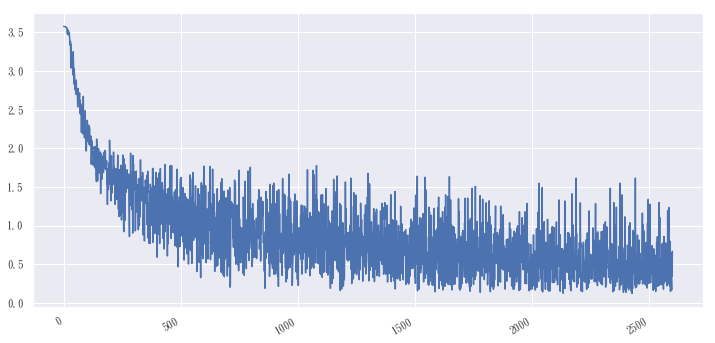

In [49]:
df=pd.DataFrame(trainingloss)
df["loss"].plot(subplots=True,figsize=(12,6))

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000002120A8F7240>],
      dtype=object)

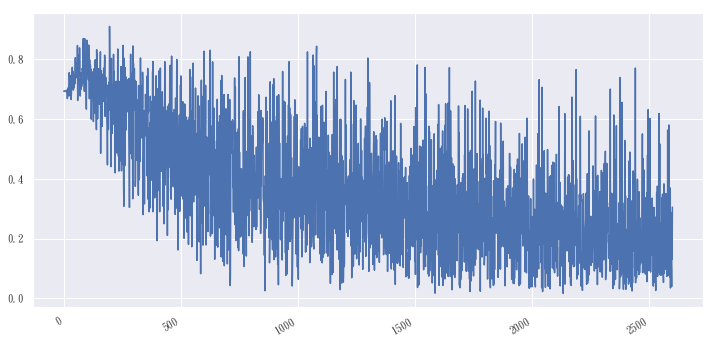

In [48]:
df=pd.DataFrame(trainingloss)
df["lossT"].plot(subplots=True,figsize=(12,6))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002120A7A3438>,
      dtype=object)

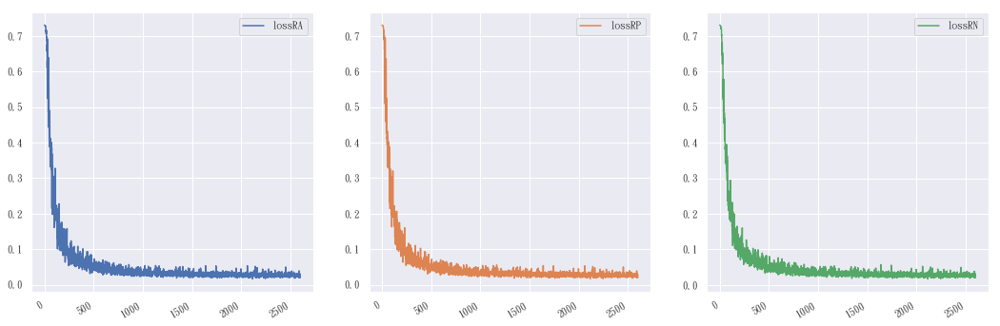

In [44]:
df=pd.DataFrame(trainingloss)
df[["lossRA","lossRP","lossRN"]].plot(subplots=True,figsize=(18,6),layout=(1,3))

## Save model

In [ ]:
modelstatpath="EncoderStat.pt"
torch.save(modelEncoder.state_dict(),modelstatpath) 

## Save DATA

In [ ]:
dfTrain=pd.DataFrame(trainingloss)
dfTest=pd.DataFrame(testloss)

In [ ]:
trainLossPath="TrainLoss.p"
testLossPath="TestLoss.p"
dfTrain.to_pickle(trainLossPath)
dfTest.to_pickle(testLossPath)

### PLOT

In [44]:
y=torch.randn(2)
win=vis.line(Y=np.arange(10000),X=np.arange(10000),
#              update="new",
             opts=opts())

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

In [ ]:
# for i in range(10000):
#     win="1"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="2"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="3"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="4"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="5"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="6"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="7"
#     vis.line(Y=[i],X=[i],win=win,update="append")
#     win="8"
#     vis.line(Y=[i],X=[i],win=win,update="append")
    

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-pack

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connection.py", line 141, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 83, in create_connection
    raise err
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\connectionpool.py", line 601, in urlopen
    chunked=chunked)
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\urllib3\util\connection.py", line 73, in create_connection
    sock.connect(sa)
OSError: [WinError 10048] 一次只能用一個通訊端位址 (通訊協定/網路位址/連接埠)。

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\visdom\__init__.py", line 446, in _send
    data=json.dumps(msg),
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\requests\api.py", line 112, in post
    return request('post', url, data=data, json=json, **kwargs)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplearningcpu\lib\site-packages\requests\api.py", line 58, in request
    return session.request(method=method, url=url, **kwargs)
  File "C:\Users\garyyu\AppData\Local\Continuum\anaconda3\envs\deeplear

In [37]:
win="test"
# opts={"markers":True,"xlabel":"epochs","title":"test Loss","width":1200,"heigh":300}
y=torch.randn(3)
win=vis.line(y,X=[1,2,3],win=win,opts=opts(),name="train-loss")

In [38]:
win="X"
# opts={"markers":True,"xlabel":"epochs","title":"X Loss","width":1200,"heigh":300}
y=torch.randn(3)
win=vis.line(y,X=[1,2,3],win=win,opts=opts(),name="train-loss")

In [39]:
vis